# Importing Necessary Libraries

In [3]:
pip install --upgrade

Note: you may need to restart the kernel to use updated packages.


ERROR: You must give at least one requirement to install (see "pip help install")


In [2]:
#importing all the necessary liraries
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder,OneHotEncoder
import matplotlib.pyplot as plt

import keras
from keras.models import Sequential
from keras. layers import Activation
from keras.layers.core import Dense
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import categorical_crossentropy
from tensorflow.keras.utils import to_categorical

# Loading Data

In [3]:
#Loading dataset
trainDataSet = pd.read_csv(r"C:\Users\bisha\OneDrive\Desktop\hrv dataset\data\final\train.csv")

In [4]:
#displaying data sample
trainDataSet.head()

,MEAN_RR,MEDIAN_RR,SDRR,RMSSD,SDSD,SDRR_RMSSD,HR,pNN25,pNN50,SD1,...,HF,HF_PCT,HF_NU,TP,LF_HF,HF_LF,sampen,higuci,datasetId,condition
0,885.157845,853.763730,140.972741,15.554505,15.553371,9.063146,69.499952,11.133333,0.533333,11.001565,...,15.522603,0.421047,1.514737,3686.666157,65.018055,0.015380,2.139754,1.163485,2,no stress
1,939.425371,948.357865,81.317742,12.964439,12.964195,6.272369,64.363150,5.600000,0.000000,9.170129,...,2.108525,0.070133,0.304603,3006.487251,327.296635,0.003055,2.174499,1.084711,2,interruption
2,898.186047,907.006860,84.497236,16.305279,16.305274,5.182201,67.450066,13.066667,0.200000,11.533417,...,13.769729,0.512671,1.049528,2685.879461,94.280910,0.010607,2.135350,1.176315,2,interruption
3,881.757865,893.460030,90.370537,15.720468,15.720068,5.748591,68.809562,11.800000,0.133333,11.119476,...,18.181913,0.529387,1.775294,3434.520980,55.328701,0.018074,2.178341,1.179688,2,no stress
4,809.625331,811.184865,62.766242,19.213819,19.213657,3.266724,74.565728,20.200000,0.200000,13.590641,...,48.215822,1.839473,3.279993,2621.175204,29.487873,0.033912,2.221121,1.249612,2,no stress


In [5]:
#loading test sample
testDataSet = pd.read_csv(r"C:\Users\bisha\OneDrive\Desktop\hrv dataset\data\final\train.csv")

In [6]:
#displaying test sample
testDataSet.head()

,MEAN_RR,MEDIAN_RR,SDRR,RMSSD,SDSD,SDRR_RMSSD,HR,pNN25,pNN50,SD1,...,HF,HF_PCT,HF_NU,TP,LF_HF,HF_LF,sampen,higuci,datasetId,condition
0,885.157845,853.763730,140.972741,15.554505,15.553371,9.063146,69.499952,11.133333,0.533333,11.001565,...,15.522603,0.421047,1.514737,3686.666157,65.018055,0.015380,2.139754,1.163485,2,no stress
1,939.425371,948.357865,81.317742,12.964439,12.964195,6.272369,64.363150,5.600000,0.000000,9.170129,...,2.108525,0.070133,0.304603,3006.487251,327.296635,0.003055,2.174499,1.084711,2,interruption
2,898.186047,907.006860,84.497236,16.305279,16.305274,5.182201,67.450066,13.066667,0.200000,11.533417,...,13.769729,0.512671,1.049528,2685.879461,94.280910,0.010607,2.135350,1.176315,2,interruption
3,881.757865,893.460030,90.370537,15.720468,15.720068,5.748591,68.809562,11.800000,0.133333,11.119476,...,18.181913,0.529387,1.775294,3434.520980,55.328701,0.018074,2.178341,1.179688,2,no stress
4,809.625331,811.184865,62.766242,19.213819,19.213657,3.266724,74.565728,20.200000,0.200000,13.590641,...,48.215822,1.839473,3.279993,2621.175204,29.487873,0.033912,2.221121,1.249612,2,no stress


In [7]:
#Looking for the shape of test data set
testDataSet.shape

(369289, 36)

In [8]:
#checking if there are any null values
testDataSet.isnull().sum()

MEAN_RR              0
MEDIAN_RR            0
SDRR                 0
RMSSD                0
SDSD                 0
SDRR_RMSSD           0
HR                   0
pNN25                0
pNN50                0
SD1                  0
SD2                  0
KURT                 0
SKEW                 0
MEAN_REL_RR          0
MEDIAN_REL_RR        0
SDRR_REL_RR          0
RMSSD_REL_RR         0
SDSD_REL_RR          0
SDRR_RMSSD_REL_RR    0
KURT_REL_RR          0
SKEW_REL_RR          0
VLF                  0
VLF_PCT              0
LF                   0
LF_PCT               0
LF_NU                0
HF                   0
HF_PCT               0
HF_NU                0
TP                   0
LF_HF                0
HF_LF                0
sampen               0
higuci               0
datasetId            0
condition            0
dtype: int64

# Preprocessing

In [9]:
#Droping unnecessary columns
trainSamples = trainDataSet.drop(['condition','datasetId'], axis = 1)

In [10]:
trainSamples

,MEAN_RR,MEDIAN_RR,SDRR,RMSSD,SDSD,SDRR_RMSSD,HR,pNN25,pNN50,SD1,...,LF_PCT,LF_NU,HF,HF_PCT,HF_NU,TP,LF_HF,HF_LF,sampen,higuci
0,885.157845,853.763730,140.972741,15.554505,15.553371,9.063146,69.499952,11.133333,0.533333,11.001565,...,27.375666,98.485263,15.522603,0.421047,1.514737,3686.666157,65.018055,0.015380,2.139754,1.163485
1,939.425371,948.357865,81.317742,12.964439,12.964195,6.272369,64.363150,5.600000,0.000000,9.170129,...,22.954139,99.695397,2.108525,0.070133,0.304603,3006.487251,327.296635,0.003055,2.174499,1.084711
2,898.186047,907.006860,84.497236,16.305279,16.305274,5.182201,67.450066,13.066667,0.200000,11.533417,...,48.335104,98.950472,13.769729,0.512671,1.049528,2685.879461,94.280910,0.010607,2.135350,1.176315
3,881.757865,893.460030,90.370537,15.720468,15.720068,5.748591,68.809562,11.800000,0.133333,11.119476,...,29.290305,98.224706,18.181913,0.529387,1.775294,3434.520980,55.328701,0.018074,2.178341,1.179688
4,809.625331,811.184865,62.766242,19.213819,19.213657,3.266724,74.565728,20.200000,0.200000,13.590641,...,54.242160,96.720007,48.215822,1.839473,3.279993,2621.175204,29.487873,0.033912,2.221121,1.249612
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
369284,721.396910,721.533965,36.377559,9.609941,9.609936,3.785409,83.384647,0.933333,0.000000,6.797519,...,48.219676,89.119683,38.227175,5.886975,10.880317,649.351702,8.190908,0.122087,2.096850,1.314910
369285,984.266492,978.622945,74.918433,13.762274,13.761705,5.443754,61.314243,6.333333,0.200000,9.734243,...,31.481178,99.642453,2.573834,0.112964,0.357547,2278.456746,278.683532,0.003588,2.131264,1.175975
369286,1025.499743,1024.968400,95.309200,23.051254,23.050395,4.134664,59.028594,30.400000,2.066667,16.304530,...,54.870376,99.819930,4.287216,0.098983,0.180070,4331.259564,554.340761,0.001804,2.215643,1.140232
369287,798.123167,803.559610,78.449897,16.736686,16.736657,4.687302,75.978628,10.000000,1.466667,11.838553,...,43.587168,96.477005,46.636158,1.591647,3.522995,2930.056129,27.384942,0.036516,2.091628,1.181937


In [11]:
trainSamples.shape


(369289, 34)

# Extracting labels from train and test dataset

In [12]:
trainLabels = trainDataSet['condition']

In [13]:
trainLabels = pd.get_dummies(trainDataSet['condition'])

In [14]:
trainLabels

,interruption,no stress,time pressure
0,0,1,0
1,1,0,0
2,1,0,0
3,0,1,0
4,0,1,0
...,...,...,...
369284,0,1,0
369285,0,1,0
369286,0,1,0
369287,0,1,0


In [15]:
testSamples = testDataSet.drop(['condition','datasetId'], axis = 1)


In [16]:
testLabels = testDataSet['condition']

In [17]:
testLabels= pd.get_dummies(testDataSet['condition'])

In [46]:
testlabels1 = testDataSet['condition']
labelencoder = LabelEncoder()
testLabels1 = labelencoder.fit_transform(testDataSet["condition"])

In [47]:
testLabels1

array([1, 0, 0, ..., 1, 1, 1])

In [18]:
testLabels

,interruption,no stress,time pressure
0,0,1,0
1,1,0,0
2,1,0,0
3,0,1,0
4,0,1,0
...,...,...,...
369284,0,1,0
369285,0,1,0
369286,0,1,0
369287,0,1,0


# Normalization

In [19]:
#Normalizing using Min Max Scaler
scaling = MinMaxScaler(feature_range=(0,1))
trainSamples = scaling.fit_transform(trainSamples)

In [20]:
trainSamples

array([[0.43596493, 0.29623337, 0.21209913, ..., 0.03539462, 0.94718154,
        0.39574294],
       [0.50603051, 0.37951539, 0.100855  , ..., 0.00679268, 0.96648135,
        0.15501473],
       [0.45278583, 0.34310938, 0.10678409, ..., 0.02431648, 0.94473507,
        0.43494913],
       ...,
       [0.61716237, 0.4469644 , 0.12694615, ..., 0.00388866, 0.98933569,
        0.32468371],
       [0.32359321, 0.25203294, 0.09550707, ..., 0.0844439 , 0.92044908,
        0.45213052],
       [0.34464579, 0.26226264, 0.07545588, ..., 0.08234303, 0.98519767,
        0.61149533]])

In [21]:
testSamples = scaling.fit_transform(testSamples)

In [22]:
testSamples

array([[0.43596493, 0.29623337, 0.21209913, ..., 0.03539462, 0.94718154,
        0.39574294],
       [0.50603051, 0.37951539, 0.100855  , ..., 0.00679268, 0.96648135,
        0.15501473],
       [0.45278583, 0.34310938, 0.10678409, ..., 0.02431648, 0.94473507,
        0.43494913],
       ...,
       [0.61716237, 0.4469644 , 0.12694615, ..., 0.00388866, 0.98933569,
        0.32468371],
       [0.32359321, 0.25203294, 0.09550707, ..., 0.0844439 , 0.92044908,
        0.45213052],
       [0.34464579, 0.26226264, 0.07545588, ..., 0.08234303, 0.98519767,
        0.61149533]])

# Normalization and Encoding


In [23]:
trainDataSet.condition.value_counts()

no stress        200082
interruption     105150
time pressure     64057
Name: condition, dtype: int64

In [24]:
pd.DataFrame(trainLabels) 

,interruption,no stress,time pressure
0,0,1,0
1,1,0,0
2,1,0,0
3,0,1,0
4,0,1,0
...,...,...,...
369284,0,1,0
369285,0,1,0
369286,0,1,0
369287,0,1,0


In [25]:
trainLabels.shape

(369289, 3)

In [26]:

model = Sequential()
model.add(Dense(34, input_shape= (34,), activation = 'relu'))
model.add(Dense(64, activation = 'relu'))
model.add(Dense(36, activation = 'relu'))
model.add(Dense(12, activation = 'relu'))
model.add(Dense(9, activation = 'relu'))
model.add(Dense(3, activation = 'softmax'))

In [27]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 34)                1190      
_________________________________________________________________
dense_1 (Dense)              (None, 64)                2240      
_________________________________________________________________
dense_2 (Dense)              (None, 36)                2340      
_________________________________________________________________
dense_3 (Dense)              (None, 12)                444       
_________________________________________________________________
dense_4 (Dense)              (None, 9)                 117       
_________________________________________________________________
dense_5 (Dense)              (None, 3)                 30        
Total params: 6,361
Trainable params: 6,361
Non-trainable params: 0
______________________________________________________

In [28]:
model.compile(optimizer=Adam(learning_rate=0.0001),loss='categorical_crossentropy', metrics=['accuracy'])
trained_model = model.fit(trainSamples,trainLabels, validation_split=0.1 ,batch_size=100,epochs=50,shuffle=True,verbose=2)

Epoch 1/50
3324/3324 - 11s - loss: 0.8343 - accuracy: 0.6382 - val_loss: 0.7152 - val_accuracy: 0.6950
Epoch 2/50
3324/3324 - 8s - loss: 0.6460 - accuracy: 0.7243 - val_loss: 0.5830 - val_accuracy: 0.7462
Epoch 3/50
3324/3324 - 10s - loss: 0.5345 - accuracy: 0.7782 - val_loss: 0.4896 - val_accuracy: 0.8033
Epoch 4/50
3324/3324 - 8s - loss: 0.4560 - accuracy: 0.8170 - val_loss: 0.4245 - val_accuracy: 0.8332
Epoch 5/50
3324/3324 - 8s - loss: 0.3979 - accuracy: 0.8380 - val_loss: 0.3751 - val_accuracy: 0.8445
Epoch 6/50
3324/3324 - 10s - loss: 0.3512 - accuracy: 0.8557 - val_loss: 0.3377 - val_accuracy: 0.8606
Epoch 7/50
3324/3324 - 10s - loss: 0.3151 - accuracy: 0.8746 - val_loss: 0.2983 - val_accuracy: 0.8859
Epoch 8/50
3324/3324 - 9s - loss: 0.2855 - accuracy: 0.8905 - val_loss: 0.2731 - val_accuracy: 0.8994
Epoch 9/50
3324/3324 - 9s - loss: 0.2599 - accuracy: 0.9037 - val_loss: 0.2524 - val_accuracy: 0.9065
Epoch 10/50
3324/3324 - 10s - loss: 0.2354 - accuracy: 0.9140 - val_loss: 0.22

In [29]:
test_loss, test_acc = model.evaluate(testSamples,testLabels)

11541/11541 [==============================] - 26s 2ms/step - loss: 0.0121 - accuracy: 0.9969


# Visualization


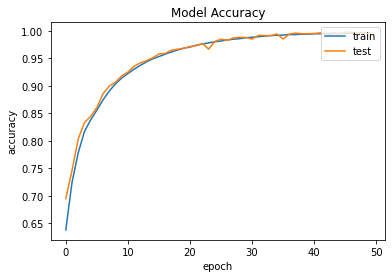

In [30]:
plt.plot(trained_model.history['accuracy'])
plt.plot(trained_model.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train','test'],loc = 'upper right')

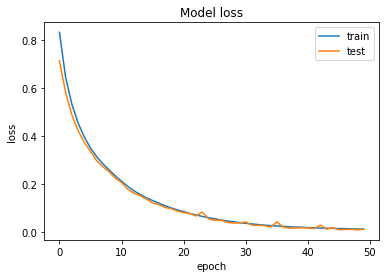

In [31]:
plt.plot(trained_model.history['loss'])
plt.plot(trained_model.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train','test'],loc = 'upper right')

# Prediction

In [32]:
predictions = model.predict(testSamples, batch_size = 10, verbose = 2)

36929/36929 - 43s


In [33]:
for i in predictions:
    print (i)

[2.3763068e-05 9.9520123e-01 4.7749840e-03]
[9.9868816e-01 4.5838093e-09 1.3118440e-03]
[9.9998534e-01 4.0128707e-06 1.0647645e-05]
[0.14811939 0.8501857  0.00169489]
[1.1165274e-12 1.0000000e+00 2.6763602e-10]
[1.7941782e-26 1.0000000e+00 1.8061816e-19]
[3.8194625e-09 9.9933225e-01 6.6774682e-04]
[1.9605218e-14 1.0000000e+00 1.4675597e-10]
[9.9888653e-01 1.1133070e-03 1.5184649e-07]
[8.6684021e-10 9.9972028e-01 2.7969663e-04]
[3.3253692e-03 1.2342979e-05 9.9666226e-01]
[1.4758092e-14 1.0000000e+00 1.2796565e-11]
[6.7454035e-11 1.0000000e+00 1.3026773e-11]
[9.9994862e-01 5.1287621e-05 1.5475537e-07]
[4.9464968e-13 1.0000000e+00 1.2874866e-10]
[1.07880295e-10 1.00000000e+00 7.43899857e-16]
[1.1372933e-09 9.9979907e-01 2.0100056e-04]
[1.4057074e-10 1.0000000e+00 2.8395143e-14]
[4.7876782e-04 1.0349879e-02 9.8917133e-01]
[9.9958628e-01 4.1085598e-04 2.9035582e-06]
[2.7077555e-12 1.0000000e+00 3.1932752e-11]
[1.4978444e-13 1.0000000e+00 1.1244140e-11]
[4.147763e-04 1.744532e-09 9.995852e-0

[9.906063e-17 1.000000e+00 2.939428e-18]
[9.999999e-01 1.754683e-11 8.635664e-08]
[8.4662161e-06 9.9715853e-01 2.8330958e-03]
[1.8009514e-13 1.0000000e+00 6.7998905e-11]
[6.5178039e-13 1.0000000e+00 1.3650626e-09]
[3.217800e-14 1.000000e+00 5.489231e-10]
[9.9999857e-01 1.3777019e-06 9.0159507e-09]
[2.17303864e-09 9.99985099e-01 1.48826975e-05]
[3.7120306e-03 1.6878456e-08 9.9628794e-01]
[2.5709151e-04 9.9974293e-01 9.2360214e-10]
[5.994735e-16 1.000000e+00 4.365926e-13]
[1.0000000e+00 3.7169693e-14 2.0848760e-10]
[1.3740764e-03 2.5307449e-07 9.9862564e-01]
[1.25315385e-08 9.96775687e-01 3.22430138e-03]
[1.0000000e+00 2.0983332e-28 8.3974822e-18]
[5.868715e-08 9.999902e-01 9.726594e-06]
[1.7686117e-03 1.6245434e-04 9.9806899e-01]
[1.0495380e-06 4.4256136e-18 9.9999893e-01]
[1.9294892e-11 1.0000000e+00 2.9071209e-08]
[5.5367122e-03 9.9415016e-01 3.1312573e-04]
[4.0476147e-09 4.3275758e-08 1.0000000e+00]
[3.9593357e-04 9.1388490e-04 9.9869019e-01]
[2.0154426e-05 8.2081157e-01 1.7916831e-0

[9.9144586e-09 1.0000000e+00 3.7116301e-09]
[9.4905621e-01 5.0943770e-02 5.0648183e-09]
[4.1060433e-11 9.9998987e-01 1.0140439e-05]
[7.052697e-13 1.000000e+00 2.755880e-11]
[6.7880997e-18 1.0000000e+00 1.0128763e-12]
[1.0000000e+00 2.6345532e-19 4.2550950e-21]
[1.5082646e-14 1.0000000e+00 1.8866158e-15]
[1.2905842e-04 4.2928281e-08 9.9987090e-01]
[5.4985687e-13 1.0000000e+00 1.0155305e-08]
[3.0851623e-04 9.9899942e-01 6.9201598e-04]
[4.2541318e-02 6.5816334e-04 9.5680052e-01]
[4.2019357e-05 9.9995804e-01 1.2147304e-09]
[5.5950467e-02 2.9417131e-05 9.4402009e-01]
[9.7907713e-16 1.0000000e+00 3.8580432e-12]
[7.0489724e-28 1.0000000e+00 2.7562378e-22]
[1.0000000e+00 5.9973334e-19 1.5374182e-20]
[8.4257084e-07 9.9996448e-01 3.4720935e-05]
[3.412194e-16 1.000000e+00 9.473378e-15]
[1.0701195e-05 1.0314530e-02 9.8967475e-01]
[9.9999976e-01 1.3909191e-07 1.3690506e-07]
[3.3851254e-01 6.6147786e-01 9.6157246e-06]
[3.0096494e-06 5.5058150e-13 9.9999702e-01]
[3.9178328e-08 9.8617029e-01 1.3829699

[1.2776534e-06 9.9999869e-01 6.0478533e-09]
[3.6012294e-14 1.0000000e+00 8.6834319e-19]
[1.7961896e-06 9.2586483e-10 9.9999821e-01]
[9.4074287e-02 1.2173365e-08 9.0592569e-01]
[9.9829644e-01 1.7026602e-03 9.9488796e-07]
[9.9418628e-08 9.9999988e-01 1.8500356e-09]
[5.5485079e-04 1.3168811e-06 9.9944383e-01]
[1.1568006e-12 1.0000000e+00 5.2013525e-14]
[2.7368094e-10 1.0000000e+00 3.4509763e-11]
[4.8361253e-04 4.8927188e-07 9.9951589e-01]
[3.7430897e-16 1.0000000e+00 2.2801607e-14]
[5.005898e-11 1.000000e+00 7.845005e-12]
[1.0000000e+00 2.0329608e-27 2.8616107e-10]
[1.0000000e+00 1.1659201e-16 6.7166124e-13]
[2.0089297e-21 1.0000000e+00 4.7726346e-19]
[9.999982e-01 6.478970e-10 1.732688e-06]
[6.2062090e-06 7.2918483e-03 9.9270189e-01]
[5.5691576e-06 9.9303186e-01 6.9625829e-03]
[2.3379287e-06 9.9999285e-01 4.7279827e-06]
[1.0000000e+00 2.7831694e-22 7.1607191e-12]
[2.5393732e-11 1.0000000e+00 5.3587854e-08]
[5.432544e-05 3.093557e-04 9.996363e-01]
[1.0000000e+00 3.1658669e-09 1.0143884e-0

[1.0000000e+00 0.0000000e+00 2.4282428e-32]
[6.7742394e-09 1.0000000e+00 2.8305518e-12]
[2.7830387e-07 9.9977571e-01 2.2410929e-04]
[1.0000000e+00 7.8062392e-09 1.4274706e-14]
[3.520735e-17 1.000000e+00 5.585778e-20]
[3.0165187e-03 2.0121573e-07 9.9698323e-01]
[4.1553300e-04 4.2051193e-05 9.9954247e-01]
[3.3293187e-08 9.9999571e-01 4.3053160e-06]
[9.6865771e-10 9.9991405e-01 8.5946871e-05]
[2.938057e-09 1.000000e+00 2.577477e-09]
[0.01284598 0.98180056 0.00535354]
[1.0000000e+00 4.9443964e-38 7.8581110e-15]
[5.0780673e-02 9.4921148e-01 7.8493122e-06]
[1.0000000e+00 3.1423031e-20 1.0046017e-11]
[2.6225356e-23 1.0000000e+00 5.1402643e-29]
[9.9999821e-01 1.8437051e-06 1.0150601e-08]
[7.4829906e-11 1.0000000e+00 3.0652578e-09]
[1.03618926e-10 1.00000000e+00 1.57859439e-16]
[9.9994040e-01 5.9546637e-05 9.5252215e-09]
[7.3200329e-17 1.0000000e+00 3.4344688e-18]
[1.7806492e-20 1.0000000e+00 4.3474256e-18]
[7.1179900e-19 1.0000000e+00 2.4127767e-17]
[2.9690121e-09 9.9809057e-01 1.9094243e-03]


[3.6543193e-09 9.9949920e-01 5.0075457e-04]
[9.9999714e-01 2.8536072e-06 1.7663992e-09]
[1.000000e+00 0.000000e+00 2.265882e-27]
[1.0000000e+00 1.5738136e-13 5.6529353e-13]
[9.9998915e-01 2.4284583e-16 1.0843092e-05]
[1.6552052e-12 1.0000000e+00 3.0633743e-10]
[2.9044491e-27 1.0000000e+00 2.6566637e-20]
[4.6313897e-13 1.0000000e+00 7.8153857e-09]
[1.6604705e-08 9.9994671e-01 5.3302214e-05]
[1.5398326e-10 1.0000000e+00 2.5756607e-11]
[1.0000000e+00 2.3765810e-20 1.1478707e-08]
[5.9321346e-11 1.0000000e+00 3.1471629e-08]
[9.9998260e-01 1.3606589e-09 1.7372435e-05]
[2.4323578e-03 3.4836994e-08 9.9756765e-01]
[1.0565131e-02 3.6905694e-04 9.8906577e-01]
[1.9395140e-15 1.0000000e+00 6.7502576e-14]
[7.0763526e-06 9.9999261e-01 4.1624153e-07]
[1.0000000e+00 6.3782764e-22 1.8947745e-21]
[4.2797146e-05 1.8330473e-04 9.9977392e-01]
[1.0000000e+00 0.0000000e+00 5.9778353e-24]
[5.4037864e-03 9.9459547e-01 7.3343153e-07]
[5.9968244e-07 5.5443656e-06 9.9999380e-01]
[1.5240481e-14 1.0000000e+00 2.8671

[2.1014058e-08 9.9999583e-01 4.1240246e-06]
[1.0000000e+00 3.4534686e-09 7.4715603e-09]
[3.02233303e-07 9.89507020e-01 1.04926415e-02]
[3.8153580e-16 1.0000000e+00 2.2033785e-14]
[1.4835418e-06 1.1970299e-13 9.9999857e-01]
[5.3251636e-08 9.9958843e-01 4.1163457e-04]
[9.9999976e-01 2.7861617e-07 5.0483595e-09]
[2.1866258e-08 9.9141568e-01 8.5843205e-03]
[4.6511665e-03 9.9533671e-01 1.2130574e-05]
[0.00311708 0.98805445 0.00882852]
[5.9139496e-05 2.4900344e-06 9.9993837e-01]
[2.4921929e-02 9.7505444e-01 2.3599421e-05]
[9.9672145e-01 3.2784077e-03 9.4350071e-08]
[0.01267775 0.97699463 0.01032759]
[1.0000000e+00 3.1284092e-10 3.2806685e-08]
[6.6646000e-20 1.0000000e+00 4.0161986e-21]
[9.9999976e-01 1.1711494e-07 1.2054471e-07]
[9.8576838e-01 5.5476971e-07 1.4231064e-02]
[1.0000000e+00 2.1990944e-08 6.4229977e-10]
[9.0863553e-11 1.0000000e+00 7.1832555e-14]
[4.8239586e-19 1.0000000e+00 6.8533219e-20]
[1.0000000e+00 3.1110312e-34 9.2776188e-13]
[6.9959456e-09 1.0000000e+00 3.0954874e-12]
[1.

[6.8861258e-29 1.0000000e+00 2.0508557e-24]
[1.0000000e+00 3.7675182e-14 6.0670299e-20]
[0.00169487 0.00460058 0.9937045 ]
[2.6361963e-02 9.7363734e-01 6.7785368e-07]
[1.0000000e+00 8.2067275e-29 2.3310074e-18]
[2.6657141e-31 1.0000000e+00 6.9662648e-28]
[9.8881513e-01 1.1182774e-02 2.0866501e-06]
[7.74856790e-10 9.99879003e-01 1.21021476e-04]
[1.0000000e+00 1.5938793e-12 7.6725522e-11]
[4.3105313e-08 1.0000000e+00 5.4717448e-09]
[4.0436303e-14 1.0000000e+00 2.3353760e-08]
[2.8648257e-11 1.0000000e+00 1.1952173e-18]
[1.9388162e-10 1.0000000e+00 4.7585720e-12]
[2.6191917e-04 2.1213621e-03 9.9761677e-01]
[7.2078585e-08 9.9989510e-01 1.0475462e-04]
[9.9993265e-01 6.6959401e-05 3.0119634e-07]
[1.0000000e+00 1.9225897e-19 2.0918755e-13]
[1.2546561e-12 1.0000000e+00 1.9290625e-11]
[0.01408753 0.01787689 0.9680356 ]
[2.9366053e-04 1.8692847e-06 9.9970442e-01]
[2.6647803e-15 1.0000000e+00 5.1661762e-13]
[5.7471435e-15 1.0000000e+00 3.0019075e-13]
[9.9973971e-01 5.4689572e-06 2.5481376e-04]
[9.

[1.8879224e-08 9.9456561e-01 5.4343659e-03]
[9.5361400e-15 1.0000000e+00 4.0168202e-13]
[3.2907188e-09 1.0000000e+00 6.6953414e-13]
[2.7331104e-14 1.0000000e+00 4.9261007e-14]
[9.6893856e-08 9.9616301e-01 3.8369077e-03]
[2.528958e-14 1.000000e+00 8.684514e-14]
[1.9240990e-21 1.0000000e+00 1.2168476e-20]
[1.0000000e+00 1.5987096e-14 1.3302905e-10]
[1.5702791e-09 9.9997926e-01 2.0779840e-05]
[9.9999988e-01 3.0411361e-13 1.4080560e-07]
[1.00000000e+00 1.04171626e-32 4.81531655e-12]
[5.0505800e-09 9.9263328e-01 7.3667043e-03]
[3.2173557e-06 9.9868852e-01 1.3083168e-03]
[9.8713649e-08 9.9999988e-01 2.3400237e-10]
[2.6142085e-13 1.0000000e+00 2.3435044e-13]
[9.9999809e-01 1.9360507e-06 1.7621385e-08]
[9.9840158e-01 1.5867669e-03 1.1700364e-05]
[9.87180650e-01 1.01823486e-20 1.28193554e-02]
[1.1347062e-14 1.0000000e+00 3.9612525e-15]
[9.9999166e-01 9.2685761e-09 8.2920988e-06]
[9.9991333e-01 8.6589520e-05 7.6767883e-08]
[1.5072334e-20 1.0000000e+00 1.3122287e-18]
[9.99894977e-01 2.42758836e-1

[1.1491055e-04 3.6666952e-03 9.9621838e-01]
[9.9999964e-01 8.3567012e-26 4.1212192e-07]
[1.5050226e-06 1.3579926e-19 9.9999845e-01]
[2.8175069e-05 9.9996912e-01 2.7910376e-06]
[9.9999046e-01 1.1487422e-12 9.4844509e-06]
[1.7117924e-04 3.2848916e-03 9.9654394e-01]
[4.1118965e-05 5.1664251e-10 9.9995887e-01]
[9.9998760e-01 1.2439426e-05 8.8410607e-10]
[3.7092326e-04 1.4297051e-03 9.9819934e-01]
[7.1332505e-07 9.9999928e-01 2.4371468e-12]
[1.0000000e+00 5.5964778e-30 4.9126396e-09]
[4.036361e-08 1.000000e+00 9.562237e-12]
[1.4367780e-09 1.0000000e+00 2.6964381e-08]
[1.3930817e-11 1.0000000e+00 9.8265396e-09]
[8.980620e-07 9.997658e-01 2.332508e-04]
[1.0000000e+00 3.0158611e-38 1.6133248e-17]
[1.0000000e+00 3.5730556e-32 1.6339034e-20]
[9.9949098e-01 4.6970409e-18 5.0900946e-04]
[1.2633416e-31 1.0000000e+00 9.8712058e-25]
[1.9216788e-08 9.9996305e-01 3.6910980e-05]
[5.2285667e-14 1.0000000e+00 2.6111255e-08]
[2.7643044e-14 1.0000000e+00 6.1350266e-15]
[4.6326126e-19 1.0000000e+00 1.6571862

[1.1668950e-15 1.0000000e+00 1.0876865e-15]
[2.5775278e-15 1.0000000e+00 6.8813068e-18]
[7.628421e-12 1.000000e+00 6.404644e-11]
[1.9908082e-09 6.8957846e-11 1.0000000e+00]
[2.3191041e-11 1.0000000e+00 6.5367649e-13]
[1.582595e-07 9.999229e-01 7.696504e-05]
[7.7259768e-11 1.0000000e+00 1.9013726e-08]
[6.8151057e-05 6.4333148e-09 9.9993181e-01]
[7.0608470e-11 9.9999213e-01 7.8816674e-06]
[1.0000000e+00 3.3678085e-11 1.9772239e-08]
[1.9472935e-12 1.4570857e-07 9.9999988e-01]
[3.3535108e-02 3.3723477e-08 9.6646488e-01]
[2.5337970e-13 1.0000000e+00 1.2404812e-16]
[5.7953300e-13 1.0000000e+00 3.9036888e-10]
[1.6583949e-04 6.2368913e-06 9.9982786e-01]
[8.5930762e-05 9.9907279e-01 8.4119727e-04]
[7.665687e-06 4.188389e-06 9.999882e-01]
[5.8353278e-05 9.9994159e-01 6.8066237e-09]
[2.4604938e-10 9.9999928e-01 6.9136843e-07]
[9.8969764e-01 1.0302215e-02 1.4852195e-07]
[7.2953844e-11 1.0000000e+00 6.3484513e-12]
[1.5119118e-09 9.9999988e-01 1.1949457e-07]
[7.543663e-03 7.938557e-15 9.924563e-01]


[2.2320916e-10 1.0000000e+00 4.2181860e-08]
[5.0195127e-26 1.0000000e+00 1.4559864e-21]
[1.3509816e-03 8.0056569e-05 9.9856889e-01]
[8.8247941e-07 9.9999094e-01 8.2176120e-06]
[6.4170344e-08 9.9939072e-01 6.0918357e-04]
[2.0781564e-12 1.0000000e+00 4.1078174e-14]
[2.1694775e-09 9.9935228e-01 6.4769358e-04]
[1.0017922e-12 1.0000000e+00 4.4491499e-13]
[9.9999714e-01 1.8473905e-08 2.8998693e-06]
[3.5110770e-05 9.9996483e-01 9.5686614e-10]
[4.6715489e-11 1.0000000e+00 1.0405791e-12]
[2.4610846e-19 1.0000000e+00 1.7120648e-16]
[3.0561167e-04 9.9969447e-01 3.5634066e-08]
[4.3894284e-05 1.4091904e-03 9.9854690e-01]
[1.0000000e+00 3.9152130e-27 9.9954676e-11]
[0.00112199 0.00358375 0.9952943 ]
[1.0000000e+00 8.0353543e-22 5.1627666e-21]
[1.1932783e-15 1.0000000e+00 1.5602873e-15]
[1.9799783e-16 1.0000000e+00 9.5257368e-16]
[4.4022654e-05 9.4792145e-01 5.2034497e-02]
[1.6720310e-13 1.0000000e+00 2.7546065e-16]
[1.000000e+00 4.509748e-14 1.457334e-17]
[1.1975829e-13 9.8376137e-01 1.6238628e-02]


[2.9171030e-11 1.0000000e+00 3.8917197e-10]
[7.6366849e-21 1.0000000e+00 1.2743762e-18]
[5.7777390e-04 5.3229945e-04 9.9888998e-01]
[3.185209e-07 9.992638e-01 7.357601e-04]
[1.9814914e-14 1.0000000e+00 3.2026073e-11]
[3.2280461e-04 1.8271391e-03 9.9785006e-01]
[9.9758840e-01 2.4115108e-03 1.2810038e-07]
[1.7303425e-10 9.9999988e-01 7.5260857e-08]
[1.7162933e-05 7.0044725e-06 9.9997580e-01]
[3.7889495e-03 7.7756832e-09 9.9621105e-01]
[9.9999976e-01 2.9329394e-07 3.3768011e-10]
[9.9918658e-01 3.5301224e-07 8.1309513e-04]
[5.92018212e-09 1.00000000e+00 1.19783046e-14]
[6.941062e-05 9.999306e-01 5.432881e-08]
[9.9053735e-01 1.7694460e-06 9.4608674e-03]
[5.9820745e-06 9.9999404e-01 1.7909191e-08]
[9.7779560e-01 2.2200273e-02 4.1973703e-06]
[4.0067198e-13 1.0000000e+00 1.3700224e-11]
[3.4696200e-08 1.0000000e+00 4.1772184e-15]
[2.2825748e-09 9.9811614e-01 1.8838834e-03]
[4.5467280e-07 9.9999952e-01 1.4559453e-08]
[1.4066649e-08 9.9977022e-01 2.2975850e-04]
[1.2691083e-17 1.0000000e+00 1.2341

[1.0000000e+00 2.5247534e-08 1.1931697e-14]
[0.00896734 0.0551047  0.9359279 ]
[9.9999571e-01 4.2519373e-06 2.3857412e-08]
[6.6200130e-07 9.9992406e-01 7.5183096e-05]
[8.3540740e-30 1.0000000e+00 8.1437576e-23]
[9.9525851e-01 4.7410764e-03 3.7074500e-07]
[8.3557186e-18 1.0000000e+00 5.8199105e-13]
[4.8542741e-08 9.9999917e-01 8.7467521e-07]
[2.4148602e-07 9.9999976e-01 1.3138879e-08]
[3.8770885e-13 1.0000000e+00 4.7597587e-13]
[2.3168643e-04 6.0159906e-08 9.9976832e-01]
[1.7457281e-06 9.9999821e-01 3.5604308e-09]
[1.0000000e+00 5.9719650e-13 1.0974958e-11]
[4.2692591e-03 1.7322733e-05 9.9571347e-01]
[6.1832643e-06 9.9999380e-01 7.3912529e-11]
[2.7206779e-06 9.9999714e-01 6.0703144e-08]
[1.000000e+00 2.213710e-08 6.687401e-10]
[9.8224521e-01 1.7092603e-04 1.7583827e-02]
[5.8385926e-12 1.0000000e+00 2.4546508e-13]
[2.6658693e-06 9.9997008e-01 2.7315506e-05]
[9.0452011e-13 2.5717954e-05 9.9997425e-01]
[2.908277e-04 7.035974e-04 9.990056e-01]
[6.4542206e-07 1.9777327e-11 9.9999940e-01]
[2.

[9.9997652e-01 2.3531089e-05 2.8078839e-09]
[2.3562496e-04 1.9538456e-05 9.9974483e-01]
[3.7352837e-10 9.9999976e-01 1.9466670e-07]
[1.1137429e-09 1.0000000e+00 4.8885077e-08]
[9.9999344e-01 5.2252540e-06 1.3365434e-06]
[3.8377161e-07 1.6936575e-06 9.9999797e-01]
[1.4862642e-10 1.0000000e+00 2.7776526e-08]
[1.8810096e-16 1.0000000e+00 1.5529823e-09]
[9.999999e-01 8.208787e-08 3.107791e-09]
[8.9604953e-05 3.3466709e-05 9.9987686e-01]
[3.6968626e-07 9.9999487e-01 4.7823282e-06]
[6.87000734e-10 9.99989033e-01 1.09994535e-05]
[1.0251115e-11 1.0000000e+00 1.7511527e-11]
[6.7480960e-10 1.0000000e+00 1.1460266e-08]
[4.6118578e-12 1.0000000e+00 1.0620965e-09]
[1.0000000e+00 0.0000000e+00 4.5287195e-33]
[9.9978226e-01 2.1731567e-04 4.9016830e-07]
[1.1125881e-16 1.0000000e+00 1.8322506e-15]
[3.1658445e-05 9.9764854e-01 2.3197869e-03]
[2.822102e-10 1.000000e+00 5.158575e-13]
[9.9919206e-01 2.6503993e-05 7.8133005e-04]
[9.9999988e-01 1.0813033e-07 5.6639304e-10]
[1.6853842e-07 9.8863399e-01 1.1365

[5.2794970e-13 1.0000000e+00 1.4255065e-10]
[9.9999976e-01 9.6335022e-08 9.2639546e-08]
[6.3556847e-08 9.9999988e-01 2.6087965e-11]
[2.2152326e-01 7.7847648e-01 2.9037759e-07]
[2.0704204e-32 1.0000000e+00 3.4515632e-29]
[1.3508989e-02 1.3580181e-04 9.8635525e-01]
[9.9814141e-01 1.6362132e-07 1.8584612e-03]
[1.04086183e-03 1.51416325e-05 9.98943985e-01]
[1.0000000e+00 1.5641371e-30 4.8952745e-11]
[4.3368701e-20 1.0000000e+00 5.9468752e-18]
[1.9968635e-08 1.0000000e+00 1.4670207e-12]
[9.7348911e-01 2.5267489e-04 2.6258249e-02]
[1.3764171e-04 1.8696265e-03 9.9799275e-01]
[1.3390395e-18 1.0000000e+00 5.1274144e-15]
[1.7445723e-18 1.0000000e+00 2.5089003e-17]
[1.8650396e-03 9.9813485e-01 7.3828303e-08]
[4.1618303e-11 1.0000000e+00 7.3762246e-12]
[5.9202399e-16 1.0000000e+00 3.4634205e-14]
[1.000000e+00 0.000000e+00 9.658534e-29]
[9.9999988e-01 3.0314258e-12 6.3488997e-08]
[3.5044180e-15 1.0000000e+00 1.3072276e-14]
[1.0000000e+00 1.2844487e-12 2.7984661e-12]
[9.8569310e-01 1.4306956e-02 5.7

[1.0000000e+00 4.1146875e-10 6.9508053e-16]
[8.5815019e-13 7.6787546e-07 9.9999928e-01]
[1.0000000e+00 2.1127506e-13 3.1664726e-08]
[2.2390610e-04 2.1995378e-03 9.9757653e-01]
[3.730339e-09 5.579334e-06 9.999944e-01]
[2.6404444e-15 1.0000000e+00 2.2290431e-12]
[2.0096082e-17 1.0000000e+00 2.9777325e-18]
[0.00384291 0.00136047 0.9947967 ]
[2.1689306e-16 1.0000000e+00 5.5501061e-16]
[8.2805882e-06 9.9993956e-01 5.2158441e-05]
[4.6926317e-08 1.0000000e+00 4.7546276e-11]
[2.9412878e-12 1.0000000e+00 6.5352046e-10]
[5.5992509e-16 1.0000000e+00 5.1559458e-14]
[4.0371244e-05 9.9995875e-01 7.9375502e-07]
[1.0000000e+00 8.0573968e-36 2.1793724e-16]
[7.5121020e-04 9.9924660e-01 2.2614263e-06]
[9.9999905e-01 1.0063966e-06 7.3522627e-10]
[3.4520789e-10 9.9996424e-01 3.5748759e-05]
[6.829922e-17 1.000000e+00 7.979754e-16]
[2.0205338e-05 9.9900192e-01 9.7779953e-04]
[9.9999988e-01 1.7778238e-07 1.1279942e-08]
[4.3992764e-14 1.0000000e+00 1.8869535e-12]
[1.3973101e-11 1.0000000e+00 2.3144722e-08]
[5.

[9.9999988e-01 6.3539879e-08 8.1059354e-10]
[5.5748178e-06 9.9996758e-01 2.6763464e-05]
[6.732825e-13 4.559517e-13 1.000000e+00]
[1.4513952e-13 1.0000000e+00 1.6714276e-14]
[1.5405309e-11 1.0000000e+00 2.0482567e-12]
[6.7654526e-09 9.9999905e-01 9.1118687e-07]
[9.9992812e-01 4.4339277e-10 7.1911745e-05]
[6.2591359e-03 1.7769695e-15 9.9374086e-01]
[4.333942e-04 1.451906e-04 9.994215e-01]
[9.8212671e-14 1.0000000e+00 2.9545248e-11]
[6.7182664e-09 6.0003710e-21 1.0000000e+00]
[1.6620311e-13 1.0000000e+00 7.0336815e-15]
[2.8683943e-31 1.0000000e+00 3.1672184e-25]
[2.5126696e-28 1.0000000e+00 4.0575592e-22]
[8.8708909e-08 9.9999988e-01 1.0703662e-11]
[9.9339672e-14 1.0000000e+00 2.0611358e-11]
[8.2742456e-15 1.0000000e+00 3.6838595e-11]
[9.992011e-01 8.189613e-12 7.988963e-04]
[1.1413509e-04 1.4486065e-03 9.9843723e-01]
[1.05102836e-10 1.00000000e+00 2.28430306e-08]
[9.9871004e-01 3.5108203e-16 1.2899825e-03]
[0.00362846 0.00285321 0.9935183 ]
[2.5832128e-11 1.0000000e+00 2.6470142e-08]
[7.

[4.4178919e-10 9.9996519e-01 3.4766883e-05]
[1.0000000e+00 1.7688157e-27 7.2738482e-11]
[2.8251751e-15 1.0000000e+00 1.4496078e-13]
[7.8739716e-11 1.0000000e+00 1.5091720e-09]
[7.7180189e-12 1.0000000e+00 4.3371027e-12]
[7.494854e-04 9.974496e-01 1.800949e-03]
[1.5380268e-10 9.9906343e-01 9.3663490e-04]
[1.5940749e-04 9.9983919e-01 1.4083153e-06]
[1.3406171e-09 9.9945647e-01 5.4353988e-04]
[1.0000000e+00 4.5327732e-14 1.1295009e-09]
[6.5269269e-06 1.7491568e-05 9.9997604e-01]
[3.7715470e-06 9.9976963e-01 2.2656978e-04]
[5.853330e-09 9.999999e-01 9.435361e-08]
[1.9365357e-06 9.9998641e-01 1.1655106e-05]
[1.0516448e-07 9.9999928e-01 6.2290462e-07]
[6.410429e-15 9.999932e-01 6.786238e-06]
[3.9743188e-07 9.9998939e-01 1.0226470e-05]
[7.7691833e-19 1.0000000e+00 8.6843687e-17]
[0.04873683 0.00100743 0.95025575]
[7.9217156e-13 1.0000000e+00 2.9267360e-13]
[9.9910372e-01 6.2009813e-21 8.9622044e-04]
[9.9999928e-01 3.7171716e-07 4.1118821e-07]
[1.0052782e-15 1.0000000e+00 1.2060526e-12]
[0.006

[1.4642372e-26 1.0000000e+00 7.3361090e-24]
[3.3914307e-16 1.0000000e+00 1.9903816e-14]
[1.5658108e-03 2.3982985e-04 9.9819440e-01]
[7.8933306e-13 1.0000000e+00 2.5418407e-14]
[2.4556826e-12 1.0000000e+00 4.6136073e-09]
[1.3944587e-11 1.0000000e+00 8.4847187e-09]
[3.6697640e-18 1.0000000e+00 2.0322511e-16]
[1.4914321e-18 1.0000000e+00 2.4220895e-18]
[2.1768737e-14 1.0000000e+00 1.9127077e-18]
[8.5892234e-31 1.0000000e+00 1.0919161e-27]
[9.9996006e-01 3.9899132e-05 1.5304266e-08]
[6.471084e-07 9.999994e-01 9.420629e-12]
[7.5135786e-11 9.9999380e-01 6.2462664e-06]
[3.1520838e-11 1.0000000e+00 8.1751592e-09]
[6.037199e-13 2.018524e-06 9.999980e-01]
[7.7043393e-07 4.9866134e-08 9.9999917e-01]
[3.5468071e-09 9.9999440e-01 5.6515064e-06]
[1.1988693e-03 1.4948582e-06 9.9879968e-01]
[9.9051332e-01 2.4291254e-17 9.4866632e-03]
[1.0000000e+00 0.0000000e+00 2.9080722e-21]
[2.8625680e-16 1.0000000e+00 6.0790686e-15]
[3.7894001e-28 1.0000000e+00 7.9901775e-22]
[1.0000000e+00 3.5039444e-11 2.7450170

[1.000000e+00 0.000000e+00 4.872613e-36]
[1.4808474e-11 1.0000000e+00 5.0812402e-18]
[9.9980539e-01 9.1751222e-05 1.0286582e-04]
[1.0000000e+00 0.0000000e+00 1.1210006e-26]
[9.4158816e-01 1.5374862e-10 5.8411859e-02]
[1.0000000e+00 4.3320467e-14 7.0593740e-09]
[4.1779692e-04 7.8554094e-06 9.9957436e-01]
[5.6348661e-05 5.0794893e-05 9.9989283e-01]
[1.0000000e+00 2.6679598e-18 5.2285267e-14]
[2.3354332e-16 1.0000000e+00 1.3781476e-14]
[9.9985337e-01 1.4585315e-04 6.8977994e-07]
[2.5939951e-05 9.9996805e-01 5.9594727e-06]
[1.0289722e-23 1.0000000e+00 6.1078066e-20]
[2.5068556e-15 1.0000000e+00 9.5587255e-14]
[9.4971114e-12 1.0000000e+00 4.0939314e-19]
[2.8987818e-03 9.9705863e-01 4.2687221e-05]
[1.3142696e-15 1.0000000e+00 2.4749117e-14]
[9.9985600e-01 2.2877098e-20 1.4400067e-04]
[1.0000000e+00 1.9505893e-10 1.7039957e-08]
[3.0994628e-04 3.3193104e-02 9.6649694e-01]
[9.7540521e-08 9.9999988e-01 3.3706722e-12]
[2.7885610e-12 1.0000000e+00 3.2495304e-08]
[9.5676391e-09 3.9462451e-05 9.9996

[1.0000000e+00 5.8189705e-08 6.4761307e-09]
[9.9999702e-01 2.5287819e-10 3.0187412e-06]
[1.5026248e-02 9.8497379e-01 4.7591548e-08]
[2.6908560e-06 9.9999714e-01 7.6591050e-08]
[9.9702245e-01 3.3282176e-05 2.9442287e-03]
[7.7309465e-09 9.9999917e-01 7.7741305e-07]
[4.9249060e-02 4.3685437e-04 9.5031410e-01]
[1.0000000e+00 1.9968452e-11 2.3567612e-15]
[1.6532654e-11 1.0000000e+00 3.5536637e-14]
[1.0000000e+00 1.2853051e-14 2.2861320e-17]
[1.0000000e+00 1.6674081e-19 3.1679254e-21]
[9.9999166e-01 4.3130422e-13 8.3922441e-06]
[9.8628108e-05 1.5005952e-04 9.9975127e-01]
[4.0139660e-08 1.0000000e+00 1.4345065e-11]
[1.2324726e-06 5.4697739e-04 9.9945182e-01]
[7.8170239e-32 1.0000000e+00 1.1570338e-28]
[6.6014790e-17 1.0000000e+00 1.1135695e-15]
[1.1679856e-16 1.0000000e+00 2.9614780e-17]
[9.9996209e-01 4.8822635e-09 3.7962167e-05]
[8.85042667e-01 3.81946336e-10 1.14957266e-01]
[2.0223168e-13 1.0000000e+00 3.8472583e-11]
[4.8298793e-15 1.0000000e+00 1.5287370e-12]
[1.000000e+00 8.557522e-11 5.

[1.0873484e-06 9.9993622e-01 6.2656633e-05]
[1.000000e+00 1.979575e-34 8.613271e-13]
[9.9997902e-01 2.0972413e-05 1.5052509e-09]
[1.0491973e-03 2.7730564e-06 9.9894804e-01]
[9.9994791e-01 5.2144056e-05 2.4525685e-08]
[2.1816728e-10 9.9993610e-01 6.3883032e-05]
[4.0441600e-07 9.9999964e-01 1.1008383e-09]
[1.000000e+00 4.952504e-08 6.440116e-12]
[5.8741326e-28 1.0000000e+00 1.5362025e-23]
[9.9998951e-01 3.2745800e-13 1.0452604e-05]
[9.9999976e-01 6.5655577e-08 6.3029766e-08]
[5.498194e-04 6.913454e-04 9.987588e-01]
[1.0000000e+00 1.7845081e-24 1.5304645e-08]
[1.596527e-15 1.000000e+00 8.534330e-14]
[9.9990678e-01 3.2084023e-05 6.1167382e-05]
[2.0792610e-04 4.7221279e-11 9.9979204e-01]
[1.4375949e-07 9.9999988e-01 1.7047284e-10]
[1.3997847e-16 1.0000000e+00 7.9452339e-12]
[1.7097765e-09 9.9999988e-01 7.1297421e-08]
[8.9555047e-04 9.9646544e-01 2.6389807e-03]
[9.9999881e-01 3.2738094e-14 1.1623831e-06]
[9.9862158e-01 1.3777697e-03 6.3518326e-07]
[4.5280677e-16 1.0000000e+00 8.1765954e-16]


[6.9282723e-06 9.6129620e-01 3.8696885e-02]
[3.7314479e-28 1.0000000e+00 1.0191941e-23]
[3.2812009e-15 1.0000000e+00 2.8660813e-12]
[4.1348269e-14 1.0000000e+00 3.7120706e-12]
[4.3940396e-05 2.8347877e-05 9.9992776e-01]
[9.7783583e-01 4.2391261e-14 2.2164213e-02]
[3.3768041e-10 9.9993956e-01 6.0478254e-05]
[3.0998871e-17 1.0000000e+00 4.3967638e-16]
[1.1532528e-21 1.0000000e+00 3.5796981e-18]
[2.0782949e-16 1.0000000e+00 4.2500442e-16]
[1.5621141e-09 9.9956685e-01 4.3312149e-04]
[1.0000000e+00 3.3728908e-16 3.3300963e-11]
[1.0000000e+00 1.5314590e-13 3.9509433e-12]
[1.0000000e+00 7.7471367e-26 3.7900256e-11]
[5.410859e-30 1.000000e+00 4.196262e-27]
[9.9999523e-01 4.6027611e-07 4.2746792e-06]
[9.9997270e-01 2.7309483e-05 4.6522047e-08]
[9.9086577e-01 3.3573320e-09 9.1342656e-03]
[2.2147044e-10 1.0000000e+00 2.9954494e-10]
[2.2745857e-12 1.0000000e+00 1.7666908e-09]
[1.5624495e-11 1.0000000e+00 1.7407322e-08]
[4.7144174e-29 1.0000000e+00 1.1632803e-25]
[1.0000000e+00 3.1079213e-28 1.0533

[1.5499088e-05 1.3820980e-07 9.9998438e-01]
[9.9921227e-01 7.7759632e-04 1.0071177e-05]
[0.0012206  0.00175119 0.9970282 ]
[6.7831848e-17 1.0000000e+00 5.1884463e-16]
[4.0835008e-17 1.0000000e+00 3.5615724e-16]
[6.2369372e-09 9.9999988e-01 1.3539089e-07]
[1.0423181e-14 1.0000000e+00 4.6529940e-13]
[8.8488217e-05 6.0386444e-03 9.9387288e-01]
[5.0746436e-05 8.1889183e-08 9.9994922e-01]
[5.2384335e-06 4.6641785e-06 9.9999011e-01]
[1.6109379e-18 1.0000000e+00 1.7792143e-15]
[9.9999952e-01 8.4287994e-26 4.7546351e-07]
[1.18243246e-04 9.89490871e-08 9.99881625e-01]
[1.186880e-08 9.999988e-01 1.197770e-06]
[1.9472651e-11 1.0000000e+00 7.4445176e-13]
[3.3203477e-01 2.2459131e-05 6.6794276e-01]
[2.4532553e-06 9.9967194e-01 3.2553554e-04]
[4.9108211e-13 1.0000000e+00 1.7758173e-11]
[3.4978492e-10 1.0000000e+00 6.8676483e-13]
[7.8135005e-11 1.0000000e+00 4.2003458e-12]
[1.5962027e-06 9.9999440e-01 3.9967208e-06]
[4.0217157e-05 2.8247364e-09 9.9995983e-01]
[2.5446751e-04 2.7582154e-09 9.9974555e-0

[1.6750995e-12 1.0000000e+00 7.2170151e-13]
[9.9997330e-01 1.3327941e-07 2.6625839e-05]
[4.160085e-06 9.999871e-01 8.657984e-06]
[4.9564628e-06 9.9711525e-01 2.8797311e-03]
[7.202092e-10 1.000000e+00 5.084577e-10]
[1.79629467e-07 9.99988556e-01 1.12057005e-05]
[2.0613606e-14 1.0000000e+00 1.0898153e-11]
[9.9038225e-01 9.6173352e-03 3.0029770e-07]
[3.2980361e-09 9.9995899e-01 4.1065086e-05]
[0.1720543  0.8235236  0.00442211]
[1.000000e+00 0.000000e+00 3.538741e-30]
[4.3072562e-10 9.9986076e-01 1.3922725e-04]
[1.0000000e+00 3.4609760e-11 5.2279816e-09]
[6.3231592e-10 9.9983120e-01 1.6877678e-04]
[3.2282303e-04 2.3562859e-03 9.9732095e-01]
[6.11615196e-13 1.00000000e+00 1.03992776e-13]
[8.59368447e-06 1.35858915e-08 9.99991417e-01]
[2.7776381e-04 1.5841227e-02 9.8388100e-01]
[0.74765885 0.00340888 0.24893235]
[9.9676681e-01 1.3416935e-18 3.2331992e-03]
[1.5264557e-02 9.8472148e-01 1.3924519e-05]
[9.3673356e-05 1.2767873e-03 9.9862957e-01]
[1.1248634e-12 3.5940633e-07 9.9999964e-01]
[9.887

[3.5503870e-04 9.9964464e-01 3.3506129e-07]
[4.6733828e-12 1.0000000e+00 4.9140525e-10]
[1.0000000e+00 8.7552837e-10 1.0741982e-09]
[8.2612865e-14 1.0000000e+00 8.9321379e-14]
[0.9954334  0.00332522 0.00124139]
[4.4248206e-11 9.9999928e-01 7.0808176e-07]
[1.2926947e-08 9.9863917e-01 1.3608010e-03]
[1.7851555e-08 9.9999976e-01 1.9254082e-07]
[3.2574626e-10 8.1248702e-03 9.9187511e-01]
[9.9999416e-01 3.5915784e-06 2.2776335e-06]
[1.7417156e-07 9.9782580e-01 2.1740948e-03]
[2.5988845e-04 6.9474278e-04 9.9904531e-01]
[8.2836897e-11 1.0000000e+00 2.8384055e-13]
[9.9955255e-01 4.9650412e-11 4.4748434e-04]
[1.1075630e-06 2.6407005e-04 9.9973482e-01]
[4.4028097e-22 1.0000000e+00 8.2246487e-23]
[2.9083382e-04 1.1979220e-03 9.9851125e-01]
[3.2777290e-19 1.0000000e+00 1.0240716e-19]
[3.8409469e-04 4.5694588e-07 9.9961543e-01]
[1.6830104e-07 9.9997115e-01 2.8736722e-05]
[3.4193013e-20 1.0000000e+00 5.1839448e-20]
[3.2388503e-04 3.6773384e-03 9.9599874e-01]
[7.1180169e-34 1.0000000e+00 2.4138195e-3

[1.1459520e-12 1.0000000e+00 7.1535585e-14]
[3.6776174e-04 9.4556052e-04 9.9868673e-01]
[8.1826329e-05 9.9991417e-01 4.0684768e-06]
[5.3635657e-10 9.9999988e-01 9.4033815e-08]
[2.2334309e-04 2.6718575e-05 9.9974996e-01]
[1.8371191e-14 1.0000000e+00 8.9324166e-09]
[9.9994707e-01 5.2144958e-05 8.6776447e-07]
[4.1632625e-04 7.2734889e-05 9.9951088e-01]
[4.5089882e-23 1.0000000e+00 1.1931114e-20]
[0.93478286 0.0067907  0.05842641]
[4.8884394e-13 1.0000000e+00 6.9481816e-12]
[9.9999285e-01 7.1491172e-06 1.5731853e-08]
[7.1315023e-16 8.5148149e-06 9.9999154e-01]
[0.00519823 0.9703388  0.0244629 ]
[7.3928341e-15 1.0000000e+00 5.1239815e-12]
[6.649021e-05 9.943294e-01 5.604182e-03]
[8.90742854e-07 1.00597335e-05 9.99989033e-01]
[1.1276399e-11 1.0000000e+00 6.3182276e-12]
[1.4856238e-07 9.9619883e-01 3.8010816e-03]
[2.4079464e-02 1.0714974e-08 9.7592056e-01]
[5.0321204e-14 1.0000000e+00 4.3401668e-11]
[1.0000000e+00 8.5469846e-11 2.0896672e-12]
[7.439829e-08 9.999014e-01 9.839835e-05]
[2.471103

[1.0000000e+00 2.5916189e-36 1.0073702e-15]
[9.9999774e-01 2.3184944e-06 2.3571268e-13]
[4.3509631e-09 1.0000000e+00 8.0111064e-09]
[1.2882271e-12 1.0000000e+00 7.8237834e-09]
[3.6968292e-16 1.0000000e+00 4.8718218e-14]
[1.8401133e-11 1.0000000e+00 2.1530397e-10]
[1.0000000e+00 4.8533781e-09 1.6707029e-08]
[1.5333153e-07 2.1607637e-08 9.9999988e-01]
[3.2457842e-06 7.1182782e-08 9.9999666e-01]
[1.5664076e-08 9.9998784e-01 1.2112973e-05]
[7.447389e-12 1.000000e+00 4.247815e-09]
[9.999987e-01 5.116922e-07 8.839123e-07]
[1.6972655e-12 1.5093793e-06 9.9999845e-01]
[3.8536123e-14 1.0000000e+00 1.2292582e-12]
[1.5460181e-18 1.0000000e+00 7.5311177e-14]
[1.5284202e-05 9.3365932e-01 6.6325389e-02]
[3.6488212e-13 1.0000000e+00 5.2964816e-13]
[1.5265042e-06 9.5113140e-01 4.8867103e-02]
[6.6766083e-06 1.6626093e-03 9.9833077e-01]
[3.0322158e-06 9.9999702e-01 1.1382548e-08]
[9.9934262e-01 3.7138872e-07 6.5705425e-04]
[1.3235089e-09 7.7701690e-05 9.9992228e-01]
[8.9327443e-08 9.9999988e-01 1.2628773

[4.3500579e-13 1.0000000e+00 4.0970122e-10]
[2.979902e-11 1.000000e+00 6.122671e-11]
[9.5444691e-01 4.5484200e-02 6.8952664e-05]
[1.8457426e-07 1.2102400e-11 9.9999976e-01]
[9.191319e-12 1.000000e+00 5.326627e-11]
[2.7225734e-11 1.0000000e+00 2.4237171e-10]
[9.3946216e-04 3.4781701e-06 9.9905711e-01]
[3.7622752e-04 6.2304020e-01 3.7658355e-01]
[3.1405032e-04 9.9968600e-01 2.8196354e-09]
[9.9999762e-01 2.3677355e-06 1.0837009e-13]
[2.2055047e-19 1.0000000e+00 4.1212917e-18]
[7.3656171e-11 9.9680686e-01 3.1931584e-03]
[4.1877004e-15 1.0000000e+00 3.3640122e-12]
[4.8880043e-05 9.6056628e-01 3.9384864e-02]
[1.9389715e-04 1.8526347e-03 9.9795341e-01]
[1.3432860e-04 5.1399627e-07 9.9986517e-01]
[9.9999583e-01 4.1325045e-08 4.1883177e-06]
[4.4179887e-06 9.9994600e-01 4.9574042e-05]
[1.000000e+00 3.535880e-08 2.548848e-09]
[9.9982589e-01 1.8622669e-20 1.7415301e-04]
[9.9998975e-01 1.9591144e-07 1.0022423e-05]
[1.0000000e+00 3.2149143e-23 6.1170822e-14]
[2.4614215e-05 2.3531460e-07 9.9997520e-0

[1.76814780e-12 1.00000000e+00 1.48208725e-08]
[1.2356436e-11 9.9997342e-01 2.6641615e-05]
[9.9975187e-01 1.8608887e-10 2.4814729e-04]
[1.8710861e-06 9.9999809e-01 5.8332916e-09]
[4.2889369e-05 8.0595612e-07 9.9995625e-01]
[1.0000000e+00 2.2104185e-16 5.3730398e-09]
[1.3290609e-09 9.9999988e-01 8.8904038e-08]
[6.3247270e-09 9.9871004e-01 1.2900020e-03]
[9.9998677e-01 1.8028898e-17 1.3197892e-05]
[9.9999750e-01 3.9387437e-16 2.5560046e-06]
[9.9961424e-01 3.8569904e-04 2.2951502e-08]
[1.01930605e-17 1.00000000e+00 9.45045353e-16]
[1.0000000e+00 2.0745500e-37 1.5337124e-25]
[0.00212674 0.99439466 0.00347863]
[3.1192739e-22 1.0000000e+00 9.3344915e-20]
[1.0000000e+00 2.3028532e-14 6.7535512e-15]
[6.9112971e-18 1.0000000e+00 8.6114346e-16]
[5.0057247e-06 9.8950118e-01 1.0493911e-02]
[2.1707422e-04 9.9978167e-01 1.2668760e-06]
[1.1164383e-08 9.9997914e-01 2.0824673e-05]
[3.6219957e-05 1.0078962e-04 9.9986303e-01]
[9.9976510e-01 2.3204391e-15 2.3493594e-04]
[2.3515575e-11 1.0000000e+00 6.4501

[3.1219838e-17 1.0000000e+00 2.5150259e-15]
[4.0203674e-10 1.0000000e+00 2.6385257e-08]
[1.0000000e+00 2.4176400e-33 4.3361164e-13]
[1.2503669e-08 9.9974734e-01 2.5266205e-04]
[1.9892088e-14 1.0000000e+00 4.8450185e-12]
[8.8404928e-18 1.0000000e+00 1.1163804e-16]
[3.6901189e-04 5.0083651e-07 9.9963045e-01]
[3.8297152e-08 9.9977499e-01 2.2504720e-04]
[1.4837224e-05 9.9998522e-01 2.0482661e-08]
[7.4333777e-03 9.9240619e-01 1.6037356e-04]
[9.9999976e-01 1.2301209e-07 7.8507220e-08]
[3.0576279e-19 1.0000000e+00 4.7983953e-18]
[9.9999940e-01 6.5269143e-07 1.2064404e-09]
[6.8608332e-09 9.9999881e-01 1.2079357e-06]
[9.9999976e-01 2.5787108e-07 5.0090132e-10]
[1.0430589e-13 9.7668636e-01 2.3313578e-02]
[9.999993e-01 2.704122e-07 5.166947e-07]
[4.9352657e-12 9.9999988e-01 1.2135435e-07]
[1.0000000e+00 2.8338197e-16 2.6173205e-14]
[2.289407e-11 9.999999e-01 9.872287e-08]
[1.4638911e-03 9.9853611e-01 2.4963386e-08]
[1.0000000e+00 3.2717093e-33 1.3511169e-12]
[3.0618564e-17 1.0000000e+00 2.1694034

[9.9999499e-01 1.8117609e-09 4.9734708e-06]
[9.9984789e-01 2.6147444e-16 1.5207348e-04]
[3.2369384e-25 1.0000000e+00 4.6654521e-21]
[2.1686108e-06 9.9909258e-01 9.0532174e-04]
[1.7034737e-14 1.0000000e+00 8.5195669e-13]
[2.8602685e-08 9.9994564e-01 5.4353550e-05]
[1.4838042e-08 1.0000000e+00 2.4605587e-12]
[3.3092796e-17 1.0000000e+00 1.5585376e-16]
[9.9999881e-01 6.5296121e-07 5.8694513e-07]
[1.0189346e-05 9.9998987e-01 3.0217090e-12]
[1.0000000e+00 0.0000000e+00 1.5641832e-32]
[1.6990560e-03 1.1962369e-05 9.9828893e-01]
[1.2640023e-09 9.9952376e-01 4.7622461e-04]
[1.4690771e-18 1.0000000e+00 3.9127054e-19]
[3.4133158e-11 1.0000000e+00 2.2077645e-08]
[1.8470628e-04 2.7303756e-04 9.9954224e-01]
[3.8869859e-11 9.9999833e-01 1.6972348e-06]
[5.2997130e-14 1.0000000e+00 1.2230326e-12]
[1.7151302e-07 9.9999988e-01 3.5643600e-15]
[3.8440944e-06 9.9998152e-01 1.4654495e-05]
[9.9880290e-01 4.1497451e-06 1.1929334e-03]
[1.2320406e-07 9.9999809e-01 1.7285946e-06]
[7.309863e-13 1.000000e+00 3.302

[5.0951009e-08 9.9997425e-01 2.5774034e-05]
[1.7478745e-20 1.0000000e+00 6.2902575e-20]
[9.9714905e-01 2.8509465e-03 3.4963666e-08]
[7.6897828e-18 1.0000000e+00 1.1024514e-11]
[8.7752864e-03 9.9122357e-01 1.1752909e-06]
[2.2337961e-13 1.0000000e+00 9.2635531e-11]
[3.6108158e-11 9.9999988e-01 1.7150583e-07]
[7.0991764e-06 9.3100262e-01 6.8990283e-02]
[3.1691088e-06 6.1746022e-08 9.9999678e-01]
[1.0226092e-31 1.0000000e+00 1.4910320e-28]
[3.3684840e-14 1.0000000e+00 5.8767547e-13]
[1.0000000e+00 3.3392499e-29 8.6241175e-10]
[0.00430785 0.05174113 0.9439511 ]
[1.0000000e+00 5.3393205e-15 1.2828408e-11]
[1.2430938e-27 1.0000000e+00 2.1848320e-32]
[1.6605480e-05 9.9971253e-01 2.7083413e-04]
[1.0000000e+00 7.6635054e-28 1.2582216e-09]
[4.8376812e-04 2.0589883e-02 9.7892636e-01]
[4.2618920e-14 1.0000000e+00 1.3950927e-10]
[9.9966323e-01 3.3676028e-04 5.0491472e-08]
[4.5786033e-09 1.0000000e+00 5.1124732e-15]
[2.4615781e-07 9.9999976e-01 4.3778168e-09]
[1.3970125e-05 2.5240633e-08 9.9998605e-0

[1.7083592e-05 9.5177637e-07 9.9998200e-01]
[8.314319e-11 1.000000e+00 3.542441e-08]
[1.2802618e-08 9.9450314e-01 5.4968810e-03]
[1.0163655e-12 1.0000000e+00 2.3972353e-17]
[2.3962479e-17 1.0000000e+00 5.2893087e-15]
[2.751683e-03 2.675858e-05 9.972216e-01]
[9.2130795e-05 3.5768138e-05 9.9987209e-01]
[1.9953775e-24 1.0000000e+00 1.3240684e-21]
[1.0000000e+00 2.5149716e-09 1.1527568e-08]
[7.7874299e-27 1.0000000e+00 2.5681262e-22]
[4.1910629e-12 1.0000000e+00 4.9957233e-10]
[9.9932015e-01 5.4556040e-14 6.7988376e-04]
[2.5781970e-03 3.3783645e-04 9.9708396e-01]
[7.1041467e-12 9.9999905e-01 9.1970855e-07]
[2.2769099e-14 1.0000000e+00 1.4408351e-15]
[1.9392102e-05 1.5509688e-05 9.9996507e-01]
[9.999211e-01 4.973723e-16 7.895970e-05]
[9.8135179e-01 2.4877033e-06 1.8645741e-02]
[3.9899009e-05 2.9741022e-07 9.9995983e-01]
[9.196361e-03 5.955125e-08 9.908036e-01]
[5.1993078e-22 1.0000000e+00 1.9445393e-20]
[4.323109e-21 1.000000e+00 7.113267e-19]
[3.1627160e-03 1.8135754e-04 9.9665594e-01]
[2.

[6.0220766e-09 1.1454682e-04 9.9988544e-01]
[2.1546295e-10 1.0000000e+00 6.9769168e-09]
[4.3897211e-10 9.9999988e-01 1.4288513e-07]
[1.0000000e+00 6.9891207e-38 5.3038603e-21]
[9.517547e-05 1.068404e-04 9.997980e-01]
[5.4032248e-16 1.0000000e+00 1.9363066e-14]
[5.0284693e-16 1.0000000e+00 3.6025416e-14]
[4.4005196e-06 1.2546655e-03 9.9874097e-01]
[1.0000000e+00 0.0000000e+00 7.4936866e-30]
[3.1540398e-02 3.0149654e-06 9.6845657e-01]
[4.2456159e-06 9.9999571e-01 1.2481932e-10]
[1.0000000e+00 5.8611511e-09 5.5411025e-13]
[1.0000000e+00 1.3383470e-30 2.0918476e-13]
[1.5390700e-07 9.7962338e-01 2.0376522e-02]
[8.0922019e-04 2.3935262e-11 9.9919075e-01]
[2.2672252e-10 9.9993539e-01 6.4551255e-05]
[4.1376425e-06 9.9999559e-01 2.6585249e-07]
[6.6143848e-08 9.9999523e-01 4.6548971e-06]
[9.9883217e-01 3.8587076e-09 1.1678232e-03]
[3.2662096e-26 1.0000000e+00 6.2314935e-31]
[1.0000000e+00 3.8963039e-13 1.3229764e-08]
[1.22851634e-14 1.00000000e+00 8.36055791e-12]
[4.3788067e-11 1.0000000e+00 9.1

[1.0000000e+00 2.8189628e-08 1.8893802e-09]
[4.0235106e-02 6.1420335e-25 9.5976490e-01]
[9.9998581e-01 1.4088461e-05 8.9648779e-08]
[9.9990416e-01 9.5856129e-05 7.7444824e-09]
[1.0000000e+00 5.5819114e-09 4.5359308e-10]
[1.000000e+00 6.955711e-24 9.872007e-23]
[9.9802160e-01 6.1945582e-05 1.9164024e-03]
[6.4723116e-10 9.9997699e-01 2.3057863e-05]
[9.2002916e-10 1.8317769e-06 9.9999821e-01]
[1.0000000e+00 1.0700186e-16 3.6938061e-12]
[1.0000000e+00 8.9490479e-38 1.7761152e-15]
[1.2236813e-12 1.0000000e+00 3.3503044e-11]
[0.60587716 0.02372414 0.37039873]
[9.9970442e-01 1.2489433e-11 2.9555839e-04]
[9.9993217e-01 1.7789493e-17 6.7809298e-05]
[1.0000000e+00 1.9799919e-10 7.9829494e-09]
[0.9772086  0.0017675  0.02102385]
[1.952913e-08 9.999994e-01 5.814832e-07]
[4.3105837e-07 9.9045020e-01 9.5493048e-03]
[4.1427979e-15 1.0000000e+00 1.9070299e-13]
[9.476792e-19 1.000000e+00 9.790519e-14]
[3.0085976e-06 9.6103275e-01 3.8964275e-02]
[9.9997401e-01 2.6010037e-05 2.3123276e-13]
[9.9999988e-01 

[1.00000e+00 0.00000e+00 8.03134e-22]
[1.0000000e+00 1.7629150e-08 1.8555852e-08]
[9.6894538e-01 2.7519202e-06 3.1051822e-02]
[2.10266785e-06 9.99986768e-01 1.10397095e-05]
[4.8077900e-06 9.0828806e-01 9.1707140e-02]
[2.2623616e-13 1.0000000e+00 8.4275937e-12]
[2.0050945e-13 1.0000000e+00 2.9056904e-12]
[2.4408512e-04 9.6576905e-01 3.3986926e-02]
[1.0000000e+00 1.1022313e-21 7.1637460e-21]
[1.7524339e-06 2.0780842e-04 9.9979049e-01]
[1.5148336e-16 1.0000000e+00 4.5334110e-15]
[1.0000000e+00 5.1881466e-17 1.7690231e-14]
[3.3827525e-02 4.7704874e-05 9.6612471e-01]
[3.3591661e-07 9.9999964e-01 1.5766084e-08]
[5.4978543e-36 1.0000000e+00 2.8637899e-32]
[1.9516768e-09 9.9999988e-01 1.5046352e-07]
[9.9490321e-01 5.0406814e-13 5.0967438e-03]
[9.9999917e-01 8.0198754e-07 7.5172377e-13]
[1.3529002e-08 6.0025435e-05 9.9993992e-01]
[1.6781602e-05 9.9998319e-01 3.6670517e-10]
[4.0326626e-08 9.9985766e-01 1.4228999e-04]
[8.932615e-14 1.000000e+00 4.788386e-10]
[1.7478229e-18 1.0000000e+00 1.3852437

[1.000000e+00 0.000000e+00 1.885901e-25]
[2.5001178e-05 7.9605806e-01 2.0391706e-01]
[6.8516622e-04 6.5196768e-06 9.9930835e-01]
[9.9971539e-01 4.8250554e-10 2.8455889e-04]
[0.9751879  0.00115701 0.02365509]
[9.9979955e-01 2.0029284e-04 1.5119046e-07]
[2.1888055e-22 1.0000000e+00 1.5669416e-18]
[9.9989188e-01 3.0588766e-16 1.0806594e-04]
[1.7083084e-10 9.9999011e-01 9.9244880e-06]
[1.000000e+00 0.000000e+00 5.808089e-28]
[7.848265e-09 1.000000e+00 3.932411e-12]
[4.9933035e-10 1.0000000e+00 4.7519752e-13]
[9.9999988e-01 7.4532871e-08 7.2630096e-10]
[8.9368166e-12 1.0000000e+00 2.8161025e-09]
[5.0232457e-12 1.0000000e+00 1.3720301e-12]
[1.7777394e-33 1.0000000e+00 5.4500530e-30]
[5.0667673e-08 3.9951487e-06 9.9999595e-01]
[9.6874881e-01 3.1245619e-02 5.5372707e-06]
[7.6210510e-15 1.0000000e+00 3.9351703e-13]
[3.004266e-14 1.000000e+00 5.285129e-13]
[9.641778e-01 3.582227e-02 2.851796e-08]
[8.751301e-12 1.000000e+00 9.884981e-13]
[1.2508942e-06 9.9963772e-01 3.6101576e-04]
[1.0000000e+00 

[1.3484574e-03 1.8906190e-05 9.9863261e-01]
[2.0471363e-07 3.1801621e-06 9.9999666e-01]
[2.5733984e-10 9.9992371e-01 7.6314616e-05]
[5.4304110e-11 1.0000000e+00 5.3972284e-09]
[1.4897339e-10 9.9997044e-01 2.9517798e-05]
[4.0970946e-23 1.0000000e+00 9.8443735e-29]
[4.834894e-11 1.000000e+00 8.275571e-15]
[9.9685585e-01 3.1439008e-03 2.8033239e-07]
[3.9109246e-14 1.0000000e+00 2.1509674e-17]
[6.0688182e-10 9.9999976e-01 1.9795489e-07]
[1.0000000e+00 2.8934915e-11 5.8070405e-08]
[1.0000000e+00 4.3210015e-12 1.1666895e-09]
[1.000000e+00 3.782683e-10 3.180057e-10]
[1.9121197e-15 1.0000000e+00 3.1643100e-16]
[1.86823640e-10 1.00000000e+00 1.01028845e-13]
[6.1422186e-05 1.4440513e-06 9.9993718e-01]
[9.9999964e-01 3.0669733e-07 8.0693048e-12]
[5.974230e-10 9.999999e-01 5.975239e-08]
[3.305243e-09 9.999999e-01 6.572512e-08]
[1.0000000e+00 1.6946252e-12 1.8906508e-11]
[0.00130292 0.00530871 0.9933884 ]
[8.9294767e-09 9.9999881e-01 1.2343237e-06]
[1.3235843e-04 1.6599929e-06 9.9986601e-01]
[1.000

[1.32053135e-15 1.00000000e+00 1.01082235e-13]
[2.3253757e-05 9.9997675e-01 6.1898633e-09]
[1.0000000e+00 2.3150698e-14 4.4471072e-12]
[1.2130777e-08 1.0000000e+00 1.6674100e-13]
[1.7531156e-21 1.0000000e+00 3.5056946e-19]
[4.767580e-10 1.000000e+00 6.444585e-13]
[3.8527176e-28 1.0000000e+00 6.9039773e-24]
[2.1545054e-06 9.9984014e-01 1.5768832e-04]
[1.0000000e+00 0.0000000e+00 2.5037018e-30]
[2.9967558e-07 9.4688737e-08 9.9999964e-01]
[3.268541e-18 1.000000e+00 8.702754e-14]
[9.9901009e-01 9.8734011e-04 2.5115705e-06]
[2.8107488e-05 9.9997187e-01 1.7782239e-12]
[3.4883032e-09 9.9999988e-01 8.8395595e-08]
[1.5111618e-13 9.7311372e-01 2.6886333e-02]
[4.4848019e-08 9.9672121e-01 3.2787572e-03]
[9.999982e-01 6.780934e-21 1.813652e-06]
[1.3923623e-14 1.0000000e+00 3.5995003e-17]
[9.9997938e-01 2.3712061e-21 2.0648869e-05]
[9.9879718e-01 1.5721317e-06 1.2012010e-03]
[4.3190368e-10 9.9990654e-01 9.3508956e-05]
[8.1594189e-09 9.9999917e-01 8.6058839e-07]
[3.6714145e-08 9.9204391e-01 7.9561677

[4.0634848e-10 9.9999976e-01 2.3089480e-07]
[1.0328297e-16 1.0000000e+00 7.0003025e-15]
[2.8980898e-09 9.7097999e-01 2.9020019e-02]
[7.4786619e-16 1.0000000e+00 4.2105367e-14]
[5.1143329e-06 1.1743407e-03 9.9882048e-01]
[3.4827426e-11 1.0000000e+00 9.1580606e-14]
[0.00104309 0.00366978 0.99528706]
[5.5137207e-11 1.5059848e-02 9.8494011e-01]
[6.5699211e-09 9.9867624e-01 1.3237926e-03]
[9.998945e-01 4.883559e-07 1.050597e-04]
[9.9949574e-01 5.0315203e-04 1.0234155e-06]
[9.999999e-01 6.990560e-08 4.675402e-10]
[1.0000000e+00 2.5344655e-27 2.0231350e-09]
[5.4064615e-16 1.0000000e+00 1.4224600e-20]
[1.10986065e-02 9.69930625e-06 9.88891661e-01]
[2.6499943e-04 3.8120427e-07 9.9973458e-01]
[8.7705271e-10 3.4275487e-05 9.9996567e-01]
[9.6812415e-01 3.1874508e-02 1.3672582e-06]
[1.8057583e-02 1.9225679e-05 9.8192316e-01]
[1.0000000e+00 9.1312088e-12 1.9021059e-11]
[6.9416882e-07 2.9983375e-05 9.9996936e-01]
[7.7124953e-04 9.9643385e-01 2.7948956e-03]
[5.4926890e-09 1.0000000e+00 1.8183363e-10]


[9.8187006e-01 1.8129680e-02 2.2912793e-07]
[3.0614054e-04 1.7624951e-03 9.9793136e-01]
[3.0994951e-08 9.9801111e-01 1.9888263e-03]
[0.00342465 0.755634   0.2409414 ]
[1.2755425e-12 1.0000000e+00 1.2367456e-13]
[2.786094e-12 1.000000e+00 8.243889e-19]
[2.1958213e-09 9.9899405e-01 1.0059577e-03]
[0.06615233 0.93092376 0.00292399]
[2.8759328e-12 1.0000000e+00 3.1649190e-09]
[7.3855258e-17 1.0000000e+00 3.4973133e-15]
[3.6423213e-12 1.0000000e+00 1.1254411e-12]
[4.9123144e-19 1.0000000e+00 2.2387094e-17]
[8.7896182e-04 2.0334553e-06 9.9911898e-01]
[1.1680037e-02 1.8727191e-04 9.8813266e-01]
[1.2665937e-07 5.1589860e-10 9.9999988e-01]
[6.4903483e-10 1.0000000e+00 1.1090722e-14]
[1.0000000e+00 7.2317499e-38 5.3211673e-21]
[0.00702844 0.98841816 0.00455338]
[1.493590e-14 1.000000e+00 7.775467e-12]
[9.8852912e-19 1.0000000e+00 1.7301262e-16]
[2.6275127e-15 1.0000000e+00 1.0480226e-12]
[2.1193617e-05 2.5638297e-10 9.9997878e-01]
[9.241629e-12 1.000000e+00 5.116089e-09]
[9.9999988e-01 1.5017658

[9.9990880e-01 2.8743263e-20 9.1128721e-05]
[1.3957756e-15 1.0000000e+00 1.1453253e-15]
[5.5076314e-05 1.7014326e-06 9.9994326e-01]
[1.6577762e-02 4.6254880e-07 9.8342174e-01]
[8.5300537e-11 9.9989021e-01 1.0979896e-04]
[5.1248461e-14 1.0000000e+00 2.6949419e-08]
[9.9998701e-01 2.3583101e-14 1.2936270e-05]
[9.9998999e-01 4.9773316e-06 4.9552941e-06]
[1.4377455e-13 1.0000000e+00 1.1077305e-09]
[8.992365e-13 4.230689e-09 1.000000e+00]
[1.0000000e+00 8.0592392e-29 2.5088914e-24]
[1.0000000e+00 0.0000000e+00 1.2030386e-34]
[3.0011348e-13 3.3197388e-08 1.0000000e+00]
[1.0000000e+00 1.7280028e-08 5.4556620e-10]
[3.9086878e-04 3.2682252e-05 9.9957639e-01]
[2.7623078e-01 9.6993210e-07 7.2376817e-01]
[7.8150252e-04 4.0758670e-05 9.9917775e-01]
[2.9548028e-07 9.9997556e-01 2.4232893e-05]
[1.0000000e+00 3.9894477e-13 2.5116936e-08]
[5.7947509e-06 9.8965442e-01 1.0339817e-02]
[1.0000000e+00 1.2789219e-30 1.4267305e-10]
[9.9998772e-01 3.4403467e-07 1.1933699e-05]
[1.1244878e-09 9.9998641e-01 1.3587

[7.3192306e-03 3.4000533e-07 9.9268037e-01]
[1.0000000e+00 2.2673878e-26 9.8156139e-10]
[3.0095069e-11 1.0000000e+00 1.6937477e-14]
[1.3362546e-04 5.0063767e-03 9.9486005e-01]
[0.8685458  0.00210403 0.12935016]
[2.5116466e-07 9.9999976e-01 5.2570628e-11]
[8.3985006e-12 1.0000000e+00 3.7014427e-09]
[1.0000000e+00 2.2886317e-36 6.0229924e-14]
[1.0000000e+00 0.0000000e+00 1.2547732e-31]
[1.6135585e-10 1.0000000e+00 7.0103181e-09]
[1.3373464e-23 1.0000000e+00 7.7115972e-21]
[6.3804080e-08 9.9949551e-01 5.0438277e-04]
[1.5113742e-11 1.0000000e+00 3.7519785e-14]
[9.9997783e-01 5.0468033e-17 2.2185253e-05]
[1.0000000e+00 2.4388015e-29 1.7059143e-08]
[1.3869560e-07 9.9999988e-01 1.9490989e-09]
[9.9996734e-01 3.1577460e-05 1.1147666e-06]
[8.1822606e-08 3.3805951e-15 9.9999988e-01]
[8.0401458e-07 9.9999917e-01 2.1554457e-10]
[1.8589285e-08 9.8707390e-01 1.2926143e-02]
[1.8313828e-24 1.0000000e+00 6.4608758e-22]
[3.963099e-36 1.000000e+00 2.336076e-30]
[9.9995005e-01 1.9025502e-16 4.9909198e-05]


[1.6941445e-11 1.0000000e+00 4.9229783e-12]
[9.9999166e-01 8.2799061e-06 1.0122987e-07]
[7.6517119e-04 1.1248334e-03 9.9810994e-01]
[2.4963567e-10 9.9922645e-01 7.7352271e-04]
[5.5455101e-05 5.1981008e-01 4.8013446e-01]
[9.9939525e-01 6.0477946e-04 3.2006009e-09]
[1.9986103e-10 1.0000000e+00 6.5947595e-13]
[8.503977e-14 1.000000e+00 9.962929e-13]
[1.4965941e-07 9.9998963e-01 1.0296365e-05]
[4.1481477e-04 2.6388209e-06 9.9958259e-01]
[4.0411082e-22 1.0000000e+00 9.1119302e-20]
[9.9999952e-01 5.3548831e-07 1.3094195e-08]
[1.0000000e+00 2.8480795e-25 9.1673291e-09]
[5.1995076e-04 8.9148527e-10 9.9948007e-01]
[2.1613372e-04 1.7883417e-03 9.9799550e-01]
[1.0000000e+00 2.2724055e-30 1.8538709e-10]
[1.6112784e-15 1.0000000e+00 8.8521360e-14]
[9.7294194e-01 4.6673486e-07 2.7057601e-02]
[3.7847415e-03 2.5285723e-05 9.9618995e-01]
[1.0000000e+00 2.4184463e-30 5.7065436e-11]
[9.991999e-01 9.804083e-16 8.000638e-04]
[9.9997652e-01 2.8360587e-22 2.3431774e-05]
[9.9999928e-01 7.5975134e-07 8.4513069

[6.0468971e-15 3.9965347e-11 1.0000000e+00]
[6.1986775e-08 9.8718446e-01 1.2815445e-02]
[4.4279746e-04 9.9954349e-01 1.3717121e-05]
[9.9888295e-01 4.9866161e-05 1.0671606e-03]
[9.9929714e-01 7.0280675e-04 2.3744539e-08]
[9.9997330e-01 2.6747770e-05 2.5532284e-08]
[1.4073814e-10 1.0000000e+00 3.3134381e-08]
[1.2944170e-15 1.0000000e+00 6.4939843e-15]
[5.0964404e-04 9.9949038e-01 8.5950687e-09]
[5.4175407e-11 9.9999988e-01 6.4610447e-08]
[9.9979860e-01 2.5230447e-13 2.0144047e-04]
[1.5270325e-08 9.9900681e-01 9.9316833e-04]
[9.9999964e-01 4.0056647e-09 3.8600908e-07]
[9.9999881e-01 3.1656755e-13 1.1979779e-06]
[9.9999678e-01 3.2371261e-06 3.6883264e-11]
[1.0000000e+00 9.9160446e-17 8.4465863e-15]
[0. 1. 0.]
[3.1127437e-04 2.9232097e-03 9.9676549e-01]
[2.2184433e-05 7.0705602e-04 9.9927074e-01]
[7.2937663e-12 1.0000000e+00 5.9747687e-09]
[9.432999e-13 1.000000e+00 4.511498e-09]
[2.5000673e-04 9.9935335e-01 3.9657226e-04]
[1.7086845e-09 9.9974436e-01 2.5562837e-04]
[1.000000e+00 1.650992e-

[9.9609059e-01 1.9981361e-07 3.9091497e-03]
[5.9793087e-10 9.9944609e-01 5.5389409e-04]
[1.0329461e-12 1.0000000e+00 2.3161100e-16]
[9.7703375e-21 1.0000000e+00 4.2949906e-18]
[7.0071518e-03 8.3963372e-05 9.9290895e-01]
[1.0000000e+00 5.6390434e-13 3.0441882e-10]
[9.9971157e-01 2.0371714e-12 2.8838613e-04]
[6.1449320e-08 9.9999988e-01 5.1764466e-08]
[1.2456271e-22 1.0000000e+00 2.2240506e-18]
[1.0000000e+00 0.0000000e+00 2.5958938e-28]
[9.9988627e-01 4.7321963e-10 1.1370321e-04]
[9.99945760e-01 1.27526665e-08 5.41880909e-05]
[2.9738381e-05 9.3612602e-09 9.9997020e-01]
[8.5710053e-05 3.7103523e-02 9.6281075e-01]
[8.5601034e-33 1.0000000e+00 1.5344758e-29]
[1.0000000e+00 1.0625724e-28 2.4395264e-11]
[4.7552080e-11 1.0000000e+00 2.7433082e-08]
[4.99198669e-11 1.00000000e+00 1.45016745e-08]
[1.8805096e-10 1.0000000e+00 9.5088062e-11]
[3.219549e-06 9.670108e-06 9.999871e-01]
[3.6898487e-05 4.8081594e-10 9.9996305e-01]
[2.5010044e-12 1.0000000e+00 6.4317468e-11]
[4.0769319e-07 9.9461913e-01 

[1.0000000e+00 9.3962074e-24 2.1824646e-11]
[1.0000000e+00 4.5726772e-24 1.2410459e-10]
[2.6102638e-12 1.0000000e+00 3.5077075e-08]
[1.4279943e-02 9.8571926e-01 8.0619401e-07]
[3.6282705e-10 1.0000000e+00 4.3293585e-12]
[2.8659715e-08 9.9998820e-01 1.1800861e-05]
[2.0969425e-10 9.9996495e-01 3.5096044e-05]
[9.766872e-36 1.000000e+00 4.754849e-32]
[1.9625894e-13 9.7744328e-01 2.2556696e-02]
[2.2179537e-02 9.7782040e-01 5.5689098e-10]
[1.8401288e-17 1.0000000e+00 2.7703938e-15]
[1.2152703e-06 9.8418325e-01 1.5815604e-02]
[2.0097466e-05 9.3319446e-01 6.6785470e-02]
[1.4877536e-08 1.1507647e-04 9.9988484e-01]
[9.9999475e-01 1.7673210e-10 5.2282016e-06]
[9.9995661e-01 7.1940995e-08 4.3219094e-05]
[9.999552e-01 8.106688e-17 4.485723e-05]
[4.0720364e-17 1.0000000e+00 4.7773365e-18]
[2.7789453e-12 1.0000000e+00 1.0824784e-13]
[9.9975866e-01 2.4132390e-04 7.0196502e-09]
[1.0000000e+00 9.4443529e-33 1.6501856e-17]
[9.9982220e-01 3.0541757e-23 1.7782873e-04]
[0.28848213 0.02809373 0.6834242 ]
[1.

[8.2382718e-03 1.2364756e-05 9.9174941e-01]
[1.0963466e-12 1.0000000e+00 2.5340098e-13]
[1.1789589e-04 3.8216464e-07 9.9988174e-01]
[2.7797377e-14 1.0000000e+00 6.4808680e-15]
[9.9999857e-01 1.0131745e-08 1.4794008e-06]
[2.8495206e-08 9.5359474e-01 4.6405274e-02]
[1.0000000e+00 1.3459026e-13 3.9954709e-13]
[5.1710910e-11 1.0000000e+00 2.0283433e-09]
[9.9999928e-01 3.7390455e-10 6.8183675e-07]
[7.7302097e-14 1.0000000e+00 2.9841778e-12]
[9.122421e-15 1.000000e+00 1.455139e-18]
[1.0000000e+00 2.5176094e-14 4.2942971e-13]
[5.9518701e-05 4.5959165e-05 9.9989450e-01]
[1.5654289e-03 9.9842983e-01 4.8135284e-06]
[9.9999964e-01 7.1624064e-28 3.9164462e-07]
[2.4791430e-10 2.8317186e-06 9.9999714e-01]
[3.3887706e-03 3.6641970e-06 9.9660754e-01]
[9.6448268e-31 1.0000000e+00 1.2469978e-27]
[3.9840597e-04 9.9960154e-01 7.4657670e-08]
[1.6392723e-09 1.0000000e+00 2.8016958e-13]
[2.6484803e-18 1.0000000e+00 2.7326581e-13]
[3.216005e-16 1.000000e+00 8.771475e-15]
[2.5710639e-07 9.9999976e-01 1.6679919

[6.1122570e-13 1.0000000e+00 1.2437699e-08]
[0.00164744 0.00476002 0.99359256]
[1.000000e+00 8.644216e-12 6.132640e-11]
[8.9119894e-14 1.0000000e+00 6.2338567e-13]
[2.5773255e-05 7.8525664e-03 9.9212170e-01]
[9.9994206e-01 5.4088130e-11 5.7878715e-05]
[1.0000000e+00 2.4805408e-10 4.4799911e-10]
[1.0493032e-07 9.9999988e-01 2.0686020e-08]
[8.9886168e-11 9.9999976e-01 2.5904507e-07]
[2.4887825e-09 9.9999976e-01 2.4896090e-07]
[9.9990332e-01 6.4221261e-08 9.6588876e-05]
[2.9385823e-05 3.6288384e-02 9.6368223e-01]
[2.8340932e-10 1.0000000e+00 3.5475645e-09]
[4.4627761e-12 1.0000000e+00 2.5208653e-08]
[8.2975566e-06 1.6186503e-07 9.9999154e-01]
[8.525078e-03 2.988822e-04 9.911760e-01]
[1.2323159e-10 1.0000000e+00 1.2538154e-10]
[8.0337304e-07 9.9999917e-01 3.4093880e-08]
[2.324696e-09 9.990146e-01 9.853209e-04]
[3.262601e-13 1.000000e+00 8.531669e-12]
[1.7268061e-20 1.0000000e+00 2.7352924e-20]
[1.5843242e-10 9.9999988e-01 1.1018018e-07]
[1.1757894e-03 1.6218721e-06 9.9882263e-01]
[1.000000

[2.1732145e-14 1.0000000e+00 1.1485375e-10]
[1.4172079e-14 1.0000000e+00 1.6094354e-15]
[5.8730377e-12 1.0000000e+00 3.4762676e-17]
[6.7492742e-06 1.6220280e-16 9.9999321e-01]
[1.4009412e-07 9.9997818e-01 2.1750413e-05]
[1.5609087e-08 9.9963546e-01 3.6456838e-04]
[9.4047309e-06 1.2127782e-10 9.9999058e-01]
[1.0000000e+00 7.5165496e-26 5.0355129e-09]
[9.9999988e-01 4.5417086e-12 1.4673000e-07]
[6.1461625e-27 1.0000000e+00 7.1009072e-33]
[8.5595623e-03 2.5819418e-07 9.9144018e-01]
[2.0877572e-10 1.0000000e+00 3.7991348e-09]
[3.9566570e-17 1.0000000e+00 2.5402388e-16]
[3.5159850e-24 1.0000000e+00 1.2007954e-21]
[1.5228496e-04 1.5670734e-02 9.8417699e-01]
[1.0196786e-08 1.6120762e-06 9.9999833e-01]
[8.6083956e-04 9.9913871e-01 4.9245801e-07]
[1.000000e+00 7.827117e-30 3.269290e-10]
[2.7231120e-27 1.0000000e+00 3.7517643e-25]
[2.9773631e-11 9.9999642e-01 3.5295568e-06]
[6.8647960e-16 1.0000000e+00 1.3461415e-09]
[3.147608e-04 9.996846e-01 6.852029e-07]
[4.2560527e-21 1.0000000e+00 7.5389743

[3.231490e-11 9.999944e-01 5.640431e-06]
[6.655842e-14 1.000000e+00 3.698876e-08]
[1.0000000e+00 3.0186816e-15 2.6879704e-08]
[5.2866602e-07 9.9999952e-01 1.6121534e-08]
[1.7887119e-03 2.9880475e-06 9.9820828e-01]
[3.4343152e-16 1.0000000e+00 1.3331508e-13]
[3.4696497e-09 9.9999964e-01 4.0899198e-07]
[6.0200695e-05 4.8354348e-05 9.9989140e-01]
[1.2988680e-05 9.9995053e-01 3.6529447e-05]
[1.5624163e-08 1.0000000e+00 2.4082589e-12]
[8.4005100e-05 9.9621814e-01 3.6978445e-03]
[1.4673440e-06 9.9984908e-01 1.4951393e-04]
[9.9999833e-01 1.6274042e-06 2.0667926e-08]
[1.9854836e-07 9.9999976e-01 1.1043026e-08]
[3.4219694e-09 3.4741204e-13 1.0000000e+00]
[3.4917759e-18 1.0000000e+00 3.3006375e-13]
[1.3251486e-15 1.0000000e+00 1.0165729e-12]
[1.6941826e-12 5.6560013e-12 1.0000000e+00]
[1.000000e+00 9.155836e-34 3.727196e-12]
[1.4105698e-04 9.9985862e-01 3.7722117e-07]
[3.5219932e-12 1.0000000e+00 5.7462818e-10]
[1.4639613e-14 1.8345115e-13 1.0000000e+00]
[4.819569e-09 1.000000e+00 2.401443e-08]


[4.8084742e-10 9.9999988e-01 1.4096831e-07]
[1.0000000e+00 1.2845620e-26 1.7930342e-09]
[1.8428468e-04 2.2577167e-09 9.9981576e-01]
[9.9994957e-01 5.0423714e-05 7.8315399e-09]
[4.1044854e-12 1.0000000e+00 9.4585366e-15]
[1.0000000e+00 6.5311486e-23 4.1013670e-10]
[1.3762832e-04 7.8212930e-04 9.9908018e-01]
[0.00000e+00 1.00000e+00 7.71758e-34]
[5.1542148e-02 9.4845688e-01 8.8011939e-07]
[9.9999988e-01 7.3628023e-08 3.0136624e-09]
[9.8401165e-01 3.8418777e-13 1.5988369e-02]
[9.9999917e-01 8.8528361e-07 1.3478592e-09]
[1.00000000e+00 1.02786675e-10 1.95777661e-09]
[9.99999881e-01 6.79546197e-09 1.18680155e-07]
[1.0000000e+00 5.6414877e-16 2.6184301e-13]
[6.8721501e-11 1.0000000e+00 2.8997611e-08]
[1.2270290e-07 9.9999988e-01 1.5065511e-10]
[6.3039231e-12 6.3553637e-07 9.9999940e-01]
[1.7182168e-10 9.9999988e-01 1.6592409e-07]
[1.0823688e-03 3.1497482e-05 9.9888617e-01]
[4.2679758e-09 9.9031866e-01 9.6813841e-03]
[1.0000000e+00 4.6053638e-30 7.8293733e-11]
[8.7544024e-13 1.0000000e+00 8.6

[5.0209113e-05 2.3394363e-05 9.9992645e-01]
[1.3978186e-12 1.0000000e+00 3.6777673e-10]
[4.1350866e-08 9.9981171e-01 1.8829480e-04]
[5.2481550e-07 9.9973530e-01 2.6422614e-04]
[7.9270307e-05 6.1373762e-03 9.9378335e-01]
[8.0941670e-04 1.1263378e-03 9.9806422e-01]
[1.0000000e+00 9.8753436e-11 9.4729324e-10]
[7.118545e-12 1.000000e+00 6.977632e-10]
[1.0000000e+00 1.4163206e-19 1.1113158e-08]
[9.9999857e-01 1.3839569e-06 1.6102303e-09]
[1.13079084e-04 9.97740626e-01 2.14624172e-03]
[5.2215705e-14 1.0000000e+00 1.6614838e-12]
[2.7923993e-04 1.2113036e-04 9.9959964e-01]
[1.0824647e-08 9.9999046e-01 9.4937259e-06]
[2.0099462e-09 1.0000000e+00 2.4674884e-10]
[8.5020585e-15 1.0000000e+00 3.2526737e-12]
[2.0839267e-13 1.0000000e+00 2.8201243e-12]
[1.5162805e-14 1.0000000e+00 4.0306380e-15]
[1.0000000e+00 3.1785957e-25 2.4951286e-24]
[5.2853334e-12 1.0000000e+00 3.5740039e-13]
[2.7114511e-03 9.9728656e-01 2.0384241e-06]
[1.8886053e-09 9.9995220e-01 4.7782563e-05]
[2.9184974e-07 9.9997222e-01 2.7

[9.9846089e-01 1.5390554e-03 9.5679560e-08]
[1.0000000e+00 9.3603738e-36 3.0710023e-14]
[0.00318776 0.02030841 0.9765038 ]
[8.1819100e-21 1.0000000e+00 2.4652296e-18]
[9.9959427e-01 4.0481790e-04 1.0010662e-06]
[1.7288157e-06 9.9983990e-01 1.5833174e-04]
[9.9999893e-01 5.7917032e-23 1.0617678e-06]
[9.9834490e-01 1.6551575e-03 1.6186972e-08]
[8.6799506e-20 1.0000000e+00 5.3334294e-18]
[1.0000000e+00 6.8096035e-32 3.1967071e-14]
[6.5748561e-12 1.0000000e+00 6.7287245e-11]
[2.566267e-04 9.997434e-01 5.566508e-10]
[0.0010857  0.98964906 0.00926519]
[2.4604053e-05 9.8609191e-01 1.3883518e-02]
[1.7663561e-14 1.0000000e+00 5.1406941e-11]
[9.068469e-11 9.999999e-01 6.583892e-08]
[3.487422e-11 1.000000e+00 6.962516e-10]
[1.7157967e-10 9.9999988e-01 7.2171979e-08]
[1.0000000e+00 0.0000000e+00 4.6853016e-29]
[1.324587e-16 1.000000e+00 2.452376e-21]
[6.4592337e-04 9.9477226e-01 4.5817727e-03]
[3.0878775e-06 3.0898647e-03 9.9690706e-01]
[4.949755e-04 6.851251e-07 9.995043e-01]
[3.6647297e-17 1.0000

[1.5679925e-08 9.9999774e-01 2.2560173e-06]
[9.9999988e-01 1.4571468e-07 2.5497815e-09]
[9.9993765e-01 5.2310096e-08 6.2390063e-05]
[4.6143154e-04 2.3292047e-03 9.9720937e-01]
[9.9692023e-01 3.4145440e-08 3.0797792e-03]
[2.539851e-16 1.000000e+00 2.307529e-16]
[7.8732523e-18 1.0000000e+00 1.0897923e-15]
[9.9658847e-01 6.5894373e-04 2.7525860e-03]
[4.6381418e-10 1.0000000e+00 1.9075945e-12]
[1.4399316e-07 9.9999988e-01 1.5585677e-08]
[4.4815236e-04 9.3812734e-01 6.1424520e-02]
[5.8119172e-09 9.9989963e-01 1.0040984e-04]
[4.2873605e-08 9.9738675e-01 2.6132865e-03]
[2.5459694e-02 3.6644368e-09 9.7454029e-01]
[2.7577642e-03 9.9723852e-01 3.6971985e-06]
[1.4890758e-06 9.9991953e-01 7.9081583e-05]
[4.7396370e-17 1.0000000e+00 5.2331003e-20]
[9.7297283e-12 9.9999976e-01 2.1750859e-07]
[3.6361269e-03 9.9636394e-01 3.4456026e-08]
[9.9999785e-01 1.7270350e-14 2.1830379e-06]
[2.3451334e-12 1.0000000e+00 3.8497135e-13]
[3.678640e-16 1.000000e+00 9.910344e-15]
[1.3453250e-01 3.5715216e-06 8.6546397

[9.9999976e-01 6.3917781e-08 1.3856457e-07]
[2.2195660e-19 1.0000000e+00 2.7544056e-17]
[1.1051234e-14 1.0000000e+00 3.1229549e-13]
[2.1425211e-07 9.9656039e-01 3.4393794e-03]
[2.6882586e-11 1.0000000e+00 6.8179289e-11]
[5.5567114e-05 9.9982578e-01 1.1875376e-04]
[4.6773729e-10 9.9983776e-01 1.6217503e-04]
[1.0000000e+00 8.1805410e-20 1.2003474e-12]
[9.9994373e-01 5.6109464e-05 1.3585472e-07]
[1.0000000e+00 4.5805709e-38 1.0649859e-15]
[3.0564050e-05 9.9996948e-01 7.6424833e-10]
[5.0573368e-03 9.9494261e-01 1.1910118e-13]
[1.8220654e-06 9.9999821e-01 1.3391550e-10]
[8.8565832e-07 9.9724662e-01 2.7526026e-03]
[6.2950980e-15 1.0000000e+00 2.9007938e-13]
[1.6756514e-13 1.0000000e+00 2.0836506e-11]
[1.1789403e-03 8.4895390e-08 9.9882096e-01]
[1.08996192e-05 9.88293886e-01 1.16951745e-02]
[1.2270368e-08 9.9970931e-01 2.9064759e-04]
[1.793576e-11 1.000000e+00 1.747703e-18]
[0.00176009 0.00139962 0.99684024]
[1.0000000e+00 3.1096575e-10 3.3677686e-08]
[1.4635206e-21 1.0000000e+00 2.8161647e-1

[7.936882e-02 2.722146e-05 9.206040e-01]
[1.0072294e-03 3.7372888e-07 9.9899238e-01]
[5.6550993e-18 1.0000000e+00 3.8274994e-17]
[2.4785660e-02 2.2263096e-07 9.7521418e-01]
[1.0000000e+00 9.3041955e-14 6.3898854e-13]
[2.2138202e-10 9.9999928e-01 7.7396959e-07]
[9.9965787e-01 1.2027090e-07 3.4199690e-04]
[2.2291997e-05 7.1059191e-07 9.9997699e-01]
[2.9210209e-16 1.0000000e+00 6.0252757e-15]
[9.9998391e-01 1.6043332e-05 3.9662811e-09]
[1.1136240e-09 1.0000000e+00 5.1671525e-09]
[4.4002206e-12 1.0000000e+00 1.8154383e-11]
[6.2524235e-16 1.0000000e+00 7.9602021e-13]
[9.9473912e-01 5.7792368e-11 5.2609523e-03]
[9.042099e-18 1.000000e+00 5.682024e-17]
[7.5214547e-07 9.9958616e-01 4.1309799e-04]
[1.8282397e-07 9.9999976e-01 6.5871771e-13]
[9.9957007e-01 4.2985333e-04 6.3890560e-08]
[6.1683980e-22 1.0000000e+00 1.3099324e-19]
[3.8941909e-04 3.4381994e-06 9.9960715e-01]
[3.3203844e-04 4.0297158e-11 9.9966800e-01]
[1.0000000e+00 9.6275306e-35 1.0100369e-15]
[2.7021495e-18 1.0000000e+00 6.9576722

[2.0334166e-06 9.9999797e-01 1.3159266e-09]
[2.0040068e-05 9.9960595e-01 3.7402002e-04]
[1.5570900e-13 1.0000000e+00 2.1457083e-15]
[7.622092e-09 6.503061e-14 1.000000e+00]
[9.9994743e-01 5.3572788e-15 5.2588748e-05]
[4.57741791e-08 1.00000000e+00 1.27828555e-11]
[4.2441443e-05 5.5311233e-05 9.9990225e-01]
[2.6489823e-04 2.7365336e-04 9.9946147e-01]
[1.0000000e+00 3.7267070e-15 4.3397222e-10]
[1.0000000e+00 1.3007509e-33 5.9795674e-13]
[5.3664977e-23 1.0000000e+00 2.9482068e-20]
[1.4705419e-03 9.9852860e-01 8.1082914e-07]
[3.2934918e-07 9.6387964e-01 3.6120024e-02]
[1.8385907e-11 1.0000000e+00 8.3331564e-09]
[2.8735488e-07 9.9999595e-01 3.8741996e-06]
[1.0881228e-03 8.3590667e-06 9.9890351e-01]
[4.9001303e-02 1.0002028e-08 9.5099866e-01]
[1.9502513e-06 9.9996388e-01 3.4179393e-05]
[5.1673390e-13 1.0000000e+00 2.3691809e-09]
[1.0822999e-06 9.9990773e-01 9.1206697e-05]
[1.3955083e-03 9.9858117e-01 2.3342200e-05]
[2.0703303e-20 1.0000000e+00 3.6000613e-18]
[7.0397247e-14 1.0000000e+00 1.7

[9.9999726e-01 1.2460259e-06 1.5703547e-06]
[9.9997556e-01 2.3458046e-05 9.1918452e-07]
[1.1323755e-05 9.9998868e-01 1.1508694e-09]
[9.7548133e-01 2.4249444e-02 2.6917364e-04]
[4.946059e-22 1.000000e+00 8.430725e-28]
[5.4424087e-22 1.0000000e+00 1.1780383e-19]
[1.2379203e-10 9.9999797e-01 1.9860304e-06]
[1.8704280e-07 9.9999976e-01 1.2263343e-10]
[3.1850487e-02 9.6757698e-01 5.7260948e-04]
[9.1355358e-04 2.3642704e-07 9.9908626e-01]
[4.9055537e-08 1.0000000e+00 4.6431354e-13]
[8.9266663e-08 1.6930184e-06 9.9999821e-01]
[4.7404060e-28 1.0000000e+00 3.8340888e-25]
[3.1465450e-07 9.9999964e-01 8.3768775e-10]
[9.9748588e-01 1.4786627e-12 2.5141528e-03]
[9.9999988e-01 5.1586807e-10 1.5401609e-07]
[8.5811826e-07 3.6194798e-15 9.9999917e-01]
[6.4955801e-12 1.0000000e+00 3.4981813e-11]
[3.5331873e-04 9.3996059e-06 9.9963725e-01]
[2.3893978e-13 1.0000000e+00 4.2809957e-11]
[2.2758789e-12 3.7103536e-14 1.0000000e+00]
[1.177552e-21 1.000000e+00 7.618389e-27]
[3.5250528e-06 5.2859200e-08 9.9999642

[2.0067221e-08 9.9907744e-01 9.2255062e-04]
[1.0000000e+00 2.3526232e-09 1.2672671e-14]
[1.8680236e-24 1.0000000e+00 2.6599913e-19]
[6.9080554e-05 9.9992466e-01 6.1812098e-06]
[1.5681638e-15 1.0000000e+00 1.6606288e-19]
[4.5036037e-09 9.9999964e-01 2.9968157e-07]
[2.1020425e-13 1.0000000e+00 3.7971273e-13]
[2.6762278e-03 9.9732375e-01 9.2760803e-09]
[5.0533312e-05 2.2350505e-02 9.7759902e-01]
[9.9995148e-01 1.0576533e-07 4.8402977e-05]
[9.906612e-13 1.000000e+00 5.076333e-09]
[2.5669595e-03 1.0480292e-05 9.9742258e-01]
[1.528235e-24 1.000000e+00 9.377852e-21]
[8.216152e-30 1.000000e+00 2.005587e-25]
[1.3985028e-10 1.0000000e+00 7.9932283e-14]
[1.572121e-10 1.000000e+00 8.086112e-13]
[1.3689385e-04 1.6016240e-04 9.9970287e-01]
[9.9999630e-01 3.7465593e-06 4.0950326e-08]
[9.9999905e-01 9.1621820e-07 8.1744643e-13]
[8.0001447e-16 1.0000000e+00 6.9756445e-15]
[1.4988519e-11 1.0000000e+00 7.4460512e-13]
[1.9645475e-07 5.2508458e-06 9.9999452e-01]
[1.1545435e-06 8.1514838e-07 9.9999797e-01]


[8.3517349e-18 1.0000000e+00 6.2738783e-16]
[5.9325221e-06 5.1957944e-08 9.9999404e-01]
[2.1645620e-03 9.9783546e-01 9.9185247e-09]
[7.7290862e-14 9.9999964e-01 3.8937623e-07]
[2.7412096e-08 9.9999952e-01 4.8768902e-07]
[5.7652050e-11 1.0000000e+00 9.6678665e-09]
[3.5915346e-07 2.7822646e-08 9.9999964e-01]
[9.8069030e-01 1.9540160e-04 1.9114368e-02]
[0.11484199 0.88021684 0.00494115]
[3.0378071e-14 1.0000000e+00 5.3781806e-15]
[6.7460406e-09 1.0000000e+00 2.8882422e-11]
[1.7552083e-10 9.9968457e-01 3.1545255e-04]
[1.000000e+00 0.000000e+00 4.806154e-29]
[6.9284024e-18 1.0000000e+00 4.7381393e-16]
[9.1722612e-09 9.9999988e-01 1.5124037e-07]
[2.7114077e-06 4.7032338e-13 9.9999726e-01]
[4.7829792e-11 1.0000000e+00 1.2439325e-10]
[1.5070985e-16 1.0000000e+00 2.7997162e-15]
[8.2472750e-29 1.0000000e+00 1.9564197e-22]
[8.2391434e-11 1.0000000e+00 3.6452896e-08]
[9.6832240e-01 1.5997993e-04 3.1517651e-02]
[1.5785599e-14 1.0000000e+00 3.4554182e-13]
[6.2446658e-12 1.0000000e+00 1.9915658e-11]


[7.3791896e-17 1.0000000e+00 3.9910091e-16]
[2.4716134e-11 1.0000000e+00 3.5457446e-09]
[9.7613406e-01 7.1665585e-13 2.3865981e-02]
[1.0000000e+00 6.6178549e-21 2.4395799e-09]
[4.4313834e-05 9.4873563e-04 9.9900693e-01]
[8.652487e-02 9.397472e-08 9.134750e-01]
[5.6933391e-13 1.0000000e+00 2.3591118e-09]
[8.4800098e-13 1.0000000e+00 6.1089377e-16]
[1.2868058e-11 1.0000000e+00 5.5794151e-11]
[1.0017654e-06 2.6061482e-05 9.9997294e-01]
[1.4337229e-24 1.0000000e+00 4.0777157e-22]
[4.49457076e-08 1.10820686e-07 9.99999881e-01]
[1.7320888e-05 9.7183477e-07 9.9998176e-01]
[9.9999774e-01 3.5519619e-14 2.2710890e-06]
[9.9996030e-01 3.9690374e-05 6.8215287e-09]
[5.8252170e-10 1.0000000e+00 1.3847739e-11]
[1.2373486e-11 1.0000000e+00 3.3614453e-09]
[4.5446389e-19 1.0000000e+00 5.3112407e-17]
[3.9426017e-01 2.7112338e-07 6.0573953e-01]
[6.267696e-12 1.000000e+00 1.475300e-10]
[2.2515783e-09 9.5277301e-06 9.9999046e-01]
[8.1436596e-24 1.0000000e+00 2.5084454e-21]
[7.8009826e-04 2.3413095e-05 9.9919

[1.0017609e-05 2.0141859e-09 9.9998999e-01]
[2.8393661e-06 9.9999714e-01 3.4034198e-10]
[9.6109616e-05 9.4427923e-03 9.9046105e-01]
[3.3278332e-07 9.9999332e-01 6.2926547e-06]
[1.0902285e-08 1.0000000e+00 7.4344558e-17]
[9.9825245e-01 1.7475445e-03 4.9380159e-08]
[1.1285939e-09 9.9952483e-01 4.7517553e-04]
[5.2903608e-14 1.0000000e+00 1.9955799e-12]
[9.9997950e-01 1.4915227e-12 2.0486148e-05]
[9.9999690e-01 3.1028972e-06 1.4310192e-09]
[9.9818391e-01 5.4403074e-05 1.7616699e-03]
[1.8879282e-13 1.0000000e+00 5.7109970e-11]
[9.9661899e-01 7.9866499e-14 3.3809396e-03]
[9.7695947e-01 2.3040427e-02 1.1449146e-07]
[9.5769334e-05 4.6628618e-10 9.9990427e-01]
[1.022973e-14 1.000000e+00 4.006781e-13]
[1.5577075e-07 9.9998140e-01 1.8528886e-05]
[8.4221932e-31 1.0000000e+00 1.5469903e-27]
[5.5947246e-16 1.0000000e+00 9.1573570e-15]
[2.4262024e-05 3.8049768e-03 9.9617082e-01]
[8.8513256e-14 1.0000000e+00 2.1415328e-12]
[4.75128531e-04 1.40531265e-05 9.99510765e-01]
[8.9145277e-07 6.5070170e-05 9.9

[2.0971136e-16 1.0000000e+00 5.5329649e-15]
[9.9482393e-01 9.0600895e-07 5.1751202e-03]
[1.611528e-05 7.545164e-09 9.999839e-01]
[2.4305578e-11 1.0000000e+00 6.5778233e-10]
[9.9984050e-01 1.5938278e-04 1.0849753e-07]
[2.8610086e-07 9.9997783e-01 2.1949381e-05]
[9.9999988e-01 2.5069585e-24 1.3025183e-07]
[2.6923097e-09 9.9999988e-01 7.9499799e-08]
[3.7574212e-14 1.0000000e+00 5.5133164e-12]
[1.2296961e-13 1.0000000e+00 6.0885838e-15]
[9.9985111e-01 2.1502238e-14 1.4892977e-04]
[3.7348297e-12 7.1374676e-04 9.9928623e-01]
[1.0000000e+00 6.2120917e-27 2.4680027e-09]
[9.6101430e-05 9.9990320e-01 7.6188326e-07]
[9.9964857e-01 3.3105689e-04 2.0334033e-05]
[6.925759e-08 9.999604e-01 3.943630e-05]
[2.4250854e-10 9.9999988e-01 1.4746072e-07]
[3.0619658e-14 1.0000000e+00 3.8005636e-12]
[5.5975898e-04 4.1567353e-07 9.9943978e-01]
[0.00548697 0.00224966 0.9922633 ]
[1.000000e+00 0.000000e+00 1.686407e-26]
[9.9432337e-01 5.6766355e-03 1.1228278e-09]
[2.7098143e-14 1.0000000e+00 7.5452630e-11]
[1.000

[1.0000000e+00 1.1579282e-24 3.7857867e-10]
[2.9269046e-20 1.0000000e+00 4.0553547e-18]
[1.2390202e-08 1.0000000e+00 1.0274129e-12]
[9.9999964e-01 2.6529386e-18 3.8065497e-07]
[4.5005235e-04 7.9293966e-07 9.9954909e-01]
[6.0470588e-06 5.5348076e-04 9.9944049e-01]
[1.0000000e+00 5.3468830e-11 5.1390425e-09]
[2.2055890e-07 9.9999976e-01 3.4262026e-08]
[2.1082855e-10 1.0000000e+00 9.6770858e-10]
[2.5764873e-04 3.2312604e-15 9.9974233e-01]
[1.4493654e-12 1.6238319e-08 1.0000000e+00]
[0.0218526 0.9597017 0.0184457]
[8.1804855e-11 1.0000000e+00 7.9460830e-12]
[1.4238682e-17 1.0000000e+00 1.6388457e-22]
[2.0270667e-05 1.4412124e-08 9.9997973e-01]
[6.0427954e-14 1.0000000e+00 2.6240913e-12]
[5.4655586e-11 4.7923145e-03 9.9520773e-01]
[3.2857128e-10 9.9999440e-01 5.6303379e-06]
[4.8337623e-10 1.0000000e+00 7.9602324e-13]
[8.0178106e-05 9.7217709e-01 2.7742738e-02]
[0.01305731 0.00591926 0.98102343]
[2.2041835e-12 1.0000000e+00 3.8865218e-09]
[6.7740046e-05 9.9993181e-01 4.6507301e-07]
[2.564490

[3.6515797e-09 1.3207779e-02 9.8679221e-01]
[5.6931491e-09 9.9999881e-01 1.2325615e-06]
[1.2903626e-04 2.5182479e-04 9.9961913e-01]
[1.8502262e-13 1.0000000e+00 9.7310785e-17]
[1.4247741e-04 7.0018845e-04 9.9915731e-01]
[2.9856119e-07 9.9995053e-01 4.9099945e-05]
[9.3579620e-01 5.6559383e-04 6.3638248e-02]
[2.3162888e-06 3.9140879e-10 9.9999774e-01]
[4.8873057e-19 1.0000000e+00 4.7589005e-15]
[3.0035930e-12 1.0000000e+00 2.0530551e-13]
[3.651633e-02 7.712643e-08 9.634836e-01]
[5.9672343e-11 1.0000000e+00 3.6387297e-13]
[3.1265847e-07 9.9996066e-01 3.8951152e-05]
[9.9999785e-01 1.2304004e-27 2.1733451e-06]
[3.2010778e-06 9.9980575e-01 1.9110116e-04]
[3.805888e-05 7.805303e-05 9.998839e-01]
[9.9999988e-01 8.3270692e-28 8.9100276e-08]
[7.3362145e-08 9.9999869e-01 1.1464012e-06]
[9.8005301e-01 1.9328762e-14 1.9946972e-02]
[7.4664185e-20 1.0000000e+00 9.5987951e-17]
[5.6274711e-13 1.0000000e+00 1.7033073e-11]
[1.0000000e+00 2.4089105e-35 1.5622145e-18]
[1.0000000e+00 1.9186279e-17 2.8828747

[4.042110e-11 1.000000e+00 6.235003e-19]
[9.0855155e-09 5.5281464e-05 9.9994469e-01]
[5.2058869e-03 9.9479407e-01 1.0035546e-08]
[9.9880695e-01 1.4599684e-05 1.1783596e-03]
[9.6901713e-05 1.5462124e-04 9.9974853e-01]
[2.3172423e-02 9.7682619e-01 1.4034738e-06]
[5.215470e-10 1.000000e+00 6.905863e-12]
[1.0000000e+00 5.3388776e-28 3.2946936e-13]
[1.0000000e+00 5.6131427e-08 8.9752490e-09]
[8.9654823e-06 9.5638937e-01 4.3601640e-02]
[1.0000000e+00 0.0000000e+00 2.9785996e-23]
[1.0000000e+00 3.0001295e-23 1.7983985e-12]
[1.5647962e-06 1.3696805e-02 9.8630166e-01]
[5.95425576e-08 9.99881029e-01 1.18976604e-04]
[9.9998951e-01 1.3702024e-21 1.0548237e-05]
[3.9346360e-10 1.0000000e+00 4.6962766e-19]
[9.9997568e-01 1.3813231e-05 1.0468421e-05]
[1.4897844e-05 9.9860954e-01 1.3754963e-03]
[1.3875415e-08 1.0000000e+00 7.2414560e-11]
[8.4692495e-08 9.9999988e-01 1.7262934e-11]
[4.6778665e-09 1.0000000e+00 2.8052170e-11]
[1.0000000e+00 4.6958504e-10 1.5481675e-09]
[1.9148107e-10 1.0000000e+00 3.3236

[1.6489754e-12 1.0000000e+00 3.8983504e-08]
[1.3650555e-08 1.0000000e+00 1.3065897e-10]
[5.6634143e-08 9.9999940e-01 5.9616519e-07]
[2.5846872e-14 1.0000000e+00 1.0257290e-12]
[1.2700783e-15 1.0000000e+00 6.1059732e-14]
[5.7516063e-06 8.2498858e-18 9.9999428e-01]
[9.9992096e-01 7.9025987e-05 5.3415455e-08]
[9.9991918e-01 8.0814905e-05 1.8800906e-08]
[8.9844195e-11 1.0000000e+00 1.7279600e-08]
[1.4398611e-32 1.0000000e+00 2.5341729e-29]
[1.000000e+00 8.195215e-29 4.199625e-12]
[3.8988423e-05 2.3369137e-05 9.9993765e-01]
[2.6278169e-20 1.0000000e+00 4.3024683e-18]
[9.9999988e-01 1.4981003e-07 4.0386199e-14]
[2.7018109e-13 1.0000000e+00 5.9998626e-15]
[9.9999976e-01 3.7213053e-09 1.8268506e-07]
[1.0000000e+00 0.0000000e+00 2.8752704e-26]
[0.0014111  0.00117258 0.99741626]
[1.0000000e+00 1.7370368e-16 6.2152297e-09]
[3.0966754e-15 1.0000000e+00 1.5135073e-13]
[9.9997520e-01 2.4229998e-05 6.0615298e-07]
[1.4582453e-18 1.0000000e+00 4.0747340e-20]
[1.3653649e-03 9.9863464e-01 1.5428133e-09]


[1.00000000e+00 1.07712395e-16 5.84532023e-09]
[9.9976867e-01 2.3117314e-04 1.0345788e-07]
[1.0000000e+00 7.4500996e-13 2.7090371e-08]
[3.5286706e-04 9.9964368e-01 3.4797908e-06]
[7.2439586e-14 1.0000000e+00 2.9181035e-12]
[1.5657436e-14 1.0000000e+00 1.2172641e-11]
[4.7248027e-06 8.4585208e-01 1.5414317e-01]
[5.708113e-14 1.000000e+00 3.132325e-18]
[6.8874209e-13 3.2280964e-06 9.9999678e-01]
[7.9757495e-13 1.0000000e+00 1.6403662e-10]
[1.6213342e-04 3.2808591e-04 9.9950981e-01]
[1.7502075e-15 1.0000000e+00 2.1106045e-16]
[1.5788620e-06 9.9999845e-01 1.6781119e-09]
[7.7492883e-09 1.0000000e+00 2.9059386e-09]
[8.7001317e-05 1.0227727e-02 9.8968530e-01]
[1.7693522e-12 1.0000000e+00 4.3921339e-10]
[5.866775e-17 1.000000e+00 3.402358e-14]
[8.2282131e-06 9.9999166e-01 9.0002750e-08]
[6.3016906e-04 1.5987791e-04 9.9920988e-01]
[1.7753819e-06 9.9999821e-01 5.4289306e-11]
[5.7619268e-08 9.9992561e-01 7.4374941e-05]
[3.1135091e-14 9.9999249e-01 7.4917857e-06]
[7.3749069e-11 9.9981493e-01 1.8511

[1.000000e+00 0.000000e+00 2.837366e-32]
[7.3840843e-11 1.0000000e+00 4.2423515e-08]
[1.2866247e-14 1.0000000e+00 9.3318818e-11]
[6.53590471e-09 9.99999881e-01 1.09777424e-07]
[3.4275598e-17 1.0000000e+00 3.8935747e-18]
[1.0000000e+00 0.0000000e+00 1.1542543e-32]
[2.5165414e-03 7.1098033e-04 9.9677247e-01]
[4.4084550e-06 2.4005654e-03 9.9759501e-01]
[7.0210655e-05 2.8093248e-07 9.9992955e-01]
[5.336628e-13 1.000000e+00 4.565728e-14]
[7.4832625e-04 2.3482984e-03 9.9690336e-01]
[5.4212307e-10 9.9915850e-01 8.4145478e-04]
[1.0000000e+00 2.8542140e-32 9.0600506e-11]
[9.9961571e-06 9.9635470e-01 3.6353825e-03]
[6.426945e-08 9.992213e-01 7.785465e-04]
[2.9429248e-13 1.0000000e+00 4.4435278e-09]
[1.4344012e-04 9.9985623e-01 4.1103766e-07]
[1.0000000e+00 3.2183793e-35 1.1569986e-13]
[1.2352026e-15 1.0000000e+00 6.6908763e-16]
[2.6551180e-11 9.9999702e-01 3.0024537e-06]
[2.3854966e-05 3.1200812e-05 9.9994493e-01]
[5.0053704e-06 9.9999499e-01 5.8889316e-10]
[9.9581677e-01 1.4724252e-13 4.1832412

[3.3959566e-34 1.0000000e+00 1.1057258e-30]
[1.5728643e-05 9.9315792e-01 6.8263882e-03]
[2.2850728e-28 1.0000000e+00 3.1976351e-21]
[9.9857605e-01 1.4204333e-03 3.6234740e-06]
[8.8193774e-05 9.9972683e-01 1.8490467e-04]
[1.1676929e-08 9.9924779e-01 7.5226283e-04]
[1.4298611e-03 6.6993934e-08 9.9857008e-01]
[1.9651714e-11 9.9998307e-01 1.6897968e-05]
[2.5426560e-05 9.9997461e-01 6.9397115e-09]
[9.9999881e-01 1.1785730e-06 3.6304812e-10]
[2.1486285e-11 1.0000000e+00 1.5659789e-11]
[8.183357e-11 1.000000e+00 8.753052e-09]
[9.903261e-01 5.192724e-06 9.668617e-03]
[4.9218295e-17 1.0000000e+00 1.2839873e-21]
[5.7178142e-04 1.5072430e-04 9.9927753e-01]
[1.0000000e+00 2.5961430e-08 7.6701706e-10]
[9.9988139e-01 1.1855090e-04 4.2041983e-09]
[1.1176786e-11 1.0000000e+00 1.2604501e-10]
[6.2952258e-06 9.9999368e-01 1.9963549e-09]
[0.05352945 0.21841694 0.72805357]
[9.9999952e-01 4.8995651e-07 5.8676722e-08]
[1.3420908e-05 3.9338702e-06 9.9998260e-01]
[1.3724567e-12 1.0000000e+00 4.0435694e-10]
[3.

[3.3817411e-11 9.9980837e-01 1.9170459e-04]
[9.992841e-01 7.158331e-04 8.227732e-08]
[9.99994278e-01 5.55080169e-06 1.14867284e-07]
[9.9819285e-01 2.3400153e-05 1.7837264e-03]
[3.8601487e-12 1.0000000e+00 8.7660768e-14]
[9.9883825e-01 4.8058009e-05 1.1136975e-03]
[9.9889344e-01 1.2898558e-16 1.1065808e-03]
[9.0600984e-08 9.9998844e-01 1.1474991e-05]
[1.0000000e+00 8.3563073e-37 8.3281693e-16]
[6.4105836e-05 2.8537840e-11 9.9993587e-01]
[2.8453738e-07 9.9999976e-01 7.9384549e-10]
[9.999590e-01 2.818052e-23 4.101976e-05]
[1.0000000e+00 9.7413981e-33 2.3301959e-20]
[1.9142297e-14 1.0000000e+00 4.8051154e-19]
[7.4749960e-20 1.0000000e+00 1.0313213e-17]
[1.0000000e+00 1.3682696e-08 2.4423072e-10]
[6.6404756e-17 1.0000000e+00 5.3329897e-15]
[1.0000000e+00 1.2499544e-10 1.0730849e-15]
[1.6401455e-05 9.6894419e-01 3.1039435e-02]
[2.906053e-14 1.000000e+00 8.174822e-15]
[4.4678519e-12 1.0000000e+00 1.2035891e-12]
[8.2558910e-07 9.9999917e-01 4.1613887e-08]
[1.6873595e-11 1.0000000e+00 1.0747232

[3.9826213e-09 9.9999821e-01 1.7348640e-06]
[3.3284560e-12 1.0000000e+00 2.3629113e-10]
[1.0000000e+00 3.1040350e-13 4.9852138e-14]
[4.2552066e-22 1.0000000e+00 1.3959380e-19]
[1.8723888e-10 1.0000000e+00 1.0954040e-08]
[2.5736316e-04 2.3380881e-04 9.9950886e-01]
[2.3003732e-10 1.0000000e+00 3.8441929e-18]
[3.6127649e-15 1.0000000e+00 2.1409203e-12]
[8.1049591e-05 3.3196277e-04 9.9958700e-01]
[1.0000000e+00 1.2892646e-34 3.5500255e-18]
[1.7939687e-12 1.0000000e+00 9.2349783e-10]
[1.0000000e+00 2.4452204e-21 1.5380026e-08]
[9.9996114e-01 2.0666479e-05 1.8254861e-05]
[5.3267577e-04 3.7199492e-04 9.9909532e-01]
[3.0891690e-04 9.9948728e-01 2.0369208e-04]
[7.5033514e-16 1.0000000e+00 4.9881297e-12]
[9.9999702e-01 2.6841947e-06 2.0048613e-07]
[2.0666516e-14 1.0000000e+00 3.8939371e-15]
[4.2074680e-05 5.6718898e-01 4.3276903e-01]
[2.0872722e-03 2.0730030e-04 9.9770540e-01]
[6.0863205e-04 3.5092427e-07 9.9939096e-01]
[2.0727090e-20 1.0000000e+00 1.9999484e-18]
[2.2448377e-05 4.5174176e-07 9.9

[8.9298027e-08 9.9999857e-01 1.3085757e-06]
[1.8949717e-15 9.9999797e-01 2.0039736e-06]
[2.6728801e-18 1.0000000e+00 2.1463446e-17]
[1.6899615e-19 1.0000000e+00 3.8009619e-16]
[1.3701409e-11 9.9978513e-01 2.1488240e-04]
[1.3179597e-02 2.1808899e-07 9.8682016e-01]
[9.9630451e-01 3.0959658e-08 3.6954449e-03]
[1.6408086e-16 1.0000000e+00 4.0291409e-18]
[1.2691545e-13 1.0000000e+00 1.2742981e-11]
[2.3750607e-18 1.0000000e+00 2.4010896e-16]
[8.7430972e-11 1.0000000e+00 2.4715275e-08]
[6.0338812e-14 1.0000000e+00 2.6849395e-10]
[7.388458e-13 1.000000e+00 8.614245e-12]
[5.7525642e-04 3.4419324e-03 9.9598277e-01]
[1.1378632e-07 9.9998629e-01 1.3585039e-05]
[3.6814632e-07 1.2576724e-08 9.9999964e-01]
[2.4709700e-06 9.8718470e-01 1.2812815e-02]
[1.0000000e+00 1.5383975e-13 7.3005133e-13]
[1.0610364e-09 9.9982530e-01 1.7467103e-04]
[1.6562536e-10 9.9997044e-01 2.9522922e-05]
[6.890152e-20 1.000000e+00 8.775846e-18]
[1.0000000e+00 3.7906823e-08 1.4624866e-08]
[3.4005754e-13 1.0000000e+00 7.9482101

[9.99895811e-01 2.81712376e-10 1.04168124e-04]
[1.4897196e-07 9.9998891e-01 1.0993537e-05]
[2.2450735e-12 1.0000000e+00 7.2837611e-11]
[1.0000000e+00 2.3583045e-33 1.9399387e-12]
[1.4830729e-09 9.9977654e-01 2.2348753e-04]
[1.8849552e-05 9.9998116e-01 2.2627755e-10]
[9.9851829e-01 5.8339589e-15 1.4817507e-03]
[9.0762278e-09 9.9985838e-01 1.4155812e-04]
[1.0000000e+00 2.6574786e-32 2.2494008e-10]
[9.9672216e-01 3.2776925e-03 7.8486075e-08]
[1.3870101e-05 9.9946958e-01 5.1665085e-04]
[1.0000000e+00 5.8236871e-35 5.2822447e-25]
[9.9999583e-01 4.2129946e-06 1.3819575e-08]
[2.4215313e-10 1.0000000e+00 1.5556718e-12]
[3.6866199e-03 3.7706387e-12 9.9631339e-01]
[2.8852184e-23 1.0000000e+00 7.9170919e-21]
[3.4235144e-14 1.0000000e+00 5.6090934e-13]
[2.0374957e-13 5.9026753e-04 9.9940979e-01]
[9.6904724e-12 9.9999869e-01 1.2773341e-06]
[1.0000000e+00 3.8546094e-08 1.0080294e-08]
[9.9960226e-01 3.8286067e-05 3.5952870e-04]
[1.6239960e-08 9.9993515e-01 6.4813030e-05]
[9.9993587e-01 6.4136962e-05 

[1.0000000e+00 1.4886563e-28 5.3905359e-11]
[9.9999905e-01 2.1620223e-09 9.0946355e-07]
[3.2421676e-06 9.9999177e-01 5.0086201e-06]
[1.000000e+00 2.447313e-08 7.845436e-09]
[8.7889945e-11 3.7298535e-06 9.9999630e-01]
[4.925849e-11 9.999969e-01 3.119581e-06]
[9.5239727e-09 1.0000000e+00 1.0916814e-11]
[1.08962795e-11 9.99999762e-01 2.05416541e-07]
[4.2186532e-19 1.0000000e+00 2.0891151e-14]
[0.00211423 0.00446652 0.99341923]
[2.7846155e-04 3.7570783e-06 9.9971777e-01]
[7.7774786e-07 5.7293306e-07 9.9999869e-01]
[2.5084566e-11 9.9999940e-01 5.9144458e-07]
[2.3159309e-06 9.9999774e-01 2.2020392e-09]
[1.0860507e-04 9.9497426e-01 4.9171159e-03]
[5.5053224e-06 1.2362766e-13 9.9999452e-01]
[9.3800161e-08 9.9885345e-01 1.1464423e-03]
[9.954823e-12 1.000000e+00 3.915891e-09]
[1.2021612e-05 9.9998796e-01 1.1038979e-08]
[1.1842914e-13 1.0000000e+00 3.1362430e-09]
[3.397563e-08 1.000000e+00 8.754127e-11]
[1.0000000e+00 8.8693763e-10 1.7129407e-08]
[1.0000000e+00 6.8913191e-17 1.5589352e-17]
[2.368

[1.0684204e-07 3.4458751e-09 9.9999988e-01]
[9.008171e-14 1.000000e+00 4.960123e-12]
[3.3419301e-19 1.0000000e+00 2.3188504e-16]
[1.0232486e-17 1.0000000e+00 1.0189432e-12]
[9.3955874e-02 9.0602183e-01 2.2293170e-05]
[4.5075185e-06 9.9998963e-01 5.8168466e-06]
[9.9999964e-01 2.2372385e-11 3.8605288e-07]
[2.1480528e-13 1.0000000e+00 1.4423724e-11]
[6.522028e-18 1.000000e+00 1.404872e-16]
[2.4532279e-05 9.9869591e-01 1.2795314e-03]
[1.3595230e-04 2.7815875e-10 9.9986398e-01]
[5.8309453e-08 9.9999964e-01 3.1000496e-07]
[9.0348972e-32 1.0000000e+00 2.6297948e-26]
[4.1622960e-04 4.5746649e-05 9.9953806e-01]
[4.2029138e-18 1.0000000e+00 1.8168609e-16]
[1.0000000e+00 3.6249639e-10 4.0746132e-11]
[9.9947792e-01 5.2211690e-04 1.0347115e-08]
[9.9639386e-01 5.7798757e-09 3.6061639e-03]
[1.8263211e-13 1.0000000e+00 1.9695556e-13]
[6.2411393e-13 9.9994493e-01 5.5050990e-05]
[1.8206591e-03 3.1865342e-04 9.9786073e-01]
[5.979130e-05 9.189134e-01 8.102682e-02]
[8.3650633e-18 1.0000000e+00 3.3300113e-1

[9.9997973e-01 2.0317369e-05 4.5648839e-08]
[1.0000000e+00 4.1182672e-29 1.5704543e-14]
[1.0000000e+00 1.3557770e-30 6.2255305e-12]
[9.9997795e-01 1.1115214e-06 2.0947426e-05]
[1.1260048e-10 9.9999988e-01 1.0909570e-07]
[9.999995e-01 4.021476e-07 7.685977e-08]
[9.0611499e-04 9.9909198e-01 1.8567189e-06]
[1.9837922e-20 1.0000000e+00 1.6239861e-20]
[9.1775821e-04 9.9907196e-01 1.0258466e-05]
[2.4672225e-08 1.5449870e-04 9.9984550e-01]
[1.0000000e+00 0.0000000e+00 2.0175295e-30]
[7.806304e-15 1.000000e+00 7.259173e-14]
[9.9871588e-01 1.2830811e-03 1.0436420e-06]
[9.790007e-12 1.000000e+00 2.530026e-09]
[4.0003468e-07 9.9997485e-01 2.4779169e-05]
[1.0000000e+00 9.9540142e-33 3.3495443e-11]
[5.449885e-08 2.199885e-10 1.000000e+00]
[0.07760756 0.00130049 0.9210919 ]
[9.3321759e-01 6.6782266e-02 1.6673225e-07]
[9.9778193e-01 1.1419039e-09 2.2180460e-03]
[2.276165e-11 5.842974e-03 9.941571e-01]
[1.2153031e-08 9.9903321e-01 9.6678379e-04]
[1.0000000e+00 1.5552383e-35 1.1524733e-23]
[7.6836944e-

[4.1187596e-07 9.9575531e-01 4.2443294e-03]
[0.9766476  0.00099106 0.02236132]
[1.8415554e-07 9.9988675e-01 1.1296979e-04]
[7.5297062e-15 1.0000000e+00 2.1459598e-17]
[9.9999022e-01 2.9628784e-06 6.7874794e-06]
[1.5919697e-05 9.9998403e-01 5.7591539e-08]
[1.2192146e-09 9.9999595e-01 4.0676923e-06]
[1.03064855e-10 1.00000000e+00 1.48774187e-10]
[1.00000000e+00 1.10860435e-11 1.01559481e-11]
[1.0000000e+00 3.0610808e-35 1.1973279e-14]
[1.0000000e+00 5.3479023e-30 1.7314396e-24]
[3.6179668e-07 3.6482179e-05 9.9996316e-01]
[5.859231e-27 1.000000e+00 7.716788e-33]
[1.0727912e-02 1.3599219e-04 9.8913610e-01]
[3.3070215e-09 1.0000000e+00 2.4075607e-12]
[9.9953830e-01 4.6165579e-04 9.0311637e-08]
[3.6697049e-04 1.0277103e-03 9.9860531e-01]
[4.2577103e-05 9.1900098e-01 8.0956429e-02]
[6.541544e-08 9.947909e-01 5.209012e-03]
[9.9999976e-01 1.9221756e-07 7.7497997e-10]
[7.0391217e-04 3.7764067e-07 9.9929571e-01]
[1.0550198e-09 1.0000000e+00 9.9637074e-13]
[1.9985896e-08 1.0000000e+00 6.6197030e-1

[5.3470798e-14 6.1890734e-03 9.9381095e-01]
[2.3425009e-10 9.9999940e-01 5.4275296e-07]
[1.0000000e+00 0.0000000e+00 1.5959829e-14]
[1.0000000e+00 2.8544327e-09 8.5742236e-10]
[1.0000000e+00 3.5086032e-16 8.7558406e-20]
[0.9934103  0.00197559 0.00461418]
[9.9712640e-01 2.8717238e-03 1.8521685e-06]
[4.8093084e-14 1.0000000e+00 1.5041493e-12]
[4.3993262e-18 1.0000000e+00 8.4875004e-17]
[3.1857812e-06 3.9041843e-02 9.6095490e-01]
[1.1328443e-05 9.9998868e-01 3.4936129e-08]
[1.3156525e-05 4.1975919e-03 9.9578923e-01]
[9.9684876e-01 3.1394681e-03 1.1723080e-05]
[4.2118618e-14 1.0000000e+00 1.4320278e-10]
[1.2259549e-05 2.2549054e-04 9.9976224e-01]
[3.984320e-14 1.000000e+00 4.208559e-19]
[1.0000000e+00 1.9859897e-26 4.8392539e-09]
[8.0097459e-05 2.9191418e-04 9.9962795e-01]
[9.9990797e-01 1.7762952e-25 9.2026617e-05]
[3.6140074e-14 1.0000000e+00 1.5069335e-10]
[4.948647e-21 1.000000e+00 7.994275e-19]
[1.27073306e-14 1.00000000e+00 6.02505823e-11]
[9.999908e-01 9.026709e-06 6.320436e-08]
[6.

[9.9999905e-01 9.2620081e-07 1.5187358e-11]
[3.9342363e-11 1.0000000e+00 1.3545998e-09]
[3.3276706e-08 9.9997938e-01 2.0667587e-05]
[9.9962628e-01 3.7362336e-04 8.9356249e-08]
[9.9999905e-01 3.4338218e-08 8.9849431e-07]
[1.0000000e+00 1.3009911e-15 2.1632550e-15]
[3.1188183e-09 1.0000000e+00 2.5612175e-12]
[1.1770797e-08 9.9997759e-01 2.2409757e-05]
[4.1861807e-05 2.1349571e-03 9.9782324e-01]
[3.029885e-10 9.999901e-01 9.846504e-06]
[6.4198724e-03 9.9353784e-01 4.2312102e-05]
[1.5215766e-08 9.9899238e-01 1.0075758e-03]
[9.9999094e-01 7.3488395e-06 1.6641030e-06]
[5.7451869e-17 1.0000000e+00 1.7970438e-16]
[9.9999976e-01 1.3114494e-23 2.4420075e-07]
[1.6427112e-10 1.0000000e+00 1.0109747e-09]
[9.9999475e-01 3.7730547e-06 1.3846685e-06]
[2.5823732e-20 1.0000000e+00 3.9292502e-18]
[1.0814541e-03 3.1812783e-04 9.9860042e-01]
[3.9115439e-14 1.0000000e+00 1.5197929e-10]
[2.2026096e-14 4.4009040e-18 1.0000000e+00]
[2.0361834e-09 9.9999928e-01 7.1209615e-07]
[9.9999714e-01 2.8741456e-06 7.1057

[4.7642411e-06 9.9995351e-01 4.1741467e-05]
[1.0209558e-12 1.8773334e-04 9.9981230e-01]
[2.2810383e-15 1.0000000e+00 8.9100905e-13]
[3.1641764e-06 9.9963033e-01 3.6649089e-04]
[1.2964388e-14 1.0000000e+00 3.4485118e-13]
[3.080473e-05 8.047831e-07 9.999684e-01]
[7.5937284e-04 7.4238144e-04 9.9849820e-01]
[4.5191086e-08 9.9998760e-01 1.2401038e-05]
[1.4868133e-11 1.0000000e+00 4.9852460e-09]
[1.2246748e-14 1.0000000e+00 5.5341693e-11]
[2.3502337e-12 1.0000000e+00 3.2657392e-09]
[2.7073480e-04 3.9477536e-06 9.9972528e-01]
[1.7194923e-10 1.0000000e+00 2.3544308e-10]
[4.7944006e-13 1.0000000e+00 6.5194822e-13]
[5.6568209e-12 1.0000000e+00 1.0133234e-18]
[1.2343784e-15 1.0000000e+00 1.8124877e-14]
[1.13808116e-10 1.00000000e+00 5.81993653e-08]
[1.0685971e-12 8.1256157e-09 1.0000000e+00]
[2.2310185e-05 9.9982554e-01 1.5224362e-04]
[5.4553273e-04 3.4250453e-04 9.9911195e-01]
[1.8467598e-03 2.9908708e-05 9.9812335e-01]
[1.0000000e+00 5.9610237e-26 2.0407661e-08]
[1.4820392e-03 5.9435308e-08 9.9

[1.5368400e-17 1.0000000e+00 2.4560054e-16]
[6.5441261e-04 6.8967447e-06 9.9933869e-01]
[3.7991267e-08 9.9404526e-01 5.9547629e-03]
[8.783987e-10 1.000000e+00 5.064746e-13]
[1.8416357e-20 1.0000000e+00 8.0150350e-20]
[1.0000000e+00 2.3325935e-08 1.1935822e-13]
[1.7115345e-10 1.0000000e+00 9.1758409e-18]
[1.0000000e+00 1.9925302e-34 6.7372632e-15]
[9.380259e-11 9.999999e-01 9.075768e-08]
[1.2639522e-11 1.0000000e+00 2.7890640e-10]
[4.7929274e-07 9.9999952e-01 3.4824654e-09]
[2.514185e-06 9.849045e-01 1.509305e-02]
[4.8786752e-11 9.9999082e-01 9.2228111e-06]
[3.3867045e-07 9.9494189e-01 5.0577521e-03]
[1.0000000e+00 6.9175937e-35 9.7910232e-14]
[0.9864776  0.00704656 0.00647586]
[1.0000000e+00 9.7863970e-17 1.3915472e-14]
[9.9999785e-01 2.1504984e-14 2.1813937e-06]
[5.0481252e-04 9.9946839e-01 2.6775399e-05]
[4.5243645e-04 9.9954671e-01 8.4726753e-07]
[3.2766339e-16 1.0000000e+00 6.6157546e-15]
[4.7972981e-10 9.9999988e-01 1.5625137e-07]
[9.9997032e-01 6.0414781e-13 2.9723215e-05]
[4.202

[4.1823522e-15 1.0000000e+00 6.2421612e-13]
[1.0000000e+00 6.1895837e-16 2.4700983e-09]
[1.6511746e-06 3.8892537e-08 9.9999833e-01]
[2.8105347e-15 1.0000000e+00 3.8856000e-14]
[8.8881268e-13 1.0000000e+00 4.6197414e-14]
[1.7299687e-15 1.0000000e+00 8.5440654e-15]
[9.2935091e-04 9.9907070e-01 1.4400876e-10]
[1.15953895e-07 3.29319359e-04 9.99670625e-01]
[9.8077595e-01 1.9224076e-02 4.4642402e-08]
[2.9715422e-05 1.7250358e-04 9.9979776e-01]
[1.000000e+00 2.976378e-35 8.344854e-26]
[5.2003411e-06 9.8691493e-01 1.3079948e-02]
[1.1469023e-25 1.0000000e+00 4.7299235e-23]
[2.1475221e-07 9.9996734e-01 3.2434909e-05]
[0.42962086 0.53216636 0.03821278]
[1.1460121e-14 1.0000000e+00 2.4349423e-15]
[2.423627e-07 2.702921e-07 9.999995e-01]
[9.9803931e-01 1.9606804e-03 1.2724201e-12]
[6.9915124e-08 9.9413002e-01 5.8698603e-03]
[2.3954968e-05 9.9997604e-01 1.3388347e-09]
[0.0024899  0.01037072 0.9871394 ]
[4.9926633e-08 9.9999857e-01 1.4690925e-06]
[9.9999881e-01 1.3563433e-09 1.1356958e-06]
[8.688180

[5.4922995e-21 1.0000000e+00 8.8660206e-19]
[4.8607115e-05 1.8279081e-06 9.9994957e-01]
[9.5636644e-11 1.0000000e+00 1.4671837e-11]
[1.0000000e+00 3.1972723e-34 7.5179060e-16]
[6.7879341e-07 9.9342752e-01 6.5718554e-03]
[1.4513787e-06 9.9999845e-01 1.6560752e-07]
[3.756764e-03 9.962341e-01 9.169816e-06]
[1.0000000e+00 1.2773776e-13 7.8733764e-17]
[1.09220375e-08 1.00000000e+00 2.40503895e-10]
[5.7978269e-07 9.9999940e-01 4.1880423e-11]
[3.0657134e-13 1.0000000e+00 1.3165429e-11]
[2.8968503e-10 9.9999988e-01 1.6428547e-07]
[1.0000000e+00 6.3093205e-33 1.7687742e-13]
[1.1422608e-07 9.8406118e-01 1.5938645e-02]
[1.2244572e-11 1.0000000e+00 7.4972561e-09]
[1.0000000e+00 3.7365217e-19 9.0314289e-22]
[5.9138870e-12 1.0000000e+00 4.2997317e-09]
[1.2866615e-14 1.0000000e+00 1.0575915e-11]
[9.8016286e-01 1.9830134e-02 6.9879693e-06]
[9.999999e-01 1.670318e-07 6.758078e-10]
[7.093872e-17 1.000000e+00 4.936840e-15]
[5.6517105e-19 1.0000000e+00 3.5080467e-09]
[4.5782425e-02 9.5418882e-01 2.8772087

[1.03138206e-10 1.00000000e+00 1.82712256e-09]
[8.6000485e-11 1.0000000e+00 4.7041560e-08]
[5.3096842e-04 1.9767892e-03 9.9749231e-01]
[9.9999845e-01 1.5141745e-06 9.8962104e-13]
[9.9418712e-01 4.9839135e-15 5.8128457e-03]
[1.0000000e+00 5.0189853e-15 5.5237198e-18]
[5.0347105e-11 1.0000000e+00 4.4722187e-19]
[9.9955267e-01 6.7940786e-10 4.4731225e-04]
[1.0000000e+00 4.3724064e-18 1.2435393e-09]
[5.0087519e-06 8.7658231e-07 9.9999416e-01]
[1.0000000e+00 1.4686360e-31 6.3548445e-13]
[9.9993956e-01 2.4431461e-07 6.0207039e-05]
[7.3813517e-03 9.6796725e-08 9.9261850e-01]
[5.8117755e-18 1.0000000e+00 4.1581951e-19]
[1.0891403e-14 1.0000000e+00 4.5882363e-13]
[1.5975529e-05 5.3130597e-02 9.4685340e-01]
[8.0518787e-18 1.0000000e+00 1.2426623e-12]
[1.0000000e+00 1.0092645e-34 6.2574774e-25]
[2.8914487e-06 1.5732120e-07 9.9999690e-01]
[1.2326526e-13 1.0000000e+00 1.9843993e-11]
[2.7263522e-14 1.0000000e+00 8.4862503e-14]
[1.3836083e-07 9.9999988e-01 1.0392887e-10]
[6.0771306e-08 3.6564542e-14 

[1.0000000e+00 7.4598038e-30 2.3318548e-12]
[1.0000000e+00 0.0000000e+00 1.3764568e-35]
[9.9827015e-01 1.7298317e-03 2.6848257e-08]
[2.1872152e-11 1.0000000e+00 8.6247988e-12]
[9.7114263e-09 9.9999988e-01 1.5236945e-07]
[9.3779606e-13 1.0000000e+00 1.4612742e-11]
[6.007605e-06 9.999851e-01 8.961324e-06]
[9.772710e-16 1.000000e+00 5.468674e-14]
[9.9995852e-01 4.1252693e-05 1.8121426e-07]
[9.9998462e-01 1.5385036e-05 3.3202323e-08]
[4.7640322e-11 1.0000000e+00 2.2998832e-09]
[3.9315513e-05 3.6314382e-06 9.9995708e-01]
[1.000000e+00 0.000000e+00 4.469617e-23]
[5.5454235e-05 9.9991608e-01 2.8444168e-05]
[9.9998367e-01 1.6193942e-05 1.0934371e-07]
[6.8449554e-29 1.0000000e+00 1.4256731e-24]
[1.15891074e-29 1.00000000e+00 1.23399948e-26]
[4.1446517e-09 9.9999976e-01 2.1552857e-07]
[1.1408845e-18 1.0000000e+00 1.2106788e-15]
[1.000000e+00 5.293083e-15 7.856412e-09]
[3.4098240e-09 9.9999976e-01 2.3259257e-07]
[1.0000000e+00 8.7900585e-09 3.8946138e-11]
[9.9994671e-01 2.8424862e-05 2.4956955e-0

[0.00871179 0.00368045 0.9876078 ]
[9.5020765e-01 8.7884892e-08 4.9792219e-02]
[9.6947603e-11 1.0000000e+00 2.3825274e-08]
[5.5934754e-20 1.0000000e+00 7.6423534e-17]
[3.5083588e-18 1.0000000e+00 4.8996782e-13]
[9.999541e-01 6.421283e-17 4.593732e-05]
[9.7398978e-01 2.0017636e-05 2.5990250e-02]
[1.0000000e+00 1.1408216e-14 2.4659841e-09]
[1.8626004e-05 2.4440902e-04 9.9973696e-01]
[1.03797255e-08 1.00000000e+00 2.67419507e-11]
[8.6495181e-04 2.0683848e-04 9.9892825e-01]
[1.0000000e+00 4.8641964e-15 4.1998480e-09]
[7.0555714e-11 1.0000000e+00 1.4859048e-09]
[1.0000000e+00 1.3659073e-19 1.1852695e-10]
[9.9982846e-01 1.7140587e-04 9.9012922e-08]
[1.8145327e-06 2.9408172e-08 9.9999821e-01]
[4.5611186e-09 1.0000000e+00 2.2123745e-17]
[7.1559396e-07 9.9982375e-01 1.7560845e-04]
[1.4217672e-14 1.0000000e+00 5.7357385e-13]
[7.8177703e-10 9.9998510e-01 1.4955274e-05]
[1.0000000e+00 0.0000000e+00 4.0321647e-28]
[1.4456599e-05 4.6160435e-06 9.9998093e-01]
[3.6882624e-04 9.9106343e-05 9.9953210e-0

[4.0621081e-10 9.9999666e-01 3.3214221e-06]
[7.8080425e-14 9.9731714e-01 2.6828272e-03]
[6.3877808e-27 1.0000000e+00 1.2318940e-31]
[6.3891178e-13 1.0000000e+00 1.8982371e-09]
[5.769695e-07 9.910227e-01 8.976693e-03]
[1.0000000e+00 7.7252557e-37 9.6152136e-17]
[3.5163977e-18 1.0000000e+00 1.0923677e-13]
[1.1899594e-16 1.0000000e+00 2.1155809e-21]
[5.7401075e-09 1.6975044e-05 9.9998307e-01]
[6.1957870e-19 1.0000000e+00 3.6077242e-15]
[3.8791047e-11 1.0000000e+00 2.0005384e-08]
[1.4855254e-20 1.0000000e+00 2.3737927e-18]
[9.8194677e-01 1.8052954e-02 3.1003933e-07]
[2.9579330e-17 1.0000000e+00 3.5622008e-14]
[7.3984973e-17 1.0000000e+00 1.2114325e-10]
[8.1775797e-06 9.8711175e-01 1.2880147e-02]
[4.1275562e-05 8.7620478e-08 9.9995863e-01]
[2.2107062e-15 1.0000000e+00 1.3882347e-16]
[1.3182231e-06 9.9868256e-01 1.3160676e-03]
[4.3214217e-12 1.0000000e+00 4.8789060e-11]
[1.1490063e-29 1.0000000e+00 1.1416113e-26]
[6.0323941e-07 9.9996161e-01 3.7742742e-05]
[4.1564781e-05 9.9995840e-01 5.2659

[3.2389344e-05 9.9996734e-01 2.1429230e-07]
[2.732501e-10 1.000000e+00 1.712843e-15]
[9.404067e-15 1.000000e+00 9.494651e-15]
[2.9202152e-26 1.0000000e+00 2.3983306e-19]
[8.0547070e-05 1.8904038e-04 9.9973041e-01]
[6.0914975e-12 1.0000000e+00 9.3670893e-10]
[8.4990141e-05 2.6758949e-03 9.9723911e-01]
[2.3343620e-18 1.0000000e+00 1.4682669e-15]
[1.0524384e-06 9.9574006e-01 4.2588855e-03]
[9.9972206e-01 6.3275970e-06 2.7160489e-04]
[2.1665458e-19 1.0000000e+00 1.7913852e-14]
[2.3438233e-05 7.1396226e-01 2.8601441e-01]
[2.7342921e-05 9.9994516e-01 2.7584247e-05]
[2.0473418e-04 1.9337045e-07 9.9979514e-01]
[3.8851911e-11 1.0000000e+00 2.0768372e-08]
[6.170430e-12 1.000000e+00 1.317564e-13]
[2.6943932e-05 3.6059625e-02 9.6391344e-01]
[0.2882203  0.62295336 0.08882639]
[0.00173907 0.99632996 0.00193094]
[2.0087178e-05 9.1625142e-01 8.3728500e-02]
[9.3894945e-05 9.9990606e-01 1.2780016e-08]
[1.0000000e+00 4.7920980e-20 5.8349972e-08]
[4.350142e-06 9.988481e-01 1.147548e-03]
[9.9999952e-01 4.6

[1.8033337e-09 1.0000000e+00 2.8654750e-08]
[1.3981247e-07 2.0556893e-08 9.9999988e-01]
[4.4832683e-05 4.7087478e-06 9.9995041e-01]
[9.9999976e-01 2.0513620e-07 7.0105804e-10]
[1.0000000e+00 2.5202308e-08 1.6950995e-13]
[2.0291981e-09 5.3673033e-05 9.9994636e-01]
[1.0000000e+00 0.0000000e+00 2.6264927e-36]
[1.3861874e-15 1.0000000e+00 6.5479856e-16]
[4.1676321e-07 9.3745524e-07 9.9999869e-01]
[2.1321610e-10 1.0000000e+00 4.6494883e-10]
[1.0000000e+00 9.3371165e-11 2.6550286e-08]
[1.0000000e+00 5.9765447e-21 5.8505562e-11]
[9.9988234e-01 1.8968136e-15 1.1760612e-04]
[1.000000e+00 7.897806e-31 3.981073e-12]
[4.1668174e-19 1.0000000e+00 4.7022911e-15]
[6.7489907e-07 9.9999928e-01 7.3854062e-10]
[3.601398e-12 1.000000e+00 1.652915e-08]
[7.511942e-09 1.000000e+00 2.116991e-12]
[2.0587720e-17 1.0000000e+00 1.5710377e-15]
[7.4401765e-07 9.9999928e-01 1.0377753e-09]
[9.986370e-01 8.722701e-09 1.363023e-03]
[9.9999785e-01 3.0590741e-15 2.1753649e-06]
[3.4261669e-07 9.9999845e-01 1.2165121e-06]


[1.6203934e-06 1.6421196e-10 9.9999833e-01]
[1.000000e+00 8.877708e-24 8.577127e-12]
[3.8123375e-08 9.9990761e-01 9.2397873e-05]
[9.9994195e-01 8.5589576e-17 5.8054280e-05]
[9.9999917e-01 1.2971896e-14 8.3097149e-07]
[9.9999988e-01 9.6069151e-12 1.0985388e-07]
[1.1067793e-05 2.1199079e-07 9.9998868e-01]
[1.0000000e+00 6.5609126e-31 9.0795860e-10]
[1.9853653e-14 1.0000000e+00 2.6394072e-15]
[3.8325085e-18 1.0000000e+00 6.5244202e-17]
[1.1024812e-09 7.4594942e-07 9.9999928e-01]
[2.7720332e-22 1.0000000e+00 1.9938132e-21]
[9.108249e-13 9.999205e-01 7.949277e-05]
[3.4721960e-08 9.9994874e-01 5.1297018e-05]
[8.1880425e-18 1.0000000e+00 9.7705865e-16]
[3.0672334e-05 2.3417956e-06 9.9996698e-01]
[1.0000000e+00 0.0000000e+00 2.6664987e-30]
[4.0553091e-06 9.9999595e-01 2.8044555e-08]
[1.0000000e+00 1.2963512e-12 6.7608657e-13]
[1.0000000e+00 1.1102966e-27 7.0931094e-11]
[9.5373616e-07 9.9999905e-01 1.2849126e-09]
[1.0000000e+00 4.0090943e-37 6.4720305e-13]
[2.3173572e-15 1.0000000e+00 1.1979933

[1.0135320e-11 1.0000000e+00 2.3276303e-11]
[1.9347035e-15 1.0000000e+00 3.7261670e-15]
[4.3665040e-11 9.9999976e-01 2.3112170e-07]
[9.9999797e-01 2.0362966e-06 3.4991052e-09]
[1.7600290e-05 2.1802636e-10 9.9998236e-01]
[1.5873518e-14 1.0000000e+00 2.8628426e-15]
[3.6653867e-06 1.9175926e-04 9.9980456e-01]
[2.0085621e-05 1.2469109e-06 9.9997866e-01]
[1.000000e+00 7.818692e-10 9.209057e-09]
[1.2254262e-03 5.1516161e-04 9.9825937e-01]
[3.7186423e-05 2.0526150e-09 9.9996281e-01]
[4.455567e-18 1.000000e+00 5.441719e-16]
[5.6408779e-05 9.9994159e-01 1.9793404e-06]
[7.6190459e-05 3.7846963e-03 9.9613911e-01]
[4.437560e-15 1.000000e+00 2.181044e-16]
[1.6064749e-05 9.9998283e-01 1.0630527e-06]
[1.2420883e-13 1.0000000e+00 5.0685758e-12]
[9.9999285e-01 5.6575661e-24 7.1729100e-06]
[9.0447953e-04 1.3448438e-10 9.9909556e-01]
[3.2454912e-27 1.0000000e+00 2.1181325e-21]
[8.1188901e-04 1.5274355e-03 9.9766064e-01]
[9.9999964e-01 2.7990922e-14 3.0793501e-07]
[2.9517479e-11 1.0000000e+00 1.6492525e-0

[2.2924500e-05 1.4541178e-06 9.9997556e-01]
[3.6227260e-13 1.0000000e+00 2.6531782e-10]
[1.05345236e-04 1.93787261e-03 9.97956753e-01]
[3.7216014e-05 9.9996281e-01 1.6653713e-09]
[2.5130649e-07 9.9999976e-01 3.4314606e-08]
[8.771781e-06 9.999912e-01 4.441616e-09]
[9.9936622e-01 6.3377898e-04 1.1409069e-08]
[1.9856439e-09 9.9999464e-01 5.3513013e-06]
[1.2287447e-07 9.9743515e-01 2.5647283e-03]
[9.9999940e-01 6.1069528e-07 1.5488223e-09]
[1.0000000e+00 6.4230694e-33 3.0942079e-11]
[1.0000000e+00 9.9402625e-21 1.3203127e-18]
[1.0000000e+00 1.8164203e-09 6.5805089e-10]
[3.3582086e-13 1.0000000e+00 3.2837327e-10]
[1.2805901e-06 9.9999714e-01 1.5598318e-06]
[4.7072446e-15 1.0000000e+00 1.4672367e-15]
[1.0000000e+00 1.6284753e-15 4.5129113e-08]
[5.487756e-13 1.000000e+00 7.676643e-13]
[9.9972218e-01 2.7775409e-04 1.3347937e-08]
[1.4519054e-04 2.7980441e-08 9.9985480e-01]
[1.7128905e-13 1.0000000e+00 6.8529054e-12]
[9.9999976e-01 1.8100651e-07 1.5564812e-09]
[2.7169358e-02 9.7260940e-01 2.2124

[9.9765164e-01 2.3472891e-03 1.0318984e-06]
[9.9999976e-01 2.3935098e-07 4.4597549e-08]
[9.9999106e-01 5.6119184e-18 8.8901479e-06]
[2.0205242e-24 1.0000000e+00 4.8944652e-21]
[9.9985933e-01 2.4316329e-05 1.1635596e-04]
[2.565880e-04 8.993313e-10 9.997434e-01]
[9.9925548e-01 2.2814747e-12 7.4447395e-04]
[1.6376309e-10 1.0000000e+00 3.0955511e-09]
[2.1977981e-16 1.0000000e+00 1.3571651e-13]
[9.9995649e-01 1.5145536e-05 2.8416305e-05]
[9.9999988e-01 1.4624635e-07 7.8750251e-10]
[5.1112060e-15 1.0000000e+00 2.3082106e-13]
[5.0892688e-34 1.0000000e+00 1.7538097e-30]
[2.3646012e-18 1.0000000e+00 9.8483396e-17]
[3.172954e-03 9.968189e-01 8.024432e-06]
[3.3282308e-08 9.9998558e-01 1.4394525e-05]
[9.9974877e-01 1.2642998e-04 1.2479637e-04]
[6.952237e-16 1.000000e+00 9.102668e-17]
[1.3940771e-04 5.8826292e-03 9.9397790e-01]
[1.0000000e+00 5.4378847e-37 3.2632744e-16]
[7.068113e-14 1.003519e-16 1.000000e+00]
[7.7323020e-05 4.1237932e-08 9.9992263e-01]
[4.2156884e-10 1.0000000e+00 3.1110258e-15]


[8.837324e-18 1.000000e+00 5.895607e-16]
[9.9999917e-01 6.2174170e-28 8.1214949e-07]
[3.7554371e-06 9.9999607e-01 8.6776360e-08]
[9.9402893e-01 1.0738972e-20 5.9711081e-03]
[9.9997127e-01 2.8536761e-05 2.3469333e-07]
[2.422374e-10 9.999988e-01 1.157434e-06]
[9.9999988e-01 1.8790858e-14 1.5359994e-07]
[9.9993670e-01 3.9846869e-05 2.3427603e-05]
[3.0762972e-21 1.0000000e+00 7.6812396e-21]
[2.3789856e-07 9.9988508e-01 1.1468100e-04]
[9.9974638e-01 2.5307513e-06 2.5107266e-04]
[5.5839784e-16 1.0000000e+00 1.8856446e-15]
[1.0000000e+00 7.4724453e-16 1.1430197e-17]
[9.9999988e-01 1.7113946e-13 8.7182649e-08]
[3.961658e-16 1.000000e+00 1.405732e-13]
[2.6272616e-08 1.5303368e-22 1.0000000e+00]
[1.29896805e-11 1.00000000e+00 2.61531034e-17]
[2.4424241e-07 9.9999964e-01 9.4498212e-08]
[1.0000000e+00 4.5789297e-15 6.6429445e-10]
[2.8577833e-20 1.0000000e+00 2.0283842e-18]
[1.0000000e+00 2.6041232e-15 4.5551070e-18]
[2.7340205e-04 4.6192028e-05 9.9968040e-01]
[1.0000000e+00 2.3208527e-14 1.0028916

[6.2816800e-04 4.3586944e-08 9.9937183e-01]
[1.0000000e+00 2.8637023e-32 7.7174972e-10]
[2.6495973e-04 1.0334752e-03 9.9870157e-01]
[2.5726474e-04 4.1537037e-06 9.9973851e-01]
[7.7069823e-13 1.0000000e+00 2.6935450e-11]
[6.4275497e-27 1.0000000e+00 5.3120301e-25]
[1.2429737e-04 3.1873360e-01 6.8114215e-01]
[1.7766420e-06 9.9999821e-01 1.3708545e-10]
[3.4681666e-14 1.0000000e+00 1.3741750e-12]
[6.9164003e-08 9.9999869e-01 1.2338952e-06]
[3.4757874e-11 9.9999988e-01 1.1159212e-07]
[1.000000e+00 0.000000e+00 8.186423e-32]
[3.2403459e-06 9.6244675e-01 3.7550043e-02]
[1.0000000e+00 3.9234738e-08 7.6214528e-09]
[1.0000000e+00 1.3729363e-15 2.3097931e-08]
[1.000000e+00 0.000000e+00 1.412466e-37]
[4.2423562e-10 9.9998307e-01 1.6926466e-05]
[4.0447666e-13 1.0000000e+00 1.0009584e-14]
[2.713494e-16 1.000000e+00 7.736692e-16]
[9.9998784e-01 4.6670066e-06 7.5074499e-06]
[9.9985647e-01 1.4351978e-04 4.9061573e-09]
[4.8859154e-05 1.7488682e-01 8.2506430e-01]
[1.6728265e-03 2.9516498e-06 9.9832422e-0

[2.6793310e-07 9.9999976e-01 2.1844164e-08]
[1.9325908e-04 1.6288776e-12 9.9980682e-01]
[1.9963127e-14 1.0000000e+00 4.1029222e-11]
[4.0475748e-05 1.1270581e-16 9.9995947e-01]
[4.0344475e-03 9.9596477e-01 7.4852767e-07]
[1.0000000e+00 5.9755686e-27 5.7465536e-22]
[1.3805375e-20 1.0000000e+00 2.6772995e-25]
[9.1677742e-11 1.0000000e+00 2.6438354e-08]
[9.9957269e-01 3.3502792e-07 4.2698914e-04]
[1.5987861e-10 1.0000000e+00 1.5992818e-08]
[9.9704486e-01 4.7368412e-16 2.9551140e-03]
[1.0000000e+00 3.8340917e-16 2.1365978e-18]
[4.0980583e-18 1.0000000e+00 3.6239574e-16]
[0.00577922 0.0011735  0.9930473 ]
[9.5888460e-16 1.0000000e+00 1.1046503e-12]
[9.9969423e-01 3.0375662e-04 2.0426965e-06]
[3.4986150e-10 9.9999952e-01 4.7203974e-07]
[6.153355e-10 9.999993e-01 6.937177e-07]
[3.859610e-24 1.000000e+00 9.223063e-21]
[1.9389306e-09 9.9999738e-01 2.6075579e-06]
[9.8541141e-01 1.4585995e-02 2.6302280e-06]
[9.9975163e-01 2.4349827e-04 4.8723646e-06]
[9.9970204e-01 2.3639328e-05 2.7435349e-04]
[1.

[9.999670e-01 3.293210e-05 1.330921e-07]
[2.0789395e-03 4.9372757e-06 9.9791616e-01]
[1.0000000e+00 3.4217925e-13 2.0168084e-13]
[9.9999440e-01 7.3281049e-14 5.6278363e-06]
[5.9099530e-09 9.9999869e-01 1.2850317e-06]
[1.0805203e-29 1.0000000e+00 7.3477525e-26]
[2.5423803e-09 9.9832660e-01 1.6734272e-03]
[1.3926399e-12 1.0000000e+00 1.0294683e-09]
[0.23877072 0.7547884  0.00644087]
[2.2942149e-05 9.9997365e-01 3.4920847e-06]
[1.8768377e-08 9.9996698e-01 3.2964814e-05]
[9.9989951e-01 5.5869614e-06 9.4882424e-05]
[3.5197998e-04 4.4302358e-03 9.9521780e-01]
[1.0000000e+00 2.1055329e-21 5.1637385e-11]
[3.9771322e-11 9.9999893e-01 1.0712737e-06]
[1.0000000e+00 1.8290927e-09 1.3759899e-12]
[7.3851876e-17 1.0000000e+00 2.6125470e-18]
[1.0000000e+00 2.4468078e-35 1.5996474e-16]
[3.052088e-06 9.928999e-01 7.096991e-03]
[5.6993507e-05 3.8046729e-02 9.6189630e-01]
[9.1933593e-11 9.9998498e-01 1.5031183e-05]
[1.0000000e+00 2.4949584e-38 5.7953486e-18]
[1.0473958e-22 1.0000000e+00 1.6966260e-21]
[1.

[2.0213102e-13 1.0000000e+00 4.8254702e-18]
[4.1486308e-09 1.0000000e+00 7.2094343e-13]
[8.2492338e-12 1.0000000e+00 1.8911096e-10]
[9.9993956e-01 6.0305185e-05 7.6904286e-08]
[1.8898973e-11 1.0000000e+00 6.1998234e-10]
[4.374733e-06 9.731055e-13 9.999956e-01]
[2.0837638e-13 1.0000000e+00 4.7715984e-11]
[1.000000e+00 0.000000e+00 4.461176e-27]
[1.8320794e-04 1.2908545e-03 9.9852592e-01]
[4.0178234e-04 3.3034128e-05 9.9956518e-01]
[1.0000000e+00 3.9657704e-09 6.0508261e-13]
[8.997803e-04 6.890195e-08 9.991002e-01]
[1.3190493e-05 7.5346829e-10 9.9998677e-01]
[1.1782793e-06 9.1651589e-01 8.3482914e-02]
[6.3737429e-04 2.9119197e-05 9.9933344e-01]
[7.5048028e-08 9.9987459e-01 1.2526366e-04]
[4.0472113e-03 3.1275096e-04 9.9564004e-01]
[1.6004174e-07 9.9998832e-01 1.1506956e-05]
[1.6819552e-18 1.0000000e+00 1.1653170e-13]
[3.6567225e-20 1.0000000e+00 3.5178970e-20]
[4.4096622e-01 2.1438841e-06 5.5903161e-01]
[4.7736703e-05 3.6716431e-13 9.9995232e-01]
[4.5600594e-08 9.9938226e-01 6.1766343e-0

[0.00665824 0.02947409 0.96386766]
[6.7473375e-03 9.9273646e-01 5.1620376e-04]
[1.9448368e-08 1.0000000e+00 9.3055847e-13]
[3.6310436e-08 1.0000000e+00 3.1589290e-10]
[2.1765398e-05 1.2214989e-05 9.9996603e-01]
[1.000000e+00 0.000000e+00 3.387596e-28]
[3.3678924e-05 6.3810700e-01 3.6185926e-01]
[5.591744e-05 7.236037e-04 9.992205e-01]
[1.0000000e+00 2.2004921e-30 1.3986101e-09]
[9.2262338e-04 1.2492562e-04 9.9895239e-01]
[1.05173585e-05 3.44245173e-02 9.65564907e-01]
[2.0978106e-07 9.9999976e-01 3.6777786e-11]
[1.0000000e+00 3.9907393e-29 4.1929338e-12]
[5.7125144e-10 1.0000000e+00 4.4379460e-09]
[1.5559989e-08 9.9995255e-01 4.7494501e-05]
[3.3524164e-17 1.0000000e+00 3.6549588e-16]
[1.1472352e-13 1.0000000e+00 4.6053720e-19]
[8.4404550e-05 2.0516929e-04 9.9971038e-01]
[3.4620520e-05 9.9996543e-01 1.0550034e-09]
[6.4468406e-15 1.0000000e+00 3.9748753e-15]
[1.3615438e-10 1.0000000e+00 2.6705441e-12]
[1.0759912e-07 9.9999988e-01 1.2572157e-10]
[1.272804e-15 1.000000e+00 6.404435e-15]
[5.

[3.2540404e-11 1.0000000e+00 2.6839220e-09]
[0.99476755 0.00320539 0.00202706]
[1.0190753e-12 1.0000000e+00 1.5545676e-13]
[9.380811e-09 9.954750e-01 4.524987e-03]
[1.1066517e-12 1.0000000e+00 4.4482251e-13]
[8.2006743e-05 9.7208756e-01 2.7830383e-02]
[3.9131851e-18 1.0000000e+00 5.8208565e-16]
[1.4950287e-04 2.3968481e-05 9.9982661e-01]
[3.0849788e-03 9.9691427e-01 7.0179874e-07]
[4.7389872e-07 9.9999702e-01 2.4674439e-06]
[7.5024648e-12 1.0000000e+00 3.6477752e-14]
[3.8625845e-07 9.9917811e-01 8.2150963e-04]
[1.6483529e-02 9.8351502e-01 1.4517177e-06]
[3.8726051e-07 9.9999964e-01 9.9328528e-09]
[2.1278486e-23 1.0000000e+00 5.6346554e-21]
[5.9867727e-07 9.9999475e-01 4.6254854e-06]
[0.00179051 0.9962186  0.00199081]
[7.8299406e-26 1.0000000e+00 1.9690716e-31]
[5.2326142e-15 1.0000000e+00 2.9980609e-14]
[9.9973160e-01 8.3365405e-18 2.6843348e-04]
[5.4098749e-05 3.9412553e-05 9.9990642e-01]
[3.7103312e-26 1.0000000e+00 9.2055539e-22]
[9.9999952e-01 6.4628296e-08 3.7021439e-07]
[1.000000

[5.6543744e-15 1.0000000e+00 2.3096989e-13]
[5.0478365e-33 1.0000000e+00 1.4302473e-26]
[3.8671372e-11 1.0000000e+00 3.6578907e-11]
[6.3683680e-04 9.9710327e-01 2.2598268e-03]
[4.7091126e-11 9.9999988e-01 1.7829839e-07]
[9.99999881e-01 1.03078754e-07 2.67505973e-09]
[3.5335208e-06 3.2645069e-09 9.9999642e-01]
[1.0000000e+00 1.4260175e-29 3.7538328e-10]
[9.9963915e-01 3.5942881e-04 1.4070105e-06]
[9.630968e-08 9.999999e-01 2.324980e-08]
[5.8571140e-06 9.9999416e-01 9.2920609e-11]
[2.3393744e-05 8.0091186e-06 9.9996865e-01]
[1.7015150e-11 1.0000000e+00 1.3235593e-12]
[3.4836953e-13 1.0000000e+00 2.8160080e-15]
[2.1837286e-05 9.9852753e-01 1.4507133e-03]
[9.9999392e-01 6.3789474e-13 6.0849529e-06]
[3.9442717e-16 1.0000000e+00 7.8606566e-12]
[9.998406e-01 2.029302e-15 1.593097e-04]
[1.0000000e+00 1.1461019e-10 1.0601985e-08]
[1.00000000e+00 1.02921915e-16 4.25315859e-12]
[9.9999905e-01 1.9858098e-11 9.0894162e-07]
[1.4188925e-03 1.7877997e-05 9.9856323e-01]
[2.4347635e-17 1.0000000e+00 8.8

[9.7946256e-01 2.0537250e-02 1.8815399e-07]
[1.0000000e+00 1.8212353e-28 3.0467213e-17]
[2.4222502e-15 1.0000000e+00 1.1682770e-13]
[3.3378495e-08 9.9997032e-01 2.9666548e-05]
[9.9848431e-01 1.5149621e-03 7.3673618e-07]
[1.9540818e-09 9.9777776e-01 2.2222658e-03]
[7.1104070e-05 9.9950123e-01 4.2765788e-04]
[8.574749e-17 1.000000e+00 5.595389e-15]
[1.0779239e-05 1.5207405e-08 9.9998915e-01]
[6.5135480e-11 1.0000000e+00 3.0499303e-10]
[5.0089466e-29 1.0000000e+00 1.1545496e-24]
[1.0302630e-10 9.9999976e-01 1.8386503e-07]
[7.4532736e-08 9.9999988e-01 2.2636638e-10]
[1.3051324e-14 1.0000000e+00 6.7832987e-14]
[2.0145584e-10 1.0000000e+00 7.5183060e-09]
[3.7709597e-05 9.9996233e-01 1.7985883e-08]
[3.7605383e-05 2.2179173e-11 9.9996245e-01]
[6.5385464e-10 1.0000000e+00 1.7998191e-12]
[5.6258597e-07 9.9999940e-01 2.0882359e-08]
[1.29311085e-20 1.00000000e+00 2.74664250e-16]
[1.0000000e+00 1.2260102e-09 4.3211568e-09]
[1.8379983e-04 2.8248280e-06 9.9981338e-01]
[2.0750799e-11 1.0000000e+00 1.9

[2.2698249e-10 9.9999034e-01 9.6299500e-06]
[1.0000000e+00 1.5136552e-16 7.3753886e-10]
[5.1251749e-19 1.0000000e+00 1.4161276e-17]
[9.9960560e-01 7.0868159e-13 3.9445303e-04]
[9.0574661e-32 1.0000000e+00 1.4046222e-28]
[2.2328864e-05 1.6214327e-10 9.9997771e-01]
[1.0000000e+00 8.1445934e-16 3.7993612e-08]
[1.4990325e-29 1.0000000e+00 1.5375376e-25]
[2.4269106e-16 1.0000000e+00 1.9670812e-17]
[9.99884844e-01 2.45653808e-08 1.15153765e-04]
[2.6828271e-08 9.9923897e-01 7.6101540e-04]
[1.3139287e-15 1.0000000e+00 1.2400791e-12]
[2.5034835e-29 1.0000000e+00 2.4092798e-26]
[9.9999809e-01 2.1011509e-11 1.8990620e-06]
[9.3052005e-03 1.1594720e-04 9.9057883e-01]
[5.5582193e-05 5.3035172e-09 9.9994445e-01]
[9.9930751e-01 1.7967918e-06 6.9064024e-04]
[9.9957329e-01 4.2674839e-04 6.0392304e-09]
[5.1413046e-08 9.9882859e-01 1.1714062e-03]
[9.2336755e-10 1.0000000e+00 1.2112407e-10]
[1.000000e+00 8.884583e-17 8.717931e-12]
[9.9836570e-01 1.2266242e-03 4.0767435e-04]
[1.1781702e-10 9.9999869e-01 1.3

[8.8925838e-01 1.1074102e-01 5.8515081e-07]
[9.9921477e-01 1.1589919e-08 7.8515697e-04]
[8.4379242e-10 9.9990416e-01 9.5830357e-05]
[9.6593556e-07 9.9993265e-01 6.6380999e-05]
[1.98380985e-06 1.38086955e-08 9.99997973e-01]
[8.402137e-16 1.000000e+00 6.563263e-13]
[8.4312580e-07 9.9999917e-01 5.4569300e-09]
[3.339937e-22 1.000000e+00 1.688982e-19]
[3.1568394e-08 9.9998963e-01 1.0381356e-05]
[1.493580e-16 1.000000e+00 5.364654e-16]
[9.9506891e-01 4.9294704e-03 1.6254055e-06]
[5.7354194e-10 1.0000000e+00 2.6256375e-09]
[1.6153726e-13 1.0000000e+00 4.9701938e-14]
[9.635009e-16 1.000000e+00 1.766784e-14]
[9.9993730e-01 3.7303975e-12 6.2650302e-05]
[9.9997544e-01 3.4613154e-06 2.1088503e-05]
[1.7817249e-04 8.7065529e-04 9.9895120e-01]
[2.3956280e-03 1.8071346e-06 9.9760264e-01]
[8.2839867e-03 9.9130601e-01 4.0998228e-04]
[1.2726707e-07 7.0702977e-10 9.9999988e-01]
[7.9149459e-06 9.9999213e-01 1.2807655e-10]
[9.9998116e-01 1.7696020e-05 1.1382075e-06]
[1.3768566e-06 9.9985981e-01 1.3875020e-0

[2.2557273e-08 1.0000000e+00 6.8969802e-15]
[1.0000000e+00 3.3005404e-11 2.6969446e-10]
[6.4377485e-07 1.8109785e-02 9.8188961e-01]
[9.4694975e-18 1.0000000e+00 4.4651167e-16]
[2.9935362e-03 1.5664832e-09 9.9700648e-01]
[8.319516e-20 1.000000e+00 4.978317e-21]
[9.9821138e-01 1.7867286e-03 1.9609633e-06]
[1.0000000e+00 3.2574456e-36 2.5633848e-14]
[1.4363462e-15 1.0000000e+00 7.7008360e-14]
[2.1572009e-20 1.0000000e+00 1.8744965e-18]
[3.4422311e-12 1.0000000e+00 9.2073654e-10]
[4.2522856e-09 9.9942136e-01 5.7871366e-04]
[1.2339658e-14 9.9998951e-01 1.0456732e-05]
[1.8236257e-07 9.9999154e-01 8.2639535e-06]
[9.9999499e-01 5.0344488e-06 2.0180886e-08]
[7.1993255e-04 1.8242571e-10 9.9928004e-01]
[9.9999881e-01 5.3217169e-18 1.1793848e-06]
[4.9363258e-10 1.0000000e+00 2.1408082e-10]
[2.6684247e-06 9.8997432e-01 1.0022893e-02]
[5.9321512e-09 9.9999988e-01 9.8159965e-08]
[9.9998760e-01 1.2220822e-05 1.4442749e-07]
[6.8017864e-14 1.0000000e+00 5.4958317e-17]
[1.8562746e-04 2.0827655e-09 9.9981

[3.1734346e-10 1.0000000e+00 2.2946689e-09]
[4.469218e-11 1.000000e+00 2.460055e-13]
[1.7325717e-14 1.0000000e+00 4.9839265e-12]
[2.0562616e-07 9.8524714e-01 1.4752669e-02]
[6.5103704e-14 1.0000000e+00 9.6338607e-14]
[2.2419045e-18 1.0000000e+00 1.4926866e-15]
[4.3320094e-04 8.7199884e-04 9.9869484e-01]
[4.960496e-14 1.000000e+00 2.090018e-12]
[5.9352874e-06 4.8062011e-05 9.9994600e-01]
[9.9999976e-01 3.3514907e-12 2.6201590e-07]
[1.0000000e+00 6.2898073e-33 7.0468716e-14]
[8.8889925e-03 7.2968669e-07 9.9111032e-01]
[4.0438262e-20 1.0000000e+00 5.5788415e-18]
[6.3366715e-11 1.0000000e+00 1.8383972e-08]
[9.9999964e-01 1.2977623e-10 3.8076317e-07]
[2.2992271e-11 1.0000000e+00 2.2191692e-18]
[3.6168170e-05 1.3285214e-03 9.9863535e-01]
[9.1022601e-15 1.0000000e+00 4.0366587e-13]
[1.5863893e-04 6.8267407e-03 9.9301457e-01]
[0.9640653  0.00570815 0.0302266 ]
[1.0000000e+00 5.4534620e-08 1.4748449e-09]
[8.5583582e-05 2.7699571e-05 9.9988675e-01]
[5.0323110e-09 9.9960619e-01 3.9383082e-04]
[1.

[1.1669746e-16 1.0000000e+00 6.4657773e-16]
[1.5653325e-07 9.9998164e-01 1.8188244e-05]
[1.5271562e-08 9.9994946e-01 5.0494109e-05]
[1.6115365e-15 1.0000000e+00 1.3789548e-14]
[2.3557080e-02 9.7643685e-01 6.0842040e-06]
[1.2780853e-10 9.9999917e-01 7.7629880e-07]
[4.9271458e-09 9.9999976e-01 2.5909745e-07]
[0.01425383 0.9814076  0.00433851]
[1.5268819e-18 1.0000000e+00 5.5492442e-14]
[1.4849048e-09 1.0000000e+00 4.5508658e-12]
[5.723190e-14 1.000000e+00 1.579593e-14]
[3.1168309e-08 9.9997425e-01 2.5733460e-05]
[6.9143539e-08 9.9974662e-01 2.5320365e-04]
[2.3114313e-03 6.4700033e-04 9.9704152e-01]
[4.6222542e-10 1.0000000e+00 3.4555473e-11]
[1.5971582e-14 1.0000000e+00 6.3036534e-11]
[9.9701035e-01 1.5234696e-15 2.9896451e-03]
[1.1936498e-04 1.5565774e-05 9.9986506e-01]
[9.9999750e-01 2.4944625e-06 3.6260529e-11]
[2.4046798e-05 1.3005407e-11 9.9997592e-01]
[2.2756151e-30 1.0000000e+00 2.6905245e-27]
[9.9999022e-01 8.4803778e-06 1.3388021e-06]
[1.000000e+00 8.313331e-12 5.438048e-08]
[3.

[4.3954726e-16 1.0000000e+00 8.7407447e-15]
[9.798580e-16 1.000000e+00 9.119638e-15]
[6.699805e-05 5.078115e-06 9.999279e-01]
[1.4764927e-11 1.0000000e+00 1.2292186e-08]
[1.3885459e-14 1.0000000e+00 3.8133451e-11]
[9.9996507e-01 3.4845118e-05 6.5023578e-08]
[1.0000000e+00 3.1721948e-13 7.2952804e-09]
[4.8721049e-10 9.9992824e-01 7.1792871e-05]
[1.3132082e-05 9.8901761e-01 1.0969341e-02]
[1.0000000e+00 0.0000000e+00 1.5352757e-17]
[1.0000000e+00 0.0000000e+00 2.2424662e-28]
[5.3697385e-10 1.0000000e+00 1.5147213e-08]
[9.048949e-05 9.999095e-01 8.971630e-09]
[8.3001559e-08 9.9998534e-01 1.4576163e-05]
[1.3807090e-12 1.0000000e+00 3.0147553e-09]
[4.8108905e-04 9.4826009e-06 9.9950945e-01]
[9.9871802e-01 4.0888349e-06 1.2779651e-03]
[4.0335410e-05 7.6893066e-06 9.9995196e-01]
[3.1848908e-09 9.9935371e-01 6.4624578e-04]
[1.8627406e-04 4.9502833e-06 9.9980885e-01]
[1.8529291e-06 3.5413643e-13 9.9999809e-01]
[5.3098596e-05 6.8102032e-05 9.9987876e-01]
[9.9999702e-01 2.4725779e-18 3.0392539e-0

[1.000000e+00 3.653010e-11 1.776661e-11]
[7.5264574e-16 1.0000000e+00 4.1646645e-15]
[1.0000000e+00 1.6100441e-14 2.0439439e-09]
[4.7278198e-07 9.9998665e-01 1.2861399e-05]
[4.7418318e-08 9.9981183e-01 1.8819663e-04]
[0.01309856 0.00308204 0.9838194 ]
[0.02642413 0.71224695 0.26132888]
[9.9998856e-01 1.4076043e-21 1.1498666e-05]
[7.059628e-10 5.542054e-06 9.999945e-01]
[1.0000000e+00 1.9216562e-10 1.2457278e-13]
[1.1495530e-08 9.9999964e-01 3.0167621e-07]
[1.0000000e+00 5.5125983e-13 8.4871141e-09]
[5.2700491e-17 1.0000000e+00 3.7515686e-15]
[8.077003e-07 9.902186e-01 9.780612e-03]
[1.0126912e-30 1.0000000e+00 1.3583000e-27]
[6.2347705e-10 1.0000000e+00 1.0669619e-08]
[3.2833562e-14 1.0000000e+00 1.2283395e-12]
[9.9999976e-01 6.3751095e-08 1.5870741e-07]
[7.3361386e-12 1.0000000e+00 1.8859923e-09]
[1.0000000e+00 1.7448799e-24 8.3860901e-17]
[2.268321e-12 1.000000e+00 4.892066e-10]
[1.000000e+00 7.523386e-31 4.118939e-12]
[9.7446283e-04 2.6926302e-04 9.9875629e-01]
[5.5278156e-12 1.0000

[3.204567e-05 8.487914e-08 9.999678e-01]
[1.0000000e+00 3.2176536e-36 2.3023913e-26]
[9.9981517e-01 1.8159022e-04 3.2131891e-06]
[1.0000000e+00 5.5907763e-09 3.0495748e-14]
[1.3006265e-09 9.9886274e-01 1.1372366e-03]
[2.5130895e-22 1.0000000e+00 1.5577269e-19]
[9.9999523e-01 4.7225544e-06 8.5615015e-10]
[2.0074695e-18 1.0000000e+00 1.2189901e-19]
[3.8535327e-06 9.9999619e-01 9.3976773e-09]
[4.868940e-10 9.999937e-01 6.278474e-06]
[2.9988775e-11 1.0000000e+00 1.1977062e-08]
[5.031942e-16 1.000000e+00 7.990419e-15]
[3.4812150e-11 1.0000000e+00 4.4805937e-08]
[2.6402411e-03 1.3796442e-04 9.9722183e-01]
[1.7761615e-05 9.9920291e-01 7.7941694e-04]
[9.7888088e-01 2.7458867e-13 2.1119140e-02]
[8.3706632e-11 1.0000000e+00 5.1352824e-08]
[3.2126343e-30 1.0000000e+00 6.8060411e-26]
[9.7473133e-01 2.5266469e-02 2.1906515e-06]
[1.7187587e-09 1.0000000e+00 1.4068753e-12]
[9.999999e-01 9.994033e-08 9.356285e-10]
[1.1213932e-09 1.0000000e+00 8.3327867e-10]
[9.9960500e-01 3.5415892e-04 4.0926479e-05]


[2.190762e-13 1.000000e+00 1.380595e-13]
[1.7776594e-08 9.8033601e-01 1.9664016e-02]
[9.9999988e-01 1.3205541e-26 8.4593047e-08]
[4.9337499e-16 1.0000000e+00 1.1966561e-15]
[7.2147036e-06 2.4511071e-08 9.9999273e-01]
[8.6268718e-12 1.0000000e+00 1.5190906e-11]
[9.9207568e-01 3.5461635e-05 7.8887930e-03]
[9.9999988e-01 8.9647819e-19 1.2506489e-07]
[1.9250043e-08 9.9999833e-01 1.7046219e-06]
[1.0000000e+00 6.0792634e-27 6.7082278e-09]
[9.9999988e-01 3.7423831e-12 1.1084711e-07]
[9.9460536e-01 5.3945696e-03 1.0193229e-07]
[8.3732485e-15 1.0000000e+00 7.1620574e-12]
[1.05007966e-04 9.99894977e-01 1.49384238e-08]
[2.8340653e-18 1.0000000e+00 4.4162797e-16]
[9.9986148e-01 1.5736710e-05 1.2272109e-04]
[9.9991095e-01 4.9228720e-07 8.8508066e-05]
[2.4484163e-07 9.9604058e-01 3.9591240e-03]
[4.9605103e-16 1.0000000e+00 4.4031441e-15]
[2.0953266e-05 1.7724064e-04 9.9980181e-01]
[7.3948836e-10 1.0000000e+00 3.1084133e-13]
[9.9801093e-01 1.9851136e-03 3.9395336e-06]
[3.3547849e-16 1.0000000e+00 1.7

[5.1907814e-06 9.9999475e-01 2.2667716e-10]
[7.8345188e-09 1.4776593e-07 9.9999988e-01]
[1.3225472e-06 4.7594463e-12 9.9999869e-01]
[7.3468243e-07 9.7986221e-01 2.0137075e-02]
[2.6431621e-07 9.9999845e-01 1.2834711e-06]
[1.26031665e-08 9.99998093e-01 1.89797561e-06]
[8.7991721e-34 1.0000000e+00 1.9442994e-30]
[1.000000e+00 2.428619e-35 6.555154e-25]
[1.9348960e-02 9.8065096e-01 6.5800776e-08]
[1.0000000e+00 1.7497019e-28 5.7886668e-10]
[2.8002347e-07 9.9999976e-01 5.1211058e-09]
[1.1518286e-13 1.0000000e+00 1.6790602e-15]
[9.9992144e-01 7.8605473e-05 7.0838659e-09]
[8.4327218e-07 9.9999917e-01 3.8204970e-08]
[2.2220380e-05 2.5515838e-03 9.9742621e-01]
[1.0000000e+00 1.6242441e-15 5.5806434e-13]
[8.7147244e-05 9.9990022e-01 1.2648718e-05]
[1.000000e+00 4.731288e-11 2.402566e-15]
[9.355584e-15 1.000000e+00 3.883794e-13]
[0.00975248 0.9851242  0.00512336]
[1.000000e+00 8.886424e-37 4.298592e-20]
[4.9869556e-11 9.9690408e-01 3.0958490e-03]
[2.3863274e-21 1.0000000e+00 3.4217317e-18]
[5.456

[1.2072377e-16 1.0000000e+00 5.9550307e-16]
[5.7928333e-09 1.0000000e+00 3.0325288e-17]
[4.2688486e-10 1.0000000e+00 6.6457638e-12]
[8.0734454e-11 9.9999523e-01 4.8049137e-06]
[1.6712540e-12 1.0000000e+00 1.4229658e-11]
[7.5763106e-01 2.0610982e-05 2.4234830e-01]
[1.8315294e-09 1.0000000e+00 3.8764465e-16]
[1.3233543e-07 9.9999988e-01 2.4836982e-10]
[7.7669574e-07 5.2479312e-08 9.9999917e-01]
[1.1443075e-06 9.9996638e-01 3.2405074e-05]
[1.1357647e-11 1.0000000e+00 4.2137591e-10]
[3.0999008e-06 9.9990726e-01 8.9655718e-05]
[1.0613709e-10 1.0000000e+00 6.6289731e-13]
[6.1983296e-10 9.9986398e-01 1.3597668e-04]
[6.9321919e-07 9.3831927e-01 6.1680045e-02]
[1.1681935e-07 9.9999988e-01 3.3737632e-10]
[2.9335162e-02 9.7063982e-01 2.4958013e-05]
[1.09047416e-09 9.99897599e-01 1.02343365e-04]
[1.0000000e+00 5.2756733e-20 2.5830819e-13]
[1.0000000e+00 4.5165624e-08 8.8009298e-09]
[7.7174595e-12 1.0000000e+00 1.2065101e-09]
[3.1075014e-03 1.8681424e-04 9.9670571e-01]
[9.9929225e-01 7.0776173e-04 

[5.3244282e-08 9.9886334e-01 1.1367202e-03]
[7.0136237e-01 3.9120656e-07 2.9863718e-01]
[1.9155039e-03 5.6858251e-05 9.9802762e-01]
[1.0000000e+00 1.6971541e-09 1.7601343e-14]
[7.3206797e-04 2.5720499e-03 9.9669588e-01]
[1.617605e-06 9.929120e-01 7.086344e-03]
[5.4539329e-01 4.5458958e-01 1.7184897e-05]
[6.141867e-14 1.000000e+00 4.236913e-10]
[2.0895219e-10 1.0000000e+00 7.7814505e-11]
[1.2599102e-07 9.9404705e-01 5.9528686e-03]
[1.4814970e-11 1.0000000e+00 5.1326166e-09]
[2.665862e-12 1.000000e+00 8.010640e-11]
[6.2670728e-07 9.7895402e-01 2.1045359e-02]
[5.7005644e-07 9.9998331e-01 1.6081403e-05]
[1.0000000e+00 0.0000000e+00 1.5145535e-27]
[9.9977976e-01 7.9141431e-09 2.2029570e-04]
[4.8797338e-06 9.9572068e-01 4.2744991e-03]
[1.0100369e-15 1.0000000e+00 2.1325918e-14]
[2.5678787e-24 1.0000000e+00 4.1548433e-22]
[3.0903186e-11 9.9999535e-01 4.5921452e-06]
[3.0656912e-16 1.0000000e+00 3.1691043e-17]
[1.000000e+00 8.521164e-27 6.665959e-09]
[2.1440348e-19 1.0000000e+00 4.6714967e-18]


[1.0000000e+00 2.6976952e-14 3.2675627e-14]
[1.6974585e-24 1.0000000e+00 5.4887388e-21]
[9.9999440e-01 7.4968304e-12 5.6136046e-06]
[1.1572902e-05 5.7955971e-03 9.9419278e-01]
[4.9251932e-05 9.9949646e-01 4.5431024e-04]
[2.8243003e-09 1.0000000e+00 1.6992702e-08]
[9.9999976e-01 6.4455101e-08 1.5155800e-07]
[9.999722e-01 7.866851e-10 2.776576e-05]
[2.0529550e-15 1.0000000e+00 1.6027512e-15]
[3.8713978e-07 9.9999964e-01 5.3852163e-09]
[1.0000000e+00 3.9337986e-16 1.2438487e-11]
[2.9472444e-09 9.9999988e-01 8.0500151e-08]
[9.9947971e-01 1.1289971e-13 5.2026752e-04]
[1.0043867e-08 1.0000000e+00 4.3659278e-12]
[2.7708364e-16 1.0000000e+00 5.0493301e-14]
[7.8975552e-26 1.0000000e+00 4.0559015e-23]
[1.3560912e-13 1.0000000e+00 2.9772532e-12]
[2.3645403e-04 9.8957255e-02 9.0080625e-01]
[4.5804613e-10 1.0000000e+00 7.3557765e-10]
[1.0000000e+00 1.6242796e-17 3.9279131e-12]
[4.9276815e-07 9.8341227e-01 1.6587274e-02]
[9.9998498e-01 7.3241954e-06 7.7075265e-06]
[1.3965622e-10 1.0000000e+00 1.4234

[2.9059250e-03 9.9709404e-01 2.4244449e-09]
[3.0986937e-09 1.0000000e+00 2.3445540e-10]
[1.0000000e+00 0.0000000e+00 3.3016873e-14]
[6.217114e-04 5.258769e-03 9.941195e-01]
[1.9959259e-09 1.0000000e+00 9.7927406e-18]
[5.2554654e-09 1.0000000e+00 2.1568806e-12]
[9.9972349e-01 2.7637964e-04 8.5315577e-08]
[2.3809964e-12 1.0000000e+00 4.7436287e-12]
[1.9990583e-03 9.9800092e-01 3.4546996e-09]
[1.5435921e-04 1.0535257e-02 9.8931038e-01]
[5.199763e-03 1.733775e-04 9.946268e-01]
[5.1784161e-07 9.4855428e-01 5.1445115e-02]
[4.0627481e-05 9.9995899e-01 3.8671408e-07]
[5.5721171e-07 1.9631797e-08 9.9999940e-01]
[5.927147e-04 9.964222e-01 2.985110e-03]
[8.680606e-14 1.000000e+00 8.272158e-16]
[2.5652737e-17 1.0000000e+00 2.3290275e-16]
[2.7235465e-09 9.9999964e-01 3.4482221e-07]
[3.6951516e-16 1.0000000e+00 1.9472545e-14]
[4.1938477e-04 2.4373971e-03 9.9714321e-01]
[9.8531300e-01 1.4685152e-02 1.8378141e-06]
[1.1606446e-11 1.0000000e+00 1.0325724e-11]
[4.0585137e-17 1.0000000e+00 3.6547497e-16]


[9.999505e-01 4.942967e-05 5.855699e-09]
[9.9997568e-01 6.4641584e-18 2.4278235e-05]
[9.5435077e-01 2.6932139e-06 4.5646444e-02]
[7.0773275e-04 1.1624043e-01 8.8305187e-01]
[1.4401568e-11 1.0000000e+00 1.6475817e-17]
[9.9883848e-01 1.1601279e-03 1.4497921e-06]
[0.00121381 0.01784029 0.9809459 ]
[8.3172473e-16 1.0000000e+00 4.8721935e-14]
[9.3804465e-17 1.0000000e+00 2.9701798e-16]
[1.0000000e+00 2.4498144e-28 8.1626971e-12]
[3.0214990e-11 1.0000000e+00 1.5694602e-14]
[1.1535796e-19 1.0000000e+00 1.5883011e-16]
[1.0000000e+00 1.2975761e-15 3.7837652e-10]
[1.0913972e-09 9.9999988e-01 1.0306578e-07]
[5.998536e-11 1.000000e+00 6.088893e-09]
[9.9999988e-01 1.9910976e-08 8.2888064e-08]
[0.12207185 0.8722396  0.00568856]
[6.4725988e-05 4.6176301e-05 9.9988914e-01]
[9.9999642e-01 1.2084815e-17 3.5546045e-06]
[9.999999e-01 1.054490e-10 8.839358e-08]
[9.9520230e-01 7.1549793e-12 4.7977003e-03]
[9.9994683e-01 2.2056984e-08 5.3206739e-05]
[3.9713262e-24 1.0000000e+00 1.5324019e-18]
[6.6291327e-03 

[2.5994678e-09 9.9665290e-01 3.3471277e-03]
[2.5546126e-04 3.8687356e-02 9.6105719e-01]
[2.7074991e-08 9.9997771e-01 2.2232080e-05]
[4.9576862e-03 4.7619793e-08 9.9504220e-01]
[2.3149109e-14 1.0000000e+00 2.6539977e-14]
[1.0000000e+00 0.0000000e+00 2.0760625e-29]
[6.9873025e-17 1.0000000e+00 3.7763724e-19]
[9.9914098e-01 8.5897133e-04 3.9230056e-08]
[4.1979806e-10 9.9993920e-01 6.0766666e-05]
[2.1057423e-13 1.0000000e+00 9.9817009e-17]
[2.0122548e-17 1.0000000e+00 2.7087275e-15]
[5.5512485e-24 1.0000000e+00 5.2818148e-20]
[1.000000e+00 0.000000e+00 2.324758e-31]
[1.0000000e+00 5.7395138e-17 2.2262667e-10]
[9.9912295e-06 4.8492777e-05 9.9994147e-01]
[3.4889767e-06 1.2576504e-03 9.9873883e-01]
[2.3644437e-14 1.0000000e+00 1.0428402e-12]
[1.9352512e-04 9.9980634e-01 1.1525869e-07]
[9.99999881e-01 2.46643842e-29 1.07230754e-07]
[8.0166342e-14 1.0000000e+00 1.8999945e-12]
[6.247272e-09 1.000000e+00 7.038152e-11]
[3.5871845e-13 1.0000000e+00 7.0833478e-11]
[1.1037179e-07 3.3915251e-10 9.9999

[3.5392289e-14 5.8651856e-10 1.0000000e+00]
[5.5046813e-03 2.7345703e-05 9.9446797e-01]
[4.8359817e-15 1.0000000e+00 3.3474914e-20]
[7.8582183e-08 9.9653888e-01 3.4610394e-03]
[1.0000000e+00 2.0496091e-27 8.3100020e-12]
[5.6202808e-08 9.0217161e-01 9.7828284e-02]
[4.318536e-11 9.999933e-01 6.673297e-06]
[6.3310919e-18 1.0000000e+00 4.7449665e-20]
[1.5963831e-04 9.9548090e-01 4.3595349e-03]
[9.9999988e-01 1.3110576e-07 1.2371705e-09]
[1.1788915e-13 1.0000000e+00 3.1111563e-15]
[9.7218145e-09 9.9990940e-01 9.0612448e-05]
[2.6667591e-03 2.5781247e-04 9.9707544e-01]
[2.7517617e-15 1.0000000e+00 1.1159648e-13]
[1.078878e-12 1.000000e+00 9.688186e-10]
[7.2062183e-09 1.0000000e+00 3.5883734e-14]
[3.1290073e-24 1.0000000e+00 1.0533947e-21]
[9.9588710e-01 2.8992260e-06 4.1100406e-03]
[1.0000000e+00 1.1669110e-33 2.6789042e-13]
[8.9382207e-01 3.6451620e-11 1.0617786e-01]
[2.8730338e-11 1.0000000e+00 8.3093005e-13]
[9.8382868e-15 1.0000000e+00 5.2702153e-15]
[1.0000000e+00 0.0000000e+00 1.1023311

[1.0000000e+00 5.6064767e-08 2.4521513e-10]
[1.0000000e+00 3.4760961e-09 2.1275218e-10]
[8.9370308e-04 2.3485118e-05 9.9908280e-01]
[1.0000000e+00 3.2423053e-08 1.5811305e-10]
[4.1736462e-04 1.1334413e-06 9.9958152e-01]
[6.3233985e-16 1.0000000e+00 6.1800286e-16]
[9.9297345e-01 7.0259958e-03 5.8890095e-07]
[1.7357025e-12 1.0000000e+00 1.5841374e-17]
[1.1805966e-10 9.9991977e-01 8.0191632e-05]
[1.000000e+00 6.262118e-30 2.214580e-08]
[6.2219726e-08 9.9987066e-01 1.2919852e-04]
[1.0000000e+00 2.1459832e-33 9.6301422e-12]
[1.9210463e-08 1.0000000e+00 2.5196011e-08]
[3.4847046e-05 1.5703891e-03 9.9839479e-01]
[3.6611701e-07 9.9999964e-01 4.9501105e-09]
[5.95416641e-05 1.11132385e-05 9.99929309e-01]
[9.6491688e-01 3.5082798e-02 2.9481248e-07]
[1.000000e+00 4.352355e-25 4.422135e-21]
[1.0000000e+00 1.7717465e-27 5.4824807e-14]
[3.2955731e-09 9.9999964e-01 3.9036857e-07]
[9.9959248e-01 2.2146490e-04 1.8603208e-04]
[3.9969374e-05 9.2616875e-04 9.9903393e-01]
[2.4350174e-04 1.1346021e-06 9.9975

[1.9102881e-13 1.0000000e+00 9.4286514e-12]
[1.3419415e-14 1.0000000e+00 5.8482413e-13]
[3.0666575e-07 9.9999964e-01 4.3415585e-10]
[3.1943026e-16 1.0000000e+00 1.9752388e-14]
[7.9958347e-18 1.0000000e+00 3.3212436e-13]
[9.9996924e-01 1.3726537e-05 1.7056856e-05]
[3.020318e-04 4.373353e-04 9.992606e-01]
[1.4015846e-17 1.0000000e+00 4.8165560e-16]
[2.1030653e-05 3.0319714e-03 9.9694699e-01]
[1.5133202e-05 2.7018148e-03 9.9728298e-01]
[1.6972287e-07 9.9999988e-01 8.3762081e-10]
[9.9948019e-01 8.0153006e-20 5.1985064e-04]
[9.9999976e-01 2.5724594e-07 3.0755423e-08]
[1.10360146e-01 2.31595459e-05 8.89616728e-01]
[9.104283e-13 1.000000e+00 1.770248e-18]
[3.2296063e-10 9.9999821e-01 1.7481123e-06]
[1.0000000e+00 9.7500584e-11 2.8693006e-10]
[6.9736052e-01 3.9055665e-13 3.0263948e-01]
[9.9651092e-01 5.2071852e-10 3.4891365e-03]
[9.9986470e-01 1.4246131e-09 1.3527380e-04]
[8.2334745e-01 2.1165290e-08 1.7665252e-01]
[2.7541383e-09 9.9999809e-01 1.9653485e-06]
[6.2382374e-12 1.0000000e+00 4.7332

[7.0940229e-12 9.9999964e-01 3.3103592e-07]
[9.9999988e-01 6.2366311e-08 2.3476783e-13]
[9.9999833e-01 1.6882848e-06 6.9816142e-10]
[1.9000748e-19 1.0000000e+00 1.4385977e-18]
[1.0000000e+00 4.7064717e-08 1.6488489e-09]
[1.6781521e-05 1.0317240e-06 9.9998224e-01]
[8.538987e-29 1.000000e+00 3.641717e-27]
[2.4370387e-18 1.0000000e+00 1.2763966e-16]
[8.5437124e-10 1.0000000e+00 6.5671573e-13]
[2.0340400e-09 1.0522158e-06 9.9999893e-01]
[3.2473020e-03 2.2410091e-04 9.9652857e-01]
[1.3451707e-04 3.1743104e-09 9.9986541e-01]
[9.9927205e-01 2.7441243e-09 7.2798069e-04]
[3.6317012e-03 2.4392307e-06 9.9636579e-01]
[9.9919194e-01 8.0521079e-04 2.8870388e-06]
[4.1895033e-11 9.9998581e-01 1.4210514e-05]
[3.8874648e-05 1.0929875e-10 9.9996114e-01]
[1.0124749e-09 9.9999881e-01 1.1608089e-06]
[2.0805858e-04 9.9979192e-01 2.3546627e-15]
[6.9070677e-07 9.9999928e-01 1.7340824e-09]
[3.0223428e-09 9.9999976e-01 1.7921467e-07]
[2.931672e-15 1.000000e+00 3.200310e-12]
[1.44886308e-11 1.00000000e+00 1.13266

[9.9943918e-01 5.5944751e-04 1.2737677e-06]
[6.3029412e-12 1.5195045e-08 1.0000000e+00]
[2.0519034e-04 9.9979478e-01 4.4471285e-08]
[8.1841409e-04 9.9726641e-01 1.9152188e-03]
[8.1912327e-01 3.6256344e-07 1.8087633e-01]
[1.4017597e-04 4.4137510e-03 9.9544609e-01]
[7.0050388e-05 9.9959272e-01 3.3724593e-04]
[0.00079516 0.6972444  0.3019604 ]
[9.9964178e-01 3.2219751e-04 3.5935554e-05]
[1.00000e+00 0.00000e+00 8.78251e-33]
[2.0028487e-07 9.9999976e-01 9.9339894e-13]
[6.9534552e-05 9.3248896e-03 9.9060565e-01]
[7.9236429e-10 9.9999952e-01 4.2289244e-07]
[1.4810064e-10 1.0000000e+00 1.0454631e-12]
[5.6123426e-05 4.6411888e-03 9.9530268e-01]
[3.4537404e-08 1.0000000e+00 1.5844444e-11]
[7.876615e-11 1.000000e+00 2.648443e-12]
[8.9930433e-01 4.9821483e-06 1.0069075e-01]
[6.9771897e-11 1.0000000e+00 1.0520868e-11]
[9.6068592e-16 1.0000000e+00 7.0046563e-15]
[2.5599857e-06 2.3956668e-09 9.9999750e-01]
[6.9249992e-09 1.0000000e+00 3.2101051e-11]
[3.1842186e-15 1.0000000e+00 4.1541115e-12]
[6.686

[4.1864004e-18 1.0000000e+00 9.9364919e-17]
[1.0000000e+00 3.1795932e-23 9.1951177e-17]
[2.3885971e-12 1.0000000e+00 5.5981580e-10]
[1.0000000e+00 1.5105054e-24 2.6667801e-10]
[3.9886127e-04 1.9939703e-08 9.9960119e-01]
[1.000000e+00 6.481944e-11 5.556025e-13]
[8.8073959e-20 1.0000000e+00 3.2196154e-15]
[9.9994695e-01 5.2909923e-05 7.0005569e-08]
[1.4642873e-08 9.9999070e-01 9.3295685e-06]
[5.7533019e-17 1.0000000e+00 3.4508223e-16]
[6.849649e-09 1.000000e+00 2.288095e-17]
[1.0669642e-10 9.9999559e-01 4.4677058e-06]
[1.1478783e-07 9.9974102e-01 2.5880657e-04]
[6.8800155e-06 2.2163457e-10 9.9999309e-01]
[3.4291174e-02 3.4608925e-05 9.6567422e-01]
[1.5571740e-12 1.0000000e+00 1.5308206e-08]
[9.9627018e-01 3.6907410e-03 3.9116352e-05]
[3.8431844e-09 1.0000000e+00 4.6957204e-12]
[1.04986464e-10 9.99988914e-01 1.11421296e-05]
[1.0669771e-10 1.0000000e+00 2.0724333e-19]
[2.9747016e-09 6.2983844e-04 9.9937016e-01]
[1.688592e-08 1.000000e+00 8.254381e-12]
[9.4558382e-06 2.1358812e-06 9.9998844

[4.8045484e-11 1.0000000e+00 3.8652697e-08]
[1.0000000e+00 1.8143316e-10 2.6232952e-16]
[2.1986622e-08 9.9999988e-01 5.9607594e-08]
[5.085279e-16 1.000000e+00 3.036762e-12]
[1.0000000e+00 5.0616076e-13 5.0618580e-17]
[9.9997795e-01 2.0927168e-19 2.2036280e-05]
[1.9993296e-09 9.9999881e-01 1.1941373e-06]
[6.080412e-05 3.488233e-08 9.999392e-01]
[1.0000000e+00 2.1289426e-10 4.2035081e-10]
[1.2924644e-13 1.0000000e+00 6.9213614e-11]
[3.0547390e-10 1.0000000e+00 2.7389426e-08]
[9.0550275e-06 9.2777443e-01 7.2216459e-02]
[3.8643141e-14 1.0000000e+00 2.0714903e-10]
[1.0000000e+00 0.0000000e+00 3.7350082e-28]
[1.0000000e+00 1.4279179e-28 3.0405802e-09]
[2.445809e-06 9.999975e-01 9.097198e-09]
[5.7474047e-12 1.0000000e+00 1.0959138e-12]
[7.0961004e-10 9.9999964e-01 3.8088228e-07]
[8.3373886e-09 9.9999845e-01 1.5595870e-06]
[5.3465443e-10 9.9995327e-01 4.6684545e-05]
[1.0000000e+00 0.0000000e+00 3.7249296e-23]
[1.0000000e+00 9.5112272e-28 4.0219574e-09]
[1.0000000e+00 0.0000000e+00 7.9481666e-2

[3.3619475e-08 1.0000000e+00 7.4507313e-15]
[9.9999440e-01 5.5865644e-06 4.6234478e-09]
[1.4868210e-05 1.2521847e-06 9.9998391e-01]
[1.00000000e+00 5.74349110e-20 1.21414026e-08]
[1.000000e+00 0.000000e+00 4.781097e-16]
[9.9954957e-01 4.5014915e-04 1.8649595e-07]
[1.0000000e+00 1.3708576e-09 5.0134542e-08]
[2.4406465e-14 9.9991322e-01 8.6832042e-05]
[5.9730699e-03 9.4226183e-04 9.9308467e-01]
[1.4871223e-15 1.0000000e+00 8.1771809e-14]
[1.0000000e+00 0.0000000e+00 2.4661764e-28]
[1.8513529e-02 1.0099597e-05 9.8147637e-01]
[7.1875145e-11 9.9999988e-01 1.3062963e-07]
[9.9997771e-01 2.0019512e-05 2.2759893e-06]
[9.9987435e-01 1.2560263e-04 5.2737925e-09]
[5.5198680e-04 9.9075425e-01 8.6938031e-03]
[2.677804e-22 1.000000e+00 6.632441e-20]
[1.8588107e-06 9.9999630e-01 1.7698961e-06]
[2.7598257e-04 9.9972385e-01 8.6049717e-08]
[9.350229e-12 1.000000e+00 4.490926e-17]
[1.0000000e+00 1.1247143e-11 9.1413557e-11]
[8.2308749e-20 1.0000000e+00 1.0268695e-17]
[3.2186590e-29 1.0000000e+00 2.2723973

[9.9999917e-01 8.6862275e-07 3.8173029e-10]
[3.8129592e-04 3.2974626e-08 9.9961865e-01]
[9.6305113e-19 1.0000000e+00 2.1812677e-17]
[3.8482559e-10 9.9963892e-01 3.6101928e-04]
[9.9999714e-01 2.8725317e-06 5.0009645e-09]
[5.5142529e-08 5.7136663e-11 1.0000000e+00]
[9.9998558e-01 6.1790894e-07 1.3808915e-05]
[1.0000000e+00 4.3103482e-28 4.9726368e-23]
[1.1319621e-06 9.9999893e-01 3.7561548e-11]
[8.9019490e-14 1.0000000e+00 1.6669396e-09]
[6.0087415e-09 9.9999940e-01 5.8575773e-07]
[3.2755107e-15 1.0000000e+00 1.9665385e-12]
[1.6254857e-06 8.2358602e-04 9.9917477e-01]
[0.00649688 0.00222461 0.99127847]
[9.3049557e-06 9.9836797e-01 1.6227249e-03]
[9.9999988e-01 1.4195136e-07 7.9645107e-10]
[2.3932136e-05 2.2395874e-09 9.9997604e-01]
[4.924024e-18 1.000000e+00 5.003048e-13]
[1.8850189e-15 1.0000000e+00 9.6860765e-14]
[4.5175333e-02 1.2709753e-06 9.5482343e-01]
[6.4359339e-14 1.0000000e+00 4.1643494e-10]
[1.5232866e-06 9.9999774e-01 6.8587400e-07]
[9.3103638e-16 1.0000000e+00 8.8563663e-16]


[1.6342359e-05 4.3163136e-02 9.5682049e-01]
[1.8951562e-15 1.0000000e+00 2.3448165e-15]
[9.188106e-13 1.000000e+00 2.955800e-14]
[1.3281069e-08 3.3750782e-06 9.9999666e-01]
[1.0870817e-10 1.0000000e+00 5.2155410e-13]
[1.0000000e+00 1.2102977e-19 2.6504699e-08]
[8.9823887e-05 7.5369655e-10 9.9991012e-01]
[2.5728665e-04 4.9839672e-02 9.4990301e-01]
[1.0000000e+00 1.2205513e-15 2.6220614e-11]
[1.000000e+00 0.000000e+00 4.334495e-17]
[1.0000000e+00 7.3653724e-27 7.0637918e-09]
[6.2028234e-30 1.0000000e+00 2.9196515e-23]
[1.000000e+00 0.000000e+00 8.366631e-32]
[2.3181181e-22 1.0000000e+00 1.9419986e-18]
[9.9831188e-01 2.7837314e-12 1.6881590e-03]
[4.139972e-14 1.000000e+00 7.393765e-15]
[5.2129596e-02 1.5655487e-05 9.4785470e-01]
[1.9666046e-04 9.9980265e-01 7.2256807e-07]
[1.3742107e-07 9.9999857e-01 1.3586133e-06]
[1.6482982e-05 6.8810109e-06 9.9997663e-01]
[8.163807e-11 1.000000e+00 4.079984e-16]
[1.8426222e-04 9.9980634e-01 9.3658382e-06]
[6.1659544e-04 9.9928206e-01 1.0133480e-04]
[2.

[2.7970747e-11 1.0000000e+00 7.3459031e-11]
[9.3732347e-14 1.0000000e+00 5.4177145e-12]
[1.01777605e-05 9.99803007e-01 1.86880963e-04]
[3.8995968e-05 9.9973351e-01 2.2754446e-04]
[2.2402637e-10 1.0000000e+00 4.0835877e-09]
[3.2014823e-12 1.0000000e+00 1.0645651e-12]
[2.8135136e-10 1.0000000e+00 8.8381897e-09]
[7.119830e-10 9.999467e-01 5.329723e-05]
[4.7962346e-26 1.0000000e+00 4.2538875e-24]
[9.9999344e-01 6.4883634e-06 6.5070090e-08]
[5.6370308e-10 1.0000000e+00 5.1430654e-08]
[8.7005705e-01 1.2994227e-01 6.8157317e-07]
[1.0671582e-05 8.9037675e-01 1.0961251e-01]
[1.21863544e-04 1.64601461e-05 9.99861598e-01]
[9.4663113e-01 5.6735171e-06 5.3363249e-02]
[4.1979289e-05 6.6093984e-05 9.9989188e-01]
[9.9638087e-01 3.2377250e-07 3.6188585e-03]
[1.3449696e-15 1.0000000e+00 8.3077703e-15]
[5.4583335e-05 8.8198448e-08 9.9994528e-01]
[9.913283e-01 8.670775e-03 9.254119e-07]
[3.1429107e-04 1.8885802e-04 9.9949682e-01]
[9.999994e-01 4.740137e-11 6.102627e-07]
[1.0000000e+00 9.2907694e-33 4.8978

[2.3798752e-10 9.9996495e-01 3.5089884e-05]
[1.3851407e-05 9.9998617e-01 5.1403465e-08]
[6.238787e-11 1.000000e+00 7.329444e-11]
[7.6971605e-04 9.9923027e-01 3.1204384e-09]
[1.6938003e-06 9.9999833e-01 1.6326699e-09]
[2.2853979e-11 1.0000000e+00 3.2650537e-13]
[2.9117634e-17 1.0000000e+00 2.1276809e-13]
[9.0490357e-05 1.3207424e-03 9.9858874e-01]
[6.940598e-05 9.530420e-08 9.999305e-01]
[8.0782583e-04 3.2406786e-07 9.9919182e-01]
[9.8208380e-01 1.7916221e-02 3.0887797e-08]
[2.5306786e-05 2.9375080e-06 9.9997175e-01]
[2.1064697e-07 3.2501473e-04 9.9967480e-01]
[1.0000000e+00 3.7740765e-11 3.6206146e-08]
[8.4281988e-17 1.0000000e+00 1.7641095e-15]
[9.8038322e-01 8.2443938e-07 1.9615954e-02]
[1.9708245e-05 9.3089175e-01 6.9088563e-02]
[9.9969959e-01 2.9676300e-04 3.6901906e-06]
[2.7816507e-06 1.2797424e-16 9.9999726e-01]
[2.0829003e-14 1.0000000e+00 5.8979444e-13]
[6.4116811e-08 1.0400081e-11 9.9999988e-01]
[1.0000000e+00 6.7483323e-35 5.5976908e-09]
[2.1244094e-03 1.3417784e-04 9.9774146

[2.3397015e-11 1.0000000e+00 9.7554159e-11]
[2.5865793e-05 5.2653131e-06 9.9996889e-01]
[8.529522e-12 1.000000e+00 7.023791e-14]
[1.0138182e-01 4.7198540e-10 8.9861816e-01]
[1.9290803e-03 9.9733990e-01 7.3106698e-04]
[1.1671188e-04 1.4543186e-06 9.9988186e-01]
[1.0000000e+00 3.9894824e-11 3.0697097e-13]
[0.00720497 0.0017751  0.9910199 ]
[9.9999976e-01 3.9147378e-25 2.0910196e-07]
[2.9162770e-13 1.0000000e+00 3.2911504e-10]
[1.0566575e-08 1.0000000e+00 3.2915931e-08]
[6.3665462e-11 1.0000000e+00 6.8427557e-16]
[5.4115091e-08 9.9101335e-01 8.9866603e-03]
[1.08272115e-11 1.00000000e+00 6.65811295e-11]
[2.9160960e-03 2.3567489e-05 9.9706036e-01]
[1.7916582e-22 1.0000000e+00 5.4818810e-19]
[8.1372658e-05 9.0870314e-04 9.9900985e-01]
[2.7210452e-04 9.9972206e-01 5.8724540e-06]
[2.7726679e-22 1.0000000e+00 9.3856940e-20]
[3.4782596e-12 1.0000000e+00 7.2148955e-13]
[6.4829204e-15 1.0000000e+00 2.8263638e-13]
[7.3929125e-01 2.6696498e-10 2.6070869e-01]
[9.6231780e-08 9.9996698e-01 3.2924847e-0

[1.0000000e+00 2.2606553e-15 4.2654829e-12]
[3.2034663e-24 1.0000000e+00 6.7366005e-21]
[1.08187864e-19 1.00000000e+00 2.35834052e-18]
[9.9996555e-01 1.3914969e-10 3.4412649e-05]
[1.0000000e+00 0.0000000e+00 3.1638684e-28]
[7.4225954e-21 1.0000000e+00 1.2706918e-18]
[1.0175558e-09 9.9985850e-01 1.4148244e-04]
[8.6393566e-06 2.6373993e-06 9.9998868e-01]
[0.00857554 0.99024725 0.00117727]
[9.9999988e-01 1.9791958e-13 1.3917405e-07]
[8.1738500e-09 1.1380359e-13 1.0000000e+00]
[1.4087947e-09 1.0000000e+00 5.1742955e-08]
[2.7827626e-02 9.7217160e-01 8.4980326e-07]
[1.6787540e-06 9.9998844e-01 9.9286090e-06]
[1.3482125e-08 9.8436630e-01 1.5633695e-02]
[9.99881029e-01 1.17820826e-04 1.14820602e-06]
[9.9998939e-01 1.0597825e-05 1.8401598e-08]
[1.0000000e+00 3.9292802e-33 9.1518884e-12]
[1.2489598e-06 9.7017765e-01 2.9821070e-02]
[9.9999964e-01 1.9774919e-07 9.8893409e-08]
[1.0925048e-10 1.0000000e+00 4.0323163e-14]
[9.9998903e-01 6.8789058e-15 1.0990949e-05]
[9.9981636e-01 2.1931862e-20 1.8369

[2.1448843e-08 5.5562495e-03 9.9444371e-01]
[2.4683857e-08 9.9999261e-01 7.4127856e-06]
[8.6321110e-11 1.0000000e+00 2.1370805e-09]
[1.6594232e-06 9.9995756e-01 4.0710540e-05]
[7.4813085e-18 1.0000000e+00 8.5351354e-16]
[1.000000e+00 1.284784e-09 6.031554e-15]
[3.4690136e-05 9.1528928e-01 8.4675997e-02]
[9.4357252e-01 1.4454470e-05 5.6412913e-02]
[3.7919423e-01 5.9893159e-07 6.2080508e-01]
[5.5450355e-13 1.0000000e+00 2.0856535e-12]
[9.6412617e-23 1.0000000e+00 1.4245757e-23]
[9.9999809e-01 1.9356075e-06 3.3737411e-08]
[3.2004249e-24 1.0000000e+00 7.7400101e-28]
[3.1241285e-09 9.9999976e-01 2.4616392e-07]
[3.4885911e-08 9.9999785e-01 2.1790422e-06]
[3.6088117e-09 9.9999118e-01 8.7763829e-06]
[5.4504308e-03 9.9405849e-01 4.9101753e-04]
[9.9999881e-01 2.2581263e-16 1.1996070e-06]
[3.8103854e-30 1.0000000e+00 5.0737600e-27]
[4.9956026e-09 9.9991620e-01 8.3770065e-05]
[1.00000000e+00 1.16284045e-26 5.11257952e-08]
[6.644485e-05 9.999336e-01 2.912872e-08]
[6.3137343e-12 1.0000000e+00 2.2260

[6.4561656e-03 9.9269652e-01 8.4731902e-04]
[1.8441948e-20 1.0000000e+00 4.9061444e-15]
[0.00186312 0.00306092 0.995076  ]
[3.8728636e-08 1.0000000e+00 7.3341107e-12]
[6.0055394e-12 1.0000000e+00 1.4255468e-18]
[9.9943465e-01 5.6521961e-04 1.2046650e-07]
[3.9072223e-05 2.9419163e-01 7.0576930e-01]
[9.9979025e-01 2.0946740e-04 1.7949728e-07]
[2.5535538e-03 9.9744642e-01 4.3767279e-09]
[2.4281206e-11 1.0000000e+00 1.2048151e-13]
[4.5842752e-16 1.0000000e+00 2.5356003e-13]
[2.3626696e-04 1.6142951e-06 9.9976212e-01]
[1.5485277e-05 3.9216778e-15 9.9998450e-01]
[3.2468542e-11 9.9999976e-01 2.1237418e-07]
[1.0896618e-09 9.9999928e-01 7.1161958e-07]
[8.2453638e-01 2.8951260e-07 1.7546333e-01]
[9.7934604e-01 2.0653984e-02 4.0695397e-08]
[2.6801348e-09 9.9999940e-01 5.8015934e-07]
[1.7395076e-06 8.4640807e-01 1.5359022e-01]
[6.963933e-04 5.387739e-04 9.987649e-01]
[9.9935657e-01 6.4317923e-04 2.4462457e-07]
[1.0000000e+00 3.9810244e-21 5.8371183e-21]
[8.6011613e-07 9.9978691e-01 2.1220825e-04]


[9.6681557e-04 9.5012913e-09 9.9903321e-01]
[2.7765179e-14 9.9997592e-01 2.4065861e-05]
[5.0858776e-17 1.0000000e+00 2.1154731e-16]
[1.0000000e+00 7.0337330e-12 2.5968363e-08]
[4.055336e-12 1.000000e+00 9.313149e-13]
[1.879709e-11 1.000000e+00 9.218547e-09]
[2.0781201e-09 1.0000000e+00 8.1510753e-12]
[6.8802650e-12 1.0000000e+00 1.2319387e-12]
[2.9677431e-11 9.9999690e-01 3.1582929e-06]
[0.0027203  0.00851268 0.98876697]
[1.4704127e-03 9.9844366e-01 8.5892869e-05]
[8.9184771e-12 1.0000000e+00 3.1794516e-13]
[0.000000e+00 1.000000e+00 5.263936e-34]
[1.4200507e-03 9.5230248e-04 9.9762768e-01]
[9.9894601e-01 1.0540044e-03 2.0682950e-08]
[9.9843889e-01 6.9781665e-09 1.5611249e-03]
[7.265739e-14 1.000000e+00 1.036045e-10]
[7.5832075e-05 1.9809466e-02 9.8011476e-01]
[1.6587613e-11 1.0000000e+00 3.0626800e-13]
[8.7629820e-22 1.0000000e+00 1.6673699e-19]
[1.0000000e+00 5.3478913e-34 8.6946466e-24]
[3.4792467e-06 9.9990499e-01 9.1596085e-05]
[9.9971873e-01 2.2480755e-08 2.8123095e-04]
[7.895990

[1.000000e+00 7.235556e-31 4.906338e-20]
[1.0000000e+00 5.2004383e-37 6.6248209e-15]
[1.0860673e-04 1.3190905e-03 9.9857223e-01]
[4.9241102e-08 9.8497254e-01 1.5027461e-02]
[5.3092718e-11 1.0000000e+00 1.4562952e-09]
[1.4544806e-02 9.8541784e-01 3.7358677e-05]
[6.4653960e-08 8.7830697e-20 9.9999988e-01]
[9.118223e-09 1.000000e+00 4.300616e-17]
[1.0000000e+00 1.5534473e-28 3.8478345e-09]
[7.1615568e-06 9.9999285e-01 3.1307288e-16]
[9.9671113e-01 3.2884174e-03 4.2851696e-07]
[8.2397069e-19 1.0000000e+00 1.3140383e-16]
[4.6488434e-12 9.9999976e-01 2.1815860e-07]
[2.808252e-15 1.000000e+00 5.477873e-17]
[9.9792933e-01 1.3395445e-05 2.0572569e-03]
[2.3297319e-14 1.0000000e+00 1.0256684e-12]
[1.7196142e-13 1.0000000e+00 5.5125606e-19]
[1.02180255e-08 9.99416709e-01 5.83295710e-04]
[3.8205859e-24 1.0000000e+00 1.2590758e-21]
[1.0000000e+00 5.8512242e-08 6.4292381e-13]
[1.4194392e-05 6.4005297e-01 3.5993281e-01]
[1.00000000e+00 1.04262324e-16 1.92208874e-10]
[9.6497279e-05 2.4037075e-09 9.9990

[1.3488780e-05 9.9960834e-01 3.7823312e-04]
[2.0692649e-03 5.5148639e-06 9.9792516e-01]
[9.999968e-01 3.504855e-26 3.265522e-06]
[1.0000000e+00 3.8249196e-15 3.3454413e-17]
[1.4006923e-06 1.5163054e-03 9.9848229e-01]
[1.382063e-16 1.000000e+00 9.449196e-15]
[2.9054434e-08 9.9999881e-01 1.1924087e-06]
[9.7801372e-15 1.3755201e-16 1.0000000e+00]
[1.6512588e-11 9.9999678e-01 3.1950278e-06]
[9.180549e-09 9.992287e-01 7.712388e-04]
[3.704295e-17 1.000000e+00 7.810202e-16]
[1.0000000e+00 4.3320663e-24 1.2402638e-08]
[5.0770579e-17 1.0000000e+00 3.9948344e-15]
[2.1358201e-10 1.0000000e+00 3.5806924e-12]
[1.2596714e-10 1.0000000e+00 4.4083008e-09]
[1.1084774e-04 5.9771419e-02 9.4011766e-01]
[3.4804224e-16 1.0000000e+00 2.0817713e-15]
[4.3195825e-09 9.9914384e-01 8.5611839e-04]
[1.4455279e-06 9.9975759e-01 2.4094948e-04]
[1.9423925e-13 1.0000000e+00 1.8320218e-13]
[9.9999774e-01 2.2695258e-06 1.6760041e-11]
[6.45210576e-15 1.00000000e+00 1.00945355e-11]
[9.9885225e-01 4.8407285e-13 1.1476940e-0

[7.8739631e-10 9.9976200e-01 2.3799014e-04]
[9.9805957e-01 1.8223369e-06 1.9386444e-03]
[1.1751665e-02 9.8824835e-01 9.8553006e-09]
[2.684249e-13 1.000000e+00 6.870053e-11]
[1.4167764e-06 9.9975914e-01 2.3937684e-04]
[1.2188522e-09 1.0000000e+00 5.4628058e-10]
[1.6587146e-14 1.0000000e+00 5.5470697e-12]
[9.9999666e-01 3.3116708e-06 9.9307563e-13]
[4.8673656e-17 1.0000000e+00 3.8514499e-15]
[6.9814944e-17 1.0000000e+00 2.8410933e-16]
[1.0000000e+00 2.1437343e-17 8.2629787e-09]
[3.2477254e-09 1.0000000e+00 7.6249718e-09]
[1.2053489e-12 1.0000000e+00 8.5722124e-10]
[9.0399993e-07 1.1631998e-03 9.9883586e-01]
[1.7317919e-14 1.0000000e+00 1.4663500e-11]
[6.8578224e-08 9.9999988e-01 6.5933439e-11]
[6.9808746e-03 1.9693701e-04 9.9282223e-01]
[1.0000000e+00 1.2601387e-27 3.0082319e-08]
[1.1758073e-07 9.9999988e-01 2.1462937e-11]
[9.9999058e-01 9.4370653e-06 4.2215348e-08]
[1.9185626e-24 1.0000000e+00 6.7116902e-22]
[2.1913138e-09 1.0000000e+00 2.5609712e-10]
[8.2966143e-17 1.0000000e+00 6.2983

[3.9622025e-12 1.0000000e+00 5.5810752e-11]
[9.9896836e-01 2.8843974e-12 1.0315861e-03]
[8.5410786e-20 1.0000000e+00 8.0736199e-19]
[9.9384034e-01 3.9630886e-21 6.1596762e-03]
[1.8662497e-17 1.0000000e+00 3.7711052e-18]
[8.816675e-06 6.127956e-11 9.999912e-01]
[1.1790427e-16 1.0000000e+00 3.3515128e-11]
[2.5720943e-09 1.0000000e+00 9.3688486e-12]
[1.0000000e+00 3.6681472e-22 5.2488451e-16]
[3.6535930e-09 9.9856323e-01 1.4367398e-03]
[1.09982494e-07 9.99998927e-01 1.00227680e-06]
[1.6551968e-06 9.9793977e-01 2.0585463e-03]
[1.0000000e+00 2.3577391e-32 2.4278693e-12]
[1.0000000e+00 3.8477415e-19 6.7941942e-16]
[1.0000000e+00 1.5834587e-27 4.7056477e-11]
[1.1407926e-19 1.0000000e+00 1.3827216e-17]
[9.999993e-01 5.881277e-07 8.401333e-08]
[0. 1. 0.]
[9.9980825e-01 2.8059779e-12 1.9174717e-04]
[1.3648013e-09 9.9999928e-01 7.3614814e-07]
[4.4691285e-13 1.0000000e+00 9.8040959e-12]
[9.3677939e-12 1.0000000e+00 1.2809134e-12]
[5.0528088e-09 9.9999762e-01 2.3693167e-06]
[7.8879401e-09 9.9733090

[1.0000000e+00 1.4605840e-10 1.9653668e-10]
[9.9940813e-01 5.9183326e-04 3.9885418e-08]
[2.0045449e-07 9.9997079e-01 2.8969584e-05]
[9.9999952e-01 1.2603276e-09 5.1189710e-07]
[3.131393e-18 1.000000e+00 1.196785e-13]
[1.7166574e-14 1.0000000e+00 7.3813584e-13]
[7.8176254e-07 9.9991262e-01 8.6597051e-05]
[2.8934119e-08 9.9999964e-01 3.0218874e-07]
[3.2024360e-07 9.9999964e-01 1.1655575e-08]
[3.2923386e-10 9.9990892e-01 9.1022252e-05]
[1.1834482e-09 9.9837530e-01 1.6246390e-03]
[1.0000000e+00 3.6869671e-33 1.0983994e-13]
[4.8208867e-19 1.0000000e+00 6.4781431e-17]
[9.9999940e-01 1.6953283e-09 6.5445533e-07]
[1.000000e+00 7.531455e-16 8.039451e-10]
[5.3124079e-20 1.0000000e+00 7.6401925e-18]
[1.1731018e-03 9.9882692e-01 3.9209627e-09]
[8.095433e-08 9.999993e-01 5.818604e-07]
[7.0342889e-05 1.6911881e-03 9.9823844e-01]
[4.0033466e-11 9.9999404e-01 5.9692525e-06]
[1.1231275e-11 1.1909612e-05 9.9998808e-01]
[1.4111452e-09 1.0000000e+00 5.3747666e-11]
[1.0000000e+00 1.5311908e-20 7.6760071e-1

[8.6748507e-13 1.0000000e+00 3.7191382e-11]
[5.822238e-22 1.000000e+00 1.386576e-19]
[5.3749399e-15 1.0000000e+00 2.4162725e-13]
[5.9435412e-04 3.3018729e-05 9.9937266e-01]
[4.6439104e-06 7.5655402e-09 9.9999535e-01]
[1.0000000e+00 5.7517892e-24 4.9977617e-14]
[9.9994385e-01 1.1959332e-09 5.6114553e-05]
[9.9999988e-01 3.0299256e-14 1.3248861e-07]
[1.6231115e-14 1.0000000e+00 4.0657717e-14]
[7.141438e-05 9.999286e-01 8.611559e-12]
[1.3481897e-06 9.9999869e-01 2.5490197e-09]
[9.9953997e-01 2.5669591e-11 4.5999888e-04]
[5.8568085e-15 1.0000000e+00 2.7655395e-13]
[1.6915807e-05 5.5860430e-05 9.9992716e-01]
[5.1641383e-04 9.9938071e-01 1.0280536e-04]
[1.0000000e+00 2.3739033e-24 3.9502599e-11]
[9.9998903e-01 1.8183979e-12 1.0931220e-05]
[4.0393262e-03 1.3153270e-16 9.9596065e-01]
[1.8005347e-02 8.3615501e-05 9.8191100e-01]
[1.0411595e-02 4.2520213e-08 9.8958838e-01]
[9.9947006e-01 4.3475963e-04 9.5220137e-05]
[9.999994e-01 5.420112e-07 2.806706e-09]
[1.2847814e-02 9.8714602e-01 6.1076539e-0

[3.7628685e-12 1.0000000e+00 1.2520323e-18]
[3.7136987e-09 9.9908507e-01 9.1497460e-04]
[9.9999881e-01 5.1577900e-25 1.2007172e-06]
[9.9993193e-01 9.1019956e-06 5.9050974e-05]
[4.1426574e-05 9.9995804e-01 4.2431913e-07]
[5.5810835e-07 5.4083110e-10 9.9999940e-01]
[7.5627395e-05 9.9992442e-01 1.9813706e-08]
[7.1128504e-04 2.6499399e-03 9.9663877e-01]
[6.7484823e-10 1.0000000e+00 5.4153543e-10]
[9.937926e-07 9.999989e-01 6.165730e-08]
[6.5730781e-08 9.9999630e-01 3.5998398e-06]
[3.7877822e-08 9.9999952e-01 4.3028717e-07]
[9.9999416e-01 5.8599412e-06 3.8593261e-11]
[9.9959904e-01 3.9798080e-04 3.0287235e-06]
[1.1231439e-01 2.8415866e-06 8.8768274e-01]
[9.9988663e-01 1.1340468e-04 4.7359294e-09]
[7.0575729e-04 3.0958652e-04 9.9898463e-01]
[1.0677448e-04 9.9989223e-01 9.0047587e-07]
[2.8906866e-09 1.0000000e+00 2.0454324e-10]
[9.0171970e-10 1.0000000e+00 3.4360782e-12]
[1.448235e-16 1.000000e+00 9.079926e-15]
[9.9971145e-01 4.4835792e-06 2.8396328e-04]
[6.9575483e-04 7.0907460e-03 9.9221355

[9.9930274e-01 6.9729210e-04 2.2436540e-08]
[1.1995622e-16 1.0000000e+00 1.5104501e-21]
[9.9892151e-01 1.9746949e-09 1.0784905e-03]
[1.2872891e-34 1.0000000e+00 3.4764818e-31]
[2.1823139e-08 1.0000000e+00 1.0537835e-08]
[2.8806176e-18 1.0000000e+00 1.1888342e-16]
[0.0038606  0.95141417 0.04472523]
[7.5804987e-12 1.0000000e+00 4.5770723e-14]
[1.412720e-10 1.000000e+00 1.399055e-10]
[8.0269390e-05 9.9978560e-01 1.3421252e-04]
[4.9391785e-10 9.9999988e-01 1.2639499e-07]
[2.9689081e-02 9.7031087e-01 6.9814945e-08]
[7.973520e-03 9.920264e-01 5.963919e-08]
[7.047527e-10 9.999994e-01 5.516525e-07]
[1.000000e+00 2.159294e-11 1.915974e-12]
[4.9696291e-20 1.0000000e+00 3.1048088e-18]
[4.7755105e-07 9.9928612e-01 7.1347645e-04]
[2.3533881e-03 3.1022890e-04 9.9733633e-01]
[4.8150341e-05 9.9743962e-01 2.5121642e-03]
[1.0000000e+00 2.8279003e-32 4.9258283e-14]
[9.9222320e-01 7.7766743e-03 1.5423680e-07]
[0.0023389  0.02221276 0.97544837]
[9.9527043e-01 3.4941419e-08 4.7296132e-03]
[5.3439569e-11 1.0

[4.4013048e-03 2.3996643e-05 9.9557471e-01]
[2.4515641e-12 1.0000000e+00 3.2264413e-10]
[2.6026995e-14 1.0000000e+00 1.8531533e-10]
[1.2946483e-09 1.0000000e+00 4.8330777e-11]
[9.9933940e-01 6.6023326e-04 2.9831045e-07]
[8.7351525e-01 9.9556837e-06 1.2647475e-01]
[4.770769e-09 9.951278e-01 4.872201e-03]
[5.0430972e-06 1.4696967e-04 9.9984801e-01]
[7.8387660e-13 1.7256122e-06 9.9999833e-01]
[3.9513370e-06 9.9961215e-01 3.8399783e-04]
[1.06246456e-10 9.99999881e-01 6.93863385e-08]
[1.7863482e-05 4.1941673e-02 9.5804048e-01]
[5.9035436e-11 1.0000000e+00 6.1036226e-10]
[4.5739135e-11 9.9999285e-01 7.1026475e-06]
[0.02879915 0.00165761 0.9695432 ]
[3.008025e-04 7.006034e-07 9.996985e-01]
[7.2956143e-09 1.0000000e+00 1.8674562e-10]
[2.3789227e-05 4.2632351e-07 9.9997580e-01]
[9.9969685e-01 1.6729633e-16 3.0320749e-04]
[3.2911326e-13 5.7897074e-09 1.0000000e+00]
[9.9691222e-10 1.0000000e+00 1.7483466e-14]
[4.3890698e-04 3.4850408e-04 9.9921262e-01]
[3.1422569e-11 9.9999988e-01 1.4019982e-07]


[5.9217356e-05 9.9992085e-01 1.9953304e-05]
[3.9237115e-04 9.9941826e-01 1.8944076e-04]
[3.5937652e-17 1.0000000e+00 3.0291211e-15]
[1.8265523e-07 9.9998808e-01 1.1708768e-05]
[9.9870098e-01 7.7626843e-05 1.2213675e-03]
[2.8899387e-19 1.0000000e+00 9.1844468e-20]
[7.423702e-13 1.000000e+00 8.162993e-12]
[1.5600285e-11 1.0000000e+00 7.7021047e-09]
[1.0000000e+00 5.1145581e-31 2.4146763e-11]
[9.9999845e-01 1.5108915e-06 2.8104826e-11]
[1.8695742e-07 1.1121309e-01 8.8878673e-01]
[9.9999583e-01 3.7316806e-06 4.2975859e-07]
[3.3578713e-23 1.0000000e+00 1.4192133e-20]
[9.6560353e-01 3.4396134e-02 2.9257066e-07]
[9.999943e-01 5.166959e-19 5.706694e-06]
[2.2602856e-06 9.9999774e-01 8.3123335e-11]
[6.3668184e-17 1.0000000e+00 3.9764343e-13]
[3.822767e-08 1.000000e+00 8.558236e-12]
[1.0000000e+00 1.1553403e-28 1.4069472e-09]
[2.0658568e-08 9.9791116e-01 2.0888448e-03]
[9.9999166e-01 1.0390945e-09 8.3869472e-06]
[3.8127246e-04 9.9961865e-01 2.2022192e-10]
[7.1897724e-05 3.5773672e-05 9.9989235e-0

[9.7243047e-10 1.0000000e+00 1.3923538e-11]
[0.00258819 0.00179529 0.99561656]
[1.8965862e-09 9.9999964e-01 3.3396111e-07]
[2.1183085e-07 9.7785348e-01 2.2146335e-02]
[8.4320662e-10 9.9980098e-01 1.9899444e-04]
[3.8598905e-16 1.0000000e+00 6.6602858e-18]
[2.1643291e-14 1.0000000e+00 9.4601757e-12]
[1.9370363e-12 1.0000000e+00 3.4083406e-10]
[1.0767194e-12 3.6839563e-08 1.0000000e+00]
[2.9287662e-06 9.9976856e-01 2.2842278e-04]
[2.4911171e-07 9.9988055e-01 1.1917324e-04]
[1.3183364e-12 1.0000000e+00 3.6244646e-11]
[6.0219372e-05 2.9409141e-04 9.9964571e-01]
[1.2445594e-07 9.9997020e-01 2.9622724e-05]
[9.0672495e-04 2.0898810e-07 9.9909306e-01]
[1.0000000e+00 4.6176978e-29 3.6440900e-10]
[4.2222668e-03 4.6550074e-05 9.9573117e-01]
[4.6733491e-26 1.0000000e+00 2.4924947e-23]
[5.3188005e-09 9.9999917e-01 8.6965224e-07]
[4.9630882e-22 1.0000000e+00 1.1473915e-19]
[2.4268017e-14 1.0000000e+00 9.3757250e-13]
[1.4444913e-20 1.0000000e+00 2.1317375e-18]
[2.1701008e-28 1.0000000e+00 1.9031301e-2

[4.1606807e-05 9.9995816e-01 1.9070976e-07]
[6.7003031e-23 1.0000000e+00 1.7795085e-20]
[1.757803e-21 1.000000e+00 3.074775e-19]
[3.9061806e-08 1.0000000e+00 9.0909962e-12]
[1.0000000e+00 2.1040470e-29 7.6793016e-11]
[2.4223266e-06 9.9998212e-01 1.5523832e-05]
[7.6686851e-12 1.0000000e+00 2.4276842e-08]
[1.0000000e+00 1.8341033e-23 4.8639568e-22]
[3.4048828e-06 9.9420667e-01 5.7899328e-03]
[7.2430273e-10 9.9987316e-01 1.2684791e-04]
[1.0000000e+00 4.4022339e-24 1.1483221e-15]
[9.9999917e-01 7.8373154e-07 8.8501723e-10]
[1.4171066e-12 1.0000000e+00 2.4114677e-19]
[3.7938240e-14 1.0000000e+00 5.8297984e-13]
[4.3233989e-10 3.3855779e-06 9.9999666e-01]
[2.2335731e-18 1.0000000e+00 3.0194334e-13]
[1.0242265e-14 1.0000000e+00 3.2020423e-13]
[6.454950e-11 1.000000e+00 1.462767e-10]
[9.990056e-01 8.977401e-04 9.665782e-05]
[1.5266886e-09 9.9998319e-01 1.6791399e-05]
[9.9964535e-01 3.5238254e-04 2.2686590e-06]
[8.5086450e-15 1.0000000e+00 1.3918127e-14]
[3.8990155e-25 1.0000000e+00 3.1510871e-2

[3.8197685e-17 1.0000000e+00 1.2947232e-15]
[9.9997807e-01 3.3132399e-15 2.1972697e-05]
[6.4151525e-04 4.5647099e-05 9.9931288e-01]
[9.9999046e-01 2.6613561e-08 9.5824962e-06]
[3.4269477e-05 9.9996579e-01 2.2078954e-08]
[3.8014099e-05 4.3983255e-07 9.9996150e-01]
[1.0326373e-03 1.1422362e-09 9.9896741e-01]
[1.0000000e+00 2.3352023e-08 3.1774744e-10]
[9.9585778e-01 9.8326524e-08 4.1421284e-03]
[2.1342983e-09 1.0000000e+00 6.3979550e-18]
[0.26558813 0.697072   0.0373398 ]
[9.209686e-17 1.000000e+00 5.851044e-16]
[1.5685097e-06 9.9999845e-01 1.0271431e-08]
[1.7695152e-08 9.9999273e-01 7.3078977e-06]
[2.6095234e-04 5.3872612e-10 9.9973899e-01]
[6.5828999e-08 9.9999988e-01 3.1213102e-10]
[1.4653093e-12 1.0000000e+00 1.4768518e-13]
[9.9999893e-01 3.6265808e-16 1.0845995e-06]
[1.83173313e-06 1.44140195e-05 9.99983788e-01]
[4.7545139e-28 1.0000000e+00 5.6013703e-22]
[6.5588146e-11 1.0000000e+00 4.6241109e-08]
[9.9999964e-01 7.6071063e-15 3.6737788e-07]
[9.9999368e-01 4.9236478e-06 1.3882384e-0

[3.5699315e-12 1.0000000e+00 2.6120680e-11]
[1.4158096e-16 1.0000000e+00 3.8644282e-16]
[9.9996054e-01 1.0946114e-15 3.9491406e-05]
[1.6386727e-12 1.0000000e+00 1.0492060e-17]
[6.2218388e-27 1.0000000e+00 6.8862171e-33]
[5.9781746e-10 1.0000000e+00 4.4363206e-13]
[9.2922527e-01 1.8200616e-06 7.0772931e-02]
[9.9999774e-01 8.8253875e-12 2.2925149e-06]
[9.9999988e-01 1.6986390e-07 4.0069665e-08]
[9.6849708e-06 1.3393363e-02 9.8659700e-01]
[1.0000000e+00 1.7126105e-27 5.0010968e-15]
[0.00552842 0.00463612 0.98983544]
[4.0740102e-05 5.0022681e-03 9.9495703e-01]
[7.6916549e-05 3.0849166e-03 9.9683809e-01]
[6.014135e-04 9.993979e-01 7.456053e-07]
[0.00980907 0.9790895  0.01110134]
[5.2966138e-06 9.9966180e-01 3.3294962e-04]
[9.9999666e-01 5.7421005e-17 3.2980083e-06]
[5.3936294e-23 1.0000000e+00 1.4349899e-20]
[4.8094106e-10 1.0000000e+00 1.3683792e-08]
[9.9907327e-01 1.1415702e-14 9.2673133e-04]
[3.6644056e-11 1.0000000e+00 3.4493034e-08]
[9.9355364e-01 6.4462172e-03 1.0578646e-07]
[5.799535

[4.1814423e-07 9.9456099e-07 9.9999857e-01]
[2.5828595e-10 1.0000000e+00 3.7814291e-13]
[9.9999130e-01 1.8020554e-06 6.9065354e-06]
[2.4537092e-10 1.0000000e+00 7.2603967e-09]
[8.8656740e-03 4.6325993e-04 9.9067104e-01]
[9.1742422e-08 9.9999988e-01 8.4756514e-11]
[6.0903124e-27 1.0000000e+00 1.7909066e-22]
[9.9838829e-01 4.7440175e-17 1.6117280e-03]
[6.7104426e-20 1.0000000e+00 9.3486125e-18]
[9.9991119e-01 3.9867402e-05 4.9002589e-05]
[8.061521e-20 1.000000e+00 9.832896e-20]
[9.9999928e-01 6.6587245e-07 8.5164905e-13]
[4.2957545e-08 9.9234968e-01 7.6502343e-03]
[5.1778341e-14 1.0000000e+00 5.3195198e-11]
[1.0000000e+00 2.0989105e-12 5.0313446e-17]
[2.0165863e-03 1.2381257e-09 9.9798334e-01]
[1.3713992e-06 5.1035165e-10 9.9999857e-01]
[1.0970163e-08 9.9982846e-01 1.7150136e-04]
[1.2611387e-06 9.9999869e-01 4.6986084e-08]
[9.3497087e-35 1.0000000e+00 2.6126991e-31]
[2.8741864e-10 1.0000000e+00 1.4339233e-08]
[1.4260833e-06 9.9999809e-01 4.5520147e-07]
[9.8936254e-01 1.4823477e-04 1.0489

[9.9926478e-01 7.3460111e-04 5.5364865e-07]
[6.7006245e-09 9.9234176e-01 7.6582865e-03]
[5.6781914e-07 9.7492450e-01 2.5074931e-02]
[1.444063e-18 1.000000e+00 7.314119e-16]
[6.1395312e-12 1.0000000e+00 2.0634555e-12]
[1.0000000e+00 1.2539377e-28 1.2487846e-17]
[1.0000000e+00 3.3347028e-08 1.1674757e-12]
[1.5690595e-07 9.9999285e-01 6.9876050e-06]
[4.9241732e-11 1.0000000e+00 1.1244066e-09]
[3.2988263e-09 9.9996400e-01 3.6014841e-05]
[1.7155506e-05 9.9995983e-01 2.3022094e-05]
[4.9807963e-17 1.0000000e+00 6.7507368e-17]
[2.1059758e-03 9.9788934e-01 4.6366322e-06]
[6.8594440e-12 1.0000000e+00 5.0577598e-12]
[1.2230532e-07 9.9999988e-01 5.6677638e-11]
[1.1377837e-04 2.3190636e-09 9.9988616e-01]
[1.1431077e-08 1.0000000e+00 1.1799201e-16]
[1.1297819e-07 9.9999988e-01 4.2844117e-10]
[3.8393352e-10 9.9992549e-01 7.4477277e-05]
[1.8922027e-14 1.0000000e+00 5.6935223e-10]
[2.6739591e-12 1.0000000e+00 1.6425591e-12]
[1.0097690e-12 1.6978363e-05 9.9998307e-01]
[1.4250320e-04 1.5062661e-03 9.9835

[8.820823e-25 1.000000e+00 7.155525e-21]
[7.4264934e-11 9.9999726e-01 2.6900586e-06]
[7.0191991e-11 4.3894503e-02 9.5610553e-01]
[1.0000000e+00 6.7073625e-15 5.1185896e-12]
[9.995995e-01 3.043846e-04 9.615832e-05]
[6.303298e-13 1.000000e+00 4.767184e-12]
[7.811060e-10 1.000000e+00 9.320812e-12]
[9.9999988e-01 7.0869120e-08 1.7638455e-09]
[3.6892660e-15 1.0000000e+00 1.0180164e-16]
[1.0000000e+00 0.0000000e+00 2.4345338e-30]
[3.1766298e-10 3.6674438e-04 9.9963319e-01]
[7.9400039e-13 1.0000000e+00 3.3810522e-12]
[0.03040119 0.96243405 0.00716473]
[7.0911867e-09 9.9998736e-01 1.2670479e-05]
[9.9998498e-01 1.5002283e-05 1.1192891e-08]
[7.1688537e-06 9.9523973e-08 9.9999273e-01]
[6.6287373e-04 2.6578634e-04 9.9907136e-01]
[2.1978358e-05 1.2550558e-03 9.9872297e-01]
[4.1654918e-22 1.0000000e+00 9.5789189e-20]
[9.9999952e-01 2.8425511e-19 4.4590075e-07]
[3.8351608e-08 1.0000000e+00 1.6082194e-16]
[0.035843   0.9561583  0.00799872]
[0.03008704 0.8635176  0.10639544]
[9.99886274e-01 1.13261754e

[4.8049494e-12 1.0000000e+00 1.1036749e-09]
[9.9947101e-01 1.0894393e-24 5.2900304e-04]
[1.0000000e+00 2.7513336e-21 1.2006013e-09]
[2.0868165e-11 1.0000000e+00 4.5267950e-10]
[2.5761770e-10 9.9981660e-01 1.8337811e-04]
[3.9769220e-23 1.0000000e+00 6.7587144e-20]
[5.8390787e-10 9.9999833e-01 1.6447937e-06]
[1.0000000e+00 2.5805987e-14 2.6721583e-09]
[2.2531296e-01 1.5001078e-08 7.7468699e-01]
[7.6974593e-06 9.9999225e-01 5.4128823e-11]
[1.4637204e-15 1.0000000e+00 3.7214187e-17]
[4.8717595e-14 3.3887185e-04 9.9966109e-01]
[1.9658805e-04 9.9980336e-01 8.9716742e-08]
[1.5589391e-04 1.0262941e-05 9.9983382e-01]
[1.0000000e+00 2.4627445e-21 3.0524233e-16]
[3.509374e-11 9.999920e-01 7.989326e-06]
[9.9999309e-01 1.3835717e-10 6.8609879e-06]
[9.1489907e-03 9.9076664e-01 8.4365107e-05]
[1.0000000e+00 2.7744459e-29 1.5580528e-09]
[9.9897599e-01 1.0234899e-03 6.2672734e-07]
[1.5033716e-24 1.0000000e+00 1.4646107e-27]
[1.0000000e+00 5.7510855e-32 5.4517843e-13]
[5.8494068e-05 1.5778342e-08 9.9994

[1.0757935e-16 1.0000000e+00 7.9213789e-14]
[9.9995375e-01 4.6222242e-05 2.3423641e-09]
[4.0904866e-03 3.3836294e-04 9.9557120e-01]
[9.9997675e-01 4.2311406e-12 2.3230659e-05]
[1.2647516e-08 9.9554992e-01 4.4501480e-03]
[4.0066694e-03 2.6599668e-07 9.9599302e-01]
[4.2321593e-12 1.0000000e+00 7.8858670e-13]
[2.091826e-04 2.336131e-07 9.997906e-01]
[1.0000000e+00 6.1394547e-14 4.2445627e-11]
[9.306299e-27 1.000000e+00 4.916828e-21]
[2.7535623e-19 1.0000000e+00 1.5645592e-17]
[1.0000000e+00 1.8860498e-20 2.1892406e-10]
[9.7940284e-01 7.7002966e-07 2.0596279e-02]
[4.4998207e-05 9.9995363e-01 1.4521389e-06]
[7.0485186e-07 9.9738294e-01 2.6163375e-03]
[1.2229684e-10 9.9999988e-01 8.7369592e-08]
[2.7325907e-04 9.9972564e-01 1.1215706e-06]
[1.0879502e-09 9.9913710e-01 8.6287409e-04]
[9.9995661e-01 2.1814503e-07 4.3141921e-05]
[1.9544732e-05 5.1171851e-06 9.9997532e-01]
[2.0576997e-04 9.9741578e-01 2.3783999e-03]
[4.8651542e-05 9.9995136e-01 1.4710655e-08]
[3.829261e-12 1.000000e+00 7.653978e-1

[9.9892175e-01 1.0717708e-03 6.4943042e-06]
[0.01177109 0.01427929 0.9739497 ]
[3.360120e-12 1.000000e+00 6.711882e-11]
[7.943202e-20 1.000000e+00 1.585788e-17]
[1.6130549e-16 1.0000000e+00 3.5355864e-21]
[9.9792886e-01 1.6399599e-03 4.3113873e-04]
[1.0000000e+00 1.4891422e-24 7.6812632e-15]
[1.6574830e-12 1.0000000e+00 9.2131934e-11]
[1.000000e+00 1.740255e-37 1.014245e-12]
[1.6146137e-08 9.9919969e-01 8.0033869e-04]
[3.3648195e-09 5.0944422e-09 1.0000000e+00]
[9.99988794e-01 1.11542067e-05 1.10944605e-08]
[9.4946963e-01 8.3170999e-05 5.0447136e-02]
[1.1860257e-16 1.0000000e+00 2.8204418e-08]
[1.0000000e+00 5.6192877e-28 1.9295612e-09]
[9.9998319e-01 3.2297258e-09 1.6790646e-05]
[9.9999368e-01 6.3892147e-12 6.2739246e-06]
[3.078103e-04 9.996922e-01 1.238481e-11]
[2.1964722e-10 1.0000000e+00 5.8300579e-08]
[1.5092563e-04 5.1086184e-09 9.9984908e-01]
[9.4921255e-01 5.0787244e-02 2.6818614e-07]
[4.2685342e-06 3.4391975e-12 9.9999571e-01]
[6.6596874e-11 1.0000000e+00 3.0449286e-08]
[9.858

[9.9943155e-01 3.5720739e-17 5.6846859e-04]
[9.9999940e-01 5.7866191e-07 2.1219625e-08]
[9.9999642e-01 1.0649696e-08 3.5917030e-06]
[1.185271e-15 1.000000e+00 6.341317e-14]
[5.8509258e-08 3.8126227e-03 9.9618739e-01]
[3.0899653e-13 9.9998701e-01 1.2939416e-05]
[4.0496717e-15 1.0000000e+00 1.1569141e-14]
[8.6516835e-08 9.9999928e-01 6.0696294e-07]
[6.6054725e-13 1.0000000e+00 2.9312039e-14]
[9.9999952e-01 2.9358802e-14 5.3513247e-07]
[4.7796723e-17 1.0000000e+00 3.7510104e-15]
[1.1208121e-08 1.0000000e+00 1.3056687e-09]
[0.00243624 0.0074831  0.99008065]
[4.677475e-31 1.000000e+00 6.561198e-28]
[2.423513e-06 8.801802e-01 1.198174e-01]
[2.3880319e-04 9.9976116e-01 3.8183860e-08]
[2.8037656e-16 1.0000000e+00 4.6242129e-17]
[6.7845356e-08 9.9999988e-01 9.3620738e-09]
[8.01023e-14 1.00000e+00 9.12086e-14]
[3.8546347e-10 1.0000000e+00 1.4668503e-08]
[6.1862945e-04 9.7950554e-01 1.9875783e-02]
[1.0000000e+00 1.7298812e-17 4.1558482e-19]
[8.4163969e-12 1.0000000e+00 1.9448294e-08]
[1.0000000e+

[9.9883264e-01 1.1672858e-03 6.5200666e-08]
[4.2686396e-10 9.9991858e-01 8.1385646e-05]
[4.1051754e-19 1.0000000e+00 1.4401578e-17]
[7.2346108e-07 9.9996579e-01 3.3519325e-05]
[1.3132870e-08 1.0000000e+00 3.7397797e-08]
[3.6234967e-04 2.5230502e-06 9.9963510e-01]
[6.3398065e-10 1.0000000e+00 6.8782835e-12]
[9.9999833e-01 2.1405830e-11 1.6263213e-06]
[1.000000e+00 0.000000e+00 8.836258e-15]
[7.0139373e-05 3.2697053e-06 9.9992657e-01]
[7.0415530e-04 5.4956027e-03 9.9380022e-01]
[7.2284420e-15 1.0000000e+00 4.3786315e-11]
[1.0000000e+00 3.5718748e-22 8.8712593e-09]
[4.8062305e-09 1.0000000e+00 4.6133713e-12]
[5.9610984e-06 9.9996614e-01 2.7856804e-05]
[2.6308470e-08 1.0000000e+00 3.7075315e-10]
[1.03812404e-01 8.96185696e-01 1.87091132e-06]
[7.5253797e-20 1.0000000e+00 1.0482658e-17]
[9.9999607e-01 9.5038664e-20 3.9269289e-06]
[1.4841467e-08 1.0000000e+00 1.4501059e-09]
[1.3947528e-09 1.0000000e+00 1.2276820e-11]
[1.0000000e+00 1.4986160e-28 1.6865568e-09]
[2.9205717e-07 2.5647819e-11 9.9

[4.7667387e-12 1.0000000e+00 2.4441058e-10]
[7.1095233e-19 1.0000000e+00 3.4388265e-15]
[9.9986601e-01 1.5842353e-07 1.3380910e-04]
[8.9206544e-05 1.7972273e-03 9.9811363e-01]
[1.3113112e-13 1.0000000e+00 2.5132714e-11]
[1.25854155e-02 2.47636876e-06 9.87412095e-01]
[9.9991155e-01 8.7599859e-05 8.3902944e-07]
[2.0254895e-03 4.5176530e-05 9.9792933e-01]
[1.4657393e-03 4.5617533e-04 9.9807811e-01]
[8.7057003e-16 1.0000000e+00 7.4017870e-13]
[0.00232746 0.00168557 0.995987  ]
[9.9999654e-01 1.8769047e-07 3.1902407e-06]
[3.3303048e-05 1.8553978e-02 9.8141277e-01]
[1.0000000e+00 9.6108593e-15 3.5231005e-09]
[3.7997936e-13 1.0000000e+00 7.6343159e-12]
[1.000000e+00 6.507315e-26 5.308511e-23]
[9.9943107e-01 3.8405555e-14 5.6890224e-04]
[1.0000000e+00 2.1666808e-09 7.1752182e-10]
[2.8430916e-10 9.9999619e-01 3.8028195e-06]
[2.4544802e-08 9.6977723e-01 3.0222762e-02]
[1.6527371e-09 9.9999976e-01 2.4629659e-07]
[4.3418494e-01 2.0783342e-10 5.6581509e-01]
[7.7906782e-17 1.0000000e+00 1.6341657e-1

[2.2843035e-11 9.9999976e-01 2.4335333e-07]
[1.2439132e-14 5.0448994e-15 1.0000000e+00]
[9.9845755e-01 1.5423930e-03 2.0968726e-12]
[3.486023e-03 9.891375e-04 9.955249e-01]
[2.9646114e-06 9.9999702e-01 8.9107282e-09]
[9.9999988e-01 1.7814077e-15 8.5208725e-08]
[6.4367212e-10 9.9988747e-01 1.1248009e-04]
[4.0755462e-05 9.9939644e-01 5.6274782e-04]
[2.8674642e-04 9.9968481e-01 2.8461249e-05]
[5.5837072e-03 9.9441624e-01 1.6875598e-11]
[6.171100e-16 1.000000e+00 6.381907e-13]
[1.0000000e+00 1.5141295e-15 2.0149581e-10]
[1.9971389e-05 7.0380985e-09 9.9997997e-01]
[2.9726894e-13 1.0000000e+00 2.4917453e-14]
[3.9840851e-25 1.0000000e+00 5.3738114e-23]
[6.5497168e-09 5.2123574e-05 9.9994791e-01]
[8.5243414e-08 9.9998927e-01 1.0623648e-05]
[1.1328476e-06 5.8383494e-09 9.9999881e-01]
[9.9999940e-01 1.9745020e-15 5.6484333e-07]
[9.9999607e-01 1.0743441e-06 2.8723998e-06]
[6.9170225e-10 1.0000000e+00 1.9753806e-08]
[2.3842941e-32 1.0000000e+00 3.2892532e-26]
[4.1618454e-03 3.7390244e-05 9.9580079

[1.0000000e+00 4.2391394e-12 4.2216669e-10]
[1.4462248e-10 5.0353918e-02 9.4964606e-01]
[3.0864348e-06 9.9999690e-01 3.2268082e-09]
[9.8757976e-01 1.2420045e-02 2.2191496e-07]
[1.0000000e+00 6.4215925e-35 1.7250388e-12]
[5.4364881e-17 1.0000000e+00 3.8293576e-15]
[9.9999940e-01 1.1846573e-12 5.6241106e-07]
[2.6612843e-16 1.0000000e+00 9.3048653e-15]
[2.3138856e-15 1.0000000e+00 1.7796080e-15]
[2.4428953e-06 9.2410678e-01 7.5890794e-02]
[8.1733044e-20 1.0000000e+00 1.1219554e-17]
[2.9623418e-04 9.9239844e-01 7.3053264e-03]
[8.950046e-04 1.602705e-04 9.989447e-01]
[8.8963396e-04 2.4870082e-05 9.9908555e-01]
[1.6905719e-14 1.0000000e+00 3.7576797e-10]
[1.0000000e+00 0.0000000e+00 1.8029052e-26]
[1.1677354e-05 6.8860754e-05 9.9991941e-01]
[3.9773946e-05 9.9995804e-01 2.1035662e-06]
[3.4203068e-10 9.9995708e-01 4.2955391e-05]
[9.9994290e-01 5.7070625e-05 2.0444558e-08]
[1.0162780e-09 1.0000000e+00 1.3804928e-16]
[6.1810069e-02 9.3818790e-01 1.9864826e-06]
[1.6380835e-04 9.9737382e-01 2.4623

[5.9738646e-08 5.2952874e-03 9.9470466e-01]
[8.5609955e-08 9.9999988e-01 7.0591512e-11]
[1.0000000e+00 0.0000000e+00 1.6206836e-32]
[1.3351188e-03 2.0399196e-04 9.9846089e-01]
[1.0000000e+00 0.0000000e+00 1.4406102e-22]
[4.7779119e-14 2.4212825e-03 9.9757880e-01]
[3.1697362e-15 1.0000000e+00 1.6355975e-15]
[1.4119211e-05 9.9824607e-01 1.7397926e-03]
[1.1304173e-12 1.0000000e+00 3.1652958e-11]
[6.5956083e-06 9.9999344e-01 1.8380186e-10]
[5.1322169e-09 9.9999845e-01 1.5543233e-06]
[7.6472597e-06 1.4349595e-09 9.9999237e-01]
[1.9219165e-10 9.9996376e-01 3.6179244e-05]
[6.2263058e-04 1.2872988e-04 9.9924856e-01]
[7.3654397e-24 1.0000000e+00 1.2349181e-18]
[8.9327468e-15 1.0000000e+00 4.0490736e-13]
[5.4981475e-10 1.0000000e+00 9.1384367e-09]
[9.9999881e-01 1.1993474e-06 3.5940237e-12]
[8.6127896e-14 3.5365296e-14 1.0000000e+00]
[9.8389256e-01 1.6107237e-02 2.8657433e-07]
[1.0000000e+00 1.3884758e-12 3.5951081e-10]
[9.9851745e-01 2.5554316e-04 1.2269862e-03]
[8.9545437e-04 9.9910456e-01 7.2

[6.758017e-28 1.000000e+00 1.795893e-23]
[1.7358227e-10 9.9988139e-01 1.1856458e-04]
[9.9999988e-01 2.7653039e-23 1.7309428e-07]
[1.974976e-17 1.000000e+00 3.942619e-15]
[9.4851995e-01 5.1479436e-02 5.7184275e-07]
[5.0445353e-05 5.9181247e-08 9.9994946e-01]
[9.9701631e-01 2.0714985e-11 2.9837594e-03]
[2.5415795e-05 9.9997461e-01 1.7022147e-08]
[2.4268508e-12 1.0000000e+00 3.0042514e-16]
[9.994795e-01 5.204252e-04 7.353722e-08]
[1.2077404e-15 1.0000000e+00 2.8839975e-15]
[1.5756978e-12 1.0000000e+00 1.8260869e-10]
[1.000000e+00 9.706296e-28 3.692551e-09]
[3.6920536e-15 1.0000000e+00 1.4293411e-12]
[7.0055033e-04 1.2795402e-04 9.9917150e-01]
[1.9645542e-07 9.9999976e-01 3.3057489e-08]
[1.9680720e-04 8.2236463e-03 9.9157953e-01]
[2.842504e-04 8.055818e-07 9.997149e-01]
[0.00323853 0.39171532 0.6050461 ]
[6.3896214e-06 9.9991119e-01 8.2341088e-05]
[7.3609226e-06 6.9415309e-09 9.9999261e-01]
[9.9999976e-01 1.2877569e-13 2.8382271e-07]
[9.9999964e-01 4.5640669e-09 3.2939616e-07]
[3.3121487e-

[1.000000e+00 0.000000e+00 7.584196e-36]
[9.9999976e-01 1.7925174e-24 2.4483970e-07]
[2.4388241e-10 9.9996901e-01 3.0972718e-05]
[2.4395206e-12 1.0000000e+00 7.9780653e-12]
[9.9999988e-01 9.8637045e-08 7.0288708e-10]
[2.986451e-11 1.000000e+00 9.502036e-09]
[3.9202300e-07 9.9207145e-01 7.9282001e-03]
[0.12106157 0.02493337 0.85400504]
[8.6557753e-05 9.9990606e-01 7.4366781e-06]
[2.2683566e-04 1.0654060e-03 9.9870777e-01]
[7.6920176e-10 9.9996030e-01 3.9705024e-05]
[3.2380285e-07 9.9998987e-01 9.7780312e-06]
[9.99997377e-01 2.66106258e-06 1.03869604e-13]
[9.9998546e-01 1.4210617e-05 4.0979592e-07]
[8.5314027e-21 1.0000000e+00 6.1540674e-20]
[4.4989828e-18 1.0000000e+00 3.9401212e-16]
[9.993426e-01 6.564492e-04 9.405078e-07]
[1.1422384e-11 9.9999988e-01 8.9140904e-08]
[9.9997568e-01 2.4296440e-05 2.9918947e-09]
[3.3390279e-09 9.9999964e-01 3.3434318e-07]
[8.8639463e-06 5.2930243e-08 9.9999106e-01]
[1.0000000e+00 3.5654939e-20 3.1451572e-20]
[4.9564397e-10 1.0000000e+00 2.2077045e-09]
[9.

[8.8436675e-01 1.1563274e-01 4.1412207e-07]
[6.8036769e-19 1.0000000e+00 2.6898608e-17]
[1.0000000e+00 4.2053804e-12 1.4584773e-09]
[9.7332736e-16 1.0000000e+00 3.9985105e-14]
[9.9999452e-01 5.1900474e-06 2.9651622e-07]
[5.9820139e-15 1.0000000e+00 2.4570975e-12]
[2.1115644e-05 9.9997890e-01 1.9118007e-09]
[4.8222262e-08 9.9997091e-01 2.9054749e-05]
[5.691592e-09 1.000000e+00 3.573533e-17]
[4.6602614e-07 9.9999356e-01 5.9927265e-06]
[9.9866807e-01 7.0985210e-16 1.3318862e-03]
[1.000000e+00 0.000000e+00 5.704619e-29]
[9.1602842e-06 1.9084334e-02 9.8090643e-01]
[2.6480677e-06 2.0130572e-06 9.9999535e-01]
[1.4163735e-13 1.0000000e+00 4.7380047e-12]
[2.3218816e-09 1.0000000e+00 7.4513963e-12]
[1.23789458e-25 1.00000000e+00 1.15667945e-23]
[4.4026601e-05 9.5264393e-01 4.7312025e-02]
[5.0757460e-02 4.2995034e-05 9.4919956e-01]
[4.0142343e-08 1.0000000e+00 9.0115658e-12]
[4.2817837e-06 9.9428421e-01 5.7115532e-03]
[3.4630468e-16 1.0000000e+00 1.3299038e-15]
[1.8460348e-03 5.4895383e-04 9.9760

[3.3533365e-10 1.0000000e+00 2.7049511e-13]
[1.4075047e-05 9.9998593e-01 2.9795011e-08]
[5.4392973e-11 9.9999094e-01 9.0760514e-06]
[1.7455260e-08 9.8037934e-01 1.9620605e-02]
[1.1769037e-16 1.0000000e+00 3.9130588e-14]
[8.5875806e-10 9.9985719e-01 1.4281442e-04]
[2.4207384e-06 9.9999762e-01 1.0937886e-10]
[1.0000000e+00 2.1765464e-17 1.6382989e-18]
[8.45042669e-05 9.99915481e-01 1.24354145e-08]
[0.00190604 0.00510229 0.9929917 ]
[6.7187228e-18 1.0000000e+00 4.2539355e-13]
[6.9174045e-03 1.3449767e-07 9.9308240e-01]
[6.0485654e-02 2.4262132e-04 9.3927175e-01]
[9.9916041e-01 8.3321394e-15 8.3954388e-04]
[1.4082836e-10 1.0000000e+00 2.7434965e-08]
[1.0000000e+00 1.6586360e-32 1.1931835e-10]
[8.0873779e-09 1.0000000e+00 1.1481092e-12]
[1.1260748e-04 1.5372898e-08 9.9988735e-01]
[4.174214e-12 1.000000e+00 8.790279e-12]
[9.93767500e-01 1.04222264e-11 6.23255875e-03]
[9.9999809e-01 1.7861367e-06 1.5558213e-07]
[9.9984825e-01 1.4913559e-15 1.5169490e-04]
[9.9858451e-01 1.2491771e-08 1.4154784

[1.0000000e+00 1.4416400e-27 4.3695064e-10]
[9.9979991e-01 1.0178301e-05 1.8997236e-04]
[1.7874430e-09 9.9996674e-01 3.3303008e-05]
[1.0000000e+00 6.7108257e-09 4.6572657e-09]
[1.3600450e-08 1.0000000e+00 4.8206883e-10]
[9.9989307e-01 1.7383252e-13 1.0692691e-04]
[1.4991176e-03 7.3190654e-07 9.9850011e-01]
[1.5390069e-05 1.9593219e-10 9.9998462e-01]
[5.0294492e-04 7.5034332e-04 9.9874663e-01]
[2.7605671e-05 9.2351234e-01 7.6460041e-02]
[4.0512197e-05 9.9995935e-01 6.8841608e-08]
[2.3879713e-17 1.0000000e+00 2.0856094e-16]
[0.9818158  0.01026608 0.00791804]
[6.756337e-05 8.099126e-11 9.999324e-01]
[2.0646205e-06 9.9999297e-01 4.9508685e-06]
[1.3266829e-02 9.8673290e-01 2.2270756e-07]
[9.9749529e-01 2.5045574e-03 1.4246311e-07]
[7.7300549e-10 9.9986160e-01 1.3844075e-04]
[3.1959928e-11 1.0000000e+00 3.3020694e-08]
[1.0412660e-05 7.6817739e-04 9.9922144e-01]
[5.9756483e-05 4.0166802e-04 9.9953866e-01]
[1.2231807e-14 1.0000000e+00 5.8163313e-15]
[4.4899758e-13 1.0000000e+00 5.6310689e-09]


[3.7150265e-22 1.0000000e+00 1.9770600e-21]
[4.0698553e-13 1.0000000e+00 4.0416243e-11]
[9.9994922e-01 6.5941435e-07 5.0067334e-05]
[1.000000e+00 0.000000e+00 7.882292e-27]
[9.9990273e-01 9.6678115e-05 6.4016035e-07]
[8.0859460e-12 1.0000000e+00 1.7027765e-09]
[4.9816817e-04 1.3860272e-03 9.9811578e-01]
[1.0000000e+00 3.5059702e-22 1.0516005e-20]
[2.2787557e-11 1.0000000e+00 3.4625622e-10]
[1.5161243e-14 1.0000000e+00 2.0688140e-13]
[9.9956483e-01 2.9099711e-08 4.3517526e-04]
[4.4936706e-12 1.0000000e+00 3.0802099e-12]
[2.4326363e-13 9.9998999e-01 9.9719518e-06]
[1.5409093e-07 9.9997830e-01 2.1540911e-05]
[1.3489970e-10 2.5511489e-04 9.9974483e-01]
[2.606932e-18 1.000000e+00 3.353966e-16]
[6.1411789e-05 9.9993861e-01 4.7183296e-10]
[3.1801125e-07 9.9995959e-01 4.0109095e-05]
[1.000000e+00 8.842366e-29 3.863278e-24]
[2.5607916e-09 1.0000000e+00 3.0166898e-08]
[4.5815504e-15 1.0000000e+00 5.4071836e-16]
[2.3671024e-17 1.0000000e+00 4.3485566e-13]
[6.3409986e-19 1.0000000e+00 2.2083799e-1

[3.4420814e-30 1.0000000e+00 1.9676491e-27]
[1.4689543e-10 1.0000000e+00 5.9141922e-08]
[2.78711013e-06 9.99997258e-01 1.30844295e-08]
[1.1441655e-12 1.0000000e+00 6.9456702e-14]
[9.9993014e-01 7.5164580e-10 6.9823480e-05]
[9.9999547e-01 8.5886587e-09 4.4982608e-06]
[2.8406750e-13 1.0000000e+00 2.6603443e-13]
[1.0000000e+00 4.0297567e-25 5.8883604e-08]
[9.8437627e-16 1.0000000e+00 5.4834846e-14]
[0.9687191  0.00551543 0.0257654 ]
[8.3122868e-19 1.0000000e+00 1.1761515e-13]
[5.345500e-02 9.465448e-01 8.428017e-08]
[1.9746400e-09 8.9549649e-01 1.0450349e-01]
[2.533734e-13 1.000000e+00 5.673551e-11]
[4.4538434e-10 1.0000000e+00 3.4166167e-08]
[3.4390530e-13 1.0000000e+00 1.2055657e-11]
[6.6363525e-12 1.0000000e+00 1.3919675e-09]
[1.7622117e-08 9.9844629e-01 1.5537449e-03]
[2.9970986e-05 4.9114824e-08 9.9996996e-01]
[1.0000000e+00 2.5473426e-08 2.6411422e-13]
[2.4051879e-11 2.4003796e-06 9.9999762e-01]
[4.4259623e-15 1.0000000e+00 2.1140244e-13]
[8.7055925e-04 2.0376255e-07 9.9912924e-01]


[6.7417255e-05 9.9857235e-01 1.3602169e-03]
[1.9016364e-04 1.6330456e-07 9.9980968e-01]
[1.1803332e-03 1.2822651e-05 9.9880683e-01]
[8.5081866e-16 1.0000000e+00 4.8617963e-14]
[9.6553040e-34 1.0000000e+00 2.1207665e-30]
[3.3019425e-04 9.9917030e-01 4.9960660e-04]
[2.2783918e-06 9.9985492e-01 1.4282759e-04]
[9.5498084e-19 1.0000000e+00 1.5086509e-13]
[9.9999893e-01 1.7959256e-15 1.1174628e-06]
[4.3515556e-11 9.9999988e-01 1.4569190e-07]
[1.323671e-11 1.000000e+00 9.206555e-18]
[1.2565441e-07 9.9999988e-01 5.6658127e-09]
[4.0516766e-17 1.0000000e+00 3.1886430e-15]
[1.000000e+00 0.000000e+00 2.013108e-31]
[6.4355237e-07 9.9999940e-01 2.4783082e-09]
[9.9998832e-01 2.7348417e-06 8.9132145e-06]
[5.0910076e-06 9.9941766e-01 5.7722552e-04]
[3.8462722e-20 1.0000000e+00 5.6593721e-18]
[1.8871769e-04 1.0665068e-03 9.9874473e-01]
[4.5846793e-04 2.5562351e-04 9.9928588e-01]
[1.0000000e+00 1.4738626e-14 1.3114850e-15]
[8.1331417e-15 1.0000000e+00 3.1258734e-14]
[1.0000000e+00 5.0928415e-12 1.7410549

[1.0000000e+00 1.5301724e-23 1.3133334e-21]
[3.1837222e-05 4.6915338e-07 9.9996769e-01]
[1.0425155e-13 1.0000000e+00 1.5418752e-10]
[1.5264132e-14 1.0000000e+00 4.5525524e-11]
[2.1834937e-03 3.6812318e-04 9.9744844e-01]
[9.359313e-04 9.990639e-01 6.137191e-08]
[9.524906e-05 9.678750e-05 9.998080e-01]
[1.2432098e-16 1.0000000e+00 9.9638307e-15]
[3.4158977e-13 7.0864088e-09 1.0000000e+00]
[1.0000000e+00 4.0379696e-12 1.0827025e-11]
[1.3654582e-05 9.9998629e-01 4.3641705e-08]
[1.2841885e-09 1.0000000e+00 2.4142133e-13]
[1.5885323e-15 1.0000000e+00 3.0689426e-17]
[9.9999988e-01 1.5321621e-07 7.6400815e-09]
[1.5085469e-10 1.0000000e+00 1.0419000e-08]
[8.7017089e-04 1.4118523e-06 9.9912840e-01]
[2.6797020e-06 1.3693747e-03 9.9862802e-01]
[4.827829e-07 5.056356e-13 9.999995e-01]
[7.3119107e-04 4.3021534e-02 9.5624721e-01]
[1.2430504e-06 1.3980511e-04 9.9985898e-01]
[1.3663675e-13 1.0000000e+00 1.1318202e-11]
[6.0641552e-05 1.6626429e-04 9.9977309e-01]
[1.2907712e-18 1.0000000e+00 8.5710668e-1

[1.4165053e-08 9.9731511e-01 2.6848861e-03]
[5.6965527e-10 9.9999809e-01 1.8633222e-06]
[1.8588968e-09 9.9969137e-01 3.0861539e-04]
[1.2240374e-10 1.0000000e+00 2.7995528e-10]
[9.7448583e-10 1.0000000e+00 6.3799565e-14]
[1.1258567e-10 1.0000000e+00 2.9616951e-08]
[1.0000000e+00 7.7792347e-27 2.2300126e-12]
[4.4126129e-08 9.9998546e-01 1.4602502e-05]
[5.7746695e-26 1.0000000e+00 8.3265872e-22]
[2.949355e-05 2.754031e-04 9.996952e-01]
[5.0133366e-02 9.4986379e-01 2.8781303e-06]
[1.2340393e-15 1.0000000e+00 4.1078957e-14]
[2.1613177e-14 1.0000000e+00 4.0893783e-13]
[2.3278830e-07 9.9999976e-01 5.1420603e-13]
[7.2921389e-03 4.0424425e-07 9.9270743e-01]
[4.9256795e-07 5.0579201e-05 9.9994898e-01]
[5.823734e-07 9.999994e-01 1.235241e-09]
[6.7020563e-11 9.9999988e-01 1.2255904e-07]
[2.9333476e-05 9.8619324e-01 1.3777397e-02]
[9.9999988e-01 1.1424695e-07 5.5809712e-10]
[4.3945425e-12 1.0000000e+00 5.0631385e-11]
[1.0000000e+00 2.1533478e-10 1.1214497e-11]
[2.6031244e-05 9.9036437e-01 9.6096564

[9.999999e-01 9.951114e-13 9.932614e-08]
[1.5957511e-04 1.2994315e-04 9.9971050e-01]
[9.9069567e-04 2.1195778e-04 9.9879730e-01]
[1.8887238e-17 1.0000000e+00 5.8595374e-14]
[0.00861392 0.01878053 0.9726055 ]
[1.0000000e+00 2.5336624e-35 6.5846916e-13]
[2.1544455e-13 5.2903688e-11 1.0000000e+00]
[1.5419781e-10 1.0000000e+00 5.7711219e-08]
[8.0256062e-12 2.9565816e-04 9.9970430e-01]
[1.4748685e-15 1.0000000e+00 1.1015332e-14]
[9.5233477e-10 9.9998248e-01 1.7526745e-05]
[1.5495085e-05 9.9998438e-01 8.5890591e-08]
[9.9999547e-01 1.2483603e-16 4.4855547e-06]
[6.5553024e-05 1.3580303e-07 9.9993432e-01]
[6.1827388e-13 1.8868599e-05 9.9998116e-01]
[1.9070885e-07 9.9682838e-01 3.1713403e-03]
[4.3078708e-06 2.6788513e-10 9.9999571e-01]
[1.4836931e-24 1.0000000e+00 1.2541473e-22]
[2.8743459e-06 5.6117338e-01 4.3882373e-01]
[9.9998116e-01 1.8857627e-05 2.4022635e-08]
[5.3712512e-08 9.9999654e-01 3.4528166e-06]
[2.7071101e-06 8.2884473e-01 1.7115262e-01]
[1.0000000e+00 2.8287482e-35 1.4149015e-25]


[1.0000000e+00 0.0000000e+00 1.0648161e-36]
[2.8994877e-04 6.4138323e-04 9.9906868e-01]
[1.2191941e-20 1.0000000e+00 8.6532795e-18]
[6.5366469e-11 1.0000000e+00 1.3475066e-15]
[2.3462171e-11 1.0000000e+00 3.7941898e-12]
[4.7685314e-04 5.5834535e-06 9.9951756e-01]
[9.9999952e-01 4.8195852e-07 1.3727825e-13]
[2.4171680e-12 1.0000000e+00 1.9618245e-13]
[1.0000000e+00 2.3891233e-10 6.9647077e-10]
[1.0351340e-04 4.1093212e-04 9.9948549e-01]
[0.00621304 0.0043411  0.98944587]
[2.9255298e-10 1.0000000e+00 8.2187783e-13]
[1.0000000e+00 2.2028721e-27 5.3651594e-11]
[9.993425e-01 8.115020e-10 6.575290e-04]
[9.9982458e-01 8.6331650e-11 1.7543351e-04]
[1.6167963e-10 9.9995613e-01 4.3816817e-05]
[9.9761741e-11 1.0000000e+00 2.3286592e-12]
[7.3486408e-09 9.9999976e-01 2.5720425e-07]
[7.8391093e-07 3.8067203e-08 9.9999917e-01]
[1.41698025e-11 1.00000000e+00 2.98417622e-13]
[7.3651194e-08 9.9957460e-01 4.2529384e-04]
[9.9999988e-01 1.2040670e-19 1.7801618e-07]
[9.9998999e-01 3.4159270e-14 1.0021375e-0

[2.9055198e-07 9.9999976e-01 4.0707477e-09]
[3.890542e-05 3.611302e-07 9.999608e-01]
[1.2901932e-10 1.0000000e+00 3.5156045e-08]
[9.9998593e-01 5.8008247e-16 1.4024025e-05]
[2.4869522e-02 9.7512621e-01 4.2891802e-06]
[3.5496923e-15 1.0000000e+00 2.9689059e-12]
[6.8386166e-13 1.0000000e+00 2.9561176e-09]
[1.0000000e+00 3.8491853e-24 5.7621666e-20]
[9.9999988e-01 1.5352248e-07 4.3311977e-13]
[4.8900856e-05 9.9995112e-01 4.8520878e-08]
[1.4727055e-09 9.9999988e-01 8.8700951e-08]
[1.4476769e-06 9.9999857e-01 1.9723461e-09]
[1.5078975e-24 1.0000000e+00 2.4907698e-19]
[1.6067361e-08 3.8908183e-08 1.0000000e+00]
[1.000000e+00 7.742778e-30 3.656023e-10]
[2.2056868e-14 1.0000000e+00 6.5130904e-14]
[4.6431275e-08 9.9999571e-01 4.2704683e-06]
[1.3842096e-06 9.7483873e-01 2.5159864e-02]
[2.8819265e-04 9.9968421e-01 2.7599412e-05]
[1.4126191e-19 1.0000000e+00 1.7620304e-16]
[2.3918211e-15 1.0000000e+00 1.2000722e-13]
[1.2702886e-12 1.0000000e+00 9.9704922e-10]
[9.4086441e-05 4.3411313e-07 9.9990547

[7.1859397e-22 1.0000000e+00 3.7454265e-19]
[7.5196240e-08 9.9999928e-01 5.6037925e-07]
[1.2466092e-10 1.0000000e+00 1.4096957e-12]
[9.9999857e-01 1.4513264e-06 2.0225659e-08]
[9.9878544e-01 1.2145552e-03 3.9738349e-08]
[1.7332261e-04 4.0391656e-03 9.9578756e-01]
[5.47463672e-11 9.99987721e-01 1.22659985e-05]
[1.1613968e-01 4.8710128e-05 8.8381165e-01]
[9.9853432e-01 4.8788701e-14 1.4657269e-03]
[7.3578068e-15 1.0000000e+00 1.7332955e-14]
[4.5779445e-05 5.7831517e-09 9.9995422e-01]
[9.809802e-04 9.672710e-08 9.990189e-01]
[1.0000000e+00 1.7205010e-27 6.3279384e-15]
[8.0863202e-01 1.9075178e-01 6.1616732e-04]
[1.1351597e-05 9.9998868e-01 4.5572513e-08]
[8.4496153e-15 1.0000000e+00 1.3420976e-14]
[1.744955e-08 9.999434e-01 5.665310e-05]
[9.9905413e-01 7.9456077e-09 9.4586547e-04]
[8.4026060e-06 6.6781045e-06 9.9998486e-01]
[1.6558662e-04 7.4247070e-10 9.9983442e-01]
[2.127667e-12 1.841962e-05 9.999815e-01]
[1.5389421e-11 1.0000000e+00 1.6424561e-08]
[2.5078842e-11 1.0000000e+00 1.7251839

[1.0000000e+00 4.1971916e-08 2.0426187e-09]
[5.6905276e-04 2.4104048e-03 9.9702054e-01]
[7.5736507e-19 1.0000000e+00 3.0678585e-14]
[2.1053216e-08 9.9999785e-01 2.0868849e-06]
[9.9999869e-01 1.5644638e-07 1.2186862e-06]
[3.3548308e-04 9.9966431e-01 2.4165379e-07]
[3.1046003e-12 1.5569076e-06 9.9999845e-01]
[1.1412354e-21 1.0000000e+00 2.2017881e-20]
[1.6014544e-24 1.0000000e+00 3.0732593e-21]
[1.8401207e-09 9.9999535e-01 4.6579039e-06]
[3.9438375e-05 3.0294236e-11 9.9996054e-01]
[3.5357342e-10 1.0000000e+00 2.1796547e-09]
[1.3469511e-12 1.0000000e+00 9.1554802e-13]
[9.5605563e-12 9.9969268e-01 3.0738683e-04]
[1.0000000e+00 0.0000000e+00 2.1037355e-35]
[4.0698897e-06 9.9999535e-01 6.0819184e-07]
[1.0000000e+00 2.9901662e-23 1.3816567e-13]
[1.5685278e-05 9.9074191e-01 9.2423996e-03]
[1.00000000e+00 1.03311345e-16 1.80273168e-13]
[9.9968493e-01 2.1989334e-05 2.9301809e-04]
[1.1009740e-15 1.0000000e+00 2.9071626e-21]
[9.9999988e-01 6.2044542e-08 1.3171912e-14]
[3.9398136e-27 1.0000000e+00 

[1.0000000e+00 7.7137649e-16 8.5367455e-09]
[9.99243259e-01 7.56726309e-04 1.22173915e-08]
[1.0000000e+00 1.2979742e-12 7.5209973e-14]
[9.9971575e-01 2.8398048e-04 2.6399968e-07]
[3.5067263e-18 1.0000000e+00 9.5100108e-17]
[3.3654927e-05 9.9996626e-01 1.5412610e-07]
[1.0000000e+00 8.2004204e-18 9.2840694e-19]
[5.71354575e-10 9.99898195e-01 1.01740465e-04]
[4.0190665e-05 8.9634363e-05 9.9987018e-01]
[4.6760579e-07 9.9999952e-01 5.7199414e-12]
[7.1725526e-28 1.0000000e+00 2.3653243e-32]
[9.9984682e-01 1.2648544e-04 2.6673322e-05]
[2.9119962e-10 1.0000000e+00 3.5109251e-09]
[5.0223843e-19 1.0000000e+00 2.4618665e-17]
[9.9993837e-01 6.1676714e-05 2.3744917e-08]
[1.6525344e-04 9.9982494e-01 9.9095241e-06]
[1.0154673e-02 1.0154972e-06 9.8984432e-01]
[8.2274002e-04 9.9917704e-01 2.3715720e-07]
[5.4653224e-06 4.5202360e-05 9.9994934e-01]
[0.0015564  0.06470008 0.93374354]
[7.2313749e-10 9.9999881e-01 1.1772677e-06]
[4.2726869e-10 9.9718910e-01 2.8109392e-03]
[9.9999964e-01 7.2830499e-11 3.4701

[9.9999809e-01 1.8941386e-06 2.9476961e-08]
[1.3072311e-08 9.8898101e-01 1.1019020e-02]
[5.572369e-13 1.000000e+00 4.424918e-14]
[4.928320e-07 9.999995e-01 9.411301e-10]
[1.5156829e-09 1.0000000e+00 1.4309589e-08]
[4.1007689e-07 9.9976021e-01 2.3946796e-04]
[3.2834618e-05 9.9559218e-01 4.3749465e-03]
[9.9999976e-01 1.3174890e-12 2.2991195e-07]
[9.5749314e-21 1.0000000e+00 4.5751384e-16]
[2.5604715e-11 1.0000000e+00 3.6271371e-13]
[2.0408776e-13 1.0000000e+00 3.2105061e-13]
[1.5934417e-04 4.5049279e-03 9.9533576e-01]
[5.1747401e-07 9.9998617e-01 1.3392852e-05]
[9.9791676e-01 5.7328543e-07 2.0826445e-03]
[1.0331607e-16 1.0000000e+00 2.2589290e-17]
[2.0834715e-15 1.0000000e+00 8.1077358e-16]
[2.8945918e-10 9.9983418e-01 1.6585035e-04]
[2.0902984e-07 9.9960524e-01 3.9458575e-04]
[7.6674588e-04 6.9456814e-07 9.9923253e-01]
[2.4802750e-18 1.0000000e+00 5.8206444e-20]
[9.8279011e-01 1.7196519e-02 1.3332074e-05]
[1.000000e+00 0.000000e+00 4.095709e-28]
[5.7759508e-03 9.9422401e-01 1.1484832e-0

[1.9814492e-11 1.0000000e+00 2.6347286e-12]
[9.9758589e-01 1.6162754e-05 2.3979831e-03]
[7.0530434e-05 4.0939573e-05 9.9988854e-01]
[1.0000000e+00 1.1885991e-11 9.0538610e-12]
[1.0147773e-09 9.9999857e-01 1.4811301e-06]
[7.503634e-17 1.000000e+00 5.046227e-15]
[5.8940814e-30 1.0000000e+00 2.3416636e-28]
[1.2491158e-28 1.0000000e+00 3.3847904e-22]
[3.6073622e-10 1.0000000e+00 1.8073187e-08]
[4.2603691e-08 1.0000000e+00 1.7892673e-11]
[5.3770614e-01 4.6229389e-01 4.8181563e-12]
[1.221669e-08 1.000000e+00 3.645333e-11]
[1.0000000e+00 3.7821609e-15 7.2732244e-11]
[7.7713835e-09 9.9999952e-01 4.7693584e-07]
[1.75741530e-04 1.19370445e-04 9.99704897e-01]
[9.9999404e-01 5.9791946e-06 2.8321770e-08]
[4.9456250e-04 7.8081488e-05 9.9942744e-01]
[2.5123311e-23 1.0000000e+00 1.2700828e-23]
[1.0000000e+00 3.7264306e-11 1.1252224e-08]
[2.0711866e-17 1.0000000e+00 3.2525631e-15]
[2.3758785e-06 9.4873471e-16 9.9999762e-01]
[5.7344405e-09 6.4921521e-02 9.3507850e-01]
[5.2310999e-05 1.9300796e-06 9.9994

[9.9984229e-01 3.9423966e-07 1.5731646e-04]
[2.2993895e-11 1.0000000e+00 1.2896556e-08]
[9.9999630e-01 2.1369310e-06 1.5129863e-06]
[9.9999332e-01 4.9442174e-06 1.8445544e-06]
[2.3462931e-08 9.9999273e-01 7.2274984e-06]
[2.3969532e-16 1.0000000e+00 2.5527089e-18]
[6.826959e-15 1.000000e+00 5.348249e-15]
[9.9978799e-01 4.4197675e-12 2.1202602e-04]
[1.1726517e-07 1.1977191e-09 9.9999988e-01]
[7.0573197e-04 1.2454724e-05 9.9928182e-01]
[2.11947190e-04 1.33611975e-08 9.99788105e-01]
[1.9822236e-04 1.9721545e-06 9.9979979e-01]
[3.7505099e-05 9.9996245e-01 1.5078589e-08]
[1.2370573e-07 9.8461193e-01 1.5387980e-02]
[6.2674387e-11 9.9802834e-01 1.9716150e-03]
[1.5446534e-05 1.6005126e-05 9.9996853e-01]
[1.0000000e+00 6.0392666e-15 2.3498592e-10]
[3.1128740e-02 9.6887118e-01 4.3240373e-08]
[1.1561374e-03 3.3014224e-04 9.9851376e-01]
[1.0000000e+00 1.9153314e-23 6.2489194e-12]
[2.4559158e-05 3.7702233e-07 9.9997509e-01]
[3.3652928e-10 1.0000000e+00 5.6940679e-09]
[3.9614944e-04 4.0271632e-05 9.9

[4.4046608e-13 1.0000000e+00 1.7144538e-12]
[3.1708054e-12 1.0000000e+00 7.3658044e-09]
[1.3884620e-09 1.0000000e+00 4.9718086e-13]
[4.5348343e-04 8.0369169e-08 9.9954647e-01]
[1.9144027e-05 1.8322536e-04 9.9979764e-01]
[2.1568175e-17 1.0000000e+00 1.6406842e-15]
[1.00000e+00 0.00000e+00 2.30675e-35]
[1.5271944e-13 1.0000000e+00 5.1765948e-12]
[1.9918742e-10 9.9999988e-01 1.2111410e-07]
[2.7235607e-33 1.0000000e+00 5.5415836e-30]
[3.0784021e-11 1.0000000e+00 6.2432787e-10]
[9.4421303e-08 9.9999988e-01 4.2925323e-11]
[1.8283587e-05 1.3097484e-08 9.9998176e-01]
[6.5904774e-06 7.1968646e-11 9.9999344e-01]
[2.1606747e-14 1.0000000e+00 1.0300517e-09]
[1.0000000e+00 1.8506120e-23 3.6885474e-08]
[1.9525470e-09 9.9999738e-01 2.5718389e-06]
[0.00735423 0.00155917 0.99108666]
[9.9977034e-01 2.2882088e-04 7.9893857e-07]
[9.9993634e-01 6.3161249e-05 4.4064524e-07]
[9.9871159e-01 1.2884703e-03 2.8931647e-12]
[3.4497458e-05 5.5982277e-02 9.4398326e-01]
[8.9191571e-12 1.0000000e+00 1.1453915e-14]
[1.

[9.9999988e-01 1.0946514e-13 6.9151426e-08]
[9.7106438e-04 1.5574574e-09 9.9902892e-01]
[9.9996579e-01 2.3458251e-06 3.1825231e-05]
[1.8250368e-05 5.9073875e-03 9.9407440e-01]
[9.9997211e-01 2.7150385e-05 7.0939137e-07]
[1.0000000e+00 0.0000000e+00 1.9051228e-30]
[3.2302407e-05 1.3519220e-04 9.9983251e-01]
[5.1987975e-20 1.0000000e+00 7.7810217e-18]
[1.4624732e-11 1.0000000e+00 7.0538879e-15]
[2.0428799e-20 1.0000000e+00 3.1143102e-18]
[5.6212706e-13 1.0000000e+00 1.9074038e-10]
[1.8282526e-08 9.9970990e-01 2.9007788e-04]
[4.9551912e-14 6.4755980e-17 1.0000000e+00]
[2.0690181e-14 1.0000000e+00 1.0749344e-08]
[1.5783418e-05 3.1790517e-08 9.9998415e-01]
[5.6936248e-27 1.0000000e+00 8.4846800e-33]
[4.8021548e-12 1.0000000e+00 3.8671235e-14]
[9.2090476e-01 4.7631238e-05 7.9047590e-02]
[3.0906054e-07 4.6188240e-03 9.9538088e-01]
[3.4446068e-04 9.9959821e-01 5.7267800e-05]
[1.8620497e-10 9.9999988e-01 1.1263115e-07]
[1.7735871e-18 1.0000000e+00 1.6924245e-13]
[3.525613e-04 9.996470e-01 3.932

[6.1354755e-10 1.0000000e+00 1.2817449e-15]
[5.9017816e-06 9.9701583e-01 2.9781933e-03]
[5.4720829e-11 1.5674001e-07 9.9999988e-01]
[4.10876004e-13 1.00000000e+00 1.26468055e-11]
[8.8090979e-05 4.2079805e-11 9.9991190e-01]
[9.9895227e-01 1.0473058e-03 4.0647427e-07]
[9.9999738e-01 4.3021306e-17 2.6081898e-06]
[8.0670746e-16 1.0000000e+00 8.2482236e-13]
[2.9708578e-25 1.0000000e+00 5.1381654e-22]
[4.5276973e-08 9.9999416e-01 5.8088403e-06]
[9.9999845e-01 1.5812066e-06 5.1541099e-10]
[8.183282e-29 1.000000e+00 3.056939e-27]
[5.0304461e-12 1.0000000e+00 7.6409994e-13]
[4.4893266e-08 7.1526715e-04 9.9928468e-01]
[9.9976784e-01 1.0873096e-15 2.3214900e-04]
[5.135950e-04 3.735383e-13 9.994863e-01]
[2.7463473e-10 1.0000000e+00 3.5602334e-09]
[1.0000000e+00 2.4920914e-11 3.5640824e-11]
[6.3015836e-11 9.9999011e-01 9.9131839e-06]
[2.1289855e-04 8.1856051e-05 9.9970526e-01]
[5.0979816e-16 1.0000000e+00 1.9537960e-13]
[1.7355551e-11 9.9686396e-01 3.1361163e-03]
[9.9811482e-01 9.7781472e-09 1.8851

[7.8784296e-08 1.4137786e-18 9.9999988e-01]
[1.1704455e-12 1.0000000e+00 2.5170937e-08]
[8.4507633e-18 1.0000000e+00 6.0193715e-15]
[3.1315102e-12 1.0000000e+00 9.6470595e-11]
[9.9999833e-01 1.6929993e-06 8.9969650e-13]
[7.4967160e-05 9.9992502e-01 1.9073054e-09]
[1.4792581e-04 9.9985147e-01 5.9324429e-07]
[1.0000000e+00 1.6064307e-14 1.2485979e-11]
[9.9999309e-01 6.8161053e-06 1.6398974e-07]
[2.7198938e-12 1.0000000e+00 9.5529495e-10]
[4.3246216e-01 9.8313840e-06 5.6752801e-01]
[8.2137196e-12 1.0000000e+00 1.2238444e-09]
[1.3553819e-18 1.0000000e+00 8.4190410e-17]
[4.9809414e-06 9.9999487e-01 9.7896958e-08]
[9.75409448e-01 1.01500954e-13 2.45906152e-02]
[9.9993026e-01 6.9725007e-05 1.8766112e-08]
[2.2360813e-09 1.0000000e+00 5.3818625e-12]
[1.6562512e-11 1.0000000e+00 4.8779036e-10]
[9.9961948e-01 1.7943462e-07 3.8026724e-04]
[4.3904305e-15 1.0000000e+00 1.1394336e-15]
[2.3323671e-19 1.0000000e+00 4.8240813e-14]
[5.8255895e-23 1.0000000e+00 1.8155071e-19]
[3.8168310e-12 2.8173308e-04 

[5.0079453e-17 1.0000000e+00 3.9133701e-15]
[3.0634701e-16 1.0000000e+00 2.0430799e-15]
[8.195400e-11 1.000000e+00 1.567427e-09]
[4.259717e-09 1.000000e+00 2.420437e-10]
[1.64153346e-06 9.99988317e-01 1.00268635e-05]
[4.5746565e-04 2.9086301e-04 9.9925166e-01]
[0.00416539 0.9901681  0.00566645]
[3.0118006e-05 9.9753177e-01 2.4381052e-03]
[1.000000e+00 0.000000e+00 6.070445e-31]
[2.0096001e-10 1.0000000e+00 3.8703455e-08]
[3.5225585e-07 9.9999011e-01 9.4963216e-06]
[7.1799264e-09 9.9998212e-01 1.7909208e-05]
[1.1061450e-01 8.8938487e-01 5.9256644e-07]
[1.19867575e-04 2.50747078e-04 9.99629378e-01]
[4.8475330e-12 1.0000000e+00 1.1844905e-09]
[1.4410668e-14 1.0000000e+00 6.1660030e-13]
[5.68087e-05 3.41153e-04 9.99602e-01]
[1.0007469e-32 1.0000000e+00 1.0632850e-30]
[4.2274715e-07 9.9997818e-01 2.1350887e-05]
[9.8965681e-01 4.1020595e-08 1.0343244e-02]
[0.0049424  0.0905518  0.90450585]
[1.0000000e+00 1.4674577e-19 8.0163143e-10]
[9.9999988e-01 2.8558933e-23 7.7393501e-08]
[9.999999e-01 7

[6.290480e-14 1.000000e+00 2.943224e-12]
[8.9035412e-10 9.9997842e-01 2.1531405e-05]
[3.6320183e-05 1.0393448e-09 9.9996364e-01]
[9.9984801e-01 1.4877514e-04 3.2426133e-06]
[9.999999e-01 4.700123e-29 8.943126e-08]
[4.8308025e-04 6.4601550e-06 9.9951041e-01]
[4.0732214e-15 1.0000000e+00 9.3307998e-14]
[1.8611186e-15 1.0000000e+00 1.2153384e-15]
[1.7383803e-26 1.0000000e+00 8.4495535e-22]
[2.1337402e-04 9.9636179e-01 3.4248368e-03]
[1.4052030e-10 9.9999976e-01 2.3079265e-07]
[4.818220e-12 1.000000e+00 3.382775e-08]
[2.1565553e-08 9.9995589e-01 4.4112690e-05]
[9.9832445e-01 1.3909214e-05 1.6616428e-03]
[1.1118357e-11 1.0000000e+00 2.1070525e-09]
[1.0000000e+00 4.9756860e-14 2.2263522e-17]
[1.7584196e-14 1.0000000e+00 7.4029167e-13]
[1.4942891e-09 1.0000000e+00 6.9852246e-13]
[1.7842047e-09 9.9966979e-01 3.3016657e-04]
[4.9047138e-11 1.0000000e+00 1.3833346e-08]
[2.6944166e-20 1.0000000e+00 1.2517308e-19]
[3.2206191e-07 9.9999094e-01 8.7298431e-06]
[8.9847559e-16 1.0000000e+00 2.5196559e-1

[3.0679539e-13 1.0000000e+00 2.4124535e-14]
[1.5643877e-08 9.9999833e-01 1.6378657e-06]
[2.6853526e-15 1.0000000e+00 1.2280806e-14]
[4.1922167e-06 2.6160106e-07 9.9999559e-01]
[9.9999976e-01 9.8603972e-11 1.9835439e-07]
[1.000000e+00 5.259750e-08 3.129717e-13]
[0.00405175 0.9899304  0.00601786]
[3.0097016e-07 9.9999964e-01 1.6816737e-09]
[2.9970324e-05 1.0899068e-06 9.9996889e-01]
[2.1104574e-04 1.6493305e-03 9.9813962e-01]
[1.1339787e-30 1.0000000e+00 1.4395408e-27]
[2.8272151e-21 1.0000000e+00 4.4543945e-18]
[1.0000000e+00 7.9388196e-10 3.0094611e-11]
[4.1417139e-12 1.0000000e+00 1.4498954e-13]
[1.0000000e+00 2.3833076e-13 3.2119171e-08]
[9.4513410e-09 9.9996448e-01 3.5514466e-05]
[2.9480427e-09 9.9999976e-01 2.3730856e-07]
[6.3393443e-22 1.0000000e+00 2.2944121e-19]
[1.1104449e-12 1.0000000e+00 5.8830785e-10]
[2.0798879e-04 8.4832061e-07 9.9979120e-01]
[1.4137533e-03 9.9858618e-01 1.5220819e-07]
[9.9763167e-01 2.9725325e-15 2.3683265e-03]
[0.01059358 0.00766683 0.9817395 ]
[1.766528

[7.748489e-09 9.942127e-01 5.787340e-03]
[1.3407649e-04 2.2557251e-04 9.9964035e-01]
[3.8905861e-09 1.2176127e-02 9.8782384e-01]
[1.7506138e-16 1.0000000e+00 4.8926508e-15]
[6.6903536e-05 9.0089536e-01 9.9037692e-02]
[9.9769127e-01 5.8350409e-09 2.3087591e-03]
[2.9888120e-10 1.0000000e+00 4.5708503e-11]
[2.3930033e-11 1.0000000e+00 6.1546089e-12]
[1.7280002e-10 9.9996901e-01 3.1009455e-05]
[3.99469100e-05 1.01162645e-04 9.99858856e-01]
[9.9983156e-01 8.2170120e-18 1.6837269e-04]
[9.9964702e-01 4.4212866e-06 3.4858164e-04]
[1.6780001e-04 9.7357452e-02 9.0247470e-01]
[5.7061816e-10 9.9992073e-01 7.9249126e-05]
[3.2379726e-12 1.0000000e+00 3.1310562e-12]
[1.5913402e-08 1.0000000e+00 7.9666655e-11]
[7.828457e-16 1.000000e+00 7.491343e-15]
[2.1376383e-08 6.5243245e-07 9.9999928e-01]
[3.6740715e-08 9.7243363e-01 2.7566437e-02]
[9.9999952e-01 2.7821874e-25 4.4540351e-07]
[5.1778456e-17 1.0000000e+00 1.7341759e-17]
[3.8287123e-08 5.8009903e-07 9.9999940e-01]
[2.0875910e-09 1.0000000e+00 2.4208

[3.447132e-08 7.899351e-06 9.999920e-01]
[1.7201193e-04 1.0386214e-02 9.8944175e-01]
[6.6502849e-05 1.4397118e-04 9.9978954e-01]
[1.0000000e+00 5.1296389e-10 1.5704734e-09]
[1.5870213e-11 1.0000000e+00 5.4298872e-13]
[6.0088752e-19 1.0000000e+00 2.0059069e-19]
[2.9352396e-09 1.0000000e+00 8.4708125e-09]
[8.3020681e-15 1.0000000e+00 3.7929507e-13]
[1.6772309e-13 1.0000000e+00 3.4473805e-13]
[4.496028e-12 1.000000e+00 1.451641e-10]
[7.3709338e-13 1.0000000e+00 6.7045183e-09]
[4.7997623e-06 6.2771886e-07 9.9999452e-01]
[1.0000000e+00 1.1636960e-20 5.3638604e-22]
[1.00000000e+00 1.26644138e-13 1.22134045e-08]
[1.9759803e-15 1.0000000e+00 1.0686368e-14]
[1.0713348e-14 1.0000000e+00 4.7088478e-13]
[8.0461449e-16 1.0000000e+00 8.3791554e-16]
[9.8417598e-01 1.5824065e-02 4.2953015e-08]
[1.1841442e-04 9.9846172e-01 1.4198020e-03]
[1.468766e-08 9.999491e-01 5.085204e-05]
[8.7051047e-04 9.9912947e-01 2.4567480e-08]
[1.9589065e-04 7.7327335e-01 2.2653076e-01]
[9.9990463e-01 9.5233925e-05 7.0225809

[9.9999094e-01 6.8443534e-08 8.9698069e-06]
[7.4052164e-10 9.9995053e-01 4.9523376e-05]
[9.9999630e-01 3.7239747e-06 5.4366769e-09]
[2.7523715e-22 1.0000000e+00 4.1146587e-20]
[8.5824958e-11 9.9999964e-01 3.4882197e-07]
[9.9450630e-01 7.2982286e-05 5.4206308e-03]
[9.2338678e-11 9.9998701e-01 1.2966506e-05]
[2.720240e-13 6.072699e-10 1.000000e+00]
[5.0640671e-04 2.7573216e-04 9.9921787e-01]
[2.0172801e-07 9.9999440e-01 5.3576473e-06]
[2.4585679e-04 8.7885921e-11 9.9975413e-01]
[9.1737329e-06 2.6687487e-06 9.9998820e-01]
[5.8592532e-12 1.0000000e+00 2.1888541e-12]
[3.3889916e-13 1.0000000e+00 1.7614789e-09]
[1.8095972e-17 1.0000000e+00 2.9638092e-15]
[8.5364049e-16 1.0000000e+00 7.0378856e-14]
[1.5953678e-05 9.9997139e-01 1.2687313e-05]
[4.7083388e-12 1.0000000e+00 1.1824838e-09]
[1.03078115e-08 9.93177772e-01 6.82222983e-03]
[2.5234334e-04 1.0729599e-03 9.9867475e-01]
[2.6958374e-05 9.9997306e-01 5.3583960e-08]
[2.4057453e-10 1.0000000e+00 4.0386969e-18]
[6.931895e-17 1.000000e+00 5.138

[4.1056869e-14 1.1282561e-17 1.0000000e+00]
[3.7226200e-05 9.9995041e-01 1.2364418e-05]
[8.1390647e-07 9.9810505e-01 1.8941372e-03]
[9.9999988e-01 2.1533272e-21 6.2216849e-08]
[3.0871665e-09 6.0200334e-24 1.0000000e+00]
[7.0022335e-11 9.9999714e-01 2.8328154e-06]
[3.1564326e-08 1.8571669e-09 1.0000000e+00]
[1.7743730e-32 1.0000000e+00 2.1334829e-29]
[1.0000000e+00 7.4069404e-32 1.3593179e-13]
[0.04812067 0.00574839 0.94613093]
[4.9306442e-07 9.9993217e-01 6.7331537e-05]
[4.2553763e-11 1.0000000e+00 1.9048899e-08]
[2.1395556e-08 1.2852666e-04 9.9987149e-01]
[3.4240595e-05 1.5053343e-09 9.9996579e-01]
[3.0464435e-09 9.9998486e-01 1.5160331e-05]
[1.3204796e-03 3.0035230e-10 9.9867946e-01]
[3.5233397e-33 1.0000000e+00 6.7521343e-30]
[1.0000000e+00 2.2332601e-31 3.4759118e-12]
[6.3914340e-06 9.4268336e-11 9.9999356e-01]
[7.0370114e-22 1.0000000e+00 1.1837341e-16]
[4.9104994e-05 1.1917963e-02 9.8803294e-01]
[1.2301960e-07 9.9999988e-01 3.2325206e-10]
[4.35464953e-09 1.00000000e+00 1.20827515

[6.279137e-08 9.999335e-01 6.637093e-05]
[9.9817860e-01 1.8194998e-03 1.9021912e-06]
[1.0947272e-27 1.0000000e+00 9.7393037e-21]
[2.3663390e-06 7.1573193e-04 9.9928194e-01]
[7.442545e-24 1.000000e+00 1.456826e-20]
[1.4095770e-01 2.9646758e-06 8.5903931e-01]
[4.9222812e-09 9.9999988e-01 1.5129780e-07]
[2.9760344e-22 1.0000000e+00 8.9164848e-20]
[9.9999976e-01 2.4327838e-07 1.5182017e-14]
[1.1767332e-08 1.9019805e-07 9.9999976e-01]
[2.2616094e-18 1.0000000e+00 2.9853946e-13]
[5.3668583e-11 1.0000000e+00 2.3286505e-08]
[2.6404738e-12 1.0000000e+00 7.1546501e-14]
[2.0341129e-06 9.9999785e-01 1.0900271e-07]
[3.3867316e-08 9.9999976e-01 2.5139374e-07]
[2.0148167e-13 1.0000000e+00 4.7905572e-11]
[1.4484358e-21 1.0000000e+00 1.6384622e-17]
[1.21809325e-11 1.00000000e+00 2.83066265e-10]
[4.5577274e-20 1.0000000e+00 7.0764358e-18]
[1.4744075e-04 5.2563753e-02 9.4728881e-01]
[3.0272592e-24 1.0000000e+00 1.0165936e-21]
[7.4214224e-13 1.0000000e+00 3.1647182e-10]
[3.6461251e-10 5.3874294e-07 9.9999

[1.0000000e+00 7.7765346e-27 1.4767200e-16]
[4.7425078e-06 1.0629958e-08 9.9999523e-01]
[3.0163025e-09 1.0000000e+00 1.0608523e-11]
[3.895773e-11 1.000000e+00 1.767669e-12]
[1.09278425e-17 1.00000000e+00 3.15611117e-13]
[1.0000000e+00 2.4527196e-08 3.4795423e-11]
[9.3266090e-07 9.9946624e-01 5.3276931e-04]
[5.9615329e-10 4.1058312e-05 9.9995899e-01]
[2.2689176e-06 7.1527488e-03 9.9284500e-01]
[4.4115171e-05 1.3679671e-07 9.9995577e-01]
[1.0887529e-08 9.9999976e-01 1.8268940e-07]
[9.9978119e-01 2.1880378e-04 1.8423682e-08]
[1.0000000e+00 3.8600044e-18 5.8366906e-15]
[3.4081316e-18 1.0000000e+00 3.0587059e-16]
[1.8492688e-18 1.0000000e+00 1.7606664e-16]
[6.881697e-19 1.000000e+00 4.585205e-15]
[3.2322828e-07 9.9998963e-01 9.9832623e-06]
[6.8430882e-18 1.0000000e+00 1.0375214e-15]
[1.3721132e-09 1.0000000e+00 2.1758176e-08]
[2.1013676e-03 9.9784791e-01 5.0719154e-05]
[6.1773475e-29 1.0000000e+00 2.1429196e-22]
[1.1538636e-15 1.0000000e+00 8.7630559e-13]
[2.5809822e-03 7.8153826e-06 9.9741

[1.0000000e+00 1.2814362e-31 1.3135341e-13]
[1.4233355e-14 1.0000000e+00 5.6878720e-12]
[2.2201524e-05 2.3006173e-03 9.9767715e-01]
[9.9756384e-01 8.8617927e-04 1.5500180e-03]
[9.9283242e-01 7.1642841e-03 3.3711237e-06]
[1.2891362e-20 1.0000000e+00 3.8837209e-20]
[9.8904967e-01 1.0950142e-02 2.4714404e-07]
[5.889075e-13 1.000000e+00 3.585543e-13]
[1.5492244e-10 1.0000000e+00 2.4992486e-09]
[8.4530700e-05 9.9991441e-01 1.0392437e-06]
[1.0000000e+00 1.5719330e-20 5.1307122e-11]
[4.2379924e-07 9.9999952e-01 3.5855124e-10]
[9.9984694e-01 6.6985457e-09 1.5306039e-04]
[7.4713356e-08 8.0515281e-21 9.9999988e-01]
[2.5992716e-08 9.9915242e-01 8.4753259e-04]
[1.17281045e-26 1.00000000e+00 2.11818796e-22]
[1.05839834e-04 8.59018910e-05 9.99808252e-01]
[2.8169945e-24 1.0000000e+00 4.8750859e-21]
[0.00072344 0.2848378  0.71443874]
[1.3597376e-10 1.0000000e+00 3.6420800e-11]
[1.5476078e-05 5.8077870e-10 9.9998450e-01]
[2.6343959e-24 1.0000000e+00 2.9632592e-20]
[1.0000000e+00 1.4966127e-18 9.4605083

[7.0859469e-32 1.0000000e+00 1.5006067e-28]
[1.9307865e-17 1.0000000e+00 1.4671471e-15]
[6.5864307e-11 9.9999976e-01 2.1109719e-07]
[6.774731e-05 7.103246e-04 9.992219e-01]
[9.9999988e-01 9.7474313e-08 1.8677526e-09]
[4.2425610e-05 9.9172616e-01 8.2314340e-03]
[9.9999940e-01 6.2901631e-07 3.9878865e-09]
[9.9938488e-01 3.5551944e-09 6.1507249e-04]
[3.154891e-27 1.000000e+00 1.188673e-20]
[1.6515471e-12 1.0000000e+00 2.7824070e-13]
[1.0858092e-06 6.9923043e-01 3.0076846e-01]
[1.8408565e-10 9.9997604e-01 2.4017831e-05]
[9.949174e-01 5.079055e-03 3.527493e-06]
[9.9982685e-01 3.0177423e-09 1.7318792e-04]
[1.0000000e+00 1.9120020e-16 3.6219316e-09]
[2.6238684e-14 1.0000000e+00 1.7189509e-14]
[9.9320036e-01 6.7994525e-03 2.1963093e-07]
[1.6106394e-11 1.0000000e+00 2.8347662e-08]
[1.1954099e-09 9.9984562e-01 1.5436970e-04]
[3.7130678e-07 9.9999428e-01 5.3465246e-06]
[9.9833679e-01 8.2089059e-07 1.6623909e-03]
[1.8435085e-07 9.9999976e-01 2.8212157e-12]
[9.9905759e-01 9.4233535e-04 7.2034560e-0

[3.4641675e-05 2.7470622e-07 9.9996507e-01]
[9.6588004e-01 2.3095978e-13 3.4120001e-02]
[9.5966846e-01 4.0331289e-02 2.7825399e-07]
[1.0000000e+00 1.9193141e-34 4.9936672e-13]
[7.164459e-13 1.000000e+00 6.369014e-14]
[5.716146e-13 1.000000e+00 9.078327e-09]
[1.8883262e-26 1.0000000e+00 6.0672552e-22]
[8.7280441e-09 1.0000000e+00 3.4553495e-11]
[1.000000e+00 6.589046e-26 4.418640e-08]
[1.0000000e+00 1.1433673e-34 2.8514391e-17]
[2.24485157e-05 1.33097755e-08 9.99977589e-01]
[3.0968516e-12 1.0000000e+00 5.5849408e-11]
[2.7558704e-07 9.9996865e-01 3.1118285e-05]
[9.9998057e-01 2.5335801e-12 1.9417144e-05]
[5.9283002e-11 1.0000000e+00 4.9502395e-11]
[9.8636484e-01 1.3635117e-02 1.8762589e-12]
[2.4677834e-30 1.0000000e+00 3.3795437e-27]
[1.0000000e+00 8.5200803e-37 2.9229367e-17]
[6.4049796e-13 1.0000000e+00 3.2220374e-14]
[1.0194913e-12 1.0000000e+00 1.5443103e-16]
[3.6312507e-12 1.0000000e+00 1.1356532e-09]
[4.6864229e-10 1.3849925e-03 9.9861503e-01]
[1.4410760e-03 9.9855894e-01 3.6211212

[9.9893194e-01 1.0675901e-03 4.8404837e-07]
[0.0140443  0.0051711  0.98078465]
[1.4977311e-04 8.6408627e-06 9.9984157e-01]
[1.0000000e+00 1.0818008e-18 1.8399408e-08]
[6.0511089e-04 1.6064232e-04 9.9923420e-01]
[1.3086289e-09 9.9926656e-01 7.3348201e-04]
[1.3906719e-10 1.0000000e+00 5.1310405e-09]
[1.0336016e-09 9.9999964e-01 3.3883808e-07]
[2.0833060e-05 9.9983537e-01 1.4375168e-04]
[2.5537456e-11 1.0000000e+00 5.8582996e-17]
[9.9993730e-01 6.2745552e-05 4.6544963e-09]
[4.3794931e-14 1.0000000e+00 3.1553017e-11]
[9.9999976e-01 1.0012212e-15 1.9717392e-07]
[6.7000015e-14 1.0000000e+00 8.4005997e-12]
[1.000000e+00 0.000000e+00 6.153739e-20]
[0.00721327 0.9886535  0.00413328]
[1.7170739e-17 1.0000000e+00 2.5535602e-15]
[9.9999976e-01 2.2056858e-07 2.4142037e-09]
[1.047247e-09 7.110847e-13 1.000000e+00]
[9.9998903e-01 9.8709388e-06 1.1219324e-06]
[9.9998915e-01 1.0888126e-05 3.7461930e-08]
[9.9986589e-01 3.7732327e-05 9.6331001e-05]
[0.9949464  0.00137855 0.00367502]
[1.6319735e-06 1.1525

[2.2940153e-06 9.9879980e-01 1.1979489e-03]
[2.6762906e-16 1.0000000e+00 4.8495352e-10]
[9.9999559e-01 4.6838224e-11 4.3865516e-06]
[1.1390471e-08 9.9982125e-01 1.7878573e-04]
[3.1048589e-06 9.9996424e-01 3.2613123e-05]
[8.5583923e-10 9.9993527e-01 6.4746506e-05]
[6.8770696e-06 3.2904377e-04 9.9966407e-01]
[9.9999940e-01 5.1443665e-27 5.6461499e-07]
[5.6017245e-07 9.6955979e-01 3.0439658e-02]
[9.9989772e-01 4.9261307e-11 1.0223013e-04]
[4.7053793e-03 9.9529463e-01 2.3118082e-08]
[4.218950e-12 1.000000e+00 8.541599e-09]
[9.9981076e-01 1.5049659e-09 1.8928306e-04]
[6.7833618e-08 9.9999666e-01 3.2479177e-06]
[5.900149e-11 9.999932e-01 6.854305e-06]
[1.7094994e-13 1.0000000e+00 5.6959494e-12]
[3.5763182e-07 9.9999964e-01 7.1302257e-09]
[9.9865997e-01 1.3395695e-03 4.7135617e-07]
[5.9827912e-06 9.9999368e-01 3.5557358e-07]
[1.0000000e+00 7.7967696e-14 7.6277935e-09]
[9.9999952e-01 3.2393333e-25 5.0068991e-07]
[9.5995056e-04 9.2800787e-05 9.9894732e-01]
[2.2699495e-11 1.0000000e+00 9.6925152

[9.9998987e-01 1.3156283e-26 1.0178876e-05]
[0.03381661 0.00191974 0.9642637 ]
[2.3459565e-12 1.0000000e+00 2.4974995e-09]
[2.6767510e-03 1.7160082e-05 9.9730611e-01]
[2.9090078e-10 9.9993455e-01 6.5451844e-05]
[9.2781156e-05 2.9612448e-02 9.7029477e-01]
[9.9922657e-01 2.4967214e-08 7.7337865e-04]
[1.0000000e+00 2.1916194e-31 5.0490490e-11]
[7.0763176e-04 8.3221777e-05 9.9920923e-01]
[7.1378773e-16 1.0000000e+00 2.0099409e-14]
[0.04385057 0.9496011  0.00654834]
[9.9999988e-01 3.3257879e-21 1.5749414e-07]
[9.9999154e-01 6.9759835e-08 8.3987288e-06]
[0.00304959 0.00953933 0.9874111 ]
[7.7016688e-19 1.0000000e+00 9.4195675e-17]
[1.0000000e+00 3.7816730e-10 2.0612574e-15]
[1.1533171e-09 1.0000000e+00 1.1235625e-08]
[8.6298496e-01 5.2678876e-04 1.3648820e-01]
[2.4003515e-13 1.0000000e+00 1.9248634e-09]
[9.9999988e-01 9.0714416e-08 7.7565625e-09]
[3.1156817e-11 1.0000000e+00 9.5771224e-10]
[9.9987221e-01 1.2725392e-04 5.1150698e-07]
[1.0000000e+00 5.1959465e-11 9.0368815e-09]
[5.5166417e-19 

[2.2990795e-04 1.1207031e-03 9.9864942e-01]
[2.2616770e-05 3.0825106e-02 9.6915227e-01]
[9.9625516e-01 3.7448173e-03 2.8533506e-08]
[9.9831784e-01 1.6804964e-03 1.6249312e-06]
[9.5515739e-12 1.0000000e+00 3.2745958e-13]
[1.8732974e-02 4.7520629e-12 9.8126698e-01]
[5.4661627e-17 1.0000000e+00 3.8653887e-15]
[6.9708423e-19 1.0000000e+00 1.8168539e-16]
[2.1654490e-08 9.9721837e-01 2.7816205e-03]
[9.9925715e-01 3.3957275e-07 7.4249099e-04]
[2.4410566e-08 1.0000000e+00 8.3370862e-12]
[1.4551568e-10 9.9984407e-01 1.5587591e-04]
[8.0246434e-12 1.0000000e+00 2.4119579e-13]
[1.0000000e+00 6.7498694e-11 3.3504838e-11]
[8.1752406e-27 1.0000000e+00 4.2308810e-21]
[3.9585896e-17 1.0000000e+00 2.8521056e-15]
[6.4157854e-07 2.4093219e-13 9.9999940e-01]
[9.9999619e-01 3.8722769e-06 7.1083117e-09]
[1.1546840e-05 2.0957454e-09 9.9998844e-01]
[2.3640413e-04 9.0149166e-07 9.9976271e-01]
[3.5210629e-08 1.4839286e-03 9.9851602e-01]
[1.3638586e-04 9.9986362e-01 5.1014894e-08]
[9.7461754e-01 1.0936551e-09 2.5

[1.7368098e-18 1.0000000e+00 1.1532189e-19]
[7.2301001e-09 9.3781722e-01 6.2182784e-02]
[1.0000000e+00 3.0672120e-31 2.9263622e-13]
[1.7930626e-05 9.9092899e-03 9.9007273e-01]
[1.0000000e+00 6.4924885e-18 5.7690802e-10]
[7.4464711e-04 1.3469762e-06 9.9925393e-01]
[9.9999809e-01 1.9234094e-06 1.1030819e-08]
[7.5310818e-06 3.7638821e-07 9.9999213e-01]
[1.7463744e-08 9.9971324e-01 2.8670041e-04]
[9.8630732e-01 1.3692711e-02 8.6185181e-10]
[1.1630834e-04 3.1559285e-02 9.6832442e-01]
[9.7084022e-01 2.9159529e-02 2.1021032e-07]
[1.3212679e-04 9.0653539e-06 9.9985874e-01]
[1.0000000e+00 7.8516635e-24 6.8074745e-13]
[9.9985874e-01 1.0328599e-07 1.4112577e-04]
[7.4923834e-12 1.0000000e+00 9.3903522e-12]
[1.9748670e-06 1.6285454e-06 9.9999642e-01]
[2.9324628e-05 9.9988878e-01 8.1835795e-05]
[1.6186781e-14 1.0000000e+00 5.2847816e-11]
[2.3431193e-09 9.9995947e-01 4.0528703e-05]
[9.999982e-01 9.975463e-07 8.107712e-07]
[2.9219098e-09 9.9999928e-01 6.5831193e-07]
[4.7818802e-09 9.9999988e-01 1.2477

[3.1805620e-09 1.0000000e+00 4.4786628e-08]
[2.1804202e-16 1.0000000e+00 1.0878572e-14]
[2.2145345e-11 1.0000000e+00 8.6426237e-18]
[1.000000e+00 3.654126e-14 3.904780e-08]
[1.6288235e-05 4.8931345e-04 9.9949443e-01]
[1.2252828e-05 1.4297814e-06 9.9998629e-01]
[4.8220759e-14 1.0000000e+00 3.7158357e-10]
[1.4872202e-07 9.9998724e-01 1.2629496e-05]
[1.2501503e-13 1.0000000e+00 1.6737238e-11]
[1.0000000e+00 7.3515836e-36 3.8451247e-14]
[2.6517673e-17 1.0000000e+00 7.0566564e-16]
[6.2803605e-07 9.9999714e-01 2.2364729e-06]
[1.3418855e-04 9.9202567e-01 7.8400699e-03]
[3.4108227e-09 9.9986923e-01 1.3072566e-04]
[6.8900880e-07 9.3612397e-01 6.3875310e-02]
[2.4331169e-27 1.0000000e+00 4.7119112e-32]
[1.0000000e+00 4.3381792e-19 1.0266361e-14]
[9.9998224e-01 1.5253308e-05 2.5595389e-06]
[2.5391762e-05 1.8585063e-06 9.9997270e-01]
[9.9999881e-01 1.2277235e-06 3.1935243e-09]
[3.6194308e-08 9.9997818e-01 2.1791981e-05]
[9.9921310e-01 6.1077627e-09 7.8693416e-04]
[4.6313378e-35 1.0000000e+00 1.9552

[1.6602701e-06 9.9983740e-01 1.6094114e-04]
[4.2858797e-08 1.0000000e+00 8.4135534e-09]
[9.5519965e-09 9.9999130e-01 8.6678929e-06]
[5.9068847e-05 3.5294443e-02 9.6464646e-01]
[1.1977821e-07 9.9999988e-01 2.0778887e-10]
[1.6143703e-07 9.9999988e-01 2.9977582e-10]
[1.9668191e-07 9.9999714e-01 2.5639747e-06]
[2.6936621e-07 9.9997842e-01 2.1346394e-05]
[2.2024935e-05 9.9997795e-01 1.0890506e-09]
[9.9585390e-01 1.0928385e-05 4.1351994e-03]
[9.9968684e-01 3.1251818e-04 7.0146297e-07]
[2.3953459e-11 1.0000000e+00 2.8686682e-12]
[1.9713746e-13 1.0000000e+00 5.4367925e-12]
[9.9841440e-01 1.5498579e-03 3.5684603e-05]
[6.3358672e-13 1.0000000e+00 1.3032237e-19]
[6.6702038e-10 1.0000000e+00 5.4335918e-11]
[2.9057714e-05 9.9997091e-01 7.2855015e-09]
[1.0000000e+00 1.0415149e-11 2.9329634e-08]
[9.9999809e-01 1.3607029e-06 6.0578890e-07]
[2.6653040e-06 9.9999738e-01 7.2455025e-10]
[3.1771558e-12 1.0000000e+00 3.1285377e-19]
[2.2095721e-06 4.0725161e-05 9.9995708e-01]
[3.6947561e-09 1.0000000e+00 1.0

[6.2260829e-02 2.1460066e-04 9.3752456e-01]
[1.0872752e-09 1.0000000e+00 6.3171397e-13]
[1.3849067e-25 1.0000000e+00 1.0457305e-23]
[4.2016278e-12 1.0000000e+00 1.0734490e-08]
[1.4440826e-05 2.6294647e-05 9.9995923e-01]
[3.8246882e-14 1.0000000e+00 1.4559234e-16]
[1.1294092e-11 1.0000000e+00 4.5525338e-19]
[9.9929583e-01 7.0301961e-04 1.0683675e-06]
[3.0677021e-09 9.9999988e-01 1.5485558e-07]
[3.377855e-12 1.000000e+00 6.783727e-10]
[2.73469042e-14 1.00000000e+00 1.34130174e-14]
[2.2487386e-08 9.9924135e-01 7.5871858e-04]
[4.1407862e-04 1.5005204e-02 9.8458070e-01]
[1.3300259e-22 1.0000000e+00 3.2218433e-20]
[2.0873217e-15 1.0000000e+00 1.2110073e-14]
[3.5140757e-03 9.9646556e-01 2.0358362e-05]
[1.9379063e-03 9.9806207e-01 5.8749205e-08]
[2.8714669e-07 9.9999976e-01 9.5030439e-10]
[2.6305216e-15 1.0000000e+00 3.8496853e-16]
[9.9999976e-01 2.9224974e-27 1.9277049e-07]
[3.9581598e-13 1.0000000e+00 6.9503758e-10]
[3.3833126e-18 1.0000000e+00 3.3818320e-16]
[9.9999988e-01 1.0364882e-09 1.2

[4.9899216e-05 6.4356387e-01 3.5638621e-01]
[2.0678719e-11 9.9998224e-01 1.7804206e-05]
[4.4166081e-12 9.9999988e-01 1.7782445e-07]
[1.3459182e-24 1.0000000e+00 7.5639669e-22]
[3.1891512e-03 1.0115160e-08 9.9681085e-01]
[2.3307175e-07 9.9999976e-01 1.3271552e-10]
[7.2492908e-15 1.0000000e+00 3.1670562e-13]
[9.0444076e-11 1.0000000e+00 2.6575782e-11]
[7.7002256e-20 1.0000000e+00 1.0896379e-16]
[1.0000000e+00 2.9376241e-25 2.2158729e-23]
[1.8678064e-09 1.0000000e+00 9.2346940e-18]
[9.9999762e-01 2.9402582e-13 2.3823061e-06]
[7.9344198e-20 1.0000000e+00 5.4158562e-15]
[3.0598894e-05 2.8905392e-04 9.9968040e-01]
[1.5890823e-17 1.0000000e+00 6.3848925e-16]
[3.7425867e-04 9.9962485e-01 7.7685235e-07]
[9.9894136e-01 3.8833029e-13 1.0586603e-03]
[9.990069e-01 9.930795e-04 3.840234e-08]
[1.0000000e+00 0.0000000e+00 5.6083976e-32]
[7.1901217e-05 1.3472320e-03 9.9858093e-01]
[5.0135429e-10 9.9999583e-01 4.2103197e-06]
[3.080846e-08 9.995504e-01 4.496259e-04]
[0.08162341 0.03594144 0.8824352 ]
[7.

[1.6783682e-08 1.0000000e+00 1.9195360e-13]
[1.000000e+00 0.000000e+00 3.695444e-18]
[9.9983084e-01 8.5381196e-16 1.6911524e-04]
[1.7874848e-06 9.9999821e-01 9.1071301e-10]
[9.8526239e-01 1.3518379e-12 1.4737627e-02]
[9.799600e-05 9.998925e-01 9.583640e-06]
[2.55031721e-16 1.00000000e+00 1.26625225e-14]
[0.00425509 0.9943792  0.00136567]
[1.542289e-11 1.000000e+00 9.991553e-20]
[4.0384515e-10 1.0000000e+00 6.7529795e-09]
[9.9995220e-01 4.4339948e-05 3.4831694e-06]
[3.2461622e-18 1.0000000e+00 2.4781778e-16]
[7.091556e-14 1.000000e+00 1.155710e-14]
[2.4162181e-09 9.9988389e-01 1.1608438e-04]
[9.9974543e-01 3.4050895e-13 2.5457016e-04]
[1.4751777e-01 6.5658838e-07 8.5248160e-01]
[5.4956105e-05 9.9994504e-01 1.1624275e-09]
[1.4299082e-04 1.3718823e-01 8.6266875e-01]
[9.893059e-01 1.068077e-02 1.334725e-05]
[2.3886540e-10 1.0000000e+00 2.5312663e-09]
[2.8455596e-10 9.9999988e-01 1.0927501e-07]
[5.453911e-11 9.999999e-01 6.235704e-08]
[1.9574149e-08 9.9987197e-01 1.2805239e-04]
[1.2871712e-

[9.9999988e-01 1.0132613e-07 5.7805511e-08]
[1.03597384e-04 4.58815787e-03 9.95308220e-01]
[3.9741346e-10 9.9999988e-01 1.2646541e-07]
[3.1386857e-12 1.0000000e+00 2.7378856e-13]
[6.675661e-11 1.000000e+00 1.567518e-11]
[9.1067547e-01 3.5489947e-08 8.9324512e-02]
[4.4981312e-04 4.9143885e-03 9.9463576e-01]
[1.2719125e-09 1.0000000e+00 4.4626489e-08]
[9.9992096e-01 7.8985671e-05 4.7303863e-09]
[6.0811195e-05 3.4495391e-09 9.9993920e-01]
[6.7284313e-14 1.0000000e+00 1.4412606e-12]
[9.607376e-09 9.999205e-01 7.954472e-05]
[3.2837426e-05 8.0666540e-09 9.9996710e-01]
[1.2667767e-03 9.9852127e-01 2.1201361e-04]
[8.7723987e-05 9.9885058e-01 1.0616826e-03]
[1.1062398e-09 1.0000000e+00 2.4413710e-10]
[4.7351548e-04 9.9952650e-01 1.9412694e-09]
[1.4367821e-26 1.0000000e+00 1.6581078e-21]
[9.9999905e-01 6.4753840e-07 3.6752664e-07]
[1.7049838e-12 4.9076121e-12 1.0000000e+00]
[6.802422e-14 1.000000e+00 7.362394e-12]
[3.4866660e-13 9.9998260e-01 1.7401468e-05]
[8.5390516e-14 1.0000000e+00 7.7498045

[9.9998963e-01 8.4727653e-06 1.8610402e-06]
[9.9928904e-01 7.1093556e-04 1.5220488e-08]
[5.7525739e-07 9.9991417e-01 8.5236810e-05]
[8.628734e-05 6.685428e-06 9.999070e-01]
[1.0000000e+00 1.0402057e-09 5.6060902e-16]
[9.9999952e-01 1.6697132e-17 5.0793238e-07]
[3.4963263e-15 1.0000000e+00 1.5875646e-13]
[3.9201187e-10 1.0000000e+00 2.9646351e-11]
[6.214693e-02 9.370910e-01 7.620664e-04]
[9.9855071e-01 1.4449366e-03 4.2445868e-06]
[1.0000000e+00 8.3965042e-37 5.0552996e-16]
[1.0994028e-10 9.9999988e-01 7.0401221e-08]
[1.4511501e-15 1.0000000e+00 2.4575035e-17]
[5.889295e-04 4.299856e-09 9.994111e-01]
[8.1963904e-17 1.0000000e+00 2.2402055e-16]
[1.0528615e-02 9.8947144e-01 9.5691428e-09]
[1.6321072e-15 1.0000000e+00 4.0638503e-21]
[1.3339414e-10 9.9999988e-01 9.0365063e-08]
[1.6495083e-05 9.2853153e-01 7.1451962e-02]
[6.6740997e-04 6.0608145e-03 9.9327177e-01]
[4.655918e-08 9.999962e-01 3.835110e-06]
[6.1430854e-14 1.0000000e+00 2.7987437e-12]
[4.9781306e-06 1.9672399e-21 9.9999499e-01]


[9.99788582e-01 1.00022775e-14 2.11453051e-04]
[2.7231141e-18 1.0000000e+00 1.3595843e-14]
[2.0374740e-09 9.9984133e-01 1.5869901e-04]
[1.0000000e+00 4.8522973e-23 2.2149675e-09]
[2.036222e-03 9.979631e-01 6.648228e-07]
[1.5039772e-08 9.9999976e-01 2.4958825e-07]
[0.983353   0.01303884 0.00360823]
[2.7184109e-13 3.5784443e-04 9.9964213e-01]
[9.9996626e-01 2.8988996e-16 3.3728378e-05]
[9.8864669e-01 3.2959317e-04 1.1023641e-02]
[1.0665692e-06 9.9999893e-01 1.4590044e-09]
[1.9789706e-27 1.0000000e+00 5.7541187e-23]
[1.3520231e-07 9.9998128e-01 1.8555178e-05]
[9.9998927e-01 1.0596874e-05 1.2670043e-07]
[0.00206863 0.01255957 0.98537177]
[7.638397e-04 7.436429e-07 9.992354e-01]
[2.098830e-05 9.993917e-01 5.872991e-04]
[3.8289304e-17 1.0000000e+00 2.6136515e-12]
[7.0989090e-06 9.9999273e-01 8.8531294e-08]
[2.8879243e-10 1.0000000e+00 1.2644316e-08]
[4.0770507e-09 1.0000000e+00 2.0871190e-11]
[9.9974805e-01 2.5190075e-04 3.3996301e-08]
[1.7183449e-06 1.0226565e-04 9.9989605e-01]
[1.0000000e+

[1.2581866e-15 1.0000000e+00 1.4679205e-14]
[9.9995792e-01 4.2111984e-05 1.5212821e-08]
[3.9356538e-19 1.0000000e+00 1.8067228e-15]
[5.2757225e-09 1.0000000e+00 1.3839667e-10]
[3.7101115e-04 2.9896072e-03 9.9663937e-01]
[2.3127096e-17 1.0000000e+00 1.7283065e-15]
[1.2712435e-12 1.0000000e+00 1.0896127e-09]
[1.6433784e-14 1.0000000e+00 6.9821210e-13]
[1.01248006e-20 1.00000000e+00 3.89034518e-22]
[4.2359694e-05 9.9995589e-01 1.7846703e-06]
[1.0000000e+00 0.0000000e+00 1.8889318e-33]
[1.0000000e+00 2.2886909e-15 1.1128238e-12]
[1.3873422e-09 1.0000000e+00 3.7805926e-13]
[4.1989536e-09 9.9999869e-01 1.2628899e-06]
[4.59048465e-07 9.99893665e-01 1.05820916e-04]
[1.6959615e-03 5.3825829e-07 9.9830353e-01]
[9.999962e-01 8.653064e-07 2.937518e-06]
[1.6474853e-12 1.0000000e+00 2.9801852e-08]
[3.3321854e-08 1.0000000e+00 5.7412582e-12]
[4.3616701e-14 1.0000000e+00 1.1681656e-13]
[4.904801e-06 9.994031e-01 5.920056e-04]
[2.2475166e-15 1.0000000e+00 2.7614366e-11]
[5.0833293e-09 9.9999821e-01 1.7

[9.9999583e-01 4.1435901e-06 3.0346595e-08]
[5.6179430e-09 7.2549023e-03 9.9274510e-01]
[6.1365479e-15 1.0000000e+00 1.9934912e-16]
[9.9979216e-01 2.2832327e-07 2.0762693e-04]
[4.0426063e-03 4.0280221e-07 9.9595696e-01]
[3.0815891e-13 1.0000000e+00 2.5035746e-10]
[1.9754691e-06 2.7616728e-15 9.9999797e-01]
[9.9998081e-01 5.1459889e-08 1.9154948e-05]
[2.1269806e-03 9.9783748e-01 3.5578512e-05]
[3.0264848e-17 1.0000000e+00 8.9765682e-16]
[1.4082601e-09 2.4815237e-11 1.0000000e+00]
[2.5794754e-15 1.0000000e+00 2.3246716e-14]
[6.3793287e-02 9.3619835e-01 8.3207779e-06]
[1.3847506e-14 1.0000000e+00 5.5823838e-15]
[9.9999988e-01 1.1187962e-07 4.1150265e-09]
[1.5697522e-12 1.0000000e+00 9.4381791e-10]
[3.5782319e-09 9.9999964e-01 3.5679111e-07]
[6.643829e-22 1.000000e+00 6.168607e-23]
[5.6977864e-23 1.0000000e+00 7.3983732e-20]
[5.929549e-17 1.000000e+00 2.848359e-12]
[9.999999e-01 9.531945e-10 1.777112e-07]
[1.0000000e+00 5.0214014e-14 1.5956277e-09]
[3.2400888e-10 9.9980742e-01 1.9262842e-0

[2.9622784e-05 1.4567736e-10 9.9997032e-01]
[9.9996841e-01 3.1589727e-05 1.1189290e-08]
[1.7535439e-13 1.0000000e+00 6.3309026e-13]
[7.5985544e-04 2.6627913e-06 9.9923754e-01]
[2.6394464e-06 9.9974710e-01 2.5023546e-04]
[2.8078888e-05 5.2539049e-06 9.9996662e-01]
[9.8131704e-01 4.3429941e-06 1.8678697e-02]
[9.9999928e-01 7.4858769e-07 1.1033167e-12]
[2.5822274e-07 9.9999976e-01 4.7377008e-10]
[1.4450596e-19 1.0000000e+00 7.6796513e-15]
[9.1628950e-05 9.9988985e-01 1.8424835e-05]
[0.00253943 0.00157198 0.99588865]
[3.6108426e-07 9.9999964e-01 4.4014889e-11]
[1.01804524e-07 9.99152422e-01 8.47514020e-04]
[1.0000000e+00 2.8027262e-25 2.1837509e-15]
[5.3067691e-08 1.0000000e+00 2.5327077e-11]
[6.8569673e-17 1.0000000e+00 4.4596485e-14]
[1.1511441e-01 2.0421403e-05 8.8486522e-01]
[0.00283095 0.99544585 0.00172322]
[1.000000e+00 4.989931e-37 7.702183e-15]
[1.0000000e+00 3.7193976e-35 1.3395057e-16]
[1.000000e+00 0.000000e+00 1.434299e-29]
[1.9451363e-06 2.2477144e-03 9.9775034e-01]
[0.977879

[1.4665326e-10 9.9999988e-01 1.5797085e-07]
[2.9495305e-07 9.9999976e-01 1.8203718e-11]
[2.9514085e-16 1.0000000e+00 2.5772317e-16]
[1.0486561e-09 1.0000000e+00 1.4449608e-11]
[9.9999070e-01 1.6979551e-23 9.3251474e-06]
[2.4419368e-08 1.0000000e+00 1.3317520e-11]
[3.2320197e-12 4.3338994e-05 9.9995661e-01]
[1.0705036e-04 9.9925905e-01 6.3388387e-04]
[9.9936515e-01 7.3898637e-14 6.3486776e-04]
[8.4523571e-04 3.6651567e-08 9.9915469e-01]
[2.8347471e-04 1.6742918e-09 9.9971646e-01]
[2.7252375e-08 6.4954899e-13 1.0000000e+00]
[2.8090572e-14 1.0000000e+00 1.1431802e-11]
[1.0000000e+00 3.8937582e-08 2.2545465e-10]
[1.5269316e-14 1.0000000e+00 4.0481294e-14]
[9.9983692e-01 9.7020700e-16 1.6301409e-04]
[2.6952739e-17 1.0000000e+00 1.0078969e-15]
[6.5826207e-06 2.1245767e-04 9.9978095e-01]
[3.1103944e-05 6.5192461e-07 9.9996829e-01]
[2.1057842e-06 9.9996853e-01 2.9274097e-05]
[5.8331498e-06 9.9999416e-01 2.2171997e-12]
[9.8512059e-01 8.9565947e-13 1.4879423e-02]
[3.3574053e-11 1.0000000e+00 4.1

[0.0424931 0.0063819 0.951125 ]
[1.3257936e-07 9.9713719e-01 2.8627545e-03]
[7.1736783e-12 1.0000000e+00 1.9820561e-09]
[0.00415303 0.00194008 0.9939069 ]
[4.0321553e-25 1.0000000e+00 6.7099594e-19]
[9.9992287e-01 2.4715246e-05 5.2488151e-05]
[9.524874e-14 1.000000e+00 3.968687e-11]
[1.0000000e+00 3.6498454e-16 1.2056316e-16]
[9.9993837e-01 6.1218103e-05 3.5831590e-07]
[5.78617983e-06 9.99893427e-01 1.00680765e-04]
[9.9789679e-01 2.8584192e-05 2.0746714e-03]
[9.1399130e-08 9.9999499e-01 4.8720963e-06]
[2.0246904e-13 1.0000000e+00 3.0446541e-09]
[2.0344981e-11 1.0000000e+00 8.4240248e-16]
[9.9236768e-01 1.2247462e-05 7.6200347e-03]
[0.00305866 0.99483645 0.00210491]
[4.4716268e-13 1.0000000e+00 1.0638862e-10]
[4.4183490e-10 1.0000000e+00 5.1336046e-13]
[1.9365477e-06 1.3368578e-03 9.9866116e-01]
[9.9594116e-01 4.0899464e-05 4.0179701e-03]
[1.0000000e+00 4.1060494e-28 1.6435996e-12]
[3.1849110e-15 1.0000000e+00 1.2308706e-15]
[6.693188e-10 9.999304e-01 6.964826e-05]
[1.6078642e-05 9.9712

[1.3508448e-05 9.9996102e-01 2.5551619e-05]
[4.5393778e-24 1.0000000e+00 1.0739299e-20]
[1.3192896e-07 9.9999928e-01 5.6270449e-07]
[1.0000000e+00 1.7084547e-26 6.1529635e-09]
[9.9937385e-01 1.8110086e-09 6.2612171e-04]
[3.7851094e-13 1.0000000e+00 1.2478741e-11]
[1.0000000e+00 7.0429357e-10 4.5715089e-09]
[9.9930143e-01 9.0528585e-11 6.9856679e-04]
[1.1817919e-12 1.0000000e+00 1.6466119e-12]
[1.0000000e+00 5.2224548e-11 4.3439843e-15]
[1.6190864e-02 1.5469200e-07 9.8380899e-01]
[2.1460094e-04 2.1733694e-02 9.7805172e-01]
[8.3097303e-01 1.4055832e-05 1.6901284e-01]
[1.5551450e-06 9.3390214e-01 6.6096276e-02]
[9.9986959e-01 1.3038804e-04 2.9986229e-08]
[5.4488291e-14 1.0000000e+00 1.0468927e-14]
[2.5349082e-05 9.9997461e-01 1.6309809e-10]
[8.9774948e-01 8.6646280e-14 1.0225051e-01]
[2.1075616e-06 9.9999785e-01 2.5127242e-11]
[1.0000000e+00 5.5612315e-09 1.6003856e-09]
[1.0000000e+00 0.0000000e+00 3.1776573e-28]
[2.6768626e-12 1.0000000e+00 1.4907598e-12]
[9.9999928e-01 7.9605489e-12 7.4

[5.5677444e-04 9.9253803e-01 6.9051916e-03]
[2.1695513e-04 9.9978310e-01 1.7491669e-08]
[3.5176948e-09 9.9999988e-01 1.3416980e-07]
[2.1515725e-05 1.5875009e-03 9.9839103e-01]
[7.5631547e-03 2.2337835e-04 9.9221343e-01]
[1.4158442e-13 1.0000000e+00 3.8707358e-12]
[2.3080090e-06 9.9999774e-01 3.9513854e-09]
[3.5797997e-11 1.0000000e+00 3.2742653e-09]
[1.2360753e-14 1.0000000e+00 3.5790225e-14]
[4.1328403e-06 9.9937904e-01 6.1682030e-04]
[1.0519719e-05 5.2084411e-03 9.9478108e-01]
[1.0000000e+00 3.0578673e-15 1.8284613e-09]
[9.9969471e-01 1.9897226e-16 3.0531691e-04]
[1.0036856e-12 1.0000000e+00 4.5266690e-16]
[1.0000000e+00 7.6504197e-28 8.5356339e-10]
[1.305311e-15 1.000000e+00 7.417640e-14]
[9.9998760e-01 2.3238663e-11 1.2355342e-05]
[1.8319451e-04 9.9168652e-01 8.1302235e-03]
[4.7198841e-07 9.9999952e-01 4.3325663e-10]
[9.6265100e-11 1.0000000e+00 1.5058662e-08]
[9.99997973e-01 1.31123595e-17 2.00997579e-06]
[6.0523263e-28 1.0000000e+00 1.5319422e-23]
[1.4296721e-10 9.9986422e-01 1.3

[7.872523e-08 9.999366e-01 6.331143e-05]
[1.3935753e-12 1.0000000e+00 3.9900792e-13]
[1.1859738e-12 1.0000000e+00 2.0526844e-08]
[5.4624508e-04 6.0257595e-04 9.9885118e-01]
[9.9982697e-01 1.5468919e-05 1.5758282e-04]
[1.0968502e-13 1.0000000e+00 1.0993892e-12]
[1.0000000e+00 1.0470746e-10 7.4779922e-12]
[1.1962615e-11 1.0000000e+00 3.7522101e-09]
[1.000000e+00 0.000000e+00 6.370785e-15]
[9.999995e-01 4.522338e-07 1.455365e-08]
[9.8844808e-01 4.3264958e-12 1.1551876e-02]
[9.9999976e-01 9.2064634e-11 2.0363417e-07]
[9.9998879e-01 1.0727857e-05 4.6698355e-07]
[1.0000000e+00 1.8592191e-20 1.0395031e-21]
[2.9061126e-10 9.9999928e-01 7.0186087e-07]
[9.9999905e-01 1.0840028e-08 9.1273580e-07]
[8.1218333e-13 1.0000000e+00 8.0168387e-09]
[6.880039e-02 5.592271e-07 9.311991e-01]
[1.8554767e-14 1.0000000e+00 6.6935646e-10]
[4.6271328e-21 1.0000000e+00 2.7384188e-24]
[2.370128e-04 1.610888e-03 9.981521e-01]
[1.0000000e+00 4.4589294e-20 5.1415865e-11]
[6.8333048e-11 1.0000000e+00 1.0399382e-12]
[9.

[1.3798208e-21 1.0000000e+00 2.8483277e-26]
[9.8157449e-05 2.6392366e-04 9.9963796e-01]
[6.2235716e-12 1.0000000e+00 2.0626628e-10]
[1.0000000e+00 0.0000000e+00 5.8653345e-35]
[4.791596e-06 1.689803e-02 9.830972e-01]
[1.2942303e-10 1.0000000e+00 2.3297646e-09]
[9.9999964e-01 3.4349131e-07 1.4073875e-08]
[2.8688591e-20 1.0000000e+00 2.4513977e-18]
[8.5758550e-08 9.9999845e-01 1.4755343e-06]
[5.674933e-12 1.000000e+00 7.152427e-10]
[9.9986565e-01 2.8176673e-14 1.3436453e-04]
[1.0000000e+00 0.0000000e+00 2.3779273e-24]
[8.2363556e-08 9.9924833e-01 7.5156335e-04]
[1.0000000e+00 3.5444838e-22 9.3843020e-19]
[1.0000000e+00 1.1960525e-17 6.7073336e-16]
[1.4265057e-03 1.9628272e-04 9.9837720e-01]
[0.98403466 0.00103891 0.01492655]
[3.4866202e-13 1.0000000e+00 1.1809810e-19]
[6.1858541e-09 9.9999833e-01 1.6261895e-06]
[3.9057242e-09 2.5182558e-12 1.0000000e+00]
[1.2763275e-25 1.0000000e+00 6.9034013e-23]
[3.0784118e-20 1.0000000e+00 1.0624168e-16]
[2.8437992e-06 9.8420149e-01 1.5795715e-02]
[9.

[2.4898037e-11 9.9584770e-01 4.1522370e-03]
[1.0053762e-11 1.0000000e+00 8.1052605e-09]
[3.0762359e-04 4.4635842e-03 9.9522877e-01]
[1.0000000e+00 3.7263064e-24 9.6411147e-23]
[1.3229688e-12 1.0000000e+00 8.3293897e-13]
[1.1934670e-19 1.0000000e+00 1.4872804e-16]
[3.0761600e-02 2.4150964e-07 9.6923816e-01]
[7.0874556e-11 9.9999988e-01 9.2535537e-08]
[9.1966985e-09 9.9999988e-01 8.0487254e-08]
[1.4530509e-09 9.9999940e-01 5.4751087e-07]
[6.9943412e-10 1.0000000e+00 8.9649306e-13]
[9.9339962e-01 2.0970186e-04 6.3906498e-03]
[9.9998164e-01 5.3708558e-11 1.8380366e-05]
[5.787875e-20 1.000000e+00 8.524816e-17]
[7.1735977e-04 4.0557777e-04 9.9887711e-01]
[1.3834850e-08 9.9999809e-01 1.8658615e-06]
[1.2606495e-07 9.7107834e-01 2.8921576e-02]
[1.3369443e-07 9.9943858e-01 5.6129781e-04]
[4.892647e-09 1.000000e+00 3.808849e-13]
[1.000000e+00 3.742634e-38 4.346242e-21]
[1.0000000e+00 1.9246321e-24 1.2952293e-08]
[1.000000e+00 0.000000e+00 1.626279e-36]
[1.2064375e-11 1.0000000e+00 2.5693858e-14]


[5.578427e-04 2.358378e-03 9.970837e-01]
[3.569625e-12 1.000000e+00 4.919545e-11]
[3.2143522e-04 6.4176413e-05 9.9961436e-01]
[4.6091776e-11 9.9999988e-01 1.1483146e-07]
[3.8005385e-10 1.0000000e+00 3.5266807e-11]
[1.0000000e+00 3.3066966e-11 3.8409966e-11]
[1.0377144e-17 1.0000000e+00 5.8579467e-23]
[0.94989765 0.00109185 0.04901053]
[4.6906361e-11 9.9999964e-01 3.1888649e-07]
[1.4876713e-17 1.0000000e+00 3.9661341e-16]
[6.9623738e-09 1.0000000e+00 1.6845098e-08]
[3.1264062e-09 1.0000000e+00 1.8103409e-08]
[6.5245330e-13 1.0000000e+00 3.2897184e-18]
[9.9999797e-01 1.8441865e-06 2.4372756e-07]
[1.3197962e-03 4.9769318e-07 9.9867970e-01]
[2.5608746e-24 1.0000000e+00 1.5120989e-21]
[7.1443978e-06 2.1971548e-03 9.9779570e-01]
[1.09215512e-12 9.99898434e-01 1.01551464e-04]
[9.9681348e-01 3.1863702e-03 9.1667516e-08]
[1.3647584e-16 1.0000000e+00 2.4101653e-16]
[4.1766420e-05 9.9995804e-01 2.9169536e-07]
[1.2473605e-07 9.9999344e-01 6.4250758e-06]
[9.1808039e-04 4.6565114e-05 9.9903536e-01]


[9.9620491e-01 3.7950214e-03 9.3073034e-08]
[1.171494e-14 1.000000e+00 4.908508e-13]
[7.4743407e-20 1.0000000e+00 1.0337003e-17]
[1.1705127e-09 9.9985552e-01 1.4443604e-04]
[1.4618414e-13 1.4493428e-09 1.0000000e+00]
[9.7880820e-07 9.9979705e-01 2.0196820e-04]
[1.6814992e-26 1.0000000e+00 1.7176619e-19]
[9.9460161e-01 5.3982800e-03 1.3319479e-07]
[7.9109319e-05 1.3033081e-03 9.9861753e-01]
[9.9009120e-01 3.4477417e-21 9.9087982e-03]
[0.01030871 0.9867914  0.00289991]
[1.1577072e-07 9.9991584e-01 8.4021507e-05]
[7.227640e-08 9.999999e-01 5.938729e-09]
[3.654365e-13 1.968787e-08 1.000000e+00]
[7.3615655e-07 9.9999261e-01 6.6622852e-06]
[1.1714169e-06 9.9999869e-01 8.3481041e-08]
[3.6119269e-07 9.9994886e-01 5.0785631e-05]
[4.3383483e-10 1.0000000e+00 2.0074607e-08]
[1.8256401e-06 9.5988303e-01 4.0115178e-02]
[3.3703391e-19 1.0000000e+00 1.1720498e-19]
[9.9982101e-01 6.7139139e-05 1.1193406e-04]
[1.1396536e-18 1.0000000e+00 4.7386176e-20]
[1.0775439e-02 4.6127988e-07 9.8922402e-01]
[3.187

[1.5500917e-05 9.9736208e-01 2.6224228e-03]
[2.1619231e-11 1.0000000e+00 2.5382914e-09]
[0.97754043 0.00524573 0.01721384]
[4.6341924e-16 1.0000000e+00 2.4283576e-14]
[1.0000000e+00 5.4982587e-19 2.0733727e-13]
[1.0000000e+00 6.5650165e-09 5.2420830e-08]
[2.6558337e-04 4.0577116e-04 9.9932861e-01]
[1.0000000e+00 2.3147944e-08 4.3549771e-11]
[2.9238695e-06 9.9999678e-01 1.9515089e-07]
[6.8398676e-21 1.0000000e+00 4.6873275e-19]
[4.1853215e-11 1.0000000e+00 9.4271789e-19]
[2.9113109e-15 1.0000000e+00 4.6484015e-12]
[1.9518150e-06 2.2229108e-03 9.9777514e-01]
[9.9999976e-01 1.8925194e-07 4.3497672e-09]
[2.8746113e-08 1.0000000e+00 2.6424692e-08]
[4.3687808e-14 1.0000000e+00 2.2187464e-10]
[9.5315408e-11 1.0000000e+00 7.1295314e-10]
[3.1694526e-05 3.6908072e-09 9.9996829e-01]
[2.6581024e-13 7.9826750e-09 1.0000000e+00]
[4.7439602e-17 1.0000000e+00 1.9182922e-16]
[5.1611876e-30 1.0000000e+00 5.4650088e-27]
[4.5531950e-11 1.0000000e+00 1.0173436e-11]
[2.6648469e-02 9.7334903e-01 2.5979546e-0

[9.5019412e-01 7.2144237e-09 4.9805924e-02]
[9.9480706e-01 3.9106488e-04 4.8017902e-03]
[8.9338419e-11 9.9996412e-01 3.5901714e-05]
[8.0003338e-03 4.8194306e-07 9.9199921e-01]
[2.0769089e-15 1.0000000e+00 1.4334473e-12]
[8.2134193e-09 9.9999988e-01 1.5202662e-07]
[1.0000000e+00 2.4727186e-17 7.8135676e-09]
[9.8614037e-01 4.6132674e-14 1.3859606e-02]
[1.00000000e+00 1.22984994e-26 1.81202297e-12]
[1.0000000e+00 4.4219151e-10 7.5248296e-10]
[6.6339871e-04 2.4516112e-04 9.9909151e-01]
[1.6327143e-04 6.4647072e-03 9.9337208e-01]
[9.9997723e-01 2.2218990e-05 5.7020736e-07]
[2.0550770e-09 1.9080453e-09 1.0000000e+00]
[9.9999976e-01 2.2677767e-07 2.3395159e-09]
[1.4247687e-08 9.3783719e-06 9.9999058e-01]
[3.723824e-05 9.999229e-01 3.995949e-05]
[9.9997938e-01 1.9200324e-06 1.8678642e-05]
[9.9664199e-01 3.3578575e-03 1.1965868e-07]
[1.1798848e-11 1.0000000e+00 5.1059406e-09]
[0.00183823 0.0011238  0.997038  ]
[2.1568981e-08 9.9999845e-01 1.5585938e-06]
[5.7211257e-11 1.0000000e+00 3.5989746e-0

[4.3883788e-06 9.9999523e-01 4.0232618e-07]
[1.1449213e-04 2.2338334e-02 9.7754717e-01]
[1.2036650e-05 2.5703646e-02 9.7428429e-01]
[9.9963379e-01 3.6614350e-04 5.7119095e-08]
[2.8114271e-09 7.2808361e-05 9.9992716e-01]
[7.576710e-09 1.000000e+00 1.737342e-12]
[1.3169286e-09 1.0000000e+00 3.7530924e-08]
[1.0000000e+00 0.0000000e+00 1.2115997e-20]
[1.0756725e-12 1.0033547e-08 1.0000000e+00]
[1.0676571e-05 9.9980491e-01 1.8433401e-04]
[6.1809743e-15 1.0000000e+00 1.2733499e-12]
[9.3854009e-09 9.4215614e-01 5.7843875e-02]
[9.9999213e-01 1.8458227e-06 6.0608895e-06]
[7.7778536e-16 1.0000000e+00 7.5062179e-15]
[5.3931294e-06 9.9966311e-01 3.3153626e-04]
[9.2732759e-11 1.0000000e+00 2.2535829e-18]
[6.4460401e-05 1.4129293e-08 9.9993551e-01]
[2.5272286e-02 1.7503437e-07 9.7472757e-01]
[1.0000000e+00 2.4627966e-32 4.2952898e-16]
[3.9839849e-22 1.0000000e+00 1.2665522e-21]
[5.7683837e-11 1.0000000e+00 3.2616432e-09]
[5.9444756e-07 9.9070883e-01 9.2906319e-03]
[9.9998069e-01 1.9261815e-05 1.0318

[7.5792066e-09 9.9913776e-01 8.6217461e-04]
[5.3999695e-04 9.8572731e-05 9.9936146e-01]
[1.0260405e-15 1.0000000e+00 1.2250612e-09]
[9.9976212e-01 2.3783678e-04 4.9131497e-12]
[7.2921880e-15 3.6749794e-04 9.9963248e-01]
[1.6032835e-06 6.9075344e-13 9.9999845e-01]
[7.9617657e-10 9.9992216e-01 7.7797777e-05]
[9.8182827e-01 6.5052987e-13 1.8171746e-02]
[4.9865754e-11 9.0603292e-02 9.0939671e-01]
[5.4982365e-06 9.7740322e-01 2.2591343e-02]
[1.0000000e+00 1.1814172e-13 3.6225135e-12]
[1.0000000e+00 4.5894219e-15 1.8317385e-17]
[9.99995351e-01 1.10020125e-10 4.70188297e-06]
[9.9409014e-01 5.9097037e-03 1.3118853e-07]
[1.0000000e+00 2.1729925e-20 1.8033106e-08]
[1.9141753e-10 1.0000000e+00 2.1803550e-11]
[3.5699220e-05 5.8781149e-09 9.9996424e-01]
[4.7053127e-06 9.9999404e-01 1.3280870e-06]
[7.8081466e-16 1.0000000e+00 4.4539957e-14]
[1.10915085e-17 1.00000000e+00 1.36094827e-15]
[4.0359915e-08 1.0000000e+00 2.3858082e-10]
[1.1203179e-05 9.8297381e-01 1.7014977e-02]
[9.9999595e-01 2.1177390e-

[5.6803015e-06 3.2226246e-05 9.9996209e-01]
[1.2051334e-26 1.0000000e+00 2.6332712e-31]
[0.00562638 0.00307262 0.991301  ]
[1.3198054e-31 1.0000000e+00 7.9904091e-25]
[3.2932926e-10 9.9993360e-01 6.6449415e-05]
[4.2640597e-05 6.5609534e-10 9.9995732e-01]
[1.0000000e+00 5.9432170e-09 1.2235887e-11]
[2.1617756e-04 7.8684912e-05 9.9970514e-01]
[2.482834e-08 1.000000e+00 3.597713e-11]
[5.0109895e-11 1.0000000e+00 4.5036670e-12]
[2.0237714e-09 9.9916863e-01 8.3144271e-04]
[8.734968e-10 1.000000e+00 8.732338e-17]
[1.0000000e+00 3.4934296e-17 1.6411512e-18]
[1.3023155e-04 9.9986935e-01 3.7936061e-07]
[9.9996436e-01 2.1060002e-06 3.3531614e-05]
[6.8206132e-06 9.9996185e-01 3.1337022e-05]
[1.0000000e+00 1.1804655e-30 1.1713232e-12]
[9.9999988e-01 7.5531787e-08 6.9156764e-10]
[1.0000000e+00 1.3687027e-27 1.0949700e-11]
[3.0842809e-06 9.9999690e-01 2.5767623e-08]
[5.3380622e-04 2.8394866e-03 9.9662673e-01]
[1.0000000e+00 0.0000000e+00 2.6708824e-18]
[9.9999833e-01 3.6891952e-12 1.7146818e-06]
[9.

[2.3682624e-06 9.9189609e-01 8.1015937e-03]
[1.2918491e-08 1.0000000e+00 1.0009346e-12]
[3.2713203e-12 1.0000000e+00 8.2199622e-11]
[9.9956101e-01 1.1916493e-15 4.3895870e-04]
[1.3653098e-13 1.0000000e+00 4.8718737e-12]
[1.000000e+00 0.000000e+00 7.297576e-28]
[2.4056935e-11 1.0000000e+00 2.2985369e-09]
[3.1367124e-11 1.0000000e+00 1.3482415e-08]
[3.0980517e-19 1.0000000e+00 9.2433783e-15]
[6.6684938e-19 1.0000000e+00 6.9757974e-17]
[9.9999964e-01 3.4266972e-07 2.4757471e-10]
[1.00000000e+00 2.01039133e-31 1.05010706e-13]
[1.0000000e+00 3.6486456e-25 3.4532860e-08]
[1.9842075e-09 9.9999952e-01 5.3002350e-07]
[1.0762148e-04 9.9989140e-01 9.8838450e-07]
[4.6828642e-04 9.9804115e-01 1.4905555e-03]
[1.8114985e-11 1.0000000e+00 1.0112473e-08]
[7.2473774e-09 1.0000000e+00 1.8663183e-12]
[6.599662e-11 1.000000e+00 1.942393e-09]
[9.9998796e-01 4.8109437e-12 1.1986237e-05]
[9.9832231e-01 1.6774625e-03 1.9031282e-07]
[1.0000000e+00 3.1379673e-27 4.4547379e-09]
[3.4854992e-04 9.5616173e-09 9.9965

[9.7468082e-04 9.1690905e-03 9.8985624e-01]
[4.0030841e-24 1.0000000e+00 6.4400927e-19]
[4.757320e-23 1.000000e+00 1.271986e-19]
[1.0238980e-07 9.9999988e-01 3.0352025e-09]
[3.704751e-04 4.960718e-04 9.991335e-01]
[1.4923325e-04 5.3869700e-04 9.9931204e-01]
[1.0000000e+00 8.8025438e-12 4.3584768e-14]
[1.4878894e-05 9.9998510e-01 4.5707695e-09]
[7.696730e-09 1.000000e+00 3.797187e-12]
[3.7456887e-24 1.0000000e+00 5.8649344e-19]
[4.3576729e-09 9.9999976e-01 1.9045198e-07]
[9.9999452e-01 5.3831432e-06 1.3472426e-07]
[1.20515004e-04 9.99879479e-01 7.98615563e-10]
[7.3360417e-05 4.5695119e-06 9.9992204e-01]
[1.000000e+00 7.300845e-10 7.526271e-12]
[1.0000000e+00 3.7602064e-31 1.2638497e-13]
[4.2966207e-22 1.0000000e+00 1.0312573e-19]
[9.9759537e-01 4.1482184e-16 2.4046621e-03]
[1.0000000e+00 6.5478243e-12 6.7384405e-09]
[9.9999940e-01 6.4508305e-07 6.8982207e-09]
[1.8412303e-02 3.5348842e-09 9.8158765e-01]
[7.2353157e-10 1.0000000e+00 1.6530081e-17]
[9.9999404e-01 2.6171891e-11 5.9523459e-0

[3.8036433e-04 9.9961960e-01 2.4469186e-08]
[9.9751329e-01 1.0720417e-17 2.4866811e-03]
[9.9999416e-01 5.8394062e-06 3.2768703e-09]
[2.3638182e-04 9.4717285e-07 9.9976271e-01]
[1.2889126e-16 1.0000000e+00 8.3177915e-15]
[3.7663683e-04 1.2909730e-04 9.9949419e-01]
[6.3942414e-04 1.1064232e-03 9.9825412e-01]
[1.000000e+00 1.522878e-28 9.096594e-13]
[9.9993443e-01 6.5260989e-05 3.9949771e-07]
[9.9999976e-01 4.5681358e-12 1.9936216e-07]
[9.9841404e-01 3.0395373e-08 1.5859682e-03]
[1.1587173e-12 1.0000000e+00 8.2756467e-12]
[7.965660e-34 1.000000e+00 2.533466e-30]
[3.9731446e-04 1.0345555e-10 9.9960274e-01]
[1.0000000e+00 5.3496693e-33 2.5951151e-14]
[9.9993408e-01 2.7163332e-09 6.5887696e-05]
[9.9999952e-01 2.6924666e-25 5.3437009e-07]
[1.6186155e-15 1.0000000e+00 3.7653161e-16]
[6.6429071e-09 1.5099103e-03 9.9849010e-01]
[7.5999980e-09 1.0000000e+00 1.0961644e-09]
[2.6454981e-03 9.9697721e-01 3.7737426e-04]
[1.0000000e+00 1.1238497e-23 2.4247733e-12]
[7.2494124e-12 1.0000000e+00 1.4252116

[4.927829e-22 1.000000e+00 7.906898e-19]
[9.9999654e-01 3.3982774e-06 1.5400285e-08]
[4.4283679e-09 9.9999845e-01 1.5529600e-06]
[1.4755968e-08 9.9999988e-01 1.3040695e-07]
[1.3667295e-09 9.9990427e-01 9.5756368e-05]
[2.3884251e-08 9.9993169e-01 6.8353089e-05]
[1.0000000e+00 0.0000000e+00 1.1175729e-32]
[8.3160016e-18 1.0000000e+00 6.2210762e-13]
[2.4232928e-05 6.5518449e-05 9.9991024e-01]
[3.1230787e-09 9.9999750e-01 2.5316454e-06]
[5.7285307e-03 9.9410617e-01 1.6530107e-04]
[1.0000000e+00 2.2391060e-10 5.3711213e-10]
[9.9999940e-01 5.6982259e-07 3.1320506e-09]
[6.8072700e-07 9.9999928e-01 4.7917943e-08]
[9.9976653e-01 5.1186257e-19 2.3343903e-04]
[1.0000000e+00 0.0000000e+00 2.4438508e-20]
[9.999989e-01 1.116108e-06 1.581018e-09]
[1.6726763e-12 1.0000000e+00 6.1336640e-13]
[5.3133875e-10 9.9999988e-01 1.2467370e-07]
[1.0000000e+00 3.9137277e-08 3.9812290e-10]
[2.577078e-10 9.999182e-01 8.175669e-05]
[1.1105658e-08 1.0000000e+00 5.9081656e-10]
[3.8832327e-06 9.9999595e-01 8.8900627e-0

[9.9948895e-01 5.1104918e-04 4.0116394e-08]
[9.9780780e-01 3.0743494e-04 1.8846940e-03]
[4.1391377e-06 6.9978705e-05 9.9992585e-01]
[2.3599309e-03 9.9762899e-01 1.1001807e-05]
[2.0016991e-05 1.4962732e-02 9.8501724e-01]
[3.5268037e-21 1.0000000e+00 1.1267727e-16]
[1.0111234e-08 1.7688931e-03 9.9823111e-01]
[9.9951100e-01 4.8901740e-04 4.9244395e-08]
[9.9611217e-01 3.0091519e-13 3.8878454e-03]
[8.9043817e-10 9.9709773e-01 2.9022554e-03]
[1.0000000e+00 1.5513939e-26 5.9284311e-09]
[1.0000000e+00 9.5773320e-12 1.1496805e-08]
[1.1918915e-01 8.8081062e-01 1.6455712e-07]
[0.00114688 0.00497184 0.9938812 ]
[8.0487066e-09 9.9825245e-01 1.7475846e-03]
[1.0000000e+00 7.8524423e-09 3.7874695e-10]
[1.9216543e-04 9.9900937e-01 7.9833291e-04]
[5.6946690e-05 9.9868149e-01 1.2615904e-03]
[3.8641391e-04 6.5972466e-07 9.9961299e-01]
[9.5513258e-14 1.0000000e+00 3.4989468e-12]
[2.8967654e-15 1.0000000e+00 1.3684604e-15]
[2.8086276e-06 3.4541140e-06 9.9999368e-01]
[6.8031601e-11 1.0000000e+00 3.4347435e-1

[3.065649e-08 9.999192e-01 8.081190e-05]
[5.5378695e-28 1.0000000e+00 1.5082722e-23]
[1.5723107e-07 9.9999988e-01 7.1475474e-09]
[1.4821446e-06 9.9999857e-01 5.4414795e-10]
[1.0000000e+00 6.2041143e-26 4.2350384e-10]
[1.1505162e-12 1.0000000e+00 2.5121135e-13]
[3.6265453e-15 1.0000000e+00 1.7036705e-12]
[2.7353841e-14 1.0000000e+00 1.6504370e-10]
[5.0909430e-01 2.9905652e-05 4.9087587e-01]
[0.09308226 0.6647916  0.24212618]
[9.1514288e-08 9.9960822e-01 3.9174178e-04]
[5.5222283e-24 1.0000000e+00 1.7593126e-21]
[1.8422447e-30 1.0000000e+00 1.3031531e-28]
[9.9999964e-01 7.7287114e-27 3.8271779e-07]
[2.7488004e-17 1.0000000e+00 6.6699795e-16]
[9.9999905e-01 2.9986103e-12 9.0665947e-07]
[1.0000000e+00 1.9692229e-15 6.3208117e-18]
[3.0441979e-11 1.0000000e+00 5.7948557e-09]
[3.6985276e-07 4.7781286e-01 5.2218676e-01]
[1.0000000e+00 1.3867880e-11 1.6416095e-09]
[1.0000000e+00 7.0801184e-15 5.3286018e-21]
[8.7535355e-08 9.9999952e-01 3.7868955e-07]
[3.5101417e-09 1.0000000e+00 2.1640061e-15]


[1.9566048e-16 1.0000000e+00 9.0160042e-15]
[1.0529198e-15 1.0000000e+00 5.6676338e-15]
[1.0000000e+00 2.9070229e-18 5.2191536e-13]
[1.1279936e-03 1.7307348e-08 9.9887198e-01]
[1.8650413e-05 9.9998140e-01 1.8061563e-10]
[1.8644320e-07 9.9979109e-01 2.0875124e-04]
[9.9994898e-01 5.1536136e-12 5.1055446e-05]
[4.8972417e-16 1.0000000e+00 8.8177247e-18]
[5.0877098e-14 1.0000000e+00 3.9708223e-11]
[2.1865039e-13 1.0000000e+00 7.1472377e-12]
[9.9974805e-01 2.1862932e-07 2.5167144e-04]
[9.9999976e-01 2.7036486e-07 1.1037144e-13]
[1.3580880e-19 1.0000000e+00 4.2104784e-15]
[1.3945729e-30 1.0000000e+00 5.3251594e-24]
[7.702237e-08 9.999995e-01 3.562739e-07]
[4.1381493e-10 1.0000000e+00 5.7988384e-12]
[1.9715905e-15 1.0000000e+00 4.3172911e-21]
[1.0000000e+00 3.9669068e-08 4.0487347e-09]
[1.0000000e+00 1.6838251e-31 5.2327781e-21]
[1.7781284e-08 1.0000000e+00 1.5547369e-09]
[1.0000000e+00 0.0000000e+00 1.0212637e-32]
[1.9297218e-14 1.0000000e+00 4.4227581e-14]
[9.9997234e-01 5.6127355e-25 2.7606

[9.9861228e-01 1.3875767e-03 1.5498028e-07]
[9.9999988e-01 7.6451585e-08 3.8849366e-12]
[1.2727138e-09 9.9930441e-01 6.9555384e-04]
[3.9402621e-06 9.9283147e-01 7.1646259e-03]
[2.6354812e-05 5.3041877e-06 9.9996829e-01]
[4.6339681e-04 2.4348867e-07 9.9953640e-01]
[1.7232725e-20 1.0000000e+00 1.7092358e-20]
[6.8729968e-09 9.9970454e-01 2.9541951e-04]
[3.2865124e-15 1.0000000e+00 1.6332455e-13]
[4.8684203e-11 1.0416516e-08 1.0000000e+00]
[1.0807575e-10 1.0000000e+00 2.0065984e-09]
[2.08360230e-04 9.99691010e-01 1.00694946e-04]
[1.0000000e+00 1.4367023e-15 3.5545083e-12]
[1.3842668e-11 1.0000000e+00 1.3650372e-12]
[9.9999702e-01 2.8684715e-06 1.3748351e-07]
[1.8057281e-07 9.9992394e-01 7.5867261e-05]
[2.3649128e-14 1.0000000e+00 1.8983004e-11]
[2.8495884e-11 1.0000000e+00 4.4274124e-16]
[9.7959936e-01 3.6233648e-06 2.0397082e-02]
[6.95715187e-14 1.00000000e+00 1.18541626e-14]
[1.3823732e-10 1.0000000e+00 3.1847161e-08]
[8.7842352e-08 9.9997187e-01 2.7986109e-05]
[6.8048598e-06 9.9997270e-

[5.4366805e-04 2.8593964e-03 9.9659699e-01]
[9.514608e-12 1.000000e+00 4.920179e-09]
[9.9099340e-11 9.9998903e-01 1.1000670e-05]
[1.0000000e+00 1.1859319e-14 1.3733435e-17]
[1.9862298e-10 9.9995065e-01 4.9347957e-05]
[8.27135247e-20 1.00000000e+00 1.13617286e-17]
[7.128943e-11 1.000000e+00 1.411386e-11]
[2.3322182e-09 9.9999976e-01 2.7391732e-07]
[8.4611103e-12 1.0000000e+00 5.2666465e-08]
[9.9989259e-01 1.3040055e-05 9.4432216e-05]
[2.8483646e-03 9.9714905e-01 2.6272351e-06]
[5.5753666e-13 1.0000000e+00 5.1102295e-12]
[2.0384935e-08 3.7836280e-02 9.6216369e-01]
[7.7312173e-14 9.9999297e-01 7.0538104e-06]
[1.0000000e+00 1.2508407e-30 3.1976774e-10]
[4.4646149e-27 1.0000000e+00 9.1717864e-32]
[1.6011039e-12 1.1378943e-05 9.9998868e-01]
[4.0569598e-06 9.9617791e-01 3.8180153e-03]
[1.0000000e+00 1.2367205e-23 5.5260396e-10]
[1.3030714e-05 9.9905723e-01 9.2979713e-04]
[9.9548221e-01 4.5164926e-03 1.3081110e-06]
[9.903524e-09 9.999932e-01 6.801716e-06]
[9.9572796e-01 5.7135115e-04 3.7007530

[1.8108026e-10 9.9997568e-01 2.4359339e-05]
[9.8220694e-01 1.7686892e-02 1.0622204e-04]
[3.959158e-12 1.000000e+00 7.577428e-10]
[1.6508191e-20 1.0000000e+00 2.4079114e-18]
[3.1694584e-05 9.9996829e-01 2.3899570e-08]
[5.1309320e-13 1.0000000e+00 6.4757136e-12]
[9.8962712e-01 1.0372657e-02 2.1865885e-07]
[9.7801399e-01 5.5817401e-07 2.1985428e-02]
[1.3082123e-30 1.0000000e+00 1.7427484e-27]
[1.0000000e+00 1.7664287e-12 3.7817300e-14]
[4.3582397e-05 5.7476096e-02 9.4248027e-01]
[1.0000000e+00 6.3163010e-19 2.0005478e-10]
[1.8925535e-17 1.0000000e+00 1.3996466e-15]
[4.1934106e-02 9.5805448e-01 1.1431814e-05]
[1.00000000e+00 3.37809031e-10 1.48325805e-08]
[4.9509093e-15 1.0000000e+00 2.1618467e-13]
[1.1203954e-01 8.8750005e-01 4.6043377e-04]
[1.0525285e-05 9.9997795e-01 1.1603260e-05]
[9.9999797e-01 3.5371216e-11 2.0223256e-06]
[9.9954212e-01 4.5796030e-04 4.3702177e-12]
[1.0272953e-06 9.9999011e-01 8.8040797e-06]
[1.0000000e+00 3.8329211e-09 1.2216824e-09]
[1.5370944e-11 1.5857778e-06 9.9

[1.0000000e+00 3.0391169e-14 1.0647183e-14]
[1.4550514e-07 9.9999988e-01 1.1886124e-15]
[4.8340494e-06 9.9992955e-01 6.5618457e-05]
[9.9999940e-01 9.4682494e-21 5.4472554e-07]
[9.370658e-07 9.994050e-01 5.940288e-04]
[9.4425195e-01 5.5726275e-02 2.1759026e-05]
[1.06550564e-04 2.48065381e-03 9.97412860e-01]
[1.03322254e-10 9.99999523e-01 4.18968085e-07]
[7.2258046e-20 1.0000000e+00 8.3390650e-18]
[3.5062287e-05 8.0974938e-10 9.9996495e-01]
[4.564756e-09 1.000000e+00 2.854516e-08]
[1.0000000e+00 2.7653801e-14 3.3340517e-17]
[6.7901558e-15 1.0000000e+00 3.4204613e-13]
[9.9964118e-01 3.5866784e-04 8.4792525e-08]
[9.9998128e-01 1.7091279e-06 1.7003855e-05]
[1.5035691e-13 1.0000000e+00 3.1138427e-13]
[1.4339356e-10 1.0000000e+00 3.8081083e-13]
[9.9998736e-01 8.7284618e-10 1.2601093e-05]
[9.9999416e-01 7.7461229e-17 5.8165792e-06]
[5.7783967e-10 1.0000000e+00 6.9461900e-13]
[2.3282945e-20 1.0000000e+00 5.2500810e-18]
[1.0996305e-08 1.0000000e+00 3.9952520e-12]
[1.00000000e+00 8.78281647e-17 1

[1.9445729e-31 1.0000000e+00 3.4448435e-28]
[1.6310072e-13 1.0000000e+00 2.0732255e-10]
[7.2509511e-06 9.9999273e-01 1.5770852e-11]
[3.3983404e-12 1.0000000e+00 7.6764789e-10]
[1.6433729e-13 1.0000000e+00 1.4133802e-10]
[1.1278384e-10 9.9998856e-01 1.1466483e-05]
[9.999908e-01 8.757602e-06 4.846826e-07]
[6.5625766e-10 9.9972218e-01 2.7785398e-04]
[1.0000000e+00 1.9369296e-08 3.7259505e-13]
[5.6409966e-08 9.9920541e-01 7.9460925e-04]
[2.71969203e-08 9.99897122e-01 1.02835635e-04]
[1.1795914e-08 9.9999952e-01 4.3962118e-07]
[9.999956e-01 4.376365e-06 3.783599e-09]
[1.9120568e-10 9.9995875e-01 4.1200568e-05]
[1.3653937e-07 9.9642169e-01 3.5782345e-03]
[1.0000000e+00 1.9316544e-26 8.6315469e-12]
[5.6425609e-17 1.0000000e+00 5.3344087e-17]
[6.4802386e-11 1.0000000e+00 2.5149102e-08]
[8.625473e-05 8.133678e-03 9.917801e-01]
[1.0000000e+00 7.1221674e-28 3.4771372e-09]
[3.271929e-02 5.617113e-07 9.672801e-01]
[5.5673418e-08 9.9999905e-01 1.0091240e-06]
[8.6501672e-10 9.9887007e-01 1.1299024e-0

[1.8574032e-03 1.4023216e-04 9.9800235e-01]
[1.23071626e-14 1.00000000e+00 4.02067234e-11]
[3.8473685e-05 5.4159405e-05 9.9990737e-01]
[3.163231e-08 1.000000e+00 3.715687e-10]
[9.9999988e-01 1.0154708e-07 1.3250616e-09]
[1.0000000e+00 3.6197729e-15 1.9357463e-13]
[1.3230678e-04 9.9986768e-01 3.6941386e-10]
[1.0000000e+00 0.0000000e+00 1.3813596e-27]
[1.8584727e-10 9.9997854e-01 2.1506266e-05]
[1.3643371e-08 1.0000000e+00 3.6625331e-11]
[2.5740660e-25 1.0000000e+00 3.0299317e-29]
[2.3235112e-05 1.3175962e-07 9.9997663e-01]
[2.1786514e-14 1.0000000e+00 2.8573396e-14]
[9.146688e-12 1.000000e+00 1.825851e-09]
[5.7986965e-15 1.0000000e+00 2.7311522e-13]
[8.210788e-06 8.694211e-09 9.999918e-01]
[2.1987178e-11 1.0000000e+00 7.6359791e-15]
[1.2301202e-29 1.0000000e+00 1.1700959e-22]
[9.6009386e-01 6.6391681e-06 3.9899439e-02]
[1.0000000e+00 3.6899415e-15 2.7955712e-18]
[8.5550473e-17 1.0000000e+00 3.2168882e-16]
[1.0000000e+00 0.0000000e+00 2.1692142e-29]
[1.3770754e-08 9.9999690e-01 3.0724118

[1.0000000e+00 2.1516757e-11 1.9027362e-12]
[6.374317e-09 1.000000e+00 9.311590e-12]
[9.9996245e-01 4.5571412e-19 3.7495189e-05]
[7.1052162e-16 9.9998760e-01 1.2431837e-05]
[9.9801046e-01 4.3403437e-13 1.9895448e-03]
[7.2493435e-12 1.0000000e+00 8.4589768e-13]
[8.6858944e-07 2.3548856e-07 9.9999893e-01]
[1.1760875e-05 9.9936658e-01 6.2166364e-04]
[1.2268391e-07 1.9182856e-07 9.9999964e-01]
[9.9937516e-01 2.7244782e-17 6.2491512e-04]
[9.9999762e-01 2.4212488e-06 3.6138722e-08]
[9.096287e-08 9.999999e-01 2.553091e-16]
[1.0000000e+00 6.6039713e-25 3.5882148e-11]
[7.9498120e-04 1.3855682e-06 9.9920362e-01]
[2.6607767e-04 9.9965250e-01 8.1429433e-05]
[2.6482419e-15 1.0000000e+00 2.7049408e-13]
[9.99988914e-01 1.11014015e-05 8.50079798e-11]
[9.9674380e-06 6.4535350e-01 3.5463655e-01]
[3.975116e-08 9.992428e-01 7.572793e-04]
[4.506403e-18 1.000000e+00 5.431350e-16]
[1.4296479e-10 9.9999988e-01 9.2317997e-08]
[1.1410448e-02 9.8858881e-01 7.5250830e-07]
[1.5537461e-04 2.1178059e-07 9.9984443e-0

[1.6566839e-05 5.4466671e-08 9.9998343e-01]
[9.9999988e-01 1.2681195e-08 1.2032088e-07]
[9.9998283e-01 1.7811008e-09 1.7186394e-05]
[0.9750621  0.00729636 0.01764158]
[9.9999964e-01 1.7672168e-27 3.6464724e-07]
[1.2775333e-05 1.0602401e-05 9.9997663e-01]
[1.0910793e-12 1.0000000e+00 3.1095997e-09]
[1.5394115e-15 1.0000000e+00 8.7583608e-13]
[1.0000000e+00 3.8477288e-33 1.9150187e-14]
[2.1533948e-05 9.9619848e-01 3.7800071e-03]
[1.7148064e-07 9.9999988e-01 2.2882557e-10]
[5.7212361e-05 2.8117196e-04 9.9966156e-01]
[9.9999356e-01 1.3956953e-18 6.4330352e-06]
[6.6030368e-33 1.0000000e+00 5.3278766e-26]
[6.8253590e-11 1.0000000e+00 2.9523664e-08]
[1.0000000e+00 1.0319754e-08 4.9676691e-12]
[1.6404297e-07 9.9709272e-01 2.9071909e-03]
[2.8518469e-08 9.9999726e-01 2.7248768e-06]
[3.2855548e-18 1.0000000e+00 4.4445667e-18]
[1.9644715e-06 9.9999809e-01 2.0038753e-09]
[1.1407074e-03 8.9563029e-05 9.9876970e-01]
[4.9194055e-05 9.6225667e-01 3.7694164e-02]
[3.3911398e-05 1.8338431e-04 9.9978274e-0

[9.9320543e-01 1.6562362e-12 6.7945644e-03]
[9.9915648e-01 8.2100934e-04 2.2568651e-05]
[1.0000000e+00 7.9630739e-20 7.0085804e-09]
[3.8662660e-05 9.8053533e-01 1.9425988e-02]
[5.8832346e-04 1.8367871e-05 9.9939334e-01]
[0.00228999 0.01889076 0.97881925]
[9.8821592e-01 3.5089869e-15 1.1784110e-02]
[9.9999106e-01 8.9877221e-06 1.9514007e-11]
[1.7083145e-15 1.0000000e+00 2.3039065e-15]
[5.4478215e-07 9.9999940e-01 3.8002359e-08]
[1.0000000e+00 5.9535947e-14 1.0639786e-08]
[8.88479568e-10 9.99886870e-01 1.13141024e-04]
[2.1498991e-04 4.3304193e-05 9.9974173e-01]
[3.1446556e-09 2.0014613e-05 9.9997997e-01]
[2.2913483e-07 2.6777724e-07 9.9999952e-01]
[1.0000000e+00 6.3062568e-28 1.2478593e-08]
[7.4871956e-24 1.0000000e+00 3.7085312e-20]
[1.7838435e-03 7.3472500e-10 9.9821609e-01]
[2.3289822e-06 8.2584286e-01 1.7415471e-01]
[1.2104439e-14 1.0000000e+00 5.3905155e-11]
[9.9999964e-01 5.2090801e-12 3.1724397e-07]
[1.2763356e-20 1.0000000e+00 1.1773489e-15]
[1.000000e+00 0.000000e+00 2.628478e-2

[6.8359277e-06 8.4487176e-08 9.9999309e-01]
[3.2149248e-07 7.9104524e-07 9.9999893e-01]
[9.9990308e-01 9.6076677e-05 8.7664955e-07]
[7.1440416e-04 7.3177509e-02 9.2610806e-01]
[9.9999499e-01 4.9568221e-06 1.7570484e-08]
[3.4239280e-09 1.0000000e+00 5.3144976e-08]
[0.9499766  0.04890704 0.00111641]
[6.7130799e-09 9.9991047e-01 8.9497116e-05]
[4.9806185e-05 7.2453295e-06 9.9994290e-01]
[2.1943465e-07 9.7121441e-01 2.8785400e-02]
[1.4003441e-18 1.0000000e+00 5.0401428e-17]
[9.9963999e-01 4.1914831e-07 3.5951822e-04]
[9.9978715e-01 6.5373483e-06 2.0632490e-04]
[2.7453098e-03 9.9720734e-01 4.7323567e-05]
[2.6428697e-04 2.5152900e-09 9.9973565e-01]
[4.1672275e-13 1.0000000e+00 5.7897048e-10]
[5.7616435e-14 9.9987566e-01 1.2434114e-04]
[9.9956769e-01 1.7620074e-09 4.3232640e-04]
[1.0000000e+00 2.7511733e-08 1.2069566e-09]
[1.2049649e-06 9.9993956e-01 5.9216662e-05]
[5.5110788e-15 1.0000000e+00 2.2271539e-14]
[1.0000000e+00 8.7426506e-14 8.4935670e-11]
[3.8196980e-12 1.0000000e+00 2.4051416e-1

[8.4430724e-02 1.0756901e-04 9.1546172e-01]
[4.2905179e-19 1.0000000e+00 1.7202677e-16]
[3.5777306e-10 9.9999928e-01 7.0192988e-07]
[9.9962091e-01 3.7895708e-04 1.5425105e-07]
[3.360599e-24 1.000000e+00 8.766866e-21]
[2.4645755e-04 2.1823925e-07 9.9975330e-01]
[1.1996458e-14 1.0000000e+00 4.6765234e-11]
[6.3996522e-05 4.0964942e-04 9.9952638e-01]
[5.0771509e-11 1.0000000e+00 2.6624884e-08]
[1.0501748e-04 9.7608894e-01 2.3806026e-02]
[0.9786622  0.01437022 0.00696759]
[1.8809675e-15 1.0000000e+00 2.8392233e-13]
[1.0000000e+00 2.1349992e-12 2.5342630e-19]
[1.8844603e-05 3.3524975e-03 9.9662858e-01]
[6.2360257e-19 1.0000000e+00 7.0774917e-17]
[8.417762e-03 3.972744e-06 9.915782e-01]
[2.4943201e-16 1.0000000e+00 1.6777038e-14]
[6.9275958e-09 9.9999726e-01 2.7087792e-06]
[1.7618451e-04 9.9982387e-01 4.3622030e-09]
[2.6076933e-04 3.4578147e-03 9.9628145e-01]
[2.5203471e-07 9.9999976e-01 9.7941745e-11]
[3.7037601e-16 1.0000000e+00 7.8971735e-16]
[8.7929434e-01 3.6788461e-18 1.2070568e-01]
[4.

[1.4283095e-14 1.0000000e+00 4.3185240e-11]
[1.8387441e-04 1.0192351e-03 9.9879682e-01]
[4.1315132e-05 3.1745748e-03 9.9678409e-01]
[0.01322785 0.00459233 0.98217976]
[1.233244e-15 1.000000e+00 6.344032e-16]
[1.14250995e-01 8.85747313e-01 1.70916974e-06]
[5.8438072e-08 1.0000000e+00 2.1138532e-11]
[8.2034930e-09 9.9999988e-01 1.3829633e-07]
[3.3179637e-17 1.0000000e+00 3.5001011e-16]
[9.9999905e-01 2.6720107e-07 7.6762490e-07]
[1.0000000e+00 0.0000000e+00 1.9091989e-28]
[0.004806  0.0878109 0.9073831]
[2.3282821e-23 1.0000000e+00 6.5239590e-21]
[1.8935502e-07 9.9999976e-01 1.5903376e-09]
[9.9999964e-01 1.3683065e-18 3.1526574e-07]
[1.3518371e-09 9.9999928e-01 7.6091442e-07]
[2.5583238e-10 9.9999952e-01 4.5323722e-07]
[8.0608299e-07 9.8556095e-01 1.4438168e-02]
[9.3424140e-09 6.0981515e-06 9.9999392e-01]
[9.9990070e-01 9.6514690e-05 2.7000585e-06]
[1.3185482e-04 1.5478247e-06 9.9986660e-01]
[1.0000000e+00 1.2697950e-11 1.3228496e-09]
[1.0000000e+00 3.0646439e-09 4.5223658e-11]
[1.000000

[2.9883485e-11 1.0000000e+00 2.8085728e-08]
[9.99999881e-01 1.09353034e-10 7.56820526e-08]
[2.0704515e-25 1.0000000e+00 3.1982052e-23]
[8.9331578e-22 1.0000000e+00 1.6425078e-21]
[1.0000000e+00 1.0464173e-37 3.4950460e-15]
[6.1718777e-12 1.0000000e+00 3.4796783e-09]
[3.9922894e-04 1.7006281e-01 8.2953793e-01]
[2.8394963e-06 9.9946803e-01 5.2910362e-04]
[9.9998903e-01 5.2115686e-12 1.0974160e-05]
[1.9509809e-09 1.0000000e+00 1.3241047e-12]
[9.9999535e-01 1.9627990e-10 4.6277469e-06]
[7.8894963e-12 1.0000000e+00 1.0594311e-14]
[7.688934e-07 9.999927e-01 6.533027e-06]
[1.0000000e+00 6.5583501e-19 4.8204702e-09]
[8.4102374e-19 1.0000000e+00 4.7872267e-17]
[2.6531166e-06 9.8914403e-01 1.0853240e-02]
[9.9473345e-01 5.2665272e-03 8.2354052e-09]
[1.3708824e-11 1.0000000e+00 1.4261463e-09]
[1.0366841e-35 1.0000000e+00 6.5622926e-30]
[9.9999583e-01 3.4068073e-09 4.1475359e-06]
[2.1882213e-10 9.9997866e-01 2.1339478e-05]
[9.994252e-01 4.504507e-15 5.748333e-04]
[2.4403870e-09 9.9843985e-01 1.5601

[4.8750163e-19 1.0000000e+00 5.7509977e-17]
[2.4771584e-02 2.3159654e-07 9.7522825e-01]
[2.1847585e-08 1.0000000e+00 9.2015743e-17]
[8.8864175e-16 1.0000000e+00 2.2691854e-13]
[6.5706187e-09 9.9794060e-01 2.0594315e-03]
[9.9982929e-01 1.3387694e-04 3.6803696e-05]
[2.8087286e-05 9.9997187e-01 2.8954183e-08]
[1.3328488e-16 1.0000000e+00 8.7292621e-12]
[1.0059733e-03 5.9774929e-06 9.9898809e-01]
[1.0668222e-02 9.8923266e-01 9.9026329e-05]
[1.7438600e-05 7.8228572e-07 9.9998176e-01]
[9.9999583e-01 4.1871112e-06 7.3179658e-09]
[5.8931886e-09 1.0000000e+00 3.2870634e-08]
[6.5654113e-09 9.9999905e-01 9.0272005e-07]
[5.507179e-04 9.994492e-01 1.154026e-07]
[1.2967827e-10 9.9999988e-01 1.3962872e-07]
[1.0000000e+00 8.6699607e-19 6.1506571e-11]
[1.0619050e-11 1.0000000e+00 1.4074631e-12]
[0.01118512 0.00234102 0.9864739 ]
[2.9419833e-05 3.5047534e-09 9.9997056e-01]
[9.9942762e-01 5.7212968e-04 2.9541468e-07]
[9.999871e-01 1.282263e-05 4.363375e-08]
[0.9968831  0.00174985 0.00136698]
[1.0000000e+

[5.141863e-09 9.999974e-01 2.629496e-06]
[3.088936e-05 7.858148e-09 9.999691e-01]
[3.5859966e-15 2.8790184e-05 9.9997115e-01]
[5.9871805e-09 2.1015338e-09 1.0000000e+00]
[0.00255043 0.9932834  0.00416617]
[1.0000000e+00 3.9108542e-27 6.8627062e-11]
[9.99807060e-01 7.96690001e-05 1.13291135e-04]
[1.0255127e-04 1.2805502e-08 9.9989748e-01]
[7.8050205e-12 1.0000000e+00 1.6032754e-17]
[9.9999988e-01 5.5248767e-11 1.6572658e-07]
[3.4051453e-24 1.0000000e+00 8.0227967e-22]
[4.3284235e-13 1.0000000e+00 1.4786741e-11]
[9.9999762e-01 1.7916171e-06 5.4490124e-07]
[7.5763091e-05 3.3011197e-08 9.9992418e-01]
[9.9918646e-01 1.3663645e-11 8.1353367e-04]
[6.6198023e-05 1.9630415e-05 9.9991417e-01]
[9.9901402e-01 2.8912898e-05 9.5703918e-04]
[8.4762454e-01 5.1532857e-05 1.5232396e-01]
[1.4538722e-13 1.0000000e+00 5.2872910e-15]
[0. 1. 0.]
[5.0999097e-06 9.9739230e-01 2.6025330e-03]
[2.0550058e-17 1.0000000e+00 2.7442232e-16]
[1.0000000e+00 0.0000000e+00 1.3522896e-31]
[1.0000000e+00 1.3745406e-29 7.01

[1.0000000e+00 5.6383195e-18 4.0368455e-12]
[8.1803869e-12 1.0000000e+00 3.0859152e-11]
[6.3563519e-08 9.9999988e-01 3.2177904e-12]
[1.8951396e-04 3.2123202e-03 9.9659818e-01]
[1.0000000e+00 8.3041502e-17 1.3180675e-08]
[6.0588965e-25 1.0000000e+00 8.4424651e-22]
[8.6185324e-01 8.1749746e-12 1.3814680e-01]
[9.6700321e-11 1.0000000e+00 3.1885494e-09]
[1.1818634e-05 9.9998820e-01 4.3066084e-09]
[9.728839e-05 9.993100e-01 5.926749e-04]
[2.1138513e-09 1.0000000e+00 7.5160749e-15]
[1.0000000e+00 3.1528885e-38 2.4439899e-28]
[1.7877704e-18 1.0000000e+00 4.7718931e-17]
[8.6447844e-14 1.0000000e+00 4.3094621e-12]
[5.1499740e-04 1.3252356e-04 9.9935251e-01]
[7.164722e-08 9.999999e-01 2.116651e-09]
[5.6065324e-26 1.0000000e+00 1.6407606e-21]
[0.00390217 0.0011751  0.9949227 ]
[9.9273783e-01 8.3506801e-10 7.2621834e-03]
[1.6953708e-06 8.8922752e-05 9.9990940e-01]
[2.8178044e-09 9.9999952e-01 4.7341658e-07]
[8.0324956e-09 9.9999988e-01 1.4356439e-07]
[2.2225912e-11 1.0000000e+00 1.0775092e-18]
[9.

[1.5161488e-05 1.0286102e-10 9.9998486e-01]
[9.1715015e-18 1.0000000e+00 6.3320275e-20]
[4.8755098e-15 1.0000000e+00 2.0947671e-12]
[2.4459222e-12 1.0000000e+00 7.3641993e-10]
[9.9977404e-01 2.2589871e-04 1.2997030e-07]
[1.000000e+00 7.863123e-29 9.918917e-10]
[2.1635868e-21 1.0000000e+00 7.9664587e-17]
[1.3766856e-08 9.9999988e-01 1.7777560e-07]
[3.5273104e-08 9.9999392e-01 6.0514171e-06]
[3.6999842e-07 9.9999964e-01 1.9242901e-09]
[8.2677980e-05 1.6152189e-15 9.9991727e-01]
[3.0057756e-24 1.0000000e+00 2.2592863e-21]
[9.9840838e-01 1.5916367e-03 2.8070939e-08]
[5.9941091e-04 6.6433015e-04 9.9873632e-01]
[1.0000000e+00 9.3020351e-13 1.1509542e-10]
[2.4813070e-11 9.9999094e-01 9.0976637e-06]
[1.0000000e+00 1.2879839e-08 4.3702892e-14]
[9.9999952e-01 1.7338456e-08 4.8589379e-07]
[1.2766428e-08 1.0000000e+00 1.5759292e-12]
[7.8869738e-22 1.0000000e+00 2.3885897e-18]
[4.7141814e-04 4.9426951e-09 9.9952865e-01]
[1.8574584e-08 1.0000000e+00 2.4006847e-10]
[5.0095400e-10 1.0000000e+00 4.6704

[1.05480655e-08 9.99997616e-01 2.43792419e-06]
[1.0000000e+00 3.4088720e-26 1.4486241e-09]
[8.244459e-18 1.000000e+00 5.996359e-16]
[1.3377912e-04 7.8747217e-03 9.9199146e-01]
[9.9997830e-01 1.5812207e-05 5.8058517e-06]
[9.9386495e-01 2.1011324e-04 5.9249261e-03]
[5.0254107e-07 9.9977988e-01 2.1969716e-04]
[2.1715673e-06 9.9999774e-01 6.8763143e-08]
[9.8630571e-01 2.2112956e-11 1.3694282e-02]
[2.8008394e-06 9.9932277e-01 6.7435985e-04]
[1.5164698e-16 1.0000000e+00 2.0180347e-14]
[9.2599945e-09 1.0000000e+00 3.8774674e-12]
[1.000000e+00 6.681500e-13 1.975156e-14]
[9.9991345e-01 8.6541564e-05 4.6828553e-08]
[2.1685926e-15 1.0000000e+00 4.6289805e-16]
[9.9698997e-01 3.0196858e-08 3.0100346e-03]
[2.5611407e-06 9.9999750e-01 3.0633329e-09]
[9.9999797e-01 4.3532716e-12 2.0406239e-06]
[1.0000000e+00 1.1536972e-36 4.0527316e-15]
[0.9784546  0.00221389 0.0193316 ]
[9.9999988e-01 7.9911540e-29 1.2195486e-07]
[4.6394519e-03 4.3193498e-07 9.9536008e-01]
[1.2328660e-05 9.9998772e-01 7.8346485e-09]


[1.4286940e-10 1.0000000e+00 2.6498923e-09]
[8.9802631e-32 1.0000000e+00 1.8209922e-28]
[2.9597290e-16 1.0000000e+00 1.0197538e-16]
[1.0000000e+00 2.2854194e-15 6.5065100e-14]
[2.2575790e-11 1.0000000e+00 1.4851023e-10]
[1.4762898e-07 9.9997389e-01 2.5931102e-05]
[1.0000000e+00 6.2070667e-13 8.0602053e-11]
[1.9697174e-04 9.9980301e-01 1.2743595e-09]
[9.9999988e-01 5.1898996e-09 6.1821986e-08]
[9.9246359e-01 7.5355894e-03 7.9002348e-07]
[1.4588925e-12 1.0000000e+00 1.1742062e-09]
[7.390054e-27 1.000000e+00 6.984334e-20]
[9.9999988e-01 1.3434175e-07 1.6974097e-09]
[1.3209255e-04 7.0919138e-01 2.9067656e-01]
[1.1791187e-13 1.0000000e+00 2.4472860e-11]
[9.9998844e-01 1.1580973e-05 1.4512851e-08]
[9.9997544e-01 2.3099999e-05 1.4547487e-06]
[9.9840564e-01 6.2316281e-09 1.5943858e-03]
[0.98517543 0.00764235 0.00718226]
[6.8486668e-04 6.3600174e-07 9.9931455e-01]
[6.6746138e-06 3.0913134e-04 9.9968421e-01]
[3.2843964e-06 7.5089825e-05 9.9992156e-01]
[5.412875e-08 9.999913e-01 8.678521e-06]
[1.

[1.7131626e-12 1.0000000e+00 6.0606668e-13]
[3.4841927e-10 1.0000000e+00 2.6268274e-18]
[2.7220727e-20 1.0000000e+00 3.4518475e-17]
[9.9669951e-01 3.2995278e-03 9.9552233e-07]
[6.611819e-15 1.000000e+00 2.908550e-13]
[9.642554e-01 3.574426e-02 3.274446e-07]
[1.0197971e-07 9.8908293e-01 1.0916965e-02]
[1.93320542e-08 1.04836794e-13 1.00000000e+00]
[9.9999976e-01 2.5109904e-07 4.6842662e-13]
[5.9103235e-27 1.0000000e+00 2.1345905e-21]
[4.6811903e-15 1.0325788e-10 1.0000000e+00]
[3.1851590e-12 1.0000000e+00 2.1755421e-17]
[3.5867549e-16 1.0000000e+00 1.2174961e-15]
[2.9829711e-05 4.9149698e-05 9.9992096e-01]
[9.5336705e-05 1.8919762e-03 9.9801266e-01]
[1.1566085e-16 1.0000000e+00 1.0548969e-13]
[7.548012e-11 1.000000e+00 2.830347e-08]
[1.7701974e-05 9.9993801e-01 4.4221415e-05]
[9.9900490e-01 2.2424491e-13 9.9507789e-04]
[9.3191108e-11 1.0000000e+00 1.6745268e-13]
[3.331499e-08 1.000000e+00 5.494313e-09]
[1.0000000e+00 5.4347824e-19 8.3575227e-21]
[3.4283916e-20 1.0000000e+00 7.4230955e-1

[1.7213276e-20 1.0000000e+00 2.4597533e-18]
[9.9999547e-01 1.9644922e-10 4.5559923e-06]
[2.0829362e-10 9.9999988e-01 1.1571775e-07]
[8.1660796e-04 9.9260426e-01 6.5791779e-03]
[9.9955446e-01 6.4380431e-05 3.8115997e-04]
[3.4425410e-15 1.0000000e+00 4.6568473e-13]
[1.7167343e-08 9.9999964e-01 3.8663319e-07]
[9.9999750e-01 2.5437218e-06 2.8497309e-09]
[1.8159124e-15 1.0000000e+00 1.1830955e-12]
[1.0000000e+00 1.1503067e-10 5.5836711e-08]
[1.18511405e-08 9.99999404e-01 5.66068536e-07]
[5.9155684e-07 9.9999940e-01 1.4607127e-08]
[9.9999380e-01 6.1504238e-06 3.2020065e-08]
[1.3569292e-10 1.0000000e+00 6.8194106e-15]
[1.0000000e+00 5.2017346e-27 3.0362934e-08]
[5.8411277e-04 1.6222276e-03 9.9779367e-01]
[1.1530159e-05 2.6886177e-01 7.3112673e-01]
[2.178716e-12 1.000000e+00 8.762321e-13]
[1.6249558e-05 1.8069313e-11 9.9998379e-01]
[2.6344969e-07 9.9998200e-01 1.7724613e-05]
[2.3619672e-12 1.0000000e+00 1.0390231e-14]
[1.0820635e-11 9.9999893e-01 1.0884780e-06]
[9.8484154e-05 2.7731987e-05 9.9

[9.9999678e-01 1.9589161e-06 1.3226885e-06]
[2.3142475e-06 4.2905731e-07 9.9999726e-01]
[9.9999678e-01 7.7053866e-09 3.2546745e-06]
[3.4322847e-02 9.6567708e-01 1.7070410e-07]
[5.0816767e-10 9.9982810e-01 1.7186151e-04]
[5.0077250e-04 2.0001132e-04 9.9929917e-01]
[6.1393557e-08 9.9999988e-01 1.4194377e-09]
[2.7995963e-09 9.9999988e-01 9.8997603e-08]
[1.8126570e-10 9.9995780e-01 4.2243308e-05]
[1.4146364e-07 9.9999988e-01 3.0681960e-15]
[6.476568e-05 2.426376e-03 9.975089e-01]
[3.1962784e-08 1.0000000e+00 2.8932487e-11]
[4.6948597e-07 9.9989438e-01 1.0507683e-04]
[8.4138511e-22 1.0000000e+00 2.6621027e-19]
[9.9999964e-01 2.0865922e-08 3.5747567e-07]
[1.0000000e+00 2.2079067e-24 7.5052258e-09]
[9.9826612e-23 1.0000000e+00 2.4549606e-20]
[4.6394836e-11 9.9996924e-01 3.0765033e-05]
[1.2122785e-04 9.9987674e-01 2.0295204e-06]
[1.0000000e+00 1.7944549e-08 4.3392610e-09]
[5.2985620e-21 1.0000000e+00 2.2038848e-16]
[1.0000000e+00 8.5913583e-30 2.7326503e-15]
[2.7614388e-11 9.8947465e-01 1.0525

[9.9994981e-01 3.1591624e-06 4.7025682e-05]
[2.1162378e-18 1.0000000e+00 2.3597557e-16]
[8.192050e-09 9.999124e-01 8.756869e-05]
[1.7744672e-10 9.9996173e-01 3.8297349e-05]
[1.6133439e-05 9.7336002e-02 9.0264785e-01]
[2.2765926e-01 6.7600538e-04 7.7166468e-01]
[9.9991715e-01 8.2887971e-05 2.3052964e-09]
[9.99999881e-01 1.08419336e-13 6.22100842e-08]
[3.0405782e-03 9.9695021e-01 9.2546161e-06]
[1.3918905e-09 1.0000000e+00 1.3435059e-11]
[9.9999964e-01 2.2833123e-07 1.3035196e-07]
[3.6420729e-09 9.9999702e-01 2.9324042e-06]
[5.8109226e-04 2.6143291e-05 9.9939275e-01]
[8.5781305e-22 1.0000000e+00 1.8210353e-19]
[1.031620e-04 9.790959e-04 9.989178e-01]
[9.9963987e-01 3.5259911e-04 7.4993786e-06]
[9.347322e-12 1.000000e+00 2.094313e-11]
[6.7357286e-07 4.8227685e-05 9.9995112e-01]
[2.7445872e-06 4.9803498e-07 9.9999678e-01]
[1.5025144e-10 9.9991274e-01 8.7206194e-05]
[9.9232471e-01 7.6715723e-03 3.6383635e-06]
[1.7702124e-06 9.9995279e-01 4.5395842e-05]
[3.2377021e-11 1.0000000e+00 1.1447136

[9.9135441e-01 8.6456537e-03 4.8391586e-12]
[2.368845e-10 1.000000e+00 2.171136e-13]
[8.5290984e-12 1.0000000e+00 3.6421231e-14]
[1.21820918e-19 1.00000000e+00 1.05675485e-22]
[4.4376785e-15 1.0000000e+00 2.2642370e-15]
[1.8440155e-09 9.9341112e-01 6.5888884e-03]
[1.2528719e-20 1.0000000e+00 1.6626833e-18]
[1.6933323e-04 2.9180903e-02 9.7064978e-01]
[1.4077489e-14 1.0000000e+00 6.0440433e-13]
[1.2934265e-06 9.9999475e-01 3.9676543e-06]
[9.9703634e-01 1.6068682e-07 2.9635343e-03]
[6.7324713e-06 9.7252584e-01 2.7467513e-02]
[1.1501198e-22 1.0000000e+00 1.3746531e-18]
[1.4750193e-09 1.0000000e+00 4.3471079e-08]
[9.9999046e-01 1.4979681e-12 9.5435444e-06]
[1.0000000e+00 1.4835722e-34 1.4945063e-12]
[4.1945158e-13 1.0000000e+00 8.7593838e-12]
[1.0000000e+00 4.1178588e-29 1.2846075e-09]
[1.45971671e-05 8.91560614e-01 1.08424865e-01]
[1.8151069e-25 1.0000000e+00 1.0234655e-28]
[7.51629176e-11 1.00000000e+00 1.04182776e-13]
[3.01504237e-13 1.00000000e+00 1.18365135e-11]
[1.1368934e-04 1.101438

[1.3615413e-05 2.8988321e-05 9.9995744e-01]
[5.8890784e-08 9.9999225e-01 7.7246032e-06]
[1.2830503e-05 5.4192941e-07 9.9998665e-01]
[1.0000000e+00 3.3408697e-28 2.7746040e-22]
[8.6857854e-09 1.6896059e-03 9.9831033e-01]
[4.1952560e-26 1.0000000e+00 7.0880454e-20]
[4.4481703e-11 1.0000000e+00 3.8551085e-12]
[4.0494560e-05 2.4937754e-02 9.7502172e-01]
[1.5521560e-04 1.2578026e-10 9.9984479e-01]
[6.818608e-14 1.000000e+00 9.984105e-16]
[1.3927040e-04 6.6289713e-10 9.9986076e-01]
[9.2023067e-10 9.9870169e-01 1.2983253e-03]
[1.3075817e-14 1.0000000e+00 3.7760350e-11]
[1.0000000e+00 2.4848675e-11 2.8161939e-09]
[3.5762887e-24 1.0000000e+00 2.6633291e-21]
[1.4354687e-24 1.0000000e+00 2.5987454e-22]
[9.9960154e-01 3.9791729e-04 6.5168427e-07]
[0.02136442 0.00163129 0.97700435]
[9.4335491e-11 1.0000000e+00 1.1282067e-13]
[4.5777680e-05 3.5386283e-02 9.6456790e-01]
[1.2973198e-03 9.9870229e-01 3.8735240e-07]
[8.3929599e-06 9.9981564e-01 1.7609606e-04]
[2.2174696e-02 9.7781914e-01 6.1539990e-06]


[9.9876863e-01 1.2313372e-03 3.1258711e-08]
[8.1078600e-05 6.5899935e-06 9.9991238e-01]
[5.313528e-18 1.000000e+00 8.616432e-23]
[9.909182e-13 1.000000e+00 4.996438e-10]
[9.178462e-19 1.000000e+00 3.145726e-17]
[5.1500527e-05 9.9994850e-01 1.5161492e-08]
[1.000000e+00 0.000000e+00 2.756709e-16]
[9.9999988e-01 2.8039174e-22 1.0243160e-07]
[8.4279794e-10 9.9999893e-01 1.0784976e-06]
[1.0000000e+00 9.0445523e-17 1.5959603e-08]
[2.7938808e-07 9.9999976e-01 1.9468115e-11]
[9.9992669e-01 7.3305011e-05 2.7293863e-08]
[3.4479926e-06 2.0797262e-03 9.9791688e-01]
[1.9424447e-06 9.9972564e-01 2.7237966e-04]
[1.2426700e-04 1.1403235e-03 9.9873537e-01]
[1.3796056e-03 9.9861896e-01 1.4612179e-06]
[1.6238926e-28 1.0000000e+00 1.6784928e-27]
[9.0740133e-07 9.9993479e-01 6.4299005e-05]
[1.4466505e-06 9.5613486e-01 4.3863676e-02]
[1.0000000e+00 1.6637915e-28 2.3786804e-09]
[2.6471243e-06 9.9997771e-01 1.9616897e-05]
[7.2551914e-04 1.7771346e-05 9.9925667e-01]
[3.5125431e-06 9.9999571e-01 8.4018995e-07]


[0.01034761 0.931378   0.05827445]
[1.000000e+00 0.000000e+00 7.712223e-34]
[1.4965667e-07 9.9999988e-01 2.3410404e-11]
[2.3146333e-25 1.0000000e+00 1.6373221e-28]
[8.9296926e-05 3.1383354e-02 9.6852732e-01]
[1.0000000e+00 3.7453874e-32 3.4808248e-10]
[1.1363994e-15 1.0000000e+00 6.2726286e-14]
[3.339139e-03 9.966608e-01 3.866458e-09]
[2.8052358e-09 1.0000000e+00 5.3298967e-12]
[8.5943799e-07 5.2004810e-07 9.9999857e-01]
[1.0000000e+00 0.0000000e+00 1.6186979e-35]
[1.8993453e-09 1.0000000e+00 3.4668695e-11]
[1.0000000e+00 8.5398245e-31 1.5178881e-23]
[2.3206190e-17 1.0000000e+00 2.1244559e-14]
[1.0000000e+00 8.4089198e-27 1.9437472e-11]
[7.3432818e-15 1.0000000e+00 3.2124385e-15]
[1.15396733e-05 1.07209754e-17 9.99988437e-01]
[9.8449045e-01 2.4494207e-10 1.5509479e-02]
[9.9974591e-01 1.5754780e-06 2.5259206e-04]
[9.7929513e-01 2.6809573e-06 2.0702129e-02]
[9.9992323e-01 1.2187981e-09 7.6747012e-05]
[2.9521353e-12 1.0000000e+00 1.0421795e-13]
[2.5810938e-12 1.0000000e+00 8.7856455e-10]


[4.9861821e-05 1.5645648e-03 9.9838555e-01]
[1.0000000e+00 7.0102746e-10 6.0395439e-11]
[5.580743e-08 1.000000e+00 4.314749e-09]
[1.0000000e+00 1.3709601e-27 3.3067251e-09]
[2.7670412e-26 1.0000000e+00 1.2383139e-19]
[2.199099e-03 9.977946e-01 6.305215e-06]
[2.0751563e-06 9.9999797e-01 2.0899813e-09]
[5.6849765e-09 1.2915993e-05 9.9998713e-01]
[6.0195352e-14 1.0000000e+00 7.4923435e-15]
[4.5726027e-26 1.0000000e+00 5.3659632e-24]
[3.4860448e-12 9.9964368e-01 3.5629931e-04]
[1.35825885e-05 1.47269957e-03 9.98513758e-01]
[8.5889195e-07 9.9999917e-01 8.5221080e-10]
[3.8699693e-11 9.9999976e-01 2.0150837e-07]
[9.9999976e-01 3.4364909e-08 2.2668902e-07]
[1.000000e+00 7.334090e-10 8.824087e-10]
[1.4799086e-09 1.0000000e+00 2.9747628e-11]
[1.0534996e-09 1.0000000e+00 1.2487560e-17]
[9.6591624e-10 1.0000000e+00 2.1138793e-13]
[2.1174878e-12 1.0000000e+00 6.3452138e-10]
[2.4242832e-05 7.2691510e-05 9.9990308e-01]
[7.869740e-14 1.000000e+00 5.811355e-14]
[9.9999774e-01 1.5418659e-06 7.1507304e-0

[3.5347405e-06 5.8284499e-05 9.9993813e-01]
[1.0084480e-08 9.9997270e-01 2.7348682e-05]
[1.0000000e+00 9.0203509e-20 1.0288697e-09]
[1.0365553e-08 9.9407357e-01 5.9264661e-03]
[7.2246949e-05 2.0339434e-07 9.9992752e-01]
[0.98078626 0.00112204 0.0180917 ]
[6.7243673e-06 9.9999058e-01 2.7233259e-06]
[1.8255392e-07 9.9999976e-01 8.5510354e-09]
[9.9999964e-01 3.3254906e-07 8.1546264e-10]
[4.5739170e-16 1.0000000e+00 1.9445156e-14]
[5.6871283e-14 1.0000000e+00 6.8459443e-15]
[1.4751855e-06 9.9999857e-01 1.0838308e-08]
[1.1400066e-09 1.0000000e+00 3.7018062e-11]
[9.998610e-01 1.389922e-04 5.690671e-09]
[6.0286862e-20 1.0000000e+00 7.7456316e-18]
[1.2268057e-05 1.7038244e-07 9.9998760e-01]
[1.6147595e-17 1.0000000e+00 2.8874196e-16]
[1.4798334e-04 9.9937844e-01 4.7356161e-04]
[1.1127073e-23 1.0000000e+00 4.3419313e-22]
[1.4072571e-11 1.0000000e+00 1.1809530e-13]
[1.3764120e-04 2.8645823e-04 9.9957591e-01]
[4.1927493e-16 1.0000000e+00 2.4964263e-14]
[4.3280646e-11 1.0000000e+00 2.4191745e-08]


[9.9998772e-01 1.1884182e-05 3.3881594e-07]
[1.0000000e+00 5.7209159e-38 1.3320261e-15]
[1.4968948e-11 1.0000000e+00 2.7122501e-10]
[1.0000000e+00 2.4114768e-34 9.5231141e-25]
[9.999939e-01 5.904655e-06 6.488050e-08]
[6.9941455e-20 1.0000000e+00 9.4245228e-18]
[2.5829709e-06 9.9850780e-01 1.4895425e-03]
[9.9991226e-01 8.7737702e-05 2.4166289e-08]
[9.9998713e-01 1.2855188e-05 4.8340738e-08]
[5.2278587e-08 9.9999893e-01 1.0801094e-06]
[5.545758e-12 1.000000e+00 3.981930e-09]
[3.7065391e-05 4.2638169e-03 9.9569917e-01]
[5.4834762e-17 1.0000000e+00 7.1053098e-22]
[1.641058e-08 9.903584e-01 9.641590e-03]
[9.9999666e-01 3.3416864e-06 2.0899906e-09]
[2.0969688e-13 1.0000000e+00 4.0342306e-11]
[9.9946457e-01 5.3743624e-06 5.3013040e-04]
[4.341686e-13 3.407324e-08 1.000000e+00]
[6.0835135e-18 1.0000000e+00 8.8722208e-17]
[3.1076258e-20 1.0000000e+00 4.2822135e-18]
[1.2446373e-10 1.0000000e+00 4.3901533e-08]
[1.65315997e-03 1.04622064e-04 9.98242259e-01]
[2.4918090e-09 1.0000000e+00 3.8284425e-0

[3.8115051e-15 1.0000000e+00 2.0321059e-14]
[3.6318414e-11 1.0000000e+00 1.1326123e-08]
[9.9999988e-01 2.0098554e-15 7.3271622e-08]
[3.944955e-13 1.000000e+00 7.648240e-11]
[2.905327e-14 1.000000e+00 6.700264e-12]
[3.5065410e-13 1.0000000e+00 2.0577073e-14]
[3.0989067e-06 5.7547495e-05 9.9993932e-01]
[9.9999917e-01 5.1964331e-09 8.7679405e-07]
[1.0000000e+00 3.7069558e-08 6.4740407e-10]
[0.23746665 0.09958196 0.6629514 ]
[9.9987972e-01 1.2021073e-04 5.9350374e-09]
[1.2743587e-10 9.9998975e-01 1.0309208e-05]
[9.9999952e-01 4.3011363e-07 4.9695603e-09]
[5.6197164e-13 2.9657086e-08 1.0000000e+00]
[9.9517608e-01 1.3745464e-16 4.8239566e-03]
[8.5638962e-17 1.0000000e+00 2.8659705e-13]
[0.00533565 0.00913898 0.9855254 ]
[6.4857876e-11 9.9999571e-01 4.2813190e-06]
[1.0000000e+00 1.1453394e-21 3.3817442e-11]
[9.6721720e-10 9.9988306e-01 1.1697835e-04]
[1.2068273e-17 1.0000000e+00 4.7389057e-13]
[9.9996138e-01 5.4605744e-06 3.3125791e-05]
[3.3722194e-10 1.0000000e+00 5.3918340e-14]
[3.6167887e-

[3.2180359e-04 9.9967825e-01 4.0468814e-10]
[4.6192763e-05 4.3045603e-10 9.9995375e-01]
[6.9946235e-13 1.0000000e+00 1.9464656e-12]
[2.1359117e-12 1.0000000e+00 8.8481924e-09]
[9.7913233e-10 9.9999988e-01 1.1478711e-07]
[4.7260436e-24 1.0000000e+00 1.5353369e-21]
[2.2480149e-14 1.0000000e+00 1.5142538e-11]
[1.0000000e+00 1.1062693e-09 8.1355562e-09]
[2.7323158e-06 8.9739138e-01 1.0260592e-01]
[5.975316e-04 6.802016e-01 3.192009e-01]
[9.9998355e-01 2.8090835e-12 1.6471326e-05]
[1.1576328e-08 1.0000000e+00 9.2484362e-12]
[7.0765354e-09 1.0000000e+00 4.1958780e-12]
[1.0000000e+00 1.4070364e-12 7.0058803e-09]
[9.9999833e-01 1.6714475e-06 7.3038686e-10]
[9.5318526e-09 9.9998212e-01 1.7902872e-05]
[9.9997342e-01 2.6586715e-05 5.0953707e-11]
[1.0000000e+00 3.0332256e-08 4.6267833e-12]
[1.0000000e+00 0.0000000e+00 2.8272058e-20]
[1.9505191e-04 9.9979883e-01 6.1231776e-06]
[1.0000000e+00 6.5240438e-18 2.1118887e-09]
[4.3533135e-27 1.0000000e+00 1.4990616e-21]
[9.9999297e-01 3.5544562e-12 6.9794

[4.3994356e-14 1.0000000e+00 3.0543662e-10]
[1.0000000e+00 3.7753208e-19 3.6263678e-10]
[2.9528522e-09 9.9995530e-01 4.4714496e-05]
[2.9711673e-15 1.0000000e+00 2.0165272e-17]
[9.9999988e-01 4.8021253e-20 7.9201186e-08]
[1.2432025e-06 1.4899351e-04 9.9984980e-01]
[9.9960774e-01 6.8719051e-11 3.9226329e-04]
[3.4588084e-24 1.0000000e+00 1.6145107e-20]
[5.2490268e-23 1.0000000e+00 9.2738089e-18]
[5.9701903e-20 1.0000000e+00 7.7034354e-18]
[1.5962843e-05 7.8589330e-18 9.9998403e-01]
[3.663864e-09 3.414751e-13 1.000000e+00]
[1.0000000e+00 5.2215915e-10 1.1729121e-13]
[1.0000000e+00 2.4668263e-09 7.6878556e-12]
[9.9989033e-01 1.0971282e-04 1.7108983e-08]
[4.0929555e-07 9.9999964e-01 3.2491707e-11]
[1.5640452e-06 8.8155310e-04 9.9911684e-01]
[1.0000000e+00 1.0661712e-33 2.5568120e-18]
[1.5015453e-03 1.1207964e-06 9.9849737e-01]
[1.1218305e-11 1.0000000e+00 3.4386010e-09]
[2.4201198e-20 1.0000000e+00 1.7313393e-18]
[1.4175971e-05 5.7629538e-16 9.9998581e-01]
[1.0000000e+00 8.2355338e-25 3.2392

[1.0790991e-14 1.0000000e+00 4.4020403e-13]
[1.9588842e-04 8.4194106e-01 1.5786308e-01]
[1.000000e+00 8.272436e-10 4.972887e-14]
[4.1726943e-07 9.9999952e-01 1.8528080e-08]
[6.1582628e-15 1.0000000e+00 2.7651465e-15]
[1.8035581e-07 9.7973597e-01 2.0263761e-02]
[5.312885e-16 1.000000e+00 3.090878e-13]
[1.0000000e+00 2.6489647e-11 6.2794796e-09]
[3.8438966e-12 1.0000000e+00 1.3212377e-10]
[4.9444834e-11 1.0000000e+00 5.2824515e-08]
[8.0204780e-05 1.1477104e-05 9.9990833e-01]
[2.1912383e-13 1.0000000e+00 2.1715878e-09]
[6.0177507e-07 9.9993253e-01 6.6867309e-05]
[9.9957389e-01 2.4552754e-10 4.2609329e-04]
[9.9899369e-01 1.0063564e-03 1.6666453e-08]
[5.2497068e-08 9.9999988e-01 6.8829820e-08]
[1.0000000e+00 0.0000000e+00 1.6216871e-15]
[1.3992513e-04 9.9983311e-01 2.6962289e-05]
[9.7366407e-11 9.9998856e-01 1.1461289e-05]
[1.0000000e+00 7.6499790e-10 4.3464704e-15]
[3.2375737e-14 1.0000000e+00 1.5137205e-10]
[9.9999976e-01 5.4833715e-09 2.1809787e-07]
[2.8477834e-06 1.6127791e-07 9.9999702

[8.3199128e-16 1.0000000e+00 7.3815135e-13]
[2.0357838e-08 9.8144501e-01 1.8554987e-02]
[5.7392278e-08 9.9999523e-01 4.7662802e-06]
[9.1613474e-05 9.9941313e-01 4.9523864e-04]
[2.2250235e-28 1.0000000e+00 3.9776503e-23]
[9.9999440e-01 1.3246343e-25 5.5460350e-06]
[1.7637525e-06 9.9936599e-01 6.3223275e-04]
[3.024640e-10 9.999932e-01 6.768515e-06]
[1.000000e+00 2.964735e-16 7.791683e-11]
[4.0354987e-23 1.0000000e+00 1.1133628e-20]
[4.1435052e-13 2.0308953e-06 9.9999797e-01]
[4.1669932e-07 9.9193114e-01 8.0684274e-03]
[1.8968145e-04 2.3051645e-09 9.9981040e-01]
[1.6005913e-04 1.6682514e-03 9.9817169e-01]
[2.006889e-04 8.648587e-01 1.349406e-01]
[9.9999976e-01 1.0516335e-18 2.8981421e-07]
[5.6714163e-04 1.0823674e-04 9.9932468e-01]
[1.5595634e-07 9.9999535e-01 4.4822359e-06]
[9.8022425e-01 1.9775828e-02 3.8687798e-08]
[1.3947818e-13 1.0000000e+00 6.7846607e-13]
[9.9999952e-01 5.8300261e-14 4.6579342e-07]
[3.58913077e-08 1.02879254e-10 1.00000000e+00]
[1.2240035e-12 1.0000000e+00 7.7152483

[1.4030668e-09 1.0000000e+00 5.7215374e-12]
[2.3646487e-31 1.0000000e+00 4.1694380e-28]
[6.316353e-14 2.987364e-14 1.000000e+00]
[3.8576108e-15 1.0000000e+00 1.7374901e-13]
[2.6342678e-22 1.0000000e+00 2.3341406e-17]
[3.2761367e-04 9.9967051e-01 1.9038227e-06]
[3.0111095e-18 1.0000000e+00 1.1358819e-18]
[4.5421054e-13 1.0000000e+00 7.5647725e-15]
[9.9983382e-01 1.2279577e-04 4.3408167e-05]
[1.9038716e-13 1.0000000e+00 2.8487870e-09]
[3.1641226e-20 1.0000000e+00 1.3768804e-15]
[1.0979265e-12 1.0000000e+00 5.5678306e-10]
[1.0548999e-26 1.0000000e+00 8.7855798e-21]
[1.0000000e+00 1.0511268e-36 6.1908855e-15]
[3.9922988e-06 9.1259444e-01 8.7401539e-02]
[5.7251802e-28 1.0000000e+00 9.3859826e-27]
[1.0000000e+00 6.1119390e-14 1.9289387e-17]
[8.0683733e-08 9.9999094e-01 8.9827936e-06]
[1.35780085e-11 1.00000000e+00 6.02017103e-09]
[4.5133003e-26 1.0000000e+00 9.1579421e-32]
[1.0248233e-02 1.8040906e-04 9.8957133e-01]
[2.8105006e-03 1.8843873e-06 9.9718755e-01]
[2.4700481e-10 9.9983323e-01 1.6

[1.8098598e-09 9.9999988e-01 1.5058913e-07]
[4.1644430e-09 9.9998939e-01 1.0564284e-05]
[1.2530664e-04 1.9594559e-01 8.0392909e-01]
[1.5049415e-12 1.0000000e+00 2.5435581e-10]
[9.9997902e-01 2.0989723e-05 1.2007341e-09]
[1.6632916e-06 3.7329264e-05 9.9996102e-01]
[9.9129796e-01 8.7018264e-03 2.2505355e-07]
[2.1575050e-13 1.0000000e+00 1.4221522e-14]
[5.235817e-12 1.000000e+00 5.787388e-13]
[1.7929467e-11 1.0000000e+00 1.0631956e-08]
[7.8768813e-04 7.0200103e-11 9.9921227e-01]
[0.8067298  0.00308844 0.19018175]
[1.3963885e-08 9.9999475e-01 5.1940797e-06]
[9.9999964e-01 2.8432575e-07 9.3200100e-08]
[1.1050377e-09 1.0000000e+00 2.0515454e-08]
[1.000000e+00 6.626776e-20 6.749858e-18]
[1.4857793e-08 9.9999702e-01 2.9491807e-06]
[9.9992490e-01 7.5107557e-05 1.2923633e-08]
[5.3894503e-17 1.0000000e+00 8.1552576e-16]
[1.0000000e+00 0.0000000e+00 1.8287614e-35]
[5.3051626e-05 1.4808101e-06 9.9994552e-01]
[9.9994898e-01 1.2174510e-10 5.1038114e-05]
[8.0375969e-07 9.9954480e-01 4.5436362e-04]
[4.

[5.7180997e-16 1.0000000e+00 9.5076579e-16]
[3.4010308e-11 9.9999928e-01 6.8751876e-07]
[9.9999666e-01 2.0473117e-13 3.3303793e-06]
[4.7707149e-15 1.0000000e+00 2.1185938e-13]
[7.0780948e-06 2.5911417e-05 9.9996698e-01]
[9.9999905e-01 2.7420354e-11 9.9774979e-07]
[9.8242092e-10 9.9999976e-01 2.4552713e-07]
[9.9829429e-01 1.7041023e-03 1.6919884e-06]
[4.8599844e-07 2.6257632e-07 9.9999928e-01]
[9.9999571e-01 4.3241539e-06 5.7997898e-11]
[5.6543654e-06 7.3869945e-03 9.9260736e-01]
[7.5636528e-09 9.9999380e-01 6.1925766e-06]
[5.0106574e-10 9.9999988e-01 1.2223875e-07]
[1.0000000e+00 0.0000000e+00 6.0143744e-28]
[9.9999821e-01 1.0943362e-06 6.6308093e-07]
[1.267261e-31 1.000000e+00 7.879654e-25]
[1.78279450e-07 8.99899662e-01 1.00100115e-01]
[3.205810e-11 1.000000e+00 9.019283e-09]
[1.4770233e-32 1.0000000e+00 2.5391078e-29]
[5.335440e-12 1.000000e+00 1.893786e-12]
[9.9661213e-01 3.3879024e-03 7.5374853e-09]
[3.1281744e-09 9.9999702e-01 2.9758542e-06]
[9.9999964e-01 1.8590701e-27 3.1011794

[1.0000000e+00 0.0000000e+00 1.0506283e-16]
[3.3741075e-27 1.0000000e+00 1.9279167e-24]
[1.0000000e+00 3.7387050e-18 4.3206026e-21]
[1.0000000e+00 2.0607487e-28 1.4673006e-12]
[1.0000000e+00 8.9902059e-09 1.0224398e-08]
[2.8969561e-08 9.9954349e-01 4.5648491e-04]
[1.0000000e+00 0.0000000e+00 3.1847724e-33]
[3.2550065e-16 1.0000000e+00 1.3481716e-20]
[6.0161349e-15 1.0000000e+00 2.8572048e-13]
[1.8364861e-07 9.9999881e-01 9.4540547e-07]
[9.8577809e-01 2.2283575e-06 1.4219708e-02]
[4.2022062e-19 1.0000000e+00 4.5716992e-17]
[6.8245902e-07 9.9965656e-01 3.4276559e-04]
[4.0400283e-15 1.0000000e+00 2.2786260e-14]
[1.0444286e-06 9.9999881e-01 6.6442233e-08]
[1.9300051e-05 9.8189270e-01 1.8088026e-02]
[7.2549870e-03 9.9274158e-01 3.4583425e-06]
[9.9982065e-01 1.6161536e-04 1.7794642e-05]
[5.6507019e-25 1.0000000e+00 2.0010431e-22]
[2.9397383e-13 1.0000000e+00 1.4064729e-12]
[4.6087485e-18 1.0000000e+00 2.6825943e-18]
[2.3233367e-11 1.0000000e+00 1.1098913e-10]
[3.0418620e-05 9.9975473e-01 2.1

[3.1255577e-14 1.0000000e+00 2.8101703e-15]
[1.1464631e-03 5.6273415e-12 9.9885356e-01]
[3.5709867e-04 2.9248651e-04 9.9935037e-01]
[1.7265421e-13 1.0000000e+00 7.6216033e-15]
[1.5916487e-09 9.9996364e-01 3.6313497e-05]
[1.7611679e-11 1.0000000e+00 1.1294819e-12]
[4.5206114e-10 9.9995291e-01 4.7097190e-05]
[2.4697365e-04 8.0038235e-06 9.9974507e-01]
[5.8058044e-14 1.0000000e+00 7.0894117e-16]
[3.0540871e-17 1.0000000e+00 3.1841044e-18]
[9.9999988e-01 6.5433426e-08 3.9920454e-08]
[4.293288e-25 1.000000e+00 6.540655e-21]
[1.2865811e-13 1.0000000e+00 2.3105783e-11]
[4.6149694e-08 9.8191327e-01 1.8086718e-02]
[1.0000000e+00 4.3464552e-37 1.2696881e-19]
[9.9999964e-01 3.0588586e-07 1.0219696e-08]
[6.075820e-16 1.000000e+00 3.555664e-14]
[9.9999321e-01 8.5028795e-22 6.7847172e-06]
[6.9401280e-09 1.7123552e-04 9.9982870e-01]
[4.129480e-04 6.027963e-07 9.995864e-01]
[7.7224444e-10 1.0000000e+00 6.3314076e-10]
[3.6709309e-05 8.8922818e-08 9.9996316e-01]
[9.9871707e-01 1.2828666e-03 8.2845546e-0

[1.0000000e+00 4.2937674e-23 2.3492292e-16]
[9.9993598e-01 3.1008251e-05 3.3033244e-05]
[1.0000000e+00 7.2164971e-34 1.5364652e-13]
[1.4839860e-07 9.9996936e-01 3.0485680e-05]
[2.8758913e-09 9.8673105e-01 1.3268961e-02]
[1.0000000e+00 4.9906390e-13 6.3813295e-11]
[7.7276442e-14 1.0000000e+00 1.8723625e-15]
[1.5950728e-14 1.0000000e+00 1.2840211e-14]
[1.4191391e-10 9.9999976e-01 2.2103900e-07]
[9.9999321e-01 2.2195051e-07 6.5986642e-06]
[5.8253598e-04 3.7836074e-04 9.9903917e-01]
[1.0000000e+00 6.6387249e-18 1.2078768e-18]
[9.9940715e-12 1.0000000e+00 3.0124358e-11]
[1.5169740e-11 1.0000000e+00 3.4026504e-10]
[3.6712489e-10 9.9999988e-01 8.2784894e-08]
[3.990248e-16 1.000000e+00 7.386516e-16]
[4.2580642e-22 1.0000000e+00 1.0257567e-19]
[5.8609457e-04 1.8737389e-03 9.9754024e-01]
[9.9952221e-01 4.7771106e-04 9.8842229e-08]
[8.2220473e-11 9.9999988e-01 1.1279937e-07]
[1.0456076e-29 1.0000000e+00 2.6268181e-25]
[4.1603707e-09 9.9999917e-01 8.8185828e-07]
[7.59983885e-20 1.00000000e+00 1.04

[3.7174370e-05 9.9996281e-01 9.2532365e-10]
[5.3006168e-03 1.3470469e-07 9.9469924e-01]
[9.6728379e-01 3.2715522e-02 7.0581416e-07]
[3.2128664e-05 5.7304078e-06 9.9996209e-01]
[3.222750e-05 9.653432e-01 3.462466e-02]
[1.0000000e+00 4.5897691e-24 1.7007822e-18]
[9.9998951e-01 1.0500703e-05 5.0844896e-08]
[9.5753405e-10 9.9953747e-01 4.6253414e-04]
[1.711676e-04 9.998287e-01 9.144687e-08]
[5.0467836e-05 3.4279253e-03 9.9652159e-01]
[2.0539377e-11 3.6974234e-07 9.9999964e-01]
[9.9999571e-01 4.7311936e-08 4.2952397e-06]
[1.5136825e-10 9.9999976e-01 1.7901310e-07]
[1.2895285e-09 9.9997056e-01 2.9500859e-05]
[1.0000000e+00 1.0092833e-35 1.6153503e-14]
[9.9901927e-01 2.5447897e-09 9.8077464e-04]
[1.8815458e-03 2.4044469e-09 9.9811852e-01]
[1.542334e-04 8.714562e-03 9.911311e-01]
[3.2494918e-05 9.9963951e-01 3.2792924e-04]
[9.999975e-01 5.279057e-22 2.458231e-06]
[9.9999750e-01 2.5382403e-06 5.0742583e-09]
[1.000000e+00 0.000000e+00 3.027958e-35]
[9.9999988e-01 5.7785915e-11 1.0233845e-07]
[6.

[1.4555746e-03 5.8241835e-04 9.9796200e-01]
[9.8394207e-04 2.1673777e-05 9.9899441e-01]
[9.9999988e-01 1.3945832e-15 7.2956318e-08]
[9.9999940e-01 2.7125534e-14 6.4859177e-07]
[2.0171341e-14 1.0000000e+00 1.0230172e-08]
[1.4224614e-06 9.9975926e-01 2.3930245e-04]
[2.5780825e-12 1.0000000e+00 5.3066140e-13]
[1.0000000e+00 1.8808223e-17 3.0513637e-16]
[3.6505464e-21 1.0000000e+00 2.0012987e-26]
[9.9930739e-01 6.9210719e-04 4.6696763e-07]
[1.5959780e-04 2.3846794e-04 9.9960190e-01]
[3.2708645e-06 9.9999678e-01 2.4120851e-12]
[7.3271428e-10 5.4731063e-06 9.9999452e-01]
[1.0000000e+00 1.6349632e-09 7.8600862e-16]
[1.1805164e-02 4.6864976e-04 9.8772615e-01]
[1.3760131e-09 1.0000000e+00 9.4012220e-10]
[7.6733186e-32 1.0000000e+00 1.1426819e-28]
[5.9259266e-05 1.3987980e-07 9.9994063e-01]
[1.0000000e+00 1.7036847e-33 3.3206166e-13]
[5.7203101e-07 9.9999940e-01 1.9689275e-09]
[4.9277987e-19 1.0000000e+00 2.9588939e-16]
[1.2740815e-15 1.0000000e+00 6.7624231e-14]
[1.1455712e-28 1.0000000e+00 3.0

[7.2497860e-05 2.4160836e-03 9.9751139e-01]
[9.9999940e-01 3.7540876e-14 5.7233439e-07]
[9.9908209e-01 5.8398322e-09 9.1785245e-04]
[9.9996793e-01 3.2115251e-05 4.6830460e-09]
[1.6138842e-09 9.9894315e-01 1.0568067e-03]
[4.3078130e-06 1.5464107e-07 9.9999559e-01]
[9.9999797e-01 3.1744700e-17 2.0239252e-06]
[9.9983740e-01 1.9725164e-06 1.6056448e-04]
[2.2191736e-07 9.9999833e-01 1.4405977e-06]
[2.5503549e-13 1.0000000e+00 2.7369445e-14]
[5.9537271e-19 1.0000000e+00 8.1591163e-16]
[1.3333237e-04 5.4491349e-05 9.9981219e-01]
[4.2659167e-06 1.8990363e-07 9.9999559e-01]
[4.2372266e-09 1.4399092e-04 9.9985600e-01]
[9.220964e-02 9.077898e-01 5.611231e-07]
[1.00426985e-06 9.99998927e-01 1.08698266e-07]
[1.3535158e-05 9.9989545e-01 9.0947702e-05]
[2.5575575e-11 1.0000000e+00 5.7111094e-10]
[8.429687e-15 1.000000e+00 7.051397e-12]
[9.9987268e-01 6.9360156e-16 1.2731978e-04]
[4.1375610e-12 1.0000000e+00 2.2086196e-08]
[9.9999988e-01 1.4685502e-07 5.2516071e-09]
[4.0541572e-04 9.9959463e-01 2.0569

[0.00118726 0.02532278 0.97349   ]
[2.6652816e-09 1.0000000e+00 3.5788023e-15]
[1.5243031e-13 1.0312807e-06 9.9999893e-01]
[2.1600003e-13 9.9978071e-01 2.1925318e-04]
[9.422607e-08 9.994999e-01 4.999692e-04]
[8.0555031e-07 9.9996281e-01 3.6329715e-05]
[2.4346015e-08 9.9921012e-01 7.8990293e-04]
[2.7511806e-08 9.9999881e-01 1.2176442e-06]
[8.8492297e-11 1.0000000e+00 3.2604982e-13]
[1.3992671e-05 1.0128651e-06 9.9998498e-01]
[3.0244873e-10 1.0000000e+00 1.4600059e-12]
[3.7520351e-10 9.9978036e-01 2.1968657e-04]
[1.00000000e+00 1.09201724e-10 2.03562847e-10]
[6.285269e-05 2.373891e-08 9.999372e-01]
[8.5871128e-05 9.9989927e-01 1.4934608e-05]
[2.2605495e-17 1.0000000e+00 1.7965680e-19]
[1.0000000e+00 1.4175116e-09 6.4772081e-12]
[9.9999464e-01 3.1220540e-11 5.3455119e-06]
[4.8671768e-04 3.6897141e-04 9.9914432e-01]
[9.9490523e-01 5.0946376e-03 9.8009195e-08]
[2.4717233e-21 1.0000000e+00 3.5169729e-19]
[9.9999988e-01 5.3988925e-14 8.8186439e-08]
[4.8909662e-04 1.0458238e-05 9.9950039e-01]


[2.3250602e-23 1.0000000e+00 1.8858968e-22]
[1.0000000e+00 3.3306678e-26 5.7683226e-13]
[2.6327482e-09 7.0795549e-14 1.0000000e+00]
[9.9999988e-01 8.6021827e-14 1.5548689e-07]
[9.9971372e-01 1.1468298e-10 2.8620227e-04]
[1.3783971e-06 1.6882383e-12 9.9999857e-01]
[2.8778452e-10 3.8721545e-08 1.0000000e+00]
[2.6377027e-06 9.9999022e-01 7.1309723e-06]
[4.9196132e-25 1.0000000e+00 8.2760783e-22]
[1.2387507e-04 3.6550048e-04 9.9951065e-01]
[4.6419243e-16 1.0000000e+00 1.6574441e-13]
[5.1417119e-09 9.9977547e-01 2.2456128e-04]
[9.9999249e-01 5.0158227e-17 7.5243579e-06]
[1.1221550e-06 1.5827028e-07 9.9999869e-01]
[3.2832334e-06 9.8431939e-01 1.5677324e-02]
[2.2847874e-07 9.9999976e-01 4.2780174e-10]
[1.1030622e-32 1.0000000e+00 1.4157485e-26]
[1.0000000e+00 2.2539572e-29 1.0995388e-22]
[3.0704065e-08 9.9995351e-01 4.6447323e-05]
[9.880751e-02 8.182834e-05 9.011107e-01]
[9.8384498e-06 3.0219637e-06 9.9998713e-01]
[9.9999976e-01 2.2211246e-07 6.4777725e-09]
[1.4712087e-10 1.0000000e+00 5.1883

[9.9996030e-01 3.9566676e-05 7.0909316e-08]
[9.9504483e-01 1.5197993e-04 4.8032678e-03]
[2.2852267e-12 1.0000000e+00 9.1379217e-11]
[9.999995e-01 6.954769e-27 5.182593e-07]
[9.9999821e-01 1.7903561e-06 7.0773856e-13]
[1.1669242e-11 1.0000000e+00 3.5626130e-08]
[6.85819845e-09 1.00000000e+00 1.04230034e-10]
[1.3121176e-27 1.0000000e+00 2.2282809e-32]
[1.9289815e-26 1.0000000e+00 6.8306547e-31]
[3.4788623e-02 9.6521139e-01 2.2160163e-08]
[1.0000000e+00 6.6567366e-16 5.8863109e-10]
[7.0322491e-14 9.9413294e-01 5.8670151e-03]
[1.0000000e+00 2.9647026e-15 3.2156913e-09]
[1.689247e-08 9.476380e-01 5.236197e-02]
[1.0000000e+00 7.2802495e-14 4.4872276e-13]
[9.9999964e-01 4.4596795e-11 3.2263497e-07]
[4.2195728e-18 1.0000000e+00 5.2615976e-15]
[9.998605e-01 8.986378e-17 1.394014e-04]
[9.9760509e-01 2.3920336e-03 2.8518327e-06]
[1.8159382e-04 9.9803632e-01 1.7821681e-03]
[5.9668902e-12 1.0000000e+00 6.9782744e-09]
[3.8697390e-08 9.9999404e-01 6.0117163e-06]
[4.6553175e-14 1.0000000e+00 1.4607739

[2.1829184e-11 1.0000000e+00 8.8554355e-09]
[7.6944751e-08 8.5472406e-05 9.9991441e-01]
[1.8579286e-09 7.6134002e-06 9.9999237e-01]
[7.896437e-08 9.999999e-01 2.391896e-13]
[1.4162487e-06 9.9885416e-01 1.1444347e-03]
[9.9999988e-01 1.5183042e-24 8.1197626e-08]
[1.1493736e-08 1.0000000e+00 4.3150013e-14]
[5.2032497e-06 3.8360406e-07 9.9999440e-01]
[1.20657560e-07 1.17120974e-11 9.99999881e-01]
[9.9997306e-01 1.5623544e-05 1.1378321e-05]
[2.0384368e-06 9.9994028e-01 5.7660494e-05]
[4.5456469e-10 9.9989676e-01 1.0327620e-04]
[1.0000000e+00 2.0843512e-25 1.8977230e-24]
[1.3234136e-11 1.0000000e+00 3.8706898e-13]
[9.9795049e-01 1.2197861e-12 2.0495055e-03]
[6.257046e-18 1.000000e+00 5.356597e-16]
[9.9950516e-01 2.2083975e-09 4.9484445e-04]
[1.0000000e+00 2.0831860e-22 5.2523904e-16]
[2.4354890e-08 9.9999964e-01 3.9716770e-07]
[6.3102856e-11 9.9933136e-01 6.6873169e-04]
[5.8124838e-11 1.0000000e+00 7.0917866e-10]
[1.1769678e-14 1.0000000e+00 5.2359441e-13]
[1.0000000e+00 1.3173593e-26 5.8035

[0.01384199 0.01150161 0.97465634]
[7.1207939e-32 1.0000000e+00 1.1267185e-28]
[2.0921424e-17 1.0000000e+00 1.5935334e-15]
[1.442244e-10 1.000000e+00 7.453440e-13]
[1.3291364e-10 1.0000000e+00 1.4967650e-13]
[1.36644554e-17 1.00000000e+00 5.13457608e-16]
[1.0000000e+00 4.4013369e-12 1.8579363e-12]
[5.7446963e-05 9.9220091e-01 7.7416738e-03]
[8.3613525e-09 9.9982637e-01 1.7367062e-04]
[1.0000000e+00 2.4406918e-28 4.0153689e-11]
[1.4211803e-12 1.0000000e+00 3.4750019e-13]
[5.1432011e-31 1.0000000e+00 3.1229074e-28]
[1.0103555e-10 1.0000000e+00 5.3656176e-08]
[7.9143856e-04 8.4917292e-07 9.9920779e-01]
[9.9876475e-01 5.1955436e-04 7.1571296e-04]
[4.9604515e-13 1.0000000e+00 2.1902551e-14]
[1.3736065e-08 1.0000000e+00 7.7029423e-09]
[6.8940398e-10 9.9964166e-01 3.5832595e-04]
[1.000000e+00 2.572841e-12 2.763295e-12]
[7.1699725e-23 1.0000000e+00 2.2596506e-19]
[4.8396153e-08 9.9999988e-01 1.5847860e-07]
[2.9311745e-10 9.9991155e-01 8.8429573e-05]
[1.5725762e-10 9.9999952e-01 4.8682330e-07]


[1.5675496e-04 9.9953794e-01 3.0531303e-04]
[2.0508437e-10 9.9999654e-01 3.4895313e-06]
[9.9964738e-01 1.0144314e-11 3.5256648e-04]
[6.0018431e-04 9.9939859e-01 1.1855028e-06]
[2.9154663e-07 2.3193384e-06 9.9999738e-01]
[2.7969719e-12 1.0000000e+00 1.6272288e-13]
[9.9784946e-01 2.1491551e-03 1.3906091e-06]
[4.1176484e-09 9.9999976e-01 2.2005550e-07]
[8.9484365e-07 9.3924093e-01 6.0758118e-02]
[2.9679179e-06 9.9898750e-01 1.0095104e-03]
[3.6387268e-22 1.0000000e+00 9.3182684e-20]
[2.4361727e-08 8.4992820e-01 1.5007181e-01]
[8.616102e-08 9.999999e-01 3.023521e-08]
[3.1496854e-11 9.9999988e-01 1.6556071e-07]
[3.4234414e-11 1.0000000e+00 9.7327846e-10]
[1.8893147e-03 9.9811065e-01 3.4156278e-09]
[9.9880111e-01 1.1988768e-03 1.2550538e-08]
[4.0120458e-06 9.9963689e-01 3.5905046e-04]
[1.000000e+00 5.190341e-33 7.812885e-12]
[9.129707e-13 1.000000e+00 3.789268e-14]
[1.16147276e-04 1.44458248e-03 9.98439252e-01]
[1.0000000e+00 2.3236463e-34 1.7262482e-14]
[3.6956271e-10 9.9999976e-01 2.2811101

[9.9999976e-01 9.9811324e-16 2.0380243e-07]
[1.0000000e+00 5.7998496e-29 9.7059523e-15]
[2.3466765e-31 1.0000000e+00 4.2317380e-28]
[2.5655973e-09 1.0000000e+00 3.1844792e-08]
[5.0429691e-07 9.7539538e-01 2.4604155e-02]
[9.9999511e-01 3.6949127e-06 1.1886802e-06]
[0.00210065 0.00965215 0.9882472 ]
[9.9999964e-01 1.9651928e-07 1.0313655e-07]
[9.9999619e-01 2.3593086e-06 1.4189907e-06]
[2.2065488e-11 1.0000000e+00 4.9911394e-11]
[1.7606647e-18 1.0000000e+00 2.2798096e-13]
[4.1585386e-07 9.9826789e-01 1.7316955e-03]
[2.5921501e-08 2.6350244e-20 1.0000000e+00]
[9.9999988e-01 2.8937928e-16 1.4841346e-07]
[9.9998367e-01 1.5601399e-11 1.6337070e-05]
[1.8446376e-13 1.0000000e+00 3.0697051e-16]
[2.2885548e-12 1.0000000e+00 7.5193724e-15]
[1.8988179e-02 7.8559437e-10 9.8101187e-01]
[1.4478141e-10 1.0000000e+00 4.9977391e-08]
[1.0000000e+00 0.0000000e+00 1.0629793e-18]
[3.3807278e-13 1.0000000e+00 1.5282761e-16]
[1.4328874e-15 1.0000000e+00 9.2222067e-16]
[4.0228225e-04 4.1453652e-02 9.5814407e-0

[1.9326146e-24 1.0000000e+00 6.7922302e-22]
[1.6944853e-13 1.0000000e+00 2.0182870e-12]
[6.2484067e-12 1.0000000e+00 1.8560125e-09]
[2.6171979e-16 1.0000000e+00 1.6322574e-14]
[5.9305561e-13 1.0000000e+00 3.0554118e-12]
[9.9976903e-01 2.3045563e-04 4.5158143e-07]
[9.9999774e-01 1.9442175e-11 2.2975992e-06]
[1.7781107e-04 9.9982220e-01 1.7847148e-09]
[9.9999964e-01 3.5305095e-07 4.6404189e-08]
[3.4099675e-04 9.9965882e-01 2.3649307e-07]
[2.5138631e-13 9.2447996e-09 1.0000000e+00]
[1.7158821e-02 2.0416392e-06 9.8283917e-01]
[2.1735864e-04 2.2956497e-09 9.9978262e-01]
[1.7216387e-03 8.6010504e-04 9.9741828e-01]
[1.0000000e+00 1.2518839e-11 2.8432392e-09]
[5.0171548e-07 9.9964821e-01 3.5134735e-04]
[8.9340744e-04 5.2196546e-03 9.9388701e-01]
[3.6966675e-12 1.0000000e+00 1.7051263e-09]
[2.4487370e-12 1.0000000e+00 2.1299673e-09]
[9.9965465e-01 3.0386916e-04 4.1516665e-05]
[9.9999905e-01 3.6958907e-26 8.9409741e-07]
[3.6035088e-04 9.0025294e-01 9.9386759e-02]
[1.0000000e+00 3.4152794e-24 9.1

[4.1745662e-26 1.0000000e+00 6.2370872e-22]
[9.9999905e-01 2.9457621e-14 9.9564920e-07]
[7.2475598e-12 1.0000000e+00 8.0111979e-09]
[9.9999797e-01 2.0428008e-06 5.5914182e-08]
[2.4092552e-08 9.9545527e-01 4.5447089e-03]
[1.3425478e-11 1.0000000e+00 8.5276319e-09]
[1.0552179e-06 9.9999833e-01 6.2682636e-07]
[1.0020728e-06 9.8973852e-01 1.0260575e-02]
[8.285101e-06 7.967590e-06 9.999838e-01]
[2.1617506e-14 4.7126529e-15 1.0000000e+00]
[2.7565793e-11 1.0000000e+00 7.3988660e-09]
[5.9734673e-10 9.9991226e-01 8.7771354e-05]
[1.1572386e-04 9.9988425e-01 3.2198255e-08]
[1.6704972e-10 1.0000000e+00 2.7984563e-15]
[9.9999928e-01 8.3760758e-25 7.5066663e-07]
[2.4496301e-09 9.9932575e-01 6.7425257e-04]
[4.4765073e-17 1.0000000e+00 4.1104153e-16]
[3.2299209e-17 1.0000000e+00 1.4445768e-16]
[1.5979663e-02 8.7808839e-06 9.8401153e-01]
[9.9999714e-01 2.1397207e-06 7.3193235e-07]
[2.8479822e-17 1.0000000e+00 3.8014805e-14]
[3.8841361e-05 2.7558016e-07 9.9996090e-01]
[9.8687971e-01 4.9932296e-06 1.3115

[4.858880e-09 1.000000e+00 8.420527e-15]
[6.2181427e-14 1.0000000e+00 1.2696726e-13]
[1.0000000e+00 4.1772599e-14 2.2386086e-08]
[1.4603825e-11 1.0000000e+00 4.1895669e-09]
[0.9956019  0.00101594 0.00338214]
[1.2468702e-07 5.0332581e-08 9.9999988e-01]
[9.9998021e-01 1.8056280e-09 1.9805244e-05]
[1.0000000e+00 0.0000000e+00 1.2289745e-31]
[1.0000000e+00 1.5960667e-12 6.4292939e-11]
[9.8315674e-01 1.6834943e-05 1.6826365e-02]
[1.0000000e+00 1.4309400e-19 7.1393005e-14]
[6.3536383e-05 7.3117025e-07 9.9993575e-01]
[1.5699303e-14 1.0000000e+00 1.0423664e-13]
[1.0000000e+00 0.0000000e+00 1.5973906e-13]
[1.5069217e-10 9.9999785e-01 2.1812293e-06]
[2.1958535e-09 1.0000000e+00 4.3272530e-12]
[1.2715628e-04 9.3122821e-05 9.9977976e-01]
[6.1425951e-04 2.8293661e-03 9.9655640e-01]
[1.2082734e-07 9.9994493e-01 5.5008375e-05]
[3.3232782e-06 1.3439499e-03 9.9865270e-01]
[4.937326e-09 1.000000e+00 4.048813e-12]
[1.0769196e-05 8.1457049e-01 1.8541871e-01]
[3.231939e-19 1.000000e+00 3.102116e-14]
[2.300

[1.0000000e+00 2.5908006e-08 1.3235644e-12]
[1.0000000e+00 6.0593499e-09 1.0738626e-08]
[5.4593233e-06 3.8682870e-08 9.9999452e-01]
[9.9999917e-01 8.2830672e-07 2.4110400e-10]
[4.0239905e-09 9.9999988e-01 7.5502115e-08]
[9.708773e-10 9.999980e-01 1.999907e-06]
[0.0136062  0.9805504  0.00584342]
[2.0726421e-09 9.9845266e-01 1.5472650e-03]
[9.9853754e-01 1.4624553e-03 2.3391415e-08]
[3.8687725e-12 1.0000000e+00 2.1701124e-10]
[3.0851889e-24 1.0000000e+00 9.3839351e-21]
[1.2820011e-06 9.9964321e-01 3.5546222e-04]
[8.6983815e-10 7.7173322e-01 2.2826678e-01]
[9.8726463e-01 2.3043336e-11 1.2735412e-02]
[4.1535091e-07 9.8611766e-01 1.3881881e-02]
[9.9744749e-01 2.0661021e-12 2.5525852e-03]
[1.864510e-10 9.998115e-01 1.886109e-04]
[1.9261515e-10 1.0000000e+00 2.2190619e-08]
[4.6291400e-12 1.0000000e+00 2.0114216e-10]
[1.2198411e-04 6.8260491e-01 3.1727314e-01]
[9.2429245e-14 1.0000000e+00 3.1515440e-14]
[3.3908543e-09 1.0000000e+00 7.8328038e-12]
[8.1281274e-20 1.0000000e+00 1.2589906e-19]
[1.

[1.9526620e-05 4.4786822e-07 9.9997997e-01]
[1.0000000e+00 8.0345418e-11 1.5830345e-10]
[0.00156524 0.00295271 0.9954821 ]
[1.000000e+00 4.957226e-13 2.353100e-12]
[9.9999881e-01 1.1588345e-06 1.2192354e-11]
[1.0176910e-06 2.3315652e-04 9.9976581e-01]
[0.00126841 0.00212847 0.99660313]
[3.4680072e-06 8.0305254e-01 1.9694401e-01]
[1.7689802e-09 9.9999225e-01 7.7382801e-06]
[5.1089345e-11 9.9999976e-01 2.6809514e-07]
[3.4108749e-03 2.3092660e-07 9.9658895e-01]
[7.7220990e-04 4.1409012e-02 9.5781875e-01]
[1.8845945e-15 1.0000000e+00 1.1140470e-12]
[2.5823826e-04 9.9974173e-01 1.5515451e-09]
[9.9999785e-01 2.7814478e-08 2.1876958e-06]
[1.7327140e-10 1.0000000e+00 7.2450167e-12]
[9.9999237e-01 7.5300422e-06 1.0062606e-07]
[1.6570053e-16 1.0000000e+00 2.4588375e-15]
[7.978179e-14 1.000000e+00 9.829172e-11]
[1.7630635e-11 1.0000000e+00 1.4314201e-12]
[9.7185392e-08 9.9999917e-01 7.4287607e-07]
[4.8007805e-16 1.0000000e+00 1.6539103e-13]
[2.6135817e-12 1.0000000e+00 2.8998033e-13]
[0.0032872  

[1.2919606e-08 9.8767728e-01 1.2322687e-02]
[3.0921427e-15 1.0000000e+00 3.7106792e-14]
[8.2853282e-12 1.0000000e+00 1.6222769e-09]
[7.3121613e-25 1.0000000e+00 4.1066571e-22]
[1.0477337e-06 2.0852345e-07 9.9999869e-01]
[1.4107078e-10 9.9998415e-01 1.5897836e-05]
[7.5365575e-27 1.0000000e+00 2.1041428e-22]
[9.9992990e-01 3.7317757e-10 7.0031594e-05]
[1.0000000e+00 3.3066472e-14 5.7465898e-17]
[5.0835963e-04 2.1251942e-07 9.9949145e-01]
[7.0513623e-14 1.0000000e+00 2.7866043e-12]
[4.2029713e-21 1.0000000e+00 4.8160156e-19]
[9.6471167e-01 2.2775606e-09 3.5288371e-02]
[1.6608155e-23 1.0000000e+00 6.1249498e-22]
[4.6360859e-07 1.1472868e-10 9.9999952e-01]
[2.0972405e-17 1.0000000e+00 3.1284249e-15]
[2.7990728e-03 9.9719727e-01 3.6852637e-06]
[9.9962044e-01 1.7249777e-14 3.7949742e-04]
[2.8874036e-12 1.0000000e+00 3.1905983e-10]
[7.0471871e-16 1.0000000e+00 7.3501275e-13]
[2.8391539e-16 1.0000000e+00 1.6830368e-14]
[2.4440831e-07 9.8117524e-01 1.8824546e-02]
[9.9999368e-01 6.2824092e-06 3.7

[9.9997580e-01 1.9799982e-05 4.4631670e-06]
[5.6833564e-06 9.9984550e-01 1.4876242e-04]
[1.45195131e-07 9.99989033e-01 1.08851455e-05]
[9.9684227e-01 1.5723524e-05 3.1420472e-03]
[9.9874437e-01 2.0291852e-08 1.2555986e-03]
[1.2825669e-09 9.9995148e-01 4.8501726e-05]
[9.9999964e-01 3.5557335e-07 1.8293362e-09]
[1.9662053e-15 1.0000000e+00 7.8233345e-13]
[9.9999559e-01 3.8181784e-06 6.4474415e-07]
[6.699533e-09 1.000000e+00 2.205504e-12]
[1.3313167e-01 5.4477533e-07 8.6686772e-01]
[1.5224864e-16 1.0000000e+00 1.0844390e-14]
[9.9999928e-01 1.0105853e-19 7.1495481e-07]
[2.4550498e-16 1.0000000e+00 3.0618623e-13]
[9.3657509e-05 2.4523945e-07 9.9990606e-01]
[2.2163551e-09 9.9999869e-01 1.3550743e-06]
[4.1379334e-15 1.0000000e+00 1.8930773e-13]
[6.7446244e-13 1.0000000e+00 1.4097905e-11]
[9.9780124e-01 2.1973168e-03 1.3853796e-06]
[8.315617e-19 1.000000e+00 8.500948e-17]
[3.016750e-10 1.000000e+00 4.286615e-12]
[1.2511328e-21 1.0000000e+00 2.5739364e-19]
[9.9550015e-01 4.4997009e-03 1.6822165

[1.0000000e+00 2.7202872e-20 4.6221932e-21]
[1.9152776e-05 9.9997222e-01 8.6261825e-06]
[2.5719298e-11 1.0000000e+00 5.5084765e-10]
[1.8249543e-11 1.0000000e+00 4.7710929e-13]
[9.9983025e-01 6.1170445e-15 1.6971730e-04]
[9.1717165e-04 7.4250524e-06 9.9907541e-01]
[9.9968827e-01 3.1179583e-04 1.1698128e-12]
[4.2402321e-06 9.8976922e-01 1.0226511e-02]
[2.2219397e-10 1.0000000e+00 5.5677507e-08]
[1.0000000e+00 0.0000000e+00 6.8682724e-33]
[2.0330744e-03 9.9781358e-01 1.5334331e-04]
[2.5287422e-04 9.9865353e-01 1.0935877e-03]
[1.9457809e-09 9.9996889e-01 3.1099542e-05]
[3.551736e-04 9.996439e-01 9.003261e-07]
[6.1080793e-11 1.0000000e+00 1.0680431e-08]
[4.8801082e-14 1.0000000e+00 1.7994232e-17]
[1.0910543e-04 9.9980801e-01 8.2968443e-05]
[3.0325620e-33 1.0000000e+00 6.0633894e-30]
[1.0777752e-09 1.0000000e+00 1.2560478e-15]
[8.7617242e-01 1.2382413e-01 3.4292250e-06]
[1.5783722e-04 4.8412438e-03 9.9500090e-01]
[1.0000000e+00 3.0130423e-09 2.6591448e-11]
[2.602647e-05 9.999647e-01 9.239781

[9.9999166e-01 4.9549054e-10 8.3434534e-06]
[2.7561604e-09 2.1279282e-05 9.9997866e-01]
[1.5411735e-02 9.8442829e-01 1.5989959e-04]
[8.139341e-17 1.000000e+00 3.077596e-16]
[6.6731830e-17 1.0000000e+00 1.7409194e-14]
[9.9659097e-01 3.4079505e-03 1.0268786e-06]
[6.1652690e-11 9.9999821e-01 1.8311551e-06]
[5.2310885e-11 1.0000000e+00 4.4878810e-08]
[2.6774114e-09 9.9843282e-01 1.5671118e-03]
[1.5890576e-10 1.0000000e+00 2.3775415e-13]
[9.999993e-01 9.527681e-11 7.190171e-07]
[9.9999988e-01 4.9165927e-10 1.0298659e-07]
[9.0057447e-06 9.8462808e-01 1.5362894e-02]
[1.0000000e+00 6.8652243e-21 5.1163336e-16]
[4.0530608e-13 1.0000000e+00 6.7928053e-13]
[3.7255596e-13 1.0000000e+00 2.4451292e-12]
[3.6060175e-08 1.0000000e+00 6.5519721e-12]
[9.528955e-12 1.000000e+00 5.807920e-14]
[1.5942804e-16 1.0000000e+00 2.5479664e-14]
[4.4256623e-21 1.0000000e+00 1.3008012e-17]
[1.1049433e-12 1.0000000e+00 2.2542925e-14]
[4.1696367e-06 9.1171318e-01 8.8282712e-02]
[5.6780036e-10 1.0000000e+00 1.9861855e-1

[1.9220718e-16 1.0000000e+00 2.7325849e-17]
[5.4277283e-15 1.0000000e+00 9.8866736e-14]
[6.6202887e-33 1.0000000e+00 1.2237455e-29]
[1.0000000e+00 0.0000000e+00 3.6945134e-33]
[1.0000000e+00 2.6189729e-18 5.7237397e-09]
[1.7573966e-05 1.0349146e-02 9.8963332e-01]
[4.9699639e-07 9.9998057e-01 1.8920304e-05]
[3.0761598e-02 9.6920604e-01 3.2332926e-05]
[3.2707511e-03 4.1444522e-07 9.9672878e-01]
[2.0509276e-09 9.9999690e-01 3.1318384e-06]
[8.9336009e-13 9.9993050e-01 6.9533584e-05]
[9.9999869e-01 1.2591341e-06 5.3082244e-10]
[7.297405e-14 1.000000e+00 9.869534e-13]
[1.000000e+00 0.000000e+00 8.883612e-22]
[9.8726219e-01 1.2837248e-06 1.2736493e-02]
[1.3042040e-07 9.9981982e-01 1.8004153e-04]
[4.3714479e-14 1.0000000e+00 4.7854454e-10]
[1.5142847e-16 1.0000000e+00 8.7647142e-16]
[4.533616e-16 1.000000e+00 2.743347e-14]
[4.1821342e-09 1.0000000e+00 1.0432319e-16]
[1.541588e-04 7.474315e-07 9.998450e-01]
[8.4365513e-03 9.9156344e-01 3.3058068e-08]
[3.9167216e-07 9.9999464e-01 5.0639933e-06]


[3.9172248e-22 1.0000000e+00 1.5292870e-21]
[4.911699e-18 1.000000e+00 4.202902e-16]
[1.8918602e-04 8.2153377e-07 9.9981004e-01]
[1.1232385e-20 1.0000000e+00 1.7788858e-18]
[9.9999058e-01 6.8894758e-07 8.6948685e-06]
[4.5041926e-04 2.1779086e-04 9.9933177e-01]
[1.0000000e+00 4.4082556e-29 3.9578900e-12]
[3.0997617e-03 1.5015535e-08 9.9690020e-01]
[6.0709060e-09 9.9999988e-01 8.2114965e-08]
[8.5514623e-01 3.1097243e-05 1.4482266e-01]
[6.0704446e-05 9.9993706e-01 2.2782790e-06]
[6.5549682e-13 1.0000000e+00 1.7203508e-11]
[9.9898058e-01 4.0688719e-09 1.0193645e-03]
[9.9955064e-01 4.4929722e-04 5.0111343e-08]
[1.0000000e+00 3.4407494e-11 5.7117814e-11]
[9.4258494e-04 8.5387741e-09 9.9905735e-01]
[5.6891607e-09 1.0000000e+00 1.5329270e-12]
[9.8781788e-01 3.1020477e-06 1.2179057e-02]
[9.9975735e-01 2.4221565e-04 5.1441845e-07]
[1.0000000e+00 5.2419105e-09 3.6588754e-14]
[7.3694213e-07 9.8911029e-01 1.0888973e-02]
[1.7075478e-06 1.3305717e-02 9.8669261e-01]
[7.6949655e-04 4.1465252e-03 9.9508

[4.4519891e-15 1.0000000e+00 5.7402178e-12]
[9.5230273e-05 1.0011166e-03 9.9890363e-01]
[1.2645610e-13 1.3822414e-10 1.0000000e+00]
[1.22027445e-26 1.00000000e+00 5.39338844e-21]
[1.3135195e-20 1.0000000e+00 1.1793070e-18]
[4.1769651e-14 1.0000000e+00 8.8997977e-13]
[9.9998081e-01 1.8224411e-09 1.9178968e-05]
[4.8704259e-11 9.9999416e-01 5.8172836e-06]
[6.4536645e-05 8.0298423e-06 9.9992740e-01]
[9.7143345e-07 9.6346486e-01 3.6534213e-02]
[9.9998057e-01 1.9621337e-10 1.9472071e-05]
[5.588263e-07 9.999994e-01 1.999469e-08]
[1.8344931e-08 9.9999881e-01 1.1738751e-06]
[3.0438018e-12 1.0000000e+00 5.5551461e-09]
[3.8089220e-05 9.9995780e-01 4.0431332e-06]
[3.7560612e-04 1.8665254e-08 9.9962437e-01]
[5.7713553e-11 1.0000000e+00 1.6125600e-08]
[1.00000000e+00 1.01119755e-11 8.00598398e-14]
[7.8113560e-18 1.0000000e+00 1.2416294e-12]
[6.7776867e-10 1.0000000e+00 3.6867802e-09]
[1.6150294e-07 9.9999225e-01 7.6540737e-06]
[1.0000000e+00 3.9283255e-12 2.5659313e-08]
[9.9540085e-01 9.3551427e-07 

[2.3220199e-04 1.6059838e-03 9.9816185e-01]
[7.0598249e-11 1.0000000e+00 2.2244755e-10]
[1.2497358e-05 9.2218012e-01 7.7807277e-02]
[9.999682e-01 3.186989e-05 7.418225e-14]
[6.14664027e-13 1.00000000e+00 1.02393954e-10]
[9.9999547e-01 4.5525612e-06 3.9922612e-13]
[1.0034223e-18 1.0000000e+00 1.3944412e-13]
[2.4592129e-07 9.9998069e-01 1.9069244e-05]
[3.2165665e-02 7.2688777e-06 9.6782702e-01]
[1.0000000e+00 2.8149016e-15 1.3329350e-09]
[1.0000000e+00 1.8454489e-26 3.5770682e-08]
[1.0000000e+00 2.2065921e-25 1.2032632e-12]
[1.6831982e-01 7.4034097e-04 8.3093989e-01]
[9.9984598e-01 1.3583211e-05 1.4042584e-04]
[9.923430e-08 9.993364e-01 6.634348e-04]
[3.5151927e-17 1.0000000e+00 2.4989215e-15]
[1.03828775e-07 3.77586034e-08 9.99999881e-01]
[4.1602256e-05 6.8677530e-10 9.9995840e-01]
[2.3574073e-06 1.0783069e-04 9.9988985e-01]
[5.7439471e-04 4.0384355e-05 9.9938524e-01]
[2.7605873e-12 1.0000000e+00 6.4005062e-14]
[1.000000e+00 0.000000e+00 7.435427e-30]
[2.0780414e-02 8.5372503e-06 9.7921

[3.2579709e-07 9.9999964e-01 1.7869337e-15]
[9.999949e-01 6.304305e-19 5.082307e-06]
[8.3049819e-15 1.0000000e+00 4.0879358e-13]
[1.0952555e-05 9.9970454e-01 2.8452027e-04]
[3.2905335e-11 1.0000000e+00 1.4635497e-08]
[6.6897377e-13 1.0000000e+00 1.9816534e-11]
[9.9901342e-01 9.8650018e-04 1.5679765e-08]
[1.000000e+00 4.857527e-35 5.229638e-16]
[4.2591810e-09 9.9982846e-01 1.7157204e-04]
[0.00292132 0.99001545 0.00706324]
[2.3520847e-08 9.9985647e-01 1.4354415e-04]
[1.7508886e-05 9.9998248e-01 1.5976850e-10]
[1.1438949e-27 1.0000000e+00 4.6547130e-22]
[4.1562383e-22 1.0000000e+00 1.0025991e-19]
[1.0000000e+00 3.5805704e-19 1.9569990e-10]
[6.8109463e-12 1.0000000e+00 9.1347024e-10]
[1.5332502e-10 1.0000000e+00 1.4706116e-13]
[1.5161318e-05 9.9925870e-01 7.2611001e-04]
[9.99708593e-01 1.16773645e-05 2.79718428e-04]
[1.0000000e+00 2.7322708e-18 1.2131009e-08]
[3.1704364e-12 1.0000000e+00 6.5761537e-14]
[1.0000000e+00 2.6022558e-08 3.7672529e-10]
[8.7342241e-06 9.8765111e-01 1.2340154e-02]


[5.6965486e-15 1.0000000e+00 2.4666540e-15]
[4.1201279e-06 9.6100700e-01 3.8988914e-02]
[4.847934e-07 9.999906e-01 8.914918e-06]
[6.2831442e-17 1.0000000e+00 2.0178364e-16]
[8.9873892e-10 1.0000000e+00 7.2347944e-13]
[3.2343597e-13 1.0000000e+00 5.2899169e-14]
[1.0000000e+00 0.0000000e+00 4.2627762e-30]
[3.8748793e-16 1.0000000e+00 1.3782974e-14]
[4.0518284e-08 9.9999285e-01 7.1517634e-06]
[1.8077587e-13 1.0000000e+00 2.0614879e-09]
[9.992472e-01 1.978140e-09 7.528696e-04]
[1.00875955e-28 1.00000000e+00 8.42154006e-26]
[9.366800e-22 1.000000e+00 1.644736e-18]
[6.5365585e-10 9.9985623e-01 1.4377387e-04]
[1.7291090e-05 7.1644595e-06 9.9997556e-01]
[8.7952023e-10 1.0000000e+00 2.1886068e-13]
[1.00000000e+00 1.05321095e-19 8.46960349e-12]
[9.9999988e-01 1.0352239e-16 7.8837807e-08]
[1.7824262e-09 1.0000000e+00 9.8347046e-11]
[3.6313456e-06 9.9999642e-01 1.3744338e-10]
[7.8378037e-10 1.0000000e+00 1.2823706e-08]
[1.06546459e-10 9.99985218e-01 1.47471355e-05]
[1.7665336e-13 1.0468799e-06 9.9

[1.2000767e-13 1.0000000e+00 1.3342774e-10]
[2.9020478e-10 9.9990046e-01 9.9564983e-05]
[2.3425507e-08 1.2346072e-04 9.9987650e-01]
[1.0000000e+00 0.0000000e+00 3.7044166e-35]
[1.5879434e-09 1.0000000e+00 7.1559677e-12]
[5.8358949e-13 1.0000000e+00 1.9464408e-11]
[6.6055112e-09 1.0000000e+00 4.5319895e-09]
[3.727634e-21 1.000000e+00 6.300757e-26]
[1.15409945e-10 9.99999642e-01 4.10493271e-07]
[1.8211833e-13 1.0000000e+00 2.0788135e-13]
[9.9998605e-01 3.4603833e-09 1.4005583e-05]
[2.9844640e-09 9.9999905e-01 9.7515294e-07]
[9.9981278e-01 4.2853508e-25 1.8725904e-04]
[2.5545462e-21 1.0000000e+00 1.4416521e-18]
[4.2197774e-09 1.0000000e+00 4.3831559e-13]
[1.1799303e-10 1.0000000e+00 3.7342408e-12]
[7.3886459e-04 9.9925965e-01 1.3899526e-06]
[1.0000000e+00 1.6352041e-08 4.0619661e-14]
[0.5563708  0.02130595 0.4223233 ]
[3.4914005e-27 1.0000000e+00 4.3154222e-25]
[9.9976176e-01 2.2595524e-11 2.3830010e-04]
[3.1146009e-03 7.3335344e-05 9.9681205e-01]
[2.6816087e-13 1.0000000e+00 1.5977493e-1

[1.1251236e-07 9.9999940e-01 4.9510822e-07]
[1.9735399e-11 1.0000000e+00 2.0215159e-08]
[1.0000000e+00 5.9045386e-25 1.9897291e-10]
[2.5438830e-08 9.9013734e-01 9.8626912e-03]
[3.4677943e-03 2.1734978e-08 9.9653220e-01]
[1.3916421e-11 9.9999988e-01 1.3177112e-07]
[1.2490685e-05 9.4520569e-01 5.4781746e-02]
[1.5630569e-12 1.0000000e+00 1.0753896e-08]
[4.8086591e-02 4.3125456e-04 9.5148212e-01]
[8.2827598e-04 5.5448811e-07 9.9917114e-01]
[5.8421649e-13 1.0000000e+00 6.7483924e-10]
[1.0351240e-11 1.0000000e+00 1.6064254e-13]
[9.9983239e-01 2.5187672e-05 1.4248004e-04]
[9.9142927e-01 8.5696578e-03 1.1042264e-06]
[1.6044733e-11 1.0000000e+00 5.5898886e-10]
[9.9913752e-01 8.6233567e-04 6.3770159e-08]
[9.9999964e-01 2.2679547e-10 3.7709739e-07]
[9.9998450e-01 5.9881756e-23 1.5490357e-05]
[9.9855250e-01 1.5055321e-15 1.4474825e-03]
[4.7276783e-04 3.5161797e-06 9.9952376e-01]
[3.2033524e-04 9.9967968e-01 1.6379941e-09]
[1.21516736e-04 1.02072001e-04 9.99776423e-01]
[2.0921732e-10 9.9999964e-01 

[1.2535329e-18 1.0000000e+00 1.4358524e-16]
[1.1858247e-02 9.8786604e-01 2.7565623e-04]
[1.0000000e+00 0.0000000e+00 4.8711894e-33]
[1.0000000e+00 3.2446824e-37 4.3040831e-15]
[1.0302471e-11 1.0000000e+00 3.7987728e-16]
[9.9952805e-01 4.6953405e-04 2.3927105e-06]
[1.8604598e-05 7.4178225e-04 9.9923968e-01]
[5.9716047e-05 4.4886317e-08 9.9994028e-01]
[2.2605971e-28 1.0000000e+00 5.8612744e-24]
[1.6572831e-04 5.0217740e-11 9.9983430e-01]
[1.2684069e-07 9.9999988e-01 1.7471015e-12]
[6.3442492e-08 9.9995947e-01 4.0379513e-05]
[2.4056868e-12 4.3434388e-06 9.9999571e-01]
[5.7928848e-14 1.0000000e+00 5.7323434e-11]
[5.5059959e-04 9.9915779e-01 2.9152128e-04]
[9.7317877e-07 9.9999905e-01 2.9440000e-13]
[1.0000000e+00 0.0000000e+00 5.2199653e-26]
[8.0668637e-05 6.5844622e-04 9.9926084e-01]
[2.0164917e-14 1.0000000e+00 1.2111915e-15]
[4.2680404e-11 1.0000000e+00 4.4580334e-10]
[2.6028522e-06 9.9999726e-01 1.7617715e-07]
[9.091639e-08 9.999999e-01 3.507673e-12]
[5.8019782e-06 1.4976077e-03 9.9849

[5.2807563e-09 1.0000000e+00 1.3068452e-08]
[9.9988449e-01 2.6624005e-07 1.1527250e-04]
[2.1738007e-24 1.0000000e+00 1.6660204e-21]
[1.3163472e-04 9.9400926e-01 5.8591482e-03]
[1.9034134e-10 1.0000000e+00 4.6134727e-10]
[7.2629125e-14 1.0000000e+00 3.7224323e-14]
[1.0000000e+00 4.1988466e-09 5.2941623e-08]
[2.6579946e-14 1.0000000e+00 1.6818303e-14]
[9.1870492e-18 1.0000000e+00 4.1031306e-16]
[8.9693969e-01 1.0305947e-01 8.9826295e-07]
[6.3539349e-32 1.0000000e+00 1.9356827e-25]
[1.7191863e-10 9.9981064e-01 1.8941415e-04]
[3.6179791e-22 1.0000000e+00 2.9681457e-28]
[9.0470215e-13 1.0000000e+00 2.3988333e-12]
[7.1246800e-17 1.0000000e+00 1.0900209e-15]
[9.9999940e-01 5.7646969e-07 2.3211241e-08]
[9.9999344e-01 3.1996763e-06 3.3223807e-06]
[9.999993e-01 5.289202e-12 6.694873e-07]
[1.0000000e+00 0.0000000e+00 3.1115417e-19]
[4.2191766e-15 1.0000000e+00 2.1374400e-12]
[7.2273571e-05 9.9992776e-01 7.6082660e-09]
[9.4089527e-09 1.2039889e-05 9.9998796e-01]
[9.9998391e-01 2.5617362e-06 1.3633

[9.9941027e-01 5.8975915e-04 2.5788388e-08]
[0. 1. 0.]
[9.9999928e-01 6.5957062e-07 3.6135103e-13]
[9.8969263e-01 6.3586518e-09 1.0307342e-02]
[1.2111961e-04 9.9987888e-01 4.3907894e-10]
[3.168185e-10 1.000000e+00 5.410112e-09]
[4.1771604e-09 9.9999452e-01 5.4836441e-06]
[2.5274021e-09 1.0000000e+00 3.7219696e-11]
[5.9938306e-13 2.4543082e-05 9.9997544e-01]
[9.9957246e-01 4.2757764e-04 1.8923341e-08]
[1.054208e-11 1.000000e+00 2.455362e-10]
[1.5863548e-10 9.9999905e-01 9.6799158e-07]
[3.9732981e-08 1.0000000e+00 8.1494645e-18]
[1.7012691e-09 9.9988496e-01 1.1498369e-04]
[1.6545241e-06 1.0079259e-06 9.9999738e-01]
[2.1636970e-11 1.0000000e+00 1.2397341e-08]
[2.0231787e-02 6.9127595e-06 9.7976124e-01]
[9.9974400e-01 4.6863517e-15 2.5595323e-04]
[5.927931e-10 1.000000e+00 7.528594e-13]
[1.314173e-17 1.000000e+00 2.273698e-22]
[1.7588544e-08 1.0000000e+00 7.1044830e-11]
[9.9999988e-01 1.6746341e-07 1.0672035e-09]
[6.240822e-15 1.000000e+00 4.596783e-14]
[1.3371849e-09 2.9962477e-11 1.00000

[2.6447085e-15 1.0000000e+00 1.0794873e-12]
[1.0000000e+00 2.0247328e-28 3.1434451e-18]
[2.6776183e-06 9.9999690e-01 4.3899325e-07]
[4.8533746e-12 4.8778966e-05 9.9995124e-01]
[3.7829247e-03 9.9621707e-01 4.3859760e-08]
[9.8886698e-01 1.8581144e-05 1.1114366e-02]
[1.5552963e-07 9.8013854e-01 1.9861354e-02]
[5.0973235e-06 1.2844358e-06 9.9999356e-01]
[1.4503551e-06 9.9999857e-01 5.1156177e-11]
[9.9991643e-01 7.7639532e-05 6.0049128e-06]
[9.5563391e-06 2.0098225e-06 9.9998844e-01]
[1.5343028e-03 4.4541874e-08 9.9846566e-01]
[4.0708137e-15 3.0451063e-17 1.0000000e+00]
[7.0185274e-02 9.2981410e-01 6.1295810e-07]
[1.0000000e+00 2.2267059e-27 4.7747938e-11]
[9.9998057e-01 4.8193078e-06 1.4651045e-05]
[8.3715894e-04 9.8526645e-01 1.3896279e-02]
[1.0593471e-07 9.9998963e-01 1.0297700e-05]
[4.9965365e-31 1.0000000e+00 5.0997205e-28]
[9.99998927e-01 9.58022383e-07 1.03250436e-07]
[5.1721423e-09 1.0000000e+00 3.4304892e-10]
[4.9894793e-06 9.9999475e-01 2.4846725e-07]
[6.1549706e-04 9.9938059e-01 

[1.0000000e+00 5.2290189e-24 2.6082724e-20]
[1.000000e+00 4.308455e-14 7.311802e-09]
[4.5359619e-07 6.3539841e-03 9.9364555e-01]
[7.7994962e-13 1.0000000e+00 1.9864489e-10]
[9.9987674e-01 1.1918961e-04 4.0802570e-06]
[1.0000000e+00 3.9019064e-23 1.8939916e-16]
[1.878958e-09 9.999999e-01 1.449846e-07]
[9.9999738e-01 2.6247633e-06 1.3344483e-08]
[2.1674948e-06 9.9973708e-01 2.6081898e-04]
[1.9203845e-14 1.0000000e+00 4.8193014e-13]
[0.7566018  0.01235906 0.23103903]
[0.00303332 0.98870707 0.00825964]
[7.7123779e-17 1.0000000e+00 5.8036093e-15]
[5.0090856e-12 1.0000000e+00 6.6379668e-10]
[3.6432355e-06 9.8938131e-01 1.0615053e-02]
[9.9980813e-01 1.7121786e-07 1.9182415e-04]
[1.5981466e-07 5.3863674e-13 9.9999988e-01]
[3.2097394e-09 9.9894708e-01 1.0528975e-03]
[1.0000000e+00 0.0000000e+00 9.8452115e-34]
[3.1566021e-11 1.0000000e+00 1.8289577e-19]
[6.7996621e-06 9.9999058e-01 2.5674717e-06]
[9.9999809e-01 4.4483423e-25 1.9038747e-06]
[2.4383114e-06 3.9342856e-03 9.9606329e-01]
[9.99999881e

[1.0641783e-08 9.9972230e-01 2.7764155e-04]
[5.4204338e-05 9.9971634e-01 2.2941528e-04]
[1.8672520e-07 9.9999976e-01 2.3865404e-10]
[4.9598650e-05 3.0274644e-02 9.6967578e-01]
[4.9894152e-07 9.9999952e-01 1.7521083e-10]
[1.9655047e-07 9.9999905e-01 7.2164249e-07]
[7.7432632e-03 9.9225652e-01 1.7754803e-07]
[3.9145074e-04 9.9960834e-01 2.5214948e-07]
[9.357332e-15 1.000000e+00 4.157954e-13]
[1.0000000e+00 2.2494935e-34 8.3063730e-12]
[0.0010404  0.9959959  0.00296361]
[6.7566950e-15 1.0000000e+00 3.0995389e-13]
[2.2542851e-13 1.0000000e+00 3.8693503e-11]
[9.9999726e-01 5.6504560e-15 2.7368387e-06]
[2.3867153e-09 1.0000000e+00 9.1397124e-12]
[1.9017920e-05 9.9963844e-01 3.4242705e-04]
[9.9999976e-01 2.6573974e-13 2.9373339e-07]
[1.2971589e-05 6.5605036e-08 9.9998701e-01]
[2.0355018e-02 1.8313908e-04 9.7946185e-01]
[2.0392442e-02 7.3290779e-05 9.7953427e-01]
[3.4121062e-14 1.0000000e+00 6.9252458e-14]
[6.8763684e-12 1.0000000e+00 5.3761610e-11]
[3.9848602e-10 1.0000000e+00 3.5035795e-13]


[8.0572061e-15 1.0000000e+00 2.1677015e-13]
[9.9994516e-01 1.4816868e-19 5.4824250e-05]
[6.2146516e-12 1.0000000e+00 1.5468916e-10]
[5.6620716e-18 1.0000000e+00 3.7906147e-13]
[1.4805601e-10 1.0000000e+00 2.8152969e-09]
[3.3803419e-05 9.9995410e-01 1.2098422e-05]
[8.2517232e-05 2.2889984e-05 9.9989462e-01]
[9.9999845e-01 1.1616290e-06 3.0813001e-07]
[0.04680374 0.11119275 0.84200346]
[9.9999380e-01 6.4458072e-07 5.5896044e-06]
[0.000000e+00 1.000000e+00 7.899511e-34]
[8.744832e-11 1.000000e+00 4.010302e-11]
[4.5978943e-19 1.0000000e+00 6.2067696e-17]
[2.1528658e-05 9.9214280e-01 7.8356992e-03]
[9.9783474e-01 2.1651271e-03 1.6367076e-07]
[6.0225154e-16 1.0000000e+00 4.2065334e-13]
[2.8863618e-09 1.0000000e+00 5.4928282e-08]
[1.4520519e-06 9.9593002e-01 4.0685297e-03]
[9.9891424e-01 1.0843602e-03 1.4195549e-06]
[9.9958938e-01 2.1764495e-06 4.0847837e-04]
[2.5491324e-06 5.9127351e-15 9.9999750e-01]
[1.4912357e-02 9.8508608e-01 1.4786777e-06]
[9.9999106e-01 8.4115818e-06 4.3196349e-07]
[1.

[6.352340e-23 1.000000e+00 1.506854e-20]
[9.9999797e-01 1.8595856e-11 2.0401180e-06]
[9.9221522e-01 7.7061774e-03 7.8686069e-05]
[9.9999523e-01 4.8058714e-06 3.5827323e-08]
[9.9999964e-01 3.0782255e-07 4.9518267e-10]
[6.8390626e-01 1.9548277e-10 3.1609377e-01]
[1.6561373e-05 9.9867952e-07 9.9998248e-01]
[1.0656291e-13 1.0000000e+00 1.5929906e-10]
[2.7562965e-07 9.9999833e-01 1.4309567e-06]
[1.0000000e+00 1.1972287e-12 1.1049506e-14]
[7.3448928e-06 1.0590727e-05 9.9998212e-01]
[5.715696e-03 6.885588e-04 9.935958e-01]
[2.1582746e-13 1.0000000e+00 4.4174029e-11]
[6.8898637e-12 9.9999988e-01 1.1450569e-07]
[9.9988043e-01 7.6620537e-08 1.1945724e-04]
[3.2869728e-05 6.4962968e-08 9.9996710e-01]
[1.7932725e-05 9.9589360e-01 4.0884530e-03]
[7.2636883e-14 1.0000000e+00 1.3883487e-12]
[9.9994826e-01 2.6337136e-19 5.1681822e-05]
[1.0582450e-19 1.0000000e+00 1.2844209e-17]
[4.7042508e-06 4.6476533e-08 9.9999523e-01]
[9.9999952e-01 4.9495867e-07 3.7740044e-10]
[5.30511156e-11 1.00000000e+00 1.10244

[1.0000000e+00 1.9219175e-09 1.6180229e-15]
[1.1978609e-07 9.9999988e-01 1.1621773e-11]
[9.9971110e-01 2.1866974e-04 7.0140981e-05]
[2.866906e-10 9.999242e-01 7.584218e-05]
[2.5466995e-06 5.1329611e-03 9.9486452e-01]
[6.5679524e-06 9.9902689e-01 9.6661859e-04]
[1.0000000e+00 1.0985195e-23 4.6365683e-21]
[4.3970827e-13 9.8528016e-01 1.4719843e-02]
[1.0000000e+00 5.0424623e-20 4.4875546e-16]
[1.02418575e-07 3.49318655e-03 9.96506631e-01]
[3.9088935e-08 1.0000000e+00 7.2467983e-16]
[7.089461e-04 4.791608e-07 9.992906e-01]
[1.695019e-09 1.000000e+00 5.504749e-13]
[9.9468404e-01 7.5121388e-06 5.3085540e-03]
[9.91995454e-01 1.12195016e-13 8.00455455e-03]
[5.9052078e-27 1.0000000e+00 1.8156014e-22]
[1.4503345e-14 1.0000000e+00 5.2695600e-12]
[4.0614876e-05 9.9995005e-01 9.2603759e-06]
[3.6733047e-12 1.0000000e+00 1.2941692e-09]
[1.0000000e+00 0.0000000e+00 7.6317335e-36]
[5.772636e-05 4.972910e-19 9.999423e-01]
[2.8732217e-10 1.0000000e+00 6.0784949e-13]
[2.8633287e-02 9.7131348e-01 5.3272026

[2.5270344e-04 1.2006325e-06 9.9974614e-01]
[9.9969506e-01 6.9647435e-06 2.9804191e-04]
[1.000000e+00 0.000000e+00 2.607519e-18]
[7.8134062e-12 1.0000000e+00 4.0075786e-08]
[2.6269056e-12 1.0000000e+00 4.1187369e-11]
[1.0000000e+00 9.1921520e-10 6.7372836e-09]
[0.00314691 0.00161022 0.9952429 ]
[4.0120682e-07 9.3422377e-16 9.9999964e-01]
[5.0312758e-14 1.0000000e+00 5.1602702e-12]
[1.2857480e-05 2.3595959e-02 9.7639114e-01]
[9.9999261e-01 7.0313017e-06 3.0193166e-07]
[3.2632513e-05 1.1342298e-03 9.9883312e-01]
[1.741975e-10 9.996716e-01 3.283832e-04]
[5.9804031e-05 3.6750059e-08 9.9994016e-01]
[1.0000000e+00 2.6408906e-09 2.1628781e-09]
[3.7280494e-09 9.9998319e-01 1.6866879e-05]
[5.8904115e-10 9.9990487e-01 9.5169489e-05]
[1.9227577e-12 5.7389321e-10 1.0000000e+00]
[3.5133949e-10 9.9999988e-01 8.6420741e-08]
[1.8092586e-25 1.0000000e+00 4.3997729e-21]
[8.0864996e-20 1.0000000e+00 6.0813591e-17]
[9.5657640e-07 9.9999619e-01 2.8427178e-06]
[2.0650932e-05 9.7529364e-01 2.4685632e-02]
[9.

[1.4217978e-06 9.9984574e-01 1.5280250e-04]
[2.5872810e-22 1.0000000e+00 5.9982685e-20]
[9.9998498e-01 1.4981324e-05 4.2594603e-08]
[5.6007336e-13 1.0000000e+00 3.9965387e-09]
[8.1016773e-12 1.0000000e+00 3.9464383e-09]
[1.0112057e-06 7.7993185e-03 9.9219972e-01]
[1.1205736e-10 1.0000000e+00 7.7655730e-14]
[4.0407308e-10 9.9995196e-01 4.8010439e-05]
[4.8330490e-04 9.9945277e-01 6.3938503e-05]
[9.9981481e-01 1.7186258e-05 1.6806906e-04]
[1.0000000e+00 5.0383834e-21 6.9469599e-09]
[1.000000e+00 4.379257e-15 6.393768e-15]
[5.7696653e-13 1.0000000e+00 2.3293285e-17]
[9.9995911e-01 4.0832965e-05 1.2868374e-10]
[5.1021524e-13 1.0000000e+00 2.3318641e-08]
[4.5205570e-10 1.0000000e+00 3.1148172e-13]
[4.2529486e-08 1.0000000e+00 1.9123982e-10]
[3.6614799e-04 2.6704994e-01 7.3258388e-01]
[2.9916646e-05 9.9997008e-01 1.5031524e-08]
[7.0267037e-09 1.8101579e-08 1.0000000e+00]
[3.8584505e-04 1.5686294e-02 9.8392791e-01]
[1.03515376e-22 1.00000000e+00 2.45892646e-19]
[1.2916604e-14 1.0000000e+00 3.6

[1.743082e-05 9.524119e-03 9.904585e-01]
[1.1358593e-08 9.9967182e-01 3.2813568e-04]
[1.00892685e-05 8.40630233e-01 1.59359604e-01]
[2.1122442e-08 1.0000000e+00 1.8026596e-09]
[1.0000000e+00 1.0414715e-14 1.3882647e-11]
[1.103188e-07 9.998229e-01 1.769824e-04]
[3.1572269e-12 1.0000000e+00 5.7591602e-11]
[9.9991727e-01 2.6098161e-14 8.2778257e-05]
[4.7020893e-17 1.0000000e+00 1.2986354e-12]
[1.0000000e+00 6.6509034e-11 2.5221616e-10]
[9.9921489e-01 7.8493316e-04 1.2244907e-07]
[3.2409048e-10 1.0000000e+00 1.2073762e-08]
[4.2046769e-11 1.0000000e+00 6.3710717e-09]
[1.0000000e+00 3.4942995e-15 4.4987631e-09]
[9.9999964e-01 9.4623903e-16 4.1021386e-07]
[1.2108241e-19 1.0000000e+00 7.7487167e-15]
[5.8146288e-13 1.0000000e+00 2.7488192e-11]
[1.4914981e-21 1.0000000e+00 3.3511090e-19]
[9.9999988e-01 1.0966693e-07 1.0109964e-08]
[1.000000e+00 3.693143e-20 7.834565e-09]
[6.5029486e-33 1.0000000e+00 1.6144970e-29]
[1.6424997e-04 1.9258395e-13 9.9983573e-01]
[3.1048775e-12 1.0000000e+00 9.5269364

[1.3681459e-17 1.0000000e+00 1.1827869e-15]
[6.7131582e-12 1.0000000e+00 2.7698491e-08]
[9.9999249e-01 7.5226071e-06 2.5870173e-09]
[9.5360614e-05 9.9990463e-01 3.5045041e-08]
[1.1194613e-20 1.0000000e+00 1.9144305e-18]
[7.4823604e-14 9.9441695e-01 5.5830912e-03]
[2.1461499e-23 1.0000000e+00 2.6867201e-19]
[4.9194082e-08 9.9370015e-01 6.2998557e-03]
[2.732268e-04 6.480379e-05 9.996619e-01]
[8.4044813e-11 9.9999797e-01 2.0716604e-06]
[7.0024995e-09 9.9999988e-01 1.7350679e-07]
[9.8424500e-01 9.1744414e-07 1.5754078e-02]
[3.8003327e-19 1.0000000e+00 1.4213541e-19]
[1.0000000e+00 1.1923294e-34 1.2062735e-12]
[9.9567300e-01 2.2140983e-10 4.3270215e-03]
[2.4853029e-11 2.8171203e-07 9.9999976e-01]
[9.9496776e-01 5.0320667e-03 1.4470226e-07]
[3.0844829e-03 9.9690801e-01 7.4905261e-06]
[8.8245894e-18 1.0000000e+00 8.5464407e-16]
[1.4804452e-02 2.3441877e-04 9.8496115e-01]
[9.9998820e-01 5.6081560e-11 1.1840734e-05]
[2.6148264e-21 1.0000000e+00 5.0843597e-19]
[6.4782175e-13 1.0000000e+00 7.7249

[9.8572403e-01 6.8415458e-05 1.4207555e-02]
[9.18747537e-06 9.99990702e-01 1.05555046e-07]
[4.4120898e-05 9.9945349e-01 5.0238875e-04]
[3.9609176e-31 1.0000000e+00 6.9649095e-28]
[1.9442908e-07 5.9429366e-02 9.4057041e-01]
[1.3676730e-11 1.6433339e-06 9.9999833e-01]
[0.001728  0.0065558 0.9917162]
[4.0847162e-04 9.8720545e-07 9.9959058e-01]
[2.3510485e-05 6.5839262e-04 9.9931812e-01]
[7.0103403e-09 9.9999738e-01 2.6291978e-06]
[1.1098339e-14 1.0000000e+00 1.6168700e-14]
[0.00712391 0.9575226  0.03535353]
[8.3608776e-13 6.0534392e-05 9.9993944e-01]
[1.5560430e-05 9.9823666e-01 1.7477536e-03]
[6.1404676e-10 9.9988639e-01 1.1361597e-04]
[9.9984837e-01 1.5166034e-04 4.1029793e-08]
[4.8340315e-08 9.9999750e-01 2.4483154e-06]
[5.1422813e-04 9.9476093e-01 4.7249473e-03]
[9.9960166e-01 4.3219767e-15 3.9830781e-04]
[9.9998844e-01 8.1215676e-06 3.4925426e-06]
[9.9934775e-01 2.7068941e-11 6.5228727e-04]
[1.0000000e+00 1.0184179e-21 2.5367059e-11]
[9.5502455e-06 9.9963677e-01 3.5365028e-04]
[1.932

[6.7282078e-27 1.0000000e+00 2.2012326e-21]
[9.9973172e-01 5.8504024e-19 2.6828249e-04]
[9.9995542e-01 1.0184247e-25 4.4554236e-05]
[4.114125e-20 1.000000e+00 6.039419e-18]
[2.0785618e-11 1.0000000e+00 7.3446732e-10]
[1.0000000e+00 0.0000000e+00 5.2669997e-30]
[3.0150941e-13 1.0000000e+00 2.4370486e-10]
[3.1949299e-20 1.0000000e+00 4.5157838e-17]
[5.00814567e-05 9.99949932e-01 1.08942196e-11]
[9.683557e-12 1.000000e+00 3.758793e-09]
[1.5197968e-06 3.4614375e-03 9.9653709e-01]
[1.0000000e+00 2.0492463e-15 1.3043447e-16]
[9.9990213e-01 9.6346535e-05 1.6019294e-06]
[9.9997675e-01 1.1447612e-08 2.3297129e-05]
[9.9222720e-01 1.1729715e-07 7.7727470e-03]
[2.6086657e-03 1.6205917e-05 9.9737513e-01]
[1.35283594e-17 1.00000000e+00 2.62675002e-16]
[5.8243610e-10 9.9999988e-01 1.3977075e-07]
[1.0000000e+00 3.5247695e-08 1.5366647e-09]
[0.00156811 0.00100001 0.99743193]
[4.1052437e-09 1.0000000e+00 9.2660851e-10]
[5.7855825e-04 2.6270502e-06 9.9941885e-01]
[9.9999225e-01 7.7162758e-06 2.8477233e-0

[3.7848398e-18 1.0000000e+00 5.8903693e-16]
[1.2899936e-14 1.0000000e+00 1.3206284e-13]
[4.8442854e-04 2.1204532e-03 9.9739516e-01]
[2.9381525e-07 9.9425161e-01 5.7481653e-03]
[1.8748353e-04 9.9981207e-01 5.1891624e-07]
[9.9985743e-01 3.1320623e-15 1.4256257e-04]
[1.0455633e-05 3.0796356e-05 9.9995875e-01]
[9.9789160e-01 2.1082715e-03 8.5719179e-08]
[1.9967402e-07 9.9999976e-01 4.3497606e-12]
[2.7747084e-23 1.0000000e+00 1.5092306e-19]
[4.6661797e-05 9.9995315e-01 2.9091660e-07]
[1.0000000e+00 3.4211323e-10 1.1224769e-11]
[3.9122806e-05 9.9995863e-01 2.2827410e-06]
[8.6722791e-04 2.4001504e-04 9.9889272e-01]
[8.1253889e-15 1.0000000e+00 1.3943455e-13]
[2.3282962e-11 1.0000000e+00 6.3306845e-17]
[6.324783e-04 5.760148e-04 9.987915e-01]
[1.4675872e-13 8.2614308e-05 9.9991739e-01]
[9.9953389e-01 9.6267638e-10 4.6611638e-04]
[2.8394363e-06 1.5842994e-07 9.9999702e-01]
[9.9999666e-01 3.3167501e-06 4.5623474e-09]
[8.8092274e-05 2.8648451e-02 9.7126341e-01]
[7.1528838e-12 1.0000000e+00 6.0515

[3.6636766e-12 1.0000000e+00 2.0757921e-15]
[1.0646792e-05 9.9998915e-01 2.1651661e-07]
[1.08770436e-07 9.99993205e-01 6.69098017e-06]
[6.6140768e-05 6.5972197e-01 3.4021184e-01]
[9.9877924e-01 3.0190357e-23 1.2207627e-03]
[9.9999213e-01 1.8436550e-10 7.8939893e-06]
[1.9882620e-07 9.9999905e-01 7.4145908e-07]
[6.4450714e-06 1.8351030e-06 9.9999177e-01]
[3.6219461e-04 9.9487716e-01 4.7606518e-03]
[1.2651770e-04 9.7724849e-01 2.2624992e-02]
[9.9999952e-01 1.0074171e-09 4.6987310e-07]
[1.12307116e-13 1.00000000e+00 2.26730561e-11]
[1.0000000e+00 2.1399885e-13 3.6697759e-08]
[1.0000000e+00 8.5908994e-30 5.3709470e-10]
[1.3742333e-04 1.8269594e-03 9.9803561e-01]
[0.02991479 0.9688919  0.00119339]
[3.1316609e-11 1.0000000e+00 1.7185503e-11]
[9.9999642e-01 3.5412427e-06 3.5598354e-08]
[8.820044e-11 1.000000e+00 7.502635e-09]
[3.9178390e-06 9.9999607e-01 9.9820836e-09]
[9.9999928e-01 1.4044599e-14 7.1837076e-07]
[3.2652449e-14 1.0000000e+00 1.5712081e-12]
[3.4375509e-17 1.0000000e+00 2.1654009

[2.3472023e-11 9.9999833e-01 1.6487040e-06]
[9.3632058e-10 9.9900025e-01 9.9979260e-04]
[1.0000000e+00 4.2214305e-15 5.1750694e-14]
[3.6012750e-08 1.0000000e+00 1.1139086e-09]
[5.1964709e-15 1.0000000e+00 1.7388238e-12]
[6.025761e-06 9.999939e-01 9.314599e-10]
[9.7854147e-12 1.0000000e+00 4.8082422e-15]
[6.9039066e-07 5.2422325e-05 9.9994683e-01]
[2.6198377e-14 1.0000000e+00 2.0658685e-13]
[6.7790197e-08 9.9999905e-01 8.2142503e-07]
[2.18003371e-12 1.00000000e+00 1.14192766e-10]
[1.00000000e+00 1.13052305e-08 5.57613547e-12]
[2.193267e-16 1.000000e+00 4.268856e-14]
[5.6731985e-13 1.0000000e+00 9.3816739e-11]
[3.3608895e-08 1.0000000e+00 7.7620419e-12]
[1.000000e+00 6.699136e-28 7.756648e-10]
[9.9987912e-01 1.2090809e-04 1.2476919e-08]
[1.9505534e-16 1.0000000e+00 9.9260835e-15]
[7.4916760e-11 9.9998891e-01 1.1120707e-05]
[7.884466e-13 9.999883e-01 1.166409e-05]
[1.0000000e+00 2.0908271e-31 3.1245702e-09]
[2.92525448e-11 1.00000000e+00 1.21736485e-17]
[1.6227785e-03 1.8972680e-06 9.9837

[1.2739135e-27 1.0000000e+00 1.1109598e-23]
[5.069211e-13 1.000000e+00 1.514612e-11]
[1.7616027e-06 5.9446399e-11 9.9999821e-01]
[9.9983263e-01 2.8289180e-23 1.6732518e-04]
[7.5024607e-17 1.0000000e+00 2.7056281e-16]
[9.9951577e-01 4.8427799e-04 3.5450485e-09]
[1.0000000e+00 8.1503665e-33 1.6667185e-11]
[8.9589317e-13 9.9999821e-01 1.7664544e-06]
[1.0000000e+00 1.3881665e-15 1.7647152e-15]
[1.1567407e-09 1.0000000e+00 2.2281760e-12]
[3.7513621e-07 9.9999809e-01 1.5778138e-06]
[9.9998915e-01 1.0819613e-05 7.8115168e-09]
[6.2717787e-05 2.5799442e-05 9.9991143e-01]
[4.9919671e-15 1.0000000e+00 2.3380218e-13]
[5.9523846e-20 1.0000000e+00 4.2197498e-18]
[1.3272111e-10 1.0000000e+00 1.2692485e-10]
[1.0000000e+00 4.4564135e-27 8.3388167e-09]
[1.9553862e-11 1.0000000e+00 8.6710034e-15]
[3.3287862e-12 1.0000000e+00 1.6486043e-12]
[3.0545361e-13 1.0000000e+00 3.1124348e-10]
[9.4060107e-07 9.9984407e-01 1.5496301e-04]
[3.5681245e-07 9.9988782e-01 1.1177342e-04]
[8.7732967e-11 1.2724613e-02 9.8727

[2.6181370e-12 1.0000000e+00 9.3124347e-10]
[9.9999619e-01 3.8520297e-06 1.9763871e-08]
[5.4291235e-05 2.3804847e-09 9.9994576e-01]
[0.00359392 0.00802671 0.98837936]
[2.6378707e-11 9.9999928e-01 7.2409551e-07]
[9.9852705e-01 1.0828507e-09 1.4729707e-03]
[5.5780809e-04 4.0418778e-05 9.9940181e-01]
[6.4796946e-11 1.0000000e+00 1.3841778e-10]
[1.2555652e-13 1.0000000e+00 1.3071980e-10]
[5.3753010e-03 4.0802347e-06 9.9462056e-01]
[9.9831200e-01 1.6855763e-03 2.3312450e-06]
[3.2434738e-07 9.9999845e-01 1.1984529e-06]
[9.2320101e-12 1.0000000e+00 7.4666727e-13]
[1.3020091e-05 1.4818786e-05 9.9997211e-01]
[4.1474997e-20 1.0000000e+00 6.9925323e-16]
[1.0901784e-16 1.0000000e+00 2.1532190e-15]
[7.0499327e-06 9.9993038e-01 6.2566876e-05]
[1.4562584e-06 3.5515623e-03 9.9644703e-01]
[1.4181917e-07 9.9999988e-01 3.9388595e-08]
[1.000000e+00 4.893270e-10 4.842147e-15]
[1.0000000e+00 4.9521638e-08 2.4059945e-09]
[2.0045250e-09 1.0000000e+00 3.3316682e-13]
[1.7938395e-13 1.9750991e-03 9.9802494e-01]


[1.1776941e-06 9.9999869e-01 1.5093674e-07]
[3.8026153e-12 1.0000000e+00 4.9848820e-10]
[9.9955040e-01 4.3658770e-06 4.4520965e-04]
[3.6063366e-14 1.0000000e+00 1.7594884e-12]
[9.9999952e-01 2.7154622e-22 5.1555395e-07]
[2.0629364e-04 4.8976683e-04 9.9930394e-01]
[1.0682722e-10 1.0000000e+00 7.4726392e-10]
[1.9887839e-14 1.0000000e+00 3.1543944e-14]
[5.2750516e-07 9.9999952e-01 2.3258875e-09]
[9.9999881e-01 1.1341924e-06 7.6821996e-13]
[4.2451273e-12 1.0000000e+00 5.2710023e-14]
[6.8837734e-11 1.0000000e+00 4.1385956e-08]
[1.1444621e-06 9.9999857e-01 2.1044389e-07]
[7.2267071e-06 1.6969724e-03 9.9829584e-01]
[7.0094643e-04 9.9908352e-01 2.1561152e-04]
[1.5487593e-15 1.0000000e+00 3.8621293e-16]
[2.6418313e-03 2.0512559e-12 9.9735814e-01]
[1.6490533e-06 1.3819717e-15 9.9999833e-01]
[7.4445699e-14 1.0000000e+00 2.5823543e-12]
[2.5214786e-10 1.0000000e+00 1.8223178e-11]
[1.2196346e-06 2.9596605e-04 9.9970275e-01]
[1.0000000e+00 0.0000000e+00 1.7333271e-27]
[2.6102964e-10 1.0000000e+00 3.5

[2.0174803e-18 1.0000000e+00 4.9383846e-15]
[9.799467e-18 1.000000e+00 1.219364e-16]
[2.8553875e-06 9.9999714e-01 2.8865461e-09]
[6.6476148e-12 1.0000000e+00 8.6471639e-13]
[9.9999845e-01 1.1382250e-06 3.6021470e-07]
[1.8719342e-07 9.9999976e-01 1.7725814e-08]
[9.5243450e-07 9.9987698e-01 1.2202021e-04]
[7.1321016e-10 1.0000000e+00 6.5484271e-11]
[1.2472345e-10 9.9999988e-01 9.2002992e-08]
[4.7709125e-16 1.0000000e+00 7.9058540e-16]
[1.4488442e-08 9.9997973e-01 2.0308051e-05]
[4.6941356e-08 1.0000000e+00 3.6041420e-11]
[1.0000000e+00 1.0260476e-24 9.3184989e-09]
[2.3225539e-03 1.6297182e-11 9.9767751e-01]
[9.909744e-14 1.000000e+00 8.063875e-16]
[2.2065737e-05 4.6279966e-03 9.9534988e-01]
[3.12763916e-07 9.99884009e-01 1.15587834e-04]
[6.6890721e-10 1.0000000e+00 2.4583584e-12]
[9.9999928e-01 7.4251358e-07 2.1260702e-08]
[9.9999881e-01 1.1694525e-06 1.0385040e-08]
[1.0973108e-20 1.0000000e+00 1.0228516e-15]
[9.953654e-01 4.633876e-03 7.161010e-07]
[0.00198158 0.00208156 0.9959369 ]
[6.

[3.9911689e-04 1.1239103e-04 9.9948847e-01]
[9.9979788e-01 8.4518311e-17 2.0215586e-04]
[1.5844364e-05 9.9996328e-01 2.0810246e-05]
[9.9997139e-01 2.8621202e-05 3.9486913e-08]
[9.999999e-01 4.881730e-13 9.506516e-08]
[2.9010400e-11 9.9999619e-01 3.8309204e-06]
[3.808494e-07 9.999057e-01 9.392734e-05]
[9.9999511e-01 2.2769464e-18 4.8741467e-06]
[1.0000000e+00 4.5749642e-16 3.8410856e-18]
[2.1576402e-12 5.7197860e-03 9.9428022e-01]
[4.2680651e-10 9.9985647e-01 1.4349488e-04]
[1.0000000e+00 3.5180498e-17 6.5487837e-09]
[1.2645192e-04 6.7652347e-03 9.9310827e-01]
[2.5593115e-13 1.0000000e+00 5.7220303e-15]
[9.9790514e-01 2.8893858e-11 2.0948858e-03]
[6.820228e-12 1.000000e+00 1.977848e-10]
[9.9996054e-01 3.9418406e-05 2.6072961e-11]
[4.6234239e-15 1.0000000e+00 2.2686065e-12]
[6.6204078e-04 3.4512137e-04 9.9899286e-01]
[6.2638032e-06 9.9999368e-01 3.8599390e-09]
[9.9999440e-01 5.6341623e-06 1.2008784e-09]
[1.3420536e-11 1.0000000e+00 4.9610271e-10]
[9.9999976e-01 6.4516434e-28 1.9383343e-0

[3.7891311e-25 1.0000000e+00 5.6771965e-23]
[9.9999774e-01 1.3543627e-15 2.2476227e-06]
[2.8407459e-09 6.6869963e-09 1.0000000e+00]
[1.3879109e-05 8.4543544e-01 1.5455070e-01]
[2.2202408e-11 9.9999857e-01 1.4616119e-06]
[2.8905736e-03 2.1467291e-04 9.9689472e-01]
[8.8780649e-07 9.9999917e-01 2.8257284e-11]
[4.2660427e-05 7.0288052e-06 9.9995029e-01]
[9.137707e-16 1.000000e+00 4.889719e-16]
[1.9783636e-15 1.0000000e+00 1.1447221e-12]
[2.7598580e-14 1.0000000e+00 4.9138565e-17]
[1.3668966e-13 1.0000000e+00 8.8438660e-18]
[1.3033068e-10 1.0000000e+00 2.9864942e-09]
[9.2163194e-05 8.3602964e-07 9.9990702e-01]
[7.460187e-19 1.000000e+00 2.193266e-17]
[9.9999976e-01 1.8816638e-07 3.4453210e-10]
[1.9964216e-06 5.6261010e-04 9.9943537e-01]
[3.5730158e-05 1.6452111e-03 9.9831897e-01]
[1.176698e-06 9.998067e-01 1.921298e-04]
[9.9068516e-01 1.0420192e-04 9.2107039e-03]
[3.4906732e-24 1.0000000e+00 7.0002244e-22]
[1.0000000e+00 1.5317033e-22 1.8301330e-16]
[3.5789916e-16 1.0000000e+00 1.0693096e-1

[1.0000000e+00 2.2203885e-18 5.7573699e-11]
[1.5335376e-24 1.0000000e+00 5.5348455e-22]
[0.8277612  0.00271549 0.16952334]
[9.2905551e-11 1.0000000e+00 7.1485386e-14]
[1.0000000e+00 2.4043717e-23 5.1898649e-11]
[4.6954003e-05 9.9941444e-01 5.3867052e-04]
[1.2262428e-11 1.0000000e+00 3.7856437e-13]
[9.9999988e-01 6.4833635e-08 2.5973304e-09]
[1.0000000e+00 0.0000000e+00 3.0874634e-30]
[6.9264306e-06 9.3609351e-01 6.3899621e-02]
[5.9163945e-06 9.9999166e-01 2.3708374e-06]
[2.1144782e-11 1.0000000e+00 1.0513763e-08]
[7.056287e-09 9.999975e-01 2.448173e-06]
[9.99886632e-01 1.13232643e-04 1.02217236e-07]
[1.0111328e-13 1.0000000e+00 9.9914459e-11]
[9.9140936e-01 8.5904039e-03 2.4466004e-07]
[1.000000e+00 0.000000e+00 5.804511e-32]
[2.4085500e-10 9.9999976e-01 2.0590727e-07]
[7.705058e-09 1.000000e+00 7.988298e-12]
[9.005173e-05 4.017553e-07 9.999095e-01]
[1.0000000e+00 2.6848077e-09 4.9145493e-10]
[4.9240323e-09 9.9999893e-01 1.0205674e-06]
[2.3671204e-10 1.4468168e-04 9.9985528e-01]
[9.433

[2.0293111e-03 1.7958737e-05 9.9795270e-01]
[9.81118262e-01 1.06912725e-04 1.87749211e-02]
[8.6233740e-06 9.9998999e-01 1.3714632e-06]
[1.0000000e+00 3.3176234e-16 1.0675945e-09]
[6.8813169e-06 9.9578804e-01 4.2050313e-03]
[0.01290386 0.98116875 0.00592744]
[9.9999154e-01 8.2406032e-06 2.0563516e-07]
[1.0000000e+00 9.5532616e-28 4.2035024e-09]
[2.7141843e-11 1.0000000e+00 4.6714201e-09]
[3.9965795e-07 9.9982423e-01 1.7547811e-04]
[8.4587378e-16 1.0000000e+00 1.3962824e-14]
[8.0367343e-08 9.9951804e-01 4.8187195e-04]
[1.0565864e-13 1.0000000e+00 3.9656314e-14]
[2.1068233e-03 1.7657500e-07 9.9789304e-01]
[1.9164758e-11 9.9999988e-01 7.1401530e-08]
[9.9998641e-01 2.0652054e-10 1.3555793e-05]
[2.8086833e-28 1.0000000e+00 9.2506480e-22]
[1.0000000e+00 0.0000000e+00 2.5815734e-29]
[5.8913076e-01 4.4419608e-04 4.1042510e-01]
[3.4063658e-17 1.0000000e+00 6.4851431e-16]
[4.8010872e-05 4.3440858e-05 9.9990857e-01]
[1.4925590e-10 9.9999976e-01 2.4983876e-07]
[9.9999988e-01 1.2763232e-09 6.9349554

[1.0000000e+00 2.5654341e-29 3.8578903e-15]
[1.2961916e-14 1.0000000e+00 2.8358648e-15]
[0.00114651 0.9944707  0.00438274]
[1.000000e+00 1.161769e-16 5.954725e-12]
[9.9883169e-01 1.1682230e-03 1.4054055e-07]
[1.0000000e+00 6.8898046e-14 2.6901349e-08]
[2.0135468e-15 1.0000000e+00 7.0367948e-15]
[2.0463167e-04 8.9725415e-04 9.9889815e-01]
[6.8795503e-05 3.5111415e-03 9.9642003e-01]
[2.5583238e-06 9.9999750e-01 4.9797144e-08]
[1.29351435e-14 1.00000000e+00 3.83372262e-14]
[9.9749255e-01 2.5027981e-03 4.6434866e-06]
[9.9813014e-01 1.8694737e-03 3.2130936e-07]
[9.2255446e-05 2.5504073e-06 9.9990523e-01]
[3.6729725e-06 9.9999619e-01 8.2882387e-08]
[4.8204262e-12 1.0000000e+00 5.8476494e-17]
[5.100643e-10 9.993212e-01 6.787410e-04]
[7.0305182e-22 1.0000000e+00 2.8738253e-17]
[3.8517723e-07 1.3854471e-07 9.9999952e-01]
[0.9811686  0.0016585  0.01717284]
[5.2462805e-05 8.6545807e-01 1.3448945e-01]
[1.5700096e-09 3.5599941e-01 6.4400059e-01]
[9.9968016e-01 3.1458357e-04 5.2272494e-06]
[9.999665

[5.7322817e-05 9.9471682e-01 5.2259313e-03]
[8.2684880e-11 1.0000000e+00 4.5386309e-10]
[1.6111658e-25 1.0000000e+00 1.0939296e-20]
[4.8290672e-06 9.9999511e-01 1.3451577e-08]
[4.6342587e-12 9.9927050e-01 7.2955550e-04]
[5.2789779e-04 9.9946862e-01 3.4928053e-06]
[2.8023652e-07 9.9993539e-01 6.4395572e-05]
[2.1038184e-06 9.9999785e-01 2.1771944e-09]
[3.691939e-16 1.000000e+00 7.194056e-15]
[8.3688428e-06 9.9999166e-01 4.3327592e-08]
[1.3357291e-01 8.6627620e-01 1.5082555e-04]
[2.0971541e-08 9.9999988e-01 1.5539882e-07]
[9.9986255e-01 1.3602058e-04 1.3807288e-06]
[5.4173177e-04 5.0366132e-05 9.9940789e-01]
[3.0259514e-11 1.0000000e+00 6.3146438e-10]
[9.8846859e-01 1.7226702e-10 1.1531449e-02]
[0.00100011 0.00186278 0.99713707]
[4.1169770e-15 1.0000000e+00 2.4574396e-12]
[8.8090637e-06 9.9981409e-01 1.7711542e-04]
[3.2846064e-08 9.9999988e-01 8.6669502e-08]
[4.1124938e-12 1.0000000e+00 1.0467351e-10]
[1.0000000e+00 3.8244226e-23 3.6703340e-09]
[6.8811181e-12 1.0000000e+00 6.8075625e-14]


[1.0624392e-12 1.0000000e+00 4.5694329e-13]
[2.5854276e-06 8.5119689e-01 1.4880057e-01]
[1.1705047e-10 1.0000000e+00 1.1607637e-08]
[9.9999321e-01 6.8010809e-06 4.3715964e-09]
[1.0000000e+00 5.8014817e-16 1.6059355e-09]
[2.5577182e-07 9.9999976e-01 2.6183942e-17]
[1.0000000e+00 4.8506676e-16 3.7952717e-14]
[1.2808319e-04 5.6470908e-02 9.4340104e-01]
[9.9998796e-01 1.2262106e-09 1.2041933e-05]
[1.1636771e-02 9.8836321e-01 8.6841263e-09]
[7.8104481e-14 3.1046793e-10 1.0000000e+00]
[9.5211399e-01 3.1328516e-04 4.7572702e-02]
[8.0770403e-01 1.9229501e-01 9.6889164e-07]
[9.9999785e-01 1.8922135e-06 1.8268715e-07]
[9.7727406e-01 7.5127199e-10 2.2725865e-02]
[8.269493e-12 1.000000e+00 5.535473e-09]
[3.9069890e-04 4.0137070e-07 9.9960893e-01]
[1.000000e+00 4.696424e-10 1.505426e-09]
[4.5859744e-30 1.0000000e+00 2.2660020e-28]
[9.9999547e-01 4.5451475e-06 1.2324098e-09]
[4.5852978e-03 9.9467540e-01 7.3930505e-04]
[8.909853e-09 9.999999e-01 8.192911e-08]
[1.42757267e-06 9.99889970e-01 1.08592205

[5.3013073e-15 1.0000000e+00 2.0547257e-15]
[3.8501594e-04 4.3931362e-07 9.9961448e-01]
[1.2026873e-06 9.9999881e-01 5.3849419e-10]
[7.3570487e-15 1.0000000e+00 3.1768511e-13]
[6.4425652e-22 1.0000000e+00 1.4877832e-19]
[3.0685074e-05 1.2528739e-09 9.9996936e-01]
[1.4331823e-08 1.0000000e+00 5.5511453e-08]
[4.45833939e-06 8.76195490e-01 1.23799995e-01]
[1.0000000e+00 4.4601718e-27 3.2480274e-10]
[9.9956447e-01 3.4016769e-04 9.5315809e-05]
[5.2163812e-10 9.9990010e-01 9.9901736e-05]
[6.0694163e-07 9.9999940e-01 3.7364103e-09]
[4.3048054e-08 9.9953485e-01 4.6523506e-04]
[9.9973720e-01 2.6279647e-04 1.4954995e-08]
[2.6617624e-09 9.9631101e-01 3.6889357e-03]
[2.7881484e-09 9.9999928e-01 7.2195377e-07]
[4.2802304e-02 2.2172617e-07 9.5719749e-01]
[7.298442e-07 6.716536e-06 9.999926e-01]
[3.762377e-11 9.999641e-01 3.590582e-05]
[1.5870044e-17 1.0000000e+00 2.8586955e-15]
[1.000000e+00 4.057416e-09 5.333657e-09]
[9.9998426e-01 1.5718395e-05 8.4388141e-09]
[2.8049437e-15 1.0000000e+00 1.4144534

[9.9999762e-01 2.3540551e-06 1.8970319e-08]
[9.0590874e-10 1.0000000e+00 1.7620699e-13]
[9.9978179e-01 1.0089061e-11 2.1825747e-04]
[5.2162957e-10 1.0000000e+00 3.0027665e-13]
[4.3972577e-05 7.0415784e-10 9.9995601e-01]
[5.6308007e-09 1.0000000e+00 2.1688203e-11]
[1.0039203e-10 1.0000000e+00 1.8862520e-08]
[9.8714235e-19 1.0000000e+00 1.9584482e-17]
[9.9598324e-01 4.0166210e-03 1.4783750e-07]
[9.7417122e-01 2.5828401e-02 4.0587534e-07]
[9.9998903e-01 1.0267764e-05 7.2180802e-07]
[9.9998748e-01 1.2552553e-05 2.9134959e-08]
[9.0233586e-17 1.0000000e+00 3.9011591e-17]
[2.6565780e-07 9.6799010e-01 3.2009613e-02]
[1.2667729e-08 9.9999988e-01 8.8496819e-08]
[9.9975592e-01 2.4392955e-04 1.5340513e-07]
[1.8593091e-10 9.9996316e-01 3.6841073e-05]
[1.0000000e+00 7.4347545e-28 2.8513650e-12]
[1.1532537e-12 1.0000000e+00 2.5581931e-10]
[9.9967813e-01 3.5402150e-11 3.2188551e-04]
[3.2534530e-08 9.9895442e-01 1.0455905e-03]
[1.7598221e-14 1.0000000e+00 2.4389633e-11]
[6.3968421e-11 1.2344269e-07 9.9

[6.7534413e-17 1.0000000e+00 5.0389753e-15]
[1.000000e+00 3.612587e-22 7.855390e-21]
[1.0000000e+00 3.7899253e-18 3.3532751e-16]
[9.9645317e-01 3.5465716e-03 2.1338694e-07]
[1.1498786e-05 1.5889295e-11 9.9998856e-01]
[0.00190173 0.00119934 0.9968989 ]
[3.5099934e-08 9.9999905e-01 9.3887638e-07]
[9.9999690e-01 3.1556765e-06 2.3317934e-09]
[1.0000000e+00 9.9546487e-09 2.5418291e-08]
[1.28039385e-11 1.00000000e+00 1.73236764e-13]
[1.6596680e-07 2.2395563e-08 9.9999976e-01]
[7.8328171e-09 1.0000000e+00 3.1906318e-08]
[1.4046266e-03 3.0149813e-06 9.9859232e-01]
[5.5229396e-04 1.2069002e-06 9.9944645e-01]
[1.7113328e-13 1.0000000e+00 4.0052779e-12]
[1.3121026e-12 1.0000000e+00 1.0896211e-09]
[3.4690912e-15 1.0000000e+00 1.6435171e-13]
[7.738336e-11 1.000000e+00 6.057677e-12]
[2.2969196e-05 9.9997699e-01 3.2267611e-10]
[9.9999845e-01 1.5395207e-06 2.4467537e-08]
[9.9983263e-01 2.4412383e-09 1.6728658e-04]
[2.2286895e-09 1.0000000e+00 5.9594404e-12]
[3.1873314e-14 1.0000000e+00 2.1807008e-18]


[6.6685598e-06 1.1362345e-02 9.8863095e-01]
[1.0068043e-10 1.0000000e+00 1.2159033e-09]
[9.9879348e-01 6.3417427e-04 5.7239842e-04]
[1.0505092e-29 1.0000000e+00 1.0967717e-26]
[9.9505264e-01 3.4051229e-21 4.9474249e-03]
[7.9777910e-06 9.9998057e-01 1.1459897e-05]
[8.8025110e-05 9.9791676e-01 1.9952264e-03]
[2.1761762e-14 1.0000000e+00 3.7100019e-13]
[9.9981850e-01 1.8148003e-04 5.0482241e-09]
[1.1026486e-09 9.9989748e-01 1.0256770e-04]
[7.3782716e-14 1.0000000e+00 1.9867708e-14]
[3.921035e-23 1.000000e+00 1.772483e-20]
[1.0000000e+00 4.4547185e-10 9.5331820e-10]
[3.0563529e-05 7.9123254e-07 9.9996865e-01]
[2.9693376e-11 1.0000000e+00 1.3508696e-08]
[4.8242009e-14 3.3551994e-13 1.0000000e+00]
[9.9771982e-01 2.2783279e-03 1.8209332e-06]
[9.9999988e-01 6.7826769e-29 1.3414473e-07]
[7.872974e-20 1.000000e+00 4.746130e-18]
[3.9172404e-14 1.0000000e+00 2.4621923e-12]
[9.9999976e-01 3.1622766e-12 2.3784577e-07]
[5.05467890e-10 1.46167505e-08 1.00000000e+00]
[8.9816055e-08 9.9999988e-01 3.2981

[9.9702942e-01 2.5600864e-15 2.9705551e-03]
[5.7885615e-12 1.0000000e+00 9.9021891e-10]
[4.5850993e-05 9.9991369e-01 4.0368039e-05]
[2.4328811e-15 1.0000000e+00 1.0098755e-14]
[4.7021298e-15 1.0000000e+00 3.1817344e-12]
[5.2797440e-11 1.0000000e+00 1.2019969e-12]
[1.2730459e-24 1.0000000e+00 1.0405788e-20]
[2.0694681e-29 1.0000000e+00 5.5852102e-25]
[2.0622798e-15 1.0000000e+00 6.0447320e-14]
[1.2581369e-10 9.9999988e-01 1.5152479e-07]
[3.1896617e-17 1.0000000e+00 1.9241846e-16]
[4.3449753e-24 1.0000000e+00 1.3306377e-18]
[9.9999988e-01 4.9701327e-08 7.0355711e-08]
[1.7957212e-04 5.0944604e-02 9.4887584e-01]
[9.8421466e-01 1.3302491e-07 1.5785294e-02]
[1.0000000e+00 3.0415383e-27 4.7551391e-17]
[6.1380973e-10 1.0000000e+00 2.1743902e-12]
[6.9994351e-11 9.9999988e-01 6.3843096e-08]
[8.0497255e-11 9.9999976e-01 2.5533802e-07]
[1.20130026e-04 8.71900775e-05 9.99792755e-01]
[9.9999762e-01 2.3262371e-06 1.2473299e-09]
[6.0689352e-08 9.9988449e-01 1.1544038e-04]
[6.5941438e-03 3.4009824e-07 

[1.4039082e-06 9.9985218e-01 1.4634187e-04]
[3.1659199e-04 5.6900381e-04 9.9911433e-01]
[7.6974791e-09 1.0000000e+00 4.3471118e-10]
[4.4217308e-05 9.9995577e-01 3.2403072e-08]
[3.035067e-07 9.999542e-01 4.543965e-05]
[0.00162008 0.01584824 0.98253167]
[5.8143955e-17 1.0000000e+00 5.4620173e-16]
[1.0000000e+00 5.1030132e-19 8.6975116e-10]
[8.0572090e-06 9.9999189e-01 3.1545895e-08]
[1.00000000e+00 1.15698615e-08 6.11926565e-10]
[5.9076778e-11 1.0000000e+00 2.0725424e-13]
[9.9999154e-01 8.5030724e-06 1.0940731e-08]
[1.8549275e-12 9.9999857e-01 1.4733268e-06]
[1.0000000e+00 1.1761281e-11 5.1308807e-14]
[9.9252522e-01 7.4736546e-03 1.0821155e-06]
[1.0309755e-09 1.0000000e+00 1.9904940e-08]
[2.0249434e-26 1.0000000e+00 7.5312519e-24]
[2.0518622e-05 2.1739469e-03 9.9780554e-01]
[3.2245917e-16 1.0000000e+00 6.4957167e-12]
[4.370229e-15 1.000000e+00 7.406185e-15]
[2.2494550e-15 1.0000000e+00 1.1402108e-13]
[4.107491e-28 1.000000e+00 7.143651e-24]
[6.2984366e-15 1.0000000e+00 7.1544116e-12]
[2.

[1.000000e+00 5.989366e-15 7.391788e-12]
[5.7048966e-16 1.0000000e+00 5.3768220e-13]
[6.3328907e-06 9.8552829e-01 1.4465357e-02]
[6.8924722e-33 1.0000000e+00 1.8040585e-29]
[1.5995858e-09 9.9999988e-01 6.4452408e-08]
[6.7816277e-26 1.0000000e+00 1.2918566e-23]
[1.3497348e-14 1.0000000e+00 2.0977637e-14]
[9.3260309e-07 9.9999642e-01 2.6081175e-06]
[1.0000000e+00 1.5242057e-17 8.2100886e-19]
[7.2393880e-10 1.0000000e+00 1.0198507e-13]
[7.0255574e-06 5.2147387e-03 9.9477828e-01]
[9.9167514e-01 8.2815320e-21 8.3248904e-03]
[5.0979506e-06 9.9999452e-01 3.3344577e-07]
[9.7455254e-14 1.0000000e+00 9.5890351e-11]
[3.3272658e-02 9.6671706e-01 1.0223929e-05]
[3.0140286e-18 1.0000000e+00 3.6158571e-13]
[1.5489509e-12 1.0000000e+00 2.4488163e-12]
[9.8989046e-01 1.0109407e-02 1.7262074e-07]
[3.338971e-09 9.997595e-01 2.404688e-04]
[9.9950325e-01 2.2735565e-15 4.9674808e-04]
[1.2167342e-03 7.9854566e-04 9.9798465e-01]
[7.695061e-05 8.653766e-04 9.990577e-01]
[8.1934104e-12 1.0000000e+00 1.7863947e-0

[9.9999833e-01 1.3090248e-06 4.0663923e-07]
[2.9703800e-04 3.1925563e-06 9.9969983e-01]
[9.9996495e-01 2.0250707e-06 3.3036093e-05]
[3.2523143e-08 1.0000000e+00 4.7284963e-09]
[7.6420366e-16 1.0000000e+00 9.7097460e-12]
[4.5467949e-08 9.8448467e-01 1.5515288e-02]
[1.9479835e-13 9.6544909e-08 9.9999988e-01]
[1.0000000e+00 7.9292906e-24 5.3656355e-09]
[1.0000000e+00 3.6242607e-09 3.6910389e-08]
[9.9999988e-01 1.1986049e-07 8.2672769e-10]
[1.0000000e+00 7.1078679e-27 7.2869635e-13]
[1.8039593e-17 1.0000000e+00 1.5535641e-15]
[1.8651792e-07 9.9800605e-01 1.9936853e-03]
[8.330689e-10 1.000000e+00 5.892940e-13]
[4.2973620e-14 9.9894840e-01 1.0515733e-03]
[9.9940157e-01 8.7377163e-07 5.9762277e-04]
[1.8181874e-21 1.0000000e+00 3.6149083e-19]
[6.144659e-13 1.000000e+00 7.431590e-10]
[1.35287323e-07 9.99987125e-01 1.27290705e-05]
[9.2574137e-17 1.0000000e+00 3.6935185e-15]
[1.9364720e-07 9.9590552e-01 4.0942235e-03]
[1.3462489e-08 9.9991333e-01 8.6642052e-05]
[9.9996269e-01 4.2306223e-08 3.7345

[1.7936069e-09 9.9874473e-01 1.2552021e-03]
[1.1075923e-14 1.0000000e+00 1.3876234e-12]
[1.0000000e+00 2.2828646e-09 3.3436237e-13]
[2.0747529e-17 1.0000000e+00 3.7021356e-16]
[3.1656735e-02 7.1656992e-05 9.6827167e-01]
[9.4511294e-01 5.4860957e-02 2.6157355e-05]
[7.2908722e-04 6.3793173e-06 9.9926454e-01]
[4.4253932e-28 1.0000000e+00 2.1792532e-26]
[1.9479648e-06 9.9999809e-01 1.9547643e-10]
[9.9996614e-01 3.3815300e-05 9.4425818e-09]
[2.6990891e-26 1.0000000e+00 5.8899727e-21]
[2.9678335e-10 1.0000000e+00 1.8675531e-13]
[0.9948525  0.00257585 0.00257162]
[4.8100683e-11 1.0000000e+00 6.0311721e-12]
[2.3728572e-13 1.0000000e+00 2.1698736e-09]
[1.0000000e+00 3.8761526e-30 2.3666968e-09]
[3.9243965e-08 9.9998713e-01 1.2910906e-05]
[4.8325037e-09 9.9999845e-01 1.5875270e-06]
[7.2320825e-15 1.0000000e+00 7.3337187e-12]
[0.96835965 0.0154695  0.01617078]
[9.4167817e-08 8.6874133e-01 1.3125858e-01]
[1.0000000e+00 1.1845289e-24 1.2640814e-09]
[1.0000000e+00 2.8056972e-27 1.7704394e-08]
[1.294

[1.6525795e-17 1.0000000e+00 1.4017785e-15]
[3.8809662e-06 8.8495947e-04 9.9911112e-01]
[4.9070455e-14 1.0000000e+00 1.7044488e-14]
[1.5522091e-06 9.9976939e-01 2.2902283e-04]
[1.0000000e+00 6.1227917e-10 2.1621737e-08]
[5.4016493e-07 9.9333078e-01 6.6686464e-03]
[1.9836696e-29 1.0000000e+00 2.0570591e-26]
[5.8614049e-04 2.4013623e-06 9.9941146e-01]
[1.8045404e-10 1.0000000e+00 4.0200572e-08]
[1.1152677e-19 1.0000000e+00 7.3849866e-18]
[1.1044845e-07 9.4683379e-11 9.9999988e-01]
[1.0000000e+00 2.1334406e-23 9.8441155e-13]
[3.0857092e-05 9.7083616e-01 2.9132925e-02]
[1.2965618e-15 1.0000000e+00 3.5318767e-15]
[9.999907e-01 2.933320e-17 9.241000e-06]
[6.5611876e-16 1.0000000e+00 3.8655304e-14]
[2.2553559e-07 9.7091764e-01 2.9082188e-02]
[9.9998534e-01 1.4676510e-05 3.0384659e-09]
[8.740746e-08 9.991937e-01 8.061308e-04]
[6.8213590e-06 9.9821979e-01 1.7734547e-03]
[2.1565395e-08 1.0000000e+00 1.8751096e-09]
[1.6080992e-13 1.0000000e+00 1.4989500e-10]
[1.0000000e+00 3.0089174e-25 1.7134669

[1.3150641e-12 1.8143678e-12 1.0000000e+00]
[2.8247247e-03 1.3904250e-05 9.9716139e-01]
[1.4130912e-07 9.7713125e-01 2.2868678e-02]
[1.2451348e-05 9.9998319e-01 4.4218418e-06]
[2.6661776e-10 9.9998379e-01 1.6198161e-05]
[6.1709965e-05 4.4949222e-01 5.5044603e-01]
[1.3292326e-08 9.9999893e-01 1.0958847e-06]
[5.9143476e-05 2.3006925e-05 9.9991786e-01]
[9.5830499e-10 2.0259284e-05 9.9997973e-01]
[7.2798646e-13 1.0000000e+00 3.2878575e-13]
[3.4973107e-09 1.0000000e+00 8.4942701e-17]
[7.928604e-09 9.950734e-01 4.926621e-03]
[8.2109124e-13 1.0000000e+00 4.1560585e-17]
[5.9226286e-03 2.8660943e-05 9.9404871e-01]
[5.5740794e-09 9.9999976e-01 2.4942884e-07]
[2.3525644e-07 9.9999690e-01 2.8832596e-06]
[1.8888844e-07 9.9999976e-01 2.8699922e-08]
[3.7842823e-30 1.0000000e+00 4.3476378e-27]
[2.8702927e-05 1.5246088e-05 9.9995601e-01]
[9.8636705e-01 1.3632871e-02 1.3842531e-07]
[1.5071384e-04 2.2447307e-02 9.7740197e-01]
[4.0073678e-10 1.0000000e+00 7.6617769e-14]
[1.0000000e+00 6.5603920e-37 1.8569

[9.9890888e-01 1.0911684e-03 8.0002159e-12]
[5.5478120e-19 1.0000000e+00 2.3157388e-16]
[1.2654702e-10 1.0000000e+00 4.6860940e-19]
[1.6065985e-11 1.0000000e+00 1.9061367e-19]
[6.8260694e-01 3.6396810e-05 3.1735668e-01]
[9.9818677e-01 1.8131254e-03 1.1259797e-07]
[5.671594e-29 1.000000e+00 7.704043e-28]
[1.0987078e-08 9.9999976e-01 2.0330160e-07]
[5.6182448e-10 9.9965644e-01 3.4358699e-04]
[2.3471234e-13 1.0000000e+00 8.0936612e-12]
[9.9999988e-01 1.2957578e-08 6.1690301e-08]
[9.9608386e-01 3.9161439e-03 1.8055193e-08]
[9.9999821e-01 1.1000230e-08 1.7774826e-06]
[2.4973084e-17 1.0000000e+00 6.2314695e-16]
[2.2770816e-06 9.9957162e-01 4.2605677e-04]
[3.4595042e-11 1.0000000e+00 4.1794170e-08]
[9.9999857e-01 2.3119256e-21 1.3732812e-06]
[2.5493713e-04 4.9190568e-03 9.9482602e-01]
[2.9285129e-12 2.2852188e-07 9.9999976e-01]
[6.2170833e-09 9.9964786e-01 3.5215955e-04]
[2.0748126e-13 1.0000000e+00 1.7526873e-10]
[1.6152729e-22 1.0000000e+00 6.4708226e-20]
[6.6660577e-10 1.0000000e+00 8.1972

[1.0000000e+00 9.1520080e-09 4.7723496e-09]
[9.9999988e-01 1.3022683e-28 1.1038443e-07]
[4.0259924e-11 9.9999666e-01 3.2824039e-06]
[1.6925197e-15 1.0000000e+00 1.1878078e-19]
[3.619385e-05 4.465267e-05 9.999192e-01]
[2.0050469e-05 3.5995885e-08 9.9997985e-01]
[6.6327455e-09 9.9994123e-01 5.8732290e-05]
[1.8817059e-09 9.9960357e-01 3.9641702e-04]
[4.6079301e-10 9.9993658e-01 6.3435808e-05]
[2.431579e-10 9.999999e-01 1.359742e-07]
[1.4526433e-04 6.9791771e-05 9.9978501e-01]
[4.6641574e-07 8.4558194e-11 9.9999952e-01]
[1.1717918e-09 9.9999976e-01 2.5448304e-07]
[9.9999774e-01 2.3107025e-06 1.1196087e-08]
[3.4328612e-16 1.0000000e+00 2.6593094e-13]
[9.1938809e-19 1.0000000e+00 2.8131278e-17]
[8.2268254e-09 9.9999428e-01 5.6633808e-06]
[1.000000e+00 1.213062e-11 7.988794e-10]
[4.8441503e-12 1.0000000e+00 9.2062836e-16]
[9.4451929e-12 1.0000000e+00 3.9083317e-13]
[9.9999511e-01 4.7312992e-06 1.0330067e-07]
[1.1903375e-04 5.2268499e-01 4.7719604e-01]
[4.7082190e-06 6.2281382e-12 9.9999535e-0

[1.7528851e-17 1.0000000e+00 3.9008782e-16]
[2.6359587e-13 1.0000000e+00 4.5184467e-13]
[3.9827803e-05 8.8744158e-01 1.1251865e-01]
[9.9906975e-01 4.7365578e-05 8.8281807e-04]
[1.827036e-31 1.000000e+00 3.223880e-30]
[1.4114051e-05 4.0221417e-05 9.9994564e-01]
[1.0000000e+00 1.7882619e-10 2.6518992e-13]
[3.483188e-22 1.000000e+00 8.419129e-19]
[1.5262677e-07 9.9975795e-01 2.4199438e-04]
[5.5064152e-22 1.0000000e+00 3.8656845e-22]
[9.9697149e-01 1.4570124e-04 2.8827477e-03]
[1.5322772e-05 1.9179512e-07 9.9998450e-01]
[1.0550186e-02 8.5356733e-05 9.8936450e-01]
[5.2752750e-26 1.0000000e+00 3.7864802e-21]
[1.0000000e+00 1.3660304e-22 8.0694891e-09]
[1.5135812e-06 9.9999845e-01 6.3238950e-16]
[9.9999154e-01 9.1466013e-14 8.4720468e-06]
[1.2048587e-03 8.3066610e-05 9.9871206e-01]
[1.3224593e-04 9.9978620e-01 8.1546481e-05]
[1.4444400e-10 9.9999380e-01 6.1550063e-06]
[1.1755069e-05 4.4744211e-05 9.9994349e-01]
[1.0000000e+00 7.4285291e-25 2.3684852e-09]
[9.287507e-01 6.437529e-08 7.124927e-0

[9.99999881e-01 2.33204181e-23 1.11088184e-07]
[1.8218363e-09 9.9999988e-01 6.7959846e-08]
[1.0000000e+00 3.6968774e-28 3.3823635e-11]
[1.5164162e-18 1.0000000e+00 1.7034590e-16]
[1.1977426e-06 3.9083371e-08 9.9999881e-01]
[3.7054900e-13 1.0000000e+00 5.3602744e-13]
[2.1859336e-05 2.6096819e-10 9.9997818e-01]
[6.908457e-11 9.999993e-01 7.206805e-07]
[1.2272774e-04 4.4462820e-05 9.9983275e-01]
[1.5067807e-04 4.5603863e-03 9.9528897e-01]
[5.4074204e-05 2.8381979e-07 9.9994564e-01]
[1.1755539e-05 9.9994731e-01 4.0903498e-05]
[8.7474958e-12 1.0000000e+00 2.2532634e-08]
[4.3314157e-07 9.9992704e-01 7.2475472e-05]
[1.8535424e-06 6.5864103e-10 9.9999809e-01]
[1.2651073e-15 1.0000000e+00 6.2750572e-14]
[1.0000000e+00 5.5211132e-16 4.3677887e-18]
[3.0472581e-04 1.2754265e-03 9.9841988e-01]
[1.2971357e-15 1.0000000e+00 8.5767532e-15]
[8.256590e-04 2.182882e-04 9.989561e-01]
[0.00932276 0.9811271  0.00955022]
[1.3232346e-13 1.0452927e-03 9.9895465e-01]
[3.2956261e-06 9.9428755e-01 5.7091764e-03]


[9.5298750e-17 1.0000000e+00 1.7690776e-21]
[9.9804235e-01 1.9576810e-03 3.1858800e-08]
[1.03042e-11 1.00000e+00 4.75130e-15]
[7.2820918e-19 1.0000000e+00 4.0954662e-17]
[3.6225986e-04 1.9637432e-02 9.8000038e-01]
[2.3202054e-15 1.0000000e+00 2.3280572e-14]
[8.4464800e-06 9.9999142e-01 6.0896916e-08]
[1.000000e+00 2.661881e-14 2.721112e-09]
[9.9999154e-01 3.6376811e-08 8.5082966e-06]
[9.999238e-01 7.622239e-05 5.931938e-09]
[5.7798517e-03 3.7116688e-04 9.9384898e-01]
[9.9985743e-01 1.4248781e-04 7.0549660e-08]
[3.575685e-11 1.000000e+00 5.595662e-09]
[1.4228981e-22 1.0000000e+00 3.1402523e-21]
[5.894053e-13 1.000000e+00 3.656764e-09]
[1.0000000e+00 1.9376316e-08 3.5331205e-09]
[1.0000000e+00 3.9844691e-38 5.4597772e-20]
[3.9217001e-04 9.9960786e-01 3.3171144e-08]
[5.9522026e-10 2.8054334e-05 9.9997199e-01]
[4.0256596e-15 1.0000000e+00 3.1138994e-11]
[9.9932849e-01 6.7159050e-04 3.4939244e-08]
[9.9999082e-01 6.8542593e-18 9.2051223e-06]
[9.9999094e-01 1.9309021e-09 9.0252552e-06]
[9.999

[9.937016e-01 9.049456e-14 6.298468e-03]
[1.0000000e+00 3.2166038e-25 1.1683944e-18]
[1.4593746e-26 1.0000000e+00 1.4407882e-19]
[1.000000e+00 0.000000e+00 5.637773e-36]
[3.3930624e-23 1.0000000e+00 9.1966781e-21]
[4.6900653e-11 1.0000000e+00 2.6187266e-08]
[1.1979362e-13 1.0000000e+00 2.5425029e-12]
[1.000000e+00 6.818166e-14 5.896552e-16]
[2.5470313e-09 9.9991453e-01 8.5492800e-05]
[1.9222135e-10 9.9976546e-01 2.3459975e-04]
[1.0765446e-09 1.0000000e+00 1.1942161e-08]
[1.5196552e-23 1.0000000e+00 4.4384270e-21]
[1.8578923e-05 1.2468054e-07 9.9998128e-01]
[1.0000000e+00 1.9384188e-08 2.4144347e-09]
[1.5914273e-09 9.9932313e-01 6.7694654e-04]
[1.0000000e+00 5.4457175e-27 1.2513892e-08]
[9.1415797e-07 9.9969828e-01 3.0075767e-04]
[1.05444546e-04 7.86361634e-04 9.99108136e-01]
[1.4471017e-04 9.2948800e-01 7.0367321e-02]
[9.9998796e-01 8.0555278e-11 1.2062932e-05]
[9.9974364e-01 7.2681292e-11 2.5634421e-04]
[1.0000000e+00 3.2573553e-23 2.0318650e-11]
[4.8894575e-16 1.0000000e+00 2.6302921

[2.5075208e-11 1.0000000e+00 1.5941229e-08]
[1.0239126e-08 9.9999547e-01 4.4783910e-06]
[1.3515426e-15 1.0000000e+00 7.2901151e-14]
[5.2467592e-02 6.1991188e-05 9.4747037e-01]
[2.9220639e-05 5.6724797e-10 9.9997079e-01]
[3.5792016e-08 9.9999917e-01 7.9375985e-07]
[6.9689865e-10 1.0000000e+00 1.7468868e-10]
[9.9924964e-01 7.5016083e-04 7.8178125e-08]
[1.5802117e-09 1.0000000e+00 4.9158569e-08]
[3.3942196e-20 1.0000000e+00 4.7362009e-18]
[2.2193221e-07 9.9988115e-01 1.1858344e-04]
[1.0000000e+00 5.2420879e-10 3.3905382e-16]
[8.9427736e-22 1.0000000e+00 1.8910649e-19]
[4.8515779e-22 1.0000000e+00 1.0835307e-19]
[1.0000000e+00 7.7864534e-11 1.2049437e-13]
[9.9920350e-01 1.6647302e-15 7.9648895e-04]
[2.4110549e-18 1.0000000e+00 5.4018467e-15]
[9.7530228e-10 9.9999249e-01 7.5687053e-06]
[1.0000000e+00 2.4757973e-08 2.9802121e-09]
[1.0194831e-04 1.0534104e-09 9.9989808e-01]
[9.9999976e-01 1.1547697e-09 1.9358404e-07]
[9.8144561e-13 1.0000000e+00 9.2656736e-11]
[3.2700424e-07 6.4458228e-10 9.9

[1.3777757e-12 1.0000000e+00 1.8806579e-09]
[1.1485604e-12 1.0000000e+00 9.2543271e-09]
[1.8030318e-12 9.9731809e-01 2.6819382e-03]
[4.0619313e-12 1.0000000e+00 9.4183439e-10]
[5.2906950e-07 9.9999666e-01 2.9066568e-06]
[9.99890685e-01 1.07669344e-04 1.66327629e-06]
[1.1522124e-04 6.1124535e-07 9.9988413e-01]
[9.9394244e-01 1.5060626e-12 6.0575157e-03]
[0.9305197  0.0059121  0.06356826]
[9.848064e-27 1.000000e+00 7.927480e-23]
[3.0888746e-06 9.9999070e-01 6.2469558e-06]
[2.8775105e-10 1.0000000e+00 7.5379925e-09]
[9.9999630e-01 3.7012301e-06 3.5295326e-08]
[8.6493778e-01 1.4153808e-08 1.3506220e-01]
[4.3029176e-15 1.0000000e+00 1.2068844e-14]
[9.8347420e-01 2.7122365e-10 1.6525814e-02]
[2.1544121e-21 1.0000000e+00 6.6340667e-18]
[1.0000000e+00 2.7264818e-18 1.4244423e-12]
[8.0100954e-17 1.0000000e+00 2.1408565e-18]
[1.0000000e+00 1.1170938e-20 2.5510321e-20]
[1.000000e+00 7.767178e-24 4.953150e-14]
[9.9996245e-01 3.7528785e-05 2.6123477e-08]
[2.57037669e-10 1.00000000e+00 1.00975096e-1

[9.9876463e-01 2.9724291e-05 1.2055784e-03]
[1.4608859e-06 9.9999857e-01 5.0983644e-08]
[1.4321272e-16 1.0000000e+00 7.7259793e-14]
[2.9983386e-08 9.9081451e-01 9.1855666e-03]
[2.8105566e-04 9.9971896e-01 2.2244464e-08]
[1.1672220e-10 9.9998581e-01 1.4182962e-05]
[1.0000000e+00 1.7676752e-35 4.6437262e-18]
[1.0000000e+00 2.1575016e-16 9.6575907e-11]
[6.0153670e-12 2.8178332e-04 9.9971825e-01]
[1.0000000e+00 2.3345136e-14 4.2238335e-10]
[1.1102772e-09 1.0000000e+00 3.1423763e-08]
[1.5039057e-02 1.2654875e-06 9.8495966e-01]
[3.9462053e-20 1.0000000e+00 5.4760527e-18]
[3.9183995e-08 9.9989414e-01 1.0589416e-04]
[2.7115233e-12 1.0000000e+00 6.5046002e-10]
[1.00000000e+00 6.18909444e-29 1.02438494e-25]
[2.7030271e-09 9.9999976e-01 1.8291361e-07]
[6.074230e-08 9.999783e-01 2.153972e-05]
[1.0000000e+00 6.6433456e-30 1.0786838e-21]
[2.1242326e-04 3.6692352e-04 9.9942064e-01]
[2.8083100e-12 1.0000000e+00 7.1550604e-10]
[2.8204449e-05 4.6624191e-05 9.9992514e-01]
[6.3508216e-13 1.0000000e+00 6.9

[9.9999988e-01 2.6680533e-09 6.6194758e-08]
[1.000000e+00 0.000000e+00 8.300246e-34]
[1.7377517e-06 9.9999821e-01 5.6042534e-08]
[9.6143117e-07 9.9997067e-01 2.8368619e-05]
[9.9578995e-01 6.1650468e-07 4.2094365e-03]
[1.000000e+00 1.009649e-09 4.058683e-10]
[1.9060071e-04 8.1089038e-06 9.9980134e-01]
[1.7734696e-06 4.9159418e-08 9.9999821e-01]
[4.8071785e-10 9.9998403e-01 1.5943171e-05]
[7.680597e-13 1.000000e+00 6.734814e-10]
[2.8100234e-02 4.1276170e-08 9.7189969e-01]
[1.0959365e-11 9.9998581e-01 1.4213035e-05]
[9.807618e-01 1.923777e-02 3.532736e-07]
[1.4945893e-07 9.9999571e-01 4.2186389e-06]
[1.1217244e-17 1.0000000e+00 3.6150499e-17]
[4.2190468e-08 1.0000000e+00 8.4075962e-14]
[1.8645285e-05 6.4907772e-03 9.9349058e-01]
[2.7255248e-04 1.7469253e-02 9.8225820e-01]
[2.5657215e-03 1.7594906e-05 9.9741662e-01]
[1.5635547e-07 9.9998403e-01 1.5814319e-05]
[4.1960989e-04 1.2214439e-01 8.7743604e-01]
[7.3165346e-08 5.3002526e-16 9.9999988e-01]
[1.0000000e+00 2.2420369e-22 5.3247171e-11]


[1.2015991e-03 9.9865341e-01 1.4497391e-04]
[0.00964301 0.06018286 0.9301741 ]
[2.7177752e-14 1.0000000e+00 8.9113911e-11]
[9.9994159e-01 5.8247362e-05 9.0443422e-08]
[1.4089336e-05 9.9998593e-01 1.6114328e-09]
[1.6784023e-13 1.0000000e+00 2.0546954e-14]
[1.0000000e+00 0.0000000e+00 4.2566586e-26]
[1.6037845e-08 1.0000000e+00 2.2061391e-16]
[8.3257844e-05 9.7011155e-01 2.9805193e-02]
[1.0000000e+00 1.8191610e-26 3.3139968e-14]
[9.9998438e-01 1.5561278e-05 6.3851688e-09]
[1.0000000e+00 7.1362313e-12 2.7696965e-15]
[2.5019873e-12 1.0000000e+00 3.5012263e-14]
[3.2687373e-20 1.0000000e+00 4.0850745e-17]
[9.608868e-10 1.000000e+00 8.173132e-09]
[1.0000000e+00 2.3247629e-27 1.5214207e-09]
[2.1357168e-03 9.9786085e-01 3.4499369e-06]
[1.2278663e-12 1.0000000e+00 5.3529387e-13]
[3.6715732e-24 1.0000000e+00 2.2411207e-23]
[9.9999964e-01 3.9169990e-07 8.2073054e-10]
[1.6309095e-26 1.0000000e+00 4.1633792e-22]
[9.999937e-01 4.959203e-08 6.266785e-06]
[1.0000000e+00 3.0501024e-19 1.0003775e-08]
[1.

[3.3471308e-05 5.7205870e-03 9.9424595e-01]
[2.6305229e-06 9.9999201e-01 5.3909694e-06]
[4.3622987e-12 1.0000000e+00 8.2860480e-10]
[9.7363014e-08 9.9999988e-01 1.1282391e-09]
[9.1727275e-01 8.2726553e-02 6.9802184e-07]
[5.7927862e-02 3.2766067e-05 9.4203937e-01]
[9.9998200e-01 1.6741778e-05 1.3575184e-06]
[2.0670822e-17 1.0000000e+00 1.8928968e-13]
[1.9988312e-14 1.0000000e+00 9.7347197e-09]
[1.00000000e+00 0.00000000e+00 1.04067565e-32]
[9.9710888e-01 2.8910113e-03 8.7419444e-08]
[1.0000000e+00 2.8334542e-37 6.6988292e-28]
[5.1498701e-11 1.0000000e+00 1.1256912e-14]
[1.6381593e-13 1.0000000e+00 1.7320052e-12]
[1.8668476e-04 1.7959471e-03 9.9801731e-01]
[2.9566431e-06 1.5991887e-03 9.9839789e-01]
[1.0414559e-08 9.9999332e-01 6.7174183e-06]
[2.9856032e-08 9.9998903e-01 1.0942703e-05]
[1.8043639e-04 2.5678808e-03 9.9725169e-01]
[3.5587683e-12 1.0000000e+00 6.0466725e-13]
[1.8372323e-10 9.9996233e-01 3.7632930e-05]
[6.2514558e-09 1.0491068e-04 9.9989510e-01]
[3.7094159e-03 6.3332777e-06 

[1.0000000e+00 0.0000000e+00 1.4102012e-27]
[1.0000000e+00 3.7205966e-24 5.6366189e-11]
[1.0081475e-08 9.9999893e-01 1.0324075e-06]
[1.1439107e-05 9.9998152e-01 7.0822016e-06]
[1.0193438e-08 1.0000000e+00 4.9114237e-12]
[1.0000000e+00 3.8659086e-28 8.9556591e-11]
[8.6537520e-06 9.9999130e-01 1.0517924e-08]
[2.8643193e-10 1.0000000e+00 9.2499616e-14]
[9.9924779e-01 4.0183796e-13 7.5225491e-04]
[1.0555324e-06 9.9992537e-01 7.3511095e-05]
[1.8585991e-04 1.3754120e-03 9.9843878e-01]
[9.3000663e-06 9.9895263e-01 1.0380377e-03]
[2.5794407e-19 1.0000000e+00 4.4691192e-17]
[8.3331732e-20 1.0000000e+00 1.1513519e-17]
[1.1410007e-04 2.5887035e-05 9.9986005e-01]
[5.9707664e-14 1.0000000e+00 8.1501298e-15]
[1.0000000e+00 5.1535593e-13 1.7848159e-11]
[2.1641799e-03 4.4065720e-07 9.9783534e-01]
[9.5829797e-01 2.9255193e-10 4.1702017e-02]
[1.0007171e-08 9.9999988e-01 1.4797858e-07]
[4.3454606e-13 8.3128434e-06 9.9999166e-01]
[6.2804335e-14 1.0000000e+00 1.5168490e-12]
[2.3492810e-09 9.9868220e-01 1.3

[1.3736058e-24 1.0000000e+00 2.3472819e-19]
[3.5754688e-09 9.9999964e-01 3.2780483e-07]
[1.0000000e+00 0.0000000e+00 5.7161444e-21]
[1.5946124e-08 1.0000000e+00 3.3976811e-11]
[3.4955708e-06 9.9308759e-01 6.9087907e-03]
[3.9984354e-08 9.9998951e-01 1.0448080e-05]
[7.2150458e-17 1.0000000e+00 1.0466606e-15]
[2.3441306e-01 7.6556945e-01 1.7518736e-05]
[2.3332782e-16 1.0000000e+00 4.1127052e-16]
[9.2164157e-21 1.0000000e+00 3.0110865e-18]
[4.5641255e-22 1.0000000e+00 1.1868205e-19]
[1.0000000e+00 1.0443216e-26 2.9995786e-09]
[5.1297008e-07 9.9675804e-01 3.2414650e-03]
[9.3235376e-06 9.0096319e-07 9.9998975e-01]
[1.5376937e-10 9.9999857e-01 1.4695843e-06]
[4.4118748e-13 1.0000000e+00 2.4147139e-14]
[1.1148306e-10 9.9999630e-01 3.7172119e-06]
[1.0000000e+00 1.0303751e-14 1.4146989e-14]
[1.8397985e-10 1.0000000e+00 2.4656403e-13]
[6.3771682e-11 1.0000000e+00 1.2080875e-09]
[1.2473357e-12 1.0000000e+00 8.1506686e-09]
[9.999037e-01 9.614686e-05 7.586886e-08]
[3.5088490e-09 9.9999976e-01 1.9394

[7.276485e-11 1.000000e+00 5.460901e-13]
[1.5809427e-11 1.0000000e+00 4.3077435e-09]
[1.7964743e-08 9.9999928e-01 6.5728938e-07]
[1.0000000e+00 3.9146542e-15 4.9312013e-12]
[1.0000000e+00 8.3139173e-12 2.7593358e-11]
[1.0000000e+00 0.0000000e+00 2.9835208e-25]
[9.9887830e-01 1.1202445e-03 1.3988913e-06]
[1.0000000e+00 9.8522526e-31 1.4832614e-11]
[2.0822525e-05 9.9965382e-01 3.2531674e-04]
[1.8286869e-14 1.0000000e+00 7.1848761e-13]
[3.4407339e-08 9.9998629e-01 1.3668627e-05]
[1.0000000e+00 2.0821556e-27 4.6001478e-08]
[1.9371303e-08 9.9922085e-01 7.7911734e-04]
[3.6870251e-06 5.1154747e-09 9.9999630e-01]
[1.000000e+00 2.891447e-13 8.075291e-17]
[6.7788410e-09 1.9005591e-13 1.0000000e+00]
[1.2612432e-22 1.0000000e+00 2.0265811e-19]
[9.9999988e-01 7.5355544e-26 1.3653609e-07]
[7.4817630e-04 1.2980708e-03 9.9795377e-01]
[1.8527780e-02 9.8084003e-01 6.3221436e-04]
[1.0000000e+00 2.1881149e-20 2.9643679e-12]
[3.6682908e-20 1.0000000e+00 7.9541785e-20]
[3.4946293e-17 1.0000000e+00 2.2315739

[9.9999452e-01 4.1765537e-17 5.5083315e-06]
[3.4669623e-09 9.9998963e-01 1.0321483e-05]
[9.511414e-12 1.000000e+00 7.641739e-14]
[2.8757901e-12 1.0000000e+00 1.0748542e-16]
[3.4528898e-16 1.0000000e+00 1.4743967e-14]
[7.7307041e-06 9.9999213e-01 1.1233378e-07]
[2.2537657e-31 1.0000000e+00 3.0721698e-28]
[1.000000e+00 3.379920e-33 5.837991e-12]
[8.325538e-11 1.000000e+00 4.087524e-16]
[9.9312977e-08 9.9999523e-01 4.6491696e-06]
[3.4321755e-07 1.6807779e-03 9.9831885e-01]
[5.7064535e-12 1.0000000e+00 2.0990421e-09]
[1.000000e+00 4.467166e-29 4.751490e-19]
[9.9997509e-01 8.8236666e-06 1.6137132e-05]
[1.0000000e+00 1.9924649e-16 3.7990784e-08]
[4.8973227e-05 9.9968767e-01 2.6336778e-04]
[2.6247566e-16 1.0000000e+00 2.8170164e-16]
[9.9971586e-01 5.5059900e-05 2.2906080e-04]
[1.0000000e+00 6.1036233e-32 7.6003377e-11]
[1.4951222e-08 9.9999797e-01 1.9700130e-06]
[4.849162e-05 5.252728e-07 9.999510e-01]
[7.3447741e-06 9.9999261e-01 3.9775965e-09]
[1.2572203e-18 1.0000000e+00 5.7811316e-17]
[1.

[2.7097400e-07 9.9947137e-01 5.2840728e-04]
[5.9281295e-04 2.1954170e-06 9.9940503e-01]
[7.852497e-14 1.000000e+00 5.317287e-15]
[3.0516495e-04 7.5433314e-01 2.4536163e-01]
[1.2761501e-05 1.5297730e-05 9.9997199e-01]
[1.5652460e-09 1.0000000e+00 4.4907467e-13]
[8.195155e-10 9.997255e-01 2.744704e-04]
[2.3817334e-05 1.5172333e-03 9.9845898e-01]
[7.2615074e-12 1.0000000e+00 2.1373010e-16]
[7.632642e-12 1.000000e+00 4.333007e-17]
[1.3135135e-06 9.9998260e-01 1.6129728e-05]
[1.7957049e-09 2.2434023e-04 9.9977571e-01]
[1.0610895e-10 9.9999988e-01 9.1149225e-08]
[2.6207747e-16 1.0000000e+00 3.6356991e-16]
[4.0033215e-04 5.4338700e-03 9.9416578e-01]
[1.0000000e+00 2.0939515e-09 4.2180826e-15]
[9.0256167e-35 1.0000000e+00 2.5889475e-31]
[1.4134250e-15 1.0000000e+00 2.4367543e-15]
[6.5120791e-12 1.0000000e+00 1.0057649e-12]
[9.9363434e-01 1.0231333e-04 6.2632477e-03]
[8.2045990e-14 1.0000000e+00 1.7962232e-14]
[9.9880826e-01 1.1823177e-03 9.4312491e-06]
[3.6404275e-11 1.0000000e+00 9.5411909e-0

[4.811262e-18 1.000000e+00 5.002934e-13]
[5.3515347e-15 1.0000000e+00 4.4519401e-14]
[1.00000000e+00 1.50855023e-13 1.21721255e-08]
[1.6899883e-05 9.9477249e-01 5.2105272e-03]
[5.1364538e-17 1.0000000e+00 3.7402654e-15]
[9.7774762e-01 1.1000394e-05 2.2241391e-02]
[9.9999988e-01 1.5987412e-07 3.2699760e-10]
[1.3000664e-05 5.7619666e-03 9.9422508e-01]
[7.6923926e-11 1.0000000e+00 4.5972487e-10]
[9.5934860e-09 9.9999952e-01 5.0673685e-07]
[2.0288362e-15 1.0000000e+00 1.1841864e-15]
[1.0000000e+00 1.5800392e-10 2.7694091e-09]
[3.4908826e-08 3.4072241e-06 9.9999654e-01]
[9.9451822e-01 5.4817880e-03 2.3053744e-08]
[1.0000000e+00 5.6350043e-08 2.7344144e-10]
[1.319645e-07 9.999424e-01 5.749852e-05]
[9.2191005e-04 1.0454696e-05 9.9906760e-01]
[7.2330912e-11 1.0000000e+00 6.0525234e-09]
[6.877535e-16 1.000000e+00 4.683831e-16]
[4.5401326e-12 1.0000000e+00 1.6114884e-10]
[2.7246477e-02 9.7275168e-01 1.8271455e-06]
[1.000000e+00 0.000000e+00 3.140035e-37]
[9.9997807e-01 2.3728612e-06 1.9500010e-0

[9.9999619e-01 3.8702165e-06 3.0948446e-08]
[1.0000000e+00 7.9995467e-13 3.3709176e-19]
[3.9756164e-16 1.0000000e+00 4.0533057e-14]
[9.98517811e-01 1.48220011e-03 1.43481875e-08]
[9.9998498e-01 9.7937267e-08 1.4940176e-05]
[4.2613824e-13 1.0000000e+00 3.6811518e-09]
[7.6340302e-04 6.9189533e-03 9.9231768e-01]
[8.2724661e-02 9.1708422e-01 1.9107168e-04]
[9.9621308e-01 5.3786535e-14 3.7868926e-03]
[1.5139843e-16 1.0000000e+00 9.2277006e-15]
[1.0814352e-03 3.9357482e-04 9.9852496e-01]
[9.999999e-01 6.451673e-08 5.793073e-10]
[1.0202711e-24 1.0000000e+00 1.1236796e-28]
[2.4327323e-05 3.7185091e-05 9.9993849e-01]
[4.9460507e-14 1.0000000e+00 8.7975790e-15]
[1.2104199e-03 1.2488815e-05 9.9877709e-01]
[9.9999976e-01 4.4648231e-25 2.0758992e-07]
[5.3532742e-05 3.2876182e-02 9.6707022e-01]
[7.3493480e-05 9.9888819e-01 1.0383138e-03]
[2.4448494e-12 1.0000000e+00 3.2206371e-10]
[1.8413168e-23 1.0000000e+00 5.3766667e-21]
[9.9966705e-01 9.1957332e-07 3.3206158e-04]
[6.5539684e-04 2.1361437e-05 9.9

[1.000000e+00 8.185101e-27 2.319532e-12]
[8.5998852e-09 9.9999714e-01 2.8748007e-06]
[1.0430259e-10 9.9999774e-01 2.2431580e-06]
[9.9999964e-01 2.2282626e-25 3.5601411e-07]
[9.9999177e-01 2.6110326e-13 8.2735369e-06]
[4.2290276e-06 5.8431442e-09 9.9999571e-01]
[1.3701293e-03 9.3692564e-05 9.9853623e-01]
[9.9763942e-01 1.9477770e-15 2.3606478e-03]
[1.4597781e-15 1.0000000e+00 9.4361164e-16]
[3.3617376e-05 3.4097960e-05 9.9993229e-01]
[3.9918704e-09 9.9520159e-01 4.7983928e-03]
[1.0000000e+00 1.4225765e-09 1.6641131e-08]
[9.9999607e-01 3.9168640e-06 1.4460207e-09]
[1.4081957e-07 9.9999988e-01 1.3263700e-11]
[1.0000000e+00 9.6186526e-19 5.1894916e-10]
[5.3656912e-11 1.0000000e+00 5.8191785e-09]
[6.393787e-03 6.029372e-04 9.930033e-01]
[1.0000000e+00 3.2272229e-10 1.9506057e-12]
[1.5162577e-21 1.0000000e+00 2.4680054e-18]
[9.0094404e-03 1.0688159e-05 9.9097985e-01]
[8.0786750e-14 9.9998260e-01 1.7382676e-05]
[4.8296155e-25 1.0000000e+00 2.2751493e-20]
[9.9999976e-01 2.8237264e-07 9.3996599

[2.4144180e-04 5.6585176e-03 9.9410003e-01]
[3.3948585e-04 1.8814198e-07 9.9966037e-01]
[2.33489368e-03 1.03225815e-07 9.97665048e-01]
[1.0000000e+00 2.4854994e-21 2.8029670e-10]
[6.8218889e-11 9.9998736e-01 1.2642343e-05]
[1.0522257e-14 1.0000000e+00 2.5178783e-14]
[1.0000000e+00 2.0286407e-32 1.8968771e-23]
[1.0000000e+00 1.6003437e-38 1.0267996e-16]
[7.0695234e-27 1.0000000e+00 1.9531536e-22]
[0.8979608  0.0076843  0.09435479]
[8.0520266e-01 6.4566137e-11 1.9479728e-01]
[9.9999976e-01 4.9941551e-08 2.7704735e-07]
[9.9987328e-01 1.2674852e-04 4.2607230e-08]
[1.0213626e-05 9.9141312e-01 8.5766967e-03]
[5.6025963e-03 4.4014301e-05 9.9435341e-01]
[3.772660e-09 9.938007e-01 6.199333e-03]
[1.2953662e-03 9.9870408e-01 6.2483821e-07]
[6.568466e-11 9.999999e-01 7.769864e-08]
[0.00785299 0.9900186  0.00212835]
[2.4485862e-09 9.9999988e-01 1.3123486e-07]
[1.0000000e+00 5.3196665e-28 2.4205720e-09]
[3.7538648e-05 9.9959308e-01 3.6940986e-04]
[1.9013667e-05 2.6672008e-06 9.9997830e-01]
[9.999963

[3.8804282e-15 1.0000000e+00 1.8423572e-15]
[9.1832625e-11 1.0000000e+00 4.5751780e-14]
[2.9605843e-18 1.0000000e+00 3.4022169e-13]
[2.6013274e-04 3.3888934e-04 9.9940097e-01]
[6.9557413e-05 4.7162580e-04 9.9945885e-01]
[3.0926271e-06 9.8498422e-01 1.5012756e-02]
[9.999999e-01 1.284989e-10 6.926931e-08]
[1.0000000e+00 5.4623384e-28 6.0360639e-23]
[2.0934588e-04 4.5139752e-03 9.9527669e-01]
[1.0000000e+00 2.8428791e-18 1.2553980e-20]
[3.3871677e-07 9.4719756e-01 5.2802127e-02]
[9.9994540e-01 5.9253965e-12 5.4540986e-05]
[9.7835028e-01 2.1648219e-02 1.5430908e-06]
[1.3192584e-14 1.5797376e-03 9.9842024e-01]
[1.7497553e-13 1.0000000e+00 4.0128110e-15]
[5.4328394e-04 1.5378744e-05 9.9944133e-01]
[1.3846566e-08 9.9999964e-01 3.5868658e-07]
[6.1384616e-13 8.8601190e-08 9.9999988e-01]
[2.6492901e-17 1.0000000e+00 1.9713800e-15]
[3.3602632e-18 1.0000000e+00 1.5869636e-15]
[9.9972039e-01 1.3328447e-05 2.6626990e-04]
[0.07862204 0.3532757  0.5681023 ]
[2.5143710e-05 9.9997473e-01 1.2373683e-07]


[5.6717117e-06 9.8654664e-01 1.3447764e-02]
[1.3043440e-04 2.8662040e-05 9.9984086e-01]
[1.0000000e+00 1.7198726e-14 8.7712965e-10]
[9.9970621e-01 2.9369016e-04 1.4714620e-07]
[8.052325e-14 1.000000e+00 1.663748e-12]
[9.9999988e-01 6.5106136e-08 4.1155448e-09]
[4.7382811e-17 1.0000000e+00 3.3859257e-15]
[7.9549832e-04 9.4269211e-08 9.9920446e-01]
[5.8679425e-16 1.0000000e+00 3.3994780e-14]
[0.00305815 0.06259669 0.9343452 ]
[4.1601522e-09 2.9804281e-09 1.0000000e+00]
[1.9780778e-29 1.0000000e+00 2.3351569e-31]
[4.3061054e-03 9.9568969e-01 4.1629069e-06]
[5.7829669e-07 9.9999940e-01 2.6634162e-08]
[8.4880596e-15 1.0000000e+00 4.3699999e-13]
[9.9981803e-01 1.8200981e-04 5.1038431e-09]
[9.9999988e-01 8.3931367e-23 1.3849046e-07]
[8.0604595e-06 3.0593993e-12 9.9999189e-01]
[3.6567825e-14 1.0000000e+00 3.2340912e-15]
[1.0000000e+00 4.7704023e-09 4.0386482e-08]
[9.2294672e-10 1.0000000e+00 2.5577895e-09]
[9.9999881e-01 1.2421458e-06 2.4777654e-11]
[3.1012057e-03 5.9887077e-07 9.9689817e-01]


[2.4884505e-13 1.0000000e+00 2.1536085e-12]
[1.0000000e+00 3.1076730e-35 3.4234573e-13]
[9.9949443e-01 5.0536322e-04 2.4259953e-07]
[9.5358018e-06 9.3893653e-01 6.1053950e-02]
[2.801223e-04 9.751749e-12 9.997199e-01]
[2.2017768e-15 1.0000000e+00 1.0946849e-13]
[1.9662367e-09 9.9999750e-01 2.5613460e-06]
[9.9999809e-01 2.8332090e-16 1.9262914e-06]
[8.6215792e-08 9.9812132e-01 1.8785433e-03]
[1.575885e-07 9.999999e-01 9.911238e-10]
[1.6618449e-09 9.9888510e-01 1.1149261e-03]
[3.7071608e-08 1.0000000e+00 1.6593619e-12]
[1.6403021e-23 1.0000000e+00 2.3399676e-20]
[9.0034649e-05 3.6745242e-04 9.9954259e-01]
[2.1221733e-04 2.2140211e-08 9.9978775e-01]
[1.19131124e-04 3.07915354e-04 9.99572933e-01]
[5.4782769e-04 9.9850613e-01 9.4601995e-04]
[9.4534051e-05 9.9990225e-01 3.1602656e-06]
[2.5595952e-07 9.7774929e-01 2.2250434e-02]
[2.2295892e-02 1.6266881e-07 9.7770393e-01]
[7.8965843e-07 9.9103302e-01 8.9661218e-03]
[1.2099387e-09 9.9999964e-01 3.0225905e-07]
[6.120987e-12 1.000000e+00 7.473328

[3.412230e-14 1.000000e+00 2.451542e-11]
[7.2934431e-06 7.9605031e-01 2.0394231e-01]
[4.7115211e-11 9.9999809e-01 1.9387037e-06]
[1.0536829e-06 3.6848318e-15 9.9999893e-01]
[4.8548396e-04 5.3723413e-04 9.9897730e-01]
[1.8594067e-13 1.0000000e+00 5.6648916e-14]
[8.0954382e-11 4.4848784e-04 9.9955148e-01]
[2.7011985e-05 1.1029243e-04 9.9986267e-01]
[4.4953672e-06 9.9995852e-01 3.7000827e-05]
[9.9995530e-01 4.4732362e-05 1.1605940e-09]
[1.8156608e-04 2.4512555e-03 9.9736720e-01]
[1.1657929e-11 1.0340472e-06 9.9999893e-01]
[9.9967957e-01 3.1952027e-04 9.5975622e-07]
[1.0000000e+00 1.6443643e-20 2.2923524e-11]
[5.0078785e-07 9.9994719e-01 5.2379466e-05]
[3.4964673e-10 9.9999964e-01 3.1199244e-07]
[9.904045e-01 9.594144e-03 1.424058e-06]
[3.0275831e-05 1.5664149e-04 9.9981314e-01]
[9.5665848e-07 9.9999905e-01 5.7919163e-11]
[1.8089732e-04 1.2584354e-04 9.9969327e-01]
[4.2235493e-11 1.0000000e+00 8.6288887e-10]
[2.9671860e-06 9.9999535e-01 1.6907354e-06]
[7.8645854e-08 9.9925226e-01 7.4759207

[6.0915814e-11 1.0000000e+00 1.1951179e-09]
[1.0000000e+00 9.7206143e-10 1.0452913e-09]
[5.3108904e-09 9.9998724e-01 1.2730650e-05]
[4.2829859e-07 5.6539041e-01 4.3460914e-01]
[2.3104986e-15 1.0000000e+00 3.5160598e-12]
[7.3972632e-15 1.0000000e+00 3.5010143e-13]
[1.0000000e+00 0.0000000e+00 1.8732576e-28]
[3.4016270e-09 1.0000000e+00 8.7654205e-15]
[1.4621322e-12 1.0000000e+00 7.8900796e-13]
[9.9998844e-01 1.1143485e-05 4.3358727e-07]
[9.9405033e-11 1.0000000e+00 2.2048554e-13]
[0.93663627 0.05648554 0.00687827]
[5.9525595e-05 9.9937731e-01 5.6314183e-04]
[1.0000000e+00 5.5341052e-30 2.5162034e-10]
[9.9927622e-01 7.2317320e-04 6.1322953e-07]
[7.487054e-04 2.414830e-03 9.968364e-01]
[1.3277476e-14 1.0000000e+00 1.1306318e-14]
[1.6088556e-02 9.8391140e-01 9.4527515e-08]
[9.9999988e-01 1.2360171e-07 5.4700644e-09]
[1.9538586e-10 1.0000000e+00 3.4929657e-12]
[1.3922636e-07 9.9999988e-01 4.4168464e-11]
[4.1202668e-08 9.9999785e-01 2.1294379e-06]
[6.6515695e-09 1.0000000e+00 8.9268671e-12]


[9.997868e-01 2.132073e-04 5.058640e-08]
[7.1010193e-17 1.0000000e+00 5.0801214e-16]
[5.0841644e-12 1.0000000e+00 3.0119787e-13]
[3.0000403e-04 9.9965072e-01 4.9308881e-05]
[1.0000000e+00 6.4043476e-27 2.2267392e-09]
[3.1144182e-10 1.0000000e+00 6.4857819e-10]
[1.0000000e+00 7.3847670e-09 1.4692352e-09]
[2.1093569e-16 1.0000000e+00 2.6313722e-13]
[9.9999714e-01 1.3636576e-07 2.7910571e-06]
[1.5361422e-04 4.5362874e-03 9.9531013e-01]
[1.8168484e-04 9.9902046e-01 7.9776754e-04]
[2.2355438e-12 9.9999964e-01 3.5377320e-07]
[2.0495571e-04 2.8049534e-03 9.9699008e-01]
[3.5387804e-04 9.8874045e-07 9.9964511e-01]
[3.8378205e-04 1.5432944e-02 9.8418325e-01]
[9.9024713e-01 7.0049730e-11 9.7529367e-03]
[3.059704e-12 1.000000e+00 6.333179e-11]
[6.5932226e-10 1.0000000e+00 9.7679758e-09]
[1.0000000e+00 7.5726747e-10 1.2838120e-08]
[1.2671359e-15 1.0000000e+00 6.4103291e-14]
[1.3347164e-12 1.0000000e+00 6.8329986e-09]
[5.7226414e-15 1.0000000e+00 2.5246938e-13]
[1.000000e+00 7.097367e-16 5.914098e-1

[2.6494515e-11 9.9999678e-01 3.1919367e-06]
[9.9999988e-01 5.9909830e-13 8.7215746e-08]
[3.043737e-09 9.294764e-03 9.907052e-01]
[9.1277993e-01 3.5605583e-05 8.7184489e-02]
[1.3411569e-09 1.0000000e+00 1.8528503e-09]
[8.379878e-05 9.998641e-01 5.208750e-05]
[4.3004174e-14 1.0000000e+00 1.1035131e-12]
[2.3456847e-02 9.7654301e-01 6.1735655e-08]
[9.9747342e-01 2.5256781e-03 7.9875974e-07]
[9.9900925e-01 9.8105858e-04 9.6462072e-06]
[1.1468204e-05 9.9981743e-01 1.7120239e-04]
[4.7118097e-04 9.9220228e-01 7.3265065e-03]
[3.4826379e-03 9.9648261e-01 3.4701454e-05]
[9.9999559e-01 2.1178555e-07 4.1201906e-06]
[9.9999976e-01 2.7895516e-07 3.3626227e-10]
[1.2830907e-06 7.6338999e-08 9.9999869e-01]
[7.226064e-17 1.000000e+00 8.402757e-21]
[1.0000000e+00 0.0000000e+00 1.2948874e-28]
[2.2267971e-06 9.9999774e-01 9.0684543e-10]
[9.402484e-16 1.000000e+00 5.634356e-13]
[4.2445396e-04 6.2819433e-01 3.7138125e-01]
[1.0850262e-11 1.0000000e+00 2.0348483e-10]
[3.9504396e-19 1.0000000e+00 4.2080719e-14]


[4.9033493e-04 9.9950945e-01 1.9907029e-07]
[1.0000000e+00 0.0000000e+00 6.9564345e-22]
[3.6201125e-18 1.0000000e+00 7.9224851e-17]
[1.0000000e+00 1.1398924e-26 1.6191856e-09]
[1.0000000e+00 8.7870861e-29 1.0835569e-09]
[1.5853888e-17 1.0000000e+00 1.8464403e-20]
[2.5182547e-09 1.0000000e+00 1.0259761e-11]
[1.0633172e-06 9.9999893e-01 4.3750269e-08]
[5.1591931e-05 9.9994791e-01 4.9146615e-07]
[0.26688662 0.72954476 0.00356862]
[9.9999666e-01 2.9394587e-06 3.2583654e-07]
[1.0000000e+00 1.9026202e-27 4.0052077e-09]
[1.000000e+00 9.076870e-17 8.227994e-11]
[5.0354216e-22 1.0000000e+00 1.1031453e-19]
[1.8655546e-03 5.7043184e-09 9.9813443e-01]
[9.9999595e-01 1.7823841e-10 4.0660902e-06]
[3.1265709e-18 1.0000000e+00 3.4537673e-19]
[4.8523392e-21 1.0000000e+00 4.8857774e-19]
[1.0000000e+00 0.0000000e+00 2.1839936e-29]
[9.9804842e-01 1.9515454e-03 4.5682842e-08]
[1.5574640e-05 9.2489366e-10 9.9998438e-01]
[1.1896048e-03 7.9982743e-07 9.9880958e-01]
[1.0000000e+00 6.8825852e-09 1.3520055e-13]


[1.2960456e-18 1.0000000e+00 8.1720817e-14]
[1.9401470e-11 1.0000000e+00 3.3513388e-08]
[1.000000e+00 6.850741e-33 7.738821e-15]
[1.0000000e+00 2.6256018e-28 4.0137573e-09]
[2.6257703e-05 1.2427830e-02 9.8754591e-01]
[9.999999e-01 8.107552e-08 4.589928e-08]
[3.4666845e-22 1.0000000e+00 1.9773105e-27]
[3.8238784e-10 9.9999988e-01 9.2966303e-08]
[1.000000e+00 7.616091e-20 3.796935e-15]
[2.5023439e-09 9.9999988e-01 6.9018078e-08]
[1.6836414e-06 9.9999833e-01 1.3144764e-10]
[2.2625443e-11 9.9676812e-01 3.2319103e-03]
[7.8514478e-18 1.0000000e+00 6.6737143e-18]
[4.497337e-25 1.000000e+00 9.397796e-29]
[1.0000000e+00 9.4546169e-20 3.2956152e-22]
[1.0877181e-09 9.9999917e-01 8.3172631e-07]
[3.3258816e-11 1.0000000e+00 1.8623361e-08]
[9.9971586e-01 5.9972076e-06 2.7812234e-04]
[1.000000e+00 5.627212e-25 4.222001e-12]
[1.000000e+00 0.000000e+00 3.248319e-17]
[3.7962938e-17 1.0000000e+00 5.8680366e-22]
[3.0114474e-05 9.9995959e-01 1.0218542e-05]
[2.2839737e-14 1.0000000e+00 1.5311362e-15]
[4.317

[4.8321963e-06 9.8243219e-01 1.7563071e-02]
[9.9916995e-01 8.3008502e-04 3.6469125e-09]
[2.3705200e-08 1.0000000e+00 7.4512306e-11]
[2.5205662e-09 1.0487788e-04 9.9989510e-01]
[1.0000000e+00 1.6336030e-14 1.6206192e-09]
[9.9995100e-01 4.4940283e-05 4.0707068e-06]
[9.9974793e-01 1.1115913e-04 1.4082175e-04]
[1.000000e+00 7.887418e-09 1.490352e-10]
[1.4333381e-05 5.1781603e-07 9.9998510e-01]
[9.9998903e-01 5.5308575e-15 1.0933356e-05]
[1.0000000e+00 3.3183905e-08 2.6403249e-14]
[1.01767254e-10 5.21783613e-06 9.99994755e-01]
[1.9403708e-09 9.9999988e-01 6.1216056e-08]
[1.4582572e-04 7.6334341e-05 9.9977785e-01]
[3.3336959e-13 1.0000000e+00 5.2243876e-11]
[1.000000e+00 0.000000e+00 8.629459e-15]
[1.3477187e-08 9.9999750e-01 2.5021388e-06]
[4.0375434e-07 9.9999964e-01 7.7369194e-10]
[1.5440050e-05 9.9998450e-01 3.8776257e-10]
[3.6232127e-15 1.0000000e+00 1.6417690e-13]
[8.1636312e-12 1.0000000e+00 1.6238898e-09]
[1.0000000e+00 2.5941686e-15 7.2738905e-11]
[9.9999988e-01 1.5346645e-12 1.6650

[9.9999166e-01 5.1286024e-12 8.3270234e-06]
[9.9999833e-01 1.5631526e-27 1.6836558e-06]
[9.9689484e-01 1.9391269e-08 3.1051149e-03]
[9.7771317e-01 7.4341972e-07 2.2286149e-02]
[9.4575614e-01 2.6192885e-05 5.4217741e-02]
[1.0000000e+00 0.0000000e+00 4.5854648e-31]
[9.4542019e-09 1.0000000e+00 3.6256849e-09]
[2.4269914e-04 3.8701579e-02 9.6105576e-01]
[0.00123728 0.00756777 0.99119496]
[3.5319503e-05 1.0584651e-03 9.9890625e-01]
[1.00000e+00 0.00000e+00 2.18039e-28]
[1.4543381e-13 1.0000000e+00 1.4452727e-14]
[2.6101156e-03 2.7397689e-05 9.9736243e-01]
[8.7021013e-09 9.9991465e-01 8.5307765e-05]
[9.9299389e-01 7.0060440e-03 4.9183594e-08]
[2.5392091e-10 9.9974602e-01 2.5393136e-04]
[1.0000000e+00 3.0986125e-38 3.2472819e-15]
[9.99881744e-01 1.18072996e-04 9.12466476e-08]
[1.6399481e-07 9.9998963e-01 1.0260116e-05]
[1.7612913e-09 9.9929106e-01 7.0893054e-04]
[1.7413534e-11 9.9999976e-01 1.8870801e-07]
[3.166769e-07 9.994172e-01 5.825189e-04]
[7.574722e-11 1.000000e+00 1.943906e-08]
[9.013

[1.04399514e-04 9.80957925e-01 1.89376660e-02]
[1.2387858e-07 9.9998474e-01 1.5109998e-05]
[4.4330042e-17 1.0000000e+00 6.1691231e-16]
[1.9526613e-13 9.9996650e-01 3.3480308e-05]
[9.9933714e-01 6.6259521e-04 2.3980357e-07]
[1.0000000e+00 1.7164470e-15 1.0918346e-09]
[1.1578261e-06 9.9991405e-01 8.4693827e-05]
[1.0000000e+00 2.6017806e-22 4.2732675e-12]
[3.1659922e-05 9.9844033e-01 1.5280375e-03]
[3.4663705e-20 1.0000000e+00 5.4734210e-18]
[1.000000e+00 1.955419e-08 2.365206e-10]
[1.000000e+00 3.186465e-16 2.549159e-09]
[9.9997318e-01 2.6376112e-05 4.7382642e-07]
[3.2205417e-12 1.0000000e+00 8.1044521e-10]
[1.9391044e-14 1.0000000e+00 9.8249844e-09]
[3.4872783e-32 1.0000000e+00 5.4865808e-29]
[9.9997687e-01 2.5205135e-12 2.3125182e-05]
[1.0694350e-16 1.0000000e+00 1.7960529e-13]
[8.3173960e-05 1.8428556e-06 9.9991500e-01]
[1.2395740e-09 9.9998963e-01 1.0393917e-05]
[1.3730713e-06 4.0854961e-06 9.9999452e-01]
[1.00000000e+00 0.00000000e+00 1.43841775e-24]
[2.2094591e-05 1.0576526e-04 9.9

[9.4354910e-01 1.1014455e-05 5.6439888e-02]
[7.72034704e-19 1.00000000e+00 1.10884256e-16]
[6.7824550e-04 1.8746553e-02 9.8057520e-01]
[2.4211499e-07 9.9998975e-01 1.0072354e-05]
[4.1423078e-07 9.9046385e-01 9.5356172e-03]
[1.4345468e-12 1.0000000e+00 3.7166242e-13]
[9.7470229e-06 9.9999022e-01 1.0233741e-08]
[3.1923845e-12 1.0000000e+00 2.5920127e-11]
[7.5553214e-13 1.0000000e+00 8.5829110e-14]
[9.9992836e-01 2.6978612e-11 7.1694354e-05]
[5.0065318e-17 1.0000000e+00 2.2536827e-21]
[9.9823618e-01 9.9712590e-14 1.7638206e-03]
[3.3969372e-05 9.9996293e-01 3.1492048e-06]
[1.8536186e-04 9.9981314e-01 1.5852556e-06]
[1.4276028e-12 1.0000000e+00 4.5648822e-11]
[1.692719e-16 1.000000e+00 3.885016e-17]
[1.0000000e+00 0.0000000e+00 1.2722079e-21]
[2.9838612e-09 9.9999535e-01 4.6908608e-06]
[2.6972920e-01 1.7573942e-05 7.3025322e-01]
[8.0942293e-05 8.7287933e-01 1.2703975e-01]
[9.99999881e-01 3.58530011e-11 1.13151685e-07]
[5.686439e-20 1.000000e+00 3.875877e-20]
[2.6021296e-11 1.6517549e-04 9.9

[1.0000000e+00 1.1494990e-26 2.5303867e-10]
[3.9089670e-07 9.9991536e-01 8.4263404e-05]
[1.5705359e-06 9.9999821e-01 2.2652486e-07]
[3.144892e-04 6.400396e-05 9.996215e-01]
[4.2837377e-14 9.9747699e-01 2.5229896e-03]
[2.9876672e-17 1.0000000e+00 2.4103138e-15]
[6.2712485e-10 9.9972075e-01 2.7920186e-04]
[1.2194157e-15 1.0000000e+00 6.7309344e-14]
[1.0115581e-02 7.5537755e-05 9.8980892e-01]
[9.540087e-19 1.000000e+00 3.907657e-15]
[5.5955646e-10 9.9991429e-01 8.5653141e-05]
[9.9919873e-01 8.0110651e-04 8.3642398e-08]
[1.04762066e-07 9.99997258e-01 2.61512582e-06]
[1.000000e+00 2.938194e-11 7.196867e-12]
[6.8219506e-08 9.9857688e-01 1.4230039e-03]
[9.6587617e-05 1.7119203e-03 9.9819154e-01]
[1.7892418e-13 1.0000000e+00 1.5690176e-10]
[8.5089466e-13 1.0000000e+00 1.7080540e-11]
[2.9213795e-11 1.0000000e+00 8.0871732e-10]
[3.8820835e-13 1.0000000e+00 1.1864360e-11]
[4.4575516e-20 1.0000000e+00 1.2431523e-17]
[2.0748798e-06 9.9954057e-01 4.5747572e-04]
[2.6395353e-17 1.0000000e+00 3.2881157

[9.9999988e-01 7.7586443e-10 1.4662075e-07]
[2.8554608e-21 1.0000000e+00 6.7813599e-21]
[1.05392415e-08 1.00000000e+00 1.27133391e-11]
[6.220575e-09 9.999994e-01 6.466543e-07]
[9.9791730e-09 9.9860686e-01 1.3931845e-03]
[1.7932049e-08 9.9649602e-01 3.5039731e-03]
[2.3479207e-12 4.4324166e-05 9.9995565e-01]
[9.9896705e-01 1.0306556e-03 2.3017240e-06]
[6.8461688e-08 9.9999869e-01 1.2345755e-06]
[3.7313226e-34 1.0000000e+00 1.1370385e-27]
[2.8049045e-20 1.0000000e+00 1.2671678e-18]
[4.8129130e-04 5.1034355e-01 4.8917517e-01]
[8.3085971e-22 1.0000000e+00 4.6576848e-27]
[2.6682448e-10 9.9999964e-01 3.0475903e-07]
[9.9994802e-01 5.1906303e-05 6.5083640e-08]
[9.9993479e-01 1.0228318e-15 6.5244145e-05]
[1.2948447e-04 9.9911588e-01 7.5464416e-04]
[5.0750776e-05 1.9492199e-04 9.9975437e-01]
[9.9999976e-01 3.4926385e-27 2.8787056e-07]
[1.0000000e+00 6.5696415e-12 3.6718219e-11]
[2.0210207e-05 8.4833175e-01 1.5164803e-01]
[0.00567223 0.00400347 0.99032426]
[1.0000000e+00 3.0148956e-15 4.5826681e-0

[1.7359466e-28 1.0000000e+00 4.0122266e-24]
[1.2021165e-19 1.0000000e+00 1.5141338e-17]
[3.1682354e-16 1.0000000e+00 5.1313123e-21]
[8.0784603e-06 4.4507054e-11 9.9999189e-01]
[5.4268405e-04 8.2100667e-03 9.9124724e-01]
[1.0000000e+00 3.2680524e-27 1.3786847e-09]
[1.0000000e+00 3.2317469e-12 1.2102062e-10]
[1.0000000e+00 9.6748841e-26 1.4161928e-24]
[1.3720225e-07 9.9900913e-01 9.9073048e-04]
[1.4581888e-08 1.0000000e+00 6.1141690e-13]
[7.9188191e-11 6.7159966e-02 9.3284005e-01]
[9.7165418e-01 2.8345658e-02 2.2630996e-07]
[1.9027524e-10 9.9999988e-01 1.5092427e-07]
[2.005564e-09 9.999993e-01 6.568871e-07]
[7.9032043e-06 9.9994767e-01 4.4502634e-05]
[9.9929690e-01 7.0191204e-04 1.1577087e-06]
[1.0000000e+00 9.5000906e-29 3.9417025e-11]
[5.2163599e-12 1.0000000e+00 1.7027839e-08]
[8.6595097e-13 1.0000000e+00 2.6261515e-14]
[9.9995184e-01 2.7248879e-08 4.8172053e-05]
[1.000000e+00 4.944903e-09 2.479662e-09]
[9.9999893e-01 1.3635775e-21 1.1306092e-06]
[4.5042819e-07 9.9999952e-01 1.5947121

[5.2776883e-10 9.9994767e-01 5.2298281e-05]
[8.8052050e-14 1.0000000e+00 5.7798144e-15]
[2.5248447e-12 1.0000000e+00 1.4781235e-12]
[1.9851470e-05 9.1981906e-01 8.0161102e-02]
[1.785911e-07 9.999913e-01 8.564654e-06]
[4.5157907e-05 9.9202698e-01 7.9278564e-03]
[1.0000000e+00 1.7080008e-16 7.5281264e-15]
[1.8893175e-14 1.0000000e+00 1.4949405e-11]
[9.999889e-01 8.590868e-06 2.511046e-06]
[1.0000000e+00 1.4371647e-35 4.7539444e-16]
[2.2213373e-14 9.9992168e-01 7.8310986e-05]
[8.718530e-06 6.619722e-08 9.999912e-01]
[4.6173572e-09 9.9999988e-01 8.9288946e-08]
[3.9594442e-02 9.6038097e-01 2.4596291e-05]
[9.9952459e-01 6.6523593e-05 4.0888178e-04]
[2.3888940e-15 1.0000000e+00 3.6086327e-15]
[4.9362061e-06 3.1634391e-07 9.9999475e-01]
[5.1240110e-12 1.0000000e+00 2.5687447e-10]
[1.9664139e-24 1.0000000e+00 2.5732660e-21]
[1.00000000e+00 1.29282974e-20 3.16872548e-12]
[2.0515646e-12 1.0000000e+00 5.6281643e-11]
[1.9644146e-14 4.8075563e-18 1.0000000e+00]
[5.6664070e-13 2.2459742e-11 1.0000000

[9.9998820e-01 1.0817251e-05 9.3639198e-07]
[2.6549786e-15 1.0000000e+00 2.1612427e-11]
[1.0000000e+00 1.9565843e-14 7.9407929e-09]
[3.038671e-10 9.999999e-01 1.278082e-07]
[1.0000000e+00 2.8915332e-22 3.0963006e-13]
[1.1890829e-10 9.9996209e-01 3.7905658e-05]
[4.5037879e-07 9.9999952e-01 9.0920896e-11]
[9.991824e-01 2.998018e-09 8.176153e-04]
[1.0000000e+00 9.6695714e-11 1.0075332e-12]
[6.970167e-11 1.000000e+00 8.663669e-10]
[7.555755e-09 1.000000e+00 6.078506e-17]
[3.2516050e-13 1.0000000e+00 5.7124132e-11]
[4.6020213e-25 1.0000000e+00 7.7417207e-21]
[3.1860218e-08 9.9999785e-01 2.1253843e-06]
[8.103844e-15 1.000000e+00 3.444265e-13]
[9.7486508e-01 3.9000020e-10 2.5134906e-02]
[3.1607589e-04 4.1358173e-05 9.9964261e-01]
[9.995913e-01 4.087718e-04 1.768528e-08]
[1.000000e+00 2.909022e-09 6.382867e-10]
[2.1887323e-04 9.9709678e-01 2.6844391e-03]
[1.0000000e+00 1.8603883e-29 5.1811544e-10]
[6.680141e-08 9.999999e-01 9.475828e-09]
[9.3084813e-16 1.0000000e+00 4.3485316e-13]
[1.1092987e-

[7.2702965e-06 5.6451670e-04 9.9942821e-01]
[9.9958986e-01 1.2685601e-15 4.1016238e-04]
[0.99144113 0.00568058 0.00287827]
[2.8045448e-13 1.9326657e-07 9.9999976e-01]
[8.2154867e-13 1.0000000e+00 1.9990183e-10]
[3.963835e-16 1.000000e+00 2.419218e-14]
[1.8582832e-20 1.0000000e+00 1.3884293e-18]
[1.1715108e-16 1.0000000e+00 4.0756303e-15]
[7.3770558e-08 9.9999988e-01 1.7366917e-09]
[9.3159026e-05 1.6254120e-04 9.9974424e-01]
[2.2248237e-06 3.2088603e-05 9.9996567e-01]
[5.7000116e-09 1.0000000e+00 2.5076285e-09]
[2.8558522e-14 1.0000000e+00 1.2466649e-12]
[3.031634e-05 9.640349e-05 9.998733e-01]
[1.0000000e+00 6.7808117e-15 3.7741764e-15]
[3.0944545e-08 1.0570631e-07 9.9999988e-01]
[9.9928826e-01 1.7800732e-10 7.1170967e-04]
[6.6593096e-13 3.7517898e-07 9.9999964e-01]
[4.1073583e-02 1.2755785e-06 9.5892513e-01]
[1.0000000e+00 4.9322834e-23 7.4586177e-09]
[6.7844308e-09 9.9974853e-01 2.5147147e-04]
[9.996679e-01 3.314626e-04 6.588837e-07]
[8.898820e-34 1.000000e+00 1.972072e-30]
[1.182404

[1.2719288e-10 1.0000000e+00 2.1229778e-10]
[3.5918632e-08 1.0000000e+00 1.1909133e-08]
[3.404137e-10 1.000000e+00 7.234448e-17]
[4.0591735e-04 1.5080121e-04 9.9944323e-01]
[3.8387262e-11 1.0000000e+00 1.3575518e-08]
[2.5933465e-12 1.0000000e+00 5.7268607e-10]
[2.8524715e-15 9.9987268e-01 1.2734286e-04]
[2.0566356e-11 1.0000000e+00 1.0641206e-08]
[2.8754305e-14 1.0000000e+00 4.1359716e-10]
[6.4288728e-02 9.3571067e-01 5.6582826e-07]
[5.3623595e-11 9.6003395e-03 9.9039966e-01]
[1.1549420e-16 1.0000000e+00 1.2666514e-13]
[1.0000000e+00 2.6016879e-32 1.2244634e-16]
[3.5261834e-05 9.9996471e-01 4.8692680e-08]
[8.8491931e-04 9.9911481e-01 2.5114204e-07]
[2.7893921e-06 9.9993443e-01 6.2860796e-05]
[1.2596001e-20 1.0000000e+00 2.0501736e-18]
[1.1292889e-18 1.0000000e+00 7.5729364e-17]
[3.2989635e-13 1.0000000e+00 2.3050069e-10]
[3.1592714e-05 5.5618871e-06 9.9996281e-01]
[1.1461170e-14 1.0000000e+00 1.0016302e-15]
[8.7989983e-13 1.0000000e+00 5.2647231e-10]
[9.9999750e-01 1.7562336e-06 7.0822

[1.7442556e-02 9.8215908e-01 3.9833112e-04]
[3.5971847e-11 1.0000000e+00 1.7223673e-18]
[6.5404856e-07 9.9999940e-01 1.8137536e-09]
[1.0000000e+00 2.5650715e-22 3.3518845e-14]
[2.5794313e-06 2.3936935e-09 9.9999738e-01]
[3.6936384e-04 4.1113370e-03 9.9551928e-01]
[2.4300892e-15 1.0000000e+00 7.1101996e-12]
[9.9888355e-01 6.8348093e-04 4.3292594e-04]
[7.193441e-06 9.992436e-01 7.492104e-04]
[4.7913619e-22 1.0000000e+00 1.0902184e-19]
[9.7301787e-01 2.6694717e-02 2.8741197e-04]
[3.1878646e-15 1.0000000e+00 2.6228349e-16]
[2.956807e-06 9.999970e-01 1.757413e-09]
[2.6964260e-13 1.0000000e+00 9.0388985e-09]
[9.0720408e-05 1.9572822e-04 9.9971348e-01]
[9.9993420e-01 4.1542982e-08 6.5755376e-05]
[3.9566561e-10 1.0000000e+00 1.2763762e-10]
[3.4432984e-10 1.0000000e+00 7.0088073e-09]
[9.9982077e-01 9.1075344e-05 8.8212495e-05]
[4.5960733e-09 1.0816149e-03 9.9891841e-01]
[5.2193809e-07 4.4780867e-05 9.9995470e-01]
[1.0662887e-19 1.0000000e+00 1.3007566e-17]
[1.7618288e-03 2.5582853e-05 9.9821258

[9.8278674e-10 5.3185635e-05 9.9994683e-01]
[9.9234054e-13 1.0000000e+00 2.1554171e-19]
[1.1207015e-02 3.0919575e-04 9.8848385e-01]
[9.9851078e-01 3.1641557e-13 1.4892181e-03]
[1.8132089e-12 1.0000000e+00 5.5198495e-16]
[9.9999869e-01 3.6166176e-17 1.2720546e-06]
[2.6200460e-05 9.9997377e-01 2.4357488e-10]
[5.6602880e-07 9.9633861e-01 3.6608635e-03]
[1.8613878e-23 1.0000000e+00 8.3294106e-23]
[9.9999738e-01 1.8003451e-06 8.0737635e-07]
[3.4366407e-05 9.9996555e-01 6.1645956e-08]
[1.3968626e-05 2.7698043e-04 9.9970907e-01]
[3.8355071e-14 1.0000000e+00 2.6540005e-12]
[1.2637147e-05 9.1733213e-08 9.9998724e-01]
[2.06396871e-05 1.21319825e-02 9.87847328e-01]
[7.6476629e-09 9.9999988e-01 7.3606955e-08]
[1.0000000e+00 3.4931891e-10 1.4883187e-09]
[1.08251136e-13 8.18296257e-08 9.99999881e-01]
[1.0000000e+00 1.6850694e-26 2.4587876e-10]
[6.4809392e-16 1.0000000e+00 2.5927106e-18]
[2.3028655e-11 1.0000000e+00 1.1002326e-08]
[4.1737139e-02 9.5826274e-01 1.6300169e-07]
[8.7251685e-08 9.9999988e-

[1.4324321e-06 6.5343298e-02 9.3465531e-01]
[1.7369015e-27 1.0000000e+00 1.9289873e-20]
[1.4835225e-05 2.1275409e-06 9.9998307e-01]
[3.1650014e-08 9.9999309e-01 6.8670956e-06]
[1.0000000e+00 2.8742929e-27 9.5874211e-12]
[2.7332576e-28 1.0000000e+00 3.0005659e-22]
[1.3967518e-13 1.0000000e+00 2.4243327e-13]
[9.988146e-23 1.000000e+00 9.183667e-22]
[2.7089752e-23 1.0000000e+00 7.0823084e-22]
[2.9346772e-11 1.5228982e-04 9.9984765e-01]
[1.0000000e+00 1.4084977e-26 1.5074632e-09]
[9.309490e-13 1.000000e+00 8.050521e-12]
[5.9210429e-06 9.8927456e-01 1.0719524e-02]
[3.7356108e-04 2.0396503e-04 9.9942255e-01]
[3.1337606e-07 9.9999964e-01 9.6241015e-11]
[9.8505501e-05 5.5217570e-06 9.9989593e-01]
[8.309666e-08 9.999918e-01 8.155613e-06]
[1.8992927e-11 1.0000000e+00 5.0768553e-13]
[9.0834538e-07 9.9587953e-17 9.9999905e-01]
[4.0874598e-04 3.0284857e-06 9.9958819e-01]
[1.5681148e-24 1.0000000e+00 9.5595309e-21]
[9.4430053e-01 5.5696201e-02 3.2845510e-06]
[5.7497195e-19 1.0000000e+00 6.1224190e-1

[1.20447865e-02 1.55609276e-04 9.87799644e-01]
[1.0000000e+00 1.5058433e-08 2.6490066e-10]
[8.3239265e-06 4.0895331e-05 9.9995077e-01]
[1.3696061e-06 9.8104239e-01 1.8956173e-02]
[9.9974030e-01 9.8328834e-05 1.6142122e-04]
[1.4130298e-10 1.0000000e+00 3.7861227e-08]
[1.13160176e-07 9.99995708e-01 4.11420706e-06]
[2.8878305e-04 7.8374450e-04 9.9892741e-01]
[9.8541683e-01 1.4583105e-02 1.6133482e-07]
[3.5635386e-09 9.9997616e-01 2.3887103e-05]
[1.0000000e+00 1.8324668e-38 2.4368510e-27]
[1.0000000e+00 4.7623981e-18 1.5810901e-15]
[4.4148868e-07 9.9999571e-01 3.8390785e-06]
[9.9231476e-01 3.3294432e-07 7.6848697e-03]
[9.9700004e-01 2.5969294e-08 2.9998843e-03]
[0.00733846 0.07428561 0.9183759 ]
[3.5939447e-05 9.9841619e-01 1.5478532e-03]
[5.545955e-09 9.999653e-01 3.471537e-05]
[2.9807116e-04 9.9970067e-01 1.3135490e-06]
[1.8959380e-03 1.1402328e-09 9.9810398e-01]
[2.4364978e-12 1.0000000e+00 2.5855815e-09]
[1.26213445e-05 9.01229456e-08 9.99987245e-01]
[1.0979882e-07 9.4136298e-01 5.8636

[4.7336179e-10 9.9989665e-01 1.0331214e-04]
[9.5852026e-13 1.0000000e+00 1.7425873e-10]
[1.0000000e+00 1.9103996e-22 6.4494640e-14]
[4.4781344e-15 9.1908395e-17 1.0000000e+00]
[1.2647893e-03 1.3380575e-05 9.9872178e-01]
[1.0000000e+00 3.2366320e-16 3.2106114e-16]
[9.9999845e-01 1.5108627e-06 1.0540627e-09]
[3.9010539e-10 1.0000000e+00 2.1640055e-08]
[2.1145047e-06 1.2559464e-06 9.9999666e-01]
[1.4062495e-09 9.9999988e-01 1.5760654e-07]
[0.00178877 0.00395436 0.9942569 ]
[9.7083645e-03 9.9029094e-01 7.6110632e-07]
[1.0000000e+00 2.9444918e-09 2.5273899e-11]
[1.2950846e-09 9.9991357e-01 8.6440283e-05]
[9.9998975e-01 1.6692553e-12 1.0298624e-05]
[5.3443850e-11 1.0000000e+00 1.5950961e-08]
[6.2564703e-11 9.9999988e-01 1.0397364e-07]
[2.2956307e-08 9.9999523e-01 4.8219990e-06]
[2.9307327e-15 1.0000000e+00 1.1380484e-14]
[2.3106444e-11 1.0000000e+00 1.1784989e-08]
[9.6325784e-05 1.5964305e-02 9.8393941e-01]
[1.5215663e-03 1.0914227e-04 9.9836928e-01]
[4.1300595e-08 9.9999905e-01 8.9920155e-0

[1.3684568e-03 1.2478866e-06 9.9863029e-01]
[2.358313e-11 1.000000e+00 5.273246e-10]
[2.7856104e-06 9.9622935e-01 3.7678583e-03]
[1.0334779e-09 1.0000000e+00 1.3988367e-13]
[9.9999952e-01 2.9555847e-25 4.6204653e-07]
[9.0648281e-17 1.0000000e+00 4.8637695e-15]
[8.608683e-09 9.999038e-01 9.615632e-05]
[9.9998033e-01 1.9624977e-05 2.7518482e-12]
[4.7638814e-08 9.9999928e-01 7.1391577e-07]
[5.2070095e-07 3.7603997e-05 9.9996185e-01]
[1.2275786e-23 1.0000000e+00 3.6501287e-21]
[9.8777384e-01 1.5925730e-04 1.2066920e-02]
[9.9999976e-01 1.9668975e-07 4.7390630e-11]
[1.0000000e+00 9.5685249e-17 1.0451641e-08]
[1.0000000e+00 1.8069943e-27 1.1244452e-09]
[5.0719264e-09 9.9999940e-01 5.6619922e-07]
[9.9997461e-01 2.4452879e-07 2.5117728e-05]
[3.1448582e-03 9.9684709e-01 8.0629370e-06]
[3.2620816e-11 1.0000000e+00 2.5904473e-10]
[1.1052677e-05 9.9637127e-01 3.6177211e-03]
[4.712004e-07 4.468645e-03 9.955309e-01]
[1.0996314e-29 1.0000000e+00 1.1024093e-26]
[9.9999940e-01 4.0741210e-07 2.1671612e-0

[4.7964686e-09 1.0000000e+00 4.8721340e-08]
[0.00452958 0.00294552 0.9925249 ]
[3.9728329e-04 1.6208051e-06 9.9960107e-01]
[2.3875549e-15 1.0000000e+00 2.5668646e-13]
[1.0000000e+00 6.2447450e-32 1.9119933e-10]
[1.0000000e+00 2.8220471e-33 1.5850434e-14]
[9.9999988e-01 4.8108333e-13 1.1295083e-07]
[3.3804096e-04 9.9966192e-01 3.9050346e-10]
[9.9999893e-01 1.0811585e-06 8.9923571e-09]
[1.000000e+00 4.895243e-16 4.000603e-13]
[2.6408004e-20 1.0000000e+00 5.4183279e-18]
[1.3078425e-12 1.0000000e+00 3.8243453e-14]
[6.0370787e-30 1.0000000e+00 2.9283741e-23]
[1.8050130e-03 2.4635924e-07 9.9819475e-01]
[1.6178135e-22 1.0000000e+00 5.6450739e-19]
[2.6287934e-09 9.9999964e-01 3.9752618e-07]
[2.2272018e-09 9.9999976e-01 1.9840660e-07]
[1.499691e-08 7.318837e-07 9.999993e-01]
[1.0908852e-09 9.9999976e-01 2.5224054e-07]
[9.4286148e-03 9.8990154e-01 6.6974683e-04]
[0.00236843 0.9957331  0.00189852]
[9.9964821e-01 3.4903595e-04 2.7327283e-06]
[4.4516182e-06 9.9540615e-01 4.5893225e-03]
[1.9168555e-

[5.5683842e-05 4.0526461e-11 9.9994433e-01]
[1.3619183e-05 9.9998641e-01 1.6610835e-09]
[5.7407265e-29 1.0000000e+00 1.5107417e-24]
[6.5163639e-04 3.4087924e-09 9.9934834e-01]
[3.6911165e-34 1.0000000e+00 8.9526647e-31]
[1.2225967e-08 5.6097997e-13 1.0000000e+00]
[1.000000e+00 1.909822e-09 4.645998e-09]
[2.3721364e-14 1.0000000e+00 5.2382864e-15]
[1.0000000e+00 0.0000000e+00 4.1834544e-37]
[9.7129559e-06 9.9988794e-01 1.0244784e-04]
[1.0000000e+00 3.1351154e-11 1.9684377e-08]
[5.1264043e-20 1.0000000e+00 2.3207718e-15]
[1.0000000e+00 3.5494345e-08 1.8036088e-09]
[9.2185257e-07 9.9997199e-01 2.7030299e-05]
[0.05600502 0.17332722 0.7706678 ]
[3.6760916e-21 1.0000000e+00 5.7379344e-18]
[1.0000000e+00 1.6978228e-22 5.2582510e-21]
[1.4417595e-14 1.0000000e+00 3.2759873e-14]
[4.2868256e-09 9.9999988e-01 7.4209879e-08]
[3.5190029e-10 9.9945301e-01 5.4693915e-04]
[1.0000000e+00 9.9946712e-29 3.4899791e-10]
[1.0000000e+00 2.1467393e-08 1.8908366e-09]
[8.8305927e-16 1.0000000e+00 4.2379991e-16]


[6.329435e-15 1.000000e+00 1.618155e-12]
[1.0000000e+00 2.8929108e-08 1.2611650e-09]
[1.3057665e-07 1.7472805e-05 9.9998236e-01]
[1.1821352e-11 1.0000000e+00 5.8960136e-08]
[5.3928682e-04 1.2470967e-05 9.9944824e-01]
[3.1208488e-12 1.0000000e+00 9.8628712e-13]
[1.9745724e-03 2.2668502e-07 9.9802518e-01]
[1.0000000e+00 5.8708796e-37 5.5785094e-15]
[2.5493038e-10 1.0000000e+00 3.2366059e-17]
[9.9999821e-01 1.7703502e-06 1.5209981e-08]
[3.0818943e-17 1.0000000e+00 8.3902224e-16]
[4.0423438e-09 9.9985838e-01 1.4155205e-04]
[9.9020082e-01 9.7874859e-03 1.1631248e-05]
[1.9859392e-02 1.6511105e-07 9.8014039e-01]
[1.0000000e+00 8.5248445e-33 4.2629063e-15]
[9.9893421e-01 1.6889824e-05 1.0489192e-03]
[1.6041666e-04 1.2684083e-10 9.9983954e-01]
[9.9994433e-01 5.5687451e-05 1.9824788e-09]
[9.0607458e-08 9.9880552e-01 1.1943942e-03]
[4.3105949e-05 2.7635082e-08 9.9995685e-01]
[9.3082356e-01 2.5361005e-12 6.9176458e-02]
[4.1499411e-18 1.0000000e+00 2.1293352e-15]
[1.0836676e-18 1.0000000e+00 3.8396

[2.0113017e-11 1.0000000e+00 4.2636003e-10]
[8.1751375e-13 1.5845526e-05 9.9998415e-01]
[3.0158265e-07 9.9999464e-01 5.0378908e-06]
[9.9999845e-01 1.7360832e-09 1.5755500e-06]
[9.9969733e-01 2.8203269e-07 3.0240425e-04]
[9.9999976e-01 6.5222217e-08 9.4292794e-08]
[1.4166064e-10 9.9996448e-01 3.5533441e-05]
[1.0000000e+00 1.5584359e-13 1.4960566e-10]
[5.676914e-16 1.000000e+00 9.370728e-15]
[7.8011307e-21 1.0000000e+00 7.9348536e-25]
[7.1652175e-04 4.7841168e-05 9.9923563e-01]
[1.3255515e-02 3.7603051e-05 9.8670691e-01]
[1.0497635e-15 1.0000000e+00 1.6583620e-12]
[9.4133119e-09 9.9999917e-01 8.7126932e-07]
[9.9999905e-01 9.9671990e-07 2.0461652e-09]
[1.0000000e+00 1.3625468e-32 1.3795786e-21]
[4.7940869e-14 1.0000000e+00 2.0337919e-11]
[9.9999332e-01 1.5872408e-11 6.6782568e-06]
[4.1744652e-10 1.0000000e+00 5.1501798e-09]
[1.8516221e-04 8.7326646e-07 9.9981397e-01]
[6.2119635e-15 1.0000000e+00 1.8264900e-11]
[9.1910776e-26 1.0000000e+00 7.3212189e-21]
[9.9348032e-01 6.5194461e-03 2.2116

[2.8364905e-04 5.7038914e-02 9.4267750e-01]
[9.9999976e-01 3.9377223e-13 2.8283267e-07]
[9.999677e-01 9.956534e-08 3.223313e-05]
[5.6037633e-04 1.5528312e-04 9.9928433e-01]
[2.7519954e-13 1.0000000e+00 1.5369658e-10]
[3.7385594e-12 1.0000000e+00 1.8459680e-13]
[5.0454483e-15 8.5729305e-05 9.9991429e-01]
[9.8553370e-05 9.9985063e-01 5.0816103e-05]
[4.0127266e-11 9.9999976e-01 2.3979536e-07]
[9.9282547e-11 1.1270532e-01 8.8729465e-01]
[1.2191779e-16 1.0000000e+00 6.3233259e-16]
[1.0000000e+00 4.6854575e-16 6.6651842e-20]
[0.00886115 0.00363423 0.98750466]
[1.0000000e+00 2.1476013e-10 6.4878404e-16]
[6.1165747e-12 1.7640409e-07 9.9999988e-01]
[3.6873871e-07 9.9999762e-01 2.0813948e-06]
[7.523311e-08 6.597248e-07 9.999993e-01]
[4.6998762e-02 9.5300108e-01 6.0215314e-08]
[1.2691677e-15 1.0000000e+00 2.1473656e-12]
[3.395632e-12 1.000000e+00 9.924173e-11]
[5.2045287e-08 9.9998951e-01 1.0549384e-05]
[3.4743246e-07 9.9894613e-01 1.0534966e-03]
[3.2063159e-09 9.9999654e-01 3.4907030e-06]
[7.059

[3.2516078e-07 9.9999964e-01 1.6409446e-10]
[6.4210338e-11 1.0000000e+00 1.2124134e-09]
[9.9936146e-01 6.0339968e-18 6.3849910e-04]
[1.3472218e-18 1.0000000e+00 7.5274872e-17]
[3.8635967e-08 9.9999428e-01 5.7659508e-06]
[9.9979264e-01 2.0708262e-04 3.2120124e-07]
[3.7207962e-12 1.0000000e+00 5.8828653e-10]
[9.9956125e-01 9.5569705e-11 4.3878719e-04]
[2.9410354e-12 1.0000000e+00 5.5512216e-11]
[4.0419109e-06 9.9999583e-01 8.4362284e-08]
[9.9999690e-01 2.4387327e-07 2.8156203e-06]
[3.971043e-07 9.994062e-01 5.934189e-04]
[1.5890633e-10 9.9999976e-01 2.5073533e-07]
[1.0000000e+00 9.1419542e-25 2.5607371e-17]
[7.4844755e-04 5.3722761e-06 9.9924624e-01]
[2.7029311e-05 2.6467819e-07 9.9997270e-01]
[2.7925422e-05 8.2979607e-04 9.9914229e-01]
[3.6395505e-12 1.0000000e+00 7.4796552e-10]
[4.7499516e-06 9.5522953e-03 9.9044293e-01]
[5.7724143e-14 1.0000000e+00 2.3049228e-14]
[4.8600012e-04 1.9091975e-02 9.8042196e-01]
[9.1222363e-10 1.0000000e+00 1.7999783e-18]
[2.9444010e-17 1.0000000e+00 3.5532

[3.7568609e-06 9.9999559e-01 6.2210916e-07]
[1.00000000e+00 1.05153046e-16 2.68086334e-12]
[6.7063016e-10 9.9999940e-01 6.4105137e-07]
[1.3282116e-08 9.9999917e-01 8.8396331e-07]
[1.2502114e-03 1.2497172e-06 9.9874854e-01]
[9.9999988e-01 5.5151233e-20 1.0712118e-07]
[1.0000000e+00 2.7389371e-12 9.0365397e-12]
[1.9641261e-14 1.0000000e+00 6.5108451e-17]
[1.8171892e-03 9.9762672e-01 5.5611791e-04]
[9.511875e-14 1.000000e+00 3.477135e-14]
[9.99889493e-01 1.10464345e-04 5.43850209e-09]
[6.0432788e-04 9.9652416e-01 2.8715415e-03]
[9.9999845e-01 1.5492783e-06 2.1313262e-08]
[9.9998903e-01 8.1323857e-11 1.1022755e-05]
[9.9999988e-01 3.3300762e-15 6.1692532e-08]
[3.9305938e-05 3.3610308e-05 9.9992704e-01]
[1.0000000e+00 0.0000000e+00 4.1036001e-16]
[1.2369617e-11 1.0000000e+00 4.1256265e-10]
[9.6523634e-10 9.9993873e-01 6.1308805e-05]
[5.7749572e-04 2.9167403e-02 9.7025508e-01]
[3.1554046e-06 9.9955601e-01 4.4090365e-04]
[9.141299e-01 8.335896e-08 8.586997e-02]
[3.9578008e-05 2.3920801e-04 9.9

[2.0882106e-05 9.9997902e-01 1.1845074e-07]
[1.1447262e-12 2.1578476e-06 9.9999785e-01]
[4.5760662e-05 1.6568481e-05 9.9993765e-01]
[1.9486795e-12 1.0000000e+00 3.5671724e-17]
[9.9794644e-01 3.4235645e-16 2.0535912e-03]
[9.0317803e-13 1.0000000e+00 1.4223905e-11]
[1.9889214e-07 9.9932861e-01 6.7114207e-04]
[2.8955013e-08 9.9999857e-01 1.3997378e-06]
[9.999814e-01 1.787033e-05 7.116394e-07]
[3.4615615e-12 1.0000000e+00 3.3353356e-10]
[1.989004e-10 9.999999e-01 6.183036e-08]
[6.642076e-05 5.966016e-08 9.999335e-01]
[2.22641382e-15 1.00000000e+00 1.09207395e-13]
[3.9387774e-07 9.9891293e-01 1.0867014e-03]
[1.0000000e+00 1.2548556e-37 1.2270965e-15]
[2.0718593e-16 1.0000000e+00 4.9664769e-15]
[4.2516508e-08 1.0000000e+00 4.4647073e-09]
[6.2530341e-07 3.1657754e-03 9.9683362e-01]
[2.5175161e-12 1.0000000e+00 2.0321109e-09]
[9.5094852e-13 1.0000000e+00 3.2040512e-10]
[2.2838885e-04 9.9977165e-01 5.8191790e-10]
[1.6274556e-07 9.9999988e-01 6.8658640e-10]
[1.1020507e-02 9.8897946e-01 2.4205211

[4.4165503e-08 1.0000000e+00 6.8055628e-14]
[7.6678589e-06 9.9438125e-01 5.6110681e-03]
[1.5994876e-10 1.0000000e+00 1.6624237e-10]
[3.4578937e-11 2.8951584e-07 9.9999976e-01]
[9.9996853e-01 5.9728354e-06 2.5480900e-05]
[1.0000000e+00 6.8624333e-14 4.4460263e-10]
[3.4443622e-03 7.7434302e-11 9.9655569e-01]
[1.7826300e-13 1.0000000e+00 3.0486824e-12]
[1.5693322e-04 2.4922457e-04 9.9959391e-01]
[3.835693e-20 1.000000e+00 5.177107e-20]
[9.7520148e-10 9.9999976e-01 2.8250622e-07]
[2.3960556e-09 9.9901581e-01 9.8421471e-04]
[1.0000000e+00 5.2794217e-11 1.7524375e-09]
[2.9182100e-19 1.0000000e+00 2.1286102e-17]
[0.00106097 0.00680806 0.99213094]
[1.1771498e-03 1.6077374e-04 9.9866211e-01]
[2.4465983e-16 1.0000000e+00 4.7816103e-15]
[9.081197e-09 9.999995e-01 4.773654e-07]
[2.5884583e-10 9.9990511e-01 9.4923234e-05]
[0.00569974 0.00381707 0.99048316]
[9.9737740e-01 2.6218828e-03 6.5568042e-07]
[9.0321283e-12 1.0000000e+00 1.4667675e-14]
[5.9459277e-04 8.1881000e-05 9.9932349e-01]
[8.372335e-1

[3.8802963e-08 9.8971403e-01 1.0286059e-02]
[1.000000e+00 4.230199e-38 3.677553e-12]
[3.1914161e-16 1.0000000e+00 1.8831655e-14]
[2.3402069e-10 1.0000000e+00 2.4333307e-12]
[1.4659203e-10 1.0000000e+00 1.6306791e-11]
[1.0000000e+00 5.8481000e-08 2.8000974e-10]
[9.9974293e-01 1.1302628e-04 1.4406211e-04]
[1.1416450e-13 1.0000000e+00 8.7313427e-16]
[7.180897e-04 3.281984e-06 9.992786e-01]
[8.882050e-15 1.000000e+00 3.653455e-15]
[4.7016627e-04 1.4077610e-10 9.9952984e-01]
[1.4187509e-07 9.9696654e-01 3.0333498e-03]
[1.2542638e-27 1.0000000e+00 1.0814556e-23]
[1.2228932e-09 9.9999881e-01 1.1834476e-06]
[0.00219087 0.00367803 0.994131  ]
[2.8061369e-04 6.4850315e-07 9.9971873e-01]
[7.9870737e-01 4.7370864e-13 2.0129263e-01]
[2.9685743e-14 1.0000000e+00 2.0415911e-12]
[1.1957376e-08 9.9999917e-01 8.3166123e-07]
[2.2464058e-12 1.0000000e+00 4.3048662e-10]
[6.0419093e-25 1.0000000e+00 2.1457908e-22]
[4.9593049e-04 7.2427690e-03 9.9226135e-01]
[1.0000000e+00 5.9522856e-15 3.1331997e-09]
[9.999

[2.4652567e-07 9.7610259e-01 2.3897223e-02]
[1.5298025e-04 1.3752987e-07 9.9984682e-01]
[1.6544262e-05 2.0347972e-08 9.9998343e-01]
[1.1548821e-01 1.7508969e-06 8.8450998e-01]
[1.0234298e-14 1.0000000e+00 4.5275394e-13]
[6.8176394e-07 9.9999928e-01 1.1532773e-08]
[1.4284933e-16 1.0000000e+00 2.5344973e-10]
[9.9919134e-01 1.0642782e-09 8.0869260e-04]
[4.0760400e-09 9.9994099e-01 5.9037826e-05]
[9.812243e-05 4.058457e-09 9.999019e-01]
[8.618066e-10 1.000000e+00 6.773355e-11]
[8.140335e-02 9.185883e-01 8.291598e-06]
[9.9458933e-01 4.8770698e-07 5.4101553e-03]
[5.4973077e-07 1.0694086e-07 9.9999928e-01]
[2.3219048e-08 1.0000000e+00 7.1223683e-10]
[1.0000000e+00 2.0172559e-08 3.5862049e-10]
[4.1650717e-05 2.2426243e-04 9.9973410e-01]
[9.9995935e-01 1.1595588e-05 2.9109799e-05]
[5.535862e-09 9.921590e-01 7.840981e-03]
[9.9981958e-01 1.3843784e-04 4.2008771e-05]
[5.4325659e-11 1.0000000e+00 1.0152308e-11]
[4.7385176e-05 9.9995124e-01 1.2852109e-06]
[4.5058442e-07 4.4329343e-07 9.9999917e-01]


[1.0000000e+00 3.3799432e-12 5.3785712e-11]
[4.6281776e-12 1.0000000e+00 9.5430241e-10]
[4.7361996e-11 1.0000000e+00 2.4933360e-12]
[4.5483017e-09 9.9999940e-01 5.4713820e-07]
[0.00656548 0.98816013 0.00527441]
[1.0000000e+00 5.8486522e-25 3.6751182e-13]
[9.9993885e-01 5.1391019e-16 6.1104860e-05]
[1.5581802e-05 4.9613027e-05 9.9993479e-01]
[3.4199616e-08 1.0499390e-09 1.0000000e+00]
[3.2492460e-11 1.0000000e+00 1.0656155e-08]
[1.0196594e-06 3.1851629e-05 9.9996710e-01]
[4.3928795e-04 9.9518389e-01 4.3768156e-03]
[7.7525986e-10 9.9979061e-01 2.0942253e-04]
[1.9431508e-09 9.9998391e-01 1.6079986e-05]
[6.246371e-15 1.000000e+00 1.629190e-11]
[0.0720675  0.88432735 0.04360524]
[8.3881002e-07 9.9968338e-01 3.1576914e-04]
[3.8641226e-14 1.0000000e+00 8.3179831e-11]
[7.3041981e-03 1.7376111e-07 9.9269569e-01]
[3.9920053e-03 9.9600792e-01 1.5581205e-09]
[5.6657432e-11 1.0000000e+00 3.0465433e-12]
[1.0000000e+00 1.5397002e-14 7.6572412e-12]
[2.4482397e-10 1.0000000e+00 1.2836674e-12]
[5.466435

[2.4426828e-07 9.9999976e-01 4.4547685e-10]
[1.0000000e+00 6.8199002e-09 2.2130027e-10]
[5.7105311e-08 9.9990165e-01 9.8332428e-05]
[3.7730393e-13 1.1229668e-06 9.9999893e-01]
[6.0427419e-09 1.0000000e+00 2.1784481e-10]
[9.9992919e-01 4.1172455e-25 7.0748138e-05]
[1.2736294e-08 6.6080680e-13 1.0000000e+00]
[1.0000000e+00 1.1929175e-17 5.6081179e-10]
[4.9489702e-04 9.4798934e-01 5.1515754e-02]
[1.7936726e-12 2.9296928e-06 9.9999702e-01]
[6.0292846e-20 1.0000000e+00 3.1069027e-20]
[5.8201829e-11 1.0000000e+00 2.8685536e-08]
[1.44967201e-16 1.00000000e+00 1.00446215e-14]
[2.8744151e-11 1.0000000e+00 5.3826579e-14]
[4.6617747e-06 9.9999535e-01 7.6663979e-12]
[1.1370763e-07 9.9999630e-01 3.5379680e-06]
[1.9354999e-12 1.0000000e+00 2.4587884e-13]
[1.5072494e-06 2.7251226e-04 9.9972600e-01]
[2.3316382e-11 1.0000000e+00 5.3977531e-13]
[2.1262117e-09 9.9999762e-01 2.4268709e-06]
[1.5204673e-15 1.0000000e+00 3.8638975e-16]
[9.9988961e-01 1.0509044e-06 1.0936134e-04]
[9.9879289e-01 1.2070454e-03 

[9.9999642e-01 2.5778652e-13 3.5341038e-06]
[1.0000000e+00 1.8089007e-24 9.3556385e-11]
[1.000000e+00 2.230391e-16 9.917617e-09]
[4.0343279e-16 1.0000000e+00 1.9083887e-15]
[1.2717365e-11 1.0000000e+00 2.9293712e-10]
[0.00123503 0.00174423 0.9970208 ]
[1.0000000e+00 0.0000000e+00 2.9959514e-33]
[4.8977222e-33 1.0000000e+00 1.4159028e-29]
[9.971474e-01 2.850319e-03 2.265415e-06]
[1.0618622e-04 2.3547918e-05 9.9987030e-01]
[2.0765759e-04 9.3806827e-01 6.1724015e-02]
[9.9980503e-01 1.6125268e-14 1.9498133e-04]
[1.0000000e+00 1.3183513e-16 8.9549191e-16]
[9.9999607e-01 6.0705913e-21 3.9144775e-06]
[2.3819200e-33 1.0000000e+00 4.9348065e-30]
[3.1451874e-10 9.9990344e-01 9.6558404e-05]
[5.0572857e-02 9.4939935e-01 2.7689050e-05]
[3.049114e-11 1.000000e+00 7.873883e-18]
[9.9924040e-01 3.9365274e-04 3.6596085e-04]
[9.996265e-01 6.661492e-15 3.734932e-04]
[1.7941816e-15 1.0000000e+00 1.3562328e-14]
[2.4231886e-11 1.0000000e+00 1.6879245e-09]
[1.6692742e-10 1.0000000e+00 6.9214984e-13]
[1.492598

[1.3744756e-17 1.0000000e+00 7.3008501e-16]
[2.1486766e-12 4.5702468e-08 1.0000000e+00]
[1.0000000e+00 1.1315292e-14 1.5281863e-08]
[9.9933177e-01 3.7490740e-16 6.6825736e-04]
[6.5403055e-21 1.0000000e+00 1.5290736e-18]
[8.6500915e-03 6.2032603e-07 9.9134922e-01]
[5.6601450e-04 9.8396343e-01 1.5470560e-02]
[2.6995759e-24 1.0000000e+00 5.9473257e-19]
[2.0677893e-12 1.0000000e+00 8.4042745e-11]
[5.7910923e-15 1.0000000e+00 1.2789273e-14]
[4.0824987e-12 1.0000000e+00 1.0570193e-10]
[9.9993134e-01 6.7402027e-05 1.3639404e-06]
[9.9999714e-01 1.8620323e-08 2.8295240e-06]
[7.2625117e-10 1.0000000e+00 2.2227874e-10]
[1.0000000e+00 1.9631321e-38 5.4786353e-21]
[9.963881e-01 1.186881e-12 3.611934e-03]
[1.5700158e-27 1.0000000e+00 1.2663673e-23]
[4.381746e-23 1.000000e+00 9.363124e-21]
[1.2489569e-06 9.9488974e-01 5.1089698e-03]
[9.7931938e-17 1.0000000e+00 1.9075362e-16]
[1.0000000e+00 3.6465298e-18 2.2865372e-21]
[1.5451002e-12 1.0000000e+00 2.0987035e-11]
[2.8183507e-15 1.0000000e+00 2.3769056

[1.1239484e-09 9.9975830e-01 2.4169164e-04]
[1.0000000e+00 6.6303300e-12 2.3849038e-13]
[1.0000000e+00 1.1508786e-23 1.4652585e-09]
[2.7166875e-21 1.0000000e+00 2.8997824e-16]
[0. 1. 0.]
[2.9619768e-16 1.0000000e+00 2.1375266e-11]
[6.3469270e-05 4.8139551e-08 9.9993646e-01]
[2.4880943e-17 1.0000000e+00 7.2865210e-16]
[1.3589676e-05 1.9194686e-04 9.9979442e-01]
[7.8101997e-11 9.9998558e-01 1.4478424e-05]
[1.6058694e-11 1.0000000e+00 2.3020813e-13]
[1.4257248e-09 9.9992561e-01 7.4332391e-05]
[4.2706463e-11 1.0000000e+00 9.1394953e-10]
[4.46641305e-03 1.12628095e-05 9.95522380e-01]
[3.0150597e-13 1.0000000e+00 3.2049613e-14]
[9.9998629e-01 2.9757998e-11 1.3697453e-05]
[9.5064163e-01 4.9357407e-02 9.7781447e-07]
[6.9830619e-04 9.9930167e-01 1.6605485e-08]
[3.7961378e-08 1.0000000e+00 8.8019730e-12]
[0. 1. 0.]
[0.00134052 0.00141458 0.99724495]
[4.2779727e-16 1.0000000e+00 5.8494626e-15]
[2.6900910e-03 4.5363133e-05 9.9726450e-01]
[9.9999559e-01 4.0318614e-06 3.0975872e-07]
[3.700583e-09 9.

[9.9999952e-01 7.3843376e-10 4.6369260e-07]
[5.0975614e-13 1.0000000e+00 5.1428666e-09]
[1.1477347e-05 1.0576854e-09 9.9998856e-01]
[9.9881774e-01 5.4954001e-13 1.1822500e-03]
[0.01247228 0.947623   0.03990468]
[1.0000000e+00 2.5181848e-11 1.3039937e-09]
[5.1933082e-27 1.0000000e+00 1.7636466e-21]
[3.3370128e-07 9.9999762e-01 2.0397360e-06]
[1.3785675e-15 1.0000000e+00 1.6266484e-13]
[1.9565933e-09 1.0000000e+00 5.7281545e-12]
[1.0022969e-04 1.3644606e-04 9.9976331e-01]
[1.0000000e+00 1.1738181e-25 7.7841989e-14]
[3.5860627e-13 1.0000000e+00 2.1674812e-14]
[1.6455377e-20 1.0000000e+00 2.3972616e-18]
[4.1689393e-08 9.9886960e-01 1.1304278e-03]
[1.8144220e-17 1.0000000e+00 6.5479075e-17]
[1.0000000e+00 5.1837510e-11 1.8653844e-10]
[1.9411613e-11 1.0000000e+00 1.8524093e-12]
[7.8262097e-18 1.0000000e+00 3.4476365e-17]
[2.8573285e-07 9.9999726e-01 2.4789283e-06]
[5.1393301e-10 9.9981993e-01 1.8006131e-04]
[2.756718e-17 1.000000e+00 3.290070e-18]
[1.0000000e+00 1.8724913e-15 3.7598188e-16]


[3.9921244e-09 9.9987137e-01 1.2855264e-04]
[8.7199075e-04 2.2760280e-04 9.9890041e-01]
[1.0000000e+00 4.2141038e-14 4.4779270e-16]
[9.9999797e-01 1.9980730e-06 1.6280058e-08]
[9.6344992e-15 1.0000000e+00 4.2744397e-13]
[0.0010693  0.00431723 0.99461347]
[2.0780990e-05 9.9997926e-01 1.0244843e-11]
[5.4858153e-11 1.0000000e+00 1.9779968e-12]
[7.130787e-04 9.019534e-06 9.992779e-01]
[3.0901971e-15 1.0000000e+00 1.0446478e-12]
[3.2874756e-05 2.3971836e-03 9.9756998e-01]
[1.0000000e+00 2.5501181e-27 1.3498845e-21]
[8.1406092e-33 1.0000000e+00 1.4740368e-29]
[9.4161007e-13 1.1570373e-07 9.9999988e-01]
[1.0160105e-09 1.0000000e+00 1.1700874e-10]
[7.290867e-08 9.995413e-01 4.586682e-04]
[1.2881303e-02 1.5282517e-04 9.8696589e-01]
[1.0000000e+00 2.2579647e-09 1.6331499e-12]
[0.00288372 0.00552837 0.99158794]
[7.1791949e-04 5.2644940e-05 9.9922943e-01]
[3.9722854e-14 1.0000000e+00 2.2172131e-08]
[1.0000000e+00 2.1030024e-08 3.9650360e-13]
[1.2865580e-11 1.6351085e-03 9.9836487e-01]
[8.5645314e-

[9.9913967e-01 2.5289972e-09 8.6032500e-04]
[1.9181367e-18 1.0000000e+00 2.6888630e-19]
[8.654371e-25 1.000000e+00 2.278985e-23]
[1.0000000e+00 3.8764802e-14 1.3184522e-08]
[9.9880970e-01 1.1903215e-03 5.0512870e-08]
[1.0000000e+00 3.6445801e-27 1.0301629e-14]
[8.305859e-10 1.000000e+00 4.220135e-11]
[8.351171e-12 1.000000e+00 2.034173e-10]
[1.0000000e+00 2.8787743e-09 1.8364512e-09]
[8.1777001e-13 1.0000000e+00 2.7000365e-11]
[1.0000000e+00 3.5024883e-18 4.6026121e-09]
[4.6470672e-05 2.2707006e-04 9.9972647e-01]
[9.9918065e-15 1.0000000e+00 3.7064918e-14]
[3.8198056e-04 2.0825844e-07 9.9961782e-01]
[1.000000e+00 8.607100e-12 3.789193e-08]
[0.04236885 0.00908584 0.9485453 ]
[6.0580199e-04 9.9939418e-01 1.8389759e-09]
[9.2249298e-13 1.0000000e+00 5.1505302e-14]
[8.7535246e-30 1.0000000e+00 2.2145525e-25]
[4.504384e-14 1.000000e+00 4.746473e-11]
[5.987023e-12 1.000000e+00 1.466673e-13]
[4.1688140e-13 9.9952245e-01 4.7755038e-04]
[1.0000000e+00 1.5890911e-36 1.0909652e-15]
[9.9947006e-01 

[1.30078315e-05 9.99986649e-01 3.37844682e-07]
[1.9015213e-08 1.0000000e+00 7.3085111e-09]
[9.9999821e-01 1.7502123e-06 1.0584463e-09]
[1.5821954e-05 9.9998415e-01 3.3641998e-10]
[9.0009952e-03 1.3805593e-04 9.9086094e-01]
[5.4177864e-12 1.0000000e+00 3.7877074e-14]
[1.9033534e-10 9.9999905e-01 9.5623250e-07]
[9.9995184e-01 4.8195445e-05 2.5698141e-08]
[9.9999976e-01 7.3141361e-11 2.6757408e-07]
[6.772076e-07 9.777875e-01 2.221180e-02]
[7.6688442e-09 1.0000000e+00 2.8151144e-09]
[2.6695998e-10 1.0000000e+00 6.5749134e-10]
[1.0000000e+00 2.0390403e-10 4.2000861e-10]
[1.0000000e+00 1.5692673e-12 3.7110069e-13]
[4.0947102e-04 2.4974559e-06 9.9958807e-01]
[1.0000000e+00 1.5878582e-32 1.1487196e-17]
[1.8192073e-21 1.0000000e+00 3.6392320e-19]
[9.9997056e-01 2.9496332e-05 7.0262556e-09]
[1.0000000e+00 8.8568457e-37 1.1284667e-10]
[1.000000e+00 5.283768e-28 4.814261e-08]
[4.8883543e-05 2.5488142e-04 9.9969625e-01]
[8.2655277e-10 1.0000000e+00 1.1444909e-08]
[7.1098104e-05 3.4816268e-05 9.9989

[1.3437375e-06 4.8093178e-04 9.9951768e-01]
[1.6912119e-13 9.9999082e-01 9.1779048e-06]
[6.541629e-13 1.000000e+00 8.394324e-15]
[2.1258705e-08 4.9553660e-06 9.9999499e-01]
[2.4322605e-14 1.0000000e+00 9.3266941e-13]
[3.7726273e-05 2.7830160e-07 9.9996197e-01]
[1.03490647e-08 1.00000000e+00 1.08810174e-11]
[1.8027161e-07 9.9999976e-01 3.2682464e-11]
[0.98500663 0.00265902 0.01233434]
[1.2793056e-06 5.7684467e-04 9.9942195e-01]
[1.0000000e+00 5.2609059e-11 2.0326076e-16]
[2.3833393e-17 1.0000000e+00 7.6915259e-15]
[6.8469456e-04 1.5202459e-05 9.9930012e-01]
[1.5942693e-11 1.0000000e+00 1.0158594e-09]
[8.730152e-06 3.044588e-06 9.999882e-01]
[9.9669868e-01 7.3783838e-08 3.3011585e-03]
[9.999962e-01 3.832715e-06 9.773492e-09]
[6.2704604e-04 1.2468154e-03 9.9812609e-01]
[6.27506779e-06 1.00143734e-10 9.99993682e-01]
[7.9726094e-11 1.0000000e+00 2.5746467e-09]
[4.2412007e-09 1.0000000e+00 2.2486009e-08]
[2.6527345e-03 2.0812410e-04 9.9713922e-01]
[1.4467003e-13 9.9950290e-01 4.9703434e-04]


[4.4384043e-07 1.3125307e-03 9.9868697e-01]
[5.373110e-17 1.000000e+00 4.105967e-15]
[9.6909395e-13 2.8086970e-07 9.9999976e-01]
[1.7946825e-04 9.9982053e-01 4.4305889e-08]
[2.2729273e-21 1.0000000e+00 6.6972281e-18]
[4.9772131e-04 8.3284405e-08 9.9950218e-01]
[1.2221548e-06 9.6416438e-01 3.5834309e-02]
[1.4208488e-13 1.0000000e+00 4.8486241e-12]
[2.6027838e-14 1.0000000e+00 7.9973684e-12]
[1.0000000e+00 6.0378338e-09 2.3662782e-08]
[1.5415619e-08 9.9710876e-01 2.8912744e-03]
[5.530869e-10 1.000000e+00 1.234710e-08]
[2.857011e-19 1.000000e+00 1.050756e-17]
[9.9995506e-01 4.3417459e-10 4.4989822e-05]
[2.7119245e-06 9.1998851e-01 8.0008782e-02]
[9.2126676e-05 9.8942006e-01 1.0487878e-02]
[1.0777773e-09 1.0000000e+00 4.5214041e-09]
[4.8411890e-14 1.0000000e+00 5.7936284e-13]
[9.9896657e-01 1.0331338e-03 1.9823354e-07]
[9.9997628e-01 2.3481587e-05 2.2323231e-07]
[1.3173264e-30 1.0000000e+00 1.5632865e-27]
[9.9994576e-01 7.2286441e-11 5.4197084e-05]
[2.1868590e-03 1.0737385e-11 9.9781311e-0

[1.0000000e+00 3.7574829e-38 3.8381765e-15]
[2.2140214e-24 1.0000000e+00 5.7236504e-21]
[1.4147447e-10 9.9996543e-01 3.4581579e-05]
[1.8859894e-10 2.2321500e-02 9.7767854e-01]
[1.9937196e-12 1.0000000e+00 5.8963678e-10]
[2.4085424e-04 1.2370982e-06 9.9975795e-01]
[2.8424808e-16 1.0000000e+00 1.4442312e-14]
[2.5005083e-12 1.0000000e+00 2.7818980e-09]
[3.3763706e-10 1.0000000e+00 1.8597048e-09]
[1.1190912e-10 9.9999988e-01 6.6090429e-08]
[0.2847224  0.02441498 0.69086254]
[1.0000000e+00 1.0468835e-09 3.0467906e-10]
[7.635828e-04 3.691843e-03 9.955446e-01]
[2.6062457e-04 1.7890576e-02 9.8184884e-01]
[9.1384648e-04 4.4859517e-03 9.9460018e-01]
[1.1586972e-05 9.9996364e-01 2.4800262e-05]
[1.0000000e+00 3.6195086e-16 6.0477126e-20]
[1.2818713e-08 9.9502063e-01 4.9793203e-03]
[2.6687563e-05 4.7338030e-16 9.9997330e-01]
[1.0000000e+00 6.4694535e-31 4.5111470e-08]
[1.004299e-26 1.000000e+00 8.373994e-20]
[9.9229264e-01 4.3803123e-08 7.7073299e-03]
[2.7304634e-14 1.0000000e+00 7.9286539e-13]
[1.

[5.1611180e-19 1.0000000e+00 5.5465054e-17]
[8.4647524e-01 6.9305061e-05 1.5345541e-01]
[1.3402316e-12 1.0000000e+00 8.5042528e-14]
[5.6221644e-08 1.0000000e+00 1.3267821e-08]
[1.3474975e-10 9.9996400e-01 3.5988847e-05]
[4.3597745e-04 9.9956399e-01 4.3507523e-08]
[2.6503973e-13 1.0000000e+00 1.6471978e-10]
[1.0000000e+00 4.9349699e-25 1.0505019e-09]
[4.9866317e-10 1.0000000e+00 1.2788574e-13]
[1.0000000e+00 1.3960082e-25 8.1325462e-09]
[1.2574685e-06 9.9999869e-01 5.3127877e-08]
[4.0649077e-12 1.0000000e+00 1.5491738e-14]
[1.5381843e-04 1.0054364e-03 9.9884075e-01]
[9.9985409e-01 3.7118955e-09 1.4588205e-04]
[2.5624637e-12 1.0000000e+00 5.0322846e-10]
[7.182008e-18 1.000000e+00 3.531373e-18]
[5.6476257e-08 1.0000000e+00 4.9134457e-09]
[3.2916506e-11 1.0000000e+00 1.0180631e-12]
[7.0276434e-16 1.0000000e+00 3.9842516e-14]
[1.2538989e-14 1.0000000e+00 1.5600619e-14]
[2.5913373e-17 1.0000000e+00 3.0268789e-16]
[5.2027837e-13 1.0000000e+00 1.1982391e-11]
[4.151040e-10 9.999498e-01 5.023136

[4.0479888e-05 3.6095027e-03 9.9635005e-01]
[1.6848517e-04 1.7782831e-05 9.9981374e-01]
[1.0000000e+00 8.9165413e-15 2.8901919e-08]
[1.0000000e+00 1.8639808e-16 1.6873247e-14]
[2.8682330e-03 1.9453844e-06 9.9712986e-01]
[9.9999857e-01 1.3927882e-06 1.0714709e-09]
[2.3396993e-05 2.5572685e-06 9.9997401e-01]
[8.9557851e-03 9.9104428e-01 4.1739316e-08]
[2.0504926e-12 1.0000000e+00 3.4948897e-13]
[1.0000000e+00 3.7571465e-34 2.0571866e-13]
[1.0323744e-13 1.0000000e+00 7.1148976e-11]
[1.3982661e-09 1.0000000e+00 7.3639842e-15]
[9.6274698e-06 9.9999022e-01 1.3502724e-07]
[3.2080308e-07 9.4844919e-01 5.1550455e-02]
[5.443317e-09 2.106969e-08 1.000000e+00]
[9.9668914e-01 3.1961872e-07 3.3105803e-03]
[1.4612969e-18 1.0000000e+00 9.1287790e-14]
[1.5413307e-18 1.0000000e+00 1.4668387e-16]
[1.0463422e-03 1.3112105e-04 9.9882251e-01]
[2.0617796e-12 1.0000000e+00 3.0348987e-11]
[1.000000e+00 0.000000e+00 9.880759e-28]
[1.0000000e+00 4.7698148e-11 7.6790234e-11]
[4.1606938e-08 1.0000000e+00 1.4026125

[6.597843e-09 1.000000e+00 2.172678e-12]
[9.9999571e-01 3.8291546e-06 4.8594706e-07]
[9.1714014e-17 1.0000000e+00 6.6202449e-16]
[5.0209793e-13 9.9996889e-01 3.1158801e-05]
[9.2139369e-01 3.3666024e-07 7.8605957e-02]
[7.9522302e-08 9.8885185e-01 1.1148075e-02]
[9.9999976e-01 2.8459925e-07 1.0933561e-08]
[4.7837328e-20 1.0000000e+00 2.1781103e-15]
[3.9704080e-08 9.9997807e-01 2.1978607e-05]
[1.2340445e-05 2.9166194e-09 9.9998760e-01]
[2.0797795e-04 9.9979144e-01 5.7942890e-07]
[1.0000000e+00 7.3226371e-15 2.4024431e-18]
[3.6416005e-15 1.0000000e+00 1.4071330e-12]
[1.0703161e-09 3.8970126e-07 9.9999964e-01]
[4.3232156e-09 9.9999952e-01 4.5519602e-07]
[9.4519602e-04 2.2025520e-04 9.9883455e-01]
[6.263480e-08 9.996170e-01 3.829103e-04]
[7.595789e-18 1.000000e+00 9.906105e-16]
[6.916632e-16 1.000000e+00 3.748595e-14]
[1.0241264e-06 9.9814510e-01 1.8538426e-03]
[4.4023951e-12 1.0000000e+00 2.0304557e-10]
[9.9999964e-01 3.8023626e-07 5.3477511e-10]
[1.0000000e+00 2.3437005e-21 1.4916498e-16]


[1.6189993e-03 1.7757238e-06 9.9837923e-01]
[1.2612956e-03 1.3633272e-04 9.9860233e-01]
[4.9480114e-10 9.9999940e-01 5.5487527e-07]
[8.6709599e-25 1.0000000e+00 4.7700223e-23]
[8.233067e-10 9.999999e-01 9.430054e-08]
[1.0000000e+00 2.5300198e-10 1.2159821e-09]
[1.0000000e+00 2.3503773e-23 5.1569210e-21]
[2.3169704e-13 1.0000000e+00 9.2233367e-15]
[9.999970e-01 2.920409e-06 1.500152e-07]
[9.9998629e-01 1.3491480e-17 1.3707959e-05]
[1.5108079e-06 9.9999845e-01 2.7647619e-08]
[9.9991810e-01 1.3138898e-06 8.0547128e-05]
[1.0000000e+00 7.0135153e-35 3.4264584e-19]
[6.6270857e-18 1.0000000e+00 6.2366777e-16]
[1.0000000e+00 4.8868917e-13 1.5915476e-14]
[9.1510248e-01 1.2602617e-06 8.4896185e-02]
[1.0000000e+00 5.6053704e-21 5.7598045e-16]
[9.9647397e-01 1.3169853e-07 3.5258716e-03]
[1.2102573e-17 1.0000000e+00 9.3290642e-16]
[1.00000e+00 0.00000e+00 6.60987e-32]
[2.2006835e-24 1.0000000e+00 7.6176236e-22]
[4.0176050e-11 2.0140116e-07 9.9999976e-01]
[5.6668843e-09 9.9998295e-01 1.7045591e-05]


[5.4798834e-06 9.9960417e-01 3.9032201e-04]
[7.1999368e-21 1.0000000e+00 1.1253068e-18]
[5.439319e-04 9.818035e-04 9.984743e-01]
[9.9929559e-01 7.0399762e-04 3.2343826e-07]
[3.2846464e-14 1.0000000e+00 8.1557296e-11]
[9.8135138e-01 8.2763074e-14 1.8648626e-02]
[1.1065198e-09 9.9999940e-01 6.3504621e-07]
[1.000000e+00 5.052674e-10 3.161614e-12]
[1.17128025e-07 9.99999881e-01 4.92273583e-11]
[6.8262181e-11 1.0000000e+00 1.7419046e-08]
[5.7508703e-07 9.9999940e-01 2.3236621e-12]
[2.6141024e-07 9.9860305e-01 1.3966960e-03]
[2.0444393e-02 9.7955567e-01 9.8179340e-11]
[5.7527316e-03 9.9413800e-01 1.0927146e-04]
[4.0723173e-24 1.0000000e+00 9.5585825e-21]
[5.0338731e-08 1.0000000e+00 1.8289326e-16]
[1.0000000e+00 4.5081340e-28 3.4512315e-08]
[3.1133791e-06 9.9999332e-01 3.5169962e-06]
[9.7584174e-10 1.0000000e+00 5.4098204e-10]
[9.7518504e-01 4.9688133e-06 2.4809986e-02]
[4.2943066e-05 9.8742551e-01 1.2531595e-02]
[1.0000000e+00 2.0128843e-32 1.5748010e-10]
[2.3607567e-11 1.0000000e+00 6.0605

[9.9910319e-01 3.8153465e-13 8.9689926e-04]
[3.8530507e-05 9.9995553e-01 5.9796880e-06]
[2.8134314e-02 9.4143651e-08 9.7186553e-01]
[9.9650832e-10 9.9968052e-01 3.1950016e-04]
[9.619420e-06 9.988036e-01 1.186746e-03]
[2.2343549e-10 9.9998164e-01 1.8313040e-05]
[1.0000000e+00 7.4134372e-11 1.7815491e-13]
[9.9998736e-01 2.2005666e-21 1.2588841e-05]
[4.0602430e-12 1.0000000e+00 1.1488766e-11]
[9.0195751e-04 1.2834549e-07 9.9909794e-01]
[2.4100073e-05 9.3554300e-01 6.4432867e-02]
[9.9966538e-01 3.3437411e-04 2.8840068e-07]
[4.9229493e-10 9.9994731e-01 5.2727697e-05]
[1.6008420e-07 4.0614054e-19 9.9999988e-01]
[2.0788882e-03 1.8937592e-04 9.9773175e-01]
[3.4414995e-06 9.9999619e-01 3.3127765e-07]
[6.8220745e-09 5.4661009e-06 9.9999452e-01]
[8.2037050e-06 9.9702555e-01 2.9662631e-03]
[6.1177561e-04 2.9703446e-03 9.9641788e-01]
[5.1627485e-08 9.9944645e-01 5.5358437e-04]
[1.088293e-14 1.000000e+00 4.381689e-11]
[1.3153008e-18 1.0000000e+00 1.7430631e-17]
[9.999968e-01 6.034395e-09 3.257289e-0

[1.12180505e-08 9.99998689e-01 1.27557269e-06]
[6.3143244e-07 9.9999940e-01 5.7508615e-10]
[1.0000000e+00 1.0717090e-10 3.4299217e-09]
[1.4634223e-05 3.0245325e-05 9.9995518e-01]
[1.4962785e-07 9.9999988e-01 9.1100894e-12]
[2.0384677e-10 9.9999952e-01 4.1830654e-07]
[1.8824571e-09 9.9999487e-01 5.1758393e-06]
[1.3504525e-06 6.1729133e-01 3.8270727e-01]
[2.9272548e-32 1.0000000e+00 1.8497594e-29]
[3.5439598e-09 1.0000000e+00 1.1672909e-12]
[4.029181e-21 1.000000e+00 4.541405e-16]
[6.777047e-12 1.000000e+00 9.229150e-10]
[1.0466252e-14 1.0000000e+00 5.6754559e-11]
[5.4890064e-15 1.0000000e+00 5.4181708e-15]
[9.5267849e-11 3.8191456e-02 9.6180862e-01]
[1.2138143e-09 9.9884951e-01 1.1504655e-03]
[9.9999642e-01 3.6362383e-10 3.6050590e-06]
[1.0000000e+00 0.0000000e+00 3.8726008e-25]
[4.2790752e-03 2.2665564e-04 9.9549425e-01]
[3.4078274e-21 1.0000000e+00 3.4564042e-26]
[4.5160967e-12 1.0000000e+00 3.2780641e-13]
[4.082322e-11 1.000000e+00 6.440027e-09]
[1.7225261e-08 9.9999356e-01 6.4375768

[9.8862698e-12 1.0000000e+00 1.4361554e-10]
[0.00177635 0.00423706 0.9939866 ]
[1.0000000e+00 6.1616476e-11 4.1620922e-11]
[2.9905485e-07 9.9999940e-01 2.6698439e-07]
[1.0062130e-07 9.9856704e-01 1.4328407e-03]
[4.549843e-19 1.000000e+00 5.478393e-18]
[1.0000000e+00 1.8207939e-32 2.0568923e-13]
[2.4996006e-03 1.8927825e-07 9.9750024e-01]
[8.7725603e-08 9.9999988e-01 1.4956134e-11]
[1.6024724e-07 9.9999928e-01 6.1516272e-07]
[2.8603537e-07 9.9994826e-01 5.1549850e-05]
[2.5478358e-10 1.0000000e+00 4.3637121e-09]
[6.2298768e-06 9.9983072e-01 1.6305615e-04]
[5.2812251e-22 1.0000000e+00 1.1738038e-19]
[1.2805008e-06 9.5042664e-01 4.9572166e-02]
[1.000000e+00 4.803012e-10 4.543190e-16]
[8.4965753e-16 1.0000000e+00 1.1567823e-13]
[1.0000000e+00 3.3151567e-31 5.4669901e-12]
[4.4442579e-14 4.8688347e-05 9.9995136e-01]
[9.9647409e-01 1.3024543e-07 3.5257894e-03]
[9.9780518e-01 2.1947674e-03 2.7048962e-08]
[1.7265646e-10 1.0000000e+00 2.2847429e-12]
[1.0764792e-05 9.9995434e-01 3.4943412e-05]
[1.

[9.9940288e-01 4.6090139e-13 5.9711427e-04]
[2.2397150e-04 9.9901617e-01 7.5979647e-04]
[1.0000000e+00 3.2222532e-25 1.7327753e-08]
[1.2737166e-02 9.8725605e-01 6.8279160e-06]
[2.7766391e-09 9.9999034e-01 9.6267177e-06]
[8.4440241e-19 1.0000000e+00 9.4934824e-17]
[3.8691116e-11 9.9999928e-01 6.9584860e-07]
[5.322592e-12 9.993899e-01 6.100720e-04]
[1.6512351e-12 1.0000000e+00 1.2665602e-16]
[1.6893035e-05 1.4499416e-07 9.9998295e-01]
[1.9893312e-05 1.4803461e-03 9.9849975e-01]
[1.3417065e-05 1.1814575e-05 9.9997473e-01]
[5.4761913e-05 9.9994528e-01 2.1922475e-09]
[1.7401462e-16 9.9999928e-01 6.9298505e-07]
[7.0710817e-06 5.5944842e-01 4.4054452e-01]
[1.4479830e-03 1.9225522e-06 9.9855012e-01]
[1.0747216e-05 1.4075971e-10 9.9998927e-01]
[1.17223084e-04 6.73119968e-04 9.99209642e-01]
[1.0000000e+00 1.8811386e-09 2.2377027e-09]
[1.0000000e+00 8.9555492e-09 2.8282463e-09]
[9.9994504e-01 5.9128241e-10 5.4989290e-05]
[1.0000000e+00 0.0000000e+00 1.1841642e-22]
[9.0203485e-13 1.0000000e+00 5.3

[9.9994314e-01 3.0144225e-13 5.6903144e-05]
[6.7439484e-15 1.0000000e+00 5.6206840e-12]
[9.9932814e-01 1.1963373e-20 6.7190605e-04]
[9.9999166e-01 1.1758532e-08 8.2868810e-06]
[2.7977742e-04 4.8830520e-05 9.9967146e-01]
[3.6781962e-08 9.9994016e-01 5.9881593e-05]
[1.1105540e-04 2.4399424e-01 7.5589472e-01]
[3.891365e-09 9.999999e-01 6.986055e-08]
[9.4346440e-05 1.8547707e-04 9.9972016e-01]
[7.1074037e-06 9.9999273e-01 9.2230223e-08]
[9.9958831e-01 4.0886962e-04 2.8811387e-06]
[4.3231684e-24 1.0000000e+00 7.4506769e-22]
[4.781975e-15 1.000000e+00 4.842737e-12]
[6.7214301e-10 9.9985147e-01 1.4856709e-04]
[9.9999988e-01 7.5032673e-08 1.4637085e-12]
[1.7775786e-04 9.9818653e-01 1.6356758e-03]
[1.6078374e-06 9.7697145e-01 2.3026943e-02]
[1.0000000e+00 5.2381651e-08 5.9589036e-09]
[7.0304859e-06 9.9999297e-01 7.4516118e-09]
[4.974021e-12 1.000000e+00 3.699457e-14]
[1.0000000e+00 1.5342510e-17 1.7983163e-08]
[3.4326719e-13 9.1938818e-01 8.0611795e-02]
[7.2511525e-10 9.9951053e-01 4.8948958e-0

[4.2271277e-11 1.0000000e+00 1.3005438e-16]
[4.2462468e-11 1.0000000e+00 4.5043890e-08]
[1.8121375e-19 1.0000000e+00 3.8358951e-14]
[4.74124039e-12 9.99999881e-01 1.04164194e-07]
[4.7135520e-15 1.0000000e+00 5.4159284e-19]
[9.607476e-10 6.121110e-25 1.000000e+00]
[7.255506e-10 9.999924e-01 7.684186e-06]
[2.7657674e-16 1.0000000e+00 1.6408541e-14]
[9.99997497e-01 2.47209914e-06 1.25051045e-08]
[9.9999964e-01 2.9564093e-13 3.9708664e-07]
[2.0479256e-15 1.0000000e+00 1.1219341e-17]
[9.999769e-01 6.362167e-06 1.680600e-05]
[1.9846206e-13 1.0000000e+00 1.2920950e-09]
[1.0000000e+00 7.4669385e-33 1.3999122e-17]
[4.8713718e-09 9.9996030e-01 3.9672625e-05]
[4.4324950e-14 1.0000000e+00 1.0923453e-12]
[9.99963403e-01 3.66339846e-05 1.07413155e-10]
[3.7689368e-24 1.0000000e+00 4.3939840e-22]
[8.6605561e-23 1.0000000e+00 1.4903976e-17]
[8.412184e-14 1.000000e+00 2.487563e-13]
[3.8507486e-28 1.0000000e+00 2.7757439e-32]
[7.5141887e-21 1.0000000e+00 1.0395999e-18]
[5.0988311e-11 1.0000000e+00 1.0151

[1.2612841e-07 9.9999809e-01 1.7717011e-06]
[0.00148348 0.99601185 0.0025047 ]
[8.6212375e-14 1.0000000e+00 3.5520492e-15]
[7.5099814e-07 9.9999928e-01 9.8622788e-10]
[5.2604545e-03 1.7754295e-05 9.9472177e-01]
[9.9801049e-24 1.0000000e+00 6.1534164e-18]
[3.1298896e-05 9.8268652e-01 1.7282190e-02]
[3.3722483e-04 3.5787551e-05 9.9962699e-01]
[9.9999952e-01 4.2662977e-18 5.3538008e-07]
[9.5122220e-04 9.1726637e-05 9.9895704e-01]
[1.5862579e-27 1.0000000e+00 2.7785407e-32]
[9.9998069e-01 1.9268833e-05 1.0102693e-12]
[1.5216647e-20 1.0000000e+00 2.3834744e-18]
[1.4163515e-10 1.0000000e+00 2.6976918e-09]
[1.0693465e-06 9.0455997e-01 9.5438965e-02]
[2.7224394e-14 1.0000000e+00 1.1069092e-12]
[3.3309352e-08 9.9544287e-01 4.5570782e-03]
[2.4149863e-10 1.0000000e+00 2.5062192e-08]
[4.8657405e-21 1.0000000e+00 4.1662937e-26]
[9.9999607e-01 3.9413062e-06 1.3328440e-08]
[0.00405939 0.04874021 0.9472005 ]
[2.9639408e-03 2.2192011e-05 9.9701381e-01]
[1.1814071e-11 1.0000000e+00 2.8518815e-12]
[1.710

[2.3844677e-06 9.9999762e-01 4.2980439e-11]
[3.0315342e-10 9.9997354e-01 2.6483018e-05]
[2.5324765e-18 1.0000000e+00 1.0272810e-17]
[9.5507562e-01 1.5973884e-09 4.4924326e-02]
[1.0000000e+00 0.0000000e+00 1.0462629e-27]
[3.57515710e-05 9.99848366e-01 1.15890776e-04]
[5.098269e-14 1.000000e+00 1.970511e-12]
[9.9999774e-01 1.1543352e-06 1.0461800e-06]
[2.2084299e-08 1.0000000e+00 4.9513893e-08]
[9.9999988e-01 1.4267189e-07 1.2571186e-08]
[1.3697753e-13 1.0000000e+00 2.0427647e-11]
[9.8650329e-05 1.8694091e-07 9.9990118e-01]
[5.2412844e-15 1.0000000e+00 2.2499766e-13]
[1.1428666e-10 9.9999988e-01 8.5446828e-08]
[1.8593977e-05 7.5114059e-04 9.9923027e-01]
[1.7070195e-07 9.9998903e-01 1.0865802e-05]
[6.2573326e-06 2.6816163e-02 9.7317761e-01]
[3.8038978e-13 1.0000000e+00 8.4535982e-11]
[1.0000000e+00 3.1480337e-15 1.3238245e-08]
[1.000000e+00 6.438660e-14 8.512925e-09]
[9.9999547e-01 4.5791658e-06 1.2927455e-08]
[2.1965397e-17 1.0000000e+00 3.7142583e-16]
[9.9999523e-01 4.7714011e-06 3.3737

[9.6010851e-13 1.0000000e+00 1.0383046e-13]
[4.3438926e-05 3.6488650e-09 9.9995661e-01]
[1.0000000e+00 6.5734602e-32 2.8713255e-14]
[1.0000000e+00 3.0755274e-33 5.0155388e-12]
[1.0000000e+00 3.1337845e-32 3.1051255e-20]
[1.04594044e-04 9.99895453e-01 1.49906490e-10]
[8.859137e-16 1.000000e+00 7.126128e-15]
[9.9807549e-01 1.9201830e-03 4.2934857e-06]
[6.493388e-08 9.999999e-01 6.099316e-10]
[4.700945e-12 1.000000e+00 1.112915e-16]
[4.1841983e-10 1.0000000e+00 5.5144842e-08]
[9.9993646e-01 6.3027022e-05 5.0737316e-07]
[7.0466243e-08 9.9999988e-01 1.9129687e-12]
[6.0378594e-12 1.0000000e+00 3.4072192e-12]
[1.2344141e-04 8.0902285e-11 9.9987650e-01]
[9.9998140e-01 1.8206394e-05 3.0406139e-07]
[6.0081491e-09 1.0000000e+00 2.0454954e-17]
[1.5184850e-07 1.5345773e-07 9.9999964e-01]
[9.1911851e-18 1.0000000e+00 1.4251677e-16]
[2.7412053e-12 1.0000000e+00 4.8857529e-10]
[9.9997175e-01 2.8296965e-05 6.9221179e-14]
[3.4380294e-09 9.9999976e-01 1.8165882e-07]
[9.9999034e-01 9.6712365e-06 2.9011824

[2.30492947e-12 9.99999881e-01 1.03389866e-07]
[1.000000e+00 0.000000e+00 9.906005e-36]
[1.6190616e-02 3.0982881e-07 9.8380899e-01]
[2.6964958e-04 6.9533395e-05 9.9966085e-01]
[1.0000000e+00 4.5912508e-08 6.7155363e-13]
[1.0000000e+00 2.8917406e-16 5.3082161e-12]
[1.5644880e-09 9.9993515e-01 6.4842403e-05]
[2.7448486e-06 6.5255095e-04 9.9934465e-01]
[1.0000000e+00 3.7360058e-28 5.0939736e-10]
[4.3720080e-04 4.1607057e-04 9.9914670e-01]
[1.2198780e-07 9.8583895e-01 1.4160957e-02]
[8.973845e-09 1.000000e+00 6.559775e-12]
[3.405944e-11 2.955544e-06 9.999970e-01]
[2.9637347e-12 1.0000000e+00 3.4990021e-11]
[5.8805708e-05 9.9917287e-01 7.6831109e-04]
[6.6403595e-07 9.9999928e-01 5.9684827e-11]
[9.9997807e-01 6.2446401e-07 2.1339018e-05]
[2.0883081e-02 9.7911698e-01 5.0108260e-09]
[1.4824495e-15 1.0000000e+00 4.3025750e-14]
[8.8291086e-10 9.9999475e-01 5.1945053e-06]
[1.000000e+00 9.659988e-18 9.828602e-09]
[3.2507064e-09 1.0000000e+00 5.4078452e-08]
[2.9876927e-15 1.0000000e+00 1.2415678e-1

[1.0000000e+00 9.5306926e-21 1.2015685e-08]
[9.9999332e-01 4.0092449e-10 6.7211413e-06]
[6.0168925e-11 9.9999225e-01 7.7984969e-06]
[6.7412813e-09 1.0000000e+00 3.2919143e-11]
[1.0000000e+00 3.3875259e-16 1.0017219e-15]
[3.9872853e-03 9.0771562e-07 9.9601185e-01]
[1.5314687e-12 1.0000000e+00 2.0854116e-15]
[2.5847030e-17 1.0000000e+00 1.3073635e-16]
[9.9999952e-01 4.8156755e-07 2.3310971e-09]
[1.0000000e+00 6.8330678e-34 1.2269691e-13]
[9.9803573e-01 2.9775285e-07 1.9639018e-03]
[1.3986309e-05 5.6565108e-10 9.9998605e-01]
[1.8153559e-04 7.7750171e-03 9.9204344e-01]
[1.7072067e-09 9.9942857e-01 5.7134859e-04]
[2.5675233e-04 1.4777768e-05 9.9972850e-01]
[3.1311399e-12 1.0000000e+00 1.3901855e-15]
[1.000000e+00 0.000000e+00 4.542663e-19]
[9.9999988e-01 9.6123593e-08 2.6570344e-08]
[4.0227806e-07 9.9999964e-01 5.9797456e-10]
[9.9999976e-01 1.4240519e-18 2.7731329e-07]
[1.4311679e-03 9.9856526e-01 3.6254155e-06]
[7.0617413e-03 9.0926106e-04 9.9202901e-01]
[9.9997592e-01 4.5217194e-12 2.4128

[9.9999857e-01 3.0290832e-07 1.0696798e-06]
[9.9999273e-01 2.1210572e-07 7.0445512e-06]
[1.4238574e-17 1.0000000e+00 1.0532578e-14]
[9.9959821e-01 3.3674273e-13 4.0187110e-04]
[1.0571260e-14 1.0000000e+00 3.8056433e-11]
[9.6666315e-07 4.2575878e-15 9.9999905e-01]
[9.9825186e-01 2.5918023e-08 1.7481077e-03]
[9.8117483e-01 7.5796872e-13 1.8825201e-02]
[1.0000000e+00 1.9418324e-10 1.1806445e-13]
[1.1109692e-04 1.4480100e-04 9.9974412e-01]
[1.0000000e+00 2.4245552e-20 2.7180059e-12]
[1.6869146e-12 1.0000000e+00 4.3584316e-12]
[3.1489864e-09 1.0000000e+00 1.3483997e-10]
[0.00104659 0.9978022  0.00115122]
[9.559564e-14 1.000000e+00 6.504439e-10]
[2.8817862e-04 3.0320016e-04 9.9940860e-01]
[9.2112359e-08 9.9972874e-01 2.7115821e-04]
[1.0000000e+00 1.0378084e-19 1.8883883e-10]
[5.8543756e-06 9.3811170e-05 9.9990034e-01]
[2.6023597e-05 9.9990010e-01 7.3896663e-05]
[5.1008398e-09 9.9999988e-01 1.0142958e-07]
[1.0000000e+00 1.1245448e-11 4.7950362e-11]
[1.0000000e+00 6.8020745e-32 2.9154467e-14]


[2.3299079e-10 9.9999917e-01 8.5839326e-07]
[9.9540699e-01 4.5930943e-03 1.6971983e-08]
[9.9999988e-01 4.5941533e-29 7.8336420e-08]
[4.4188058e-13 1.0000000e+00 6.1894782e-12]
[4.5040565e-22 1.0000000e+00 9.7384536e-20]
[1.8333208e-22 1.0000000e+00 4.4120612e-20]
[1.000000e+00 4.744642e-12 9.468913e-12]
[2.6978053e-10 9.9999666e-01 3.2977944e-06]
[4.4277743e-03 9.9557209e-01 6.1277440e-08]
[1.0000000e+00 0.0000000e+00 2.0919947e-21]
[5.781667e-15 1.000000e+00 2.715476e-13]
[0.9948414  0.00350542 0.0016532 ]
[1.000000e+00 0.000000e+00 1.963849e-14]
[5.6699025e-12 1.0000000e+00 2.3292568e-10]
[3.3857606e-04 9.9966145e-01 7.7854245e-10]
[1.0426412e-08 9.9999976e-01 1.9280910e-07]
[2.8311040e-09 9.9999905e-01 8.9643163e-07]
[1.000000e+00 0.000000e+00 8.063536e-31]
[2.8551964e-08 1.0000000e+00 1.4725576e-08]
[6.0596282e-04 1.3712385e-04 9.9925691e-01]
[2.9694527e-10 1.0000000e+00 4.2936508e-09]
[7.1459838e-09 9.9989557e-01 1.0436747e-04]
[1.0000000e+00 2.1998458e-15 4.3486237e-09]
[1.000000

[1.0000000e+00 6.7842650e-19 4.2515005e-10]
[9.9775034e-01 8.4841156e-07 2.2488113e-03]
[7.3664919e-03 8.1366910e-05 9.9255216e-01]
[6.6130400e-12 1.0000000e+00 3.9849607e-13]
[1.0000000e+00 5.9582758e-25 1.8060438e-19]
[9.999610e-01 5.968746e-14 3.893293e-05]
[9.9999797e-01 8.3233781e-11 1.9907045e-06]
[9.9096924e-01 1.4304083e-14 9.0308059e-03]
[2.6001338e-22 1.0000000e+00 4.7222398e-17]
[2.1604311e-07 9.9994469e-01 5.5097196e-05]
[6.801909e-20 1.000000e+00 9.212738e-18]
[1.7119912e-18 1.0000000e+00 2.6160388e-17]
[3.2154814e-04 4.0061812e-09 9.9967849e-01]
[9.5266633e-04 9.9904734e-01 9.7927866e-10]
[9.956677e-01 7.895145e-06 4.324395e-03]
[1.0000000e+00 2.1288992e-20 1.5772246e-09]
[9.9999964e-01 3.0740335e-07 1.2301751e-08]
[7.4516952e-01 1.8225452e-04 2.5464818e-01]
[8.470467e-05 6.215679e-04 9.992937e-01]
[9.9999607e-01 9.2930894e-22 3.9268912e-06]
[1.1798807e-14 1.0000000e+00 4.8082193e-13]
[1.9928167e-07 2.2496229e-06 9.9999750e-01]
[0.001958   0.01427921 0.98376274]
[1.000000

[1.8382013e-15 1.0000000e+00 2.3749194e-15]
[9.2197105e-08 1.8327855e-11 9.9999988e-01]
[4.65694200e-07 9.85574961e-01 1.44245615e-02]
[1.2237475e-10 9.9999964e-01 2.9861772e-07]
[1.9464805e-12 1.0000000e+00 6.9594198e-11]
[1.5566534e-13 1.0000000e+00 3.5817189e-11]
[1.7547583e-04 2.0907839e-08 9.9982458e-01]
[1.0000000e+00 2.5106167e-15 3.5615086e-10]
[1.0000000e+00 5.1961004e-09 2.8460215e-10]
[1.000000e+00 7.758697e-27 3.721961e-08]
[3.5906504e-07 9.8962235e-01 1.0377262e-02]
[6.7171590e-33 1.0000000e+00 1.2650405e-29]
[6.9027103e-04 1.2040044e-03 9.9810576e-01]
[1.0000000e+00 4.7474832e-20 4.2117101e-10]
[1.0000000e+00 5.9668038e-33 6.2256203e-25]
[5.3739311e-09 9.9965858e-01 3.4140862e-04]
[7.7381009e-18 1.0000000e+00 1.2800584e-16]
[1.0000000e+00 1.4802084e-27 3.3066078e-15]
[3.7580833e-08 9.9948847e-01 5.1155285e-04]
[2.122047e-08 9.999229e-01 7.715597e-05]
[1.0000000e+00 0.0000000e+00 2.1643468e-28]
[2.2556697e-10 9.9997354e-01 2.6494890e-05]
[4.8303754e-08 4.9102322e-09 1.0000

[1.1760498e-04 9.9858427e-01 1.2981646e-03]
[9.999964e-01 3.541290e-06 4.622020e-09]
[2.373573e-09 1.000000e+00 7.424903e-10]
[7.967150e-06 6.622012e-07 9.999914e-01]
[1.2988586e-07 9.9080855e-01 9.1913212e-03]
[9.8744863e-01 1.5712846e-13 1.2551361e-02]
[1.2201171e-17 1.0000000e+00 7.0220429e-16]
[4.3223018e-13 1.0000000e+00 2.3821213e-17]
[9.9984872e-01 1.3447943e-04 1.6819316e-05]
[3.5919503e-11 9.9999154e-01 8.4475123e-06]
[1.8152630e-21 1.0000000e+00 3.3972316e-16]
[2.4506505e-10 1.0000000e+00 1.7465845e-09]
[1.0000000e+00 1.6022320e-37 1.2008532e-24]
[3.0924038e-14 1.0000000e+00 5.6501276e-11]
[1.0308810e-09 1.0000000e+00 5.2202413e-12]
[7.4111309e-15 1.0000000e+00 3.1332887e-13]
[9.9761021e-01 2.2895914e-07 2.3895241e-03]
[1.0127087e-10 9.9999940e-01 6.1296151e-07]
[2.3810463e-12 3.4444923e-11 1.0000000e+00]
[1.0000000e+00 1.9131796e-13 4.8461130e-14]
[1.5333551e-04 4.2110668e-03 9.9563557e-01]
[9.794828e-19 1.000000e+00 9.956672e-18]
[6.1000764e-20 1.0000000e+00 3.9652868e-16]


[3.5825870e-08 9.9999666e-01 3.3188160e-06]
[1.1337817e-19 1.0000000e+00 7.6623597e-22]
[9.9999404e-01 5.9939352e-06 5.4547039e-10]
[4.2104973e-09 9.9999952e-01 4.5158819e-07]
[1.0867194e-24 1.0000000e+00 4.1334857e-22]
[9.8471821e-12 1.0000000e+00 1.5689713e-08]
[6.9035501e-05 3.0437051e-03 9.9688727e-01]
[5.7083042e-27 1.0000000e+00 1.9710807e-21]
[6.5511709e-20 1.0000000e+00 8.9957215e-18]
[0.93978053 0.00369021 0.05652928]
[9.9999940e-01 2.1388299e-19 5.8836781e-07]
[1.3900929e-26 1.0000000e+00 5.2615214e-21]
[7.228009e-09 1.000000e+00 4.505368e-12]
[1.0000000e+00 2.7276865e-27 2.6892433e-11]
[2.6090049e-23 1.0000000e+00 4.4585254e-18]
[1.5527525e-03 9.9844724e-01 2.2287344e-08]
[2.6095333e-06 2.7692963e-09 9.9999738e-01]
[2.0674981e-06 9.8163235e-01 1.8365541e-02]
[1.1421160e-10 9.9997604e-01 2.3917510e-05]
[9.7445954e-18 1.0000000e+00 8.7004217e-16]
[5.1084048e-09 9.9963188e-01 3.6805062e-04]
[5.917746e-12 1.000000e+00 6.567847e-09]
[2.8314046e-06 9.9999487e-01 2.2947240e-06]
[3.

[6.4145640e-09 9.9999976e-01 2.7866693e-07]
[4.126612e-13 1.930663e-06 9.999981e-01]
[1.1510281e-30 1.0000000e+00 1.3787958e-27]
[9.669874e-17 1.000000e+00 7.770084e-16]
[1.5337102e-09 1.0000000e+00 3.0512073e-08]
[9.9985027e-01 1.9497938e-15 1.4973100e-04]
[2.2210359e-05 1.3548979e-09 9.9997783e-01]
[1.0785747e-04 9.9989212e-01 3.5169265e-09]
[4.1512953e-14 1.0000000e+00 1.2654472e-12]
[9.9999976e-01 4.2124668e-09 2.2208027e-07]
[1.6867449e-05 9.7371935e-04 9.9900937e-01]
[9.9969256e-01 2.2491768e-10 3.0747388e-04]
[9.9999738e-01 2.6028026e-06 3.5156113e-14]
[2.6120926e-04 4.0535231e-10 9.9973875e-01]
[9.6028203e-01 6.3281242e-08 3.9717883e-02]
[3.6208474e-09 9.9979788e-01 2.0214121e-04]
[1.000000e+00 8.278818e-09 4.274124e-08]
[1.1861067e-13 1.0000000e+00 3.9208849e-12]
[2.5855279e-02 3.8320500e-06 9.7414094e-01]
[4.4350938e-13 1.0000000e+00 9.3099209e-12]
[1.4252648e-17 1.0000000e+00 7.7513441e-16]
[9.999671e-01 4.577565e-19 3.286327e-05]
[1.9882509e-16 1.0000000e+00 1.1528517e-15]


[2.2836884e-12 1.0000000e+00 3.3561705e-14]
[1.000000e+00 0.000000e+00 8.889035e-22]
[1.0776002e-03 3.0272967e-10 9.9892247e-01]
[9.9986219e-01 1.3774759e-04 1.0592217e-08]
[9.9999368e-01 6.3368657e-06 1.8735221e-08]
[1.3450911e-10 1.0000000e+00 2.7831397e-13]
[1.1928047e-23 1.0000000e+00 3.6393673e-21]
[2.4610525e-11 1.0000000e+00 2.6425397e-08]
[6.7405626e-06 2.3881730e-04 9.9975449e-01]
[2.3606661e-07 9.9999964e-01 1.2145644e-07]
[5.3403295e-09 9.9773753e-01 2.2624161e-03]
[9.7531712e-01 2.4682513e-02 3.6225549e-07]
[1.8633754e-10 2.0204623e-04 9.9979800e-01]
[0.00186894 0.00163167 0.9964994 ]
[1.0000000e+00 0.0000000e+00 4.7951406e-32]
[0.00795278 0.00574834 0.98629886]
[7.780189e-11 1.000000e+00 9.068162e-14]
[1.0260445e-07 9.9999988e-01 4.1177155e-11]
[2.8815561e-15 1.0000000e+00 2.6202774e-14]
[1.000000e+00 6.231351e-31 8.581235e-23]
[5.2013370e-06 9.9946672e-01 5.2807125e-04]
[2.3827416e-15 1.0000000e+00 6.1600302e-21]
[7.6186524e-10 9.9999928e-01 7.6018694e-07]
[3.5545877e-10 

[7.5008813e-08 1.4831725e-06 9.9999845e-01]
[1.4397607e-08 1.0000000e+00 1.0493893e-11]
[3.9345142e-11 1.0000000e+00 1.6033011e-08]
[1.00000000e+00 1.51599548e-16 1.45038594e-08]
[1.3068961e-07 9.9998307e-01 1.6831462e-05]
[0.01123048 0.9832392  0.00553034]
[1.0000000e+00 1.0348971e-37 1.7377469e-15]
[1.0000000e+00 0.0000000e+00 3.0746524e-30]
[0.0014143  0.32589847 0.6726873 ]
[4.8777173e-04 1.4189311e-03 9.9809331e-01]
[1.0000000e+00 9.6987136e-27 2.4203944e-22]
[9.7985476e-02 3.2526839e-06 9.0201122e-01]
[8.323945e-06 9.993599e-01 6.317034e-04]
[4.8009394e-08 9.9271625e-01 7.2837975e-03]
[2.3601399e-11 1.0000000e+00 8.4369907e-11]
[1.2068138e-09 9.9999988e-01 1.2892885e-07]
[1.0000000e+00 1.0056468e-14 3.9315173e-09]
[8.10961239e-04 1.01621225e-07 9.99188960e-01]
[9.9866688e-01 2.1214029e-05 1.3119373e-03]
[1.2567682e-04 9.9987435e-01 8.0228169e-10]
[3.9014876e-09 1.0000000e+00 2.3274158e-12]
[1.3179054e-10 1.0000000e+00 7.1904087e-11]
[7.9823016e-11 1.0000000e+00 1.4744680e-09]
[1.

[1.0000000e+00 4.6829585e-30 1.2814358e-13]
[9.9992824e-01 4.7193276e-05 2.4496021e-05]
[5.7887879e-05 9.7504568e-08 9.9994206e-01]
[9.9997175e-01 1.2969856e-07 2.8092398e-05]
[3.1555235e-08 1.0000000e+00 1.4308046e-10]
[9.9999142e-01 9.1024367e-07 7.6335900e-06]
[4.0957943e-07 9.9994433e-01 5.5335033e-05]
[2.4027738e-10 1.0000000e+00 5.6111915e-09]
[7.9277233e-06 3.7696350e-07 9.9999166e-01]
[9.9923241e-01 9.3854624e-10 7.6758425e-04]
[9.9998760e-01 1.2388602e-05 2.9046170e-09]
[5.7184286e-03 1.1431655e-07 9.9428141e-01]
[6.8554138e-20 1.0000000e+00 4.3414054e-20]
[3.9549306e-09 1.0000000e+00 5.8937529e-12]
[1.2005730e-05 9.2752886e-01 7.2459042e-02]
[8.9450004e-05 7.6483062e-05 9.9983406e-01]
[2.1330585e-15 1.0000000e+00 3.8987249e-14]
[1.105369e-12 1.000000e+00 3.498016e-10]
[9.9956363e-01 4.3629549e-04 3.1368199e-08]
[1.5768344e-05 9.3578954e-08 9.9998415e-01]
[1.6507419e-06 9.9995947e-01 3.8867576e-05]
[2.3388662e-03 9.9766028e-01 8.1106481e-07]
[1.0000000e+00 3.4504496e-26 1.2695

[0.9697742  0.00296456 0.02726114]
[3.2739805e-05 9.5329762e-01 4.6669640e-02]
[3.9808018e-11 1.0000000e+00 5.8795262e-16]
[5.0493200e-06 9.9999487e-01 1.0511348e-07]
[2.8685737e-13 1.0000000e+00 1.4735856e-16]
[4.5221809e-09 1.2047001e-13 1.0000000e+00]
[9.0115376e-05 2.2422873e-05 9.9988747e-01]
[9.7760040e-01 2.2399422e-02 2.5116191e-07]
[1.7792702e-06 9.9999821e-01 5.8360272e-10]
[3.3057931e-12 1.0000000e+00 5.5057031e-10]
[5.4464366e-30 1.0000000e+00 8.2639391e-28]
[4.4082453e-26 1.0000000e+00 7.7941101e-21]
[9.9999666e-01 3.3292329e-06 1.7065828e-11]
[2.7674762e-13 1.0000000e+00 6.6323480e-10]
[1.0000000e+00 3.4264340e-18 9.2124597e-10]
[2.7575083e-16 1.0000000e+00 1.0363594e-21]
[5.676943e-05 9.997211e-01 2.221992e-04]
[1.4755721e-11 1.0000000e+00 8.5900853e-10]
[2.3446025e-09 9.9990368e-01 9.6347503e-05]
[2.6800323e-04 2.0899749e-03 9.9764204e-01]
[3.5402884e-08 9.9972588e-01 2.7405852e-04]
[2.6705292e-08 6.7300658e-09 1.0000000e+00]
[2.1656879e-05 1.7704315e-03 9.9820793e-01]


[1.5352243e-04 9.9857628e-01 1.2701721e-03]
[9.7359461e-01 2.5879795e-02 5.2569591e-04]
[3.0697418e-15 1.0000000e+00 2.5753767e-14]
[2.6704425e-08 1.0000000e+00 8.8502805e-10]
[2.4313589e-12 1.0000000e+00 6.0555364e-13]
[2.0965154e-03 9.9790299e-01 4.7074474e-07]
[7.402811e-06 8.463279e-04 9.991462e-01]
[3.6109982e-13 1.0000000e+00 4.9183923e-18]
[8.0534307e-14 1.1958524e-16 1.0000000e+00]
[7.7435433e-11 2.9119603e-05 9.9997091e-01]
[1.0000000e+00 2.7293831e-12 7.3274662e-09]
[6.198054e-09 9.994854e-01 5.145886e-04]
[4.5870582e-04 4.8594423e-08 9.9954128e-01]
[2.2327689e-21 1.0000000e+00 4.3495633e-19]
[3.3395713e-06 9.7909456e-01 2.0902004e-02]
[2.7902049e-12 1.0000000e+00 3.5296065e-08]
[5.0836885e-16 1.0000000e+00 3.2535715e-13]
[7.7183097e-28 1.0000000e+00 2.0934535e-23]
[8.5490824e-12 1.0000000e+00 1.0661399e-12]
[2.2380940e-10 1.0000000e+00 3.2270335e-09]
[0.04925323 0.6817929  0.2689539 ]
[3.5046561e-09 1.0000000e+00 1.4537205e-08]
[9.9999940e-01 3.1165076e-10 5.4135512e-07]
[9.

[1.1670126e-12 1.0000000e+00 1.5453558e-13]
[1.0819011e-07 9.9999940e-01 4.7976050e-07]
[1.0000000e+00 4.0505505e-16 3.5464343e-13]
[3.5487387e-06 9.9999571e-01 6.8171471e-07]
[3.0729626e-03 6.6118693e-04 9.9626583e-01]
[3.1679923e-07 3.7679624e-14 9.9999964e-01]
[1.0000000e+00 1.0783873e-29 6.5275521e-11]
[1.0762924e-12 1.0000000e+00 2.2282208e-10]
[2.484820e-09 1.128810e-06 9.999989e-01]
[1.159003e-30 1.000000e+00 1.867636e-27]
[2.0642385e-11 2.5844495e-06 9.9999738e-01]
[9.99999881e-01 1.47438680e-12 1.13405235e-07]
[9.9999917e-01 1.3235013e-14 7.9485523e-07]
[7.8944655e-09 9.9950480e-01 4.9521157e-04]
[1.0000000e+00 0.0000000e+00 1.4573596e-20]
[9.9999952e-01 7.4656633e-08 3.2234308e-07]
[6.4432154e-11 1.0000000e+00 3.7142387e-19]
[7.1080830e-09 9.9995065e-01 4.9400031e-05]
[9.2072387e-06 9.9998605e-01 4.7987883e-06]
[1.0000000e+00 6.0173901e-25 9.7784185e-12]
[2.8842942e-05 9.3817391e-04 9.9903297e-01]
[4.0087532e-13 8.5988675e-11 1.0000000e+00]
[1.2316624e-18 1.0000000e+00 1.3011

[2.823488e-12 1.000000e+00 6.463923e-10]
[1.000000e+00 3.194042e-19 4.385080e-09]
[3.0451514e-10 9.9999976e-01 2.0232251e-07]
[9.9995232e-01 6.8200835e-20 4.7698570e-05]
[2.6706039e-06 2.5190726e-14 9.9999738e-01]
[2.903670e-08 9.993999e-01 6.001316e-04]
[1.5977582e-04 1.3927432e-02 9.8591274e-01]
[6.741080e-19 1.000000e+00 7.032977e-17]
[2.0643492e-08 9.9999988e-01 1.4018217e-07]
[1.0000000e+00 4.7430990e-29 4.7405032e-14]
[2.3390633e-15 1.0000000e+00 1.5919816e-18]
[2.6875835e-10 1.0000000e+00 1.7629618e-12]
[8.6361235e-10 3.8276243e-03 9.9617237e-01]
[2.7383410e-04 8.1139290e-01 1.8833326e-01]
[2.7954570e-09 9.9854797e-01 1.4519541e-03]
[1.0000000e+00 4.6959467e-37 5.6577185e-15]
[3.0383516e-18 1.0000000e+00 3.4659070e-13]
[1.0000000e+00 9.4490068e-32 3.8566203e-10]
[4.5239457e-09 9.9983907e-01 1.6090827e-04]
[9.0585589e-01 1.6258092e-04 9.3981445e-02]
[1.0000000e+00 0.0000000e+00 5.2037577e-20]
[3.2209657e-05 9.9996781e-01 4.1718735e-09]
[2.4108061e-11 1.0000000e+00 4.4116291e-10]


[2.7828635e-13 1.0000000e+00 1.4901351e-11]
[9.3849266e-01 9.0978711e-11 6.1507292e-02]
[2.6731695e-15 1.0000000e+00 1.3407755e-13]
[1.6792742e-12 1.0000000e+00 8.0763021e-11]
[7.2931919e-17 1.0000000e+00 3.4226103e-12]
[4.266443e-05 6.743164e-10 9.999573e-01]
[1.6141449e-04 9.9983776e-01 8.0816488e-07]
[9.9999869e-01 1.0088868e-10 1.3440829e-06]
[7.4569623e-14 1.0000000e+00 4.5035078e-14]
[6.6592087e-09 4.4084215e-04 9.9955910e-01]
[3.8157802e-16 1.0000000e+00 6.5951139e-16]
[4.5047775e-11 1.0000000e+00 9.2753505e-10]
[1.6810431e-04 4.3329438e-03 9.9549896e-01]
[0.95252967 0.00134391 0.04612642]
[8.164060e-08 4.775525e-06 9.999951e-01]
[9.9658561e-01 2.9211709e-12 3.4143864e-03]
[9.9999952e-01 2.3053886e-25 4.6436392e-07]
[4.60328886e-09 9.99988675e-01 1.13208935e-05]
[1.9298049e-04 1.1367054e-03 9.9867034e-01]
[1.1072345e-06 9.9999893e-01 5.4301960e-08]
[1.2462348e-04 1.6168592e-04 9.9971372e-01]
[8.5125715e-23 1.0000000e+00 4.3124171e-22]
[2.1801397e-06 3.2543681e-15 9.9999785e-01]


[9.993345e-01 6.653039e-04 7.814913e-08]
[6.8047201e-10 1.0000000e+00 3.5568094e-11]
[9.9997938e-01 2.0569740e-05 1.1044381e-08]
[1.1186511e-01 8.8813394e-01 9.9067813e-07]
[9.9666685e-01 1.1564485e-09 3.3331125e-03]
[3.9544351e-19 1.0000000e+00 1.7661959e-16]
[1.3639567e-05 7.9577981e-04 9.9919063e-01]
[1.000000e+00 0.000000e+00 7.349092e-35]
[2.7957090e-11 9.9999988e-01 1.2941433e-07]
[2.3097401e-08 1.0000000e+00 6.0338582e-14]
[1.7413003e-09 9.9989200e-01 1.0804926e-04]
[3.5507191e-09 9.9847525e-01 1.5246876e-03]
[1.7815905e-03 8.3926068e-05 9.9813449e-01]
[2.4509869e-10 1.0000000e+00 4.1675056e-13]
[4.5580761e-12 1.0000000e+00 1.5835191e-12]
[1.17714185e-08 9.99999881e-01 1.14868371e-07]
[1.2581042e-06 9.9999869e-01 1.6040438e-10]
[9.9706382e-01 3.2149556e-14 2.9361395e-03]
[1.8081453e-04 1.4624166e-09 9.9981922e-01]
[6.2142819e-05 9.8955870e-01 1.0379163e-02]
[8.973192e-01 4.176970e-07 1.026804e-01]
[1.000000e+00 0.000000e+00 6.662402e-31]
[1.0000000e+00 1.6857043e-13 1.2789795e-0

[9.9999893e-01 1.1096566e-11 1.0698576e-06]
[1.0000000e+00 0.0000000e+00 6.8054107e-28]
[6.3001096e-02 9.3699878e-01 1.4135209e-07]
[3.2344794e-08 1.0000000e+00 1.5627029e-11]
[2.9268202e-05 9.9973661e-01 2.3405932e-04]
[9.9987078e-01 1.2924192e-04 4.1022808e-08]
[7.1979547e-04 3.6959286e-06 9.9927658e-01]
[3.2253267e-18 1.0000000e+00 8.4769846e-17]
[1.0000000e+00 6.2617279e-25 1.9672262e-22]
[7.06853509e-09 9.99999881e-01 1.06184416e-07]
[6.178328e-17 1.000000e+00 3.147295e-19]
[2.6569838e-12 1.0000000e+00 1.5498475e-14]
[1.6976763e-08 1.0000000e+00 6.8574102e-10]
[1.8277371e-05 9.8931855e-01 1.0663176e-02]
[6.9039577e-22 1.0000000e+00 1.0231984e-16]
[5.9659582e-02 9.4033730e-01 3.0956244e-06]
[1.6025658e-25 1.0000000e+00 7.1670740e-23]
[1.4512722e-07 9.9999988e-01 2.3569365e-11]
[8.2371704e-04 9.9726105e-01 1.9152523e-03]
[7.4332516e-13 1.0000000e+00 5.0830173e-13]
[9.5317656e-17 1.0000000e+00 2.1643412e-18]
[3.9147656e-19 1.0000000e+00 1.2557738e-24]
[1.2796197e-15 1.0000000e+00 1.8

[1.30327335e-05 7.99156187e-05 9.99907017e-01]
[7.5149632e-01 2.4850278e-01 8.9299851e-07]
[4.7449786e-15 1.0000000e+00 1.3222428e-11]
[7.9065634e-12 1.0000000e+00 1.2838902e-12]
[1.007362e-12 1.336694e-07 9.999999e-01]
[1.0000000e+00 4.1076335e-12 8.7157976e-17]
[4.5783918e-21 1.0000000e+00 2.2909574e-19]
[9.9999452e-01 7.4298620e-14 5.4933803e-06]
[1.3730049e-14 2.1065864e-05 9.9997890e-01]
[1.2536061e-08 9.9996936e-01 3.0601288e-05]
[4.657323e-11 1.000000e+00 7.757456e-19]
[3.1816881e-02 2.5574891e-05 9.6815759e-01]
[9.5238477e-07 1.1423508e-04 9.9988484e-01]
[4.2821692e-12 1.0000000e+00 7.5969642e-10]
[9.4344836e-01 3.9465763e-04 5.6156971e-02]
[9.9999213e-01 7.8116109e-06 3.1294977e-08]
[0.00265959 0.99464804 0.00269235]
[3.7972372e-05 1.9063240e-06 9.9996006e-01]
[1.9719400e-02 3.3915469e-06 9.8027724e-01]
[9.4653586e-15 1.0000000e+00 3.1393218e-11]
[2.6182923e-04 4.4376992e-02 9.5536119e-01]
[1.0200184e-16 1.0000000e+00 6.4515150e-15]
[5.6190848e-09 1.0000000e+00 4.3698057e-14]


[6.8252510e-01 3.1747231e-01 2.5674199e-06]
[3.2775573e-17 1.0000000e+00 2.7190077e-15]
[1.34535485e-05 1.80726234e-09 9.99986529e-01]
[1.28727764e-14 1.00000000e+00 2.84548940e-10]
[1.9996194e-05 9.9997866e-01 1.2911382e-06]
[9.9948704e-01 5.1168626e-04 1.2358340e-06]
[1.0000000e+00 2.3926347e-10 1.9471248e-10]
[9.9999917e-01 4.9051221e-07 3.5569897e-07]
[9.9955314e-01 4.4663702e-04 1.9379158e-07]
[2.4043002e-05 7.1646064e-04 9.9925953e-01]
[5.3924217e-04 2.0418589e-10 9.9946076e-01]
[8.4306197e-15 1.0000000e+00 3.8080647e-13]
[3.4892291e-04 2.3418853e-04 9.9941695e-01]
[1.2017615e-09 6.3939698e-02 9.3606025e-01]
[4.8537344e-17 9.9999940e-01 5.4972980e-07]
[1.5861867e-09 9.9997652e-01 2.3483115e-05]
[3.7035186e-13 1.0000000e+00 6.1509254e-19]
[4.8756065e-21 1.0000000e+00 9.5156262e-19]
[9.9840099e-01 5.7010228e-09 1.5990395e-03]
[1.7404290e-08 9.9999750e-01 2.5306942e-06]
[1.1777132e-04 9.9662190e-10 9.9988222e-01]
[8.1987930e-11 1.0000000e+00 4.5937507e-14]
[4.5025725e-25 1.0000000e+

[1.2818772e-04 9.9957985e-01 2.9188927e-04]
[2.4537802e-13 1.0000000e+00 6.5852731e-12]
[8.8578571e-07 3.3781916e-07 9.9999881e-01]
[9.6732652e-01 1.5372583e-13 3.2673482e-02]
[1.9098664e-12 3.2656863e-11 1.0000000e+00]
[6.8861533e-05 2.4388212e-06 9.9992871e-01]
[5.1869575e-09 4.4515527e-06 9.9999559e-01]
[1.0000000e+00 0.0000000e+00 5.3755903e-32]
[2.6820411e-26 1.0000000e+00 6.8410906e-22]
[9.6325000e-18 1.0000000e+00 9.1710514e-17]
[1.0189752e-11 1.2539523e-03 9.9874604e-01]
[1.2659418e-06 9.9994135e-01 5.7277844e-05]
[9.5331144e-01 4.6684418e-02 4.0867840e-06]
[1.6632322e-14 1.0000000e+00 3.0020080e-11]
[8.480214e-06 1.560270e-06 9.999900e-01]
[1.0846271e-18 1.0000000e+00 1.5505580e-13]
[2.9508884e-10 1.0000000e+00 2.1590582e-08]
[5.9040782e-13 1.0000000e+00 4.9165904e-11]
[9.9937743e-01 3.5746603e-10 6.2256301e-04]
[1.4495124e-03 1.9184513e-04 9.9835867e-01]
[1.0000000e+00 3.4045886e-08 1.1649017e-09]
[5.2149869e-12 1.0000000e+00 1.1818295e-17]
[1.3698150e-20 1.0000000e+00 1.7914

[8.6055719e-04 2.1279948e-06 9.9913728e-01]
[4.1084979e-11 1.0000000e+00 1.3403111e-08]
[3.0372362e-04 9.0135253e-11 9.9969625e-01]
[2.8346099e-09 9.9999487e-01 5.1842471e-06]
[6.947813e-15 1.000000e+00 7.887445e-17]
[9.9999976e-01 2.8303614e-07 1.1401069e-08]
[1.3869187e-13 1.0000000e+00 2.0709570e-10]
[3.3517203e-08 9.9976104e-01 2.3893482e-04]
[7.383843e-15 1.000000e+00 5.505729e-12]
[2.7349731e-10 9.9996591e-01 3.4142875e-05]
[9.9999273e-01 7.1849727e-06 1.6946916e-07]
[3.0040102e-09 1.0000000e+00 8.3397034e-10]
[5.8919506e-04 9.6979952e-01 2.9611265e-02]
[1.3868889e-18 1.0000000e+00 5.1863262e-17]
[2.948634e-06 9.999622e-01 3.483123e-05]
[1.2403966e-15 1.0000000e+00 2.0443986e-14]
[1.2646774e-12 1.0000000e+00 4.6627181e-11]
[4.8684097e-07 9.6936685e-01 3.0632634e-02]
[1.9054164e-12 1.0000000e+00 4.1538703e-10]
[6.9327877e-10 9.9991155e-01 8.8457324e-05]
[1.8170318e-11 1.0000000e+00 6.1083072e-09]
[4.7971934e-08 1.0000000e+00 1.0734365e-12]
[5.7177040e-17 1.0000000e+00 4.4066224e-1

[1.0000000e+00 4.7096474e-13 3.4361208e-10]
[1.5483805e-16 1.0000000e+00 9.5505201e-15]
[9.999646e-01 3.876662e-06 3.146342e-05]
[9.9999750e-01 6.4291423e-15 2.5333143e-06]
[1.4817828e-04 9.9985063e-01 1.2313992e-06]
[1.0000000e+00 1.0038937e-17 2.1208433e-19]
[1.4523687e-11 1.0000000e+00 1.7346160e-13]
[2.1668778e-10 9.9999988e-01 6.1446741e-08]
[9.9999988e-01 1.2397362e-08 9.9885256e-08]
[6.9192692e-09 1.4709389e-18 1.0000000e+00]
[1.4388772e-11 1.0000000e+00 3.6968284e-09]
[1.9716792e-04 9.9980277e-01 9.1000814e-08]
[4.4750066e-09 9.9117005e-01 8.8299271e-03]
[1.000000e+00 2.780279e-10 9.654260e-14]
[1.0319754e-08 1.0000000e+00 1.0153992e-11]
[1.53409755e-02 9.84658957e-01 1.20277079e-07]
[9.9999702e-01 4.5484455e-17 2.9355547e-06]
[2.1323517e-14 1.0000000e+00 2.4493730e-15]
[7.1326023e-05 9.3602902e-01 6.3899666e-02]
[6.6753727e-17 1.0000000e+00 4.0807467e-16]
[1.2945181e-05 9.9998426e-01 2.7274648e-06]
[8.0793925e-06 9.9999189e-01 1.3746385e-08]
[2.2144079e-08 9.9999094e-01 9.0513

[4.6867328e-15 9.9999690e-01 3.0939882e-06]
[3.4931636e-06 5.4197006e-08 9.9999642e-01]
[2.9877545e-02 9.7012234e-01 1.2459353e-07]
[1.3941017e-02 5.1591458e-04 9.8554313e-01]
[6.1543158e-12 1.0000000e+00 1.1085129e-08]
[1.7837917e-03 9.9820805e-01 8.2486094e-06]
[3.9865501e-04 5.4802414e-04 9.9905330e-01]
[3.6687229e-04 9.9963093e-01 2.1608876e-06]
[6.4709959e-05 5.7887654e-03 9.9414647e-01]
[1.7995642e-13 1.0000000e+00 3.7747149e-12]
[7.6154708e-30 1.0000000e+00 2.3847847e-25]
[3.5492780e-05 9.9912316e-01 8.4138406e-04]
[1.0000000e+00 5.2032536e-23 1.1740116e-16]
[1.3202184e-06 5.6869850e-16 9.9999869e-01]
[1.0000000e+00 1.1433915e-15 6.1095142e-18]
[8.7345343e-06 9.9998367e-01 7.5772473e-06]
[8.4374435e-03 2.7539652e-05 9.9153495e-01]
[1.15849914e-04 5.24658419e-04 9.99359548e-01]
[9.9979883e-01 2.0116830e-04 5.6083405e-09]
[9.999651e-01 3.440443e-05 5.240373e-07]
[9.9963701e-01 3.6171338e-04 1.3572559e-06]
[9.2019904e-01 3.6705543e-07 7.9800628e-02]
[1.0000000e+00 1.0865359e-11 4.7

[9.9999869e-01 2.2983308e-10 1.3557594e-06]
[8.069695e-15 1.000000e+00 5.225977e-13]
[1.9775383e-14 1.0000000e+00 7.1503702e-13]
[5.0814904e-04 1.0571416e-04 9.9938607e-01]
[6.722017e-08 9.945339e-01 5.465955e-03]
[2.4427182e-09 1.0000000e+00 4.5840231e-08]
[9.1464492e-04 2.0500831e-06 9.9908328e-01]
[7.9080865e-16 1.0000000e+00 1.4517949e-19]
[1.11882005e-11 9.73781280e-04 9.99026179e-01]
[2.1841286e-20 1.0000000e+00 3.0668462e-18]
[4.6843925e-13 1.0000000e+00 3.9009520e-09]
[1.7713663e-05 1.1739888e-04 9.9986482e-01]
[6.099038e-17 1.000000e+00 3.463602e-16]
[1.0000000e+00 2.0964949e-26 7.9286853e-09]
[1.9001713e-05 3.4019544e-07 9.9998069e-01]
[9.9810827e-01 2.9385890e-14 1.8916882e-03]
[7.1189911e-06 9.9999285e-01 4.2575663e-09]
[1.9481211e-05 9.9998057e-01 5.8806247e-08]
[3.3867596e-11 1.0000000e+00 9.0065626e-09]
[8.2258653e-09 3.0398166e-07 9.9999964e-01]
[4.261090e-13 1.000000e+00 1.638703e-13]
[1.0000000e+00 1.9563501e-32 1.8434207e-13]
[6.6759199e-04 1.6325522e-06 9.9933076e-0

[1.0000000e+00 3.7661927e-12 1.4342381e-15]
[1.5568924e-09 9.9117833e-01 8.8217016e-03]
[6.7181295e-06 9.9999046e-01 2.8503675e-06]
[2.60962740e-19 1.00000000e+00 1.31366174e-17]
[1.0000000e+00 8.3986718e-17 4.1603368e-08]
[9.1008876e-34 1.0000000e+00 2.1126436e-30]
[9.8955214e-05 2.3659153e-04 9.9966443e-01]
[1.9345185e-07 9.9999762e-01 2.1749620e-06]
[2.3447426e-06 9.9996579e-01 3.1853469e-05]
[1.4540683e-14 1.0000000e+00 1.6646421e-13]
[3.0906078e-06 9.9999666e-01 2.1001424e-07]
[1.3497898e-09 1.0000000e+00 5.0665925e-09]
[3.712552e-12 1.000000e+00 6.424697e-11]
[5.918416e-05 9.999323e-01 8.458402e-06]
[7.9238497e-08 9.9999976e-01 7.1451247e-08]
[3.1643806e-04 8.8818757e-05 9.9959475e-01]
[5.4584598e-05 9.3255049e-01 6.7394875e-02]
[1.5035782e-05 8.5160279e-01 1.4838214e-01]
[4.2679825e-05 1.0653231e-03 9.9889201e-01]
[1.0000000e+00 0.0000000e+00 4.6353124e-36]
[4.6343334e-09 1.0000000e+00 2.6931536e-08]
[9.7483498e-01 6.3152231e-15 2.5164999e-02]
[1.0000000e+00 1.5957510e-26 1.1768

[7.9377331e-09 9.9999988e-01 1.3541761e-07]
[3.4620916e-06 9.9999654e-01 3.2842427e-09]
[3.4526769e-05 1.3471523e-02 9.8649395e-01]
[5.6853524e-13 1.0000000e+00 7.2818253e-16]
[4.0185008e-05 1.7354934e-02 9.8260486e-01]
[9.0925904e-12 9.9858946e-01 1.4104727e-03]
[6.8731546e-16 1.0000000e+00 9.9779041e-15]
[2.2845425e-11 9.9999952e-01 4.8516267e-07]
[1.2107108e-05 9.1320283e-07 9.9998701e-01]
[1.9369328e-02 1.1855404e-05 9.8061889e-01]
[2.5288869e-02 1.0366529e-07 9.7471106e-01]
[7.1403709e-05 9.8153716e-01 1.8391434e-02]
[1.0000000e+00 7.9568032e-09 8.9231483e-10]
[4.2944018e-10 1.0000000e+00 4.5873378e-08]
[9.9897540e-01 1.0245211e-03 1.3828357e-07]
[9.8115704e-10 1.0000000e+00 2.5576346e-08]
[6.1365290e-07 7.5124207e-10 9.9999940e-01]
[1.7974502e-07 9.9981719e-01 1.8255149e-04]
[1.3292033e-16 1.0000000e+00 8.4900992e-15]
[1.6913051e-09 1.0000000e+00 3.4647621e-10]
[9.9999821e-01 1.2522685e-11 1.7765894e-06]
[1.4453070e-20 1.0000000e+00 1.4707706e-18]
[0.9946688  0.00274255 0.0025887

[1.000000e+00 7.081766e-15 1.422672e-12]
[3.5748668e-11 1.0000000e+00 4.5865598e-19]
[9.999913e-01 1.679492e-10 8.743510e-06]
[1.8324215e-08 1.0000000e+00 3.1723452e-10]
[1.0000000e+00 1.3515055e-09 1.4485164e-09]
[2.3057789e-08 9.9999630e-01 3.7341813e-06]
[3.2895215e-08 9.9999797e-01 2.0773105e-06]
[2.3159769e-06 9.9999750e-01 2.3340309e-07]
[5.6278978e-08 9.9999690e-01 3.0878862e-06]
[1.4229283e-09 9.9876606e-01 1.2339302e-03]
[1.039048e-12 1.000000e+00 5.182370e-10]
[3.1830998e-06 5.5475895e-09 9.9999678e-01]
[2.3591718e-15 1.0000000e+00 8.6640603e-15]
[1.0000000e+00 5.8246340e-23 3.7746872e-19]
[4.8705713e-20 1.0000000e+00 1.9664190e-19]
[9.9999964e-01 6.3716321e-08 2.7216177e-07]
[7.130428e-14 1.000000e+00 2.079091e-13]
[7.4032436e-10 9.9986529e-01 1.3472466e-04]
[1.6752473e-11 1.0000000e+00 5.3801560e-13]
[2.1375002e-09 9.9999988e-01 6.5064299e-08]
[6.8185216e-24 1.0000000e+00 1.0232520e-18]
[1.0000000e+00 1.2035370e-11 3.4796933e-08]
[3.5585515e-04 3.8828624e-10 9.9964416e-01]


[1.6035849e-20 1.0000000e+00 5.9686276e-17]
[9.9987197e-01 4.0246476e-10 1.2801979e-04]
[9.9991930e-01 3.2117313e-08 8.0681079e-05]
[3.0921303e-08 1.0000000e+00 8.8794816e-10]
[3.4518875e-13 1.0000000e+00 4.1014722e-12]
[9.8944359e-31 1.0000000e+00 1.0840709e-29]
[4.3492985e-08 9.9999833e-01 1.6653696e-06]
[9.9973112e-01 1.9924844e-08 2.6891453e-04]
[9.9758745e-06 9.8392940e-01 1.6060643e-02]
[7.698875e-07 9.999993e-01 3.229365e-09]
[4.317961e-16 1.000000e+00 1.192089e-18]
[7.2635253e-12 9.9832040e-01 1.6796276e-03]
[3.5491495e-12 1.0000000e+00 1.6853743e-08]
[0.00209111 0.9951833  0.0027257 ]
[4.9746415e-18 1.0000000e+00 9.8075497e-17]
[2.5727436e-11 9.9999976e-01 2.0877478e-07]
[9.1651955e-06 9.9999082e-01 2.3247350e-10]
[1.0000000e+00 3.9158987e-09 2.9744425e-09]
[1.2662276e-02 7.3602450e-07 9.8733705e-01]
[9.9999774e-01 2.1642340e-06 1.3989472e-07]
[9.9999917e-01 9.4781630e-18 7.8178476e-07]
[1.0000000e+00 7.8608393e-15 3.1269422e-17]
[7.4099343e-10 1.0000000e+00 1.1446214e-09]
[3.

[2.4472451e-04 6.3074754e-06 9.9974900e-01]
[0.00871092 0.00715486 0.98413426]
[9.9884892e-01 2.8868250e-09 1.1511276e-03]
[5.1166062e-09 1.0000000e+00 2.5165560e-08]
[1.6087819e-11 1.0000000e+00 3.5407891e-10]
[1.0000000e+00 1.3362509e-14 5.1224770e-08]
[5.7752143e-13 1.0000000e+00 1.3485331e-14]
[8.391038e-20 1.000000e+00 4.675062e-18]
[4.2001953e-05 9.9755645e-01 2.4015410e-03]
[1.0000000e+00 3.3616138e-38 2.6476385e-28]
[6.2142559e-17 1.0000000e+00 3.5330874e-16]
[2.0717619e-11 1.0000000e+00 3.1022762e-10]
[9.3480042e-26 1.0000000e+00 6.9374404e-20]
[3.5252685e-03 5.1712715e-07 9.9647421e-01]
[3.338702e-14 5.497077e-14 1.000000e+00]
[1.0000000e+00 2.6086830e-18 1.6759894e-14]
[9.9945313e-01 5.4580905e-04 1.0129030e-06]
[2.9894752e-06 9.9999666e-01 3.6921304e-07]
[1.9242943e-06 8.3982313e-01 1.6017494e-01]
[5.6443249e-25 1.0000000e+00 1.6912247e-20]
[9.9999809e-01 1.8707571e-18 1.8774618e-06]
[3.6742924e-06 1.0132048e-02 9.8986429e-01]
[3.7652708e-06 2.1988260e-08 9.9999619e-01]
[1.

[5.7629135e-02 9.4235831e-01 1.2634914e-05]
[7.9802459e-07 9.9999034e-01 8.7741082e-06]
[9.9999905e-01 9.0426444e-10 9.8387216e-07]
[4.2407012e-07 9.9999952e-01 3.2043201e-09]
[1.000000e+00 0.000000e+00 2.512578e-32]
[5.2668276e-04 2.1986416e-04 9.9925345e-01]
[1.0000000e+00 7.3140375e-38 2.3783272e-16]
[1.12561906e-20 1.00000000e+00 6.35597430e-16]
[6.5020621e-16 1.0000000e+00 1.1455668e-13]
[4.3786328e-14 1.0000000e+00 1.5927579e-12]
[4.0261480e-03 5.6019682e-05 9.9591786e-01]
[4.606328e-11 9.999918e-01 8.168737e-06]
[3.2485943e-05 9.9996591e-01 1.5040770e-06]
[1.000000e+00 5.475994e-09 5.612511e-08]
[1.0000000e+00 1.3184409e-25 3.6227474e-20]
[5.4500310e-06 9.9963284e-01 3.6168564e-04]
[6.2969234e-15 1.0000000e+00 5.0557173e-11]
[6.5761970e-16 1.0000000e+00 5.9081613e-19]
[3.7524992e-09 9.9527800e-01 4.7220076e-03]
[6.6221299e-05 1.3465444e-03 9.9858725e-01]
[1.0000000e+00 6.1121500e-25 1.6753485e-16]
[6.6841103e-04 1.6032549e-05 9.9931562e-01]
[1.0957215e-12 1.0000000e+00 2.0021680

[4.5990670e-20 1.0000000e+00 6.4535238e-18]
[1.4369257e-04 9.0159494e-01 9.8261327e-02]
[1.5396731e-11 1.0000000e+00 1.5457312e-08]
[1.1800316e-10 1.0000000e+00 4.6728476e-12]
[1.5941648e-16 1.0000000e+00 2.3903671e-18]
[1.0000000e+00 0.0000000e+00 2.1712629e-18]
[1.5187256e-11 1.0000000e+00 1.5588533e-08]
[9.999999e-01 5.502309e-26 6.765204e-08]
[2.0236538e-26 1.0000000e+00 4.3804133e-21]
[3.482158e-26 1.000000e+00 6.084343e-20]
[1.0000000e+00 1.2554413e-27 8.0208568e-10]
[6.6918880e-04 9.9933088e-01 2.5601912e-09]
[1.2924603e-12 1.0000000e+00 4.0644116e-12]
[8.1860705e-04 5.6722452e-04 9.9861419e-01]
[1.0000000e+00 5.6950594e-34 1.3458871e-13]
[2.6322708e-11 9.9999893e-01 1.0276286e-06]
[5.4283699e-15 1.0000000e+00 4.0043685e-12]
[9.121640e-11 3.249623e-08 1.000000e+00]
[8.3863546e-15 1.0000000e+00 2.5424419e-14]
[3.7326336e-11 1.0000000e+00 3.8707881e-08]
[3.7035497e-09 9.9819416e-01 1.8058514e-03]
[8.503164e-05 9.755155e-09 9.999150e-01]
[9.8724127e-01 2.9777548e-06 1.2755721e-02]


[1.0000000e+00 9.6889433e-36 2.1202932e-19]
[2.7466534e-12 1.0000000e+00 4.3195889e-10]
[1.0000000e+00 7.1557837e-10 3.3748522e-13]
[9.9992859e-01 5.8722922e-05 1.2603825e-05]
[2.6121848e-13 1.0000000e+00 2.9096712e-09]
[6.1692325e-11 1.0000000e+00 3.1290089e-08]
[1.0000000e+00 3.5762578e-26 2.1474680e-12]
[1.000000e+00 0.000000e+00 8.516755e-17]
[1.0000000e+00 8.7560235e-09 2.9128806e-09]
[8.8639425e-09 9.9990356e-01 9.6435193e-05]
[1.1768377e-02 9.8823160e-01 1.8886575e-09]
[3.0971749e-04 2.5170007e-08 9.9969029e-01]
[5.2422577e-11 9.9999285e-01 7.1615364e-06]
[3.1247162e-37 1.0000000e+00 5.1820770e-31]
[1.12346107e-13 1.00000000e+00 2.97844296e-14]
[9.9998295e-01 1.7080627e-05 1.1458977e-08]
[1.0000000e+00 5.8995007e-23 6.8852874e-21]
[1.0000000e+00 0.0000000e+00 1.2446761e-31]
[4.5267076e-04 9.9953663e-01 1.0738520e-05]
[4.7208528e-17 1.0000000e+00 2.4633145e-16]
[2.3301964e-12 1.0000000e+00 4.1587955e-09]
[9.7445142e-12 1.0000000e+00 2.6912568e-17]
[4.6357844e-08 6.8523832e-08 9.9

[1.000000e+00 9.219273e-34 2.974900e-14]
[7.5029797e-16 1.0000000e+00 8.4564103e-17]
[6.8798952e-05 2.0751389e-02 9.7917980e-01]
[9.9966729e-01 3.3225963e-04 5.1089324e-07]
[3.0705166e-10 9.9999988e-01 7.8189977e-08]
[5.6596819e-23 1.0000000e+00 6.7840735e-22]
[1.0000000e+00 2.9520286e-23 2.6217702e-08]
[3.8274894e-03 7.8252045e-04 9.9538994e-01]
[7.8496030e-30 1.0000000e+00 2.1175515e-28]
[1.0798233e-15 1.0000000e+00 2.7442771e-15]
[2.1066946e-06 9.9972945e-01 2.6836147e-04]
[9.999963e-01 4.730304e-15 3.694385e-06]
[1.08294256e-10 9.99999881e-01 1.55818796e-07]
[7.1348280e-16 1.0000000e+00 3.3458768e-16]
[2.2880933e-11 1.0000000e+00 1.2379889e-10]
[4.9742717e-05 6.5688317e-07 9.9994957e-01]
[2.6339497e-12 1.0000000e+00 7.8329965e-09]
[1.0000000e+00 1.1147899e-14 4.8741278e-10]
[6.9717121e-01 1.6379079e-17 3.0282882e-01]
[9.9690706e-01 2.2702247e-03 8.2277111e-04]
[3.4718415e-17 1.0000000e+00 6.3828957e-16]
[3.131501e-09 9.999994e-01 5.586131e-07]
[1.0000000e+00 1.4101843e-28 1.9497832

[9.9990845e-01 9.1547321e-05 7.0926562e-09]
[3.7276499e-07 9.9984360e-01 1.5600654e-04]
[9.9400997e-01 2.0708556e-07 5.9898323e-03]
[9.9967623e-01 3.6635327e-15 3.2374589e-04]
[2.3599742e-14 1.0000000e+00 9.0802479e-13]
[9.8745048e-09 9.9985111e-01 1.4882613e-04]
[1.4892152e-07 9.9999547e-01 4.3641653e-06]
[1.6195083e-09 9.9916780e-01 8.3226070e-04]
[1.5849506e-13 1.0000000e+00 1.7229755e-10]
[6.3208034e-09 9.9999988e-01 1.0410203e-07]
[9.999999e-01 8.591783e-15 6.862074e-08]
[5.7214431e-05 3.8730334e-08 9.9994278e-01]
[1.2468187e-04 8.6274021e-04 9.9901259e-01]
[2.4721162e-16 1.0000000e+00 1.4497343e-14]
[2.7492367e-08 9.9997866e-01 2.1369189e-05]
[1.6112719e-23 1.0000000e+00 8.8728419e-22]
[1.00000000e+00 2.55864871e-31 1.00092564e-11]
[9.999143e-01 8.571001e-05 7.797802e-09]
[5.7402485e-05 5.6758839e-01 4.3235424e-01]
[5.0148270e-07 9.9999952e-01 3.9889896e-09]
[1.15849825e-05 9.99988437e-01 5.47148327e-09]
[5.1393463e-09 1.0000000e+00 4.7138491e-11]
[1.6215624e-06 4.2891613e-04 9.9

[8.9714769e-05 9.7341013e-01 2.6500227e-02]
[1.0952341e-04 7.7493972e-04 9.9911553e-01]
[5.839179e-17 1.000000e+00 4.557878e-15]
[1.0344994e-04 4.0734900e-04 9.9948919e-01]
[9.192156e-13 1.000000e+00 6.935186e-14]
[3.6907387e-03 9.9630570e-01 3.6138913e-06]
[9.9999726e-01 1.3765681e-13 2.7619865e-06]
[7.8235831e-07 8.6271067e-17 9.9999917e-01]
[5.7371644e-06 9.7945797e-01 2.0536287e-02]
[9.9664694e-01 3.0463235e-03 3.0675967e-04]
[9.9248590e-04 2.8364344e-08 9.9900752e-01]
[7.5992901e-08 9.9999988e-01 3.4541253e-10]
[9.9865794e-01 6.2427223e-16 1.3419993e-03]
[9.9979705e-01 5.7918572e-07 2.0242789e-04]
[1.52577995e-05 2.33873241e-02 9.76597488e-01]
[3.5069478e-10 1.0000000e+00 1.2548518e-13]
[5.677252e-19 1.000000e+00 9.914002e-17]
[1.1971411e-05 9.9908829e-01 8.9969317e-04]
[0.00124577 0.00432622 0.99442804]
[1.4010654e-07 9.9998283e-01 1.7017896e-05]
[0.18099482 0.815959   0.00304621]
[2.0239261e-09 1.0000000e+00 4.6586177e-12]
[9.9995923e-01 2.7152066e-06 3.8045782e-05]
[8.6716618e-

[2.4182252e-11 1.0000000e+00 6.6402103e-13]
[2.3893307e-12 1.0000000e+00 1.2586269e-17]
[5.2733380e-05 9.9994731e-01 1.9755797e-10]
[1.0000000e+00 3.4403057e-17 2.1334587e-10]
[2.490097e-02 1.091230e-05 9.750881e-01]
[4.7346791e-07 9.8806804e-01 1.1931419e-02]
[4.5921254e-01 8.5649044e-06 5.4077893e-01]
[2.4825961e-06 2.5435996e-14 9.9999750e-01]
[4.1803469e-13 1.0000000e+00 1.2924165e-11]
[1.5555643e-06 9.7240913e-01 2.7589327e-02]
[1.168940e-11 9.999999e-01 6.313349e-08]
[1.000000e+00 3.010994e-11 9.353238e-13]
[3.974816e-22 1.000000e+00 9.102307e-20]
[1.4594088e-10 1.0000000e+00 1.9898980e-08]
[6.9490154e-05 7.7658742e-15 9.9993050e-01]
[9.9999905e-01 8.9825613e-07 4.2813961e-09]
[3.7156769e-05 2.3630164e-06 9.9996042e-01]
[9.9896204e-01 1.0371450e-03 8.3233721e-07]
[9.3990039e-08 9.9999964e-01 1.8063297e-07]
[5.6070094e-06 9.9978215e-01 2.1221129e-04]
[1.0126122e-11 1.0000000e+00 2.3445709e-11]
[1.8845893e-07 9.9998736e-01 1.2340643e-05]
[3.3014621e-17 1.0000000e+00 3.5369002e-18]


[2.6620822e-02 6.9420214e-04 9.7268492e-01]
[9.9942124e-01 1.8187273e-13 5.7875994e-04]
[1.6016519e-14 1.0000000e+00 3.4872761e-11]
[8.0154865e-07 3.3713711e-08 9.9999917e-01]
[9.9995804e-01 8.8965289e-06 3.2964988e-05]
[1.5447161e-04 4.8648017e-05 9.9979693e-01]
[4.8652605e-20 1.0000000e+00 6.3106688e-18]
[9.9998963e-01 1.0418728e-05 4.6429044e-08]
[5.2801742e-08 7.3092814e-08 9.9999988e-01]
[9.9839693e-01 1.6011839e-03 1.9097681e-06]
[3.0520610e-07 9.8952162e-01 1.0478028e-02]
[9.9798042e-01 2.0183255e-03 1.2544114e-06]
[3.4683706e-06 5.3790347e-11 9.9999654e-01]
[7.7526247e-10 1.0000000e+00 2.4935913e-13]
[7.1466301e-29 1.0000000e+00 1.9906716e-24]
[1.0000000e+00 1.0913621e-20 9.2171479e-11]
[1.7890948e-03 3.3189412e-05 9.9817777e-01]
[1.3910147e-07 9.9999988e-01 8.0140471e-11]
[1.3195867e-07 9.9998605e-01 1.3855039e-05]
[9.0372450e-06 1.2873651e-09 9.9999094e-01]
[1.1969764e-10 1.0000000e+00 1.7459032e-11]
[9.9999964e-01 2.8456907e-07 1.0145781e-07]
[4.7070698e-06 9.9993443e-01 6.0

[1.4782931e-15 1.0000000e+00 2.9697555e-12]
[9.9999952e-01 4.0557504e-07 7.7751231e-08]
[1.2691256e-08 9.9999952e-01 4.9718784e-07]
[7.5954756e-07 9.9926871e-01 7.3053554e-04]
[5.899366e-07 9.999994e-01 6.714237e-10]
[4.9711499e-11 1.0000000e+00 4.6173124e-13]
[4.0734620e-05 1.9877702e-05 9.9993944e-01]
[4.3543027e-05 9.4522327e-01 5.4733254e-02]
[1.6643239e-14 1.0000000e+00 8.1095903e-09]
[4.3855419e-08 1.0000000e+00 2.2178766e-16]
[2.7626528e-09 9.9905127e-01 9.4876142e-04]
[1.0000000e+00 5.4934323e-13 2.5524006e-12]
[6.9998734e-08 6.6307351e-08 9.9999988e-01]
[1.0000000e+00 2.5009520e-08 1.1120787e-09]
[4.7856279e-08 9.9997234e-01 2.7657647e-05]
[1.5154138e-13 1.0000000e+00 6.2949666e-11]
[9.9999607e-01 3.9224110e-06 1.5319275e-08]
[2.0736702e-12 1.0000000e+00 6.1987471e-10]
[2.3039252e-08 9.9992442e-01 7.5563810e-05]
[2.4383078e-06 9.9999762e-01 9.1269547e-16]
[1.7343967e-14 1.0000000e+00 3.7595937e-10]
[1.9378676e-12 1.0000000e+00 2.9896268e-14]
[1.651272e-13 1.000000e+00 4.099110

[9.9997377e-01 2.5217396e-06 2.3697834e-05]
[4.254491e-15 1.000000e+00 1.681023e-13]
[9.8672026e-01 6.9161273e-13 1.3279785e-02]
[1.1857494e-02 1.0735316e-07 9.8814243e-01]
[5.0301217e-15 1.0000000e+00 5.5467735e-12]
[4.7458151e-21 1.0000000e+00 1.2457151e-18]
[9.9081767e-01 8.3237110e-06 9.1741011e-03]
[7.7255355e-04 7.5440155e-05 9.9915195e-01]
[7.6729935e-05 9.2907006e-01 7.0853181e-02]
[2.3009855e-08 1.0000000e+00 2.1140045e-09]
[1.4778930e-01 8.5217875e-01 3.1995154e-05]
[9.9883431e-01 5.0252538e-06 1.1606538e-03]
[9.4630281e-07 9.9987745e-01 1.2159846e-04]
[6.548957e-07 4.441436e-06 9.999949e-01]
[1.0000000e+00 0.0000000e+00 2.3618847e-28]
[9.9994516e-01 5.3491975e-05 1.3157912e-06]
[2.1887247e-12 1.0000000e+00 2.5907052e-13]
[0.9932827  0.00131418 0.00540312]
[9.9980789e-01 1.9187368e-04 1.9176508e-07]
[1.0000000e+00 5.4614339e-16 3.3283976e-09]
[2.0358250e-19 1.0000000e+00 2.3661816e-17]
[7.8514712e-12 9.9999619e-01 3.7659026e-06]
[3.6188169e-13 1.0000000e+00 7.4494695e-18]
[9.

[3.0258195e-14 4.1473363e-15 1.0000000e+00]
[4.6199184e-05 2.9028732e-07 9.9995351e-01]
[5.1455045e-06 9.9193418e-01 8.0606220e-03]
[9.9999380e-01 6.1523715e-06 1.7041446e-08]
[1.000000e+00 5.878731e-12 8.156889e-09]
[1.0179458e-03 2.0731703e-05 9.9896133e-01]
[5.2847390e-11 9.8556316e-01 1.4436816e-02]
[1.0000000e+00 1.1032747e-28 9.1708099e-09]
[1.2467991e-05 9.9979693e-01 1.9056370e-04]
[1.02196845e-11 1.00000000e+00 1.86200566e-08]
[2.7783009e-01 6.6077287e-06 7.2216326e-01]
[0.98665535 0.01052709 0.00281759]
[9.999981e-01 7.615925e-14 1.902205e-06]
[1.0805085e-13 1.0000000e+00 6.6900006e-11]
[3.1814454e-18 1.0000000e+00 1.5824523e-17]
[3.5229483e-10 9.9996114e-01 3.8920050e-05]
[1.8093758e-10 1.0000000e+00 7.0496591e-09]
[3.0668439e-09 9.9999845e-01 1.5387500e-06]
[8.4892083e-05 9.7053236e-01 2.9382721e-02]
[7.748951e-08 9.999999e-01 5.160579e-14]
[9.9999404e-01 5.9893127e-06 4.0986041e-11]
[1.6050255e-17 1.0000000e+00 2.3610355e-15]
[2.5207827e-10 9.9997199e-01 2.8043392e-05]
[9.

[2.396799e-15 6.783499e-16 1.000000e+00]
[2.4220943e-29 1.0000000e+00 4.8498975e-28]
[5.1214410e-12 1.0000000e+00 1.7101617e-09]
[9.9995875e-01 1.5219016e-06 3.9672108e-05]
[9.4864555e-07 9.9992871e-01 7.0321570e-05]
[4.2680762e-07 9.8992938e-01 1.0070130e-02]
[2.3592508e-13 1.0000000e+00 8.8713637e-12]
[5.0910171e-06 4.3538716e-06 9.9999058e-01]
[2.2523487e-03 9.9774760e-01 1.3463598e-08]
[4.8877737e-09 9.9995518e-01 4.4876568e-05]
[2.9391443e-09 1.0000000e+00 9.4691033e-10]
[9.9897587e-01 1.0212905e-03 2.8021939e-06]
[4.0404429e-04 9.9959546e-01 4.7715798e-07]
[9.9999273e-01 7.2141256e-06 3.0695080e-08]
[5.7534227e-04 4.2011743e-07 9.9942422e-01]
[8.5559443e-10 9.9985707e-01 1.4290691e-04]
[4.7962101e-10 1.0000000e+00 2.6606303e-08]
[9.9998999e-01 1.8368979e-06 8.2410625e-06]
[1.0035207e-09 1.0000000e+00 2.8059704e-08]
[9.9999213e-01 7.8178409e-06 2.4759007e-08]
[1.0000000e+00 3.2290199e-18 3.5602674e-09]
[1.0000000e+00 8.8932396e-11 1.0726731e-12]
[9.9999380e-01 4.7510881e-08 6.1455

[1.0000000e+00 7.2308014e-11 6.0776961e-09]
[5.6488832e-05 3.2317358e-09 9.9994349e-01]
[4.6239121e-10 1.0000000e+00 1.7443007e-09]
[9.9966764e-01 3.3235006e-04 1.7364071e-08]
[9.9998057e-01 5.7312923e-07 1.8888968e-05]
[4.2058728e-06 9.9999583e-01 6.6667956e-09]
[1.21197785e-14 1.00000000e+00 5.14060040e-13]
[9.9999940e-01 6.3669927e-07 1.4211010e-08]
[9.705846e-14 1.000000e+00 1.016656e-09]
[1.1072208e-10 1.0000000e+00 2.7276501e-12]
[2.9153902e-11 9.8950410e-01 1.0495873e-02]
[1.0000000e+00 1.4305898e-09 2.1744693e-08]
[3.1345156e-05 7.7141904e-11 9.9996865e-01]
[1.8198964e-05 4.1046995e-04 9.9957138e-01]
[2.0502825e-04 9.9083090e-01 8.9640366e-03]
[3.9198954e-17 1.0000000e+00 2.8863859e-15]
[1.9727013e-10 9.9999988e-01 1.1762885e-07]
[5.3933850e-06 2.9692966e-09 9.9999464e-01]
[1.2367015e-06 9.9999881e-01 4.7012938e-10]
[3.6823604e-07 9.9999917e-01 4.8136997e-07]
[1.0164919e-15 1.0000000e+00 6.0155353e-16]
[9.0052693e-10 9.9942797e-01 5.7201390e-04]
[7.7024381e-10 9.9986649e-01 1.3

[3.2007383e-09 9.9999881e-01 1.2482591e-06]
[4.3708120e-08 9.9999630e-01 3.7220718e-06]
[9.999995e-01 4.453759e-07 9.120636e-09]
[1.5805135e-05 1.6277262e-03 9.9835640e-01]
[4.8423681e-07 9.9999952e-01 1.8590682e-10]
[7.9101681e-16 1.0000000e+00 4.8091176e-17]
[1.0000000e+00 1.5859381e-26 2.8395244e-22]
[9.4713682e-01 2.2477036e-09 5.2863169e-02]
[6.5117275e-13 1.0000000e+00 9.5785749e-12]
[4.356477e-09 1.000000e+00 2.413494e-10]
[5.2716357e-05 4.4323596e-01 5.5671132e-01]
[4.7373537e-12 1.0000000e+00 5.4187193e-11]
[8.9082369e-06 9.5143521e-01 4.8555896e-02]
[1.0000000e+00 8.4407092e-11 8.5371477e-10]
[5.9428982e-09 9.9999785e-01 2.1929641e-06]
[6.5649816e-12 1.0000000e+00 1.0486805e-12]
[7.5861908e-06 3.8778544e-03 9.9611449e-01]
[9.999112e-01 6.709458e-10 8.885687e-05]
[4.1463061e-12 1.0000000e+00 2.9220288e-09]
[7.0055822e-11 3.4984714e-06 9.9999654e-01]
[9.4418273e-19 1.0000000e+00 1.2740294e-13]
[2.3305486e-03 9.9759537e-01 7.4039606e-05]
[4.0206265e-11 1.0000000e+00 2.1671779e-0

[8.3464791e-11 9.9998868e-01 1.1275532e-05]
[1.3986856e-23 1.0000000e+00 4.1942904e-21]
[9.9999905e-01 1.0859139e-10 9.4532999e-07]
[2.3963258e-07 9.9999976e-01 7.4753892e-10]
[9.940796e-01 5.915378e-03 5.084866e-06]
[3.4010779e-06 4.7999271e-03 9.9519664e-01]
[1.6374285e-09 1.0000000e+00 3.3665221e-12]
[1.7020991e-06 2.7858328e-13 9.9999833e-01]
[6.3960871e-04 9.9905568e-01 3.0472135e-04]
[6.4435837e-05 9.9993396e-01 1.5324870e-06]
[9.8855508e-06 9.9999011e-01 2.6301963e-10]
[9.9970704e-01 3.0817748e-05 2.6201204e-04]
[0.00242593 0.8142259  0.18334815]
[8.6003886e-12 1.0000000e+00 4.3644338e-10]
[2.3867369e-06 2.8245222e-02 9.7175241e-01]
[1.0000000e+00 6.1149752e-24 5.8567432e-22]
[1.0509784e-21 1.0000000e+00 2.2786246e-19]
[6.081044e-10 9.999999e-01 1.211067e-07]
[8.142777e-12 1.000000e+00 3.585707e-13]
[1.4159553e-16 1.0000000e+00 3.2574306e-15]
[9.9995291e-01 4.5961806e-05 1.0245928e-06]
[0.00136045 0.00102113 0.9976184 ]
[9.2041874e-10 1.0000000e+00 1.3630877e-13]
[9.9943584e-01 

[1.9925561e-09 2.7409852e-01 7.2590154e-01]
[6.5798979e-08 9.9999774e-01 2.0940918e-06]
[0.01413605 0.00999254 0.9758714 ]
[9.0006831e-29 1.0000000e+00 3.9032333e-22]
[1.0000000e+00 7.3061102e-10 5.5658204e-11]
[2.1915555e-21 1.0000000e+00 3.2627343e-19]
[6.5541997e-07 9.9992347e-01 7.5948810e-05]
[1.1061810e-12 1.0000000e+00 3.7050008e-10]
[1.6613710e-18 1.0000000e+00 5.1515634e-17]
[5.6324012e-09 9.9982077e-01 1.7931739e-04]
[3.3304394e-05 1.1143863e-02 9.8882282e-01]
[2.9689467e-05 9.6429485e-01 3.5675485e-02]
[1.0766271e-12 1.0000000e+00 3.6857691e-12]
[1.000000e+00 9.844872e-12 4.534559e-12]
[2.1196939e-07 9.9998593e-01 1.3831537e-05]
[1.0000000e+00 6.2369826e-10 3.6571978e-12]
[2.9562400e-10 9.9999988e-01 6.8990964e-08]
[6.8427297e-10 9.9999309e-01 6.9682883e-06]
[1.0000000e+00 0.0000000e+00 4.1395438e-30]
[1.0000000e+00 1.2142316e-10 8.6396057e-11]
[1.5113218e-03 3.0344911e-04 9.9818522e-01]
[1.1575959e-01 8.8423842e-01 2.0389089e-06]
[1.465328e-17 1.000000e+00 1.643057e-16]
[1.

[1.7065422e-04 3.0532447e-04 9.9952400e-01]
[1.8560752e-10 1.0000000e+00 4.0551743e-08]
[9.9997783e-01 2.2195156e-05 6.0886070e-09]
[3.3932601e-09 9.9999964e-01 3.7880048e-07]
[9.9996829e-01 5.3600275e-15 3.1706375e-05]
[1.0000000e+00 3.1075142e-08 4.7707660e-09]
[1.0000000e+00 4.9923038e-10 2.9600867e-11]
[1.4911279e-08 9.9863595e-01 1.3640404e-03]
[6.9855417e-13 9.9907887e-01 9.2108210e-04]
[9.9983728e-01 1.6270397e-04 1.5639927e-08]
[3.5629415e-05 5.2910265e-05 9.9991143e-01]
[9.8998258e-05 8.5550070e-08 9.9990094e-01]
[2.4149822e-05 9.9997580e-01 1.8554497e-10]
[1.0000000e+00 6.0559921e-15 1.8599356e-20]
[3.3718496e-23 1.0000000e+00 1.9153781e-20]
[9.9829048e-01 5.7554161e-07 1.7089407e-03]
[0.00201914 0.0039514  0.9940295 ]
[9.9939668e-01 4.4100877e-13 6.0334877e-04]
[4.6098245e-09 1.3435675e-05 9.9998653e-01]
[4.6105800e-13 1.0000000e+00 1.2610886e-08]
[4.3304644e-16 1.0000000e+00 1.4172241e-14]
[5.909189e-22 1.000000e+00 1.438350e-19]
[9.9996591e-01 1.6978304e-21 3.4065630e-05]


[9.9391115e-01 4.6858320e-05 6.0420162e-03]
[9.1875118e-06 9.9999082e-01 1.1370651e-08]
[6.4353715e-04 2.7367908e-10 9.9935645e-01]
[9.9999964e-01 1.2293501e-22 3.9197494e-07]
[2.1906388e-11 1.0000000e+00 7.7797057e-13]
[7.9660285e-06 9.9999189e-01 1.6541750e-07]
[9.2757333e-15 1.0000000e+00 1.6006143e-13]
[1.5341783e-07 9.9999988e-01 1.2914795e-08]
[4.2175230e-02 9.5782465e-01 1.4273496e-07]
[3.6121303e-08 9.9999428e-01 5.7272109e-06]
[1.0000000e+00 4.9739497e-29 2.7889215e-09]
[4.3069715e-08 2.6414568e-07 9.9999964e-01]
[2.8520542e-08 9.9990213e-01 9.7816737e-05]
[1.0000000e+00 7.6898987e-11 2.0693091e-15]
[1.6945565e-13 1.0000000e+00 3.5666733e-11]
[3.4463346e-06 1.6830587e-03 9.9831355e-01]
[9.116507e-08 9.998704e-01 1.294412e-04]
[9.9945897e-01 5.7742899e-10 5.4100202e-04]
[2.4862793e-08 1.0000000e+00 7.8015905e-10]
[1.0000000e+00 6.1043039e-38 1.8608872e-27]
[9.9999964e-01 1.1487882e-19 3.0773890e-07]
[2.4979709e-05 2.3029352e-07 9.9997485e-01]
[4.3558131e-07 9.8565304e-01 1.4346

[9.9279237e-01 7.2075422e-03 1.4940026e-07]
[1.0000000e+00 1.8537634e-08 2.8626437e-09]
[1.4168736e-09 1.0000000e+00 1.9040122e-14]
[3.2778816e-10 9.9999988e-01 6.7741134e-08]
[1.0000000e+00 5.6428376e-33 1.4559339e-13]
[9.9999845e-01 1.4918671e-06 5.4046270e-09]
[2.1470980e-05 3.5734826e-10 9.9997854e-01]
[2.8817862e-12 1.0000000e+00 1.6274195e-15]
[0.966978   0.01429109 0.01873093]
[3.279682e-14 1.000000e+00 9.100703e-14]
[0.9784176  0.00743153 0.01415097]
[2.0402550e-07 4.8047345e-04 9.9951935e-01]
[1.42650934e-11 1.00000000e+00 4.18469526e-09]
[1.0000000e+00 1.3334619e-12 2.4220231e-12]
[2.2628996e-07 9.9997342e-01 2.6352885e-05]
[1.0000000e+00 8.1302355e-35 1.1106652e-12]
[9.5155915e-26 1.0000000e+00 1.5570287e-23]
[4.1811319e-08 9.9999833e-01 1.6147751e-06]
[9.6561610e-17 1.0000000e+00 1.3918623e-15]
[1.0992214e-12 1.0000000e+00 9.3363865e-11]
[3.7605598e-05 9.5624417e-01 4.3718264e-02]
[9.9999928e-01 1.9809066e-08 7.0983833e-07]
[1.4379372e-04 3.4153173e-04 9.9951470e-01]
[3.123

[9.9991083e-01 1.1044152e-19 8.9115762e-05]
[1.0000000e+00 1.2337993e-15 3.8930054e-13]
[2.7116731e-12 1.0000000e+00 3.4031611e-15]
[1.2910568e-04 2.2414383e-08 9.9987090e-01]
[2.2979607e-04 5.5803179e-05 9.9971443e-01]
[0.02531889 0.00144389 0.9732372 ]
[8.5196450e-10 1.0000000e+00 1.0851767e-12]
[1.0000000e+00 4.8293380e-14 8.5629014e-13]
[8.1342127e-11 9.9999988e-01 6.9983244e-08]
[4.1909436e-12 1.7788544e-06 9.9999821e-01]
[2.7729900e-04 4.5816974e-05 9.9967694e-01]
[1.0000000e+00 1.4124349e-09 3.0909093e-12]
[8.0604497e-07 9.9997497e-01 2.4236529e-05]
[3.7293568e-10 9.9997771e-01 2.2297074e-05]
[2.496285e-10 9.999833e-01 1.664588e-05]
[1.6728285e-13 1.0000000e+00 3.6171784e-11]
[7.1485358e-01 2.8514087e-01 5.5220921e-06]
[2.2647297e-11 1.0000000e+00 1.6353561e-09]
[2.3184716e-11 9.9681985e-01 3.1801504e-03]
[8.5630802e-32 1.0000000e+00 1.8305757e-28]
[6.137710e-14 1.000000e+00 4.183647e-14]
[3.4839672e-06 9.9999630e-01 2.8560154e-07]
[3.101595e-14 1.000000e+00 5.765026e-12]
[9.999

[1.0925756e-08 9.9999905e-01 9.2836922e-07]
[4.5853085e-08 1.0000000e+00 1.1844728e-12]
[9.9700999e-01 2.9890994e-03 8.3981064e-07]
[9.9997866e-01 2.1235777e-05 9.0756444e-08]
[1.0000000e+00 5.2424632e-23 7.4962528e-17]
[7.2792241e-21 1.0000000e+00 1.2869608e-18]
[3.5711554e-13 1.0000000e+00 7.0121799e-12]
[7.187531e-14 1.000000e+00 8.784339e-10]
[9.4586052e-04 4.5634303e-04 9.9859780e-01]
[5.6899956e-04 6.6044265e-08 9.9943095e-01]
[2.1810568e-12 1.0000000e+00 5.6756670e-09]
[9.7275519e-01 2.7243128e-02 1.6611044e-06]
[9.735857e-12 1.000000e+00 3.679646e-11]
[1.0021102e-07 9.9991620e-01 8.3729894e-05]
[1.684794e-10 1.000000e+00 7.489237e-13]
[4.1935255e-06 1.7641021e-15 9.9999583e-01]
[9.9988532e-01 2.5403200e-09 1.1472151e-04]
[1.8118195e-05 9.9998140e-01 5.0631030e-07]
[6.6302059e-15 1.0000000e+00 1.7918169e-13]
[1.0000000e+00 2.0148833e-23 8.0291816e-18]
[7.259371e-13 1.000000e+00 7.382492e-15]
[7.8340463e-04 2.6223867e-07 9.9921632e-01]
[1.2405589e-09 9.9999416e-01 5.7886668e-06]


[6.8815011e-15 1.0000000e+00 3.3611436e-13]
[1.5493885e-19 1.0000000e+00 9.1546752e-21]
[9.9923253e-01 7.6749944e-04 2.8024482e-08]
[6.4993137e-04 1.3686395e-03 9.9798143e-01]
[1.3916343e-11 1.0000000e+00 2.9078182e-09]
[1.0000000e+00 4.2697088e-30 1.8734053e-08]
[1.6263317e-06 9.9979681e-01 2.0157041e-04]
[1.0000000e+00 1.6248478e-12 5.6654877e-17]
[2.7135352e-10 9.9996245e-01 3.7539096e-05]
[2.2279090e-09 9.9952388e-01 4.7618672e-04]
[9.9999785e-01 4.9539602e-07 1.6371933e-06]
[6.6783494e-18 1.0000000e+00 3.3989263e-18]
[1.0000000e+00 6.1573489e-22 3.6006549e-09]
[2.6606788e-08 9.9999726e-01 2.6874482e-06]
[9.9873430e-01 1.2649654e-03 7.1259802e-07]
[4.60513285e-16 1.00000000e+00 1.12439075e-14]
[9.4339739e-06 7.0176873e-05 9.9992037e-01]
[0.00887202 0.9435756  0.04755235]
[1.0000000e+00 1.8230055e-23 2.1901180e-21]
[1.8179720e-06 9.9996924e-01 2.8916322e-05]
[3.2413724e-11 1.0000000e+00 6.9300327e-13]
[8.9799246e-16 1.0000000e+00 1.0669342e-14]
[1.4011479e-04 9.3563694e-06 9.9985051

[2.5299337e-04 9.9974543e-01 1.6041992e-06]
[6.946556e-11 1.000000e+00 3.653803e-08]
[9.9806148e-01 2.8837050e-07 1.9382618e-03]
[4.5448097e-11 9.9999917e-01 8.3083995e-07]
[3.81715176e-22 1.00000000e+00 1.00132255e-19]
[2.7705131e-28 1.0000000e+00 2.7651087e-27]
[9.9999833e-01 6.7398412e-17 1.7072282e-06]
[6.2181601e-12 9.9999988e-01 8.8663235e-08]
[9.9999988e-01 1.8303060e-25 1.6953246e-07]
[3.4311995e-08 1.0000000e+00 7.4391838e-12]
[9.9989080e-01 2.6602232e-08 1.0923825e-04]
[4.6227250e-04 2.4958872e-03 9.9704188e-01]
[9.9999893e-01 1.0973469e-06 2.7894147e-08]
[9.9981421e-01 4.4647183e-10 1.8586940e-04]
[1.6563539e-04 8.5830265e-01 1.4153175e-01]
[1.2110973e-18 1.0000000e+00 2.3154838e-15]
[1.7184941e-08 1.0000000e+00 4.4875635e-12]
[4.599026e-15 3.773424e-17 1.000000e+00]
[3.53368596e-05 1.45523145e-05 9.99950051e-01]
[6.0054287e-22 1.0000000e+00 1.2610764e-27]
[4.6336019e-09 9.9996805e-01 3.1937252e-05]
[6.079954e-07 9.999393e-01 6.009178e-05]
[9.9999964e-01 3.3497864e-07 2.0628

[8.315095e-15 1.000000e+00 3.466039e-13]
[9.9935752e-01 1.8000059e-05 6.2455254e-04]
[3.5812245e-05 1.2808540e-04 9.9983609e-01]
[6.6101597e-06 9.9840003e-01 1.5933136e-03]
[5.841839e-14 1.000000e+00 7.710507e-14]
[9.9999869e-01 1.1416737e-06 1.2197553e-07]
[2.6835620e-14 1.0000000e+00 4.6915075e-14]
[8.4261424e-05 5.7127778e-03 9.9420291e-01]
[1.4770245e-02 9.8481828e-01 4.1149306e-04]
[1.8335409e-04 1.4801584e-03 9.9833649e-01]
[4.5090797e-13 5.7726786e-14 1.0000000e+00]
[3.9708018e-21 1.0000000e+00 8.9184628e-19]
[9.0654630e-06 9.9999094e-01 2.2593143e-09]
[8.3042368e-19 1.0000000e+00 4.9487705e-17]
[1.0000000e+00 4.7226084e-10 1.5779619e-09]
[1.2522247e-16 1.0000000e+00 2.3941981e-12]
[9.999999e-01 9.277733e-26 1.205391e-07]
[8.4901713e-21 1.0000000e+00 1.4354073e-18]
[1.0267312e-04 4.6301464e-04 9.9943429e-01]
[1.610812e-14 1.000000e+00 7.821614e-14]
[1.0000000e+00 2.7153586e-23 3.7258408e-11]
[1.0000000e+00 3.0055416e-12 5.2233287e-12]
[9.6430522e-01 3.5689112e-02 5.5968935e-06]


[6.2966306e-24 1.0000000e+00 1.9197377e-20]
[2.3547811e-06 4.7265750e-04 9.9952495e-01]
[3.4985602e-12 2.8213332e-04 9.9971789e-01]
[1.0000000e+00 6.1169596e-16 8.9922889e-11]
[9.9999881e-01 1.2292536e-06 7.0917675e-13]
[9.9997628e-01 2.3771798e-05 5.9694667e-09]
[1.6309177e-05 9.9996388e-01 1.9823759e-05]
[1.0000000e+00 1.4759612e-14 5.8448976e-20]
[2.8090797e-13 2.5488748e-03 9.9745113e-01]
[9.5013319e-27 1.0000000e+00 2.9593815e-22]
[1.7682297e-02 9.8231667e-01 1.1010103e-06]
[1.12903614e-07 9.99999404e-01 4.78704294e-07]
[7.784274e-06 1.403439e-01 8.596483e-01]
[1.4241594e-04 9.9985743e-01 6.5652614e-08]
[9.9999583e-01 4.0679593e-06 7.7060882e-08]
[1.000000e+00 0.000000e+00 4.025374e-27]
[7.4198964e-16 1.0000000e+00 1.2893902e-15]
[9.9998236e-01 1.8148752e-07 1.7393002e-05]
[2.0393687e-08 9.9999785e-01 2.2042318e-06]
[1.5380222e-08 9.9977618e-01 2.2379372e-04]
[3.4076592e-04 7.7678108e-01 2.2287819e-01]
[3.6669124e-04 6.6355639e-08 9.9963319e-01]
[1.0000000e+00 4.5316265e-24 4.8388

[8.1308939e-11 1.0000000e+00 1.6959106e-10]
[8.1741181e-04 1.7702181e-04 9.9900562e-01]
[4.4989177e-09 5.3111548e-03 9.9468887e-01]
[2.2958176e-15 1.0000000e+00 6.0279169e-16]
[9.9999249e-01 7.4541922e-06 1.3646548e-08]
[3.5955888e-04 2.0100448e-08 9.9964046e-01]
[2.2315234e-08 1.0000000e+00 6.2610286e-12]
[0.95825356 0.00255519 0.03919128]
[1.0000000e+00 5.8266013e-34 4.1363215e-16]
[1.4120365e-08 9.9999774e-01 2.3012988e-06]
[1.0000000e+00 3.0664928e-27 3.4058110e-11]
[5.7295724e-09 9.9921250e-01 7.8742462e-04]
[1.0000000e+00 1.2406695e-10 8.5434312e-11]
[9.9369967e-01 6.3001108e-03 1.7945152e-07]
[1.0000000e+00 0.0000000e+00 1.5234411e-21]
[2.2601838e-09 1.0000000e+00 1.3102019e-12]
[2.3980506e-16 1.0000000e+00 1.0245972e-15]
[2.8859579e-10 9.9999404e-01 5.9180957e-06]
[8.9496911e-01 1.0502801e-01 2.8479865e-06]
[2.6338218e-10 1.0000000e+00 1.3574941e-09]
[1.0000000e+00 9.5678166e-20 5.1316310e-19]
[8.4108573e-01 7.3585005e-09 1.5891424e-01]
[9.9999988e-01 8.5048799e-15 1.2983624e-0

[1.0519976e-03 6.6786406e-06 9.9894136e-01]
[4.887217e-10 1.000000e+00 9.986063e-13]
[9.999114e-01 2.844559e-10 8.851663e-05]
[1.0000000e+00 2.5469131e-17 4.8028973e-08]
[1.0000000e+00 2.5800632e-32 4.5866635e-12]
[1.8769338e-21 1.0000000e+00 5.6412022e-18]
[1.7808324e-04 3.3534935e-03 9.9646842e-01]
[1.2451333e-14 1.0000000e+00 4.0343770e-11]
[2.7021816e-09 5.3717988e-05 9.9994624e-01]
[5.5492083e-06 9.9926490e-01 7.2951312e-04]
[1.2597135e-08 1.0000000e+00 2.7385285e-09]
[1.4404776e-04 4.9757352e-04 9.9935836e-01]
[9.9999630e-01 6.2604618e-14 3.7511427e-06]
[1.9529816e-15 1.0000000e+00 9.2527318e-14]
[4.4811656e-27 1.0000000e+00 1.9122588e-22]
[1.0661287e-05 9.6009719e-01 3.9892178e-02]
[9.4337746e-24 1.0000000e+00 9.7476288e-21]
[1.8542144e-04 4.5148493e-04 9.9936312e-01]
[9.9999988e-01 5.3388247e-25 1.6290721e-07]
[9.9991989e-01 1.2047292e-07 8.0022728e-05]
[5.2952532e-07 9.9999952e-01 1.2025212e-09]
[5.2522808e-12 1.0000000e+00 1.5948306e-09]
[9.9888235e-01 2.8646527e-05 1.0890004

[3.9760241e-08 8.1588354e-07 9.9999917e-01]
[9.9892980e-01 7.3335701e-13 1.0701362e-03]
[3.7550755e-08 9.9311161e-01 6.8884706e-03]
[1.0000000e+00 1.4321494e-23 5.8979557e-13]
[1.4453548e-07 9.9921429e-01 7.8562059e-04]
[4.3095631e-26 1.0000000e+00 3.0384513e-21]
[1.0000000e+00 3.8811115e-29 1.9942123e-10]
[5.6081437e-16 1.0000000e+00 1.7669718e-15]
[1.0000000e+00 4.0923833e-09 1.6799614e-10]
[4.5243946e-14 1.0000000e+00 3.7669148e-14]
[1.0000000e+00 2.1667302e-13 8.3411495e-14]
[1.09297895e-08 1.00000000e+00 1.78982714e-11]
[2.632827e-09 9.999994e-01 6.206661e-07]
[3.8645463e-16 1.0000000e+00 1.9762451e-14]
[1.5697567e-14 1.0000000e+00 3.6224249e-15]
[1.5628766e-04 9.9984336e-01 3.1875032e-07]
[2.0634932e-06 9.9999797e-01 2.9901859e-10]
[1.1971890e-02 9.8802817e-01 1.6722536e-08]
[4.2854375e-03 6.7323590e-06 9.9570775e-01]
[2.6613722e-10 9.9994600e-01 5.3977772e-05]
[1.9422635e-04 2.2659216e-05 9.9978310e-01]
[1.2595490e-12 9.9986196e-01 1.3802476e-04]
[7.671658e-15 1.000000e+00 6.308

[1.0332194e-10 5.7360978e-04 9.9942636e-01]
[7.6323474e-04 2.6268957e-04 9.9897408e-01]
[2.3117658e-17 1.0000000e+00 2.8338411e-16]
[1.000000e+00 4.279512e-10 5.458465e-09]
[1.9891469e-07 2.0418449e-07 9.9999964e-01]
[9.9997127e-01 1.6016529e-05 1.2777677e-05]
[9.9996984e-01 2.3044686e-05 7.1823965e-06]
[7.3126815e-02 9.2668247e-01 1.9064656e-04]
[1.7331251e-16 1.0000000e+00 1.3022703e-14]
[1.7616265e-05 9.9998069e-01 1.6543955e-06]
[9.6555791e-11 9.9997866e-01 2.1325846e-05]
[3.4610545e-15 1.0000000e+00 5.9923121e-12]
[1.0000000e+00 1.6490188e-09 3.1572644e-11]
[3.0788349e-04 1.9603850e-04 9.9949610e-01]
[2.8126647e-18 1.0000000e+00 5.6057906e-16]
[1.00000000e+00 1.19879635e-08 4.07198886e-10]
[1.0000000e+00 0.0000000e+00 1.2110209e-22]
[9.99988079e-01 1.45640786e-06 1.04363735e-05]
[9.5645654e-01 1.5696185e-10 4.3543428e-02]
[6.4508322e-13 1.0000000e+00 1.1846749e-14]
[6.9616546e-17 1.0000000e+00 6.2037196e-16]
[2.1713799e-17 1.0000000e+00 5.7053535e-16]
[9.996916e-01 5.708538e-15 3.

[7.52682308e-06 9.99879479e-01 1.12983944e-04]
[5.4037563e-10 9.9999988e-01 1.5332451e-07]
[5.379133e-06 9.905415e-01 9.453093e-03]
[9.9999464e-01 1.1329987e-13 5.3513882e-06]
[5.6099561e-03 9.9421644e-01 1.7362226e-04]
[6.3582251e-10 1.2942951e-09 1.0000000e+00]
[2.4766308e-08 9.9925917e-01 7.4082892e-04]
[6.320434e-08 9.999999e-01 2.371596e-12]
[3.4679666e-15 1.0000000e+00 1.5127339e-13]
[0.00187442 0.00384127 0.99428433]
[9.999981e-01 6.028554e-07 1.340200e-06]
[3.7915743e-08 9.9997973e-01 2.0229552e-05]
[2.1205708e-05 9.9997878e-01 7.7821980e-09]
[3.8400726e-06 9.9999619e-01 2.3994136e-09]
[1.0546845e-08 1.1216813e-05 9.9998879e-01]
[1.2388463e-06 1.1566403e-12 9.9999881e-01]
[3.7877867e-14 1.0000000e+00 1.3194437e-15]
[8.0327682e-06 9.8923689e-01 1.0755067e-02]
[3.101557e-06 9.999969e-01 2.887418e-11]
[9.9027973e-01 1.2062475e-07 9.7201495e-03]
[1.4377265e-09 1.0000000e+00 3.1401032e-13]
[9.9994648e-01 5.3515363e-05 3.0269176e-13]
[9.9803096e-01 9.0355483e-09 1.9690702e-03]
[9.999

[1.00000000e+00 8.26503808e-29 1.45296995e-11]
[9.9983156e-01 1.6596715e-04 2.5375336e-06]
[1.2746873e-05 9.8009998e-01 1.9887354e-02]
[1.17234835e-04 9.56429601e-01 4.34531607e-02]
[6.4685428e-06 9.9702710e-01 2.9664969e-03]
[1.000000e+00 9.529413e-15 4.291490e-16]
[9.9989057e-01 3.1831416e-15 1.0939127e-04]
[9.9998212e-01 8.0514789e-13 1.7841157e-05]
[9.9999678e-01 3.2766716e-06 1.5744993e-09]
[9.9998820e-01 4.9555169e-06 6.7654737e-06]
[1.14292025e-08 1.00000000e+00 2.07255636e-11]
[2.6988471e-06 7.5680753e-03 9.9242920e-01]
[2.4430967e-12 1.0000000e+00 6.6898622e-14]
[9.999964e-01 4.815174e-07 3.063329e-06]
[5.6971254e-11 1.0000000e+00 1.3377010e-08]
[2.6592284e-13 1.0000000e+00 1.5766228e-13]
[3.3034858e-06 3.6895385e-06 9.9999297e-01]
[1.1876887e-12 8.4536932e-06 9.9999154e-01]
[5.9208012e-01 4.0791968e-01 1.3598658e-07]
[9.7935310e-13 1.0000000e+00 7.1378477e-13]
[2.0457826e-11 1.0000000e+00 8.0053118e-14]
[4.4598819e-20 1.0000000e+00 1.4797523e-18]
[6.1781411e-09 9.9999809e-01 

[9.8358921e-04 5.7851156e-04 9.9843794e-01]
[1.20596314e-23 1.00000000e+00 1.75254226e-19]
[1.6534225e-03 5.4739863e-05 9.9829179e-01]
[9.9999666e-01 7.8523038e-07 2.5069066e-06]
[7.0304484e-19 1.0000000e+00 2.1023349e-17]
[9.1279095e-01 2.7629074e-05 8.7181471e-02]
[2.3056081e-11 1.0000000e+00 1.6233664e-09]
[5.3325973e-08 5.2341390e-03 9.9476576e-01]
[9.9999499e-01 4.8630764e-06 6.4148303e-08]
[9.9962330e-01 2.8322938e-19 3.7663625e-04]
[1.3356530e-09 1.0000000e+00 3.8573446e-12]
[9.9998474e-01 2.5919638e-07 1.5039654e-05]
[1.7047905e-10 1.0000000e+00 3.1268952e-09]
[5.7848677e-22 1.0000000e+00 1.2551352e-19]
[1.000000e+00 1.759311e-15 5.276563e-11]
[9.5549567e-13 1.0000000e+00 2.6850467e-14]
[4.68310022e-23 1.00000000e+00 1.22945494e-20]
[5.4578906e-01 4.5419797e-01 1.2938614e-05]
[9.9999928e-01 1.9725676e-11 6.8384639e-07]
[7.3073099e-09 9.9999964e-01 3.5117316e-07]
[3.4411651e-21 1.0000000e+00 8.2572923e-20]
[9.9999726e-01 2.7458373e-06 2.4317131e-09]
[9.9996018e-01 3.7169237e-05 

[2.3205895e-12 1.0000000e+00 9.5465717e-18]
[8.679787e-12 1.000000e+00 5.032650e-17]
[4.938434e-14 1.000000e+00 7.957541e-14]
[1.6233935e-04 7.6899575e-03 9.9214774e-01]
[7.3233889e-07 9.9999928e-01 2.5416528e-08]
[2.2524175e-15 1.0000000e+00 1.0809573e-14]
[9.9944776e-01 4.1937339e-04 1.3280213e-04]
[9.9985838e-01 1.4157878e-04 1.7126522e-08]
[1.0000000e+00 2.7220408e-28 8.4354710e-09]
[5.6017047e-10 9.9999821e-01 1.8405798e-06]
[6.2565070e-01 3.7434778e-01 1.5406886e-06]
[8.888495e-14 1.000000e+00 8.665841e-16]
[9.1762500e-09 9.9999976e-01 2.3186415e-07]
[1.0000000e+00 1.6070199e-13 5.8374153e-11]
[5.713285e-05 2.989124e-05 9.999130e-01]
[9.9999571e-01 3.0337996e-10 4.2475599e-06]
[4.7009689e-13 1.0000000e+00 6.9371975e-10]
[3.3569900e-09 9.9804616e-01 1.9538081e-03]
[1.8532269e-06 5.4323306e-07 9.9999762e-01]
[1.6931688e-26 1.0000000e+00 1.9163493e-21]
[9.9849319e-01 1.5067438e-03 3.9386904e-08]
[9.9999774e-01 2.2420222e-06 1.3553475e-11]
[2.4289654e-17 1.0000000e+00 8.0752912e-17]


[3.7553764e-07 8.9262491e-01 1.0737467e-01]
[9.9934727e-01 6.5083610e-04 1.9021385e-06]
[4.8988424e-11 1.0000000e+00 1.7491248e-09]
[4.0508283e-31 1.0000000e+00 7.6250427e-28]
[6.7017908e-04 7.8582397e-04 9.9854398e-01]
[3.8184315e-01 6.1815202e-01 4.7581243e-06]
[6.14019e-11 1.00000e+00 1.16701e-09]
[8.965296e-19 1.000000e+00 9.090384e-17]
[1.1853563e-16 1.0000000e+00 4.4233783e-12]
[1.0378783e-14 1.0000000e+00 4.2797585e-13]
[1.000000e+00 9.028921e-13 1.602873e-08]
[2.3967107e-06 9.9163294e-01 8.3647128e-03]
[3.0420507e-26 1.0000000e+00 4.0834615e-21]
[4.2690022e-18 1.0000000e+00 3.7616696e-16]
[1.0000000e+00 4.2558209e-08 2.5573662e-12]
[8.8538803e-28 1.0000000e+00 3.4607914e-22]
[1.0882185e-10 1.0000000e+00 5.6784419e-08]
[1.0000000e+00 2.8479525e-30 3.8625435e-15]
[9.9989831e-01 8.4603885e-10 1.0163361e-04]
[4.1563340e-04 1.3448502e-04 9.9944991e-01]
[1.09521732e-17 1.00000000e+00 1.26458015e-17]
[9.9978107e-01 1.5490322e-07 2.1882546e-04]
[2.6240229e-14 9.9992156e-01 7.8442979e-0

[3.7465686e-12 1.0000000e+00 1.5115513e-13]
[9.9999297e-01 5.3076597e-13 7.0495398e-06]
[1.0000000e+00 6.6403999e-32 3.1750855e-11]
[1.45285355e-11 1.00000000e+00 5.72333603e-09]
[5.9748143e-01 3.0338699e-06 4.0251547e-01]
[8.7800402e-08 9.9998438e-01 1.5540103e-05]
[4.3359473e-06 2.0371929e-06 9.9999368e-01]
[9.999993e-01 7.709478e-20 7.478734e-07]
[1.04260656e-10 1.00000000e+00 5.37938716e-09]
[1.1670466e-07 9.9999988e-01 3.5525495e-08]
[6.411570e-16 1.000000e+00 9.845517e-18]
[1.8212145e-13 1.0000000e+00 5.0177612e-11]
[7.5777199e-13 1.0000000e+00 1.2018051e-11]
[2.4428051e-14 1.0000000e+00 2.1376408e-11]
[7.1809428e-17 1.0000000e+00 2.1099808e-12]
[4.1818118e-14 1.0000000e+00 9.6302100e-13]
[1.000000e+00 8.205332e-26 1.133353e-20]
[9.9999535e-01 4.5449433e-06 1.2240255e-07]
[4.3394377e-07 9.9657613e-01 3.4234165e-03]
[9.9999952e-01 1.2948735e-11 4.6504775e-07]
[9.9922454e-01 7.7541836e-04 7.6546733e-09]
[1.8056248e-08 1.2229546e-06 9.9999881e-01]
[9.0399063e-11 1.0000000e+00 1.9733

[9.953998e-01 4.937938e-15 4.600292e-03]
[2.5220854e-02 1.1309407e-05 9.7476780e-01]
[7.4749533e-04 3.7942214e-03 9.9545836e-01]
[9.9992025e-01 1.1834655e-13 7.9801292e-05]
[3.3497859e-08 9.9997902e-01 2.1036432e-05]
[4.5285958e-07 9.9999952e-01 1.9367512e-08]
[1.0000000e+00 3.3566472e-20 5.8428236e-09]
[1.5856832e-12 1.0000000e+00 2.3929732e-13]
[8.2658516e-04 7.2253727e-08 9.9917334e-01]
[1.9060044e-13 1.0000000e+00 2.9428561e-14]
[3.3333249e-09 9.9999726e-01 2.6939661e-06]
[2.2158122e-07 9.9999976e-01 1.4571034e-09]
[1.5017372e-10 1.0000000e+00 2.7344665e-10]
[1.03211496e-04 2.39268155e-03 9.97504175e-01]
[1.1832889e-13 1.0000000e+00 2.5309197e-12]
[9.9989176e-01 2.5797786e-10 1.0817347e-04]
[9.9999321e-01 6.8239760e-06 3.6535134e-08]
[9.9989235e-01 2.9179560e-16 1.0760240e-04]
[1.0000000e+00 4.0281983e-28 6.4722120e-14]
[1.0813788e-09 1.0000000e+00 2.2034021e-08]
[2.0415737e-10 1.0000000e+00 2.6326552e-11]
[1.7997362e-04 1.9344726e-03 9.9788553e-01]
[1.0000000e+00 2.8535464e-27 5.6

[4.3683136e-05 2.2617191e-07 9.9995613e-01]
[3.8765874e-12 1.0000000e+00 5.9077546e-08]
[8.8911576e-05 9.9987912e-01 3.1961223e-05]
[2.8265227e-15 1.0000000e+00 4.1663806e-15]
[8.4261698e-10 9.9999976e-01 2.5705955e-07]
[9.99984980e-01 7.44084758e-08 1.49022535e-05]
[1.000000e+00 6.759784e-24 3.111389e-18]
[8.180699e-12 1.000000e+00 3.157870e-09]
[6.0280594e-09 9.9592388e-01 4.0761479e-03]
[1.0000000e+00 3.3603231e-28 4.1040115e-14]
[9.9732155e-01 2.6736236e-03 4.8652382e-06]
[3.9176143e-06 1.6568673e-07 9.9999595e-01]
[5.1754223e-10 9.9988878e-01 1.1122294e-04]
[7.3296424e-06 4.0591491e-05 9.9995208e-01]
[0.20747173 0.7585436  0.03398459]
[9.9999666e-01 1.4147350e-06 1.9516399e-06]
[6.9738395e-04 8.8934647e-03 9.9040914e-01]
[7.8026535e-12 1.0000000e+00 6.3048855e-13]
[1.0000000e+00 1.0090625e-15 5.4709233e-08]
[9.9886429e-01 3.3620518e-06 1.1323715e-03]
[9.9977869e-01 2.2968127e-14 2.2131614e-04]
[1.9237179e-07 9.9999976e-01 1.1119208e-10]
[2.7545554e-15 1.0000000e+00 1.6589600e-12]


[2.5526697e-06 9.9999750e-01 1.8680262e-09]
[1.3276152e-09 9.9993777e-01 6.2275758e-05]
[9.9913150e-01 8.6853909e-04 4.4240056e-09]
[9.9997067e-01 2.8373706e-05 1.0080778e-06]
[1.0000000e+00 2.7687485e-13 1.3649670e-08]
[1.2437144e-04 1.2919307e-04 9.9974638e-01]
[2.6163203e-23 1.0000000e+00 1.4043991e-18]
[2.6178497e-09 9.9998403e-01 1.5972590e-05]
[2.5871815e-04 1.8354300e-04 9.9955767e-01]
[9.9984169e-01 1.3310545e-04 2.5188721e-05]
[1.0274004e-09 9.9944466e-01 5.5534579e-04]
[1.0000000e+00 7.4224671e-10 2.4291775e-14]
[5.828921e-05 9.999417e-01 5.647167e-08]
[2.9696292e-13 1.0000000e+00 4.5013357e-10]
[1.0000000e+00 2.7783893e-34 1.5239398e-15]
[9.9999654e-01 1.8288929e-07 3.2402418e-06]
[9.9999797e-01 1.8503559e-06 1.3415087e-07]
[8.5034631e-28 1.0000000e+00 6.7666277e-22]
[0.00797718 0.00464327 0.98737955]
[4.4240767e-13 1.0000000e+00 6.7381696e-13]
[4.2303550e-06 9.9999583e-01 1.1387105e-10]
[5.1696907e-11 1.0000000e+00 1.2879041e-10]
[3.9610072e-04 2.9852225e-05 9.9957401e-01]


[6.1417893e-09 1.0000000e+00 4.3095678e-09]
[1.2357194e-10 1.0000000e+00 2.4314332e-08]
[1.5695068e-01 7.6466413e-06 8.4304160e-01]
[5.2024835e-14 1.0000000e+00 4.8586891e-11]
[9.9463568e-06 9.9999011e-01 1.2069049e-10]
[2.7464924e-11 1.0000000e+00 4.4237227e-09]
[9.074776e-04 9.990926e-01 1.022633e-08]
[1.0000000e+00 1.4885882e-13 1.0474252e-08]
[1.0918109e-14 1.0000000e+00 2.0063578e-12]
[1.2456952e-12 2.4285688e-08 1.0000000e+00]
[1.0000000e+00 1.7111711e-15 4.4219028e-08]
[1.5636673e-09 9.9999988e-01 9.3236750e-08]
[9.9968719e-01 4.5027689e-14 3.1283288e-04]
[1.3772749e-04 2.4043981e-04 9.9962187e-01]
[4.4682228e-29 1.0000000e+00 1.5027982e-24]
[5.8902554e-09 1.0000000e+00 1.4402350e-09]
[2.2899896e-05 9.8630965e-01 1.3667446e-02]
[3.2414598e-04 9.2013582e-04 9.9875569e-01]
[1.5023230e-04 6.3364810e-06 9.9984336e-01]
[9.2778552e-01 1.4491131e-06 7.2213054e-02]
[2.8482424e-25 1.0000000e+00 6.5385026e-23]
[9.999988e-01 1.228936e-06 8.182808e-13]
[0.00376933 0.00107812 0.9951526 ]
[6.

[3.5244855e-05 5.8224214e-05 9.9990654e-01]
[1.0000000e+00 8.3169976e-30 1.9828414e-10]
[3.2293880e-03 2.1664268e-07 9.9677038e-01]
[5.8352435e-30 1.0000000e+00 6.6237445e-27]
[9.9992132e-01 1.7817539e-11 7.8692174e-05]
[1.0000000e+00 1.4515473e-17 7.5887667e-14]
[1.27581705e-24 1.00000000e+00 1.78800815e-19]
[1.0596934e-15 1.0000000e+00 5.3222417e-14]
[0.00647575 0.00580237 0.98772186]
[6.9573708e-11 9.9998784e-01 1.2200854e-05]
[9.4214658e-05 9.9989784e-01 7.9476531e-06]
[7.4063844e-10 9.9999380e-01 6.1844439e-06]
[1.0000000e+00 1.4360054e-09 3.8866382e-10]
[5.6955113e-13 1.0000000e+00 2.0432109e-09]
[9.3778487e-14 1.0000000e+00 3.1830092e-12]
[9.9840206e-01 3.7790282e-15 1.5978911e-03]
[1.8806761e-03 4.3883056e-06 9.9811494e-01]
[1.3030218e-06 9.9999869e-01 1.5660243e-08]
[1.0000000e+00 1.3988819e-17 1.9880210e-11]
[5.5554523e-03 4.6022396e-04 9.9398428e-01]
[2.9299986e-03 6.0472062e-06 9.9706393e-01]
[0.00115846 0.00143389 0.9974076 ]
[1.000000e+00 4.071790e-16 3.727493e-13]
[4.672

[1.2647770e-06 1.4626028e-04 9.9985242e-01]
[2.2959455e-06 9.4408097e-07 9.9999678e-01]
[1.6333730e-09 9.9999774e-01 2.2520492e-06]
[9.9958676e-01 4.9486970e-10 4.1319299e-04]
[1.3777057e-03 5.9309113e-04 9.9802917e-01]
[9.9322528e-01 2.6252072e-05 6.7484742e-03]
[3.8207247e-05 1.7967102e-06 9.9995995e-01]
[1.0000000e+00 1.2894770e-14 4.3957896e-13]
[3.0826189e-07 2.8286042e-04 9.9971682e-01]
[9.9998796e-01 9.4035079e-07 1.1111632e-05]
[2.4166448e-07 9.9998224e-01 1.7528797e-05]
[9.9999607e-01 3.7302402e-06 2.4169850e-07]
[1.0000000e+00 0.0000000e+00 4.1918473e-34]
[1.0000000e+00 4.9764417e-08 8.6848467e-10]
[8.0779828e-05 2.1594456e-06 9.9991703e-01]
[3.49755143e-03 1.02831495e-04 9.96399641e-01]
[1.00389894e-04 9.99899387e-01 2.44653847e-07]
[9.9981111e-01 1.3718743e-10 1.8893451e-04]
[2.8151078e-03 9.9713862e-01 4.6191170e-05]
[3.1965193e-09 9.9999964e-01 2.9959727e-07]
[1.430313e-18 1.000000e+00 7.262043e-17]
[1.9497756e-07 9.9994946e-01 5.0312414e-05]
[2.7450141e-12 1.0000000e+00 

[9.9950957e-01 8.1210428e-20 4.9037236e-04]
[3.1570171e-04 3.4227174e-05 9.9965012e-01]
[8.4844114e-09 1.0000000e+00 1.2520142e-09]
[3.0908291e-04 5.0177814e-06 9.9968588e-01]
[7.6437114e-05 9.9992359e-01 7.4393078e-09]
[3.6864658e-05 7.0397341e-01 2.9598972e-01]
[5.7618924e-16 1.0000000e+00 1.8242278e-14]
[4.485003e-08 1.791976e-02 9.820802e-01]
[1.2799341e-27 1.0000000e+00 4.9084299e-22]
[1.0064537e-09 9.9981517e-01 1.8481293e-04]
[1.0000000e+00 3.8092744e-11 1.6974788e-08]
[2.1277300e-09 1.0000000e+00 5.9142975e-18]
[1.0146982e-06 2.4536177e-05 9.9997449e-01]
[1.9064431e-18 1.0000000e+00 1.5406688e-15]
[8.3491034e-11 9.9999976e-01 2.8523181e-07]
[1.6504140e-07 9.9999881e-01 1.1303644e-06]
[4.0297241e-11 1.0000000e+00 7.6614447e-13]
[9.905408e-01 4.732207e-12 9.459200e-03]
[1.0000000e+00 1.0680726e-10 2.0342585e-10]
[1.3085430e-13 1.0000000e+00 7.6244744e-17]
[6.0381872e-08 9.9958497e-01 4.1492376e-04]
[7.7336176e-10 4.8472343e-13 1.0000000e+00]
[1.0000000e+00 0.0000000e+00 5.2322004

[9.9996412e-01 3.5871937e-05 6.9296860e-11]
[7.940100e-08 9.993173e-01 6.825610e-04]
[1.08783115e-05 9.99988556e-01 6.54441976e-07]
[1.0600298e-04 3.6086321e-06 9.9989033e-01]
[9.113747e-18 1.000000e+00 1.272571e-15]
[9.8965317e-01 6.2181933e-13 1.0346812e-02]
[3.7199879e-08 1.3520275e-07 9.9999988e-01]
[2.8650036e-05 2.2155049e-08 9.9997127e-01]
[9.9993169e-01 5.4663862e-05 1.3530035e-05]
[9.977543e-01 2.245614e-03 7.022035e-08]
[4.826774e-12 1.000000e+00 9.545334e-14]
[5.6389104e-06 9.9986124e-01 1.3312367e-04]
[1.0000000e+00 1.0054270e-09 1.0184945e-08]
[2.8687348e-15 1.0000000e+00 1.3362298e-15]
[4.7716830e-04 7.7728173e-06 9.9951506e-01]
[9.9997330e-01 3.9742833e-08 2.6728572e-05]
[2.8633122e-30 1.0000000e+00 8.8037794e-25]
[1.000000e+00 8.842148e-10 6.623120e-10]
[1.8379322e-06 9.9892646e-01 1.0717155e-03]
[1.0000000e+00 3.5361233e-15 7.6762263e-11]
[9.9840719e-01 4.1862669e-14 1.5928207e-03]
[1.1571978e-10 9.9998367e-01 1.6342648e-05]
[9.999937e-01 2.709538e-22 6.320672e-06]
[7.

[2.8512881e-03 9.9714869e-01 1.4209852e-08]
[1.8881576e-14 1.0000000e+00 2.5540531e-18]
[1.0354115e-09 9.9954057e-01 4.5942873e-04]
[3.4198244e-08 1.0000000e+00 3.8726768e-09]
[9.767321e-01 2.326504e-02 2.918481e-06]
[6.3483974e-10 1.0000000e+00 3.7126097e-19]
[1.0000000e+00 1.2312146e-28 3.9260600e-10]
[0.00622782 0.01130125 0.9824709 ]
[1.8461097e-04 9.9973077e-01 8.4563551e-05]
[1.0000000e+00 0.0000000e+00 1.3837849e-28]
[4.2775433e-04 9.9947733e-01 9.4987008e-05]
[1.2701096e-19 1.0000000e+00 5.8559921e-19]
[2.3321810e-08 9.9996805e-01 3.1999080e-05]
[7.693632e-13 5.476391e-09 1.000000e+00]
[9.999927e-01 7.308344e-06 3.901035e-09]
[2.8528086e-18 1.0000000e+00 1.9100658e-13]
[9.566323e-12 1.000000e+00 6.740637e-13]
[9.9987614e-01 1.2371397e-04 8.0401342e-08]
[9.8789740e-01 1.2102021e-02 6.3168949e-07]
[1.8099397e-20 1.0000000e+00 7.9975428e-18]
[6.446236e-12 1.000000e+00 7.488759e-11]
[3.7212529e-09 9.9999905e-01 9.4321462e-07]
[9.9997604e-01 8.9713410e-08 2.3787235e-05]
[1.7705176e-

[1.0000000e+00 1.7378516e-09 5.9853496e-14]
[1.000000e+00 4.823971e-29 7.447797e-17]
[9.9999797e-01 3.1754004e-07 1.6384197e-06]
[4.7479052e-02 1.0769433e-05 9.5251024e-01]
[2.165380e-27 1.000000e+00 4.677826e-26]
[1.6821273e-12 1.0000000e+00 2.1381546e-11]
[6.9458125e-04 9.9930513e-01 2.2356211e-07]
[8.8621178e-05 1.2929677e-07 9.9991119e-01]
[9.9999988e-01 3.4029098e-25 9.7865900e-08]
[1.5986228e-12 1.0000000e+00 4.1631026e-10]
[2.1376248e-04 9.9654925e-01 3.2370312e-03]
[1.529317e-05 7.778835e-08 9.999846e-01]
[3.9417749e-31 1.0000000e+00 5.1859410e-28]
[1.1320332e-16 1.0000000e+00 9.0015707e-15]
[1.0000000e+00 0.0000000e+00 1.0571048e-16]
[8.5101810e-09 9.9999797e-01 2.0809846e-06]
[1.0004316e-14 1.0000000e+00 3.3954398e-11]
[2.0055917e-13 1.0000000e+00 1.6921325e-11]
[5.0590193e-06 7.6821357e-07 9.9999416e-01]
[5.945229e-11 1.000000e+00 3.338129e-14]
[5.4927608e-07 9.9991274e-01 8.6702996e-05]
[8.4577932e-04 2.8521527e-04 9.9886900e-01]
[9.9953067e-01 6.2636403e-09 4.6939493e-04]


[1.0000000e+00 3.3584923e-12 2.3536965e-16]
[2.4381386e-04 9.8778671e-01 1.1969443e-02]
[1.988461e-11 1.000000e+00 8.300984e-13]
[6.0038907e-08 9.9999988e-01 2.1512528e-11]
[4.9802210e-34 1.0000000e+00 1.1686636e-30]
[9.9999976e-01 4.5997863e-12 2.1798724e-07]
[4.1886800e-08 9.9999952e-01 4.9313434e-07]
[1.0000000e+00 2.4388883e-19 1.8122530e-10]
[4.5980178e-05 9.9995399e-01 4.0815287e-10]
[0.01543797 0.9756343  0.00892774]
[0.00288993 0.01511518 0.9819949 ]
[2.6898811e-04 6.7094080e-02 9.3263686e-01]
[1.8708908e-04 5.4618322e-05 9.9975830e-01]
[3.6356068e-10 9.9994862e-01 5.1416078e-05]
[1.9018032e-24 1.0000000e+00 1.8017540e-22]
[9.9999976e-01 2.0923900e-07 2.9710553e-10]
[1.000000e+00 8.304445e-37 6.799611e-13]
[9.9878472e-01 1.2151285e-03 6.1493353e-08]
[9.99896169e-01 1.03542305e-04 2.91198972e-07]
[1.0000000e+00 6.2029869e-12 2.6300343e-08]
[6.9105334e-07 9.9999928e-01 3.8159897e-08]
[7.8814071e-30 1.0000000e+00 5.4188105e-23]
[6.4048640e-05 9.9993598e-01 2.8666756e-11]
[1.396492

[2.3742885e-05 9.9977690e-01 1.9940473e-04]
[8.86959553e-01 7.51585751e-14 1.13040484e-01]
[8.3335082e-16 1.0000000e+00 4.6386455e-14]
[1.3150992e-12 1.0000000e+00 1.4767534e-09]
[1.0000000e+00 1.3081295e-08 1.9639736e-13]
[6.8427612e-22 1.0000000e+00 1.4585505e-19]
[1.4379871e-06 9.9999845e-01 1.5443356e-07]
[9.7437968e-14 1.0000000e+00 1.3455546e-15]
[1.520203e-12 1.000000e+00 6.468585e-10]
[8.4835483e-10 9.9999988e-01 9.3992213e-08]
[9.999993e-01 6.577628e-07 4.764915e-09]
[9.9999976e-01 4.8258070e-08 2.2118661e-07]
[3.1363589e-04 9.9968636e-01 1.9746000e-11]
[1.1644964e-05 2.8551025e-05 9.9995983e-01]
[5.4887947e-16 1.0000000e+00 3.7702921e-11]
[1.0000000e+00 0.0000000e+00 4.6465257e-33]
[1.30396995e-11 1.00000000e+00 7.82624543e-09]
[3.061824e-08 1.000000e+00 8.724373e-11]
[9.5655831e-14 1.0000000e+00 1.6867438e-16]
[9.9999440e-01 6.7637126e-07 4.8311549e-06]
[9.999920e-01 2.301269e-09 7.940863e-06]
[1.0000000e+00 9.1435306e-12 7.5634968e-13]
[1.1872374e-11 1.0000000e+00 2.7934148

[2.6190576e-06 9.9754959e-01 2.4478175e-03]
[1.0000000e+00 2.5658753e-21 7.6764789e-10]
[6.8403162e-05 9.9783856e-01 2.0930308e-03]
[9.5558621e-04 2.4119413e-06 9.9904197e-01]
[1.0228824e-12 1.0000000e+00 2.9018813e-11]
[3.7365774e-10 1.0784554e-04 9.9989212e-01]
[1.8015661e-17 1.0000000e+00 6.7423759e-16]
[2.3239417e-09 9.9999988e-01 1.6016361e-07]
[9.9999714e-01 7.5550860e-16 2.8669870e-06]
[1.0000000e+00 3.0336473e-12 7.9957452e-10]
[1.0000000e+00 1.9126356e-17 1.8110558e-08]
[5.4078808e-10 9.9999988e-01 1.1782825e-07]
[9.9930811e-01 2.7153224e-16 6.9186022e-04]
[9.9979764e-01 1.0754979e-05 1.9168663e-04]
[1.888262e-05 9.741594e-07 9.999801e-01]
[3.0775066e-08 7.8342219e-07 9.9999917e-01]
[5.5041921e-10 9.9999821e-01 1.7380817e-06]
[2.1913791e-09 9.9985242e-01 1.4756186e-04]
[1.8593119e-05 9.9976188e-01 2.1949885e-04]
[9.9907827e-01 7.4066408e-04 1.8097286e-04]
[9.7994620e-01 9.0464781e-08 2.0053675e-02]
[9.957777e-01 6.449135e-08 4.222104e-03]
[6.2958276e-13 7.2931302e-06 9.9999273

[2.3890799e-27 1.0000000e+00 4.4020180e-23]
[3.6330765e-25 1.0000000e+00 2.4430666e-21]
[9.9999988e-01 8.6039172e-08 3.0295113e-09]
[8.0515122e-10 1.0000000e+00 1.1781735e-11]
[3.9481293e-14 1.0000000e+00 3.5681024e-11]
[6.3924232e-16 1.0000000e+00 2.0253728e-14]
[3.4654557e-14 2.2323975e-18 1.0000000e+00]
[5.5383143e-09 1.0000000e+00 2.4333817e-08]
[1.0000000e+00 1.1469647e-08 2.7094462e-11]
[2.0533780e-07 7.0594574e-08 9.9999976e-01]
[7.3367836e-08 9.9999988e-01 1.8844791e-08]
[9.9984026e-01 1.5975359e-04 5.7160754e-08]
[6.3554734e-21 1.0000000e+00 5.0703611e-17]
[3.1135383e-09 9.9979717e-01 2.0289738e-04]
[9.9984360e-01 3.0858854e-15 1.5639610e-04]
[6.3933817e-07 9.9999738e-01 1.9913662e-06]
[1.2443736e-06 1.0212298e-09 9.9999881e-01]
[1.2011089e-05 1.5089358e-04 9.9983704e-01]
[2.3444586e-06 9.8852319e-01 1.1474470e-02]
[9.9999964e-01 4.4550350e-27 3.7932574e-07]
[9.5495046e-29 1.0000000e+00 8.8563214e-26]
[4.634712e-13 1.000000e+00 5.392011e-13]
[9.9968421e-01 3.1577784e-04 5.4628

[1.0970022e-18 1.0000000e+00 2.4758982e-18]
[1.0000000e+00 2.1164761e-14 7.7445153e-09]
[2.7316917e-02 9.7268313e-01 2.3209299e-08]
[4.373327e-08 9.912375e-01 8.762560e-03]
[7.0658266e-09 1.0000000e+00 1.4176637e-08]
[2.745657e-09 1.000000e+00 7.855109e-09]
[1.0000000e+00 0.0000000e+00 1.2156114e-31]
[1.0000000e+00 3.5682894e-09 1.8034093e-09]
[2.6336427e-16 1.0000000e+00 8.8559319e-15]
[9.9851948e-01 2.0581025e-16 1.4805214e-03]
[8.986371e-05 9.193934e-01 8.051677e-02]
[5.5385273e-27 1.0000000e+00 9.2441750e-33]
[9.2038384e-11 9.9999118e-01 8.8409324e-06]
[1.285975e-17 1.000000e+00 6.683010e-19]
[8.1436890e-05 8.7730223e-05 9.9983084e-01]
[1.0000000e+00 4.8891196e-32 8.8526521e-12]
[9.7997814e-01 9.1843249e-06 2.0012600e-02]
[6.4960044e-11 1.0000000e+00 2.6139426e-18]
[2.1497568e-05 9.9994206e-01 3.6442987e-05]
[6.5317039e-07 9.9997187e-01 2.7527221e-05]
[1.4056404e-06 9.7847408e-01 2.1524562e-02]
[9.999243e-01 7.430395e-05 1.434600e-06]
[1.2841703e-07 9.9118704e-01 8.8129202e-03]
[1.

[4.7833532e-11 1.0000000e+00 4.3252321e-08]
[1.0718845e-18 1.0000000e+00 9.5121841e-14]
[2.0605974e-11 1.0000000e+00 3.2574866e-11]
[6.1724952e-04 1.4006635e-04 9.9924266e-01]
[1.2192848e-03 6.7731230e-07 9.9878007e-01]
[4.6415916e-10 9.9999964e-01 3.0926142e-07]
[8.6760483e-19 1.0000000e+00 2.6722276e-18]
[1.5641986e-06 1.3611223e-08 9.9999845e-01]
[1.5184368e-04 4.2477549e-08 9.9984813e-01]
[1.7391422e-10 9.9995315e-01 4.6881207e-05]
[4.001073e-06 9.999957e-01 2.304952e-07]
[3.3679709e-21 1.0000000e+00 6.3695570e-19]
[4.693165e-17 1.000000e+00 9.633098e-16]
[9.9999845e-01 1.3023009e-06 2.9708039e-07]
[1.0000000e+00 0.0000000e+00 1.0392372e-29]
[1.0000000e+00 2.6029269e-11 1.8443843e-13]
[1.0000000e+00 1.3159472e-27 2.6465696e-12]
[5.7120924e-04 8.0793921e-04 9.9862087e-01]
[1.0000000e+00 2.9228786e-11 5.8160013e-14]
[1.0730325e-21 1.0000000e+00 2.4792994e-19]
[4.5466172e-10 9.5807969e-05 9.9990416e-01]
[0.00622112 0.06895185 0.924827  ]
[1.0000000e+00 0.0000000e+00 2.8159027e-36]
[9.

[3.866946e-18 1.000000e+00 3.782367e-13]
[9.9999821e-01 1.7398030e-06 6.0531235e-13]
[5.6101740e-10 9.9991643e-01 8.3527579e-05]
[7.3968118e-15 1.0000000e+00 3.2527401e-13]
[2.7649040e-15 1.0000000e+00 1.1941225e-12]
[9.9901855e-01 1.2225134e-04 8.5918850e-04]
[2.8456220e-27 1.0000000e+00 1.0262096e-21]
[1.3389052e-20 1.0000000e+00 2.1806177e-18]
[9.9999988e-01 4.5071351e-21 1.5982457e-07]
[7.1799282e-06 2.9805693e-04 9.9969482e-01]
[9.973399e-01 2.651594e-03 8.436481e-06]
[3.9332374e-19 1.0000000e+00 4.7167308e-17]
[5.1783413e-09 9.9991226e-01 8.7723900e-05]
[1.1920037e-11 9.9998975e-01 1.0293322e-05]
[3.8853522e-27 1.0000000e+00 1.1085896e-22]
[1.1116630e-09 9.9999988e-01 1.6789453e-07]
[3.5340903e-13 1.0000000e+00 3.1417851e-14]
[8.3147517e-10 9.9994862e-01 5.1429859e-05]
[1.4589535e-08 9.9999976e-01 1.9701810e-07]
[1.8276628e-09 1.0000000e+00 1.8583656e-08]
[0.01108054 0.9773552  0.01156432]
[6.9350198e-16 1.0000000e+00 2.3253682e-10]
[6.3020047e-03 9.9369699e-01 1.1016291e-06]
[9.

[1.4878295e-14 1.0000000e+00 4.5016573e-12]
[9.8960763e-01 1.0392275e-02 1.6508517e-07]
[9.7993750e-14 1.0000000e+00 2.6149864e-13]
[9.9999976e-01 2.4095186e-07 3.5383280e-08]
[9.9999464e-01 5.3696795e-06 2.8441024e-13]
[1.2501879e-10 9.9999988e-01 7.6399544e-08]
[1.0567601e-12 1.0000000e+00 7.1506794e-18]
[9.9999940e-01 1.5259166e-15 6.4603790e-07]
[1.0000000e+00 0.0000000e+00 2.1086914e-29]
[6.8810135e-05 1.3567072e-06 9.9992979e-01]
[1.5676707e-06 9.9973243e-01 2.6596119e-04]
[8.8128787e-01 1.1797645e-01 7.3569705e-04]
[2.8351257e-10 1.0000000e+00 1.3640787e-13]
[9.9996412e-01 3.9909994e-14 3.5876965e-05]
[3.0134663e-06 9.9999702e-01 2.7321916e-09]
[4.9203122e-06 3.8127710e-05 9.9995697e-01]
[1.0000000e+00 8.2179019e-09 9.0362255e-13]
[9.9335152e-01 6.2779492e-07 6.6478876e-03]
[9.9914515e-01 2.3236444e-19 8.5477548e-04]
[1.5452532e-16 1.0000000e+00 4.6685284e-15]
[2.2651084e-02 2.8750859e-04 9.7706145e-01]
[2.1265032e-07 9.9975520e-01 2.4458603e-04]
[1.0181791e-06 2.3655241e-05 9.9

[3.3603641e-19 1.0000000e+00 3.8903403e-17]
[4.4068787e-05 7.4527568e-05 9.9988139e-01]
[4.639077e-07 9.721091e-01 2.789049e-02]
[2.3286239e-08 1.0000000e+00 9.9853688e-11]
[1.6378694e-16 1.0000000e+00 9.8123452e-16]
[9.9999857e-01 2.8072325e-10 1.4661001e-06]
[1.3256709e-09 1.0000000e+00 2.9925777e-13]
[9.9999559e-01 1.3352334e-18 4.3582058e-06]
[2.5752699e-13 1.0000000e+00 5.6725496e-13]
[1.000000e+00 0.000000e+00 7.639472e-31]
[5.1874551e-05 1.6070569e-05 9.9993205e-01]
[3.4457906e-03 9.1637057e-06 9.9654502e-01]
[2.7170944e-19 1.0000000e+00 3.3312803e-17]
[5.5985910e-11 9.9999976e-01 2.4158047e-07]
[6.417465e-13 1.000000e+00 5.748814e-10]
[1.00000000e+00 3.78905995e-17 1.15268975e-10]
[2.5720523e-26 1.0000000e+00 1.6252635e-19]
[1.8842536e-26 1.0000000e+00 7.4512945e-24]
[1.0000000e+00 2.1818556e-12 3.0408276e-14]
[9.9999416e-01 1.4630397e-18 5.8600476e-06]
[3.7026593e-06 9.9999142e-01 4.8465772e-06]
[1.0000000e+00 2.9310803e-37 2.8892691e-17]
[1.7831358e-05 2.0567645e-10 9.9998212

[9.9926800e-01 7.3053152e-04 1.3770209e-06]
[2.2949203e-11 1.0000000e+00 3.2294967e-09]
[9.9997222e-01 3.6197753e-06 2.4200388e-05]
[5.0858118e-20 1.0000000e+00 6.9062368e-18]
[5.0290744e-12 1.0000000e+00 7.6130116e-09]
[9.9996805e-01 3.1931526e-05 3.2627028e-09]
[1.0000000e+00 4.3407344e-09 1.3576261e-09]
[2.0016339e-08 1.0000000e+00 6.7429300e-12]
[8.1033101e-17 1.0000000e+00 5.5105616e-12]
[5.5510830e-04 2.5889924e-02 9.7355497e-01]
[3.3807121e-06 4.1072777e-05 9.9995553e-01]
[2.1013552e-11 1.0000000e+00 5.4915816e-08]
[3.2088633e-06 9.9998903e-01 7.7201075e-06]
[3.0846059e-07 9.8951322e-01 1.0486395e-02]
[1.2210486e-04 1.6528296e-03 9.9822503e-01]
[1.0000000e+00 9.4907597e-26 6.5655648e-10]
[1.0000000e+00 5.9185003e-24 1.4637487e-22]
[9.6003685e-05 9.9990404e-01 9.9819975e-10]
[1.0000000e+00 2.8122535e-13 1.0396733e-14]
[7.4027904e-09 1.0000000e+00 2.4014373e-09]
[8.825445e-15 1.000000e+00 7.295909e-12]
[9.999994e-01 9.441792e-25 5.745049e-07]
[9.9999964e-01 3.8506636e-07 1.2687951

[6.3960964e-10 9.9995327e-01 4.6689889e-05]
[2.677655e-03 2.047813e-08 9.973224e-01]
[1.5213423e-06 9.7912222e-01 2.0876249e-02]
[9.6979884e-06 7.0965266e-06 9.9998319e-01]
[8.8235436e-10 9.9999940e-01 5.4116418e-07]
[4.7890093e-35 1.0000000e+00 1.9204376e-31]
[6.9263184e-10 9.9975616e-01 2.4386495e-04]
[1.000000e+00 4.131175e-34 2.168145e-12]
[1.2242737e-28 1.0000000e+00 3.7069291e-22]
[9.988863e-01 2.167990e-13 1.113699e-03]
[2.2953774e-17 1.0000000e+00 4.1642198e-15]
[1.6493568e-05 9.9998355e-01 5.9166505e-10]
[2.1470169e-06 9.9922824e-01 7.6966168e-04]
[9.4420434e-19 1.0000000e+00 4.2226784e-19]
[5.1483772e-11 1.0000000e+00 5.5905126e-08]
[2.0450024e-07 9.9963188e-01 3.6791342e-04]
[1.6565713e-10 1.0000000e+00 5.8077383e-08]
[1.5057246e-14 9.9998343e-01 1.6517084e-05]
[1.0000000e+00 3.0877523e-11 2.1829049e-08]
[8.3742860e-05 7.8043014e-01 2.1948607e-01]
[1.7185812e-17 1.0000000e+00 6.0419905e-21]
[5.2980516e-07 9.9999952e-01 5.7134542e-08]
[9.3220397e-11 9.9999762e-01 2.3249952e-0

[0.00424858 0.16418111 0.8315703 ]
[9.9999535e-01 8.3288518e-07 3.8680951e-06]
[2.4004558e-03 1.7160246e-06 9.9759787e-01]
[1.6096178e-03 4.3389914e-09 9.9839044e-01]
[9.9999964e-01 3.6220655e-07 3.7708212e-08]
[3.0113818e-06 9.0225867e-04 9.9909472e-01]
[4.9168238e-15 1.0000000e+00 2.4469847e-13]
[1.337926e-11 1.000000e+00 7.333560e-17]
[1.3848974e-09 9.9953520e-01 4.6483477e-04]
[9.9043345e-01 9.5658777e-03 6.5566672e-07]
[3.4480098e-29 1.0000000e+00 1.2589773e-25]
[4.005088e-15 1.000000e+00 7.292030e-15]
[4.5478857e-10 1.0000000e+00 5.5394890e-12]
[5.2961125e-15 1.0000000e+00 2.0081265e-12]
[1.9045578e-03 4.3358258e-07 9.9809498e-01]
[5.2216933e-03 9.9477828e-01 1.0547127e-08]
[9.9999952e-01 6.3489338e-08 3.9866433e-07]
[2.6197655e-12 1.0000000e+00 3.2536690e-14]
[1.0000000e+00 7.0080674e-14 1.1956586e-12]
[1.0000000e+00 6.3657046e-16 6.8654912e-12]
[8.4191829e-04 3.1159207e-04 9.9884641e-01]
[1.000000e+00 2.111361e-09 3.039351e-09]
[6.8741626e-09 1.0000000e+00 1.4838550e-12]
[6.873

[9.3068291e-09 1.0000000e+00 2.5895703e-12]
[6.6488000e-14 1.0000000e+00 4.9605253e-10]
[2.3859429e-06 9.9987698e-01 1.2059966e-04]
[1.42748001e-16 9.99999881e-01 1.00267776e-07]
[7.0131608e-22 1.0000000e+00 1.5486795e-19]
[1.0000000e+00 2.1624790e-23 3.6608333e-16]
[9.9999940e-01 5.4828365e-07 3.6194228e-09]
[1.17963056e-04 9.99879122e-01 2.82152450e-06]
[1.9033234e-13 1.0000000e+00 7.2582711e-11]
[2.5140465e-16 1.0000000e+00 2.7945553e-09]
[4.06503581e-10 1.00000000e+00 1.04320675e-11]
[3.62793823e-10 1.00000000e+00 1.09024037e-13]
[5.7083274e-05 1.6236173e-06 9.9994135e-01]
[3.850993e-04 4.362198e-06 9.996106e-01]
[1.2073822e-03 3.9395646e-04 9.9839860e-01]
[1.227576e-12 1.000000e+00 5.734763e-10]
[4.4777821e-07 9.9960452e-01 3.9504067e-04]
[6.1953079e-04 9.0342155e-04 9.9847704e-01]
[9.9035734e-01 9.6424399e-03 2.4749440e-07]
[5.0252072e-07 9.9983096e-01 1.6847474e-04]
[2.8984865e-10 1.0000000e+00 2.9996489e-08]
[5.5043481e-14 1.0000000e+00 1.0059538e-14]
[1.2142293e-10 1.0000000e+

[1.0000000e+00 2.2733117e-11 1.1528446e-12]
[2.1325414e-15 9.9999404e-01 5.9125337e-06]
[9.9999917e-01 7.6186120e-07 7.9744396e-08]
[9.9998987e-01 1.0111700e-05 2.7128461e-08]
[1.0000000e+00 0.0000000e+00 4.2161338e-16]
[4.3853506e-02 9.5613199e-01 1.4440375e-05]
[2.7237937e-04 2.5404580e-08 9.9972755e-01]
[9.4924697e-13 1.0000000e+00 5.2580444e-12]
[2.9159974e-05 2.4068348e-07 9.9997056e-01]
[9.5673164e-14 1.0000000e+00 2.2901835e-12]
[2.6842593e-13 1.0000000e+00 1.0418382e-12]
[6.1229712e-06 9.9999392e-01 2.2728924e-13]
[3.9069432e-14 1.0000000e+00 1.1479579e-16]
[1.0000000e+00 1.5327241e-32 6.1215113e-16]
[1.9374935e-13 1.0000000e+00 1.8968093e-11]
[5.399579e-08 1.000000e+00 8.204245e-09]
[9.1245893e-05 2.6250787e-05 9.9988246e-01]
[1.0000000e+00 1.1306809e-26 9.2091745e-10]
[4.2036055e-13 9.9993312e-01 6.6835346e-05]
[1.5149961e-04 7.3516654e-05 9.9977499e-01]
[1.0000000e+00 2.1658963e-16 3.0478675e-20]
[6.785060e-10 1.000000e+00 2.956289e-15]
[9.9999952e-01 4.5015764e-07 2.2650894

[1.0000000e+00 2.6981316e-11 1.0374173e-10]
[2.4007833e-12 1.0000000e+00 5.7810062e-11]
[0.9462143  0.00393959 0.04984611]
[1.599351e-04 5.754056e-11 9.998400e-01]
[9.7904570e-19 1.0000000e+00 4.2131412e-17]
[1.2442913e-09 1.0000000e+00 1.6952461e-08]
[2.1816651e-09 9.9894267e-01 1.0573324e-03]
[1.0000000e+00 5.7054317e-19 3.2085872e-11]
[4.8208440e-06 9.6547091e-01 3.4524266e-02]
[2.3044252e-06 9.5254213e-01 4.7455631e-02]
[9.9989700e-01 1.0231052e-04 7.0794721e-07]
[6.6053787e-11 1.0000000e+00 2.0927388e-08]
[6.4690375e-10 9.9994791e-01 5.2036456e-05]
[5.0889811e-14 1.0000000e+00 1.8443816e-12]
[1.1232339e-28 1.0000000e+00 9.6773203e-26]
[1.000000e+00 0.000000e+00 6.462526e-30]
[9.9998891e-01 9.5767632e-13 1.1087667e-05]
[1.1974558e-14 1.0000000e+00 1.3165404e-11]
[2.4434146e-11 1.0000000e+00 2.8800072e-11]
[3.1107933e-12 1.0000000e+00 3.7782623e-14]
[3.2192653e-03 2.8154841e-06 9.9677795e-01]
[1.0000000e+00 4.4535099e-26 1.6734807e-08]
[1.7357891e-07 9.9994433e-01 5.5548167e-05]
[9.

[1.918492e-10 1.000000e+00 7.732679e-16]
[1.0275775e-12 1.0000000e+00 1.2729225e-12]
[2.6517553e-26 1.0000000e+00 2.0384117e-20]
[9.9999964e-01 3.0685416e-07 5.3840252e-09]
[2.1529332e-21 1.0000000e+00 6.3989006e-20]
[7.5728678e-07 9.9999928e-01 6.1920575e-09]
[4.7478743e-08 9.9999619e-01 3.8451776e-06]
[9.0527523e-01 8.0192291e-07 9.4723985e-02]
[9.9865961e-01 6.2405410e-09 1.3403958e-03]
[9.9934417e-01 6.5571436e-04 9.5204911e-08]
[1.0000000e+00 3.4935056e-27 2.1829444e-10]
[1.000000e+00 0.000000e+00 5.213104e-32]
[1.0000000e+00 5.8439020e-10 2.7666283e-08]
[1.8812320e-06 4.1303225e-02 9.5869488e-01]
[1.9154477e-16 1.0000000e+00 3.6341666e-20]
[9.9999177e-01 7.3326946e-06 8.0066792e-07]
[3.2770415e-05 4.9081889e-01 5.0914830e-01]
[2.2541571e-12 1.0000000e+00 1.0014343e-17]
[3.1466797e-21 1.0000000e+00 3.0292175e-20]
[1.5895285e-20 1.0000000e+00 2.4809562e-18]
[1.0000000e+00 3.5175862e-10 8.5817889e-16]
[1.0000000e+00 4.3842605e-35 3.6320138e-15]
[1.3235651e-02 6.0723916e-05 9.8670363

[1.1924748e-08 1.0000000e+00 4.1006449e-15]
[9.9961448e-01 3.8342623e-04 1.9896015e-06]
[1.3937233e-13 1.0000000e+00 6.1920287e-12]
[9.7359270e-01 2.6407164e-02 8.4166864e-08]
[3.6050793e-08 9.9999535e-01 4.6543382e-06]
[9.9999976e-01 2.0737936e-11 1.8130886e-07]
[9.8583663e-01 1.4144024e-07 1.4163295e-02]
[3.8467487e-09 1.0000000e+00 3.2834414e-08]
[2.8239446e-09 1.0000000e+00 6.5544664e-10]
[4.1951185e-09 1.6652897e-05 9.9998331e-01]
[9.9999988e-01 1.4985577e-07 7.8534299e-09]
[3.9174927e-15 1.0000000e+00 3.5067717e-15]
[1.0000000e+00 0.0000000e+00 2.0578513e-19]
[1.188381e-08 1.000000e+00 8.603510e-11]
[5.6660440e-07 9.9991465e-01 8.4782041e-05]
[4.103765e-12 1.000000e+00 8.492959e-13]
[9.9797410e-01 2.9519164e-05 1.9963898e-03]
[5.2429995e-13 1.0000000e+00 3.8165459e-19]
[9.969578e-01 8.293288e-09 3.042275e-03]
[1.0000000e+00 4.3886870e-31 1.0434655e-11]
[0.01077779 0.9838005  0.00542181]
[1.7717037e-22 1.0000000e+00 1.2715209e-18]
[9.9905902e-01 5.8320429e-06 9.3517906e-04]
[8.845

[3.416259e-15 1.000000e+00 1.556217e-13]
[1.1400713e-10 1.0000000e+00 1.2309465e-10]
[5.8705410e-07 9.9999940e-01 5.2272055e-11]
[1.2687359e-09 9.9999988e-01 1.3403091e-07]
[9.9996793e-01 3.1534477e-05 4.5163424e-07]
[0.00629568 0.98304844 0.01065585]
[1.2043447e-06 9.9998260e-01 1.6237504e-05]
[6.3921255e-04 6.6585216e-04 9.9869496e-01]
[1.1272434e-20 1.0000000e+00 1.8175453e-18]
[4.1790253e-27 1.0000000e+00 2.6387837e-22]
[1.0000000e+00 8.4766007e-16 1.8383412e-08]
[1.1116597e-03 9.9888831e-01 9.7461136e-11]
[1.0316258e-14 1.0000000e+00 2.5683743e-12]
[1.6041204e-16 1.0000000e+00 3.5185481e-16]
[9.9991500e-01 8.4510604e-05 5.3223056e-07]
[1.0864539e-09 2.4482009e-07 9.9999976e-01]
[2.5859021e-05 9.9997413e-01 3.7571994e-08]
[1.3182050e-09 9.9999988e-01 1.6431868e-07]
[5.9143383e-27 1.0000000e+00 7.9659523e-22]
[5.5750153e-17 1.0000000e+00 2.5581901e-16]
[6.8368017e-10 1.0000000e+00 2.7768510e-13]
[1.7801501e-10 9.9970311e-01 2.9687586e-04]
[1.3304132e-27 1.0000000e+00 5.4324112e-22]


[1.5611293e-05 3.3489931e-07 9.9998403e-01]
[2.0574893e-10 9.9993777e-01 6.2166575e-05]
[3.0895209e-09 9.9782926e-01 2.1707192e-03]
[7.6827616e-14 1.0000000e+00 1.5140604e-11]
[2.1836032e-10 9.9994123e-01 5.8730609e-05]
[5.660636e-04 9.994319e-01 2.022440e-06]
[1.5740259e-14 1.0000000e+00 4.9742177e-13]
[6.0651445e-16 1.0000000e+00 1.7088372e-21]
[1.000000e+00 4.436875e-11 7.255866e-10]
[9.6250284e-01 1.3414861e-07 3.7497029e-02]
[2.1123349e-04 9.9978822e-01 5.3927471e-07]
[4.8342505e-01 5.0827884e-04 5.1606673e-01]
[5.3628561e-15 1.0000000e+00 2.0490539e-12]
[1.1692198e-05 9.9606860e-01 3.9197588e-03]
[7.6336395e-09 9.9999940e-01 5.6674594e-07]
[1.4970258e-04 9.7928900e-01 2.0561310e-02]
[6.9515460e-09 1.0000000e+00 1.1058727e-09]
[2.0652797e-09 9.9870086e-01 1.2990822e-03]
[9.3841069e-15 1.0000000e+00 4.2314473e-13]
[1.0000000e+00 5.4084847e-08 2.7787745e-09]
[2.4292711e-17 1.0000000e+00 2.0044806e-15]
[1.0000000e+00 0.0000000e+00 5.2980565e-36]
[2.7486949e-05 9.6652436e-01 3.3448059

[1.0000000e+00 9.3761626e-15 2.7245344e-09]
[1.6273800e-09 9.9965990e-01 3.4015442e-04]
[1.9520019e-03 9.9804771e-01 1.9724823e-07]
[1.9211127e-15 1.0000000e+00 5.9139877e-16]
[6.8723352e-18 1.0000000e+00 1.1189813e-12]
[1.0000000e+00 4.2851171e-28 1.7852536e-09]
[2.5413521e-17 1.0000000e+00 3.3564491e-16]
[1.0000000e+00 1.2192315e-12 3.8432525e-08]
[8.7000955e-11 1.0000000e+00 1.2768868e-11]
[9.9999976e-01 1.2873164e-07 1.3533329e-07]
[3.1092958e-11 9.9999487e-01 5.1474067e-06]
[2.8018730e-16 1.0000000e+00 5.2921854e-11]
[4.9073984e-11 9.9999785e-01 2.1681471e-06]
[5.4979726e-04 1.7058024e-02 9.8239225e-01]
[1.0000000e+00 5.1594656e-26 7.5077417e-21]
[0.00574606 0.00494619 0.9893078 ]
[7.4984782e-11 1.0000000e+00 2.3930342e-08]
[9.6190399e-01 1.1890900e-14 3.8096048e-02]
[9.7986299e-01 7.4429699e-06 2.0129526e-02]
[9.9941838e-01 1.0068970e-09 5.8159867e-04]
[0.00527988 0.00780598 0.9869141 ]
[1.0000000e+00 6.9952055e-22 1.2120653e-22]
[6.3434463e-06 9.9658573e-01 3.4079619e-03]
[9.999

[5.5035303e-04 2.2915287e-03 9.9715817e-01]
[2.8620975e-03 2.1872962e-05 9.9711609e-01]
[8.3994512e-03 1.2341437e-05 9.9158818e-01]
[9.9987376e-01 1.7754732e-20 1.2623133e-04]
[9.9583226e-01 4.1660392e-03 1.6177598e-06]
[8.6516287e-05 1.9751631e-03 9.9793833e-01]
[9.99643087e-01 1.06124495e-14 3.56877747e-04]
[3.0862648e-21 1.0000000e+00 5.2401944e-19]
[9.9999976e-01 5.4085618e-17 2.1305580e-07]
[9.9998415e-01 1.5897807e-05 1.5192565e-09]
[9.486003e-01 8.828040e-09 5.139976e-02]
[9.9851590e-01 7.4729442e-06 1.4765435e-03]
[3.577159e-33 1.000000e+00 9.592921e-28]
[6.1289174e-06 9.9999380e-01 9.3526147e-08]
[1.000000e+00 7.314331e-34 3.791726e-14]
[9.9999988e-01 1.5309713e-13 7.2769254e-08]
[6.3972327e-11 1.0000000e+00 1.1710294e-14]
[1.3370594e-10 1.0000000e+00 3.8546240e-08]
[9.9999797e-01 2.0076845e-06 1.5134265e-09]
[8.4770380e-07 4.1861498e-05 9.9995732e-01]
[1.2977779e-02 1.3376400e-05 9.8700887e-01]
[2.6557320e-05 9.9997342e-01 1.7393608e-09]
[9.9700218e-01 2.9977686e-03 3.4781536

[1.0000000e+00 1.3084687e-12 9.8420676e-17]
[1.0000000e+00 6.1697947e-12 7.4278952e-09]
[1.1467746e-07 9.9999976e-01 1.1008627e-07]
[4.3392716e-05 9.6782990e-12 9.9995661e-01]
[1.0000000e+00 1.4400995e-14 2.1203768e-09]
[9.9999988e-01 1.5057864e-07 6.7200695e-10]
[5.2586792e-04 5.8767186e-11 9.9947411e-01]
[5.2112790e-07 9.9999952e-01 1.0133122e-09]
[3.5579710e-06 9.8696679e-01 1.3029676e-02]
[9.9281061e-12 1.0000000e+00 2.3336857e-10]
[0.01264073 0.01088026 0.976479  ]
[1.6377593e-13 1.0000000e+00 1.4426940e-15]
[1.0000000e+00 2.0364252e-17 1.0051111e-08]
[2.6639874e-15 1.0000000e+00 2.6767615e-15]
[1.5394113e-08 1.0000000e+00 5.1399367e-12]
[1.3414255e-05 1.6710109e-09 9.9998653e-01]
[9.9184048e-14 1.0000000e+00 9.1074065e-10]
[2.7837144e-12 1.0000000e+00 1.2365469e-14]
[6.8951107e-07 9.9959701e-01 4.0227745e-04]
[1.0000000e+00 2.2032584e-20 2.0747248e-10]
[1.8386555e-13 1.0000000e+00 6.5170243e-12]
[4.2004844e-11 1.0000000e+00 3.9341730e-09]
[1.0000000e+00 5.0115686e-35 5.1777450e-1

[9.9999583e-01 4.0969016e-06 6.6588058e-08]
[1.3191847e-11 1.0000000e+00 1.3689140e-16]
[1.9072475e-09 9.9986219e-01 1.3784471e-04]
[9.9992049e-01 5.3823516e-07 7.8941353e-05]
[4.4408396e-10 9.9995422e-01 4.5772067e-05]
[9.9999952e-01 3.9058824e-07 8.6063430e-08]
[1.0161646e-01 8.9796925e-01 4.1424140e-04]
[0.00274235 0.00174    0.9955177 ]
[3.3641821e-14 1.0000000e+00 1.2559539e-12]
[9.9999893e-01 1.6767785e-09 1.0476829e-06]
[1.0000000e+00 1.5292968e-31 1.1881271e-12]
[1.00345605e-04 1.26054838e-08 9.99899626e-01]
[1.0225927e-04 9.9960011e-01 2.9763416e-04]
[9.9995804e-01 4.1832751e-05 1.1459746e-07]
[4.919185e-16 1.000000e+00 1.660044e-14]
[4.6230894e-11 1.0000000e+00 1.1155848e-15]
[1.4837390e-06 9.9742341e-01 2.5751377e-03]
[7.2111912e-09 1.3027954e-04 9.9986970e-01]
[2.1001968e-15 1.0000000e+00 2.4606955e-15]
[1.0103179e-09 9.9998128e-01 1.8737965e-05]
[6.4073018e-09 1.0000000e+00 1.9983092e-10]
[4.4579958e-19 1.0000000e+00 1.0735506e-17]
[1.4274938e-09 9.6195871e-01 3.8041260e-0

[4.0693431e-13 1.0000000e+00 1.6789076e-10]
[2.7181545e-17 1.0000000e+00 5.6730201e-15]
[7.1455054e-16 1.0000000e+00 7.4713092e-15]
[1.8322407e-08 9.9999475e-01 5.2414812e-06]
[1.1978073e-22 1.0000000e+00 8.7912207e-19]
[3.2436368e-05 2.1359272e-09 9.9996758e-01]
[6.1628085e-12 1.0000000e+00 9.5291125e-13]
[1.5681995e-10 9.9999344e-01 6.5480640e-06]
[2.2320242e-08 9.9999738e-01 2.6770681e-06]
[2.9263254e-07 2.7645067e-08 9.9999964e-01]
[8.2418183e-06 6.7099791e-07 9.9999106e-01]
[7.0428004e-04 1.6127909e-04 9.9913448e-01]
[9.9999988e-01 6.8994410e-26 1.3816832e-07]
[7.7180251e-10 9.9996924e-01 3.0776097e-05]
[1.0000000e+00 5.2198736e-08 2.5988729e-08]
[1.1662718e-08 1.0000000e+00 6.0743006e-09]
[9.9995756e-01 1.0674054e-15 4.2420161e-05]
[9.9999988e-01 1.7067580e-07 4.2579065e-12]
[1.6180160e-03 9.9837875e-01 3.2655221e-06]
[4.5428216e-08 9.9999118e-01 8.8053157e-06]
[2.457982e-13 1.000000e+00 8.042601e-12]
[9.9587172e-01 4.1152993e-03 1.2989425e-05]
[9.99989629e-01 1.03755565e-05 3.73

[1.6772246e-13 1.0000000e+00 1.1440037e-09]
[1.9428922e-21 1.0000000e+00 5.2912405e-17]
[9.9999011e-01 9.9160970e-06 1.0667376e-08]
[5.5907274e-09 9.9986351e-01 1.3642891e-04]
[2.1484286e-04 7.7832751e-03 9.9200189e-01]
[9.9999928e-01 1.6324796e-15 7.0413569e-07]
[3.0710408e-12 1.0000000e+00 3.4055285e-09]
[6.5228542e-24 1.0000000e+00 1.1342452e-18]
[1.0000000e+00 2.1223039e-23 1.8876857e-18]
[9.820117e-12 1.000000e+00 6.255690e-09]
[1.3542916e-09 9.9999368e-01 6.3004204e-06]
[1.4716781e-05 9.9998462e-01 6.6621902e-07]
[9.9649674e-01 3.5032637e-03 2.3582313e-08]
[9.9774432e-01 2.3667011e-13 2.2556912e-03]
[5.6039170e-08 9.9999726e-01 2.6970893e-06]
[6.9755614e-16 1.0000000e+00 1.6569611e-16]
[3.5049257e-04 1.2189386e-13 9.9964952e-01]
[2.3121473e-15 1.0000000e+00 6.1400338e-16]
[9.9999893e-01 3.0217337e-10 1.0285630e-06]
[9.78533727e-20 1.00000000e+00 1.05644155e-20]
[5.7082330e-14 1.0000000e+00 1.4528805e-12]
[7.9290967e-27 1.0000000e+00 2.7606167e-21]
[1.5076307e-04 3.6390488e-09 9.9

[7.4253674e-04 3.4649984e-06 9.9925393e-01]
[9.7979891e-01 1.2908348e-05 2.0188147e-02]
[9.9997544e-01 7.9682361e-10 2.4577348e-05]
[3.9392435e-07 9.9999964e-01 2.1840545e-11]
[1.000000e+00 7.098275e-27 3.445470e-08]
[2.2920415e-19 1.0000000e+00 3.0235536e-17]
[4.4165344e-15 1.0000000e+00 3.0326811e-12]
[0.04745761 0.94486237 0.00768002]
[9.9867612e-01 8.5330548e-06 1.3152342e-03]
[0. 1. 0.]
[9.9354798e-01 1.4919899e-06 6.4504421e-03]
[1.0000000e+00 4.5586593e-23 4.2796531e-09]
[1.4016074e-04 3.1943101e-04 9.9954045e-01]
[1.0000000e+00 3.6773705e-12 8.8500612e-10]
[5.5822196e-09 9.9999416e-01 5.8182823e-06]
[1.9960929e-04 9.9977034e-01 3.0017602e-05]
[2.2781674e-16 1.0000000e+00 1.4686150e-14]
[1.0000000e+00 1.3839160e-22 5.1647196e-20]
[9.9925214e-01 4.2166595e-10 7.4786367e-04]
[2.7065652e-14 1.0000000e+00 1.4965152e-11]
[7.7560917e-04 3.1273239e-03 9.9609715e-01]
[3.0187001e-18 1.0000000e+00 7.2428431e-17]
[1.43331173e-03 9.98566687e-01 1.01145835e-10]
[9.9999988e-01 7.9018892e-12 1

[1.7074043e-09 1.0000000e+00 4.2242082e-08]
[4.9447626e-05 4.0115287e-06 9.9994659e-01]
[2.1842430e-22 1.0000000e+00 2.5318615e-23]
[1.7940482e-11 1.0000000e+00 3.2479732e-09]
[3.1901050e-07 9.4536376e-01 5.4635845e-02]
[7.5607852e-13 1.0000000e+00 2.5259942e-17]
[5.1805430e-13 1.0000000e+00 2.1758144e-11]
[2.4295685e-09 1.0000000e+00 1.2392389e-10]
[9.8167086e-01 9.6171435e-09 1.8329157e-02]
[1.3087360e-08 1.0000000e+00 4.7179483e-12]
[6.7022440e-16 1.0000000e+00 1.4483855e-14]
[3.1753236e-10 1.0000000e+00 2.2543456e-09]
[9.668152e-22 1.000000e+00 3.919084e-19]
[2.1290634e-06 9.8883271e-01 1.1165118e-02]
[1.0824353e-05 9.9791831e-01 2.0709080e-03]
[2.3488732e-14 1.0000000e+00 7.8910343e-15]
[1.2044213e-08 9.9998152e-01 1.8484729e-05]
[0.99038774 0.00652288 0.00308937]
[0.00137553 0.99687994 0.00174457]
[9.372547e-01 9.832982e-07 6.274426e-02]
[4.0314185e-06 9.9997354e-01 2.2461145e-05]
[1.3239494e-08 9.9984634e-01 1.5362201e-04]
[5.5218698e-05 6.5927980e-03 9.9335194e-01]
[1.0000000e+

[2.8697783e-05 9.9997127e-01 3.8403556e-09]
[1.0000000e+00 0.0000000e+00 1.6084133e-34]
[1.00000000e+00 1.00320895e-16 2.26853380e-15]
[7.4671855e-13 1.0000000e+00 4.3747219e-12]
[0.00405378 0.99099755 0.00494862]
[1.000000e+00 0.000000e+00 4.181708e-14]
[3.1169377e-05 9.9996793e-01 9.5550263e-07]
[9.9999046e-01 9.3991248e-06 1.1987457e-07]
[1.4494754e-09 1.0000000e+00 9.7442265e-10]
[6.0124410e-15 1.0000000e+00 2.6900612e-13]
[8.3881131e-11 9.9999392e-01 6.0231296e-06]
[1.0000000e+00 2.3880345e-10 2.2557485e-12]
[9.9995577e-01 4.4198805e-05 2.6240006e-08]
[3.5512788e-14 1.0000000e+00 7.1720428e-14]
[1.000000e+00 7.597133e-30 9.353079e-09]
[4.1888568e-05 7.6435077e-13 9.9995816e-01]
[6.1163288e-09 1.1325878e-02 9.8867410e-01]
[3.9495126e-06 9.9999607e-01 1.0615035e-08]
[1.5866216e-11 6.8891289e-08 9.9999988e-01]
[1.6891511e-07 9.9998152e-01 1.8313980e-05]
[1.0000000e+00 1.4550059e-33 8.0475739e-12]
[9.7315919e-01 2.6838938e-02 1.8116531e-06]
[5.9433592e-07 1.3260878e-06 9.9999809e-01]


[1.05972525e-04 2.15196493e-03 9.97742057e-01]
[2.5860087e-14 1.0000000e+00 1.0531383e-12]
[0.00741508 0.00279452 0.9897904 ]
[5.473084e-04 2.038687e-04 9.992488e-01]
[8.4336106e-15 1.0000000e+00 3.8578578e-13]
[2.0488212e-14 1.0000000e+00 1.0489900e-13]
[5.5986148e-22 1.0000000e+00 1.3993929e-19]
[9.9998844e-01 1.7918759e-06 9.8296086e-06]
[3.892073e-04 4.416968e-05 9.995666e-01]
[9.999995e-01 1.385242e-28 4.176548e-07]
[3.0964944e-10 1.0000000e+00 2.2033295e-09]
[1.2520883e-08 9.9671859e-01 3.2813854e-03]
[9.9997866e-01 2.1343934e-05 9.2752188e-11]
[9.9999094e-01 1.6979874e-16 9.0544463e-06]
[2.2333126e-04 4.3543056e-05 9.9973315e-01]
[4.0983796e-06 8.6139767e-07 9.9999499e-01]
[2.1561563e-11 9.9731928e-01 2.6807794e-03]
[9.9502546e-01 2.4926580e-12 4.9745031e-03]
[6.163507e-14 1.000000e+00 4.709153e-13]
[3.1616834e-10 1.0000000e+00 5.9322339e-12]
[1.0000000e+00 9.5951661e-18 5.4638967e-11]
[9.9999619e-01 3.8315384e-06 2.6991549e-08]
[1.5281000e-04 4.5448113e-03 9.9530244e-01]
[1.000

[0.0000000e+00 1.0000000e+00 4.4734721e-38]
[1.05546346e-26 1.00000000e+00 1.03264297e-19]
[8.5314464e-11 1.0000000e+00 3.4847194e-09]
[9.99997020e-01 1.11377296e-10 2.97506813e-06]
[0.00117668 0.00316609 0.9956572 ]
[6.6631844e-10 1.0000000e+00 2.9240818e-12]
[9.9987674e-01 7.0418842e-05 5.2825038e-05]
[1.3991439e-06 1.2103974e-08 9.9999857e-01]
[7.675614e-14 1.000000e+00 2.271660e-15]
[9.0285610e-09 5.9644156e-10 1.0000000e+00]
[1.2823177e-04 8.7176532e-01 1.2810646e-01]
[7.7785360e-16 1.0000000e+00 4.1237085e-13]
[1.2795535e-04 1.2359441e-03 9.9863607e-01]
[1.3282835e-27 1.0000000e+00 4.6363867e-23]
[7.499500e-05 7.507576e-04 9.991742e-01]
[8.2901859e-11 1.0000000e+00 3.9205656e-11]
[2.1100234e-06 9.9944586e-01 5.5203086e-04]
[9.9999952e-01 3.2424478e-07 7.3337446e-08]
[1.7123837e-09 9.8592418e-01 1.4075731e-02]
[1.8760568e-06 6.5319535e-17 9.9999809e-01]
[1.8405858e-04 2.6140019e-02 9.7367597e-01]
[7.7648174e-14 1.0000000e+00 4.7926950e-15]
[9.9983740e-01 8.0622325e-05 8.2017854e-0

[1.4613958e-20 1.0000000e+00 2.4667725e-18]
[9.9999893e-01 9.3064193e-07 7.1328770e-08]
[1.9055841e-03 6.4593406e-09 9.9809438e-01]
[4.972669e-14 1.000000e+00 4.783234e-15]
[3.9730180e-19 1.0000000e+00 4.7200607e-17]
[0.003956   0.98553026 0.01051365]
[1.0000000e+00 2.1657079e-22 1.0806516e-15]
[1.5058564e-08 9.9951100e-01 4.8902229e-04]
[1.4554223e-03 3.0257270e-05 9.9851435e-01]
[2.9755567e-05 5.8654696e-04 9.9938369e-01]
[5.4771851e-12 9.9040246e-01 9.5974877e-03]
[9.9965250e-01 3.4253448e-04 5.0438812e-06]
[1.53815733e-06 8.79070997e-01 1.20927416e-01]
[9.9999988e-01 1.7417159e-07 1.4824991e-09]
[1.0000000e+00 1.2473382e-38 1.9345539e-17]
[1.6465170e-09 1.0000000e+00 1.0795552e-12]
[1.0000000e+00 2.1725262e-22 2.3764891e-21]
[4.2291203e-06 3.4780709e-09 9.9999571e-01]
[1.2038056e-04 9.9987626e-01 3.3526087e-06]
[9.9999952e-01 5.3203098e-07 8.1104755e-11]
[6.9320365e-04 7.7494141e-04 9.9853182e-01]
[9.1657332e-10 1.0000000e+00 1.9832252e-12]
[5.83161163e-05 9.99941587e-01 1.08038684

[1.8015242e-14 1.0000000e+00 4.0665884e-13]
[9.9391234e-01 4.3937031e-11 6.0876496e-03]
[3.5364194e-09 9.9999869e-01 1.3040450e-06]
[1.6209539e-03 3.1284642e-04 9.9806625e-01]
[6.2886753e-12 1.0000000e+00 6.5550734e-19]
[4.8658159e-13 1.0000000e+00 1.4894957e-11]
[9.9998450e-01 1.3860858e-05 1.6292685e-06]
[9.9996293e-01 3.6182144e-05 8.8348884e-07]
[1.0000000e+00 9.4632843e-11 2.1000035e-16]
[4.6590137e-10 1.0000000e+00 8.7371874e-13]
[4.595363e-09 9.999993e-01 7.694471e-07]
[2.3124373e-16 1.0000000e+00 3.9620271e-13]
[8.4960644e-10 9.9999976e-01 2.2798552e-07]
[2.7564398e-13 1.0000000e+00 8.7406081e-12]
[2.5527452e-03 5.7336583e-06 9.9744153e-01]
[1.2575424e-03 9.9874252e-01 1.2134927e-08]
[1.0000000e+00 3.3610745e-31 8.4472694e-21]
[1.4096950e-13 1.0000000e+00 4.6653872e-11]
[9.9069595e-01 1.4081112e-15 9.3040466e-03]
[9.900163e-01 8.716579e-07 9.982903e-03]
[3.4841758e-12 1.0000000e+00 7.8383722e-10]
[7.5021069e-07 1.1723804e-03 9.9882692e-01]
[9.9999976e-01 1.8876976e-09 1.9443699

[9.9996686e-01 3.2990687e-05 1.4072992e-07]
[9.9999917e-01 8.7412565e-07 2.2498730e-08]
[6.6497043e-09 9.9994659e-01 5.3410899e-05]
[1.8471969e-17 1.0000000e+00 2.7327231e-15]
[6.8217278e-06 5.3940751e-03 9.9459910e-01]
[1.3632589e-03 9.9863368e-01 3.0397568e-06]
[8.5654661e-10 9.9998701e-01 1.2940489e-05]
[6.6543635e-07 3.2012547e-08 9.9999928e-01]
[9.9971169e-01 8.4536005e-06 2.7981616e-04]
[9.9133170e-01 3.0359574e-06 8.6652627e-03]
[7.3897891e-06 4.5539313e-16 9.9999261e-01]
[7.500826e-18 1.000000e+00 5.136533e-13]
[2.6397875e-03 1.5118014e-06 9.9735862e-01]
[1.2775750e-05 2.9087126e-02 9.7090012e-01]
[5.3079953e-06 3.5487552e-04 9.9963975e-01]
[4.4187935e-11 1.0000000e+00 2.5636957e-08]
[8.5925404e-03 6.6880267e-07 9.9140680e-01]
[1.9281231e-16 1.0000000e+00 2.4140023e-16]
[9.7190982e-01 2.8088350e-02 1.8781939e-06]
[1.3263348e-11 1.0000000e+00 9.9145746e-16]
[9.9975139e-01 1.9497644e-04 5.3661493e-05]
[7.6639574e-17 1.0000000e+00 5.9711160e-15]
[9.7350603e-01 2.6490772e-02 3.2748

[1.577215e-17 9.999999e-01 6.834970e-08]
[1.0838492e-11 1.0000000e+00 1.3371416e-09]
[9.026831e-18 1.000000e+00 5.665550e-18]
[9.6527024e-24 1.0000000e+00 2.9233768e-21]
[9.999976e-01 2.335658e-06 7.881370e-12]
[9.752308e-30 1.000000e+00 9.912288e-27]
[6.6154215e-09 1.0000000e+00 2.8725472e-14]
[9.9999857e-01 2.2570268e-13 1.4403164e-06]
[1.9365207e-07 9.9996972e-01 3.0051318e-05]
[8.2278975e-11 9.9999976e-01 2.7702356e-07]
[9.2830073e-09 9.5557874e-01 4.4421311e-02]
[9.9997771e-01 2.2316093e-05 8.2485199e-11]
[4.0604587e-20 1.0000000e+00 2.4713595e-18]
[1.7117566e-01 2.3321600e-05 8.2880098e-01]
[4.4035964e-04 9.9868792e-01 8.7172131e-04]
[1.000000e+00 0.000000e+00 3.466799e-32]
[1.000000e+00 8.352661e-25 4.692839e-11]
[9.2274922e-07 8.9687840e-10 9.9999905e-01]
[4.6820533e-20 1.0000000e+00 6.5628332e-18]
[2.3302610e-10 1.0000000e+00 2.4996776e-09]
[9.9995637e-01 1.4039990e-05 2.9531771e-05]
[7.9637665e-14 1.0000000e+00 6.1629912e-10]
[1.5508740e-25 1.0000000e+00 1.0429951e-20]
[3.304

[9.9999011e-01 9.8391165e-06 5.9252804e-11]
[1.0000000e+00 1.0276327e-34 2.3153866e-15]
[1.0000000e+00 3.9441302e-34 8.3778584e-13]
[9.98420000e-01 1.57983217e-03 1.12716684e-07]
[1.0000000e+00 4.4640042e-11 2.0220982e-08]
[9.9998689e-01 6.0295186e-08 1.3048152e-05]
[4.5483891e-25 1.0000000e+00 5.8923517e-22]
[6.2988156e-13 1.0000000e+00 6.8342148e-19]
[4.8571467e-09 9.9999988e-01 7.7640713e-08]
[1.0682689e-08 9.9999976e-01 1.9167901e-07]
[7.4510410e-07 9.9999928e-01 4.2060337e-09]
[9.9859053e-01 1.4094058e-03 7.4203644e-14]
[1.3333831e-12 1.0000000e+00 3.5304303e-14]
[4.321331e-06 6.546350e-03 9.934494e-01]
[5.680470e-11 1.000000e+00 2.631694e-09]
[1.0123327e-03 9.9894220e-01 4.5469355e-05]
[6.8783091e-04 2.6098703e-04 9.9905115e-01]
[8.9023642e-06 8.5130021e-11 9.9999106e-01]
[2.5713218e-09 9.9891055e-01 1.0894814e-03]
[1.0000000e+00 4.6456763e-10 1.9658074e-08]
[7.3280845e-08 9.9999988e-01 3.9128034e-11]
[2.5080444e-04 6.1296183e-01 3.8678738e-01]
[3.7379160e-13 1.0000000e+00 1.5201

[1.0000000e+00 3.0925113e-13 1.4376093e-08]
[9.9889201e-01 1.1079435e-03 9.6412755e-08]
[1.0323888e-08 1.0000000e+00 1.3890442e-10]
[9.099328e-11 1.000000e+00 5.462190e-14]
[5.3115888e-04 6.2185725e-05 9.9940670e-01]
[1.8364024e-01 2.1891607e-04 8.1614083e-01]
[9.6905464e-01 3.0945025e-02 3.5392915e-07]
[3.9957254e-19 1.0000000e+00 3.3854736e-15]
[2.5370274e-13 1.0000000e+00 2.9176750e-12]
[3.0605258e-09 1.0000000e+00 2.0438170e-11]
[5.9466154e-10 9.9977678e-01 2.2317046e-04]
[0.00108686 0.00390478 0.99500835]
[9.9993324e-01 6.6397508e-05 3.0884303e-07]
[0.01040729 0.01080257 0.9787901 ]
[2.0845875e-12 1.0000000e+00 1.5701946e-13]
[9.9999940e-01 3.7562270e-08 5.9421717e-07]
[3.4661268e-10 9.9999893e-01 1.0289152e-06]
[1.6023923e-04 8.2510954e-04 9.9901462e-01]
[8.5471994e-14 1.0000000e+00 4.2977503e-15]
[1.9697911e-10 9.9999988e-01 1.2765727e-07]
[1.2506052e-06 9.9999881e-01 4.6020534e-09]
[5.221156e-04 9.695737e-09 9.994779e-01]
[2.41883963e-01 1.09221066e-04 7.58006811e-01]
[7.245032

[8.128846e-06 2.208566e-02 9.779063e-01]
[1.4433191e-11 1.0000000e+00 4.8578226e-13]
[2.645863e-12 1.000000e+00 4.773903e-14]
[1.0000000e+00 0.0000000e+00 3.2398314e-16]
[1.0000000e+00 1.2638963e-08 1.1090279e-10]
[9.9948645e-01 1.1658259e-05 5.0181680e-04]
[1.0000000e+00 6.9813450e-29 9.6383054e-11]
[4.1017558e-15 1.0000000e+00 1.8419832e-13]
[3.978478e-19 1.000000e+00 4.257058e-14]
[5.5940109e-07 9.9999940e-01 6.9705514e-10]
[9.9999702e-01 2.9970324e-06 4.5297641e-09]
[1.000000e+00 3.658531e-08 6.098284e-09]
[1.0049362e-09 1.0000000e+00 5.7929161e-11]
[3.4342006e-14 1.0000000e+00 8.0511010e-13]
[5.5876592e-13 4.4051276e-06 9.9999559e-01]
[0.00606407 0.98419744 0.00973851]
[1.0000000e+00 2.5356544e-35 8.7874163e-15]
[5.699279e-06 9.999844e-01 9.925246e-06]
[7.6453573e-11 9.9989581e-01 1.0417438e-04]
[2.1554163e-06 9.9999392e-01 3.9819952e-06]
[9.7620857e-01 5.2324594e-12 2.3791468e-02]
[2.5498957e-11 1.0000000e+00 4.1787686e-13]
[9.8324108e-01 1.6758680e-02 2.5525654e-07]
[3.1978478e-

[1.6368762e-16 1.0000000e+00 1.2171727e-20]
[9.9998951e-01 5.2176765e-09 1.0470543e-05]
[7.5320330e-15 1.0000000e+00 3.1626253e-13]
[1.000000e+00 3.604771e-35 5.639624e-13]
[1.2400261e-08 9.9999523e-01 4.7832559e-06]
[1.5623276e-10 9.9999952e-01 4.7761586e-07]
[5.9605682e-11 1.0000000e+00 5.7964436e-14]
[3.8521819e-05 4.1147685e-03 9.9584669e-01]
[5.1551484e-07 9.9641490e-01 3.5845865e-03]
[7.1386363e-05 1.5770167e-05 9.9991286e-01]
[1.0000000e+00 1.4506625e-12 5.3862505e-11]
[1.4350856e-05 2.0601484e-10 9.9998569e-01]
[1.2765909e-13 1.0000000e+00 4.2238695e-12]
[1.5105140e-06 2.1399512e-14 9.9999845e-01]
[2.5365713e-29 1.0000000e+00 7.6319226e-25]
[7.5551985e-15 1.0000000e+00 3.4839612e-13]
[2.1860476e-05 1.5719297e-07 9.9997795e-01]
[5.4776626e-07 9.9995553e-01 4.3870688e-05]
[2.9763574e-09 4.9334171e-06 9.9999511e-01]
[4.1184904e-09 9.9991429e-01 8.5695050e-05]
[5.921279e-12 9.999999e-01 7.224815e-08]
[2.7313385e-14 1.0000000e+00 5.2894095e-15]
[1.0000000e+00 4.8477395e-18 4.3853701

[1.0064933e-03 4.6387213e-05 9.9894708e-01]
[1.1158898e-09 9.9984300e-01 1.5692698e-04]
[2.7833028e-07 9.9998879e-01 1.0971803e-05]
[5.5484052e-06 7.1752998e-03 9.9281913e-01]
[1.000000e+00 8.487982e-33 3.936571e-26]
[3.4446612e-12 1.0000000e+00 1.3298533e-11]
[4.1463355e-17 1.0000000e+00 8.2859008e-15]
[6.456031e-08 9.999999e-01 6.956224e-10]
[9.9998951e-01 9.7953325e-06 7.0987744e-07]
[8.3298197e-05 8.9706373e-01 1.0285293e-01]
[5.4586711e-21 1.0000000e+00 3.2150955e-17]
[2.3311763e-06 2.3183850e-16 9.9999762e-01]
[1.7504872e-12 1.0000000e+00 6.7683179e-11]
[1.05247755e-16 1.00000000e+00 7.70935592e-15]
[9.9802470e-01 1.9752919e-03 3.9151114e-08]
[1.2456285e-07 9.9999917e-01 7.6091942e-07]
[9.9998903e-01 7.6031037e-24 1.0935359e-05]
[0.01095482 0.00264409 0.986401  ]
[1.0000000e+00 2.1756986e-18 7.9712018e-13]
[5.0699602e-15 1.0000000e+00 3.3970148e-14]
[1.0000000e+00 2.8235164e-11 6.2448228e-15]
[8.4764387e-16 1.0000000e+00 4.3751681e-14]
[2.8470610e-04 7.5939184e-05 9.9963939e-01]


[1.2760009e-08 9.9998915e-01 1.0857796e-05]
[7.795411e-02 8.936351e-04 9.211523e-01]
[6.5776614e-05 1.8447191e-04 9.9974972e-01]
[1.7231510e-16 1.0000000e+00 3.3022824e-16]
[4.3329506e-05 8.3951044e-01 1.6044632e-01]
[3.0359246e-14 1.0000000e+00 2.6104154e-14]
[1.7392984e-23 1.0000000e+00 5.0065789e-21]
[5.2491771e-07 1.6128834e-14 9.9999952e-01]
[9.9999976e-01 1.9721453e-07 9.7759125e-09]
[9.9999976e-01 2.2151403e-07 1.6859902e-09]
[3.0987197e-15 1.0000000e+00 2.7222561e-15]
[7.3773094e-08 9.9999988e-01 1.4490777e-12]
[9.9994349e-01 2.9470113e-05 2.7068738e-05]
[3.4080816e-08 9.9999928e-01 6.6994971e-07]
[1.0000000e+00 3.3599787e-12 3.2408895e-08]
[2.3579530e-03 2.6332953e-14 9.9764204e-01]
[3.6883970e-13 9.9999988e-01 1.7019175e-07]
[1.6111180e-02 6.5266454e-06 9.8388231e-01]
[9.9977261e-01 5.0988967e-11 2.2741863e-04]
[1.4555820e-27 1.0000000e+00 3.9308895e-23]
[9.9029529e-01 3.9541317e-09 9.7046951e-03]
[2.5836199e-16 1.0000000e+00 1.2813244e-15]
[9.9999988e-01 1.2018350e-07 5.3912

[4.839809e-27 1.000000e+00 1.982785e-21]
[1.0000000e+00 1.7937801e-20 3.4360162e-10]
[1.0000000e+00 3.0296596e-18 3.2442063e-18]
[2.0380368e-05 6.2017880e-06 9.9997342e-01]
[9.9999619e-01 3.7531531e-06 8.8998206e-08]
[9.9998999e-01 1.0030936e-05 1.5872945e-13]
[2.298461e-10 2.401286e-09 1.000000e+00]
[9.9999964e-01 4.6418105e-11 3.0825910e-07]
[1.3863739e-13 1.0000000e+00 5.6549255e-11]
[1.5916468e-19 1.0000000e+00 1.1278656e-15]
[1.4526307e-06 9.9999857e-01 1.9718109e-10]
[9.9999142e-01 2.4768251e-06 6.0293214e-06]
[2.4433748e-13 1.0000000e+00 3.2030385e-09]
[1.000000e+00 0.000000e+00 4.794708e-37]
[2.8467506e-12 9.9999976e-01 2.7190470e-07]
[1.2657818e-04 9.9987304e-01 3.0616289e-07]
[3.8988254e-04 9.9961013e-01 2.7640215e-11]
[1.3651062e-10 9.9999988e-01 1.5614428e-07]
[0.23997721 0.00088103 0.7591418 ]
[1.0150510e-14 1.0000000e+00 3.5150004e-12]
[5.9387547e-12 1.0000000e+00 9.3170527e-14]
[7.8240454e-02 9.2174929e-01 1.0223536e-05]
[1.6257252e-10 2.0408224e-02 9.7959179e-01]
[4.068

[4.8325644e-04 9.9940121e-01 1.1551715e-04]
[9.9999988e-01 1.1094721e-25 1.2563871e-07]
[6.187593e-26 1.000000e+00 8.823722e-24]
[9.99984980e-01 1.50639735e-05 3.01589616e-08]
[9.994153e-01 9.976904e-11 5.847628e-04]
[4.7726102e-14 1.0000000e+00 1.0026591e-14]
[9.8658438e-28 1.0000000e+00 3.6558664e-23]
[1.07236886e-07 2.56282552e-19 9.99999881e-01]
[1.9183487e-06 5.4382777e-01 4.5617026e-01]
[3.7381143e-10 1.0000000e+00 5.3252429e-12]
[8.9475689e-05 4.0843006e-02 9.5906752e-01]
[3.1648571e-05 9.8066509e-01 1.9303251e-02]
[1.8169254e-10 1.0000000e+00 3.4828169e-14]
[4.3878150e-13 1.0000000e+00 4.3258713e-10]
[7.9256706e-06 2.6510287e-09 9.9999201e-01]
[1.0000000e+00 1.2638944e-11 4.5178528e-09]
[7.971642e-03 6.257514e-05 9.919658e-01]
[3.0530828e-11 1.0000000e+00 1.5891106e-12]
[3.7286002e-10 9.7151148e-01 2.8488545e-02]
[6.0522714e-05 9.9949479e-01 4.4467530e-04]
[6.9914304e-11 1.0000000e+00 1.3050562e-09]
[2.9244215e-16 1.0000000e+00 9.2956767e-15]
[2.3716410e-31 1.0000000e+00 1.1405

[2.8870883e-07 1.7254880e-06 9.9999797e-01]
[1.0000000e+00 6.4510193e-16 2.2165802e-18]
[6.1629579e-04 1.9075556e-03 9.9747616e-01]
[2.1813331e-07 9.9400806e-01 5.9917290e-03]
[1.7617776e-13 1.0000000e+00 1.6601047e-17]
[1.0000000e+00 0.0000000e+00 1.5011206e-30]
[4.5024086e-04 9.9954969e-01 4.6254502e-08]
[1.6535696e-05 2.8859936e-06 9.9998057e-01]
[2.5397562e-04 1.3582938e-05 9.9973243e-01]
[2.3748181e-07 9.9999714e-01 2.6330360e-06]
[7.5402822e-05 9.9992406e-01 4.2284600e-07]
[1.0000000e+00 8.2594007e-13 1.8675524e-10]
[5.622152e-16 1.000000e+00 4.117666e-16]
[9.9999809e-01 1.9246791e-06 3.4335146e-13]
[2.2830263e-04 9.9977165e-01 6.2974381e-09]
[1.4884746e-13 1.0000000e+00 3.6101830e-18]
[1.3003127e-03 2.3862114e-11 9.9869967e-01]
[1.2543569e-16 1.0000000e+00 3.0366121e-19]
[3.0644648e-07 1.2011980e-10 9.9999964e-01]
[9.9989235e-01 9.8701247e-10 1.0767466e-04]
[1.7954167e-12 1.0000000e+00 1.7091615e-08]
[2.0077375e-04 9.9979919e-01 1.2943536e-09]
[3.708645e-12 1.000000e+00 1.092968

[9.9999940e-01 1.2371051e-07 4.2364562e-07]
[1.0000000e+00 1.3769747e-23 2.6918597e-19]
[9.9996340e-01 3.6527828e-05 7.8465895e-08]
[2.8197473e-04 6.8408539e-05 9.9964964e-01]
[7.850171e-07 9.999081e-01 9.111840e-05]
[1.0000000e+00 1.1476480e-22 3.5074326e-12]
[9.9375230e-01 9.6218904e-14 6.2477128e-03]
[5.8154881e-15 1.0000000e+00 2.9330957e-13]
[4.2414381e-08 9.9999833e-01 1.6539925e-06]
[1.5298650e-05 2.0162372e-03 9.9796849e-01]
[8.0830045e-02 8.7968817e-07 9.1916907e-01]
[1.6479841e-10 9.9757713e-01 2.4229428e-03]
[1.5088730e-05 9.2155077e-03 9.9076945e-01]
[1.3100750e-05 2.3034684e-04 9.9975652e-01]
[4.3719464e-07 7.8243169e-04 9.9921715e-01]
[2.7281200e-09 9.9900395e-01 9.9611562e-04]
[2.3659451e-05 1.6526020e-03 9.9832374e-01]
[1.4280177e-03 7.9122523e-04 9.9778074e-01]
[7.494138e-07 9.229754e-01 7.702384e-02]
[1.0000000e+00 6.6172840e-18 5.7100434e-13]
[1.7315018e-13 1.1947110e-07 9.9999988e-01]
[2.5693492e-10 9.9999309e-01 6.8986815e-06]
[5.880285e-10 1.000000e+00 9.431525e-1

[1.9781140e-08 9.9999988e-01 1.4855408e-07]
[3.4051005e-02 9.1276406e-06 9.6593982e-01]
[9.9955821e-11 1.0000000e+00 4.0399733e-08]
[2.6454345e-23 1.0000000e+00 2.6034684e-22]
[3.6815199e-12 9.9967444e-01 3.2557611e-04]
[4.0992359e-06 1.3157979e-04 9.9986434e-01]
[3.8514456e-05 9.9962473e-01 3.3677477e-04]
[6.7431489e-07 9.9999928e-01 3.5579241e-12]
[1.4899607e-16 1.0000000e+00 2.1808028e-16]
[1.967438e-11 6.766195e-05 9.999323e-01]
[7.3377960e-05 3.9786560e-08 9.9992657e-01]
[2.8894095e-11 9.9999595e-01 4.1067910e-06]
[1.5710726e-09 1.0000000e+00 3.1702072e-08]
[2.6621893e-03 9.9733764e-01 1.3741217e-07]
[8.8255014e-08 9.9916387e-01 8.3600415e-04]
[1.0000000e+00 0.0000000e+00 1.9347616e-31]
[1.7501441e-07 9.9937528e-01 6.2466046e-04]
[3.3620984e-17 1.0000000e+00 1.0160805e-16]
[2.2016227e-06 4.4983103e-15 9.9999785e-01]
[1.4596909e-06 9.9999857e-01 3.0015719e-09]
[2.3524018e-01 7.6475948e-01 2.5266633e-07]
[9.9999976e-01 2.0089857e-07 5.2019821e-08]
[1.0000000e+00 4.5305895e-24 9.1639

[1.0690245e-08 9.9998009e-01 1.9923527e-05]
[9.9999988e-01 1.3803511e-15 7.4292444e-08]
[2.3317130e-09 9.9998915e-01 1.0894348e-05]
[4.7064883e-16 1.0000000e+00 2.8225914e-14]
[1.3168185e-03 2.1677034e-08 9.9868315e-01]
[3.5230634e-11 1.0000000e+00 6.7974333e-09]
[7.6659985e-09 9.9999893e-01 1.1290468e-06]
[7.155797e-10 1.000000e+00 7.028753e-13]
[1.0000000e+00 2.1054114e-22 3.8581006e-13]
[1.0000000e+00 3.5965915e-09 2.8747648e-08]
[9.9999964e-01 3.7097251e-07 8.5312805e-11]
[1.3787748e-06 9.9984813e-01 1.5038166e-04]
[1.1311037e-15 1.7036296e-05 9.9998295e-01]
[9.9999928e-01 4.9693714e-08 7.1287008e-07]
[1.0000000e+00 3.2906184e-09 5.1979315e-10]
[7.4513088e-04 9.9925488e-01 4.9477733e-09]
[9.9999440e-01 5.5932387e-06 9.0508334e-10]
[9.9996912e-01 3.0884439e-05 3.1389067e-08]
[2.5450393e-09 9.9999988e-01 1.6065697e-07]
[2.1948856e-05 8.2410526e-01 1.7587279e-01]
[4.9671101e-12 1.0000000e+00 4.4813837e-14]
[9.4504577e-01 4.9824471e-04 5.4455958e-02]
[9.9999881e-01 1.4924919e-14 1.1833

[3.2421816e-08 1.0000000e+00 3.6299717e-11]
[3.67275659e-28 1.00000000e+00 1.01396276e-23]
[9.9999917e-01 3.9658121e-07 4.4104837e-07]
[9.9997795e-01 1.1549024e-10 2.2101882e-05]
[4.8711754e-06 3.2013136e-06 9.9999189e-01]
[1.2335540e-06 9.9992251e-01 7.6309574e-05]
[1.0357516e-06 9.9999893e-01 3.4729612e-11]
[1.3859293e-03 9.9861407e-01 3.1563216e-09]
[9.999999e-01 1.217611e-13 8.376585e-08]
[1.9915372e-10 9.9999666e-01 3.3202314e-06]
[1.0091610e-01 8.9902747e-01 5.6409157e-05]
[6.2646457e-09 4.8514415e-10 1.0000000e+00]
[9.9984491e-01 2.0282416e-09 1.5504163e-04]
[3.7890718e-11 1.0000000e+00 2.3590273e-08]
[9.99992013e-01 1.04029905e-08 7.95605320e-06]
[9.9999666e-01 1.6336775e-06 1.6507215e-06]
[9.8275578e-01 5.6321475e-12 1.7244216e-02]
[4.6556266e-11 1.0000000e+00 1.1439083e-08]
[8.5552396e-18 1.0000000e+00 1.2301670e-14]
[2.1727147e-09 2.9540627e-11 1.0000000e+00]
[1.5933725e-11 1.0000000e+00 3.1452338e-17]
[9.7326905e-01 1.1522274e-06 2.6729826e-02]
[1.4622237e-08 4.3588605e-07 

[9.9999321e-01 1.4602233e-06 5.3346671e-06]
[1.3230443e-05 9.9998677e-01 2.2480780e-08]
[3.9212463e-22 1.0000000e+00 1.8809261e-21]
[9.9999499e-01 5.0215453e-06 2.9035609e-11]
[1.000000e+00 3.571954e-31 8.336512e-20]
[1.0000000e+00 1.0245274e-14 8.9208561e-09]
[1.0000000e+00 1.6438099e-08 3.3782010e-13]
[2.9531773e-06 9.9999702e-01 3.7342959e-11]
[9.99893546e-01 1.32154632e-09 1.06465006e-04]
[9.8938471e-01 1.0612548e-02 2.6944761e-06]
[4.9993314e-04 7.1535259e-03 9.9234653e-01]
[8.6557275e-06 9.9994576e-01 4.5549990e-05]
[9.50078649e-20 1.00000000e+00 1.27484844e-17]
[9.9999940e-01 6.0392654e-07 1.7817293e-08]
[3.979118e-05 3.533079e-10 9.999602e-01]
[1.4400369e-17 1.0000000e+00 4.6917536e-16]
[5.1136612e-05 6.7719048e-01 3.2275844e-01]
[4.5703371e-18 1.0000000e+00 4.4387428e-16]
[3.9909675e-14 1.0000000e+00 1.9723202e-15]
[7.387145e-21 1.000000e+00 9.225892e-18]
[1.4084133e-05 8.9039549e-06 9.9997699e-01]
[9.9999392e-01 7.1268763e-14 6.0507477e-06]
[1.0000000e+00 4.7491097e-29 2.9564

[9.9999630e-01 8.0168442e-19 3.6423226e-06]
[3.4046011e-06 9.9968421e-01 3.1232936e-04]
[2.8856837e-03 8.5679430e-04 9.9625754e-01]
[1.2768443e-24 1.0000000e+00 1.9875518e-25]
[9.9882323e-01 5.4565497e-04 6.3110649e-04]
[3.7578688e-16 1.0000000e+00 4.5116215e-15]
[2.6058558e-10 9.9992239e-01 7.7607787e-05]
[1.5247391e-08 1.0000000e+00 1.4702092e-11]
[1.266101e-09 1.000000e+00 4.688683e-13]
[3.6888066e-04 1.5799023e-05 9.9961531e-01]
[1.3232043e-03 2.0694269e-07 9.9867660e-01]
[7.4679059e-07 9.9986076e-01 1.3850232e-04]
[3.9125103e-10 9.9996841e-01 3.1588763e-05]
[4.5099249e-08 9.9999797e-01 2.0860894e-06]
[9.3238211e-01 6.7210972e-02 4.0691774e-04]
[5.237292e-13 1.000000e+00 4.697304e-09]
[9.9979001e-01 7.3361964e-15 2.1004767e-04]
[1.0000000e+00 1.8724478e-08 7.2345568e-10]
[9.9198884e-01 8.0108624e-03 2.6544956e-07]
[1.23079884e-17 1.00000000e+00 1.73645566e-14]
[4.0984500e-04 2.4209561e-02 9.7538066e-01]
[9.9999583e-01 4.2293304e-06 2.8609943e-09]
[1.6402257e-05 4.4981229e-05 9.9993

[1.2869237e-11 1.0000000e+00 1.0598283e-12]
[1.7878340e-23 1.0000000e+00 2.8239507e-20]
[9.9835443e-01 6.7118832e-05 1.5785214e-03]
[9.9792731e-01 2.0724784e-03 2.3421316e-07]
[1.3256408e-20 1.0000000e+00 1.2801213e-17]
[3.6848623e-12 1.0000000e+00 9.4300645e-10]
[3.3460532e-10 1.0000000e+00 3.8531126e-14]
[1.7697188e-04 9.9974734e-01 7.5735385e-05]
[2.5262638e-05 2.9423982e-02 9.7055078e-01]
[5.7025751e-10 1.0000000e+00 3.2360936e-13]
[1.2111379e-12 1.0000000e+00 3.7513625e-18]
[1.0000000e+00 2.0574339e-28 3.7986222e-19]
[2.3241852e-13 1.0000000e+00 4.3398953e-14]
[3.8785111e-06 9.9999523e-01 8.9166286e-07]
[5.4201121e-07 9.9994588e-01 5.3543048e-05]
[5.9325838e-01 4.0674108e-01 4.7811920e-07]
[1.0000000e+00 1.7669772e-24 2.3690495e-13]
[5.8057189e-13 1.0000000e+00 9.2504525e-11]
[1.05299025e-11 1.00000000e+00 4.02086884e-16]
[7.6548185e-04 1.0742653e-02 9.8849189e-01]
[1.0000000e+00 0.0000000e+00 1.9130506e-18]
[8.789044e-11 1.000000e+00 8.603210e-12]
[3.3306602e-05 9.9989927e-01 6.7

[1.8744078e-05 2.9374061e-02 9.7060722e-01]
[3.41585687e-14 1.00000000e+00 1.02522584e-13]
[1.4941814e-12 1.0000000e+00 3.7736103e-10]
[1.000000e+00 3.803975e-18 5.609520e-21]
[9.9860698e-01 9.4699814e-08 1.3929363e-03]
[2.0707118e-06 9.9999785e-01 1.4846852e-07]
[2.8073606e-07 9.9999976e-01 2.7036395e-10]
[4.6067601e-19 1.0000000e+00 5.0826826e-15]
[1.5594126e-06 9.9992859e-01 6.9871530e-05]
[5.9261665e-06 9.9999404e-01 4.0698547e-09]
[4.9831059e-13 1.5148852e-09 1.0000000e+00]
[4.5509783e-16 1.0000000e+00 1.2183139e-15]
[1.5295404e-14 1.0000000e+00 7.5786026e-09]
[4.1010108e-12 1.0000000e+00 4.0680393e-13]
[1.3447802e-03 5.5305310e-07 9.9865460e-01]
[4.6026358e-10 1.0000000e+00 4.8092978e-11]
[1.1957031e-10 1.0000000e+00 1.7444320e-11]
[9.9999917e-01 1.2821005e-08 8.2463617e-07]
[2.3440894e-06 9.9997699e-01 2.0642263e-05]
[7.2575897e-01 1.1426499e-05 2.7422959e-01]
[9.9952924e-01 4.7075868e-04 6.2598575e-09]
[1.3069815e-06 9.9977714e-01 2.2161020e-04]
[5.4908222e-10 1.0000000e+00 1.2

[0.95301145 0.00430536 0.04268311]
[1.0000000e+00 3.4440350e-17 2.6664357e-09]
[9.9961829e-01 2.6146148e-05 3.5558915e-04]
[7.638178e-08 9.904501e-01 9.549810e-03]
[1.000000e+00 9.315288e-34 4.669756e-12]
[9.9999499e-01 5.0215690e-06 5.3775286e-11]
[9.9995613e-01 1.5613970e-16 4.3882723e-05]
[9.5598278e-12 9.9999976e-01 2.1489991e-07]
[9.947417e-01 5.258147e-03 1.341030e-07]
[4.5935671e-08 9.9974340e-01 2.5658018e-04]
[2.8882436e-09 9.9999571e-01 4.3360055e-06]
[5.136022e-09 9.999614e-01 3.858328e-05]
[5.2146779e-16 1.0000000e+00 1.4800029e-15]
[1.000000e+00 4.635925e-16 4.207300e-11]
[1.000000e+00 0.000000e+00 1.677519e-28]
[1.101908e-09 1.000000e+00 5.252699e-13]
[3.5314436e-06 8.0019569e-01 1.9980085e-01]
[9.4724441e-01 3.1139996e-10 5.2755587e-02]
[5.4358306e-06 1.0480401e-06 9.9999356e-01]
[2.9822788e-05 2.8769768e-16 9.9997020e-01]
[5.5234107e-08 1.0000000e+00 6.6201928e-09]
[6.3249227e-06 9.9840409e-01 1.5896350e-03]
[1.5599569e-04 1.0677668e-03 9.9877626e-01]
[9.9998677e-01 2.7

[9.9963081e-01 4.5050188e-16 3.6920738e-04]
[9.1949660e-12 1.0000000e+00 1.5439036e-09]
[5.0279588e-13 1.0000000e+00 1.4839213e-14]
[5.7506748e-03 8.2468854e-05 9.9416685e-01]
[4.2790543e-29 1.0000000e+00 8.7519312e-28]
[1.1799924e-08 1.0000000e+00 1.5371666e-12]
[1.2630627e-05 1.7444316e-05 9.9996996e-01]
[1.8451372e-05 9.9998152e-01 2.7756708e-10]
[6.1267155e-04 2.6761964e-03 9.9671113e-01]
[1.0000000e+00 3.4965237e-09 3.2817479e-10]
[2.0586975e-07 9.9999595e-01 3.7724656e-06]
[4.4725099e-11 1.0000000e+00 1.5294332e-13]
[3.2887843e-02 9.6710145e-01 1.0737119e-05]
[5.6828153e-13 1.0000000e+00 8.5765423e-11]
[1.7633926e-07 9.9964285e-01 3.5707137e-04]
[5.5615033e-04 5.2862092e-10 9.9944383e-01]
[1.0000000e+00 1.1959385e-32 3.8396796e-14]
[6.7086753e-10 9.9999857e-01 1.4152721e-06]
[4.2534187e-10 9.9992466e-01 7.5360738e-05]
[1.3128629e-13 1.0000000e+00 1.0855138e-09]
[9.9984658e-01 2.5593565e-07 1.5317190e-04]
[1.9072118e-13 1.0000000e+00 5.2041985e-11]
[2.9322589e-03 9.1758836e-04 9.9

[2.6468933e-05 5.5198907e-06 9.9996805e-01]
[9.9997854e-01 2.1486876e-05 4.8804839e-08]
[9.9848384e-01 1.5162311e-03 2.4876144e-08]
[2.8134393e-09 9.9999988e-01 8.3150603e-08]
[0.00127761 0.9959365  0.00278587]
[3.5856349e-15 1.0000000e+00 1.6816033e-17]
[5.8189880e-08 9.8895979e-01 1.1040231e-02]
[8.7092042e-07 9.2789418e-01 7.2104916e-02]
[1.0052458e-06 9.8523039e-01 1.4768628e-02]
[1.2131702e-12 1.0000000e+00 2.8901269e-11]
[7.0733458e-14 1.0000000e+00 1.4773549e-11]
[1.2339505e-01 3.9623008e-04 8.7620866e-01]
[1.8505327e-06 8.1487762e-08 9.9999809e-01]
[1.0000000e+00 0.0000000e+00 1.8638388e-31]
[9.9998343e-01 9.1133561e-06 7.4620052e-06]
[9.999993e-01 6.140440e-12 6.950216e-07]
[9.9991345e-01 8.5964602e-05 6.3161428e-07]
[9.9999833e-01 8.0784407e-12 1.6518676e-06]
[3.8768194e-22 1.0000000e+00 4.0678909e-17]
[6.3892786e-16 1.0000000e+00 5.6669909e-13]
[9.94507372e-01 5.49252378e-03 1.11270644e-07]
[1.1748021e-03 9.9876750e-01 5.7687030e-05]
[5.4218977e-28 1.0000000e+00 9.2428071e-2

[1.1298178e-04 1.2064317e-12 9.9988699e-01]
[9.9999964e-01 1.3570529e-10 4.1319154e-07]
[1.179211e-13 9.860685e-14 1.000000e+00]
[2.2351604e-04 1.3563250e-07 9.9977630e-01]
[9.9828762e-01 1.7085463e-03 3.8192984e-06]
[9.8921424e-01 1.4829540e-06 1.0784252e-02]
[1.3080763e-04 9.9764258e-01 2.2265511e-03]
[9.9698406e-01 4.1374192e-06 3.0118013e-03]
[0.00107799 0.00256575 0.99635625]
[9.9999988e-01 1.1792515e-07 1.6019246e-09]
[1.2803640e-10 9.9999523e-01 4.7466615e-06]
[9.624158e-19 1.000000e+00 3.196349e-17]
[7.4632354e-08 9.9999666e-01 3.2313885e-06]
[9.7026718e-01 7.2655297e-07 2.9732166e-02]
[9.9989903e-01 1.0850125e-06 9.9892110e-05]
[1.000000e+00 6.883448e-10 2.358665e-10]
[2.1298960e-04 1.2479264e-06 9.9978572e-01]
[2.0457383e-08 9.9999404e-01 5.9426243e-06]
[1.3114115e-09 1.0000000e+00 9.4731806e-11]
[2.2105325e-12 1.0000000e+00 3.3578679e-10]
[3.5384693e-16 1.0000000e+00 9.0574519e-20]
[1.75506214e-03 9.98244882e-01 1.00277354e-07]
[9.9274206e-01 7.2578453e-03 1.6310088e-07]
[4.

[7.4637177e-07 9.9982625e-01 1.7304039e-04]
[1.5475314e-07 9.9999988e-01 8.6179626e-11]
[1.5236945e-09 1.0000000e+00 5.6811772e-10]
[6.5779067e-15 1.0000000e+00 3.0616170e-13]
[1.37235465e-05 9.99750435e-01 2.35888670e-04]
[9.956916e-01 4.308424e-03 2.937214e-08]
[7.383241e-10 9.999999e-01 1.226892e-07]
[1.0000000e+00 5.5941427e-18 9.7803730e-09]
[5.7770677e-07 9.9473166e-01 5.2677155e-03]
[5.2617260e-12 1.0000000e+00 4.8745056e-15]
[0.00507479 0.01570175 0.9792235 ]
[1.0000000e+00 6.7775273e-30 1.3453286e-23]
[1.0000000e+00 6.8744204e-29 9.6623071e-11]
[3.4959209e-18 1.0000000e+00 5.5324853e-13]
[0.16815129 0.81896925 0.01287951]
[9.2436449e-07 9.9999905e-01 4.0846937e-11]
[1.000000e+00 0.000000e+00 3.442359e-29]
[7.4307886e-12 1.0000000e+00 2.6131964e-13]
[1.0000000e+00 2.1720228e-20 2.5818707e-09]
[9.991467e-07 9.997367e-01 2.622876e-04]
[4.1029142e-12 9.2174464e-01 7.8255415e-02]
[4.8227313e-13 1.4115591e-10 1.0000000e+00]
[3.3653552e-05 9.6043339e-03 9.9036205e-01]
[4.518103e-09 1

[1.000000e+00 0.000000e+00 6.972357e-27]
[5.050772e-15 1.000000e+00 2.199197e-10]
[9.9732840e-01 2.6662375e-03 5.3841836e-06]
[5.8615633e-17 1.0000000e+00 4.1561103e-15]
[9.9839419e-01 2.2058881e-09 1.6057900e-03]
[1.9267349e-05 8.2551664e-01 1.7446402e-01]
[1.0000000e+00 7.6708816e-19 1.6176670e-20]
[9.999896e-01 9.948373e-06 4.219126e-07]
[4.1465717e-10 1.0000000e+00 1.8464117e-13]
[1.2295317e-09 9.9998808e-01 1.1907602e-05]
[0.9144749  0.01179592 0.07372921]
[1.5772854e-01 2.8174563e-05 8.4224325e-01]
[4.3158687e-24 1.0000000e+00 1.1760442e-20]
[5.9470189e-08 1.0000000e+00 2.0485549e-11]
[3.1885257e-20 1.0000000e+00 4.7389297e-18]
[9.9998558e-01 1.0452016e-14 1.4391230e-05]
[4.5854431e-03 1.9702418e-05 9.9539489e-01]
[2.127645e-31 1.000000e+00 8.216842e-30]
[7.5806877e-10 9.9993038e-01 6.9563546e-05]
[1.00000000e+00 1.12009955e-32 8.76457401e-25]
[4.6313783e-14 1.0000000e+00 2.0325438e-14]
[9.9310195e-01 6.8980805e-03 4.9092222e-08]
[2.8561973e-09 1.0000000e+00 6.5147693e-10]
[0.003

[1.6683973e-23 1.0000000e+00 2.3463406e-20]
[1.0492642e-04 5.2158572e-05 9.9984288e-01]
[4.3155679e-09 9.9999511e-01 4.8966026e-06]
[2.9984812e-04 9.9459642e-01 5.1037390e-03]
[9.9999487e-01 5.1460570e-06 4.7396953e-09]
[9.9767369e-01 8.2500187e-12 2.3262769e-03]
[3.5852136e-04 8.2958937e-01 1.7005207e-01]
[1.0000000e+00 5.1174959e-27 4.5260028e-13]
[2.2537671e-11 1.0000000e+00 1.0825452e-08]
[0.9941303  0.00379554 0.00207412]
[6.165164e-06 9.999938e-01 7.295673e-11]
[3.0249160e-07 9.9996853e-01 3.1137282e-05]
[1.0000000e+00 1.5144615e-34 2.9410987e-26]
[5.7558944e-05 3.9682451e-05 9.9990273e-01]
[1.5204198e-24 1.0000000e+00 9.8419355e-21]
[9.0544393e-14 1.0000000e+00 1.2278791e-14]
[2.8831030e-25 1.0000000e+00 5.4326803e-22]
[1.0000000e+00 9.4517496e-24 2.9992073e-20]
[1.000000e+00 0.000000e+00 8.638693e-20]
[9.9949467e-01 1.7281988e-10 5.0525251e-04]
[9.9999845e-01 1.4956150e-06 4.5074051e-09]
[4.59607876e-23 1.00000000e+00 1.20924944e-20]
[2.8788417e-08 1.0000000e+00 4.5808505e-08]


[1.0000000e+00 7.3386892e-15 5.0721255e-08]
[9.9999976e-01 2.7453517e-10 2.1594130e-07]
[2.473990e-19 1.000000e+00 3.582793e-14]
[3.0076661e-10 9.9998462e-01 1.5328518e-05]
[2.3911962e-02 9.7607893e-01 9.0360172e-06]
[4.456844e-04 2.813370e-04 9.992730e-01]
[9.9999774e-01 2.2051423e-15 2.2158849e-06]
[1.5146976e-07 9.9997997e-01 1.9854255e-05]
[4.729210e-12 9.999999e-01 1.024230e-07]
[1.000000e+00 6.554465e-29 9.870095e-10]
[9.5246684e-19 1.0000000e+00 7.9838606e-17]
[2.1141893e-17 1.0000000e+00 6.8633820e-16]
[1.0000000e+00 3.3311421e-16 1.2861054e-09]
[0.00164652 0.00254502 0.9958085 ]
[9.9999988e-01 1.1197035e-07 2.5190088e-09]
[4.5357150e-04 9.9954271e-01 3.7424677e-06]
[2.1576770e-05 9.9997842e-01 1.5351295e-08]
[8.6397466e-07 9.9999905e-01 1.3329732e-07]
[1.0000000e+00 3.0476219e-36 5.3934183e-25]
[1.0000000e+00 0.0000000e+00 3.5702454e-34]
[8.493373e-11 1.000000e+00 5.995407e-13]
[2.3598484e-05 1.8785198e-09 9.9997640e-01]
[1.6921778e-06 9.9998128e-01 1.7006887e-05]
[1.2145227e-

[5.3889324e-11 1.0000000e+00 2.4654773e-12]
[2.4247642e-08 1.0000000e+00 6.1195159e-12]
[9.9997306e-01 2.6920452e-05 1.9959680e-08]
[1.000000e+00 1.113976e-10 8.773177e-16]
[2.0276095e-19 1.0000000e+00 6.0604987e-15]
[5.122139e-03 9.948778e-01 9.907759e-09]
[5.0525251e-04 1.2967711e-09 9.9949467e-01]
[1.0000000e+00 0.0000000e+00 3.0700206e-24]
[9.9859399e-01 3.2769500e-15 1.4060263e-03]
[9.993880e-01 7.004692e-09 6.119932e-04]
[1.361263e-07 9.998104e-01 1.895433e-04]
[2.087887e-15 1.000000e+00 1.818788e-13]
[3.6816722e-10 9.9999309e-01 6.8563304e-06]
[2.8802903e-04 7.4285364e-01 2.5685823e-01]
[7.011827e-21 1.000000e+00 3.837265e-17]
[1.000000e+00 5.632847e-37 9.399557e-28]
[9.9996078e-01 1.6708198e-07 3.9097151e-05]
[9.99895573e-01 1.04362196e-04 3.95730915e-09]
[6.5639885e-17 1.0000000e+00 1.4722252e-17]
[2.4489127e-05 7.0660673e-03 9.9290943e-01]
[5.8738218e-12 1.0000000e+00 1.1016685e-09]
[4.3541218e-06 3.2907182e-12 9.9999559e-01]
[6.0917190e-23 1.0000000e+00 2.1005437e-28]
[9.999

[1.3020976e-06 9.9999869e-01 3.2642763e-10]
[3.3071053e-13 3.0602585e-06 9.9999690e-01]
[1.2383885e-13 1.0000000e+00 2.4011782e-11]
[2.728439e-10 1.000000e+00 8.016731e-09]
[1.0000000e+00 4.2537382e-18 3.7597328e-16]
[9.9996436e-01 4.6395160e-10 3.5610374e-05]
[3.3140945e-16 1.0000000e+00 5.3392106e-18]
[9.9739957e-01 2.6003204e-03 1.5369413e-07]
[9.6605647e-28 1.0000000e+00 2.2483805e-32]
[7.6844159e-08 9.9999666e-01 3.2309019e-06]
[1.1597516e-07 9.9999988e-01 2.2969343e-11]
[2.4898550e-10 1.0000000e+00 4.4693227e-10]
[1.000000e+00 6.497599e-31 8.985799e-13]
[1.0170184e-08 9.9994767e-01 5.2387084e-05]
[1.9517155e-15 1.0000000e+00 2.0505716e-19]
[1.7824643e-06 9.9999702e-01 1.1335859e-06]
[1.3407888e-16 1.0000000e+00 1.2492337e-15]
[1.1798681e-09 1.6617001e-11 1.0000000e+00]
[1.0000000e+00 2.5184893e-32 5.6673450e-14]
[1.0000000e+00 8.8159895e-30 4.3926969e-13]
[3.7985694e-05 3.0764011e-07 9.9996173e-01]
[1.7109886e-11 1.0000000e+00 2.7598215e-10]
[1.0000000e+00 1.8229975e-09 1.6464951

[3.1998093e-06 9.9999678e-01 1.6222108e-08]
[5.4866411e-15 1.0000000e+00 6.1606564e-16]
[1.532405e-14 1.000000e+00 6.650401e-13]
[8.577821e-14 1.000000e+00 3.685018e-15]
[1.18057595e-11 1.00000000e+00 7.79072540e-09]
[1.0000000e+00 4.1975544e-14 2.0520134e-17]
[1.0000000e+00 2.6028170e-34 1.6818984e-13]
[5.7884128e-25 1.0000000e+00 1.3833248e-22]
[9.9431333e-08 9.9999988e-01 3.0133936e-12]
[1.4088798e-10 9.9999976e-01 2.2412709e-07]
[3.8209773e-08 9.5562267e-01 4.4377338e-02]
[1.0607716e-18 1.0000000e+00 3.0289332e-17]
[6.7038999e-14 1.0000000e+00 2.7891156e-11]
[3.2498261e-05 9.9996746e-01 3.2867185e-08]
[1.000000e+00 8.644961e-19 1.584552e-20]
[1.5238371e-05 8.9374391e-10 9.9998474e-01]
[5.5308788e-14 1.0000000e+00 1.0833452e-18]
[9.9999976e-01 2.4400404e-07 1.1462383e-08]
[3.9579709e-10 9.9996984e-01 3.0173685e-05]
[2.0771545e-06 9.9826497e-01 1.7329815e-03]
[4.3051485e-03 9.9569488e-01 4.5058063e-12]
[4.1621796e-11 1.0000000e+00 5.4394630e-14]
[4.552677e-05 4.602669e-06 9.999498e-0

[1.3431446e-07 9.0708091e-10 9.9999988e-01]
[1.9355357e-04 1.1489447e-05 9.9979502e-01]
[6.1457996e-08 9.9999988e-01 1.1141508e-09]
[9.9999976e-01 3.2928583e-13 2.4084665e-07]
[9.9999356e-01 1.4705445e-15 6.4887727e-06]
[2.7210678e-11 1.0000000e+00 1.0471433e-16]
[1.5481583e-04 9.2934475e-05 9.9975222e-01]
[1.1394284e-07 5.9994643e-05 9.9993992e-01]
[9.9994886e-01 1.2166503e-06 4.9901759e-05]
[7.056230e-08 9.999926e-01 7.315030e-06]
[9.9994290e-01 5.6091067e-05 9.4147128e-07]
[6.0283892e-12 1.0000000e+00 1.1891517e-16]
[2.3196644e-05 9.9976939e-01 2.0741775e-04]
[8.1256385e-06 3.2471511e-05 9.9995935e-01]
[7.1921189e-12 1.0000000e+00 3.1694074e-09]
[1.1871455e-05 9.9980515e-01 1.8291107e-04]
[1.0000000e+00 1.5760975e-12 5.0142036e-14]
[1.5549670e-18 1.0000000e+00 1.2841736e-13]
[1.0000000e+00 3.2935006e-09 1.6978314e-12]
[4.4999737e-04 8.7358104e-03 9.9081415e-01]
[2.0481904e-05 9.1659874e-01 8.3380848e-02]
[9.9999142e-01 7.9651136e-06 6.4337485e-07]
[2.3502803e-14 1.0000000e+00 9.6257

[9.9999964e-01 9.5552542e-15 4.0835630e-07]
[6.2265226e-10 1.0000000e+00 4.8382218e-12]
[3.3958394e-12 1.0000000e+00 6.8137335e-10]
[9.9998820e-01 1.1839390e-05 2.5613915e-09]
[3.6210233e-11 1.0000000e+00 7.3707901e-10]
[2.5669206e-15 1.0000000e+00 1.2899401e-13]
[1.5103303e-12 1.0000000e+00 3.1938252e-10]
[1.000000e+00 9.157127e-27 7.446007e-17]
[4.2291609e-10 9.9999213e-01 7.8671364e-06]
[1.4867557e-03 9.9851292e-01 3.7299989e-07]
[1.3211180e-09 9.9999857e-01 1.3749691e-06]
[1.0000000e+00 2.1521181e-38 9.6843860e-16]
[1.1376439e-03 9.9874699e-01 1.1542787e-04]
[9.9999142e-01 8.5439251e-06 2.4893927e-13]
[5.3336214e-11 1.0000000e+00 1.2160637e-12]
[9.0119280e-11 9.9999964e-01 3.7228205e-07]
[9.996991e-01 4.710963e-16 3.009387e-04]
[9.9997580e-01 2.0381467e-05 3.7961979e-06]
[1.2353364e-12 1.0000000e+00 1.4604336e-10]
[9.3265553e-05 7.6853853e-01 2.3136823e-01]
[9.1293029e-10 1.0000000e+00 2.8855457e-10]
[1.0000000e+00 1.8171687e-28 9.2539943e-12]
[9.9999976e-01 1.6458282e-25 2.2241092

[1.0000000e+00 2.9002366e-38 2.9089797e-15]
[4.40895938e-15 1.00000000e+00 1.05584205e-11]
[1.10432635e-30 1.00000000e+00 1.98833855e-27]
[4.0720799e-04 3.4142646e-03 9.9617851e-01]
[9.9988770e-01 1.1130728e-04 9.7922384e-07]
[9.9992120e-01 7.8628094e-05 1.6068569e-07]
[2.1095766e-02 3.7907771e-04 9.7852510e-01]
[3.9895542e-13 1.0000000e+00 5.8832705e-17]
[1.0000000e+00 0.0000000e+00 8.9498055e-29]
[3.9775596e-11 9.9998820e-01 1.1839323e-05]
[7.7824600e-09 9.9917161e-01 8.2837744e-04]
[7.6018018e-11 1.0000000e+00 1.3598809e-09]
[1.5280931e-19 1.0000000e+00 1.9258340e-19]
[2.0232790e-15 1.0000000e+00 1.0493071e-15]
[4.3860346e-05 7.0901698e-01 2.9093921e-01]
[2.2713389e-04 4.7944859e-04 9.9929345e-01]
[3.0529061e-02 9.6914446e-01 3.2653348e-04]
[3.2602523e-09 9.9981183e-01 1.8818567e-04]
[9.9954009e-01 4.5980836e-04 9.5631094e-08]
[9.9994624e-01 5.3347958e-05 3.6778874e-07]
[5.2555093e-05 7.7042413e-01 2.2952339e-01]
[1.0000000e+00 1.1217264e-21 3.1735577e-16]
[1.31337703e-12 1.00000000

[0.00426659 0.00713861 0.9885949 ]
[1.0527705e-10 9.9997008e-01 2.9892204e-05]
[2.0145317e-06 9.9999797e-01 3.2295948e-09]
[1.0206004e-12 1.0000000e+00 3.1640432e-13]
[1.0000000e+00 4.3206611e-32 1.6864513e-12]
[1.0000000e+00 4.4513828e-09 5.2136848e-08]
[9.9729949e-01 1.9718017e-08 2.7005302e-03]
[8.0969301e-08 9.9874312e-01 1.2568058e-03]
[1.8302918e-18 1.0000000e+00 6.3650211e-17]
[7.8946037e-08 9.9986506e-01 1.3477256e-04]
[9.9976259e-01 1.4789515e-23 2.3739637e-04]
[5.0025682e-12 9.9968612e-01 3.1394075e-04]
[2.9259685e-05 7.7829856e-01 2.2167213e-01]
[1.7355453e-10 1.0000000e+00 2.1358365e-10]
[2.2337174e-11 1.0000000e+00 5.7446128e-11]
[2.7869191e-02 9.7212571e-01 5.1532857e-06]
[5.9853358e-11 1.0000000e+00 1.1598447e-09]
[3.9645500e-04 2.0213565e-03 9.9758220e-01]
[4.81004008e-07 9.84883904e-01 1.51156075e-02]
[4.4581918e-07 2.3141810e-01 7.6858145e-01]
[7.964923e-09 9.999976e-01 2.361329e-06]
[3.214620e-07 9.999976e-01 2.042621e-06]
[7.0277258e-04 1.7151955e-05 9.9928004e-01]


[1.0000000e+00 2.2009209e-22 9.1312554e-17]
[4.1208032e-04 9.9952865e-01 5.9341543e-05]
[9.996612e-01 5.466267e-07 3.381913e-04]
[1.4109015e-11 1.0000000e+00 2.9954463e-12]
[1.6197679e-07 1.0655940e-10 9.9999988e-01]
[3.0372987e-17 1.0000000e+00 4.6544015e-11]
[8.4346152e-07 9.7629821e-01 2.3700941e-02]
[1.0000000e+00 5.6330550e-17 4.9250976e-17]
[4.0269401e-06 9.9999595e-01 1.2362014e-08]
[1.8700609e-11 1.0000000e+00 8.4778282e-09]
[1.9831893e-06 9.9999797e-01 8.4845242e-09]
[3.0362391e-13 1.0000000e+00 2.3116242e-10]
[2.7213085e-10 9.9985325e-01 1.4667709e-04]
[6.4046522e-16 1.0000000e+00 1.6525964e-12]
[3.4058509e-10 9.9989486e-01 1.0510765e-04]
[1.1597409e-05 7.5695181e-01 2.4303654e-01]
[1.7424313e-04 3.1422249e-07 9.9982542e-01]
[2.0055936e-07 9.9999976e-01 2.5986043e-12]
[1.6153590e-05 9.9998367e-01 8.6555268e-08]
[4.0313681e-19 1.0000000e+00 1.9083485e-19]
[1.0000000e+00 4.3142916e-15 2.8725340e-08]
[9.8674048e-11 3.5682112e-02 9.6431786e-01]
[2.3380850e-20 1.0000000e+00 1.7415

[1.7484991e-15 1.0000000e+00 3.6031032e-15]
[8.5498040e-15 1.0000000e+00 6.8920394e-14]
[9.8890478e-06 9.9998987e-01 2.3781324e-07]
[1.6768938e-05 8.3800578e-01 1.6197743e-01]
[9.9949121e-01 5.0880696e-04 1.7600765e-08]
[1.0000000e+00 8.5191534e-11 1.7034105e-12]
[1.47942965e-08 1.00000000e+00 5.80225711e-12]
[1.0000000e+00 7.3570714e-24 4.3469814e-09]
[1.0000000e+00 1.3778986e-13 1.3806119e-19]
[5.8615490e-07 9.9500293e-01 4.9965247e-03]
[1.0066773e-03 3.9952203e-05 9.9895334e-01]
[3.7841843e-08 9.9995136e-01 4.8616661e-05]
[1.00000e+00 0.00000e+00 8.32707e-28]
[3.9798955e-16 1.0000000e+00 2.9186197e-13]
[8.2718240e-13 1.0000000e+00 2.0768736e-11]
[9.0424270e-14 1.0000000e+00 3.1497084e-12]
[1.9653413e-13 1.0000000e+00 2.6966163e-13]
[4.7877707e-04 3.2795011e-03 9.9624169e-01]
[1.0000000e+00 1.0463651e-15 1.4827906e-09]
[1.7549252e-10 1.0000000e+00 6.2030789e-09]
[1.000000e+00 0.000000e+00 4.451099e-33]
[1.000000e+00 0.000000e+00 2.988671e-24]
[9.9999225e-01 1.0709992e-11 7.7767063e-0

[7.0557984e-15 1.0000000e+00 2.3636798e-12]
[1.4084977e-11 1.0000000e+00 4.1278383e-10]
[4.5985775e-08 1.0000000e+00 1.2137466e-08]
[9.9599010e-01 4.0097516e-03 1.4152855e-07]
[1.0000000e+00 1.1824339e-13 5.0304561e-08]
[9.9999511e-01 7.7702003e-07 4.0596778e-06]
[3.5730642e-05 2.0726053e-03 9.9789172e-01]
[9.9998713e-01 1.2734644e-05 1.3137468e-07]
[9.4338226e-05 3.6279563e-02 9.6362609e-01]
[3.800242e-21 1.000000e+00 6.324957e-19]
[1.0838047e-09 9.9999976e-01 2.7071940e-07]
[1.0000000e+00 9.5459618e-16 3.6183426e-12]
[1.0000000e+00 0.0000000e+00 3.4602836e-33]
[4.1647565e-09 9.9999988e-01 7.3283225e-08]
[5.8779012e-27 1.0000000e+00 1.9686911e-21]
[1.0415226e-15 1.0000000e+00 1.7470798e-14]
[1.4536915e-10 1.0000000e+00 3.6755597e-13]
[7.4270187e-04 5.7299348e-04 9.9868435e-01]
[2.4150341e-04 4.3905646e-05 9.9971455e-01]
[9.4004918e-07 7.0593806e-09 9.9999905e-01]
[9.9979621e-01 2.5748743e-12 2.0375679e-04]
[9.8152680e-23 1.0000000e+00 2.4462387e-20]
[6.5293573e-02 5.2982287e-08 9.3470

[6.4915196e-19 1.0000000e+00 1.6501496e-15]
[9.9998081e-01 2.8996766e-07 1.8952489e-05]
[1.9019000e-10 1.0000000e+00 5.5963155e-12]
[6.9399673e-09 1.0000000e+00 7.5876094e-10]
[1.9423564e-12 1.0000000e+00 3.2927560e-11]
[3.8038045e-10 9.9999309e-01 6.9584135e-06]
[1.7160249e-11 1.0000000e+00 5.7809671e-13]
[1.18108466e-04 2.01055104e-06 9.99879837e-01]
[6.9301309e-15 1.0000000e+00 2.9282439e-13]
[1.4654607e-05 8.4120041e-01 1.5878494e-01]
[0.00614272 0.00644692 0.98741037]
[2.9376547e-12 1.0000000e+00 8.5743218e-10]
[9.99998569e-01 1.47406331e-06 1.38615655e-11]
[2.1380190e-06 9.9999785e-01 1.8125828e-08]
[6.3821208e-06 1.5840953e-08 9.9999356e-01]
[4.1596252e-08 2.0338314e-04 9.9979657e-01]
[4.4827763e-18 1.0000000e+00 2.8763052e-16]
[4.637389e-04 6.115376e-05 9.994752e-01]
[1.0000000e+00 0.0000000e+00 5.1256745e-30]
[1.0000000e+00 3.1405726e-08 2.8214561e-10]
[3.9255556e-06 9.4137365e-01 5.8622394e-02]
[3.3455230e-14 1.0000000e+00 2.1436395e-14]
[6.2854539e-22 1.0000000e+00 1.9133664

[0.00156914 0.06319021 0.9352406 ]
[1.5777004e-09 9.9974281e-01 2.5713485e-04]
[4.9658598e-12 1.0000000e+00 8.0282074e-09]
[9.9627566e-01 6.8287648e-08 3.7242090e-03]
[4.2369647e-16 1.0000000e+00 6.1518629e-12]
[2.9202391e-10 1.0000000e+00 5.2497716e-14]
[9.9845278e-01 2.5589919e-12 1.5471854e-03]
[1.8626199e-12 1.0000000e+00 4.7968862e-14]
[1.000000e+00 0.000000e+00 1.843678e-16]
[7.4020945e-03 9.9255317e-01 4.4674816e-05]
[1.0000000e+00 1.4366841e-10 9.2935278e-12]
[1.0362139e-12 1.0000000e+00 1.2569953e-10]
[9.999999e-01 6.996376e-08 7.481937e-10]
[9.9999988e-01 1.4748970e-07 1.1125841e-08]
[1.2739528e-19 1.0000000e+00 3.7140760e-15]
[3.3569133e-03 4.3745389e-12 9.9664307e-01]
[8.3333256e-14 1.0000000e+00 2.5410276e-13]
[2.1317697e-04 1.0255598e-03 9.9876130e-01]
[2.9740136e-15 1.0000000e+00 1.1771468e-15]
[7.9236112e-15 1.0000000e+00 3.3546172e-13]
[8.4529284e-10 1.2547789e-04 9.9987447e-01]
[2.1596858e-14 1.0000000e+00 8.3658823e-13]
[1.0502806e-05 9.9998951e-01 5.3628246e-10]
[2.

[9.9980789e-01 1.5234717e-05 1.7690178e-04]
[1.0000000e+00 3.9550657e-13 8.5976900e-14]
[1.0000000e+00 1.6348681e-37 8.1816748e-25]
[9.9999654e-01 6.4738463e-17 3.5034095e-06]
[1.318903e-11 1.000000e+00 8.963741e-15]
[1.6642257e-04 9.9671978e-01 3.1138032e-03]
[9.9968851e-01 1.9356690e-04 1.1797545e-04]
[2.1630209e-03 3.9424084e-04 9.9744272e-01]
[9.0997970e-01 9.0016514e-02 3.7539614e-06]
[1.0000000e+00 1.4965937e-28 5.5635281e-11]
[1.980696e-07 9.998715e-01 1.282760e-04]
[5.6338672e-09 9.9769753e-01 2.3024608e-03]
[8.4902094e-12 1.0000000e+00 2.0795481e-12]
[1.0000000e+00 1.0506376e-36 3.3433568e-20]
[4.1446448e-04 9.9956936e-01 1.6151949e-05]
[2.4382129e-16 1.0000000e+00 2.2508511e-14]
[9.9999964e-01 4.0698313e-07 5.4305285e-09]
[8.251022e-21 1.000000e+00 2.884803e-21]
[4.1146188e-05 1.0200770e-04 9.9985683e-01]
[1.0000000e+00 2.9612981e-09 1.0283909e-09]
[5.2735896e-08 4.3510418e-06 9.9999559e-01]
[1.8113058e-08 9.9994159e-01 5.8363461e-05]
[1.5590513e-04 8.8166669e-03 9.9102741e-0

[9.9995255e-01 4.7440539e-05 4.8777050e-08]
[9.9596465e-01 7.3788211e-14 4.0353229e-03]
[5.4416165e-07 9.9999940e-01 4.4265307e-09]
[8.4578926e-03 9.9154037e-01 1.8156414e-06]
[9.9999321e-01 6.7312117e-06 8.7560515e-08]
[7.3728557e-10 9.9999988e-01 6.3417836e-08]
[6.3082812e-12 1.0000000e+00 2.6163768e-18]
[3.3779344e-09 9.9974543e-01 2.5452205e-04]
[7.6865556e-11 1.0000000e+00 9.9293906e-09]
[8.6137059e-15 1.0000000e+00 3.7160357e-13]
[5.3020819e-09 9.9999809e-01 1.8624072e-06]
[0.0042509  0.9918588  0.00389026]
[5.282609e-05 9.495772e-09 9.999472e-01]
[2.2455629e-11 1.0000000e+00 3.4997944e-12]
[5.2216542e-06 1.7066414e-11 9.9999475e-01]
[6.875728e-15 1.000000e+00 9.137816e-15]
[9.9999976e-01 1.8565203e-07 4.7537245e-09]
[9.9999726e-01 2.6866076e-06 1.6187805e-08]
[3.0717273e-09 9.9941730e-01 5.8267510e-04]
[7.4929567e-06 9.9999237e-01 7.9774885e-08]
[3.9953724e-05 2.1208327e-06 9.9995792e-01]
[1.0000000e+00 0.0000000e+00 1.0435594e-29]
[1.4961837e-19 1.0000000e+00 1.0432763e-15]
[9.

[0.93825954 0.00582551 0.05591488]
[4.82893165e-06 8.92452002e-01 1.07543156e-01]
[5.5580174e-05 2.0503948e-04 9.9973935e-01]
[1.7565138e-16 1.0000000e+00 7.7465853e-16]
[2.7926750e-16 1.0000000e+00 1.1945581e-15]
[9.999993e-01 5.551020e-21 7.159312e-07]
[9.9983621e-01 1.3646172e-10 1.6379844e-04]
[3.7378204e-04 9.9962413e-01 1.9681088e-06]
[4.98624510e-11 9.86902237e-01 1.30977165e-02]
[9.9996221e-01 2.2457783e-05 1.5413358e-05]
[1.6810849e-12 1.0000000e+00 3.0642578e-13]
[2.7922665e-06 1.1278889e-05 9.9998593e-01]
[1.000000e+00 8.298003e-33 3.968609e-12]
[2.2843622e-03 1.8877091e-04 9.9752682e-01]
[7.9154120e-18 1.0000000e+00 1.5583414e-16]
[1.000000e+00 8.265328e-35 2.909260e-13]
[6.1958613e-06 2.0067850e-09 9.9999380e-01]
[1.3950421e-10 1.0000000e+00 1.2401162e-17]
[2.5412796e-13 1.0000000e+00 7.9398710e-12]
[1.2572887e-16 1.0000000e+00 1.0958762e-12]
[7.1724840e-05 9.9872249e-01 1.2058471e-03]
[4.5557839e-11 1.0000000e+00 1.4094781e-08]
[9.0990902e-04 1.0939090e-07 9.9908996e-01]


[1.5443387e-10 1.0000000e+00 1.6960568e-13]
[1.0000000e+00 0.0000000e+00 3.2634787e-28]
[1.8247313e-15 1.0000000e+00 8.2637053e-16]
[4.668139e-29 1.000000e+00 1.178086e-22]
[2.5073271e-08 9.9999952e-01 5.0641802e-07]
[1.0000000e+00 2.8031817e-13 3.1197936e-13]
[4.1106891e-06 9.9973148e-01 2.6445906e-04]
[9.9996579e-01 3.4211738e-05 2.8782259e-09]
[4.4831675e-03 8.7299144e-05 9.9542952e-01]
[1.0000000e+00 4.9333685e-18 9.2360581e-09]
[9.1793119e-17 1.0000000e+00 6.4868073e-14]
[8.8561486e-05 1.0382812e-05 9.9990106e-01]
[1.8418784e-07 9.9997437e-01 2.5427087e-05]
[1.0000000e+00 2.7291179e-08 3.3140196e-08]
[2.0931887e-03 9.9790668e-01 1.5572205e-07]
[1.8656248e-08 9.9957663e-01 4.2337534e-04]
[1.24589555e-04 1.03531544e-10 9.99875426e-01]
[2.2205806e-13 1.0000000e+00 3.7667092e-09]
[1.9145002e-04 9.9980611e-01 2.5116117e-06]
[1.0000000e+00 3.5260733e-12 4.2241492e-13]
[3.4434589e-09 9.9994314e-01 5.6843804e-05]
[6.879374e-05 3.233010e-06 9.999280e-01]
[1.5738697e-04 2.3002804e-06 9.9984

[4.2462716e-07 9.9996471e-01 3.4798148e-05]
[3.1174084e-13 1.0000000e+00 2.5588104e-12]
[5.046701e-18 1.000000e+00 9.601798e-17]
[1.3914311e-13 1.0000000e+00 5.5963185e-11]
[9.1402286e-21 1.0000000e+00 7.8081647e-19]
[1.0000000e+00 2.5882828e-26 3.6500469e-20]
[2.1971151e-12 1.0000000e+00 1.5060117e-13]
[1.678418e-06 9.999962e-01 2.115916e-06]
[2.5882119e-07 9.8878443e-01 1.1215294e-02]
[9.9999976e-01 5.0599996e-11 2.2875017e-07]
[6.7711015e-20 1.0000000e+00 9.2656405e-18]
[3.3425553e-07 1.0472616e-18 9.9999964e-01]
[1.2216332e-13 1.0000000e+00 2.1114321e-14]
[9.9976307e-01 2.3689508e-04 4.1133088e-08]
[5.6388456e-04 1.0735380e-07 9.9943596e-01]
[5.5460812e-04 7.2574773e-09 9.9944538e-01]
[4.4756178e-12 9.9889910e-01 1.1008704e-03]
[1.1405624e-04 6.3704862e-03 9.9351549e-01]
[1.8862767e-16 1.0000000e+00 2.0615473e-16]
[3.6707930e-02 5.4893226e-05 9.6323717e-01]
[8.1142389e-05 1.8526627e-07 9.9991870e-01]
[9.8139566e-08 7.4740232e-04 9.9925250e-01]
[8.1771009e-22 1.0000000e+00 1.7439525

[1.0000000e+00 0.0000000e+00 2.8644329e-33]
[9.9994457e-01 5.5480308e-05 2.1531472e-09]
[1.6838735e-12 1.0000000e+00 4.7622450e-10]
[4.8403328e-13 1.0000000e+00 1.5827659e-10]
[1.0000000e+00 7.4849983e-16 8.5856826e-13]
[4.4473573e-14 1.9927101e-14 1.0000000e+00]
[1.5097657e-12 1.0000000e+00 4.4727169e-10]
[9.4649392e-11 9.9999940e-01 6.0279064e-07]
[6.1720952e-05 3.3415433e-09 9.9993825e-01]
[5.8531322e-02 6.5991157e-06 9.4146210e-01]
[0.00634152 0.02192598 0.9717325 ]
[2.1150156e-05 3.7339915e-04 9.9960548e-01]
[1.4884656e-10 1.0000000e+00 5.1994437e-08]
[9.999999e-01 8.002254e-15 1.330343e-07]
[4.3776711e-03 3.3106691e-05 9.9558926e-01]
[5.9891579e-14 9.8619437e-01 1.3805645e-02]
[0.923837   0.07288441 0.00327856]
[1.5023568e-09 1.0000000e+00 1.7202913e-08]
[9.9993074e-01 6.8580710e-05 7.4170401e-07]
[1.0000000e+00 1.4309349e-11 1.4632180e-15]
[5.2161947e-29 1.0000000e+00 2.7178371e-29]
[3.7072951e-08 1.0000000e+00 1.6224855e-15]
[9.9599093e-01 5.2736701e-05 3.9563221e-03]
[2.896798

[1.0000000e+00 7.6806703e-13 2.4705325e-16]
[5.7014522e-11 1.0000000e+00 1.5401925e-08]
[9.243752e-05 6.798468e-08 9.999075e-01]
[3.8286296e-14 1.0000000e+00 4.3586937e-10]
[1.0158693e-27 1.0000000e+00 3.9399610e-21]
[4.2978110e-09 9.9472260e-01 5.2774227e-03]
[9.132416e-11 1.000000e+00 2.487465e-08]
[1.0000000e+00 3.8151846e-08 3.0614073e-09]
[3.2393248e-16 1.0000000e+00 4.7549237e-16]
[4.0792255e-08 9.9457955e-01 5.4204641e-03]
[7.7802279e-16 1.0000000e+00 1.1432519e-15]
[5.2374439e-06 9.9999475e-01 6.9001760e-09]
[1.000000e+00 2.083141e-27 2.000400e-09]
[6.4149765e-07 9.9986374e-01 1.3564249e-04]
[4.7099366e-04 1.6176718e-03 9.9791127e-01]
[9.9750215e-01 1.5159261e-19 2.4978621e-03]
[1.0000000e+00 1.5126007e-10 4.1767262e-14]
[1.0000000e+00 2.0079923e-16 8.6175009e-19]
[9.7804797e-01 2.1885401e-02 6.6569024e-05]
[1.0000000e+00 6.9305594e-36 9.1615009e-18]
[1.0740264e-04 1.5319989e-06 9.9989104e-01]
[3.8125453e-08 9.9999845e-01 1.4978248e-06]
[3.8762858e-15 1.0000000e+00 2.0536600e-1

[1.7877247e-12 1.0000000e+00 3.7491105e-10]
[0.09109458 0.9078809  0.0010245 ]
[1.510280e-06 7.297619e-05 9.999255e-01]
[0.01258158 0.00216914 0.9852492 ]
[1.3601584e-09 1.0000000e+00 1.8503998e-12]
[6.5127514e-02 6.8501053e-05 9.3480402e-01]
[1.6785743e-14 1.0000000e+00 7.7336943e-13]
[1.41409528e-28 1.00000000e+00 1.15950594e-32]
[7.5693125e-28 1.0000000e+00 1.3824796e-31]
[2.7684728e-04 4.3633003e-10 9.9972314e-01]
[3.06914723e-03 1.21066645e-04 9.96809781e-01]
[1.0000000e+00 1.3292042e-22 4.6007149e-13]
[7.2965259e-11 1.0000000e+00 4.8083912e-14]
[9.9973983e-01 2.5999272e-04 9.4152568e-08]
[1.61687731e-05 1.19031874e-07 9.99983668e-01]
[1.0000000e+00 6.9390475e-37 7.7551007e-16]
[4.7413129e-04 2.9360497e-04 9.9923229e-01]
[1.0000000e+00 5.4416743e-10 1.0816674e-13]
[1.8733214e-06 9.9999809e-01 4.9115784e-10]
[5.2686621e-17 1.0000000e+00 1.2078682e-17]
[1.4052514e-14 1.0000000e+00 4.8866045e-16]
[1.5550307e-20 1.0000000e+00 5.9549508e-20]
[9.999999e-01 9.712851e-28 7.751390e-08]
[0.

[3.1013836e-13 1.0000000e+00 8.5777881e-14]
[5.9716356e-08 9.9997079e-01 2.9089930e-05]
[1.0000000e+00 4.8820462e-21 4.3943902e-09]
[0.00104617 0.0068866  0.9920672 ]
[4.451532e-08 9.999167e-01 8.337034e-05]
[1.4980399e-19 1.0000000e+00 2.7232153e-20]
[9.9999893e-01 1.1013045e-06 3.8150114e-09]
[2.9913392e-17 1.0000000e+00 1.3062537e-13]
[1.0000000e+00 4.1315507e-09 9.2823060e-10]
[2.2390363e-10 9.9993455e-01 6.5444416e-05]
[7.4944424e-09 9.7453338e-01 2.5466634e-02]
[9.9999642e-01 3.5886558e-06 5.0809767e-08]
[2.7662644e-04 1.4015490e-03 9.9832183e-01]
[2.1738986e-05 2.2930439e-05 9.9995530e-01]
[9.99964356e-01 3.56279052e-05 1.17821415e-08]
[1.493680e-07 7.291195e-05 9.999269e-01]
[9.6144128e-01 3.8538054e-02 2.0609084e-05]
[2.0375596e-03 9.9793029e-01 3.2138538e-05]
[1.4045443e-10 1.0000000e+00 2.5912541e-09]
[3.6067722e-06 3.2228894e-05 9.9996412e-01]
[1.2434568e-09 9.9991465e-01 8.5352200e-05]
[1.0000000e+00 2.1876852e-16 1.0640449e-13]
[1.0000000e+00 8.7173762e-21 2.0525835e-11]


[1.0000000e+00 0.0000000e+00 1.0415039e-28]
[9.4115961e-04 4.0086370e-04 9.9865794e-01]
[9.9998224e-01 1.7482134e-05 1.9675684e-07]
[5.9159377e-10 9.9976200e-01 2.3794678e-04]
[9.82437670e-01 1.75621565e-02 1.01036754e-07]
[3.2496304e-11 1.0000000e+00 3.5225478e-10]
[9.8740166e-01 1.3688707e-14 1.2598294e-02]
[2.4240088e-13 1.0000000e+00 3.2628877e-09]
[9.7631341e-01 2.3522090e-02 1.6440028e-04]
[3.8972124e-12 1.0000000e+00 2.3549888e-13]
[8.1048436e-20 1.0000000e+00 5.8641573e-17]
[4.124823e-14 1.000000e+00 2.480148e-10]
[2.2260803e-17 1.0000000e+00 1.7600888e-16]
[1.3756517e-05 1.1081805e-06 9.9998510e-01]
[3.8508133e-06 9.9792480e-01 2.0713322e-03]
[5.9879837e-11 9.9999976e-01 2.7736141e-07]
[1.0000000e+00 1.3121205e-15 5.3275060e-09]
[1.0501231e-03 1.3248593e-04 9.9881738e-01]
[1.3671613e-01 8.6328119e-01 2.6758546e-06]
[1.6843419e-08 9.9999762e-01 2.3669768e-06]
[1.4450836e-04 7.7658640e-03 9.9208963e-01]
[2.3017718e-15 1.0000000e+00 2.7635980e-14]
[3.6211417e-10 9.9999976e-01 1.9

[2.4692403e-17 1.0000000e+00 7.3761577e-15]
[3.3343298e-10 9.9999976e-01 2.3014864e-07]
[1.3996925e-06 8.7379317e-15 9.9999857e-01]
[6.1098826e-12 1.0000000e+00 4.5872484e-09]
[1.0041841e-11 1.0000000e+00 6.6368244e-11]
[2.1309670e-09 1.0000000e+00 1.8281231e-09]
[9.9971324e-01 1.8581307e-15 2.8674881e-04]
[1.2426807e-28 1.0000000e+00 1.2324148e-25]
[9.9999952e-01 3.0357057e-20 4.7166895e-07]
[6.4106040e-11 6.2887597e-07 9.9999940e-01]
[4.8051934e-17 1.0000000e+00 3.7147138e-15]
[1.8378353e-09 1.0000000e+00 9.4528107e-13]
[1.2055586e-15 1.0000000e+00 6.1895158e-15]
[1.00909054e-13 1.00000000e+00 4.01419523e-12]
[9.3223712e-17 1.0000000e+00 1.1438976e-15]
[4.3915283e-26 1.0000000e+00 9.9697696e-21]
[3.2971820e-05 2.1591747e-01 7.8404963e-01]
[2.1274155e-02 6.3834818e-06 9.7871941e-01]
[1.0000000e+00 1.7518804e-34 5.8148668e-15]
[9.9944788e-01 2.8064766e-04 2.7143516e-04]
[1.0319636e-08 1.0000000e+00 4.1063201e-11]
[9.89412606e-01 1.05873328e-02 1.07927704e-07]
[4.1237800e-09 9.7230136e-

[5.1244715e-09 9.9998343e-01 1.6620264e-05]
[1.0000000e+00 0.0000000e+00 3.1759259e-27]
[1.5251745e-06 9.9999845e-01 7.7650624e-09]
[3.7897780e-12 1.0000000e+00 3.4607035e-12]
[7.4199530e-16 1.0000000e+00 2.2277136e-15]
[0.00411397 0.01017389 0.98571223]
[1.6276008e-02 8.3327230e-08 9.8372388e-01]
[5.4183982e-15 1.0000000e+00 2.1263187e-12]
[8.7617838e-01 2.1498215e-06 1.2381940e-01]
[3.0993321e-09 1.0000000e+00 3.8118765e-11]
[9.9887496e-01 2.2530019e-05 1.1025122e-03]
[1.0000000e+00 0.0000000e+00 5.6525254e-28]
[1.0000000e+00 5.3058975e-16 8.6323264e-22]
[1.9900531e-06 9.9996722e-01 3.0778414e-05]
[1.0000000e+00 3.6954975e-12 1.8066015e-12]
[9.9993706e-01 5.0479670e-05 1.2569098e-05]
[6.654164e-11 1.000000e+00 1.852943e-08]
[3.8797382e-02 1.0027218e-05 9.6119255e-01]
[1.0000000e+00 4.7208756e-30 2.6556085e-10]
[1.5697313e-12 1.0000000e+00 5.4452585e-09]
[1.0000000e+00 5.9477553e-12 5.1355184e-15]
[1.1744743e-07 1.1218376e-01 8.8781613e-01]
[0.00150711 0.99613756 0.00235525]
[9.772911

[9.9863118e-01 1.3687693e-03 1.9795101e-08]
[1.9383947e-10 1.0000000e+00 3.6115616e-10]
[1.3699621e-14 1.5517842e-03 9.9844813e-01]
[2.9837410e-11 1.0000000e+00 1.6474571e-08]
[0.91114867 0.08493698 0.00391435]
[4.1329433e-04 5.5556153e-03 9.9403101e-01]
[1.3167138e-07 1.3253336e-05 9.9998665e-01]
[3.6717096e-04 9.9961686e-01 1.5977112e-05]
[9.9994993e-01 4.2048719e-05 7.9802785e-06]
[9.9999726e-01 5.3111897e-08 2.6970763e-06]
[9.6768212e-01 3.0782248e-13 3.2317922e-02]
[5.8624846e-06 9.8805273e-01 1.1941394e-02]
[1.0000000e+00 8.9740307e-32 8.8084016e-13]
[2.5819813e-11 1.0000000e+00 7.7689561e-09]
[5.5483614e-11 9.9949622e-01 5.0372555e-04]
[8.208449e-14 1.000000e+00 3.810192e-10]
[4.527474e-05 9.001803e-01 9.977443e-02]
[1.8479260e-10 1.0000000e+00 6.7806383e-09]
[2.5436519e-05 2.5852316e-07 9.9997425e-01]
[9.1891450e-01 1.2546175e-09 8.1085503e-02]
[2.472244e-12 1.000000e+00 1.331223e-12]
[9.4925539e-08 9.9897695e-01 1.0229258e-03]
[4.7322574e-06 9.9726689e-01 2.7283446e-03]
[9.985

[1.4691958e-08 9.9999368e-01 6.2730037e-06]
[4.2382767e-11 1.0000000e+00 1.5740367e-12]
[2.3356754e-02 9.7664249e-01 7.2627120e-07]
[1.1082870e-10 9.9999547e-01 4.5687839e-06]
[1.0000000e+00 0.0000000e+00 3.8588513e-28]
[1.0000000e+00 1.9069899e-13 1.2348640e-14]
[9.9949718e-01 5.0279516e-04 3.7229501e-08]
[1.6117033e-14 2.7655805e-14 1.0000000e+00]
[7.0430758e-07 1.1073609e-11 9.9999928e-01]
[7.6093554e-04 9.9922991e-01 9.2149930e-06]
[1.1471192e-14 2.6091894e-03 9.9739081e-01]
[5.1973540e-11 1.0000000e+00 1.1567605e-09]
[1.01751905e-08 9.97617900e-01 2.38203653e-03]
[1.9080112e-14 6.7193382e-14 1.0000000e+00]
[1.3647123e-30 1.0000000e+00 2.2942101e-27]
[5.8449961e-05 4.5201848e-08 9.9994147e-01]
[9.4432352e-07 9.9275559e-01 7.2434335e-03]
[1.0000000e+00 2.0392086e-24 1.1730031e-18]
[2.1631338e-07 9.9990463e-01 9.5102681e-05]
[1.0796735e-09 9.9991524e-01 8.4769235e-05]
[9.053965e-12 1.000000e+00 3.611033e-09]
[6.6235257e-17 1.0000000e+00 8.7976376e-17]
[1.14385075e-04 9.42640327e-05 9

[3.1250779e-12 1.0000000e+00 2.3377944e-13]
[9.9999988e-01 1.7164717e-09 7.6810707e-08]
[5.1805378e-06 3.9002640e-07 9.9999440e-01]
[2.9282691e-11 1.0000000e+00 5.1635274e-09]
[1.42296085e-05 9.99921918e-01 6.39436257e-05]
[9.999906e-01 6.794726e-24 9.423575e-06]
[9.9732083e-01 2.6771990e-03 1.9695212e-06]
[5.9462985e-04 1.9643065e-03 9.9744105e-01]
[1.0000000e+00 2.1980105e-21 9.3662523e-13]
[9.9364740e-01 2.6684401e-12 6.3525420e-03]
[9.996915e-01 3.085198e-04 7.266350e-11]
[2.6453717e-17 1.0000000e+00 4.0521114e-16]
[4.4518841e-24 1.0000000e+00 1.4469722e-21]
[4.5770646e-13 9.9999213e-01 7.8304738e-06]
[5.9955512e-26 1.0000000e+00 8.3782673e-22]
[1.3748357e-12 1.0000000e+00 1.0360542e-15]
[4.80590638e-14 1.00000000e+00 1.37687275e-11]
[9.9999988e-01 9.2448914e-08 5.4439599e-09]
[3.3644628e-05 9.9996626e-01 1.5904709e-07]
[7.0740531e-20 1.0000000e+00 9.8133085e-18]
[1.3821339e-09 1.0000000e+00 5.4653455e-11]
[4.414035e-18 1.000000e+00 4.975081e-13]
[1.946336e-11 9.999995e-01 4.760379

[2.9993924e-11 1.0000000e+00 9.5546011e-15]
[9.9998093e-01 1.8716284e-21 1.9125471e-05]
[4.2516528e-22 1.0000000e+00 1.3561194e-21]
[1.0000000e+00 0.0000000e+00 3.1753104e-33]
[1.7405529e-08 1.0000000e+00 5.5586636e-17]
[1.1934179e-10 1.0000000e+00 1.1315995e-08]
[2.3698066e-11 1.0000000e+00 1.8274791e-08]
[2.4103875e-07 9.9999976e-01 1.7453253e-09]
[6.8595900e-15 1.0000000e+00 1.3829801e-13]
[7.457129e-15 1.000000e+00 3.384883e-13]
[1.0000000e+00 2.6351677e-18 3.0753681e-11]
[5.3099219e-10 9.9999976e-01 1.8666610e-07]
[2.4170960e-18 1.0000000e+00 5.9765824e-16]
[1.000000e+00 0.000000e+00 1.185908e-16]
[9.9991536e-01 1.3108243e-07 8.4506195e-05]
[5.6439825e-13 1.0000000e+00 2.9700207e-09]
[1.6836371e-05 2.7771658e-04 9.9970537e-01]
[9.9977940e-01 2.2008774e-04 4.8826757e-07]
[1.0000000e+00 4.7917322e-20 5.1975839e-14]
[1.6000379e-06 5.1283580e-05 9.9994707e-01]
[1.0000000e+00 2.6354265e-20 2.7692970e-10]
[9.9985921e-01 3.0002328e-16 1.4071593e-04]
[7.245055e-05 7.763072e-06 9.999198e-0

[9.7787386e-01 1.9814466e-07 2.2125918e-02]
[2.8528070e-02 1.8168669e-06 9.7147006e-01]
[9.9918705e-01 8.1062375e-04 2.2223560e-06]
[6.2681262e-12 1.0000000e+00 2.1046695e-10]
[3.4106939e-10 9.9999976e-01 2.3143602e-07]
[8.1960818e-05 2.4025842e-04 9.9967778e-01]
[3.7785512e-07 1.6552758e-03 9.9834430e-01]
[1.0000000e+00 1.0815715e-11 4.4190377e-11]
[6.3984260e-07 9.9999940e-01 2.6204199e-11]
[2.153865e-10 9.999999e-01 7.626502e-08]
[8.809673e-14 1.000000e+00 9.596023e-15]
[8.050499e-05 9.999174e-01 2.101784e-06]
[1.0000000e+00 2.0571391e-17 7.1538660e-12]
[9.9999535e-01 2.6884629e-25 4.6741461e-06]
[1.0000000e+00 2.2112050e-29 2.4137968e-11]
[5.5028215e-13 1.2533334e-06 9.9999869e-01]
[1.0000000e+00 0.0000000e+00 2.0076523e-34]
[3.0983877e-06 9.6812171e-01 3.1875212e-02]
[4.8599980e-10 9.9999976e-01 2.5023701e-07]
[3.5985838e-07 9.9999964e-01 5.2847526e-10]
[4.0393109e-11 9.9999964e-01 3.4526380e-07]
[1.991669e-05 4.460756e-08 9.999801e-01]
[1.8172907e-16 1.0000000e+00 2.0695758e-13]


[8.064738e-01 1.935262e-01 4.752006e-12]
[9.9841866e-15 1.0000000e+00 2.7306509e-14]
[2.1093634e-10 1.0000000e+00 4.1681263e-09]
[9.998977e-01 9.327304e-06 9.302701e-05]
[1.1964015e-09 9.9866736e-01 1.3326762e-03]
[1.6763829e-10 1.0000000e+00 2.5395902e-08]
[1.1382374e-09 9.5501083e-01 4.4989105e-02]
[7.314895e-10 1.000000e+00 9.055948e-09]
[3.6087978e-15 1.0000000e+00 1.1596928e-15]
[3.5541877e-04 9.9964452e-01 3.1688806e-08]
[2.8017156e-03 1.8470348e-06 9.9719644e-01]
[5.4502368e-02 1.7789926e-05 9.4547981e-01]
[1.4870618e-20 1.0000000e+00 2.3351102e-18]
[9.9975806e-01 1.3793843e-06 2.4046775e-04]
[9.9998581e-01 1.4187603e-05 1.8357982e-09]
[2.1157723e-08 1.0000000e+00 1.4721903e-11]
[9.9996305e-01 3.6933448e-05 5.9441530e-13]
[4.2645683e-04 1.8107032e-06 9.9957174e-01]
[1.0000000e+00 2.0224268e-11 1.5477541e-09]
[9.9999988e-01 7.1063175e-28 6.4741457e-08]
[9.9978787e-01 9.3754870e-06 2.0274773e-04]
[3.842806e-06 9.999249e-01 7.128198e-05]
[2.2785556e-11 1.0000000e+00 1.1233288e-12]


[3.4486733e-11 1.0000000e+00 2.4194238e-08]
[4.9340729e-11 1.0000000e+00 2.9569593e-08]
[1.7663562e-03 1.5249975e-05 9.9821836e-01]
[2.1321794e-06 9.9995029e-01 4.7504269e-05]
[9.9999547e-01 4.5567917e-06 1.6713964e-08]
[4.6320812e-12 1.0000000e+00 1.0898063e-12]
[3.0535739e-05 9.9988115e-01 8.8320434e-05]
[3.4948728e-06 9.9783105e-01 2.1654989e-03]
[6.2619968e-23 1.0000000e+00 2.1273483e-28]
[3.4996471e-14 9.9408096e-01 5.9189866e-03]
[2.521613e-10 9.999999e-01 6.594877e-08]
[9.7764306e-14 1.0000000e+00 2.8500226e-19]
[1.1569621e-08 9.9905080e-01 9.4915152e-04]
[1.000000e+00 9.254606e-21 5.362713e-15]
[6.827851e-13 1.000000e+00 6.185651e-13]
[1.2826348e-04 9.9898189e-01 8.8977412e-04]
[7.988991e-14 1.000000e+00 4.959699e-15]
[2.8198972e-09 1.0000000e+00 7.3362505e-12]
[1.0143634e-05 9.9945337e-01 5.3646596e-04]
[1.8554475e-15 1.0000000e+00 1.3764295e-14]
[9.9216121e-01 5.0218628e-06 7.8338189e-03]
[7.3929587e-27 1.0000000e+00 2.3647149e-21]
[1.7395013e-11 1.0000000e+00 8.2232798e-09]


[1.1862248e-12 1.5162438e-07 9.9999988e-01]
[3.298451e-11 1.000000e+00 2.076740e-10]
[3.8063799e-13 1.0000000e+00 2.8565878e-14]
[9.9999976e-01 8.7630736e-16 1.9360638e-07]
[0.79676545 0.19349541 0.00973919]
[7.0472556e-12 1.0000000e+00 2.0146980e-09]
[0.00270044 0.9961771  0.00112245]
[3.5185194e-06 9.9994290e-01 5.3501546e-05]
[1.0000000e+00 3.3098592e-14 1.2293468e-13]
[9.9999678e-01 7.0408394e-19 3.2411449e-06]
[1.6680492e-04 9.9983323e-01 1.9887030e-10]
[2.4828164e-22 1.0000000e+00 5.7895754e-20]
[9.9998164e-01 1.7048416e-05 1.2658757e-06]
[2.2366821e-07 9.9726546e-01 2.7342695e-03]
[9.9999726e-01 2.7224014e-06 2.1211777e-11]
[1.6058818e-26 1.0000000e+00 2.8151280e-22]
[9.2970021e-04 9.9905735e-01 1.2934625e-05]
[2.8048922e-10 1.0000000e+00 9.0174774e-09]
[1.973375e-29 1.000000e+00 5.913848e-25]
[3.0784738e-14 7.2830399e-18 1.0000000e+00]
[9.9803132e-01 1.9679463e-03 7.0650361e-07]
[4.250955e-11 1.000000e+00 5.674522e-12]
[0.00263338 0.00180766 0.995559  ]
[0.2941009  0.68441224 0

[5.0874050e-08 1.0000000e+00 1.9311835e-14]
[1.8475478e-04 2.0434463e-06 9.9981326e-01]
[1.9251031e-13 9.9996829e-01 3.1705589e-05]
[9.9994671e-01 1.7518161e-09 5.3248765e-05]
[4.9274087e-17 1.0000000e+00 3.8953487e-15]
[2.364212e-12 9.302573e-12 1.000000e+00]
[9.9770337e-01 1.5996629e-14 2.2966540e-03]
[1.7465143e-13 1.0000000e+00 4.8619709e-11]
[2.3031343e-14 1.0000000e+00 9.4420213e-16]
[9.9999762e-01 2.2773961e-06 1.6449955e-07]
[7.5030558e-11 9.9999988e-01 7.9044234e-08]
[9.916911e-01 6.751229e-07 8.308226e-03]
[1.0000000e+00 2.2785168e-22 2.0869829e-08]
[9.9999845e-01 3.2977220e-15 1.5288997e-06]
[8.1643859e-14 1.0000000e+00 2.1878995e-11]
[9.9998403e-01 1.0666515e-05 5.3402068e-06]
[9.3438871e-08 9.9984217e-01 1.5767902e-04]
[9.9950147e-01 4.9804215e-04 4.5207668e-07]
[9.9997151e-01 2.6675199e-05 1.8196239e-06]
[9.9998105e-01 4.7861356e-08 1.8930583e-05]
[9.2676121e-01 7.3238529e-02 1.9520735e-07]
[1.27150365e-11 1.00000000e+00 1.87859894e-10]
[4.1904482e-08 1.0000000e+00 2.1099

[8.3979934e-11 1.0000000e+00 2.6559237e-09]
[1.39546655e-05 9.36987533e-07 9.99985099e-01]
[1.7219421e-07 9.9999344e-01 6.4958176e-06]
[9.9986255e-01 5.7306061e-14 1.3748411e-04]
[9.9950492e-01 1.6307765e-15 4.9511151e-04]
[2.5893182e-27 1.0000000e+00 6.0053109e-23]
[2.1616332e-04 1.0917365e-03 9.9869210e-01]
[4.6635052e-14 1.2762151e-06 9.9999869e-01]
[1.0000000e+00 0.0000000e+00 5.0782486e-36]
[9.9982721e-01 1.4565278e-04 2.7194412e-05]
[9.9992955e-01 2.1934718e-09 7.0452792e-05]
[1.0000000e+00 6.0924254e-35 1.7322866e-15]
[2.7497239e-05 4.3272677e-05 9.9992919e-01]
[1.0000000e+00 0.0000000e+00 5.5300364e-21]
[1.3060358e-04 1.6574853e-06 9.9986768e-01]
[9.9999976e-01 1.4353371e-07 1.6125635e-07]
[2.0151189e-18 1.0000000e+00 2.4804674e-08]
[2.5676220e-18 1.0000000e+00 4.7092875e-17]
[5.7450552e-17 1.0000000e+00 2.0191377e-16]
[3.8423087e-22 1.0000000e+00 1.5909726e-27]
[4.2167127e-01 6.4746353e-10 5.7832867e-01]
[1.1132892e-06 9.8082763e-01 1.9171188e-02]
[2.6270551e-05 1.5165409e-06 

[2.8694070e-12 1.0000000e+00 1.2044933e-13]
[1.0897340e-15 1.0000000e+00 3.1305633e-14]
[2.7242464e-03 9.9727517e-01 6.0631595e-07]
[4.5297889e-19 1.0000000e+00 2.5191714e-17]
[3.0193660e-12 1.0000000e+00 1.0080846e-09]
[6.785994e-13 1.000000e+00 2.429386e-14]
[9.926374e-01 7.362563e-03 2.722840e-08]
[9.2051228e-11 9.9999344e-01 6.5286404e-06]
[1.7403936e-03 9.9825758e-01 2.0336793e-06]
[2.7228897e-15 1.0000000e+00 1.1749077e-12]
[1.0775953e-11 1.0000000e+00 8.0886041e-11]
[9.9946779e-01 3.1785014e-08 5.3227856e-04]
[5.6938084e-16 1.0000000e+00 1.9628930e-15]
[8.7391686e-01 6.9364478e-06 1.2607619e-01]
[5.0980314e-12 1.0000000e+00 1.2961530e-09]
[1.476494e-11 9.999989e-01 1.116273e-06]
[9.9998629e-01 3.7978285e-13 1.3766598e-05]
[9.999999e-01 2.536094e-09 6.272851e-08]
[2.4467579e-04 1.4831629e-02 9.8492372e-01]
[4.9822515e-09 1.0000000e+00 7.5333056e-13]
[9.99898911e-01 1.18336344e-13 1.01108344e-04]
[1.7374017e-06 5.1770574e-01 4.8229247e-01]
[2.0303947e-03 9.9754661e-01 4.2301038e-0

[1.000000e+00 1.787916e-08 1.004823e-13]
[5.549216e-24 1.000000e+00 1.827575e-21]
[0.00116255 0.98358107 0.01525635]
[1.0000000e+00 3.8656385e-08 1.8343788e-09]
[1.0000000e+00 1.3771379e-30 6.5012904e-13]
[3.4519445e-04 7.6120365e-01 2.3845117e-01]
[1.0927935e-23 1.0000000e+00 3.2856876e-21]
[5.915830e-11 1.000000e+00 3.502306e-08]
[9.9999762e-01 4.3904880e-11 2.3835858e-06]
[1.000000e+00 9.388484e-13 7.690055e-16]
[6.7312792e-03 9.9326867e-01 7.3627269e-09]
[1.1078553e-04 5.6219725e-03 9.9426728e-01]
[6.081925e-14 1.000000e+00 7.146487e-16]
[7.1898590e-05 3.1065926e-04 9.9961746e-01]
[9.9995553e-01 1.0843091e-12 4.4479391e-05]
[3.1048135e-15 1.0000000e+00 5.6274152e-14]
[1.35317205e-05 9.99955177e-01 3.12512202e-05]
[7.7109216e-06 9.7835016e-01 2.1642143e-02]
[1.0000000e+00 2.0598907e-29 1.0110032e-10]
[8.9064901e-07 1.2008898e-07 9.9999905e-01]
[1.43640335e-08 1.51963584e-18 1.00000000e+00]
[3.7335912e-08 9.9999940e-01 6.4862581e-07]
[4.6983422e-32 1.0000000e+00 1.5407552e-25]
[9.999

[1.6234281e-06 1.0033550e-19 9.9999833e-01]
[0.000000e+00 1.000000e+00 2.417145e-38]
[3.5455271e-21 1.0000000e+00 2.8559132e-17]
[1.00000e+00 0.00000e+00 2.67918e-17]
[5.7068295e-10 9.9996567e-01 3.4287939e-05]
[6.8608229e-03 9.9220467e-01 9.3458226e-04]
[3.2672405e-04 1.0893444e-06 9.9967217e-01]
[1.6607727e-06 9.9982446e-01 1.7393302e-04]
[2.8741672e-06 1.0623558e-05 9.9998653e-01]
[1.5570891e-14 1.0000000e+00 7.4847528e-13]
[1.9367437e-09 9.9998653e-01 1.3501323e-05]
[8.491310e-27 1.000000e+00 2.811683e-22]
[2.9969585e-04 6.7583504e-03 9.9294198e-01]
[9.999906e-01 9.429068e-06 1.420289e-08]
[1.0000000e+00 4.1339156e-20 8.9090631e-11]
[4.8186095e-14 1.0000000e+00 1.8240661e-12]
[4.6603845e-09 6.6775843e-05 9.9993324e-01]
[5.2690041e-07 4.2973063e-03 9.9570221e-01]
[9.0505939e-13 1.0000000e+00 6.1033535e-14]
[2.0643735e-15 1.0000000e+00 8.1228783e-15]
[1.4667753e-26 1.0000000e+00 4.7502321e-22]
[3.6226541e-02 1.4863053e-05 9.6375859e-01]
[1.0000000e+00 4.2873032e-30 7.6490891e-10]
[4.

[2.4328922e-10 1.0000000e+00 1.2566542e-11]
[1.0000000e+00 1.3240585e-28 2.2562782e-08]
[2.7856265e-12 1.0000000e+00 9.3468180e-13]
[9.999999e-01 7.169069e-08 6.412900e-13]
[2.5176189e-14 1.0000000e+00 1.6022082e-10]
[9.9775225e-01 1.1243466e-04 2.1353399e-03]
[9.2649477e-04 5.4238499e-05 9.9901927e-01]
[2.6757523e-14 3.6042184e-14 1.0000000e+00]
[2.4951544e-11 1.0000000e+00 5.1662241e-10]
[2.8991114e-04 9.9971002e-01 1.2040065e-09]
[6.070595e-20 1.000000e+00 8.567062e-18]
[2.9294601e-14 1.9825737e-13 1.0000000e+00]
[1.0000000e+00 8.8823688e-12 3.4783802e-15]
[9.9999869e-01 1.2880967e-06 6.2809686e-09]
[5.5029598e-04 1.5880264e-06 9.9944812e-01]
[3.4072849e-19 1.0000000e+00 1.7967052e-19]
[9.9884593e-01 1.1518106e-03 2.3141506e-06]
[3.705283e-14 1.000000e+00 9.532639e-13]
[1.0000000e+00 3.4440438e-27 6.4497385e-09]
[5.8861920e-09 9.6079624e-01 3.9203774e-02]
[2.6249691e-07 9.9997902e-01 2.0751022e-05]
[9.9998415e-01 1.5729040e-05 7.6216118e-08]
[1.5350791e-10 1.0000000e+00 5.3646404e-1

[9.9980611e-01 1.9389584e-04 7.3648261e-09]
[1.0203816e-21 1.0000000e+00 2.3472819e-19]
[1.7179119e-03 9.9828207e-01 6.9452544e-10]
[9.9985123e-01 1.4870724e-04 4.0125194e-08]
[1.000000e+00 7.258470e-17 1.875385e-09]
[9.9988234e-01 1.1617346e-04 1.3969602e-06]
[1.8222717e-12 1.0000000e+00 1.7394615e-11]
[9.8413044e-01 3.0352156e-05 1.5839141e-02]
[1.7958530e-04 5.1945782e-01 4.8036265e-01]
[9.826445e-01 1.735499e-02 5.215953e-07]
[6.1120868e-09 9.9979085e-01 2.0920759e-04]
[1.04960066e-07 9.99129713e-01 8.70206917e-04]
[6.2044268e-03 4.4461869e-04 9.9335092e-01]
[9.9999774e-01 3.5762022e-11 2.3139241e-06]
[8.4873599e-27 1.0000000e+00 7.9631167e-32]
[3.7757665e-05 1.4465815e-07 9.9996209e-01]
[3.8038208e-09 1.4049404e-04 9.9985945e-01]
[1.1162739e-16 1.0000000e+00 6.4035626e-13]
[1.5277888e-05 7.8392675e-04 9.9920076e-01]
[1.1518286e-02 1.7720547e-04 9.8830450e-01]
[1.104366e-12 1.000000e+00 8.101620e-11]
[1.5630737e-01 8.4368658e-01 6.0606717e-06]
[1.4685551e-07 9.9999952e-01 3.7780507

[1.0000000e+00 1.3613652e-09 1.3079848e-08]
[3.3929596e-06 1.0822069e-06 9.9999547e-01]
[9.964030e-01 1.570189e-04 3.440012e-03]
[1.6629824e-06 9.9999821e-01 9.1962491e-08]
[5.6240806e-06 3.0450856e-08 9.9999440e-01]
[1.1338707e-11 1.0000000e+00 1.3654429e-09]
[2.2087371e-12 1.0000000e+00 2.0742997e-08]
[9.9997211e-01 2.7106553e-09 2.7842680e-05]
[1.0965417e-11 1.0000000e+00 5.0186850e-09]
[9.9999988e-01 1.6870942e-07 6.2457131e-12]
[3.0184561e-12 1.0000000e+00 5.8551091e-08]
[2.8300260e-06 9.9999714e-01 3.2097216e-08]
[9.999994e-01 7.451817e-20 5.499484e-07]
[1.6199378e-04 9.9901283e-01 8.2516787e-04]
[7.3123258e-01 1.7123231e-06 2.6876569e-01]
[1.000000e+00 3.936927e-28 3.897588e-10]
[1.0882953e-10 1.0000000e+00 2.7810353e-15]
[0.00805884 0.93509203 0.05684906]
[9.8362029e-01 4.1996433e-08 1.6379738e-02]
[4.3928052e-17 1.0000000e+00 6.9654893e-22]
[1.0000000e+00 5.7389907e-16 1.1398414e-09]
[1.4853920e-04 2.6185274e-08 9.9985147e-01]
[1.0000000e+00 1.8700903e-25 3.7031237e-24]
[1.000

[0.03487805 0.1192119  0.84591013]
[1.00000000e+00 1.19835032e-16 1.03141196e-13]
[9.9999952e-01 1.0792862e-10 4.2033361e-07]
[3.9409409e-12 1.0000000e+00 2.2722083e-13]
[2.3400452e-11 1.0000000e+00 7.3357587e-09]
[3.4499497e-11 1.0000000e+00 7.2765052e-13]
[2.0685449e-10 1.0000000e+00 2.8341010e-12]
[1.3781935e-02 9.8621804e-01 1.1795379e-08]
[1.4264483e-11 2.1780968e-05 9.9997818e-01]
[9.9861264e-01 1.3873607e-03 1.9646533e-08]
[1.6760436e-10 9.9999976e-01 2.0620793e-07]
[8.929409e-11 1.000000e+00 2.945102e-14]
[9.9129325e-01 3.5889651e-13 8.7067699e-03]
[4.1723852e-06 7.2646867e-03 9.9273115e-01]
[1.000000e+00 1.609601e-08 5.487625e-15]
[2.665036e-03 7.835695e-04 9.965514e-01]
[1.1052572e-09 9.9999642e-01 3.6126307e-06]
[8.0862223e-20 1.0000000e+00 5.2713103e-19]
[4.5063021e-05 9.9873203e-01 1.2229492e-03]
[1.8747887e-08 1.0000000e+00 2.7294498e-09]
[1.4279633e-18 1.0000000e+00 1.9221922e-13]
[1.0000000e+00 8.8428630e-16 2.7740443e-10]
[1.4935198e-04 1.5149146e-07 9.9985051e-01]
[1.

[1.04098935e-17 1.00000000e+00 8.82975043e-16]
[3.77735e-20 1.00000e+00 3.08194e-18]
[1.0000000e+00 3.1310596e-10 2.6755945e-10]
[1.7154034e-07 6.0188587e-10 9.9999988e-01]
[3.1895361e-12 1.0000000e+00 9.1725495e-11]
[5.132556e-06 9.706504e-01 2.934456e-02]
[3.231603e-04 9.925484e-08 9.996767e-01]
[6.3739391e-04 3.4340648e-03 9.9592859e-01]
[2.6925593e-03 6.5866763e-11 9.9730742e-01]
[2.8091867e-05 9.9997187e-01 9.4519470e-10]
[1.8579201e-05 2.4345798e-06 9.9997902e-01]
[6.3148180e-12 1.0000000e+00 1.4299316e-10]
[5.3499967e-05 4.2638360e-03 9.9568272e-01]
[9.9999976e-01 2.0134394e-07 4.7145541e-09]
[8.2710767e-01 9.0157140e-05 1.7280217e-01]
[1.6398178e-11 1.0000000e+00 9.8187225e-10]
[3.4883540e-06 9.9998045e-01 1.6105807e-05]
[4.8270749e-06 9.9294031e-01 7.0547797e-03]
[4.6663305e-11 1.0000000e+00 9.0776120e-10]
[6.0963666e-16 1.0000000e+00 2.3303375e-13]
[6.0082516e-13 1.0000000e+00 7.0207756e-11]
[1.0000000e+00 3.2615202e-12 2.7262123e-10]
[6.6586731e-06 3.6611249e-07 9.9999297e-0

[1.2403697e-09 1.0000000e+00 5.6473319e-09]
[1.0000000e+00 1.2249452e-30 4.2637329e-09]
[4.236099e-28 1.000000e+00 2.712711e-21]
[1.0737135e-11 1.0000000e+00 4.4581041e-09]
[9.9982649e-01 5.7790983e-15 1.7354877e-04]
[2.5766855e-09 1.0000000e+00 6.8276990e-12]
[1.000000e+00 0.000000e+00 1.986664e-26]
[9.9715841e-01 8.0165610e-06 2.8336928e-03]
[2.5048987e-06 9.9999750e-01 3.4927307e-08]
[1.0130515e-01 8.9827734e-01 4.1753519e-04]
[1.6759379e-22 1.0000000e+00 2.0862806e-21]
[1.000000e+00 8.085573e-28 8.831041e-10]
[1.0000000e+00 1.4730524e-30 5.4241039e-12]
[2.9633460e-09 9.9921155e-01 7.8845076e-04]
[2.1269775e-33 1.0000000e+00 7.7125116e-28]
[7.4637921e-14 1.0000000e+00 1.7330938e-14]
[7.4832351e-04 5.2130017e-06 9.9924648e-01]
[9.5800000e-12 1.0000000e+00 7.5544815e-14]
[1.1295916e-16 1.0000000e+00 1.8576596e-20]
[1.5253061e-08 1.6323956e-07 9.9999988e-01]
[3.2670647e-05 4.0764027e-07 9.9996698e-01]
[3.3654773e-11 1.0000000e+00 1.7463989e-08]
[5.1659865e-14 1.0000000e+00 1.4101582e-1

[1.2768306e-15 1.0000000e+00 2.8187378e-15]
[9.9999988e-01 2.4177598e-18 9.8426746e-08]
[0.96886235 0.02770157 0.00343604]
[4.7865515e-13 1.0000000e+00 5.1668372e-09]
[9.25151752e-17 1.00000000e+00 1.04025546e-16]
[1.000000e+00 0.000000e+00 3.701374e-38]
[1.1385852e-17 1.0000000e+00 1.0002861e-15]
[3.2471997e-11 9.9999559e-01 4.4140215e-06]
[4.2794604e-04 9.9957055e-01 1.5207406e-06]
[1.0000000e+00 3.9001065e-15 8.4485849e-11]
[7.0922304e-04 9.9715960e-01 2.1312900e-03]
[9.999999e-01 6.132575e-28 1.086192e-07]
[9.3127672e-11 1.0000000e+00 5.3872242e-08]
[6.0656347e-10 9.9993277e-01 6.7282410e-05]
[1.19784054e-04 6.19709899e-05 9.99818265e-01]
[1.3105544e-05 9.9998689e-01 1.9632204e-10]
[8.5351072e-15 1.0000000e+00 1.1490468e-12]
[7.0801240e-11 9.9999869e-01 1.3076752e-06]
[2.2384698e-10 1.0000000e+00 2.4512931e-12]
[3.789479e-06 9.910019e-01 8.994337e-03]
[9.9997544e-01 2.4546756e-05 1.8997417e-08]
[1.2824670e-10 9.9999988e-01 1.0842235e-07]
[4.1328804e-04 5.4552825e-06 9.9958128e-01]


[3.5031957e-11 1.0000000e+00 1.0095657e-10]
[1.8323718e-20 1.0000000e+00 7.9471887e-16]
[1.0218935e-20 1.0000000e+00 1.1360899e-18]
[1.2889114e-04 9.9873310e-01 1.1379222e-03]
[1.425804e-16 1.000000e+00 5.459604e-15]
[9.3682465e-05 9.9901521e-01 8.9109887e-04]
[2.9960815e-15 1.0000000e+00 6.2365494e-19]
[7.9666137e-07 1.4915877e-10 9.9999917e-01]
[9.999993e-01 6.601911e-07 7.299360e-11]
[4.5163472e-07 9.9999952e-01 2.5400966e-09]
[5.6922257e-15 1.0000000e+00 9.0656421e-13]
[2.1555519e-16 1.0000000e+00 1.1079087e-15]
[2.2356232e-06 9.9999762e-01 1.0737664e-07]
[4.4453144e-04 9.9901426e-01 5.4119417e-04]
[7.5636442e-12 1.0000000e+00 3.1808214e-10]
[1.1907561e-20 1.0000000e+00 1.9066176e-18]
[6.3586225e-10 9.9993658e-01 6.3406296e-05]
[1.1184586e-05 3.4895689e-09 9.9998879e-01]
[1.4816884e-04 9.9985182e-01 4.4943167e-08]
[3.3756619e-12 9.1512572e-07 9.9999905e-01]
[2.7757616e-12 1.0000000e+00 1.1421831e-09]
[0.00203256 0.01376438 0.9842031 ]
[3.3175337e-13 1.0000000e+00 1.0409613e-10]
[4.

[3.2564674e-19 1.0000000e+00 4.8103286e-17]
[1.1635554e-10 1.0000000e+00 7.6275596e-13]
[1.7078317e-12 1.0000000e+00 2.2818317e-10]
[9.969478e-11 1.000000e+00 7.806070e-14]
[5.6523385e-18 1.0000000e+00 3.6939595e-13]
[1.3887029e-28 1.0000000e+00 3.6912766e-24]
[1.4147855e-10 1.0000000e+00 5.0971727e-13]
[2.004261e-13 1.000000e+00 6.762585e-12]
[8.5394136e-10 9.9999070e-01 9.2815390e-06]
[3.1686653e-04 3.8141104e-06 9.9967933e-01]
[3.8668023e-16 1.0000000e+00 2.0689191e-18]
[9.9997365e-01 2.1715929e-05 4.6615669e-06]
[5.0107979e-15 1.0000000e+00 4.8377053e-12]
[6.9095631e-04 6.2592230e-03 9.9304986e-01]
[0.00074363 0.31499583 0.68426055]
[7.460555e-12 1.000000e+00 6.139434e-13]
[1.2053744e-05 9.9997270e-01 1.5315083e-05]
[9.9990737e-01 9.2376700e-05 2.2206144e-07]
[1.0000000e+00 1.2202142e-18 1.0651403e-15]
[9.9995935e-01 9.1673901e-06 3.1476578e-05]
[1.0912906e-10 1.0000000e+00 5.8976894e-08]
[1.7146294e-06 9.9999833e-01 1.6562826e-08]
[4.410193e-06 9.152843e-01 8.471131e-02]
[3.321589

[1.2486775e-13 1.0000000e+00 4.8284592e-12]
[1.0000000e+00 6.9246608e-15 3.3227237e-11]
[9.9980170e-01 9.1510442e-21 1.9828173e-04]
[2.3517882e-13 1.0000000e+00 2.2117508e-09]
[8.0688345e-11 1.0000000e+00 1.9558952e-13]
[9.9998844e-01 2.0358146e-10 1.1554837e-05]
[2.7335608e-08 9.9999774e-01 2.2885392e-06]
[9.9999928e-01 1.3168569e-17 7.1052102e-07]
[9.9942696e-01 6.7882627e-10 5.7311228e-04]
[6.1123789e-04 2.5146066e-03 9.9687409e-01]
[6.3010426e-16 9.9999833e-01 1.6303821e-06]
[7.879526e-06 9.999702e-01 2.193507e-05]
[2.8498939e-14 1.0000000e+00 6.9756326e-11]
[4.4197209e-37 1.0000000e+00 2.8914869e-31]
[5.4606980e-06 9.9990773e-01 8.6833395e-05]
[5.2397177e-06 3.7078283e-04 9.9962401e-01]
[9.952223e-01 6.110132e-07 4.777137e-03]
[9.9999499e-01 4.9142063e-06 1.6634853e-07]
[7.1866307e-06 9.9999273e-01 9.6272622e-08]
[3.6423683e-13 1.0000000e+00 6.4951870e-11]
[1.5354575e-09 1.0000000e+00 2.8211090e-08]
[1.0000000e+00 2.3495938e-11 3.5643868e-08]
[6.5710533e-17 1.0000000e+00 1.3030824

[5.9830068e-05 6.5071177e-04 9.9928939e-01]
[3.0712629e-16 1.0000000e+00 7.5959550e-20]
[3.513207e-14 1.000000e+00 5.420362e-15]
[5.1833647e-30 1.0000000e+00 6.2334082e-27]
[1.3646062e-14 1.0000000e+00 1.6103259e-15]
[1.000000e+00 0.000000e+00 6.305984e-23]
[6.8469376e-07 9.9998069e-01 1.8633422e-05]
[9.9999511e-01 1.7225493e-07 4.7868652e-06]
[4.7349731e-06 9.9999499e-01 2.6273503e-07]
[1.2488254e-09 9.9999988e-01 6.6586551e-08]
[4.3763903e-12 9.9999976e-01 1.8445091e-07]
[9.9998915e-01 3.2353142e-08 1.0862125e-05]
[9.99998569e-01 1.01749085e-16 1.38504890e-06]
[7.6553488e-06 9.0640715e-06 9.9998331e-01]
[5.9768750e-04 3.0575022e-06 9.9939930e-01]
[1.0000000e+00 6.9196176e-15 4.1849085e-10]
[3.6162534e-15 1.0000000e+00 3.4613107e-12]
[2.3114668e-08 4.4473202e-07 9.9999952e-01]
[3.0419329e-08 9.9999988e-01 8.3148066e-08]
[4.8942225e-21 1.0000000e+00 1.1621499e-24]
[3.0817123e-04 4.1433712e-04 9.9927753e-01]
[1.0000000e+00 3.2810239e-16 3.1696306e-13]
[1.0000000e+00 8.0272133e-20 1.7390

[5.872255e-19 1.000000e+00 6.643567e-17]
[9.9176556e-01 4.8892602e-05 8.1854807e-03]
[6.3398446e-09 9.9999988e-01 1.1804960e-07]
[9.9995613e-01 4.3859418e-05 4.3398729e-13]
[6.4489974e-10 1.0000000e+00 1.7702130e-12]
[6.885367e-21 1.000000e+00 2.056637e-17]
[1.0000000e+00 1.7843092e-18 4.5680051e-09]
[6.4477293e-14 1.0000000e+00 4.4250115e-10]
[4.2618774e-17 1.0000000e+00 4.2579675e-14]
[9.9991643e-01 8.3545972e-05 2.6073232e-09]
[2.7541050e-06 4.2300608e-06 9.9999297e-01]
[1.0000000e+00 1.6539556e-08 3.5546375e-08]
[8.2233241e-17 1.0000000e+00 7.6104104e-17]
[7.8191356e-11 1.0000000e+00 6.9275477e-13]
[6.9619041e-14 1.0000000e+00 1.3660991e-13]
[8.9030144e-10 9.9999940e-01 5.9592361e-07]
[9.8356423e-26 1.0000000e+00 2.2994656e-21]
[0.02830332 0.9704553  0.00124137]
[1.0000000e+00 1.3889844e-27 1.7309847e-12]
[6.0324927e-09 6.7435285e-10 1.0000000e+00]
[3.2324479e-13 1.0000000e+00 1.1999238e-16]
[1.0000000e+00 1.5135655e-35 5.2127367e-13]
[3.7711812e-04 9.8010486e-01 1.9517971e-02]
[9.

[4.5509028e-04 9.4759212e-10 9.9954492e-01]
[1.0000000e+00 2.6311420e-09 4.4885098e-10]
[9.7628513e-13 1.0000000e+00 3.0414934e-11]
[1.5602868e-06 6.4604878e-02 9.3539363e-01]
[6.9181015e-11 9.9999237e-01 7.5912149e-06]
[9.8386163e-01 3.5892285e-06 1.6134705e-02]
[2.5440570e-18 1.0000000e+00 1.3436151e-16]
[3.834436e-12 1.000000e+00 8.053090e-11]
[5.6462560e-11 9.9999928e-01 6.6312913e-07]
[1.3126570e-14 9.5225303e-05 9.9990475e-01]
[9.1221220e-05 2.8277078e-01 7.1713805e-01]
[5.7613992e-08 1.0000000e+00 7.5931887e-16]
[5.6244950e-22 1.0000000e+00 1.5128447e-19]
[1.0000000e+00 4.2154756e-08 1.0785088e-10]
[2.1284893e-04 5.3966427e-03 9.9439055e-01]
[7.4206516e-11 1.0000000e+00 5.0193009e-19]
[4.8516933e-09 1.0000000e+00 1.4602900e-12]
[6.9747237e-12 9.9914575e-01 8.5419533e-04]
[4.8733846e-04 9.9951267e-01 1.0380764e-08]
[1.0000000e+00 1.3156908e-09 8.0681767e-10]
[1.9347107e-04 2.7781392e-05 9.9977881e-01]
[1.0000000e+00 3.4039315e-35 1.1363826e-14]
[2.2608701e-05 1.1040473e-10 9.9997

[2.1671549e-06 9.9999785e-01 6.1437376e-11]
[2.4106822e-04 9.9975818e-01 6.7541617e-07]
[4.4847478e-16 1.0000000e+00 1.8446076e-15]
[3.6999814e-13 1.0000000e+00 4.9914483e-13]
[4.7108473e-11 1.0000000e+00 4.0353671e-12]
[9.9998903e-01 7.0717597e-06 3.9675183e-06]
[9.7334427e-01 2.6649788e-02 5.8867731e-06]
[9.9999774e-01 4.1745895e-07 1.8275744e-06]
[1.3503605e-09 9.9892789e-01 1.0720382e-03]
[4.7857402e-09 1.0000000e+00 5.5180846e-11]
[9.0967125e-01 4.1135494e-04 8.9917444e-02]
[1.8300465e-03 1.9817888e-05 9.9815011e-01]
[9.2464222e-07 9.9999905e-01 1.0153625e-09]
[3.0754547e-06 8.4596454e-09 9.9999690e-01]
[9.7317293e-13 1.0000000e+00 3.4042344e-10]
[1.5994580e-13 9.9999833e-01 1.6334122e-06]
[1.3897956e-19 1.0000000e+00 5.8001951e-17]
[6.8975735e-11 1.0000000e+00 1.2282205e-15]
[1.0685705e-16 1.0000000e+00 2.8386263e-14]
[1.5505549e-32 1.0000000e+00 2.6895365e-29]
[2.6852544e-12 1.0000000e+00 7.2136096e-11]
[1.9229474e-04 2.0149290e-03 9.9779284e-01]
[9.9389774e-01 7.8841485e-04 5.3

[2.0938634e-13 1.0000000e+00 3.9539471e-14]
[6.6860116e-21 1.0000000e+00 4.8873404e-20]
[6.7157061e-06 9.8489898e-01 1.5094404e-02]
[1.1632523e-08 9.9999785e-01 2.1038707e-06]
[1.2822264e-05 1.7976314e-08 9.9998713e-01]
[2.9530669e-29 1.0000000e+00 1.8236533e-22]
[1.6328630e-03 3.4514136e-10 9.9836713e-01]
[1.8496995e-04 9.9974221e-01 7.2800518e-05]
[1.3550214e-16 1.0000000e+00 2.6827184e-17]
[1.2969175e-12 1.0000000e+00 3.1085450e-16]
[4.4992255e-04 9.9955004e-01 1.3165676e-08]
[1.7765603e-10 1.0000000e+00 2.3257245e-09]
[9.9618608e-01 5.3323797e-06 3.8085459e-03]
[2.3429837e-30 1.0000000e+00 1.2013348e-23]
[1.4574232e-09 9.9999988e-01 9.5101257e-08]
[4.5317441e-18 1.0000000e+00 1.1497148e-17]
[1.3039973e-11 1.0000000e+00 1.2905463e-08]
[6.1222301e-05 4.8501079e-07 9.9993825e-01]
[6.4375266e-15 1.0000000e+00 1.4885939e-13]
[1.000000e+00 8.840980e-11 8.964241e-14]
[9.9605146e-10 9.9642074e-01 3.5792892e-03]
[3.9297944e-12 1.0000000e+00 1.2315319e-09]
[3.523055e-12 1.000000e+00 8.650249

[1.8556348e-19 1.0000000e+00 4.2495114e-15]
[3.3978998e-12 1.0000000e+00 3.3937265e-13]
[9.9973840e-01 2.6163325e-04 3.7138690e-08]
[1.5210916e-04 7.7507254e-09 9.9984789e-01]
[4.5461216e-04 2.8510287e-03 9.9669433e-01]
[4.6796578e-10 9.9991417e-01 8.5779422e-05]
[9.023653e-09 9.999999e-01 8.394962e-08]
[1.0000000e+00 1.7098624e-27 6.4951973e-23]
[9.9999666e-01 3.7378950e-10 3.2903240e-06]
[3.3512104e-12 1.0000000e+00 1.1285614e-10]
[0.01275919 0.00837903 0.9788618 ]
[6.6386310e-05 9.9993348e-01 1.0022977e-07]
[1.000000e+00 0.000000e+00 8.080579e-35]
[9.9962366e-01 1.9503836e-06 3.7446813e-04]
[2.0336172e-07 9.9987781e-01 1.2196876e-04]
[1.8859804e-07 9.8985928e-01 1.0140455e-02]
[1.6453112e-05 1.5276838e-07 9.9998343e-01]
[5.9254456e-28 1.0000000e+00 2.3561867e-22]
[7.6822704e-07 9.9999928e-01 1.1568644e-11]
[1.0000000e+00 2.1783513e-15 1.3139980e-09]
[1.3728774e-07 2.5082139e-07 9.9999964e-01]
[6.0746763e-03 6.7160488e-04 9.9325377e-01]
[3.1462834e-05 8.9161927e-01 1.0834925e-01]
[9.

[9.9976748e-01 2.2974494e-04 2.7813776e-06]
[7.7675731e-04 9.9922323e-01 1.1474583e-08]
[3.1463220e-04 1.3481822e-06 9.9968410e-01]
[1.0000000e+00 5.4064452e-22 2.7799838e-16]
[6.6410126e-07 9.8717713e-01 1.2822165e-02]
[6.885924e-08 9.999999e-01 8.372685e-12]
[9.9749857e-01 4.9906562e-06 2.4963948e-03]
[3.4489381e-10 1.0000000e+00 1.9897185e-13]
[1.0000000e+00 9.3871192e-29 2.2020114e-08]
[9.9959809e-01 4.0108804e-04 8.2750563e-07]
[2.206215e-12 1.000000e+00 9.108656e-14]
[4.3854909e-03 2.4488997e-07 9.9561429e-01]
[9.9975783e-01 1.3501744e-15 2.4219867e-04]
[9.9740511e-01 2.5929739e-03 1.8718758e-06]
[9.9969697e-01 1.0902189e-07 3.0295577e-04]
[1.4258551e-07 9.9999499e-01 4.8382217e-06]
[5.7145819e-11 1.0000000e+00 4.5391584e-14]
[1.3656593e-16 1.0000000e+00 8.9345527e-15]
[2.1436192e-05 9.9979991e-01 1.7861542e-04]
[7.6181237e-03 7.7069948e-12 9.9238187e-01]
[2.1745566e-04 2.2707626e-08 9.9978250e-01]
[1.0000000e+00 1.3256337e-23 1.4032260e-11]
[9.9948055e-01 2.8365451e-07 5.1922852

[1.0000000e+00 1.3282926e-36 4.8229368e-12]
[9.9990654e-01 9.3248113e-05 2.3048916e-07]
[1.2527885e-06 9.9999869e-01 6.9373378e-09]
[9.9507600e-01 4.9238489e-03 1.7185721e-07]
[2.2362053e-06 9.9998808e-01 9.6928397e-06]
[8.6387980e-01 3.1540156e-04 1.3580476e-01]
[2.9420189e-05 9.8440427e-01 1.5566204e-02]
[1.821775e-08 1.000000e+00 3.248946e-09]
[7.1829463e-16 1.0000000e+00 3.0145923e-14]
[1.1200526e-05 9.9998820e-01 6.3038749e-07]
[3.5241213e-17 1.0000000e+00 1.5886890e-16]
[2.4793700e-09 3.3150677e-06 9.9999666e-01]
[2.0483653e-13 1.0000000e+00 9.4366294e-14]
[2.2434626e-05 1.2831455e-10 9.9997759e-01]
[7.2790073e-07 9.9999928e-01 1.8437476e-08]
[0.98650986 0.00176999 0.01172015]
[6.5406244e-03 9.9293172e-01 5.2764791e-04]
[2.2384037e-23 1.0000000e+00 6.0247518e-21]
[1.1256117e-18 1.0000000e+00 1.1183923e-16]
[1.96273706e-10 1.00000000e+00 1.31845625e-17]
[4.1290005e-07 9.9999964e-01 3.8153576e-08]
[1.1623746e-04 1.8694685e-04 9.9969685e-01]
[2.513430e-03 9.973104e-01 1.762458e-04]


[1.3398161e-04 9.9986601e-01 7.6840827e-09]
[5.4553653e-12 1.0000000e+00 1.2995660e-10]
[1.6526926e-10 1.0000000e+00 2.8187894e-09]
[3.9335091e-09 9.9998963e-01 1.0357662e-05]
[7.5228279e-04 9.8964256e-01 9.6051255e-03]
[2.1902335e-05 9.9997783e-01 2.8764907e-07]
[1.8322054e-11 1.0000000e+00 1.0856476e-14]
[1.1907404e-07 9.9992204e-01 7.7789380e-05]
[9.9999988e-01 1.0316307e-27 1.2126920e-07]
[5.9081884e-07 4.0931902e-10 9.9999940e-01]
[1.0000000e+00 3.5273017e-21 4.8710311e-22]
[1.7018007e-11 1.0000000e+00 6.1671619e-11]
[9.9999988e-01 7.6623841e-08 3.1340228e-10]
[7.2608804e-05 9.9074668e-08 9.9992728e-01]
[1.5761494e-09 9.9999332e-01 6.6925127e-06]
[2.7886927e-08 9.9999940e-01 5.9895876e-07]
[1.0000000e+00 4.1352416e-27 1.8863986e-09]
[1.6895859e-03 9.9831045e-01 6.9882700e-09]
[1.0000000e+00 4.2281781e-10 5.1312243e-10]
[2.1978276e-12 1.0000000e+00 1.4373060e-14]
[5.1796479e-07 9.9998617e-01 1.3360119e-05]
[5.528173e-16 1.000000e+00 1.382839e-15]
[9.9996102e-01 3.8937607e-05 6.4687

[9.9999106e-01 8.9904479e-06 6.1642438e-09]
[9.99999881e-01 3.57983635e-13 1.03054774e-07]
[5.1776494e-09 9.9671328e-01 3.2867219e-03]
[9.9999928e-01 2.3805769e-12 7.7456178e-07]
[0.41930655 0.507751   0.07294244]
[1.9452564e-06 9.9966347e-01 3.3460796e-04]
[3.2033909e-14 1.0000000e+00 5.1998815e-15]
[2.0232573e-10 1.0000000e+00 3.9787532e-18]
[1.4321215e-07 9.9999714e-01 2.7673016e-06]
[9.9964738e-01 2.9007231e-05 3.2371466e-04]
[9.9660730e-01 4.0545056e-04 2.9872055e-03]
[1.0000000e+00 2.6279025e-16 1.3775084e-11]
[9.9999571e-01 4.3361379e-06 2.3713271e-09]
[9.9999523e-01 4.5420088e-06 2.8300624e-07]
[1.1694473e-17 1.0000000e+00 4.4880681e-16]
[3.4524934e-04 5.3046070e-02 9.4660872e-01]
[5.0763105e-14 1.0000000e+00 1.3083048e-11]
[1.00000000e+00 1.27823195e-11 1.66899161e-09]
[3.6466506e-03 1.1370742e-09 9.9635339e-01]
[1.8356121e-06 9.7000927e-01 2.9988864e-02]
[7.0001174e-22 1.0000000e+00 3.7145072e-27]
[3.5932956e-19 1.0000000e+00 3.5074825e-14]
[1.8774211e-06 9.9980003e-01 1.9814

[1.5286443e-15 1.0000000e+00 5.2977816e-18]
[1.0782912e-07 9.9999893e-01 9.1368673e-07]
[0.8651632  0.08962895 0.04520784]
[4.7941396e-15 1.0000000e+00 2.6693788e-15]
[6.2977526e-11 1.0000000e+00 5.5289970e-08]
[1.2664068e-14 1.0000000e+00 3.6821852e-12]
[2.1943712e-04 9.9407554e-01 5.7049738e-03]
[5.1488008e-05 3.4564829e-03 9.9649197e-01]
[5.600355e-11 1.000000e+00 3.346861e-08]
[4.8231215e-07 9.9999952e-01 5.6833316e-10]
[9.9999619e-01 1.5429838e-18 3.8030189e-06]
[2.9181666e-07 9.8908317e-01 1.0916588e-02]
[7.8478406e-06 1.3019120e-11 9.9999213e-01]
[9.001894e-12 1.000000e+00 9.471687e-10]
[9.9900836e-01 9.9172047e-04 2.8000938e-08]
[1.5283177e-15 1.0000000e+00 1.4791191e-12]
[9.9999213e-01 4.3614454e-10 7.8257035e-06]
[1.0000000e+00 6.2243691e-15 3.0484396e-11]
[1.0000000e+00 5.9135381e-08 3.8925553e-08]
[9.9997115e-01 2.8856926e-05 4.2385651e-08]
[4.1086693e-07 9.5196491e-01 4.8034672e-02]
[7.7023387e-13 1.0000000e+00 2.3852540e-13]
[8.0788883e-11 9.9999976e-01 2.5160793e-07]
[1.

[1.0000000e+00 4.2525093e-16 4.3899999e-13]
[2.868085e-18 1.000000e+00 8.696482e-14]
[5.3491469e-15 1.0000000e+00 4.4188164e-12]
[4.9196029e-14 1.0000000e+00 1.0402309e-10]
[2.409142e-11 1.000000e+00 4.439207e-13]
[5.922258e-21 1.000000e+00 8.116795e-18]
[4.440162e-10 1.000000e+00 9.707826e-18]
[7.5925382e-05 1.3337277e-07 9.9992394e-01]
[1.6807455e-06 6.5446249e-03 9.9345374e-01]
[9.9987197e-01 4.3612683e-11 1.2796474e-04]
[8.9860009e-07 9.8202688e-01 1.7972201e-02]
[2.2164754e-09 9.9999392e-01 6.0372076e-06]
[1.0000000e+00 0.0000000e+00 2.1752615e-23]
[7.9891124e-06 1.5269579e-17 9.9999201e-01]
[1.0000000e+00 1.8300353e-16 1.0097511e-09]
[9.9999988e-01 4.4821102e-10 1.5660359e-07]
[2.9508215e-06 9.9994087e-01 5.6131514e-05]
[9.9897802e-01 2.6063205e-14 1.0219963e-03]
[3.940911e-06 8.386485e-03 9.916095e-01]
[8.6878851e-16 1.0000000e+00 1.7249779e-14]
[2.4118327e-09 9.9985635e-01 1.4365096e-04]
[1.8610613e-08 1.0000000e+00 9.6501207e-10]
[5.368185e-07 9.973647e-01 2.634703e-03]
[3.094

[9.7026003e-08 9.9999809e-01 1.7714342e-06]
[9.9333996e-01 2.0227946e-08 6.6600353e-03]
[1.2054516e-17 1.0000000e+00 6.7477535e-16]
[1.0000000e+00 3.0538120e-29 1.1958202e-09]
[5.1375854e-01 3.6963040e-11 4.8624149e-01]
[2.2514835e-13 1.0000000e+00 2.0275063e-14]
[9.9999857e-01 2.8354398e-07 1.2141097e-06]
[1.8663213e-09 1.0000000e+00 2.6339851e-08]
[1.0000000e+00 1.5414747e-22 1.0092067e-08]
[5.6653998e-10 9.9999988e-01 1.6911164e-07]
[8.5766905e-09 9.9516994e-01 4.8300866e-03]
[3.2645715e-09 9.7871208e-01 2.1287847e-02]
[2.0360544e-15 1.0000000e+00 1.1878108e-14]
[5.1748836e-17 1.0000000e+00 2.5682060e-21]
[1.0321543e-12 1.3186842e-07 9.9999988e-01]
[9.9998450e-01 1.3181389e-10 1.5540534e-05]
[1.9498629e-04 1.9673640e-03 9.9783772e-01]
[7.344736e-07 6.209674e-11 9.999993e-01]
[1.0000000e+00 1.4581967e-31 1.7368624e-11]
[5.8440679e-14 1.0000000e+00 4.0617187e-10]
[1.7086664e-05 9.9996054e-01 2.2386690e-05]
[1.1783906e-05 1.1981039e-04 9.9986839e-01]
[9.9828535e-01 7.5287581e-16 1.7146

[4.2070356e-09 9.9999905e-01 9.8793862e-07]
[1.08885977e-33 1.00000000e+00 1.16419625e-30]
[6.1453633e-09 1.0000000e+00 6.2110729e-12]
[2.774241e-05 9.998919e-01 8.033176e-05]
[1.0000000e+00 5.2935949e-35 2.0623637e-25]
[3.7407698e-11 9.9999535e-01 4.6493251e-06]
[9.9999821e-01 1.8159799e-06 7.8036455e-10]
[1.4709506e-09 9.9872822e-01 1.2717909e-03]
[2.1655076e-24 1.0000000e+00 1.4281962e-20]
[1.0000000e+00 5.5988014e-24 4.2079579e-11]
[9.9999988e-01 2.1693801e-21 1.2823736e-07]
[9.4793574e-12 1.0000000e+00 1.9450808e-09]
[9.922289e-01 8.939357e-15 7.771085e-03]
[7.6480154e-07 9.9999928e-01 9.3165369e-09]
[4.9988611e-08 9.9948263e-01 5.1731238e-04]
[1.9434738e-07 9.9969149e-01 3.0825599e-04]
[3.0473660e-13 2.0900347e-07 9.9999976e-01]
[8.5721213e-12 1.0000000e+00 1.6653166e-08]
[1.1276741e-05 4.3268851e-06 9.9998438e-01]
[5.7339013e-28 1.0000000e+00 1.4721309e-23]
[8.3237025e-04 8.4423203e-07 9.9916685e-01]
[4.1619116e-10 1.0000000e+00 2.6457811e-09]
[5.8348046e-06 8.3972776e-01 1.6026

[3.0708457e-13 1.0000000e+00 9.7643837e-12]
[2.4549493e-14 1.0000000e+00 2.1485947e-12]
[7.7401421e-17 1.0000000e+00 5.9969474e-18]
[3.8807779e-05 2.4181747e-07 9.9996090e-01]
[1.0000000e+00 2.7349031e-11 8.8726415e-10]
[9.999994e-01 5.737367e-07 9.356602e-10]
[1.0000000e+00 9.3701295e-13 1.3654396e-10]
[5.0152367e-14 1.0000000e+00 4.5576092e-11]
[1.8933555e-05 7.1909296e-04 9.9926192e-01]
[1.956716e-13 1.000000e+00 2.978311e-11]
[3.9974791e-03 9.9598134e-01 2.1124019e-05]
[2.2072986e-06 9.9999774e-01 7.3610579e-12]
[1.0000000e+00 0.0000000e+00 3.1624878e-16]
[1.0000000e+00 5.6237731e-08 1.4883386e-09]
[9.5270079e-04 4.3678677e-04 9.9861050e-01]
[2.1995889e-05 8.4916514e-04 9.9912888e-01]
[1.2719308e-08 9.9987090e-01 1.2912232e-04]
[0.00187721 0.0011686  0.9969542 ]
[1.01539565e-14 1.00000000e+00 7.14020314e-13]
[3.0910075e-17 1.0000000e+00 3.9805940e-16]
[1.8987474e-13 1.7040575e-08 1.0000000e+00]
[1.0000000e+00 9.3971886e-10 1.7358763e-10]
[1.0000000e+00 2.8151243e-17 1.0737177e-11]


[9.9958163e-01 4.2756438e-09 4.1840563e-04]
[6.3125576e-06 9.9999368e-01 1.3462788e-10]
[4.5027278e-04 1.1972622e-02 9.8757708e-01]
[3.4957617e-10 1.0000000e+00 4.9994156e-16]
[1.1746829e-03 9.9882525e-01 7.6077091e-09]
[7.091931e-05 9.999291e-01 6.126831e-10]
[4.2495818e-04 4.3666954e-05 9.9953139e-01]
[1.069788e-09 9.998115e-01 1.884994e-04]
[8.3404450e-30 1.0000000e+00 7.3772536e-23]
[7.3833473e-07 9.9999928e-01 3.2466454e-09]
[6.0812823e-07 9.9999762e-01 1.8390153e-06]
[9.9993360e-01 1.1422751e-09 6.6351444e-05]
[1.0338792e-04 3.3918115e-01 6.6071546e-01]
[7.797761e-12 2.001184e-04 9.997999e-01]
[9.9910921e-01 8.8948704e-04 1.3191448e-06]
[5.605756e-05 9.899491e-01 9.994785e-03]
[1.4001381e-11 1.0000000e+00 3.1590131e-10]
[4.3056633e-21 1.0000000e+00 7.5660851e-19]
[1.0000000e+00 1.2695626e-11 2.4847964e-11]
[3.2296977e-14 1.0000000e+00 9.9590314e-10]
[9.9999964e-01 3.3309218e-14 3.3528386e-07]
[4.1394074e-07 9.9998391e-01 1.5785041e-05]
[9.9879754e-01 1.2016339e-03 7.8971669e-07]


[7.8491841e-10 9.9991167e-01 8.8371075e-05]
[1.0000000e+00 2.2513409e-10 4.5745679e-10]
[1.1009745e-14 1.0000000e+00 2.7283644e-11]
[9.9999964e-01 1.7919621e-14 3.7504378e-07]
[2.8131441e-13 1.0000000e+00 1.6782542e-14]
[2.0700601e-14 1.0000000e+00 1.3472457e-13]
[1.1369534e-13 1.0000000e+00 1.2099062e-10]
[1.1849352e-17 1.0000000e+00 2.4375036e-18]
[1.1323392e-17 1.0000000e+00 4.4243903e-16]
[1.1965473e-09 9.8706806e-01 1.2931905e-02]
[9.9999809e-01 1.2660329e-06 5.7674606e-07]
[2.5415932e-09 9.9732482e-01 2.6752036e-03]
[2.8008385e-08 9.9903959e-01 9.6035516e-04]
[2.4261483e-11 1.0000000e+00 1.6046290e-08]
[2.1778213e-05 9.9997759e-01 6.3912000e-07]
[1.0238706e-01 8.9761269e-01 1.7980710e-07]
[1.0000000e+00 2.6378812e-12 5.4343047e-08]
[8.057298e-15 1.000000e+00 5.222993e-11]
[8.2674900e-12 1.0000000e+00 1.6315184e-12]
[4.1230738e-05 2.0694991e-03 9.9788922e-01]
[1.0851703e-31 1.0000000e+00 7.0524383e-29]
[1.0000000e+00 0.0000000e+00 2.7395986e-32]
[4.2024018e-10 1.0000000e+00 6.8357

[0.00148086 0.00100118 0.99751794]
[1.0805751e-05 9.9998891e-01 2.5550574e-07]
[9.999999e-01 6.694145e-08 8.334141e-09]
[9.9999738e-01 2.4861686e-06 9.8118726e-08]
[5.5552420e-09 9.9971217e-01 2.8780522e-04]
[1.2084298e-06 9.9999571e-01 3.1141792e-06]
[5.0161944e-08 9.9998951e-01 1.0512345e-05]
[1.2773363e-07 1.4655953e-18 9.9999988e-01]
[1.24128796e-01 2.71508816e-06 8.75868499e-01]
[9.9999976e-01 4.6871284e-27 2.9571521e-07]
[2.5441460e-07 9.9484706e-01 5.1527098e-03]
[1.0000000e+00 6.8415815e-16 1.1080172e-10]
[9.6771806e-01 1.2507569e-11 3.2281909e-02]
[9.9995351e-01 4.6486144e-05 2.0749502e-09]
[9.9999881e-01 1.1678053e-06 9.0417457e-10]
[8.3777741e-05 8.4593803e-06 9.9990773e-01]
[9.9962902e-01 4.9185800e-16 3.7096383e-04]
[3.4691105e-08 1.0000000e+00 1.6834204e-16]
[9.9958593e-01 3.6533521e-10 4.1405376e-04]
[3.7491508e-15 1.0000000e+00 1.7481150e-12]
[7.220405e-04 7.815671e-03 9.914623e-01]
[6.4131762e-11 1.0000000e+00 5.8668665e-09]
[5.4842494e-06 9.9258220e-01 7.4123843e-03]


[1.0000000e+00 4.8099864e-37 2.6181427e-19]
[3.0093447e-12 1.0000000e+00 5.0482454e-09]
[9.99881148e-01 1.11200677e-15 1.18869335e-04]
[8.4300937e-06 9.5802331e-01 4.1968297e-02]
[3.2371927e-13 1.0000000e+00 2.5723525e-14]
[4.4547138e-10 9.9999511e-01 4.8954730e-06]
[1.0000000e+00 1.1586973e-16 2.6025983e-08]
[1.9501016e-14 1.0000000e+00 2.1475807e-10]
[2.7298239e-17 1.0000000e+00 2.2372848e-16]
[6.5037238e-16 1.0000000e+00 1.0832163e-12]
[9.2392262e-21 1.0000000e+00 7.3031195e-20]
[1.000000e+00 3.750922e-24 6.507131e-14]
[7.487125e-35 1.000000e+00 2.167574e-31]
[1.0000000e+00 3.0079165e-34 6.8176682e-15]
[6.4197024e-03 9.9357975e-01 6.2948129e-07]
[1.0000000e+00 3.5416419e-09 6.1820399e-10]
[9.9999988e-01 2.7799949e-08 6.2304487e-08]
[5.4627847e-10 1.0000000e+00 2.2996682e-09]
[1.0000000e+00 2.7238856e-16 1.9350893e-13]
[9.9986327e-01 4.3609850e-13 1.3674214e-04]
[9.5681125e-01 4.3404458e-07 4.3188319e-02]
[6.0116586e-16 1.0000000e+00 5.1329219e-12]
[2.8520946e-15 1.0000000e+00 1.3197

[1.0000000e+00 6.1557734e-15 1.4714223e-17]
[1.8390828e-03 2.2849739e-04 9.9793243e-01]
[6.9683517e-04 9.7156096e-01 2.7742175e-02]
[1.0000000e+00 2.8802045e-30 4.1470033e-23]
[3.0444109e-31 1.0000000e+00 6.0072663e-28]
[9.9999809e-01 1.7812496e-06 7.6093279e-08]
[9.9997759e-01 2.0603602e-17 2.2464063e-05]
[3.3823765e-06 8.0306313e-09 9.9999666e-01]
[9.999963e-01 2.768001e-08 3.699455e-06]
[4.3563126e-05 9.9995637e-01 1.0042533e-07]
[2.456639e-05 9.969887e-01 2.986665e-03]
[6.4387737e-13 1.0000000e+00 7.7302512e-11]
[9.8041600e-01 1.9546464e-02 3.7495949e-05]
[9.6605149e-08 9.8460901e-01 1.5390826e-02]
[1.0091978e-06 9.9971849e-01 2.8051168e-04]
[3.8165218e-13 9.9997914e-01 2.0887803e-05]
[9.9988449e-01 8.8589686e-10 1.1545767e-04]
[9.3387226e-14 1.0000000e+00 2.8057437e-17]
[5.4603095e-16 1.0000000e+00 1.6416012e-19]
[5.0562478e-11 1.0000000e+00 2.2397490e-08]
[1.0000000e+00 3.2045451e-22 2.4917324e-13]
[4.0730057e-14 1.0000000e+00 3.8052995e-16]
[8.8795987e-06 1.8412082e-09 9.9999106

[1.03912084e-13 1.00000000e+00 7.87807597e-10]
[2.1133471e-13 1.0000000e+00 1.1140703e-16]
[1.0000000e+00 9.6562721e-13 1.2211402e-08]
[1.3008254e-03 5.1710405e-04 9.9818206e-01]
[3.0890158e-05 3.8962109e-05 9.9993014e-01]
[2.1244196e-04 9.9737763e-01 2.4098863e-03]
[2.5226991e-04 5.7466686e-01 4.2508093e-01]
[1.0866108e-18 1.0000000e+00 1.1438359e-16]
[3.8694976e-05 9.9993968e-01 2.1590529e-05]
[1.8721412e-15 1.0000000e+00 5.8821004e-18]
[2.3840581e-09 9.9999988e-01 1.5258132e-07]
[1.2178557e-08 9.9999988e-01 6.2875600e-08]
[3.0070019e-08 9.9999928e-01 6.9205515e-07]
[3.4308068e-05 6.0721723e-05 9.9990499e-01]
[8.220464e-11 1.000000e+00 4.631649e-08]
[2.8672011e-24 1.0000000e+00 9.3021751e-21]
[4.540929e-02 4.874396e-06 9.545858e-01]
[7.1669972e-09 1.6843788e-04 9.9983156e-01]
[3.4284866e-18 1.0000000e+00 9.9593465e-15]
[2.8163966e-10 1.0000000e+00 7.9184627e-18]
[5.6974200e-06 9.9904000e-06 9.9998426e-01]
[1.4602972e-08 9.9958915e-01 4.1085246e-04]
[1.6503386e-01 7.3291222e-04 8.3423

[3.4372695e-02 6.2983425e-04 9.6499747e-01]
[2.6437026e-13 1.0000000e+00 8.9789495e-12]
[1.1851055e-09 9.9999833e-01 1.6556417e-06]
[9.2780505e-07 9.9999774e-01 1.3490553e-06]
[2.6953733e-08 9.9884474e-01 1.1552839e-03]
[1.315198e-04 3.828355e-04 9.994856e-01]
[1.6236314e-05 8.1272982e-03 9.9185646e-01]
[1.4825141e-12 1.0000000e+00 2.0600848e-09]
[0.00129234 0.9902428  0.00846487]
[9.9828678e-01 1.7123308e-03 8.0656503e-07]
[9.9999988e-01 1.0693215e-07 1.7397376e-14]
[8.77571778e-13 1.00000000e+00 1.15461286e-10]
[3.4206722e-12 1.0000000e+00 1.9454321e-10]
[1.06159036e-16 1.00000000e+00 2.84209424e-21]
[1.0000000e+00 2.3516310e-17 2.9566003e-18]
[9.9401277e-01 5.9867851e-03 5.0076653e-07]
[9.9949634e-01 1.5357868e-22 5.0362642e-04]
[9.9946517e-01 5.3453323e-04 3.8338939e-07]
[4.2005163e-11 1.0000000e+00 3.2098715e-08]
[2.8863742e-08 1.0000000e+00 6.7416957e-12]
[1.6389359e-02 3.6632345e-04 9.8324436e-01]
[1.1490662e-09 1.0000000e+00 2.3290469e-11]
[1.0000000e+00 1.1570787e-27 1.3077229

[9.9475831e-01 5.2415025e-03 8.5308841e-08]
[1.12461045e-20 1.00000000e+00 8.08222129e-18]
[9.9462986e-01 5.3672604e-03 2.7958761e-06]
[1.0253967e-08 6.5545291e-10 1.0000000e+00]
[2.2565291e-04 1.7147016e-08 9.9977440e-01]
[1.7698443e-07 9.9999988e-01 2.3830053e-11]
[0.01197221 0.98271954 0.00530826]
[2.6865438e-13 1.0000000e+00 1.3344338e-12]
[9.9916375e-01 8.3624967e-04 1.9903398e-08]
[1.0000000e+00 3.8293937e-08 2.5460578e-10]
[4.628315e-10 9.999027e-01 9.726518e-05]
[9.9999869e-01 1.3395483e-11 1.3596502e-06]
[5.3442498e-12 1.0000000e+00 7.3516421e-13]
[9.8957692e-04 6.9805881e-04 9.9831235e-01]
[1.0000000e+00 2.1954976e-35 1.7132077e-24]
[1.5862912e-12 1.0000000e+00 2.9269362e-10]
[9.831748e-17 1.000000e+00 5.922976e-15]
[1.0000000e+00 1.9395091e-20 1.0799126e-10]
[1.1717884e-09 1.6138815e-04 9.9983859e-01]
[5.3285975e-15 1.0000000e+00 1.4725018e-15]
[4.531012e-06 9.655968e-06 9.999858e-01]
[1.7580031e-05 2.0138942e-09 9.9998248e-01]
[1.000000e+00 0.000000e+00 3.014388e-31]
[5.322

[1.0000000e+00 4.2517524e-21 7.8686120e-11]
[8.0875324e-08 9.9996328e-01 3.6632515e-05]
[4.0043893e-04 9.9951196e-01 8.7527107e-05]
[0.00138741 0.00248952 0.996123  ]
[1.9954086e-12 4.0941885e-08 1.0000000e+00]
[6.7152600e-19 1.0000000e+00 5.1570124e-16]
[3.2796168e-12 1.0000000e+00 5.2352085e-08]
[5.1859120e-04 3.5721538e-04 9.9912423e-01]
[9.7057885e-01 2.9420925e-02 2.0610216e-07]
[1.5455334e-12 3.1034092e-12 1.0000000e+00]
[9.9631929e-01 3.6761125e-03 4.6171635e-06]
[5.6637683e-10 9.9999988e-01 7.2647353e-08]
[1.7778547e-10 9.9999976e-01 1.8381699e-07]
[1.0000000e+00 5.7248400e-25 2.2817126e-19]
[2.0663017e-04 2.6150461e-04 9.9953187e-01]
[9.9847013e-01 2.6259697e-05 1.5034903e-03]
[9.9908853e-01 9.1141404e-04 1.2899734e-07]
[7.907716e-18 1.000000e+00 6.908484e-16]
[9.3234878e-05 3.8901582e-08 9.9990666e-01]
[1.0000000e+00 9.4677467e-14 2.4439544e-08]
[9.9998236e-01 1.7430264e-05 2.5758882e-07]
[0.00190638 0.01778877 0.9803049 ]
[8.5854441e-01 1.4145292e-01 2.6175171e-06]
[2.128008

[1.5875893e-20 1.0000000e+00 2.4982695e-18]
[4.3789881e-12 1.0000000e+00 2.9612295e-17]
[1.9404790e-12 1.0000000e+00 6.4966277e-10]
[1.3925432e-21 1.0000000e+00 5.3521922e-21]
[9.9999988e-01 2.9908742e-11 1.0316786e-07]
[7.2734913e-10 9.9991608e-01 8.3880135e-05]
[2.8847547e-09 1.0000000e+00 5.3637656e-08]
[7.411163e-14 1.000000e+00 2.893828e-11]
[4.4007192e-04 9.9955994e-01 2.9694483e-10]
[9.9956828e-01 4.3153125e-04 8.8348685e-08]
[9.9958891e-01 7.6123891e-10 4.1115438e-04]
[1.5365647e-09 9.9999976e-01 2.6770911e-07]
[1.1016544e-08 9.9950814e-01 4.9181184e-04]
[2.6266389e-05 7.8396547e-01 2.1600822e-01]
[3.6503413e-19 1.0000000e+00 4.4858408e-17]
[1.0000000e+00 3.9511380e-24 2.3810511e-08]
[8.2583568e-10 9.9999988e-01 1.7524242e-07]
[1.5021244e-13 1.0000000e+00 8.0656030e-11]
[6.3900172e-04 8.3292940e-07 9.9936014e-01]
[2.8832603e-04 3.2557192e-04 9.9938607e-01]
[2.6067627e-07 9.9995220e-01 4.7582525e-05]
[9.9999869e-01 5.3752350e-17 1.2669854e-06]
[1.6284522e-09 9.9999988e-01 1.2880

[7.0483831e-05 1.5452597e-04 9.9977499e-01]
[0.03120349 0.9241129  0.04468355]
[9.9994493e-01 4.8486077e-06 5.0175382e-05]
[1.0000000e+00 6.5503027e-33 2.4164363e-11]
[1.4641179e-09 9.9953806e-01 4.6201443e-04]
[6.1708724e-21 1.0000000e+00 6.3864456e-18]
[1.0000000e+00 1.0914223e-09 7.5799674e-15]
[9.9999905e-01 4.8768692e-07 4.3504235e-07]
[2.3884917e-05 3.6236251e-04 9.9961382e-01]
[4.9930612e-11 2.3681289e-04 9.9976319e-01]
[3.8801641e-14 1.0000000e+00 1.4878197e-12]
[9.3749764e-09 1.0000000e+00 1.5593742e-11]
[3.8541403e-11 1.0000000e+00 2.7241201e-08]
[1.5342954e-05 9.9998462e-01 6.2659113e-09]
[1.0000000e+00 0.0000000e+00 5.9474936e-31]
[1.0000000e+00 1.2498009e-15 2.1578108e-08]
[1.00000000e+00 1.20462475e-31 1.26238334e-23]
[1.0000000e+00 5.4445118e-20 1.2143111e-09]
[5.3987413e-13 1.0000000e+00 1.1343505e-08]
[1.6607943e-05 1.4861560e-05 9.9996853e-01]
[4.996904e-04 9.994905e-01 9.758992e-06]
[4.3729269e-05 2.1307107e-05 9.9993491e-01]
[1.0000000e+00 0.0000000e+00 1.1948661e-3

[2.5263429e-12 1.0000000e+00 1.2679049e-11]
[5.7522782e-05 9.9994183e-01 6.4686134e-07]
[9.9999654e-01 3.4845232e-06 1.2470365e-08]
[1.0650202e-08 1.0000000e+00 5.7461449e-08]
[2.1099912e-10 1.0000000e+00 3.8562322e-09]
[1.4551129e-07 9.6018150e-02 9.0398175e-01]
[1.3180231e-03 9.0878084e-04 9.9777323e-01]
[9.0719915e-08 2.5149346e-03 9.9748492e-01]
[9.9999654e-01 6.5272801e-11 3.4115681e-06]
[1.0000000e+00 0.0000000e+00 2.5998798e-19]
[1.0000000e+00 3.7252612e-13 4.4342896e-17]
[9.9999964e-01 3.2483470e-07 1.6178729e-09]
[1.0000000e+00 4.4496148e-10 7.4601543e-09]
[1.00000000e+00 3.66792794e-12 1.23027495e-14]
[9.9952972e-01 4.3375428e-09 4.7031711e-04]
[9.9998307e-01 7.9891507e-09 1.6942617e-05]
[7.0029855e-15 9.6063213e-06 9.9999034e-01]
[3.3633155e-18 1.0000000e+00 3.8494051e-13]
[5.4429689e-05 1.9797596e-06 9.9994361e-01]
[1.0000000e+00 2.4443339e-29 6.4742560e-12]
[1.1087592e-08 9.9965954e-01 3.4048391e-04]
[3.8708153e-05 9.9920470e-01 7.5659534e-04]
[7.4804956e-14 1.0000000e+00 

[6.722698e-04 5.321729e-04 9.987955e-01]
[1.7073513e-04 3.7379199e-05 9.9979192e-01]
[9.9985218e-01 1.1573458e-10 1.4778745e-04]
[6.7442439e-19 1.0000000e+00 7.3500396e-14]
[1.18172308e-03 1.17605894e-04 9.98700619e-01]
[9.9988937e-01 1.9087007e-05 9.1554481e-05]
[5.9508740e-09 9.9951565e-01 4.8437031e-04]
[1.0000000e+00 1.0136541e-14 2.0459652e-08]
[3.6250516e-15 1.0000000e+00 1.7305852e-12]
[7.2717006e-29 1.0000000e+00 6.8678255e-26]
[9.9998486e-01 1.4277661e-05 8.1787942e-07]
[1.0702740e-07 9.8339993e-01 1.6599908e-02]
[1.9803257e-16 1.0000000e+00 1.3139415e-11]
[3.9294087e-10 1.0000000e+00 3.5196223e-16]
[5.9514652e-16 1.0000000e+00 8.4390005e-19]
[7.1311698e-12 1.0000000e+00 3.2321942e-10]
[1.0815017e-14 1.0000000e+00 1.8369685e-14]
[1.6917887e-17 1.0000000e+00 1.3179396e-15]
[9.7575539e-01 3.4524211e-10 2.4244627e-02]
[1.0274185e-12 2.4897395e-07 9.9999976e-01]
[9.9984503e-01 1.5394959e-04 9.8182079e-07]
[1.0223167e-08 9.9999785e-01 2.1078752e-06]
[1.2630645e-04 9.9987364e-01 3.9

[5.6229701e-04 5.6807476e-04 9.9886960e-01]
[2.9372707e-14 1.0000000e+00 1.3496276e-09]
[2.8699513e-29 1.0000000e+00 1.0771996e-28]
[7.0703932e-25 1.0000000e+00 1.3641974e-22]
[4.8027511e-07 9.9999952e-01 1.9350957e-13]
[9.9986589e-01 1.3155502e-04 2.5351439e-06]
[7.647790e-14 1.000000e+00 2.843951e-12]
[5.3169879e-07 8.3849200e-06 9.9999106e-01]
[1.0000000e+00 0.0000000e+00 1.4514343e-35]
[1.0000000e+00 3.8704847e-12 1.6654850e-08]
[1.3551586e-05 9.9998593e-01 4.4137326e-07]
[9.9826801e-01 1.9635255e-12 1.7320036e-03]
[1.21042785e-05 4.40713732e-09 9.99987841e-01]
[7.4719323e-16 1.0000000e+00 7.2671844e-13]
[1.0000000e+00 1.4355987e-11 6.3708344e-11]
[6.0736687e-11 1.0000000e+00 8.0988016e-09]
[3.6761407e-09 9.9904639e-01 9.5357810e-04]
[9.6097816e-04 9.8781723e-01 1.1221786e-02]
[4.1335214e-20 1.0000000e+00 3.6700218e-15]
[1.0000000e+00 1.5137076e-08 5.2566979e-13]
[8.7002263e-06 9.9951947e-01 4.7187507e-04]
[1.2299917e-13 1.0000000e+00 2.4566905e-15]
[1.0000000e+00 1.1311497e-21 7.2

[1.0000000e+00 0.0000000e+00 2.1355119e-35]
[2.173342e-03 3.329562e-05 9.977933e-01]
[3.5797573e-08 1.0000000e+00 3.4509628e-11]
[3.9595535e-11 1.0000000e+00 2.0174495e-18]
[1.0000000e+00 4.1085959e-24 5.7071687e-13]
[1.0293894e-05 1.1183522e-05 9.9997854e-01]
[9.9933165e-01 1.8946416e-07 6.6810084e-04]
[0.9515104  0.02299046 0.02549917]
[9.9999988e-01 6.8178528e-29 6.1225634e-08]
[4.7308524e-12 1.0000000e+00 1.0173956e-08]
[1.0000000e+00 3.5574526e-19 9.6967823e-21]
[9.9917275e-01 8.2707871e-04 1.1993667e-07]
[1.0000000e+00 1.2201271e-16 7.6547124e-09]
[1.0000000e+00 9.9931916e-20 5.4244218e-13]
[1.02116614e-10 1.00000000e+00 1.29598524e-12]
[5.9556699e-15 1.0000000e+00 2.5795778e-12]
[1.01835536e-14 1.00000000e+00 2.46838158e-11]
[9.9614537e-01 3.8545688e-03 1.7446450e-08]
[1.16065976e-07 9.99914765e-01 8.51468430e-05]
[1.3209054e-05 9.9802554e-01 1.9613435e-03]
[9.9999821e-01 1.7467373e-06 1.5284668e-11]
[3.86213228e-10 9.99881387e-01 1.18603595e-04]
[2.6204742e-24 1.0000000e+00 9.1

[4.1429525e-05 9.5026696e-01 4.9691591e-02]
[1.0000000e+00 1.2063507e-10 1.2348813e-09]
[2.3648347e-08 9.9999642e-01 3.5313244e-06]
[3.1560656e-04 1.4547507e-03 9.9822968e-01]
[9.3652389e-04 1.9392433e-05 9.9904412e-01]
[2.4122305e-03 7.8005380e-12 9.9758780e-01]
[9.9876118e-01 8.4095012e-19 1.2388888e-03]
[5.85058125e-14 1.00000000e+00 1.13392795e-13]
[9.9985135e-01 1.3251708e-05 1.3540765e-04]
[9.9999547e-01 1.8050975e-13 4.4918047e-06]
[1.4878007e-07 1.3835385e-18 9.9999988e-01]
[9.9828196e-01 1.7166130e-03 1.3821399e-06]
[8.3206242e-09 9.9952495e-01 4.7510446e-04]
[2.7387574e-01 7.2611284e-01 1.1449179e-05]
[4.7598179e-11 1.0000000e+00 5.6757726e-10]
[1.0000000e+00 2.0092740e-14 3.7714113e-16]
[4.7903699e-09 9.9999988e-01 9.1477176e-08]
[1.0000000e+00 4.7045206e-28 6.0739386e-10]
[9.8495770e-01 4.0339703e-05 1.5001890e-02]
[8.7555595e-11 9.9998999e-01 9.9969757e-06]
[1.9333178e-05 8.5689771e-01 1.4308298e-01]
[8.0476901e-05 2.1081069e-05 9.9989843e-01]
[2.6474964e-07 9.9067432e-01 

[6.6854974e-04 5.9108554e-09 9.9933147e-01]
[1.0000000e+00 1.1807579e-38 1.2836405e-27]
[9.7647788e-15 1.0000000e+00 1.1578502e-14]
[8.7318615e-05 9.9991262e-01 4.7334199e-11]
[5.1257703e-05 4.4402162e-09 9.9994874e-01]
[9.7904438e-01 4.5312732e-14 2.0955591e-02]
[7.5506761e-11 1.0000000e+00 6.9654686e-09]
[2.3310772e-19 1.0000000e+00 1.7296107e-17]
[3.8628239e-15 1.0000000e+00 1.5870968e-15]
[7.0400397e-16 1.0000000e+00 6.3194057e-13]
[1.000000e+00 6.835235e-33 5.478765e-12]
[6.2640471e-09 9.9999988e-01 1.7401935e-07]
[7.4059627e-04 5.6554462e-08 9.9925929e-01]
[1.7308866e-04 2.4852241e-07 9.9982673e-01]
[1.0000000e+00 3.4655705e-24 3.9080296e-15]
[8.8426676e-11 9.9999440e-01 5.6423351e-06]
[1.0000000e+00 3.5621436e-12 6.1848015e-13]
[5.7772445e-07 9.9982005e-01 1.7941066e-04]
[9.2542626e-11 9.9999988e-01 1.7090188e-07]
[1.0000000e+00 1.0089645e-11 6.0237317e-09]
[6.101772e-21 1.000000e+00 9.862842e-19]
[1.1840797e-12 1.0000000e+00 2.8278999e-10]
[9.9999964e-01 3.6600076e-07 1.3781269

[8.2405469e-36 1.0000000e+00 3.7660755e-32]
[2.3914428e-11 1.0000000e+00 1.6984476e-11]
[1.8952433e-11 1.0000000e+00 1.0875200e-16]
[2.5835338e-03 3.5505223e-12 9.9741650e-01]
[1.7882444e-04 4.7535405e-06 9.9981648e-01]
[6.2863353e-10 9.9991477e-01 8.5276704e-05]
[9.9655801e-01 1.9765919e-04 3.2443104e-03]
[5.8717069e-15 1.0000000e+00 3.4512737e-14]
[0.00290833 0.99559695 0.00149469]
[4.22513080e-10 1.00000000e+00 1.13434544e-13]
[2.0665516e-11 9.9999964e-01 3.9514040e-07]
[9.9573368e-01 4.2663906e-03 9.7057313e-09]
[1.0000000e+00 2.8362268e-19 3.9719264e-08]
[9.3009335e-04 2.0330156e-04 9.9886668e-01]
[1.6378214e-10 1.0000000e+00 1.9513501e-12]
[4.3806829e-20 1.0000000e+00 5.7229822e-18]
[7.0091166e-16 1.0000000e+00 8.8901271e-13]
[1.0000000e+00 1.2170176e-08 2.7240423e-08]
[9.9981588e-01 9.6929065e-10 1.8408868e-04]
[9.9756030e-11 1.0000000e+00 4.0033154e-08]
[9.9999881e-01 1.1632646e-06 3.8082054e-13]
[5.5942457e-04 2.9155947e-02 9.7028458e-01]
[2.7580034e-08 1.0000000e+00 1.1535959

[2.26554181e-03 9.97734427e-01 1.04867635e-08]
[4.1283518e-13 1.0000000e+00 1.8311563e-12]
[1.0000000e+00 1.8756183e-27 9.3502561e-10]
[2.370302e-09 1.000000e+00 9.397980e-13]
[1.000000e+00 4.338346e-26 4.901079e-21]
[7.399317e-04 5.815552e-08 9.992600e-01]
[9.9999845e-01 5.9572966e-15 1.5742522e-06]
[9.8249473e-07 9.9999905e-01 1.9143034e-08]
[9.9956614e-01 4.3388703e-04 5.0016819e-08]
[2.0061329e-15 1.0000000e+00 1.5714179e-12]
[1.4251209e-04 2.3596151e-06 9.9985516e-01]
[1.7255177e-09 9.9999189e-01 8.0779209e-06]
[6.3631287e-09 9.9999988e-01 1.0449851e-07]
[0.01297019 0.00908407 0.9779457 ]
[1.1514128e-18 1.0000000e+00 1.2253764e-13]
[0.00107318 0.9952531  0.00367385]
[8.9187033e-11 1.0000000e+00 2.5963857e-08]
[1.000000e+00 1.096613e-33 6.255018e-14]
[6.415975e-12 1.000000e+00 6.749496e-11]
[6.2707125e-04 6.2004729e-05 9.9931097e-01]
[9.9997687e-01 3.1139902e-17 2.3161092e-05]
[6.0064231e-05 9.9916255e-01 7.7739527e-04]
[1.3676574e-14 1.0000000e+00 4.3054674e-13]
[2.5332791e-10 1.0

[5.9895369e-04 3.2888821e-07 9.9940073e-01]
[1.0000000e+00 8.8304244e-16 8.6619396e-09]
[3.8717058e-04 6.3398638e-06 9.9960655e-01]
[4.0094692e-05 9.9995995e-01 3.0933982e-12]
[2.4802938e-18 1.0000000e+00 2.2912231e-16]
[9.9736649e-01 2.6334014e-03 6.6407786e-08]
[9.9999964e-01 3.6627208e-07 1.1119177e-08]
[1.3286911e-05 2.1054961e-05 9.9996567e-01]
[1.0000000e+00 1.3160017e-28 8.4469347e-09]
[1.1178955e-05 9.8179802e-09 9.9998879e-01]
[9.99989271e-01 5.94035415e-24 1.07264705e-05]
[2.7008942e-09 1.0000000e+00 7.9700704e-11]
[7.5849132e-15 1.0000000e+00 2.0717844e-12]
[5.623036e-04 3.996011e-03 9.954417e-01]
[9.999999e-01 4.226333e-28 6.792939e-08]
[1.0000000e+00 1.2916795e-30 8.3344512e-11]
[4.2654601e-15 1.0000000e+00 4.1321664e-12]
[1.8833390e-09 9.9999988e-01 8.7259174e-08]
[5.2212592e-11 9.9999988e-01 9.5963117e-08]
[2.6436823e-13 1.0000000e+00 3.0298870e-13]
[5.8881245e-08 1.0000000e+00 5.8088904e-08]
[2.3826218e-24 1.0000000e+00 8.2025944e-22]
[6.0102928e-05 9.9993980e-01 1.3910

[3.9876147e-09 1.0000000e+00 4.3894350e-11]
[1.4519836e-05 2.4113841e-10 9.9998546e-01]
[1.2546906e-01 2.1899890e-05 8.7450904e-01]
[9.9971682e-01 2.8143378e-04 1.7242513e-06]
[1.0000000e+00 3.8432460e-15 5.8581016e-16]
[2.1025424e-18 1.0000000e+00 1.1482252e-16]
[1.0000000e+00 2.9490242e-30 1.7458592e-12]
[8.620519e-13 1.000000e+00 5.934679e-08]
[9.7874397e-01 2.1255635e-02 4.0642672e-07]
[9.9737120e-01 2.6286503e-03 1.3890289e-07]
[7.389488e-20 1.000000e+00 4.099184e-18]
[1.5260271e-09 1.0000000e+00 3.7030194e-08]
[1.8341536e-14 1.0000000e+00 1.7544631e-14]
[9.9999881e-01 1.1572685e-06 9.7354469e-10]
[5.5245501e-08 9.9997735e-01 2.2611870e-05]
[7.8470158e-18 1.0000000e+00 1.1751502e-15]
[1.7877639e-05 2.0689050e-04 9.9977523e-01]
[1.0000000e+00 6.2832525e-13 2.5838789e-14]
[1.1164058e-06 9.9984598e-01 1.5295198e-04]
[7.1010843e-05 1.8524992e-03 9.9807644e-01]
[2.0874248e-07 9.9997473e-01 2.5032765e-05]
[2.5177435e-13 9.9968660e-01 3.1338781e-04]
[1.0683405e-06 9.9999881e-01 1.2189392

[1.1099422e-07 1.2355407e-01 8.7644589e-01]
[4.7963446e-11 1.0000000e+00 5.5356094e-13]
[3.0363285e-15 1.0000000e+00 1.5200108e-13]
[1.1400460e-07 9.9079025e-01 9.2096701e-03]
[2.2144164e-10 9.9999583e-01 4.1458748e-06]
[7.928229e-17 1.000000e+00 3.476150e-16]
[3.2345708e-16 1.0000000e+00 1.6905856e-13]
[1.000000e+00 7.730884e-15 3.127444e-09]
[1.000000e+00 5.679860e-31 4.761312e-24]
[3.4278963e-07 9.9999952e-01 7.9236059e-08]
[3.7536511e-06 9.9999630e-01 1.3121466e-10]
[2.2948749e-04 9.9968481e-01 8.5649328e-05]
[3.4403486e-15 1.0000000e+00 5.6175301e-13]
[1.1888290e-04 4.5204135e-03 9.9536067e-01]
[4.816007e-15 1.000000e+00 2.275140e-13]
[1.3251376e-02 2.3536971e-04 9.8651320e-01]
[1.0000000e+00 1.5950977e-21 6.2930312e-12]
[9.9996984e-01 3.0146475e-05 3.2622791e-09]
[1.5194045e-10 1.0000000e+00 1.0033126e-08]
[9.9855942e-01 4.1411343e-04 1.0264553e-03]
[3.5227778e-09 1.0000000e+00 1.8096801e-17]
[6.9018458e-09 2.6495092e-05 9.9997354e-01]
[1.0000000e+00 0.0000000e+00 2.4547988e-22]


[9.9776208e-01 2.2377484e-03 1.0268619e-07]
[1.0000000e+00 3.9061962e-15 1.6680337e-09]
[2.3640021e-05 3.6027259e-04 9.9961603e-01]
[4.6673846e-05 5.1807724e-06 9.9994814e-01]
[0.00142929 0.00819049 0.9903803 ]
[9.9999833e-01 1.6673847e-06 5.7055630e-08]
[1.000000e+00 8.276266e-15 1.897170e-12]
[1.0000000e+00 1.1785603e-33 1.0770347e-14]
[1.7197595e-12 1.0000000e+00 5.2034885e-13]
[4.896163e-14 1.000000e+00 1.432134e-14]
[2.9838123e-04 1.7662642e-06 9.9969983e-01]
[1.0000000e+00 2.6760538e-25 8.8993002e-14]
[1.2204159e-04 1.5533273e-03 9.9832457e-01]
[1.0000000e+00 0.0000000e+00 5.1816697e-28]
[1.5790872e-03 1.0139181e-06 9.9841988e-01]
[9.9999714e-01 4.2623358e-10 2.9138994e-06]
[9.9746704e-01 4.4097993e-13 2.5329804e-03]
[1.5645818e-10 9.9999940e-01 6.4121338e-07]
[4.01378e-13 1.00000e+00 1.24766e-11]
[9.9999785e-01 2.1916342e-06 4.1501731e-09]
[9.9999404e-01 9.6292224e-23 5.9552417e-06]
[1.6930868e-09 1.0000000e+00 3.1062801e-09]
[0.88492775 0.00728091 0.10779128]
[9.9064726e-01 3.6

[1.9935920e-14 1.0000000e+00 5.0560977e-13]
[4.4047911e-06 9.5087231e-08 9.9999547e-01]
[2.8793962e-12 1.0000000e+00 1.0596125e-15]
[2.4227653e-32 1.0000000e+00 3.9623123e-29]
[4.117289e-16 1.000000e+00 1.402552e-18]
[8.4568683e-08 9.9999988e-01 2.2345449e-10]
[8.5255077e-15 1.0000000e+00 2.4370242e-11]
[9.0402245e-06 3.3658207e-03 9.9662519e-01]
[3.7552550e-07 9.9999964e-01 1.3503133e-11]
[1.9310630e-05 9.9998057e-01 1.5871754e-07]
[1.1540503e-12 1.0000000e+00 7.7056596e-13]
[6.1087747e-04 9.5788389e-01 4.1505229e-02]
[1.0000000e+00 1.6242004e-23 9.6322733e-12]
[4.0678694e-20 1.0000000e+00 8.3882065e-16]
[9.9818641e-01 1.8124221e-03 1.1444905e-06]
[1.41080955e-05 2.63889960e-04 9.99721944e-01]
[1.0000000e+00 4.4617661e-37 2.9728737e-11]
[9.5427598e-12 1.0000000e+00 6.5967326e-10]
[3.1085584e-15 1.0000000e+00 1.4278144e-13]
[6.798773e-04 9.993192e-01 9.735165e-07]
[0.00107631 0.00243617 0.9964875 ]
[1.2791772e-06 2.1374457e-04 9.9978501e-01]
[1.000000e+00 4.195398e-12 1.344589e-09]
[1.

[5.6799632e-03 1.9116167e-06 9.9431819e-01]
[9.8138594e-07 9.7185540e-01 2.8143661e-02]
[1.4571412e-10 9.9983549e-01 1.6442672e-04]
[1.8704710e-05 4.3631103e-06 9.9997687e-01]
[9.0907637e-12 9.1004944e-01 8.9950576e-02]
[3.8448940e-12 1.0000000e+00 3.5065684e-09]
[9.4025349e-04 9.9904221e-01 1.7525534e-05]
[1.0000000e+00 8.3942222e-09 1.1564873e-12]
[1.9532528e-04 9.9776864e-01 2.0360216e-03]
[9.9291033e-01 6.0937283e-11 7.0896414e-03]
[1.0000000e+00 9.4530758e-33 1.8509375e-11]
[1.1024651e-09 1.0000000e+00 2.3025733e-13]
[3.7469532e-04 2.2884969e-07 9.9962509e-01]
[1.00000000e+00 1.26187585e-26 3.98767352e-10]
[1.3958073e-08 1.0000000e+00 4.8544888e-09]
[2.5938934e-06 9.9995601e-01 4.1392250e-05]
[1.5994201e-04 7.3544343e-06 9.9983263e-01]
[3.2333475e-05 1.0871679e-03 9.9888045e-01]
[9.9053407e-01 9.4659310e-03 4.0542734e-08]
[3.6464278e-13 1.0000000e+00 2.0029505e-09]
[6.8302234e-03 9.9316967e-01 1.0171354e-07]
[9.9781007e-01 2.1898637e-03 1.4087279e-07]
[9.9999583e-01 4.1754438e-06 

[4.154983e-06 9.999958e-01 2.352084e-09]
[1.3772782e-05 1.5436298e-08 9.9998617e-01]
[2.884488e-10 9.999995e-01 5.338144e-07]
[1.0000000e+00 5.9860391e-35 1.3601172e-16]
[9.9999952e-01 1.7187114e-17 5.0896426e-07]
[1.000000e+00 0.000000e+00 9.080585e-30]
[8.248865e-10 1.000000e+00 6.262984e-13]
[1.0000000e+00 1.2038077e-15 1.4071082e-09]
[1.0880492e-12 1.0000000e+00 3.9201487e-10]
[3.2629270e-08 1.0000000e+00 3.0203682e-12]
[1.7257530e-12 1.0000000e+00 4.6027786e-09]
[7.7363794e-13 1.0000000e+00 1.9113622e-14]
[5.6989773e-17 1.0000000e+00 2.8809518e-15]
[1.3597479e-05 9.9998593e-01 4.9256499e-07]
[9.3308486e-11 9.9999988e-01 1.6851757e-07]
[1.0000000e+00 5.4963766e-17 4.1141188e-08]
[8.6187756e-05 3.4896855e-04 9.9956483e-01]
[1.0000000e+00 1.8806734e-30 3.7053433e-12]
[6.0829575e-06 9.9995017e-01 4.3771073e-05]
[0.00455743 0.989139   0.00630354]
[9.9999356e-01 3.0501797e-09 6.3970865e-06]
[4.1582301e-10 1.0000000e+00 2.8919768e-13]
[4.3126520e-09 9.9999821e-01 1.7361814e-06]
[9.899235

[1.0000000e+00 0.0000000e+00 5.1514153e-36]
[1.0000000e+00 1.3378314e-15 2.4400372e-08]
[3.1084480e-25 1.0000000e+00 5.4397935e-22]
[1.000000e+00 0.000000e+00 2.539064e-33]
[1.6159554e-07 9.9999988e-01 5.0062962e-12]
[3.7559994e-27 1.0000000e+00 5.1716343e-22]
[9.9991381e-01 8.5705971e-05 4.9314656e-07]
[9.7803360e-01 2.1966241e-02 1.3414893e-07]
[1.0289139e-13 1.4853984e-03 9.9851459e-01]
[9.8816878e-01 1.1830948e-02 3.7702316e-07]
[3.3985081e-03 1.2824569e-04 9.9647325e-01]
[2.4358868e-03 5.6516551e-06 9.9755847e-01]
[1.0000000e+00 1.2474791e-11 1.8792134e-12]
[2.5708465e-05 9.9997425e-01 2.2346697e-11]
[9.6308106e-08 9.9988055e-01 1.1928228e-04]
[1.2198733e-04 3.1522379e-04 9.9956280e-01]
[1.0795993e-04 2.5447861e-07 9.9989176e-01]
[1.3761750e-10 9.9999988e-01 1.3346433e-07]
[6.733719e-22 1.000000e+00 3.720432e-21]
[3.8892790e-06 9.9995613e-01 3.9899012e-05]
[2.4414562e-20 1.0000000e+00 2.2685685e-15]
[8.035392e-04 7.362293e-04 9.984603e-01]
[6.6403205e-05 7.6108088e-04 9.9917251e-0

[1.0000000e+00 1.6036081e-29 5.0944834e-08]
[3.3392574e-08 9.9999726e-01 2.6826342e-06]
[9.9999654e-01 2.3605884e-13 3.4578416e-06]
[1.0000000e+00 2.2609193e-18 7.4788329e-16]
[5.4510124e-10 9.9998462e-01 1.5414276e-05]
[1.1047525e-06 9.1362929e-01 8.6369611e-02]
[9.8089874e-01 1.9101040e-02 2.2817986e-07]
[4.8024909e-13 1.0000000e+00 1.3257055e-14]
[1.0000000e+00 1.7069167e-27 1.4677290e-23]
[9.9908793e-01 1.7068471e-08 9.1210217e-04]
[1.15391394e-08 9.99984741e-01 1.52199555e-05]
[2.3325124e-09 1.0000000e+00 1.8779903e-17]
[9.9999893e-01 1.7838404e-15 1.1310665e-06]
[5.422772e-04 9.985459e-01 9.117843e-04]
[1.0000000e+00 6.7741776e-12 5.5827418e-09]
[2.0966907e-15 1.0000000e+00 1.5004645e-12]
[1.3838301e-09 4.8222194e-08 1.0000000e+00]
[3.620665e-18 1.000000e+00 9.155357e-17]
[1.2504521e-11 1.0000000e+00 1.0736709e-14]
[1.8823327e-07 9.9998331e-01 1.6431924e-05]
[7.4238105e-10 9.9999976e-01 2.2853844e-07]
[1.0000000e+00 4.2184186e-12 5.3600164e-14]
[4.8430093e-10 1.0000000e+00 5.4884

[7.8959456e-05 2.2384837e-07 9.9992085e-01]
[1.8312812e-13 1.0000000e+00 2.2716958e-14]
[5.395903e-27 1.000000e+00 8.621232e-23]
[9.9996912e-01 1.4072104e-08 3.0884559e-05]
[9.9999917e-01 8.2502163e-07 6.2918950e-09]
[4.0397373e-14 1.0000000e+00 1.3042574e-09]
[1.3239865e-15 1.0000000e+00 1.5620760e-20]
[3.3052676e-04 9.9872005e-01 9.4946456e-04]
[9.9965215e-01 5.2604267e-16 3.4789677e-04]
[3.9138402e-05 5.8623208e-03 9.9409854e-01]
[9.9991393e-01 1.2400259e-06 8.4854626e-05]
[3.2794256e-14 1.0000000e+00 6.5586072e-17]
[9.9994731e-01 1.2490617e-10 5.2657695e-05]
[1.3766582e-04 9.9913907e-01 7.2317536e-04]
[9.9986279e-01 1.3717846e-04 5.5675362e-09]
[1.0000000e+00 6.1097287e-09 7.7637003e-12]
[3.8907933e-28 1.0000000e+00 1.1231308e-21]
[1.8480105e-10 1.0000000e+00 1.9120099e-08]
[1.3377131e-05 6.5440169e-08 9.9998653e-01]
[1.6838330e-06 9.9836165e-01 1.6366297e-03]
[4.6937154e-07 9.9994910e-01 5.0428738e-05]
[1.0000000e+00 7.8762808e-27 2.2332581e-14]
[1.0144151e-04 3.0096053e-06 9.9989

[4.4175003e-06 9.9851376e-01 1.4818853e-03]
[5.3428364e-04 4.8878737e-05 9.9941683e-01]
[4.0857064e-13 1.0000000e+00 5.8230092e-09]
[3.3652116e-02 6.7403112e-06 9.6634108e-01]
[9.9999964e-01 3.4843796e-07 1.4577299e-11]
[1.4068416e-09 9.9999940e-01 6.0673790e-07]
[2.149860e-11 9.999969e-01 3.150138e-06]
[9.9999714e-01 6.0925769e-18 2.8087900e-06]
[1.0000000e+00 1.3335382e-12 1.6414104e-15]
[8.3886879e-04 2.4186566e-03 9.9674255e-01]
[5.965553e-14 1.000000e+00 1.792787e-10]
[5.7572842e-04 1.4583074e-04 9.9927849e-01]
[1.3000817e-10 1.0000000e+00 3.7291333e-18]
[2.1869482e-11 1.0000000e+00 1.5970959e-12]
[2.0335059e-10 1.0000000e+00 1.1770857e-12]
[1.0719267e-08 1.0000000e+00 6.1358787e-12]
[6.1023499e-11 1.0000000e+00 1.4286274e-19]
[1.0124375e-09 9.9999988e-01 1.1479456e-07]
[9.9998879e-01 1.4323559e-10 1.1147061e-05]
[1.0000000e+00 7.0152977e-23 2.5949104e-08]
[9.9999034e-01 2.2818101e-06 7.3469919e-06]
[1.2685843e-19 1.0000000e+00 8.5150287e-18]
[3.8173606e-03 8.1927152e-05 9.9610066

[6.8180135e-08 9.9977046e-01 2.2940102e-04]
[5.711485e-07 9.999614e-01 3.799869e-05]
[1.4783649e-02 1.0783113e-07 9.8521626e-01]
[1.3323940e-12 1.0000000e+00 2.2432863e-14]
[2.9702169e-14 1.0000000e+00 1.1846762e-12]
[2.106628e-10 5.557406e-07 9.999994e-01]
[2.0102484e-09 9.9058002e-01 9.4200363e-03]
[1.6579079e-18 1.0000000e+00 2.2371141e-16]
[1.0000000e+00 1.1473410e-08 2.9721217e-10]
[1.0000000e+00 4.2295523e-31 1.2029301e-09]
[0.00226017 0.99128133 0.00645859]
[4.4912395e-05 1.2119468e-04 9.9983382e-01]
[1.9297935e-10 9.9994361e-01 5.6400178e-05]
[5.2441486e-08 9.9998200e-01 1.8041650e-05]
[1.9204887e-03 4.6799780e-04 9.9761152e-01]
[0.00366327 0.0032678  0.99306893]
[1.2313314e-03 1.3241004e-11 9.9876863e-01]
[1.0704166e-05 9.9647480e-01 3.5144722e-03]
[3.3940339e-15 1.0000000e+00 1.5579901e-13]
[5.808852e-10 1.000000e+00 9.850729e-09]
[9.999901e-01 8.349398e-07 9.064271e-06]
[9.9997413e-01 4.3701043e-09 2.5858035e-05]
[6.7729857e-28 1.0000000e+00 1.1109514e-23]
[0.00136838 0.0013

[1.0000000e+00 0.0000000e+00 1.4861696e-30]
[5.9937734e-24 1.0000000e+00 1.8964089e-21]
[9.9176428e-15 1.0000000e+00 1.8515525e-14]
[1.4028417e-17 1.0000000e+00 1.9975842e-11]
[3.8479624e-09 9.9999881e-01 1.2486128e-06]
[4.1858354e-04 9.9958140e-01 5.0324473e-08]
[3.3739616e-22 1.0000000e+00 6.5184215e-18]
[1.0000000e+00 1.1385814e-16 2.0720918e-13]
[4.9250626e-05 2.4549283e-07 9.9995053e-01]
[2.0936638e-13 1.0000000e+00 1.5135554e-18]
[1.0000000e+00 3.4205738e-31 5.8791398e-14]
[2.2777057e-17 1.0000000e+00 8.0676781e-19]
[3.1687105e-03 6.6181691e-04 9.9616951e-01]
[8.7485488e-23 1.0000000e+00 2.1342334e-20]
[4.6861522e-17 1.0000000e+00 4.1821246e-17]
[4.7931381e-11 9.9999499e-01 5.0646904e-06]
[1.0079218e-06 9.9999905e-01 2.8143451e-12]
[4.141611e-09 9.999907e-01 9.257379e-06]
[1.849068e-29 1.000000e+00 8.548867e-28]
[7.8407926e-03 2.2492744e-08 9.9215925e-01]
[7.1879708e-06 9.9989307e-01 9.9783727e-05]
[8.824282e-19 1.000000e+00 5.690836e-15]
[9.958246e-01 7.158028e-17 4.175434e-03]


[9.9312711e-01 6.8727047e-03 2.7582533e-07]
[1.0000000e+00 0.0000000e+00 5.0434753e-30]
[1.4026002e-04 9.9878246e-01 1.0773048e-03]
[9.9998271e-01 1.6454093e-12 1.7282227e-05]
[1.2555843e-13 1.0000000e+00 2.5069467e-11]
[9.9999964e-01 3.5267539e-07 8.0564591e-13]
[8.3978607e-10 9.9997616e-01 2.3893119e-05]
[0.06053737 0.01046469 0.92899793]
[8.9084597e-09 9.9999607e-01 3.8840039e-06]
[7.9828703e-07 9.9984896e-01 1.5016554e-04]
[9.9062878e-01 9.3696974e-03 1.5259178e-06]
[9.8507905e-01 2.9289607e-05 1.4891721e-02]
[1.0000000e+00 0.0000000e+00 3.4860475e-36]
[1.0000000e+00 1.2619038e-20 2.4632663e-17]
[1.1690338e-05 9.9989390e-01 9.4441530e-05]
[9.9142754e-01 1.7141227e-06 8.5707298e-03]
[1.7090124e-04 1.3755420e-06 9.9982774e-01]
[1.0000000e+00 1.3460054e-09 1.1904250e-08]
[6.7116768e-10 9.9999952e-01 4.4721753e-07]
[2.4193933e-03 3.3164946e-05 9.9754745e-01]
[1.4828597e-11 1.0000000e+00 3.4519736e-09]
[9.9999917e-01 3.4719207e-08 8.1606328e-07]
[1.3275438e-06 9.9999785e-01 7.9891851e-0

[9.9988401e-01 2.2177991e-14 1.1603337e-04]
[1.2121837e-10 1.0000000e+00 2.3397708e-09]
[4.4441166e-11 1.0000000e+00 5.9537242e-20]
[9.9999988e-01 1.7448183e-07 7.3980144e-10]
[4.2474271e-12 1.0000000e+00 8.6009753e-13]
[5.74756027e-15 1.00000000e+00 1.10913975e-14]
[2.2716687e-15 1.0000000e+00 5.6932435e-16]
[5.1711680e-07 9.9906713e-01 9.3240105e-04]
[8.0613537e-12 1.0000000e+00 2.1213435e-09]
[1.3245378e-14 1.0000000e+00 2.8663066e-15]
[1.6679899e-01 8.3320022e-01 7.5754195e-07]
[1.7926013e-11 1.0000000e+00 1.0576920e-08]
[9.9998677e-01 1.3257573e-05 1.1087013e-08]
[8.2604545e-09 9.9999952e-01 4.7530844e-07]
[3.3270379e-25 1.0000000e+00 5.1668004e-23]
[1.0000000e+00 1.2108103e-19 2.3019428e-19]
[4.0872386e-04 4.3227006e-02 9.5636433e-01]
[1.2435317e-32 1.0000000e+00 2.7087290e-29]
[1.8413556e-03 1.6317239e-05 9.9814236e-01]
[6.4801534e-05 9.7647172e-01 2.3463469e-02]
[5.6168989e-09 1.0000000e+00 4.0789658e-08]
[9.8220314e-13 8.2577020e-07 9.9999917e-01]
[5.0143465e-18 1.0000000e+00 

[9.9999893e-01 6.0663136e-10 1.0958533e-06]
[6.6573885e-11 3.4456241e-10 1.0000000e+00]
[3.7792332e-15 1.0000000e+00 1.6975359e-13]
[1.0000000e+00 6.2960032e-10 1.8521921e-10]
[1.0000000e+00 3.4032581e-19 1.1557061e-13]
[1.2062002e-06 9.9997234e-01 2.6474701e-05]
[7.3457906e-10 9.9999952e-01 4.6358028e-07]
[1.2888557e-07 9.9996936e-01 3.0550174e-05]
[9.9999583e-01 3.9058218e-06 2.9650812e-07]
[9.5782679e-01 4.2173058e-02 9.6005117e-08]
[6.1972916e-01 4.0461177e-07 3.8027048e-01]
[4.2215374e-04 9.9957675e-01 1.0872458e-06]
[9.9982601e-01 9.1817602e-13 1.7400926e-04]
[6.5147513e-05 1.1476229e-04 9.9982017e-01]
[8.8441901e-21 1.0000000e+00 2.0238941e-25]
[9.9991155e-01 8.8273860e-05 1.1987505e-07]
[9.9982196e-01 6.4890730e-05 1.1321959e-04]
[2.2479394e-09 1.0000000e+00 5.3302274e-10]
[1.8404194e-04 2.2295224e-05 9.9979371e-01]
[9.9999988e-01 2.4917666e-27 1.4052429e-07]
[1.0000000e+00 1.8483186e-31 1.0361225e-13]
[1.8854045e-14 1.0084877e-03 9.9899155e-01]
[5.8165646e-05 2.4443807e-04 9.9

[2.0364795e-17 1.0000000e+00 1.2972588e-16]
[8.312454e-10 9.999068e-01 9.320307e-05]
[9.8117592e-04 4.0455413e-04 9.9861431e-01]
[8.0988742e-13 9.9999964e-01 3.5936316e-07]
[1.000000e+00 3.117239e-11 5.844036e-10]
[9.9999797e-01 1.9221768e-06 1.4436206e-07]
[2.9513341e-13 1.0000000e+00 3.9864894e-09]
[9.8985529e-01 4.5673282e-08 1.0144748e-02]
[1.5356056e-22 1.0000000e+00 1.4676018e-21]
[8.8902932e-05 3.4959451e-03 9.9641514e-01]
[3.7494194e-13 1.0000000e+00 1.3335159e-11]
[1.9582355e-07 8.4022775e-02 9.1597700e-01]
[1.0000000e+00 3.8386353e-35 1.1366677e-16]
[9.0617166e-17 1.0000000e+00 2.6545012e-16]
[2.6637388e-11 1.0000000e+00 1.5121578e-12]
[1.4608549e-09 1.0000000e+00 3.4290732e-08]
[1.4622444e-11 1.0000000e+00 3.7017248e-13]
[9.816736e-06 7.376066e-09 9.999902e-01]
[9.9999988e-01 1.7148478e-25 1.3423340e-07]
[9.9999964e-01 3.6128336e-07 5.1734230e-09]
[9.9999547e-01 1.6420643e-07 4.4077242e-06]
[2.3305356e-11 1.0000000e+00 4.8706245e-10]
[1.2066083e-07 9.8625773e-01 1.3742164e-0

[6.1717315e-10 1.0000000e+00 1.3180731e-11]
[6.121684e-13 1.000000e+00 1.923806e-13]
[6.8577522e-13 1.0000000e+00 5.2985833e-13]
[9.9999177e-01 6.1126834e-06 2.1037215e-06]
[2.4054455e-15 1.0000000e+00 7.2066359e-15]
[1.7505753e-04 9.9982494e-01 8.2018694e-09]
[6.1009699e-17 1.0000000e+00 1.0126222e-14]
[9.9999392e-01 1.6534014e-10 6.0826032e-06]
[1.0000000e+00 8.1191158e-11 2.4620056e-11]
[6.1329876e-16 1.0000000e+00 2.2471075e-13]
[9.9944609e-01 2.0407123e-13 5.5388932e-04]
[1.0703534e-12 1.0000000e+00 4.7026019e-09]
[1.0000000e+00 5.3291857e-38 1.3776778e-13]
[2.5709566e-09 1.0000000e+00 6.2624142e-12]
[4.7603990e-11 1.0000000e+00 5.3195963e-09]
[1.0000000e+00 3.7403570e-12 5.7581028e-12]
[1.0265123e-05 9.2180437e-01 7.8185357e-02]
[8.400224e-04 1.447217e-06 9.991585e-01]
[1.0000000e+00 1.9125189e-32 3.8031268e-14]
[9.8560810e-01 1.4391842e-02 7.6572668e-08]
[4.2508509e-05 9.9619734e-01 3.7602277e-03]
[4.0583474e-11 9.9999022e-01 9.7559869e-06]
[6.4591306e-13 1.0000000e+00 1.4085791

[1.5124108e-13 1.0000000e+00 2.7837251e-12]
[9.999062e-01 9.386335e-05 8.812600e-09]
[9.9938869e-01 4.0939124e-11 6.1126018e-04]
[8.4878193e-06 7.6995126e-04 9.9922156e-01]
[1.9658353e-05 1.3635059e-02 9.8634523e-01]
[2.1456522e-06 9.9999785e-01 1.1678001e-09]
[1.6342472e-08 9.9999821e-01 1.7789749e-06]
[1.9624752e-06 9.7742200e-01 2.2576043e-02]
[8.4520891e-17 1.0000000e+00 1.1857271e-16]
[3.6862537e-09 9.9952543e-01 4.7452940e-04]
[7.695732e-09 5.360454e-11 1.000000e+00]
[9.9999917e-01 1.2340583e-13 8.0522545e-07]
[0.00147048 0.9946727  0.00385689]
[1.0000000e+00 2.4619706e-09 5.1512383e-10]
[9.9028750e-11 9.9999928e-01 6.9309016e-07]
[9.99881625e-01 2.41183687e-14 1.18419055e-04]
[1.5986527e-06 1.4161230e-09 9.9999845e-01]
[3.0983051e-06 1.2573283e-08 9.9999690e-01]
[2.8957732e-04 1.2868930e-05 9.9969757e-01]
[3.0131103e-17 1.0000000e+00 5.4769329e-17]
[7.2396673e-13 1.0000000e+00 1.4971246e-13]
[9.9842846e-01 1.5714796e-03 1.0373464e-07]
[1.6287626e-13 1.0000000e+00 1.5951371e-10]


[1.9383276e-18 1.0000000e+00 2.0705628e-13]
[2.7645228e-16 1.0000000e+00 1.6643303e-14]
[2.1245196e-10 9.9999928e-01 7.5380660e-07]
[3.1211989e-09 1.0000000e+00 3.5010544e-13]
[2.9419749e-05 9.9997056e-01 3.1228296e-08]
[2.4494614e-06 9.9999619e-01 1.2791450e-06]
[4.5751203e-09 9.9999428e-01 5.6798403e-06]
[2.7182334e-20 1.0000000e+00 4.2734992e-18]
[9.9999738e-01 1.4112390e-08 2.6360115e-06]
[6.720544e-10 1.000000e+00 8.029068e-12]
[3.8268938e-04 9.4816204e-07 9.9961638e-01]
[3.4495388e-05 9.9490130e-01 5.0641317e-03]
[1.0000000e+00 6.4683678e-31 1.5827717e-14]
[5.3410401e-12 1.0000000e+00 1.2619474e-12]
[1.6946453e-15 1.0000000e+00 8.9623777e-14]
[9.9114096e-04 7.1182876e-04 9.9829704e-01]
[3.7671257e-09 1.0000000e+00 6.6579631e-10]
[1.0130153e-16 1.0000000e+00 7.0562581e-22]
[4.1635140e-09 9.9880016e-01 1.1998313e-03]
[5.6704568e-05 8.1756647e-05 9.9986148e-01]
[2.405005e-15 1.000000e+00 9.178310e-14]
[1.0000000e+00 0.0000000e+00 1.5746378e-30]
[2.316638e-14 1.000000e+00 7.033819e-1

[1.2825158e-06 9.9999869e-01 9.1611069e-10]
[5.9886102e-12 1.0000000e+00 1.8167773e-09]
[1.6580219e-05 3.3687764e-05 9.9994969e-01]
[2.0250908e-09 9.9999928e-01 7.7270766e-07]
[1.2660597e-13 1.0000000e+00 3.7472424e-11]
[1.7869781e-12 1.0000000e+00 1.1408816e-08]
[1.0827305e-09 9.9999988e-01 8.4334154e-08]
[2.6767926e-02 4.3584539e-08 9.7323203e-01]
[9.9999964e-01 3.3325936e-10 3.3882901e-07]
[1.475822e-12 1.000000e+00 5.339421e-08]
[1.6948735e-09 1.0000000e+00 2.2015058e-17]
[9.1162212e-05 9.9969554e-01 2.1337617e-04]
[1.0000000e+00 2.4751994e-18 1.1985740e-09]
[9.9927765e-01 1.7444903e-04 5.4792641e-04]
[1.5412967e-06 9.9999845e-01 4.6343725e-08]
[1.2369133e-09 1.0000000e+00 5.0176155e-08]
[5.1095405e-05 5.2707088e-07 9.9994838e-01]
[6.3545533e-09 9.9931145e-01 6.8853394e-04]
[1.300886e-24 1.000000e+00 8.285907e-21]
[7.3131146e-16 1.0000000e+00 9.3713806e-13]
[1.000000e+00 0.000000e+00 8.838688e-22]
[7.4833535e-09 9.9981481e-01 1.8520316e-04]
[1.0000000e+00 1.9648704e-08 8.9281194e-1

[1.6439217e-05 9.9998355e-01 9.3552044e-10]
[9.9999738e-01 2.8277564e-22 2.6037883e-06]
[5.9579836e-10 9.9981171e-01 1.8835730e-04]
[2.512327e-04 4.095179e-07 9.997484e-01]
[1.228615e-04 5.746046e-03 9.941310e-01]
[1.05596386e-13 1.00000000e+00 9.63773505e-11]
[0.00119195 0.03253035 0.96627766]
[9.9999738e-01 2.6409029e-06 6.1928014e-09]
[4.4412477e-11 9.9973387e-01 2.6609830e-04]
[9.999999e-01 6.515603e-28 6.047633e-08]
[9.9999797e-01 1.1311324e-06 9.3677983e-07]
[3.3138062e-06 9.9992502e-01 7.1665745e-05]
[1.0149126e-01 8.9846498e-01 4.3754455e-05]
[7.4892197e-13 9.9993670e-01 6.3341155e-05]
[2.2573855e-04 1.7369582e-10 9.9977428e-01]
[7.0289485e-26 1.0000000e+00 1.6103993e-23]
[6.0260467e-05 9.9993968e-01 6.9862298e-09]
[1.0480582e-05 9.9998939e-01 6.5815755e-08]
[2.1273634e-09 9.9989820e-01 1.0178589e-04]
[1.2567580e-03 9.7730706e-05 9.9864548e-01]
[1.5447121e-07 9.9999988e-01 7.3903390e-11]
[1.3164009e-13 1.0000000e+00 4.8156052e-14]
[1.3217788e-12 1.8625104e-05 9.9998140e-01]
[3.

[6.680955e-16 1.000000e+00 8.347025e-17]
[4.3674464e-10 9.9994230e-01 5.7648023e-05]
[1.290222e-09 9.994842e-01 5.158490e-04]
[1.3264381e-06 9.9986362e-01 1.3508763e-04]
[3.831311e-10 1.000000e+00 6.912320e-12]
[1.0000000e+00 1.6108900e-09 2.6167333e-09]
[1.9434724e-19 1.0000000e+00 4.4129138e-15]
[2.0025015e-13 9.7537452e-01 2.4625547e-02]
[2.9250413e-09 3.0009282e-05 9.9996996e-01]
[1.3331380e-05 8.2538092e-01 1.7460582e-01]
[4.6170106e-14 1.0000000e+00 3.1811574e-16]
[9.0331733e-03 1.1749902e-07 9.9096674e-01]
[1.7639248e-07 9.9999988e-01 9.6420177e-11]
[1.0000000e+00 0.0000000e+00 2.3212133e-16]
[1.2349696e-11 1.0000000e+00 2.4009877e-17]
[4.7864848e-08 9.9999678e-01 3.2063951e-06]
[0.82143867 0.00494928 0.17361201]
[2.1905437e-10 1.0000000e+00 7.7528749e-14]
[1.0124641e-05 7.3961797e-04 9.9925023e-01]
[1.797974e-09 9.999989e-01 1.106407e-06]
[2.4058647e-08 9.9999523e-01 4.8070906e-06]
[9.9685305e-01 9.4745151e-04 2.1995571e-03]
[5.4191462e-10 1.0000000e+00 2.4441686e-12]
[6.738820

[8.7833911e-08 9.9999213e-01 7.7314044e-06]
[1.0000000e+00 1.7154318e-12 3.7582387e-10]
[6.2084655e-20 1.0000000e+00 7.9641454e-18]
[7.8275094e-14 1.0000000e+00 1.9984458e-18]
[8.3179916e-09 1.0000000e+00 1.8244539e-14]
[2.4314640e-13 1.0000000e+00 4.0551948e-13]
[8.1042490e-05 4.5594841e-02 9.5432407e-01]
[1.0000000e+00 2.2114884e-17 4.9893503e-11]
[6.6181307e-14 1.0000000e+00 1.4712464e-12]
[1.07266605e-10 1.00000000e+00 2.37937119e-08]
[2.1342461e-11 9.9999940e-01 5.8584715e-07]
[9.99854088e-01 1.45752303e-04 1.04233074e-07]
[5.1315777e-13 1.0000000e+00 3.5064088e-16]
[6.111284e-11 1.000000e+00 3.347480e-08]
[0.00370374 0.03442142 0.9618749 ]
[1.3619322e-08 9.9999046e-01 9.5903306e-06]
[2.7151930e-23 1.0000000e+00 1.3570043e-21]
[4.0709245e-04 1.4892148e-09 9.9959296e-01]
[4.0015311e-22 1.0000000e+00 9.7559297e-20]
[1.8116020e-06 9.9981326e-01 1.8498434e-04]
[1.3291012e-06 4.0228670e-07 9.9999821e-01]
[5.1831272e-15 1.0000000e+00 5.1824525e-16]
[1.2083113e-16 1.0000000e+00 9.4875088

[8.089163e-25 1.000000e+00 3.060599e-22]
[1.000000e+00 0.000000e+00 3.905933e-35]
[9.9849057e-01 6.3401123e-05 1.4459275e-03]
[8.0039303e-05 9.9992001e-01 3.0380143e-08]
[3.976488e-09 5.068376e-02 9.493162e-01]
[4.6270629e-10 5.3175947e-05 9.9994683e-01]
[1.1378085e-16 1.0000000e+00 1.9269451e-10]
[1.5657782e-04 2.8958636e-08 9.9984336e-01]
[4.9796887e-04 8.7722361e-07 9.9950111e-01]
[1.7663789e-11 1.0000000e+00 3.9989176e-09]
[1.0000000e+00 0.0000000e+00 2.8648548e-36]
[2.9302958e-12 1.0000000e+00 5.5251126e-10]
[1.7911996e-23 1.0000000e+00 7.8174895e-20]
[1.0000000e+00 9.1069374e-10 1.9476914e-08]
[9.9005997e-01 9.9397525e-03 1.8703695e-07]
[3.2916974e-13 1.0000000e+00 4.6004893e-12]
[5.580912e-16 1.000000e+00 3.294931e-14]
[9.9998438e-01 1.9626174e-13 1.5575502e-05]
[1.0000000e+00 4.3522832e-20 5.0087808e-19]
[1.4594160e-07 9.9999762e-01 2.2586885e-06]
[1.3245197e-11 1.0000000e+00 2.7184312e-12]
[4.2589845e-11 9.9998927e-01 1.0720212e-05]
[5.7289074e-03 1.1137202e-04 9.9415970e-01]


[5.5836672e-13 1.0000000e+00 2.3947827e-12]
[1.0000000e+00 7.5454132e-28 2.4342812e-09]
[5.2169853e-06 9.9999475e-01 2.7451441e-10]
[2.5849756e-08 9.9970227e-01 2.9772590e-04]
[1.5443741e-08 9.9999714e-01 2.9192927e-06]
[9.9999154e-01 2.8361785e-06 5.5843116e-06]
[6.3354345e-20 1.0000000e+00 2.2682847e-21]
[2.7857651e-04 9.9653167e-01 3.1898380e-03]
[5.5151333e-05 6.5226799e-05 9.9987960e-01]
[6.2094725e-16 1.0000000e+00 5.2224921e-12]
[9.7551557e-11 1.0000000e+00 2.2722182e-12]
[9.9879313e-01 1.2068897e-03 4.6157471e-08]
[9.9889708e-01 2.8573362e-07 1.1027007e-03]
[4.3421221e-07 9.9998677e-01 1.2722173e-05]
[3.964552e-13 1.000000e+00 9.330227e-11]
[8.6414310e-08 9.9999988e-01 3.3109973e-09]
[9.9999833e-01 1.6525009e-06 1.0164934e-09]
[3.1440453e-05 1.7902326e-05 9.9995065e-01]
[4.8031374e-11 1.0000000e+00 3.0160087e-13]
[8.3714089e-27 1.0000000e+00 2.3328795e-22]
[3.9626764e-05 1.3597465e-09 9.9996042e-01]
[1.3841756e-13 1.0000000e+00 2.6458126e-12]
[1.5760728e-04 9.9199963e-01 7.8426

[9.9998868e-01 1.1276607e-05 3.2546787e-08]
[7.146316e-09 9.999993e-01 7.246633e-07]
[4.37275135e-13 1.00000000e+00 1.31235856e-11]
[3.3522585e-09 9.9999833e-01 1.7151184e-06]
[2.5713009e-08 9.9999619e-01 3.7899158e-06]
[1.0000000e+00 7.6439230e-11 5.0606226e-13]
[2.0430844e-06 9.5136571e-01 4.8632264e-02]
[1.0000000e+00 2.4269913e-18 2.7081793e-08]
[9.9999666e-01 4.6732036e-13 3.3964309e-06]
[6.5886993e-13 1.0000000e+00 5.6178823e-10]
[9.3716908e-01 4.5767145e-05 6.2785141e-02]
[9.9598479e-01 3.9984314e-03 1.6834736e-05]
[9.7015015e-07 9.9998164e-01 1.7382677e-05]
[9.9999976e-01 6.6534167e-10 2.0615366e-07]
[9.9909472e-01 1.6246402e-20 9.0526411e-04]
[1.4669848e-04 1.6393553e-05 9.9983692e-01]
[1.0000000e+00 2.7371697e-21 4.1656335e-15]
[1.4802155e-10 9.9999988e-01 6.1382671e-08]
[6.0547274e-09 9.9999976e-01 2.1105372e-07]
[1.8883260e-07 9.9999976e-01 1.0372539e-08]
[6.3587970e-13 1.0000000e+00 1.6758393e-14]
[1.0000000e+00 1.1998775e-32 1.2450783e-11]
[1.7743442e-19 1.0000000e+00 1.2

[6.0488351e-15 1.0000000e+00 4.7641686e-11]
[6.6724434e-25 1.0000000e+00 1.9616903e-20]
[4.9816123e-10 1.0000000e+00 2.0907949e-09]
[1.0000000e+00 3.6800696e-32 7.6011593e-12]
[6.0191648e-15 1.0000000e+00 1.4562700e-13]
[9.8393089e-01 9.6634653e-07 1.6068235e-02]
[3.9692959e-06 1.4052724e-03 9.9859077e-01]
[1.9453480e-20 1.0000000e+00 3.0904768e-17]
[1.8567079e-15 1.0000000e+00 3.7618562e-16]
[1.0000000e+00 3.7473692e-12 5.1981797e-10]
[1.0000000e+00 2.4762312e-16 8.6695683e-18]
[1.0000000e+00 1.8954566e-26 7.9130896e-10]
[5.10883274e-13 1.00000000e+00 1.34483175e-14]
[2.6084613e-03 5.6501602e-05 9.9733502e-01]
[5.7349289e-06 9.9885166e-01 1.1426701e-03]
[3.9392713e-04 1.1896533e-05 9.9959415e-01]
[9.9999881e-01 4.9745673e-15 1.1499535e-06]
[1.0000000e+00 2.2927277e-23 2.5337108e-20]
[1.2220519e-04 9.9987650e-01 1.3280272e-06]
[2.3095648e-10 9.9999368e-01 6.2767735e-06]
[1.8578919e-14 1.0000000e+00 7.2085681e-13]
[4.8999973e-20 1.0000000e+00 3.4814282e-18]
[2.06832e-25 1.00000e+00 4.19

[3.6404564e-09 9.9999940e-01 5.8728813e-07]
[1.0000000e+00 4.9977238e-14 1.0121383e-09]
[5.6190335e-12 1.0000000e+00 1.7845957e-10]
[1.1498405e-06 9.9999881e-01 5.6540292e-09]
[7.69024715e-04 9.99230981e-01 1.14883365e-08]
[9.9940312e-01 5.9612660e-04 6.5594156e-07]
[9.9981648e-01 1.8358458e-04 8.5681749e-13]
[1.2015252e-04 9.9925166e-01 6.2811194e-04]
[2.006962e-09 2.830984e-08 1.000000e+00]
[9.8734224e-01 3.3049828e-06 1.2654387e-02]
[1.0000000e+00 2.4885865e-18 2.3248127e-11]
[1.3302694e-10 9.9997079e-01 2.9172414e-05]
[1.0000000e+00 3.8903125e-16 1.0733008e-17]
[1.0000000e+00 2.3004005e-13 3.0561875e-08]
[3.6606088e-04 9.9954259e-01 9.1421534e-05]
[2.7786459e-13 9.4416398e-01 5.5835985e-02]
[1.000000e+00 0.000000e+00 8.025762e-23]
[9.9975497e-01 6.9297877e-13 2.4503609e-04]
[1.8215758e-05 9.9908607e-04 9.9898273e-01]
[1.1133904e-09 1.0000000e+00 1.9049330e-12]
[5.9102126e-06 9.9997234e-01 2.1712878e-05]
[4.5705783e-11 9.9999201e-01 8.0211230e-06]
[6.323980e-11 9.999865e-01 1.352158

[3.6131640e-04 1.9401899e-03 9.9769849e-01]
[9.0588535e-12 1.0000000e+00 3.4982706e-17]
[1.0000000e+00 5.5143204e-14 3.5859922e-14]
[1.0000000e+00 4.2475550e-13 2.4632916e-08]
[8.6933065e-14 9.9999917e-01 8.6045708e-07]
[9.9999368e-01 6.3776251e-06 2.8833295e-08]
[9.8579066e-13 1.0000000e+00 7.2226447e-10]
[5.3525346e-05 1.2672217e-02 9.8727429e-01]
[9.9993491e-01 1.5999335e-09 6.5054403e-05]
[6.0570034e-07 9.9970704e-01 2.9228858e-04]
[1.6297094e-03 6.5109554e-05 9.9830520e-01]
[9.0585767e-05 7.8812352e-04 9.9912125e-01]
[0.00153059 0.00282299 0.9956464 ]
[2.2429783e-14 1.0000000e+00 9.3256262e-13]
[1.2249374e-04 9.9987745e-01 2.4202326e-10]
[1.8681495e-19 1.0000000e+00 5.9430484e-16]
[1.000000e+00 6.391274e-32 5.443673e-23]
[4.5440079e-22 1.0000000e+00 1.0346934e-19]
[6.2473450e-04 1.4639116e-03 9.9791127e-01]
[1.0000000e+00 0.0000000e+00 1.2896368e-29]
[7.9864722e-19 1.0000000e+00 2.3118892e-17]
[1.3830549e-04 3.0632261e-02 9.6922940e-01]
[1.0353980e-05 9.9996400e-01 2.5651849e-05]


[8.1961424e-09 9.9999809e-01 1.8605539e-06]
[3.0498326e-02 1.7539081e-05 9.6948415e-01]
[3.9520743e-05 9.8477191e-01 1.5188490e-02]
[1.2525450e-08 1.0000000e+00 1.9645631e-08]
[1.1599598e-06 2.3660458e-07 9.9999857e-01]
[1.0000000e+00 0.0000000e+00 1.1766365e-35]
[6.6682020e-09 2.7937236e-05 9.9997211e-01]
[1.2743373e-06 1.4964991e-07 9.9999857e-01]
[2.0667711e-04 7.8173969e-08 9.9979323e-01]
[6.0092144e-13 1.0000000e+00 1.5118094e-11]
[9.9682885e-01 2.7006658e-13 3.1711904e-03]
[6.2122339e-12 1.0000000e+00 2.1860119e-13]
[3.4620061e-06 7.5119115e-02 9.2487746e-01]
[2.2075284e-12 1.0000000e+00 4.6317079e-13]
[1.4940852e-11 1.0000000e+00 1.8714401e-09]
[4.5999702e-09 1.1805417e-08 1.0000000e+00]
[5.962256e-17 1.000000e+00 4.608650e-15]
[9.9952567e-01 4.6991708e-04 4.3727441e-06]
[9.9994242e-01 5.7563866e-05 3.2863788e-08]
[2.2383649e-12 1.0000000e+00 1.9520436e-11]
[1.0000000e+00 1.6806537e-25 6.4439155e-11]
[9.065790e-11 1.000000e+00 5.158067e-19]
[4.637011e-13 1.000000e+00 2.510503e-1

[9.730641e-02 9.026624e-01 3.118780e-05]
[9.9995673e-01 1.7064937e-09 4.3211516e-05]
[9.9797505e-01 6.1348138e-13 2.0250049e-03]
[3.1090673e-07 8.0367987e-05 9.9991930e-01]
[9.914014e-01 8.598474e-03 8.661834e-08]
[9.90830660e-01 1.07474386e-17 9.16937552e-03]
[1.1453198e-17 1.0000000e+00 4.5658633e-16]
[1.7282855e-05 9.9998271e-01 3.0290106e-08]
[1.3092901e-08 9.9999988e-01 1.2155914e-07]
[1.0000000e+00 7.2382338e-16 4.5368928e-13]
[2.9979432e-05 9.5559992e-03 9.9041408e-01]
[1.0000000e+00 4.1008408e-11 5.3924404e-14]
[1.0000000e+00 6.9575025e-35 1.6951496e-15]
[9.9999785e-01 1.0161710e-09 2.1804599e-06]
[5.985904e-08 4.826873e-24 9.999999e-01]
[5.6690770e-17 1.0000000e+00 4.5945593e-13]
[9.2070354e-03 2.2232555e-06 9.9079072e-01]
[8.1375964e-07 7.1617695e-05 9.9992752e-01]
[1.0000000e+00 2.4604609e-15 3.3655512e-09]
[1.3729882e-04 3.1423338e-06 9.9985957e-01]
[0.9794774  0.00488787 0.01563468]
[9.9999893e-01 1.0453854e-06 1.1303380e-09]
[3.2741725e-03 9.9672580e-01 1.8983124e-08]
[5.

[3.4320019e-10 9.9997163e-01 2.8327391e-05]
[9.9977213e-01 3.5247494e-06 2.2432145e-04]
[4.2097449e-35 1.0000000e+00 3.5151038e-29]
[7.013899e-10 1.000000e+00 1.118689e-12]
[3.7321317e-06 9.0681124e-01 9.3184941e-02]
[4.4742675e-11 1.0000000e+00 2.9798953e-08]
[8.990485e-23 1.000000e+00 4.323843e-17]
[3.955165e-16 1.000000e+00 6.316463e-10]
[2.5012745e-32 1.0000000e+00 4.1021176e-29]
[3.4501368e-06 9.9999642e-01 9.2873641e-08]
[3.9173220e-04 2.1557582e-06 9.9960619e-01]
[9.999348e-01 6.506711e-05 6.172724e-08]
[7.9979100e-06 2.1166357e-04 9.9978036e-01]
[1.5204427e-17 1.0000000e+00 4.3244063e-16]
[1.2169616e-12 1.0000000e+00 4.0528425e-10]
[7.672144e-18 1.000000e+00 9.374566e-20]
[7.3436716e-08 9.9999988e-01 4.8125559e-14]
[1.7719163e-11 1.0000000e+00 1.2285397e-14]
[2.4209724e-06 9.9996746e-01 3.0141518e-05]
[1.2584831e-04 6.9660728e-04 9.9917752e-01]
[2.9544177e-07 9.9991584e-01 8.3890918e-05]
[1.06530904e-26 1.00000000e+00 8.91012218e-21]
[1.452516e-04 9.990036e-01 8.511868e-04]
[4.

[1.8091970e-04 2.4523717e-04 9.9957389e-01]
[5.6706299e-11 1.0000000e+00 3.0075146e-08]
[9.9999869e-01 1.6172784e-10 1.3471744e-06]
[2.5222975e-09 1.0000000e+00 2.6711589e-17]
[1.1003269e-05 3.7936934e-07 9.9998868e-01]
[2.8631002e-18 1.0000000e+00 1.0304740e-13]
[9.7027687e-08 9.9994493e-01 5.4963435e-05]
[5.5580695e-06 1.7364602e-05 9.9997711e-01]
[1.0081784e-05 9.9996519e-01 2.4646290e-05]
[3.2343750e-15 1.0000000e+00 1.4822701e-13]
[9.9990427e-01 3.8385138e-14 9.5700860e-05]
[1.6930178e-14 1.0000000e+00 1.6157809e-11]
[3.3624708e-06 8.8438600e-01 1.1561070e-01]
[0.00114601 0.9957209  0.00313311]
[2.2430775e-05 6.1075878e-09 9.9997759e-01]
[1.1374647e-09 9.9893743e-01 1.0626318e-03]
[2.4787457e-12 1.0000000e+00 3.5529972e-08]
[5.3701619e-16 1.0000000e+00 1.0022341e-15]
[2.7472349e-12 1.0000000e+00 1.6695517e-13]
[9.9993658e-01 2.5986117e-21 6.3418265e-05]
[1.4515162e-05 7.6871812e-01 2.3126741e-01]
[9.994547e-01 1.418617e-14 5.453107e-04]
[3.6865717e-06 9.9646569e-10 9.9999630e-01]


[1.0000000e+00 1.2350698e-09 5.6952320e-12]
[1.0000000e+00 1.9215974e-29 1.8671729e-12]
[9.9903786e-01 4.1391669e-08 9.6211996e-04]
[8.2443594e-06 1.7647359e-05 9.9997413e-01]
[1.0000000e+00 9.8092114e-29 2.8572762e-09]
[2.9949442e-19 1.0000000e+00 3.6854503e-17]
[1.3881268e-12 9.9987829e-01 1.2164252e-04]
[3.3309411e-11 1.0000000e+00 3.5635213e-13]
[6.8474263e-17 1.0000000e+00 2.1113835e-18]
[1.0470147e-10 1.0000000e+00 5.7499054e-08]
[3.201254e-32 1.000000e+00 5.122725e-29]
[9.9999225e-01 9.0122420e-18 7.6924471e-06]
[2.131322e-05 9.953518e-01 4.626812e-03]
[8.1490865e-04 4.2460547e-03 9.9493909e-01]
[4.0497357e-04 7.7855533e-05 9.9951720e-01]
[4.0074767e-07 9.9999321e-01 6.4193541e-06]
[1.0421445e-08 9.9348867e-01 6.5113083e-03]
[2.5215347e-11 1.0000000e+00 9.1676428e-13]
[9.9999213e-01 7.7630639e-06 7.2255993e-08]
[1.5645112e-10 1.0000000e+00 2.8711099e-08]
[9.2633265e-01 1.6598765e-08 7.3667340e-02]
[4.1875641e-08 9.9994862e-01 5.1378676e-05]
[9.9972767e-01 2.4335800e-10 2.7227969

[5.5801758e-10 9.9990892e-01 9.1106136e-05]
[1.5765728e-08 1.0000000e+00 1.1639914e-16]
[2.7839403e-11 9.9990702e-01 9.2935479e-05]
[1.0000000e+00 8.9203246e-21 3.3083494e-11]
[0.43258116 0.01765492 0.54976386]
[9.9994004e-01 1.0338867e-06 5.8888472e-05]
[1.2513063e-07 7.0362414e-12 9.9999988e-01]
[1.0384866e-17 1.0000000e+00 6.1981100e-17]
[9.0735137e-01 9.2648081e-02 5.9245866e-07]
[9.99999881e-01 1.14186631e-14 1.10598755e-07]
[4.3564863e-04 3.8649075e-04 9.9917787e-01]
[9.9999940e-01 5.6611822e-07 6.9252165e-10]
[9.9999249e-01 7.3393676e-06 8.2068631e-08]
[2.7474796e-08 9.9999166e-01 8.3579152e-06]
[9.9980980e-01 1.0255524e-14 1.9017709e-04]
[9.9984694e-01 2.3502082e-06 1.5061758e-04]
[1.0305284e-14 1.0000000e+00 4.2522179e-12]
[9.8920470e-01 1.0764316e-02 3.1007425e-05]
[7.0369701e-09 9.9990356e-01 9.6462143e-05]
[1.9217278e-08 1.0000000e+00 5.8300355e-08]
[4.2571546e-10 9.9998248e-01 1.7528584e-05]
[1.6008057e-33 1.0000000e+00 6.1344947e-28]
[1.7997866e-25 1.0000000e+00 7.0978025

[6.1183446e-06 9.4129008e-01 5.8703743e-02]
[1.6925638e-05 9.9981493e-01 1.6820987e-04]
[1.0000000e+00 1.7522261e-10 1.4655378e-13]
[1.894756e-10 9.999999e-01 6.633265e-08]
[1.0000000e+00 3.7179220e-09 2.3446538e-09]
[1.5133572e-13 1.0000000e+00 1.0990513e-09]
[9.9999976e-01 2.3394223e-07 1.0843903e-12]
[3.4131936e-10 1.0000000e+00 6.5562654e-14]
[2.8189937e-09 1.0000000e+00 1.2043315e-11]
[9.8114842e-01 1.0180808e-08 1.8851535e-02]
[1.0992936e-33 1.0000000e+00 2.4333453e-30]
[0.00627973 0.99135816 0.00236211]
[1.6210157e-04 1.2195602e-07 9.9983776e-01]
[4.1952170e-08 9.9999297e-01 7.0488340e-06]
[1.0000000e+00 1.8740524e-19 4.6886410e-12]
[0.9041446  0.00224138 0.09361408]
[3.2546085e-10 9.9982882e-01 1.7121350e-04]
[6.0992845e-04 5.5220778e-05 9.9933487e-01]
[1.0000000e+00 8.2589710e-14 2.7130345e-19]
[5.617279e-11 1.000000e+00 4.105964e-09]
[0.00403816 0.06432256 0.9316393 ]
[5.8113236e-04 6.8358151e-04 9.9873525e-01]
[2.0253842e-18 1.0000000e+00 2.3301929e-15]
[1.8470363e-08 1.0000

[3.6971071e-09 9.9482828e-01 5.1717134e-03]
[1.06952136e-07 9.99999881e-01 2.16502105e-08]
[9.9999905e-01 9.0936817e-07 8.7829399e-10]
[9.7441880e-06 4.6744493e-09 9.9999022e-01]
[4.2902206e-09 1.0000000e+00 1.6648178e-12]
[8.0881673e-06 9.9998832e-01 3.5506423e-06]
[9.9748307e-01 2.5136292e-03 3.3121005e-06]
[2.3373187e-12 1.0000000e+00 1.3364715e-12]
[3.2187445e-04 6.2769484e-11 9.9967813e-01]
[1.9112340e-11 1.0000000e+00 1.8547591e-17]
[1.5835130e-11 9.9999762e-01 2.3955063e-06]
[1.0000000e+00 4.4323560e-12 1.2358193e-16]
[3.0912565e-16 1.0000000e+00 7.6202620e-16]
[3.11748655e-10 9.99893785e-01 1.06173626e-04]
[8.302873e-05 4.739880e-05 9.998696e-01]
[1.000000e+00 5.432671e-18 9.011157e-15]
[1.4064189e-10 9.0675708e-03 9.9093246e-01]
[9.9995291e-01 2.8419284e-13 4.7034395e-05]
[1.11151436e-04 2.90549565e-07 9.99888539e-01]
[2.3037712e-18 1.0000000e+00 1.5793782e-15]
[5.3108670e-04 7.4031627e-06 9.9946147e-01]
[3.4468560e-06 1.4001928e-05 9.9998260e-01]
[7.7729126e-13 1.0000000e+00 

[3.147339e-29 1.000000e+00 2.410173e-25]
[4.4475253e-11 1.0000000e+00 3.8580076e-08]
[3.1892353e-10 1.0000000e+00 2.8362572e-13]
[2.2491769e-33 1.0000000e+00 6.5671006e-30]
[1.0560878e-11 1.0000000e+00 2.4634067e-10]
[3.5243293e-03 4.1346429e-05 9.9643433e-01]
[1.0000000e+00 1.2186950e-15 6.9824084e-11]
[1.8766912e-07 9.9868006e-01 1.3197457e-03]
[3.5239939e-06 2.2544290e-08 9.9999642e-01]
[6.5022839e-05 9.9993503e-01 1.9847995e-08]
[3.3461818e-13 1.0000000e+00 1.5171978e-10]
[1.4604228e-17 1.0000000e+00 1.3043353e-15]
[1.0000000e+00 4.3212634e-28 2.7173208e-09]
[1.0000000e+00 0.0000000e+00 2.3449763e-31]
[1.0000000e+00 2.2680948e-28 2.8269398e-10]
[7.4398576e-14 1.0000000e+00 3.0595505e-13]
[9.6566986e-09 1.0000000e+00 1.0585989e-14]
[2.1969004e-13 1.0000000e+00 1.2115729e-11]
[4.5510245e-05 9.9001443e-01 9.9399816e-03]
[9.9995613e-01 4.3606422e-05 2.0185887e-07]
[2.9574680e-11 1.0000000e+00 1.6385869e-10]
[2.2172100e-05 9.9997127e-01 6.5782624e-06]
[9.801309e-16 1.000000e+00 6.863353

[3.389165e-10 1.000000e+00 5.817514e-09]
[1.7310890e-08 9.9999905e-01 9.4238567e-07]
[9.9307209e-01 1.5239742e-05 6.9126505e-03]
[9.9999893e-01 7.0786729e-17 1.0180934e-06]
[4.6141864e-08 9.9999917e-01 8.8502190e-07]
[2.1690735e-14 1.0000000e+00 5.2401204e-13]
[5.0916188e-19 1.0000000e+00 1.0175195e-16]
[4.3039614e-05 9.9995697e-01 1.7836360e-08]
[9.9998939e-01 1.6723782e-06 8.8838096e-06]
[4.4208767e-18 1.0000000e+00 1.1034884e-15]
[5.3647090e-11 1.0000000e+00 3.4027214e-14]
[8.1285776e-08 9.9995005e-01 4.9831720e-05]
[1.04007615e-10 1.00000000e+00 3.29150973e-09]
[4.2104453e-08 1.0000000e+00 3.8662633e-09]
[5.2970850e-10 9.9999976e-01 2.3391993e-07]
[1.3932327e-04 9.9986064e-01 2.6292815e-08]
[9.760190e-09 9.999999e-01 8.988186e-08]
[1.0422404e-18 1.0000000e+00 4.2491892e-14]
[9.9997962e-01 2.0345073e-05 6.4006365e-09]
[4.4150776e-05 9.9995577e-01 1.7064322e-07]
[5.3387637e-09 9.9999940e-01 5.7768483e-07]
[7.0315832e-06 2.5134137e-05 9.9996781e-01]
[1.5900929e-12 1.0000000e+00 2.5036

[2.9301661e-01 7.0697981e-01 3.5393446e-06]
[6.6299397e-11 9.9999785e-01 2.1171709e-06]
[3.0103445e-15 1.0000000e+00 1.2260737e-12]
[2.3043252e-14 1.0000000e+00 5.5471724e-13]
[1.000000e+00 2.553631e-28 4.359492e-10]
[3.9846165e-14 1.0000000e+00 1.2515560e-16]
[5.9754908e-04 6.2233921e-05 9.9934024e-01]
[1.0000000e+00 2.0591705e-19 1.1629135e-15]
[9.9999809e-01 1.9064565e-06 4.4723964e-12]
[1.546385e-09 1.000000e+00 5.250348e-08]
[4.927529e-14 1.000000e+00 6.328359e-12]
[5.3256587e-03 9.9452341e-01 1.5095151e-04]
[9.9508542e-01 3.2406852e-08 4.9145524e-03]
[6.2536926e-04 4.3188682e-04 9.9894279e-01]
[2.0934844e-03 5.5819481e-05 9.9785066e-01]
[6.3581979e-01 1.1641092e-17 3.6418024e-01]
[9.9999988e-01 1.0664577e-07 1.5062415e-09]
[1.3213894e-04 7.7976187e-04 9.9908805e-01]
[1.0000000e+00 6.0934078e-18 4.5326868e-14]
[9.736578e-31 1.000000e+00 2.878657e-29]
[1.000000e+00 1.249786e-31 4.034299e-15]
[6.6381124e-12 1.0000000e+00 1.0652695e-09]
[1.434493e-07 9.999999e-01 7.987048e-12]
[9.998

[1.3672695e-13 1.0000000e+00 4.0650341e-11]
[4.2731653e-14 1.0000000e+00 3.8906118e-11]
[9.9999940e-01 5.8222679e-07 5.8168115e-09]
[9.999994e-01 4.752496e-14 5.930922e-07]
[6.7648124e-08 9.9999917e-01 7.6430274e-07]
[8.171943e-10 1.000000e+00 6.371958e-13]
[2.9913505e-17 1.0000000e+00 2.2805598e-15]
[1.7990562e-13 1.0000000e+00 2.0052467e-10]
[9.9999857e-01 1.3910666e-06 1.4347694e-08]
[9.425122e-13 1.000000e+00 7.150717e-15]
[0.00307871 0.9235832  0.07333804]
[1.1191445e-14 1.0000000e+00 3.4207328e-11]
[1.2237135e-06 1.6438734e-04 9.9983442e-01]
[1.000000e+00 9.546606e-11 9.376243e-13]
[1.5116239e-05 4.8416201e-08 9.9998486e-01]
[1.000000e+00 0.000000e+00 9.603498e-29]
[6.0889466e-05 1.3964678e-08 9.9993908e-01]
[2.3481044e-09 1.0000000e+00 1.2161077e-12]
[9.9995875e-01 4.1244399e-05 3.4574974e-13]
[3.9067167e-08 9.9999988e-01 8.3465537e-08]
[7.6480082e-06 9.9999201e-01 3.2993185e-07]
[8.7355650e-10 9.9999976e-01 1.8410962e-07]
[1.8579061e-14 1.0000000e+00 6.1408334e-15]
[8.76643268e

[2.5673739e-06 9.9999738e-01 1.0113626e-11]
[1.0000000e+00 3.4630618e-15 5.0483129e-09]
[1.1191331e-09 9.9999857e-01 1.3779647e-06]
[1.1488686e-17 1.0000000e+00 6.6494747e-17]
[9.9999928e-01 7.3608078e-07 1.1478018e-12]
[2.2366044e-14 1.0000000e+00 6.5872204e-12]
[0.00398895 0.00246828 0.9935428 ]
[1.5989391e-09 9.9490875e-01 5.0912369e-03]
[1.000000e+00 0.000000e+00 1.270245e-27]
[4.285149e-07 9.931369e-01 6.862634e-03]
[7.4803114e-10 1.0000000e+00 3.3799927e-13]
[4.731331e-08 1.000000e+00 9.576707e-09]
[0.00703267 0.00213794 0.99082935]
[9.7058970e-01 9.7735443e-05 2.9312517e-02]
[5.1766738e-12 1.0000000e+00 5.6248425e-13]
[1.0000000e+00 0.0000000e+00 3.0874265e-31]
[9.9947518e-01 6.1977473e-15 5.2488071e-04]
[1.6687159e-15 1.0000000e+00 1.5501389e-12]
[1.0000000e+00 1.5974661e-29 5.5115346e-10]
[1.3014326e-03 9.9869752e-01 1.0160395e-06]
[4.7041454e-20 1.0000000e+00 1.7014756e-19]
[5.1857909e-09 9.9974781e-01 2.5213673e-04]
[1.0000000e+00 1.0494859e-25 4.6019908e-23]
[2.8665745e-05 

[1.0000000e+00 5.3176848e-33 9.5574689e-25]
[3.6289152e-06 9.9999642e-01 3.9126646e-10]
[1.0000000e+00 1.5556074e-26 8.0055464e-09]
[7.9546198e-03 1.6193288e-05 9.9202919e-01]
[2.804510e-19 1.000000e+00 9.483849e-18]
[5.7324109e-04 9.9935752e-01 6.9209804e-05]
[1.0240432e-21 1.0000000e+00 2.3602653e-19]
[1.2711092e-09 9.9768293e-01 2.3171064e-03]
[5.6687030e-34 1.0000000e+00 1.3290874e-30]
[9.5894075e-09 9.9542868e-01 4.5713033e-03]
[9.9945849e-01 7.9529382e-06 5.3350243e-04]
[8.5309076e-15 1.0000000e+00 5.4495093e-16]
[9.9998736e-01 1.2584916e-05 4.5737906e-08]
[1.8223547e-08 9.9922740e-01 7.7261555e-04]
[2.837587e-14 1.000000e+00 1.992090e-11]
[1.0000000e+00 9.0305400e-13 1.1786146e-10]
[6.1097313e-07 9.9999940e-01 6.1820158e-09]
[1.0000000e+00 7.8600283e-23 4.5424864e-13]
[3.5479289e-10 9.9979621e-01 2.0378614e-04]
[3.4427999e-10 9.9994683e-01 5.3142943e-05]
[3.820807e-06 5.541917e-09 9.999962e-01]
[1.8726540e-05 6.2727968e-06 9.9997497e-01]
[2.6758007e-13 1.3856184e-06 9.9999857e-0

[3.2280938e-12 1.0000000e+00 1.1395347e-13]
[4.9173576e-10 9.9999905e-01 9.7362806e-07]
[9.9789751e-01 2.1024763e-03 2.1204325e-08]
[6.9674388e-07 9.5773256e-01 4.2266741e-02]
[2.69997423e-03 1.13020406e-10 9.97300088e-01]
[1.675934e-34 1.000000e+00 4.377885e-31]
[6.9285082e-18 1.0000000e+00 3.5180061e-19]
[3.9933158e-05 6.3823990e-08 9.9995995e-01]
[1.0947106e-01 5.7605521e-06 8.9052320e-01]
[3.4860165e-16 1.0000000e+00 1.4388490e-12]
[1.0000000e+00 2.8234655e-09 2.0897344e-09]
[9.2781191e-12 1.0000000e+00 7.5540615e-11]
[1.6435354e-10 9.9999988e-01 7.5752531e-08]
[3.5019859e-15 1.0000000e+00 3.8275907e-15]
[1.0000000e+00 1.0004609e-09 3.8907530e-11]
[1.7286393e-05 8.7203628e-01 1.2794648e-01]
[3.0769325e-20 1.0000000e+00 2.0896131e-18]
[1.2742372e-07 9.9999774e-01 2.1578041e-06]
[1.0000000e+00 6.5464188e-29 2.7735508e-11]
[8.9409837e-18 1.0000000e+00 1.0908243e-14]
[1.5217214e-10 9.9999976e-01 2.2121995e-07]
[7.6885176e-19 1.0000000e+00 6.3916462e-15]
[7.6493772e-10 9.9999952e-01 4.8

[9.9996865e-01 1.4047398e-12 3.1363248e-05]
[1.4026054e-06 9.9999857e-01 3.1875647e-10]
[9.9998999e-01 1.0810540e-21 1.0033003e-05]
[4.92581496e-12 1.00000000e+00 1.01412266e-13]
[1.00000000e+00 1.12454324e-10 4.17013531e-14]
[4.3615307e-07 9.9678528e-01 3.2142040e-03]
[0.0029889  0.00103282 0.99597824]
[9.1281554e-06 9.9643767e-01 3.5532466e-03]
[1.2235888e-09 9.9999714e-01 2.9159510e-06]
[1.6879517e-11 1.0000000e+00 9.5087982e-09]
[1.0356808e-04 1.9976531e-07 9.9989617e-01]
[1.7454477e-29 1.0000000e+00 4.4185006e-25]
[4.2030463e-16 1.0000000e+00 2.4147185e-14]
[1.4999520e-16 1.0000000e+00 1.7657185e-15]
[5.9354872e-14 1.0000000e+00 5.5705253e-11]
[2.2288444e-03 2.1691828e-07 9.9777102e-01]
[1.0000000e+00 2.5877267e-21 4.3024768e-14]
[1.6662319e-11 9.4875872e-08 9.9999988e-01]
[4.616935e-02 6.363174e-08 9.538306e-01]
[8.77046883e-01 4.11655310e-06 1.22948974e-01]
[4.4726050e-14 1.0000000e+00 2.5386042e-14]
[8.1405499e-10 1.0000000e+00 1.6632901e-13]
[9.9999094e-01 8.9867945e-06 9.0205

[1.2698038e-05 1.6811928e-02 9.8317540e-01]
[5.7995960e-04 2.8080983e-02 9.7133899e-01]
[7.8757070e-03 1.7395629e-07 9.9212414e-01]
[1.0000000e+00 1.3964656e-11 6.4515586e-13]
[1.0000000e+00 5.4689618e-08 2.2687560e-10]
[2.1927672e-14 1.0000000e+00 7.6395501e-11]
[1.8548613e-02 9.8141438e-01 3.6963713e-05]
[4.0989610e-20 1.0000000e+00 5.2386833e-16]
[1.8980082e-06 9.9999809e-01 1.9324855e-09]
[9.8844916e-01 1.1550648e-02 2.3124535e-07]
[7.2533339e-08 9.9999702e-01 2.8047075e-06]
[1.0873486e-07 9.9999988e-01 2.2379635e-12]
[8.7457214e-04 6.5977336e-04 9.9846566e-01]
[5.64827039e-11 9.99989748e-01 1.02768045e-05]
[9.9999118e-01 3.9398365e-06 4.9356800e-06]
[3.8315578e-26 1.0000000e+00 4.4237907e-20]
[6.7843189e-11 1.0000000e+00 3.6804158e-12]
[1.0000000e+00 4.6120223e-17 7.4982855e-09]
[2.0352178e-13 1.0000000e+00 5.3281218e-18]
[2.7839735e-09 1.0000000e+00 1.2284256e-13]
[5.9974529e-05 9.9984205e-01 9.7988435e-05]
[2.6372590e-04 1.8584831e-10 9.9973625e-01]
[1.4692130e-06 9.9999857e-01 

[5.8138405e-04 9.8054123e-04 9.9843806e-01]
[1.0609569e-12 1.0000000e+00 2.5541200e-19]
[3.6275887e-12 1.0000000e+00 2.9351234e-08]
[9.6435011e-24 1.0000000e+00 5.6547726e-19]
[1.0985692e-09 1.0000000e+00 2.4247457e-08]
[4.7312960e-06 9.9968636e-01 3.0887531e-04]
[9.7496390e-01 2.5033712e-02 2.3177513e-06]
[3.8003936e-10 1.0000000e+00 6.5385741e-09]
[6.420358e-07 9.999994e-01 6.320448e-10]
[6.82847021e-05 8.75010431e-01 1.24921165e-01]
[6.0264357e-19 1.0000000e+00 3.6079098e-19]
[1.0000000e+00 1.0078723e-18 1.0277317e-17]
[2.6858237e-15 1.0000000e+00 7.1046810e-16]
[7.5011766e-16 1.0000000e+00 9.0845690e-15]
[2.4730774e-02 9.7525364e-01 1.5524496e-05]
[3.7351194e-10 9.9999964e-01 4.0605539e-07]
[9.795887e-09 1.000000e+00 2.147849e-12]
[4.1590129e-06 2.1724936e-03 9.9782336e-01]
[2.5537574e-13 1.0000000e+00 4.7657731e-09]
[5.9464093e-22 1.0000000e+00 1.3190435e-19]
[3.6930061e-05 1.7228963e-07 9.9996293e-01]
[1.5759936e-14 1.0000000e+00 1.2863347e-11]
[3.1067795e-08 1.0000000e+00 1.8448

[2.2714626e-09 9.9999964e-01 3.0240582e-07]
[1.8649856e-14 1.0000000e+00 6.7432480e-13]
[1.6200451e-04 5.0754350e-04 9.9933052e-01]
[2.2792586e-12 1.0000000e+00 2.9433893e-14]
[5.7409303e-12 9.7504258e-01 2.4957439e-02]
[1.0000000e+00 1.9546934e-25 2.7669072e-16]
[7.4891919e-05 9.9992514e-01 3.9287588e-08]
[3.11864687e-06 9.99996901e-01 1.43470675e-08]
[6.8571676e-06 9.9999309e-01 2.5731217e-09]
[0.00511843 0.00207223 0.9928094 ]
[1.5645176e-07 9.9998546e-01 1.4449497e-05]
[2.6288498e-03 9.9736744e-01 3.6545346e-06]
[4.2336729e-14 1.0000000e+00 1.5407797e-16]
[1.5736305e-13 1.0000000e+00 1.2362473e-18]
[9.9999559e-01 8.5058917e-07 3.5336088e-06]
[9.9951291e-01 4.3730162e-16 4.8703889e-04]
[1.0000000e+00 9.8616957e-30 8.6760973e-23]
[8.023508e-09 1.000000e+00 7.572580e-12]
[9.7363937e-01 1.2382023e-05 2.6348243e-02]
[1.0000000e+00 3.2629596e-33 7.8274654e-25]
[1.0316634e-05 6.7218077e-01 3.2780889e-01]
[0.00328661 0.01314412 0.9835692 ]
[1.0000000e+00 1.7335858e-11 6.9072386e-14]
[2.059

[2.5407016e-07 9.8085105e-01 1.9148704e-02]
[1.0511636e-12 1.0000000e+00 7.4600504e-10]
[4.1459844e-04 9.9958545e-01 3.4543274e-10]
[5.457137e-11 1.000000e+00 3.276810e-08]
[7.7980694e-20 1.0000000e+00 1.0247917e-17]
[1.3122857e-07 2.2785181e-07 9.9999964e-01]
[5.9055572e-05 8.1339834e-07 9.9994016e-01]
[1.8010531e-10 9.9999964e-01 3.2145408e-07]
[2.0524853e-09 9.9936384e-01 6.3617487e-04]
[1.6573756e-10 9.9998951e-01 1.0460862e-05]
[2.2075292e-15 1.0000000e+00 1.0728773e-13]
[2.6001751e-13 1.0000000e+00 3.9080812e-19]
[1.2150501e-24 1.0000000e+00 4.0877454e-22]
[5.0121155e-08 1.0000000e+00 6.0740774e-10]
[9.9888402e-01 1.1155015e-03 4.3205310e-07]
[3.2290404e-10 9.9998891e-01 1.1052037e-05]
[1.7150573e-10 1.0000000e+00 6.0929095e-10]
[1.0000000e+00 6.2632548e-18 2.0588562e-08]
[6.6287124e-23 1.0000000e+00 1.7697129e-20]
[6.4746201e-01 3.5253528e-01 2.6810585e-06]
[1.8104105e-11 1.0000000e+00 5.9329758e-10]
[7.4884048e-07 9.8154366e-01 1.8455613e-02]
[1.0000000e+00 5.1969008e-25 1.5607

[2.9034775e-10 1.0000000e+00 3.9464469e-12]
[2.3773753e-23 1.0000000e+00 4.3425692e-18]
[8.1062352e-04 9.9918920e-01 7.9302275e-08]
[1.00000000e+00 4.23243829e-10 1.07237336e-14]
[9.9999976e-01 6.5487839e-16 2.4202529e-07]
[1.2810969e-08 9.9968922e-01 3.1079564e-04]
[8.8919614e-06 8.5303551e-01 1.4695562e-01]
[1.000000e+00 6.985856e-19 6.531129e-14]
[1.1853425e-05 1.9566193e-03 9.9803156e-01]
[9.999999e-01 6.873812e-08 2.813435e-12]
[1.6837577e-05 2.1159332e-05 9.9996197e-01]
[9.9965918e-01 3.3978830e-04 1.0952178e-06]
[1.6915072e-04 3.2720404e-08 9.9983084e-01]
[2.6243431e-06 3.2257554e-03 9.9677163e-01]
[1.1464035e-06 4.1871705e-14 9.9999881e-01]
[1.835304e-01 2.596037e-05 8.164436e-01]
[1.1104369e-03 2.1943447e-06 9.9888736e-01]
[9.4966063e-06 9.9998856e-01 1.8802086e-06]
[1.000000e+00 4.582569e-13 3.229918e-11]
[9.9927300e-01 7.2684337e-04 8.6919272e-08]
[8.6794298e-06 5.9714148e-06 9.9998534e-01]
[1.0000000e+00 0.0000000e+00 5.0968954e-30]
[9.7323847e-01 3.7157568e-07 2.6761185e-0

[1.2984014e-09 9.9968660e-01 3.1347867e-04]
[2.6971904e-05 9.9997127e-01 1.7645733e-06]
[0.00517667 0.00132117 0.9935022 ]
[0.00542303 0.9918811  0.00269596]
[2.5245195e-04 1.0536020e-03 9.9869400e-01]
[3.3276384e-15 1.0000000e+00 5.1237949e-16]
[2.04328448e-03 1.06328655e-04 9.97850418e-01]
[2.0953888e-05 1.8375583e-01 8.1622320e-01]
[8.1340704e-23 1.0000000e+00 2.4852436e-21]
[9.99987960e-01 1.05439049e-07 1.19083725e-05]
[9.7779961e-18 1.0000000e+00 4.2747754e-16]
[4.2146412e-03 9.9578530e-01 1.1452504e-11]
[2.2549603e-08 9.9999177e-01 8.2013812e-06]
[1.0444417e-10 1.0000000e+00 5.0273025e-11]
[1.000000e+00 3.718548e-08 3.714895e-09]
[5.5109346e-14 1.0000000e+00 2.0428648e-12]
[1.0251663e-11 1.0000000e+00 3.3004323e-08]
[1.0000000e+00 1.4482246e-15 9.8090791e-18]
[2.2553786e-12 1.0000000e+00 2.7593304e-11]
[1.0000000e+00 2.9968285e-20 2.4132101e-09]
[2.0256156e-11 1.0000000e+00 3.9413173e-08]
[1.8776156e-08 9.8640406e-01 1.3595911e-02]
[1.0000000e+00 0.0000000e+00 1.4766115e-18]
[9.

[4.8841469e-09 9.9999678e-01 3.2492503e-06]
[7.0943474e-06 1.5823855e-07 9.9999273e-01]
[3.4025657e-15 9.9981362e-01 1.8641321e-04]
[2.0856163e-17 1.0000000e+00 4.8381218e-15]
[4.1241269e-16 1.0000000e+00 1.3386182e-14]
[6.8057066e-10 1.0000000e+00 3.6617905e-12]
[1.0000000e+00 0.0000000e+00 7.5272575e-17]
[1.6934814e-08 9.9999785e-01 2.1386327e-06]
[4.0536732e-05 4.1737298e-06 9.9995530e-01]
[1.0357132e-09 9.9975735e-01 2.4267830e-04]
[1.0456325e-12 1.0000000e+00 3.7054561e-12]
[1.1739541e-05 9.9998832e-01 1.5333333e-08]
[8.177648e-06 1.946766e-02 9.805242e-01]
[3.6224664e-15 1.0000000e+00 1.7778728e-13]
[1.0000000e+00 3.2082953e-10 1.0676747e-15]
[9.9999964e-01 4.1359053e-07 3.9940682e-09]
[9.9999261e-01 7.4479357e-07 6.6369439e-06]
[9.9517363e-01 3.6439877e-07 4.8260363e-03]
[1.02282975e-05 9.99977350e-01 1.23435202e-05]
[7.2262720e-09 1.0000000e+00 4.8884794e-12]
[1.5033696e-19 1.0000000e+00 1.9154176e-17]
[9.9919194e-01 3.1479026e-04 4.9326103e-04]
[8.8902968e-13 1.0000000e+00 2.5

[8.2959610e-05 3.3874339e-19 9.9991703e-01]
[3.68266129e-08 9.99986053e-01 1.39952745e-05]
[2.1696289e-07 9.9999976e-01 2.5261291e-09]
[4.8505888e-05 9.9995148e-01 2.8446594e-08]
[4.3279059e-08 1.0000000e+00 8.1752857e-16]
[3.0526490e-13 1.0000000e+00 3.6767637e-14]
[9.999949e-01 5.088966e-06 2.199767e-08]
[1.3207394e-02 9.8679256e-01 1.7613702e-08]
[1.0000000e+00 1.7660687e-30 6.3039664e-11]
[3.5765406e-13 1.0000000e+00 8.1781609e-11]
[4.1731414e-09 9.9999702e-01 2.9576165e-06]
[1.2372351e-15 1.0000000e+00 4.2147047e-15]
[4.2463566e-09 1.0000000e+00 1.1431561e-11]
[6.1119293e-21 1.0000000e+00 3.7544855e-17]
[3.4287339e-07 9.9999964e-01 4.1220960e-09]
[9.99988317e-01 1.17052095e-05 3.02134175e-08]
[9.9999905e-01 9.5275522e-07 4.7343125e-09]
[7.5101196e-09 9.9994051e-01 5.9487447e-05]
[9.8672473e-01 2.9187034e-14 1.3275229e-02]
[1.2486456e-07 9.9999988e-01 3.4976386e-12]
[4.6268245e-17 1.0000000e+00 4.9679901e-16]
[1.0000000e+00 1.8889909e-24 8.2948995e-11]
[9.9590391e-01 6.9228165e-14 

[9.785485e-05 1.998414e-04 9.997023e-01]
[4.5326534e-10 9.9994099e-01 5.8983856e-05]
[2.9741545e-06 9.9999702e-01 2.2955298e-08]
[1.13488285e-08 1.00000000e+00 7.16630089e-10]
[2.2280828e-08 1.0000000e+00 3.8137358e-12]
[1.4560653e-12 1.0000000e+00 2.8130842e-10]
[4.9362361e-04 1.3259119e-06 9.9950504e-01]
[5.3035940e-11 1.0000000e+00 2.9119962e-10]
[2.3437354e-09 9.9976081e-01 2.3922387e-04]
[9.465314e-13 1.000000e+00 3.072031e-12]
[3.8665978e-15 1.0000000e+00 1.6003771e-12]
[1.0676785e-08 1.0000000e+00 5.9605265e-10]
[3.4092027e-06 2.2241918e-06 9.9999440e-01]
[1.5811955e-07 9.9999571e-01 4.1632047e-06]
[1.3679727e-11 1.0000000e+00 1.1790270e-12]
[4.703162e-11 1.000000e+00 4.257987e-09]
[1.9901538e-05 3.2656573e-08 9.9998009e-01]
[3.1358015e-12 1.0000000e+00 4.1319887e-14]
[4.7108687e-17 1.0000000e+00 3.2914809e-15]
[1.2397866e-11 1.0000000e+00 2.6488067e-12]
[1.000000e+00 8.090579e-26 5.866545e-08]
[2.2565196e-07 9.9986327e-01 1.3643199e-04]
[4.5455748e-04 3.0587681e-02 9.6895772e-0

[5.7862263e-02 9.4213456e-01 3.1726640e-06]
[1.4071060e-09 9.8468822e-01 1.5311775e-02]
[6.581530e-05 9.999342e-01 7.757088e-09]
[9.6176758e-16 1.0000000e+00 2.6238458e-16]
[6.0453522e-03 4.5237383e-10 9.9395460e-01]
[1.0000000e+00 1.6871870e-32 1.0079282e-14]
[3.8355312e-05 9.9996161e-01 8.2801099e-09]
[2.3990809e-09 9.9564797e-01 4.3520741e-03]
[4.8122970e-06 9.9973303e-01 2.6218157e-04]
[9.9993932e-01 3.1991465e-15 6.0670438e-05]
[9.9223536e-01 6.9194846e-03 8.4518624e-04]
[9.9997413e-01 2.0037796e-05 5.8842902e-06]
[9.9766314e-01 2.3368406e-03 3.2831686e-08]
[6.9891987e-16 1.0000000e+00 4.1468121e-16]
[1.0000000e+00 1.2090914e-22 3.7302456e-13]
[3.6839044e-06 9.7066069e-01 2.9335583e-02]
[1.4021292e-10 9.9999964e-01 3.2659784e-07]
[1.000000e+00 0.000000e+00 1.159464e-28]
[1.0000000e+00 2.6914567e-21 4.8959187e-11]
[2.3181716e-14 1.0000000e+00 8.8234677e-13]
[9.999999e-01 1.139810e-18 9.395368e-08]
[1.1789709e-12 1.0000000e+00 2.3262144e-11]
[1.9321565e-10 1.0000000e+00 3.3651506e-1

[7.6796403e-10 9.9999976e-01 2.3312020e-07]
[1.1517923e-15 1.0000000e+00 1.0943211e-14]
[2.3631126e-04 4.4893778e-09 9.9976367e-01]
[7.6633740e-05 9.9992335e-01 4.5772983e-10]
[2.0831162e-28 1.0000000e+00 2.9522433e-30]
[3.6401522e-07 1.2800649e-13 9.9999964e-01]
[9.9995601e-01 4.3825545e-05 1.6394878e-07]
[6.5606185e-14 1.0000000e+00 1.2195845e-13]
[1.0000000e+00 5.4470777e-31 2.2817834e-14]
[1.0000000e+00 3.2040727e-08 2.1290644e-10]
[2.6978821e-09 1.0352498e-12 1.0000000e+00]
[8.8284641e-10 1.0000000e+00 2.5338615e-08]
[3.6478061e-20 1.0000000e+00 5.5420638e-17]
[1.0080714e-12 1.0000000e+00 6.0665197e-09]
[4.4476707e-18 1.0000000e+00 3.1390073e-13]
[0.00143645 0.99692994 0.00163358]
[5.0084367e-07 9.9999952e-01 1.0851380e-10]
[1.0000000e+00 5.6348463e-22 2.4219446e-08]
[1.1127301e-05 9.1156334e-01 8.8425606e-02]
[5.7633167e-07 9.9997926e-01 2.0174326e-05]
[1.0000000e+00 6.4947526e-30 1.9176359e-10]
[1.0000000e+00 1.6433691e-14 1.0207455e-10]
[9.9986029e-01 1.3799084e-04 1.6906907e-0

[3.0774154e-07 9.9999964e-01 1.2669291e-09]
[5.2780894e-07 9.9924040e-01 7.5910211e-04]
[0. 1. 0.]
[5.6651703e-07 9.8591691e-01 1.4082468e-02]
[9.6488100e-01 3.5118852e-02 5.8683074e-08]
[4.1268473e-07 4.5430548e-10 9.9999964e-01]
[1.0000000e+00 3.1126008e-25 2.1503052e-15]
[4.5298497e-30 1.0000000e+00 1.4688254e-25]
[9.9944156e-01 5.5586168e-04 2.4444028e-06]
[1.0754442e-17 1.0000000e+00 6.6893194e-16]
[1.6956653e-17 1.0000000e+00 1.4100753e-15]
[1.6127826e-05 9.9998391e-01 2.8230576e-10]
[3.521264e-02 4.320243e-05 9.647442e-01]
[3.5462737e-12 1.0000000e+00 5.2041247e-09]
[1.5740784e-16 1.0000000e+00 7.5662986e-16]
[4.512667e-17 1.000000e+00 2.341249e-16]
[0.00114402 0.1325692  0.86628675]
[8.092437e-17 1.000000e+00 8.472866e-20]
[5.2714545e-02 8.1001123e-04 9.4647545e-01]
[2.0062846e-08 2.3602213e-06 9.9999762e-01]
[1.74088569e-07 9.99986649e-01 1.32475625e-05]
[9.2199870e-13 1.0000000e+00 2.8506772e-10]
[9.9999917e-01 7.0420850e-21 7.9207581e-07]
[2.6556413e-07 9.9996889e-01 3.08337

[1.2424769e-03 7.5741127e-07 9.9875677e-01]
[4.8423453e-06 7.2754182e-07 9.9999440e-01]
[9.9998605e-01 1.7731420e-08 1.3944063e-05]
[9.9753439e-01 1.4227883e-06 2.4641873e-03]
[2.9553461e-04 3.4556573e-04 9.9935895e-01]
[1.0000000e+00 1.4952822e-19 3.8497780e-10]
[2.9276399e-09 9.9999964e-01 3.1972115e-07]
[4.8522066e-04 8.0035335e-07 9.9951398e-01]
[9.6513722e-06 9.9999034e-01 5.3251359e-10]
[2.5039915e-07 9.9997234e-01 2.7465192e-05]
[1.0000000e+00 0.0000000e+00 2.6509937e-28]
[5.2011924e-06 8.9263743e-09 9.9999475e-01]
[9.99896646e-01 1.02901016e-04 4.33440391e-07]
[4.1456752e-30 1.0000000e+00 6.5954265e-28]
[9.9999774e-01 2.8828676e-16 2.2848756e-06]
[1.1582509e-08 9.9849784e-01 1.5021274e-03]
[7.3350463e-08 9.9845588e-01 1.5439828e-03]
[4.5984494e-14 1.0000000e+00 3.9769011e-11]
[3.5547182e-02 1.6564994e-04 9.6428716e-01]
[3.1805249e-07 9.9999964e-01 1.3336330e-14]
[9.9999869e-01 9.1752740e-17 1.3611163e-06]
[1.9767484e-12 1.0000000e+00 2.1079265e-11]
[6.9551077e-22 1.0000000e+00 

[1.1758550e-10 1.0000000e+00 1.0787526e-08]
[1.8073905e-04 1.7243450e-09 9.9981934e-01]
[0.02490516 0.97182083 0.00327404]
[9.9858439e-01 1.4154809e-03 8.2543401e-08]
[1.0746666e-14 1.0000000e+00 8.3858517e-13]
[1.3923834e-04 7.0456994e-01 2.9529080e-01]
[1.82887801e-04 1.17852155e-08 9.99817073e-01]
[9.5780025e-13 1.0000000e+00 6.8758226e-18]
[1.1014948e-05 4.6006829e-09 9.9998903e-01]
[2.3728801e-09 1.0000000e+00 3.5394837e-15]
[1.7144343e-27 1.0000000e+00 1.5415467e-20]
[1.0000000e+00 1.0094044e-09 2.4070327e-12]
[6.5786722e-08 9.9744391e-01 2.5559473e-03]
[9.818232e-01 1.817664e-02 9.384577e-08]
[1.000000e+00 0.000000e+00 2.495303e-29]
[1.5576822e-23 1.0000000e+00 2.3020294e-20]
[9.9996519e-01 3.4799359e-05 1.0795377e-13]
[1.0000000e+00 1.4857502e-30 1.0486570e-11]
[6.8925793e-10 1.0000000e+00 3.9165333e-09]
[9.9999750e-01 2.3122980e-06 2.4849825e-07]
[1.7199027e-03 1.4103221e-06 9.9827874e-01]
[2.5873867e-13 1.0000000e+00 8.3147265e-12]
[9.2651084e-05 9.9990726e-01 9.0160086e-08]


[9.9999988e-01 9.4949186e-08 2.8479297e-08]
[1.1158333e-12 1.0000000e+00 1.4198975e-10]
[8.3629956e-16 9.9999595e-01 4.0259956e-06]
[1.0000000e+00 1.8076392e-08 4.0316213e-08]
[2.5511119e-11 1.0000000e+00 2.6248724e-08]
[9.9999583e-01 8.1975867e-07 3.3483923e-06]
[7.3105775e-12 1.0000000e+00 3.7081558e-09]
[1.0000000e+00 2.2788377e-15 3.4636924e-17]
[0. 1. 0.]
[5.3415597e-12 1.0000000e+00 8.8710345e-10]
[1.374449e-25 1.000000e+00 5.958237e-23]
[1.5367643e-05 4.3308948e-08 9.9998462e-01]
[3.3197895e-04 3.1160584e-04 9.9935645e-01]
[1.0000000e+00 0.0000000e+00 2.4101862e-29]
[1.0000000e+00 2.7020381e-24 3.6796515e-23]
[3.9737949e-17 1.0000000e+00 3.2564243e-15]
[1.0000000e+00 2.0440211e-32 6.5436073e-11]
[8.5455324e-15 1.0000000e+00 7.1692739e-12]
[9.9997079e-01 2.8938131e-05 2.9229000e-07]
[1.2520817e-23 1.0000000e+00 2.4347888e-19]
[8.0428265e-07 8.9737839e-01 1.0262074e-01]
[9.9999452e-01 4.8593142e-06 6.3160763e-07]
[1.2732345e-07 9.9984002e-01 1.5988706e-04]
[9.9938846e-01 6.1158277

[6.1314127e-11 1.0000000e+00 3.5852749e-10]
[2.1332377e-04 9.9515015e-01 4.6365364e-03]
[1.6727554e-09 7.7248815e-12 1.0000000e+00]
[1.0263155e-08 3.3286527e-05 9.9996674e-01]
[1.0000000e+00 1.1920663e-18 1.6044803e-10]
[5.6540395e-09 9.9553031e-01 4.4696550e-03]
[1.000000e+00 3.084974e-26 5.321352e-09]
[1.1475616e-04 7.3091155e-03 9.9257612e-01]
[1.000000e+00 0.000000e+00 6.337126e-20]
[3.0815614e-02 9.6918398e-01 4.0448276e-07]
[4.116936e-12 1.000000e+00 8.179319e-10]
[1.0000000e+00 1.5260632e-30 2.1737621e-10]
[3.2016825e-09 8.9875791e-21 1.0000000e+00]
[6.2661766e-16 1.0000000e+00 4.2708104e-18]
[1.0000000e+00 6.1341882e-10 1.6270251e-08]
[5.1289876e-27 1.0000000e+00 2.8085393e-24]
[6.949229e-12 1.000000e+00 8.394841e-14]
[1.1573104e-12 6.2446923e-11 1.0000000e+00]
[1.4338709e-10 9.9994349e-01 5.6473695e-05]
[1.6632903e-07 9.9992633e-01 7.3594987e-05]
[1.0000000e+00 6.3630729e-19 1.2345256e-13]
[7.5151554e-08 9.9999988e-01 2.5419994e-11]
[7.8879973e-05 9.9991417e-01 6.8808768e-06]


[0.99318576 0.0036562  0.00315796]
[3.2439228e-08 9.9999905e-01 9.1590630e-07]
[1.0000000e+00 1.3726312e-17 1.7097901e-20]
[1.3853081e-10 9.9999988e-01 8.7051212e-08]
[2.0861649e-10 1.0000000e+00 1.5621092e-12]
[1.7671178e-04 9.9982327e-01 3.4005847e-09]
[1.0000000e+00 1.0046604e-16 3.9246322e-09]
[6.4420726e-11 1.0000000e+00 2.1840614e-13]
[1.2798784e-15 1.0000000e+00 9.9083133e-13]
[9.6255630e-01 4.5595958e-12 3.7443649e-02]
[9.9815732e-01 1.8425346e-03 7.6718621e-08]
[1.0000000e+00 3.4054622e-21 3.8770824e-16]
[9.8130079e-07 5.2493887e-13 9.9999905e-01]
[2.1435640e-12 1.0000000e+00 1.1376743e-08]
[7.2175746e-05 2.6985928e-05 9.9990082e-01]
[7.3324823e-05 7.2259383e-05 9.9985445e-01]
[1.7105715e-14 1.0000000e+00 9.8953632e-12]
[9.9868578e-01 3.8640775e-09 1.3141844e-03]
[3.7225934e-06 1.2878303e-14 9.9999630e-01]
[1.0551134e-11 3.7218801e-06 9.9999630e-01]
[9.8861456e-05 5.3375924e-01 4.6614185e-01]
[1.6460866e-04 4.7688792e-03 9.9506652e-01]
[7.4684999e-06 1.1775036e-06 9.9999130e-0

[8.252662e-06 3.811002e-05 9.999536e-01]
[9.9999392e-01 6.0401567e-06 2.5405813e-09]
[9.8822695e-01 1.5184312e-13 1.1773066e-02]
[6.9446795e-17 1.0000000e+00 1.4754868e-16]
[5.6562247e-05 9.4469148e-11 9.9994338e-01]
[2.3163476e-08 9.9530691e-01 4.6930839e-03]
[5.0031743e-16 1.0000000e+00 2.8051487e-14]
[9.9998057e-01 9.4683917e-22 1.9424257e-05]
[2.870128e-13 1.000000e+00 7.491888e-11]
[1.0000000e+00 5.6539243e-29 3.6268783e-22]
[1.7445812e-08 1.0000000e+00 3.3832860e-11]
[1.3167285e-15 1.0000000e+00 2.5421550e-11]
[4.7437193e-12 1.0000000e+00 4.7846284e-12]
[9.9999833e-01 1.2081205e-08 1.6883074e-06]
[2.2888569e-04 1.2080970e-03 9.9856299e-01]
[1.1875661e-03 1.2657600e-10 9.9881244e-01]
[2.1687919e-11 9.9999452e-01 5.5206056e-06]
[1.000000e+00 0.000000e+00 4.442605e-16]
[9.9999964e-01 1.0946366e-09 3.0171503e-07]
[9.4730914e-01 5.2690607e-02 2.2283299e-07]
[5.3000104e-10 9.9999690e-01 3.1508259e-06]
[1.0000000e+00 1.1678680e-19 6.0569544e-14]
[9.9994957e-01 5.0291743e-05 6.5623354e-0

[9.3479507e-08 9.9999654e-01 3.3504646e-06]
[0.00377268 0.00184583 0.9943815 ]
[1.291695e-07 9.942965e-01 5.703405e-03]
[6.0955476e-09 9.9999940e-01 5.6958407e-07]
[1.8466015e-07 9.9999011e-01 9.6220247e-06]
[1.0000000e+00 0.0000000e+00 2.5594409e-30]
[2.8334873e-14 1.0000000e+00 1.9415639e-12]
[1.9471026e-08 9.9999893e-01 1.1177037e-06]
[3.8984905e-05 6.5562616e-10 9.9996102e-01]
[4.1634944e-20 1.0000000e+00 6.1149236e-18]
[1.0000000e+00 9.6892465e-27 3.5264371e-08]
[9.9710089e-01 2.4606453e-03 4.3853821e-04]
[9.8552263e-01 1.4476818e-02 5.7939968e-07]
[9.9934453e-01 3.9522622e-13 6.5548922e-04]
[1.0000000e+00 7.1420904e-11 5.0173879e-11]
[1.0000000e+00 1.9096528e-33 1.6158956e-14]
[2.8532693e-08 1.0000000e+00 5.8215655e-09]
[1.0000000e+00 2.8517550e-13 1.2157551e-16]
[1.78862172e-06 8.97446156e-01 1.02552034e-01]
[6.7861564e-11 1.0000000e+00 2.8782653e-08]
[3.9528610e-04 9.9958616e-01 1.8544557e-05]
[9.9992967e-01 3.9573652e-07 7.0022565e-05]
[1.3682467e-11 1.0000000e+00 5.4805289e-0

[3.5400490e-16 1.0000000e+00 3.3719516e-16]
[1.05692254e-10 1.00000000e+00 8.07089150e-16]
[8.1346580e-04 4.5764779e-08 9.9918646e-01]
[7.3762929e-09 1.0000000e+00 2.5233534e-11]
[4.3904187e-09 9.9999988e-01 1.4128432e-07]
[2.400191e-13 1.000000e+00 9.239585e-12]
[9.8398810e-19 1.0000000e+00 1.7634753e-17]
[1.7125543e-09 1.0000000e+00 2.7944604e-12]
[2.2740636e-10 9.9993730e-01 6.2692860e-05]
[1.00000000e+00 1.32400365e-27 3.75435880e-12]
[9.9923515e-01 7.6489063e-04 1.1728857e-08]
[4.9243020e-27 1.0000000e+00 1.6326939e-21]
[1.0000000e+00 8.1105548e-15 5.6806554e-18]
[1.0000000e+00 9.3942720e-09 2.1228118e-10]
[2.7446162e-05 1.7691184e-08 9.9997258e-01]
[1.6003551e-09 1.0000000e+00 5.3354604e-12]
[2.0067926e-06 2.0962140e-08 9.9999797e-01]
[9.98156846e-01 1.84301962e-03 1.06568876e-07]
[1.4757194e-10 1.0000000e+00 4.3966457e-09]
[2.3335624e-03 9.9764973e-01 1.6782822e-05]
[1.93315652e-09 9.99887466e-01 1.12496935e-04]
[1.0481415e-03 5.7748451e-07 9.9895120e-01]
[9.5170581e-05 5.566644

[1.0000000e+00 1.1524618e-35 1.5279397e-14]
[1.8702075e-15 9.9999654e-01 3.4061845e-06]
[1.0000000e+00 5.2183617e-30 3.1370312e-10]
[0.03888855 0.01044306 0.95066845]
[8.2270032e-15 1.0000000e+00 2.0286092e-10]
[4.8984812e-06 9.9960905e-01 3.8605364e-04]
[1.1456711e-14 1.0000000e+00 3.2932834e-11]
[2.2119032e-12 1.0000000e+00 3.5063125e-10]
[2.0263158e-08 1.4375483e-05 9.9998558e-01]
[1.4802909e-15 1.0000000e+00 7.1620701e-16]
[1.2487282e-08 9.9999988e-01 6.7537940e-08]
[6.340577e-11 1.000000e+00 4.449263e-08]
[6.6702056e-14 9.9987650e-01 1.2348958e-04]
[1.16624775e-04 4.52158973e-02 9.54667509e-01]
[6.9428653e-13 1.0000000e+00 2.1992343e-14]
[9.999999e-01 6.919945e-08 7.817592e-09]
[1.0000000e+00 0.0000000e+00 1.6639138e-26]
[6.533179e-06 9.976404e-01 2.353081e-03]
[4.40106814e-05 8.97473812e-01 1.02482215e-01]
[2.3115577e-14 1.0000000e+00 1.7147904e-16]
[6.7977666e-08 9.9999702e-01 2.8384832e-06]
[1.0000000e+00 8.6610094e-25 3.7593973e-19]
[1.0000000e+00 0.0000000e+00 9.9719346e-14]


[9.0276694e-01 9.7232498e-02 5.8146765e-07]
[2.0376842e-07 9.9999976e-01 3.2853453e-08]
[1.3473284e-20 1.0000000e+00 1.7242267e-19]
[6.1237696e-04 3.2849097e-05 9.9935478e-01]
[7.0644776e-13 1.0000000e+00 1.7117408e-13]
[4.8496535e-05 2.1506520e-07 9.9995124e-01]
[1.0000000e+00 2.2182768e-10 4.0045709e-14]
[9.9653935e-01 1.3544216e-07 3.4605409e-03]
[1.0241211e-04 1.7046599e-08 9.9989760e-01]
[2.0410526e-11 9.9999690e-01 3.1473032e-06]
[1.0000000e+00 1.1720320e-19 3.3573498e-21]
[1.0000000e+00 8.1577594e-13 2.5395297e-10]
[1.1800059e-08 2.4141297e-10 1.0000000e+00]
[1.7103797e-17 1.0000000e+00 8.4968580e-18]
[9.4079358e-09 1.0000000e+00 1.3748142e-09]
[5.0780186e-06 1.5450355e-07 9.9999475e-01]
[9.033396e-13 4.146108e-06 9.999958e-01]
[1.0000000e+00 8.8979490e-09 3.9586965e-09]
[1.8863926e-04 5.2866908e-03 9.9452472e-01]
[7.4243426e-02 9.2575455e-01 2.0643799e-06]
[6.8378239e-07 9.9999917e-01 7.3758542e-08]
[2.9808595e-17 1.0000000e+00 1.3967930e-15]
[1.00000000e+00 1.08185676e-10 4.05

[2.5090244e-10 1.0000000e+00 2.7313677e-08]
[2.6619706e-19 1.0000000e+00 3.2803717e-17]
[5.54311701e-11 1.00000000e+00 1.13646195e-08]
[9.9928385e-01 7.1598456e-04 1.8153223e-07]
[1.477051e-14 1.000000e+00 9.014333e-12]
[9.999733e-01 1.810518e-05 8.559854e-06]
[9.9809164e-01 3.9994042e-08 1.9083704e-03]
[1.8837021e-09 1.0000000e+00 2.7916186e-10]
[2.548557e-16 1.000000e+00 1.603235e-14]
[9.3115160e-09 1.0000000e+00 5.4039734e-10]
[7.3640790e-12 1.0000000e+00 1.7668146e-10]
[4.3134485e-13 1.0000000e+00 7.0202268e-11]
[9.6898650e-05 9.9990189e-01 1.1417789e-06]
[1.3171978e-12 1.0000000e+00 2.7371234e-13]
[6.8214545e-09 9.9999905e-01 8.9653594e-07]
[6.5370643e-04 3.8230876e-03 9.9552321e-01]
[1.2788042e-16 1.0000000e+00 4.2508951e-20]
[1.000000e+00 2.145119e-15 3.773753e-18]
[1.32367615e-11 1.00000000e+00 7.98337711e-16]
[2.7752456e-10 1.0000000e+00 2.8360731e-13]
[0.00122735 0.03008594 0.9686867 ]
[9.9993253e-01 5.0327509e-10 6.7454836e-05]
[1.7171554e-04 6.5021374e-04 9.9917799e-01]
[9.

[9.9289082e-07 9.9999905e-01 4.2746726e-09]
[5.5076409e-04 9.2635226e-01 7.3096998e-02]
[1.787418e-23 1.000000e+00 7.259421e-22]
[7.8514495e-10 1.0000000e+00 4.0824830e-12]
[9.9917549e-01 8.4021379e-14 8.2448917e-04]
[9.9999619e-01 8.2431401e-10 3.7760226e-06]
[2.9372960e-27 1.0000000e+00 1.0731471e-21]
[8.0914484e-05 4.3406417e-03 9.9557847e-01]
[1.0000000e+00 0.0000000e+00 2.2683942e-31]
[9.9746466e-01 5.1253836e-04 2.0229060e-03]
[4.6782862e-09 9.9999821e-01 1.7504426e-06]
[1.7830169e-25 1.0000000e+00 4.9136915e-23]
[5.7991482e-08 9.9999988e-01 1.0366987e-07]
[9.383513e-12 1.000000e+00 1.605551e-11]
[4.9125448e-12 1.4062650e-05 9.9998593e-01]
[2.5633707e-21 1.0000000e+00 4.9556230e-19]
[2.6569833e-16 1.0000000e+00 1.9602407e-11]
[9.9985898e-01 1.4104090e-04 1.2805447e-12]
[8.800905e-22 1.000000e+00 3.460980e-20]
[7.295644e-16 1.000000e+00 7.402530e-18]
[6.888622e-09 9.991738e-01 8.261572e-04]
[1.2322896e-07 3.0555325e-09 9.9999988e-01]
[4.4757062e-06 9.9931407e-01 6.8141741e-04]
[1.

[6.5812824e-06 9.9484360e-01 5.1498031e-03]
[1.5643953e-05 2.0166814e-02 9.7981757e-01]
[1.5880007e-13 1.0000000e+00 1.5167548e-14]
[2.8707058e-11 1.0000000e+00 5.7013626e-08]
[1.0000000e+00 3.1255795e-19 1.6810851e-08]
[6.5768842e-07 9.9975175e-01 2.4750934e-04]
[1.6507099e-15 1.0000000e+00 1.4351712e-19]
[1.000000e+00 3.068959e-14 7.158845e-09]
[9.980606e-04 9.990019e-01 4.859433e-08]
[1.5337674e-22 1.0000000e+00 5.4429777e-19]
[9.9997306e-01 2.6851609e-05 7.7899102e-08]
[2.3485281e-06 9.9830353e-01 1.6940830e-03]
[1.7909142e-06 9.3924999e-01 6.0748160e-02]
[2.2587994e-14 9.9996400e-01 3.6057867e-05]
[1.3679873e-20 1.0000000e+00 1.9285182e-18]
[1.0000000e+00 0.0000000e+00 2.3043423e-33]
[6.2191212e-08 9.9999976e-01 1.6964078e-07]
[4.7561438e-12 3.9342438e-05 9.9996066e-01]
[2.6818514e-05 9.9977070e-01 2.0244438e-04]
[4.0602463e-14 1.0000000e+00 2.3583030e-12]
[9.9955636e-01 1.0678482e-08 4.4367119e-04]
[9.9998534e-01 4.2333643e-16 1.4662451e-05]
[4.8284879e-19 1.0000000e+00 4.2800884

[1.3219231e-03 2.1731753e-06 9.9867588e-01]
[9.9960619e-01 7.7743619e-12 3.9378577e-04]
[1.48383115e-05 7.93570898e-09 9.99985099e-01]
[5.7528305e-06 9.9999070e-01 3.6060565e-06]
[1.1675437e-10 1.0000000e+00 3.8477845e-12]
[2.4805992e-16 1.0000000e+00 4.2528971e-13]
[1.8112190e-02 2.0648635e-07 9.8188752e-01]
[2.1707665e-07 2.0762847e-03 9.9792349e-01]
[1.6100914e-03 9.9744821e-01 9.4170019e-04]
[1.258648e-14 1.000000e+00 4.729064e-13]
[1.0000000e+00 7.1191685e-16 1.6434713e-08]
[9.9999821e-01 2.3574590e-07 1.5525703e-06]
[3.5098655e-10 1.0000000e+00 6.1137727e-13]
[8.0961281e-06 1.6310178e-05 9.9997556e-01]
[4.8705143e-13 1.0000000e+00 1.5799539e-11]
[1.3141225e-03 9.9868590e-01 3.5810228e-09]
[1.2046211e-10 9.9999964e-01 3.4193948e-07]
[1.0000000e+00 3.8360913e-26 1.2835990e-08]
[2.7916904e-08 1.0000000e+00 1.2788695e-13]
[3.3408029e-05 2.2038344e-06 9.9996436e-01]
[3.2349857e-05 5.1358957e-03 9.9483168e-01]
[3.2148312e-06 9.9999416e-01 2.6084724e-06]
[1.6900559e-09 9.9970943e-01 2.9

[4.6802870e-12 1.0000000e+00 9.1409075e-10]
[2.0234365e-12 1.0000000e+00 2.1045352e-08]
[9.7038805e-01 1.1406240e-05 2.9600477e-02]
[1.0000000e+00 1.8880750e-25 1.1072113e-23]
[1.4470653e-04 8.4905068e-06 9.9984682e-01]
[2.8619558e-08 4.4365731e-07 9.9999952e-01]
[4.9999715e-15 1.0000000e+00 2.0659086e-16]
[9.5228610e-11 9.9998546e-01 1.4486005e-05]
[7.5600715e-04 1.1969033e-03 9.9804711e-01]
[0.35710153 0.02916879 0.61372966]
[4.979062e-04 9.557896e-06 9.994925e-01]
[2.4389286e-09 1.0000000e+00 8.5638159e-13]
[9.9999940e-01 6.4593320e-07 8.0019085e-09]
[9.9886960e-01 1.1301917e-03 2.9024076e-07]
[9.9999976e-01 2.4689098e-10 1.9645036e-07]
[9.99967933e-01 3.19714709e-05 1.17509046e-07]
[1.000000e+00 6.126300e-16 7.104798e-10]
[2.8367974e-03 7.4854773e-07 9.9716240e-01]
[2.1628805e-06 9.7580850e-01 2.4189306e-02]
[5.5817537e-27 1.0000000e+00 2.1596535e-21]
[1.0000000e+00 1.7175933e-15 1.7931777e-09]
[7.3997904e-07 9.9908674e-01 9.1249781e-04]
[1.0000000e+00 1.2775065e-32 1.1348140e-11]


[2.8121760e-11 1.0000000e+00 1.5877777e-08]
[1.1405251e-03 8.8490931e-05 9.9877101e-01]
[9.9365693e-01 6.3422639e-03 7.7755948e-07]
[0.00348992 0.01626433 0.98024577]
[7.8202474e-06 2.0446581e-05 9.9997175e-01]
[3.4156892e-07 1.5516844e-01 8.4483123e-01]
[9.9999917e-01 5.7378614e-19 8.1010808e-07]
[3.0683485e-15 1.0000000e+00 5.4831233e-16]
[9.6402122e-12 1.4891236e-07 9.9999988e-01]
[1.0082692e-09 1.0000000e+00 1.2671984e-08]
[1.0000000e+00 3.0748109e-11 7.0172335e-13]
[4.0915904e-26 1.0000000e+00 1.8538340e-23]
[9.232913e-06 6.490617e-08 9.999907e-01]
[9.8787761e-01 4.6042368e-07 1.2121906e-02]
[1.2542290e-29 1.0000000e+00 1.1894722e-26]
[6.0170308e-02 9.3955636e-01 2.7345476e-04]
[1.000000e+00 0.000000e+00 3.669219e-25]
[9.8476589e-01 2.7844953e-21 1.5234079e-02]
[1.0000000e+00 1.3840050e-23 1.7360405e-08]
[4.6520468e-06 9.9993396e-01 6.1396342e-05]
[9.9982351e-01 1.7655111e-04 2.2050058e-08]
[2.9458948e-25 1.0000000e+00 4.0636914e-23]
[1.0992399e-03 9.9871409e-01 1.8673441e-04]
[2.

[0.00238044 0.01346804 0.9841515 ]
[1.1798937e-15 1.0000000e+00 1.6887727e-15]
[5.6903629e-04 5.7871989e-04 9.9885225e-01]
[8.3859628e-13 1.3515081e-05 9.9998653e-01]
[1.8312825e-05 2.8809940e-03 9.9710065e-01]
[7.9793617e-04 9.9920207e-01 6.8724124e-09]
[1.0000000e+00 3.2844963e-14 4.7433561e-20]
[3.5000824e-19 1.0000000e+00 2.5214572e-19]
[1.0000000e+00 3.7053677e-14 1.4962698e-11]
[5.8879599e-05 9.9955004e-01 3.9112303e-04]
[6.467219e-20 1.000000e+00 9.800070e-17]
[8.4207696e-11 1.0000000e+00 1.6175835e-09]
[2.0460493e-06 9.4083807e-06 9.9998856e-01]
[9.7579900e-10 1.0000000e+00 2.2284256e-13]
[2.6583488e-03 9.9710482e-01 2.3681676e-04]
[9.996656e-01 1.592730e-19 3.344431e-04]
[1.1270859e-05 7.6006049e-01 2.3992826e-01]
[1.6864098e-08 9.9999428e-01 5.6960102e-06]
[0.986586   0.00125676 0.01215726]
[9.0313364e-12 1.0000000e+00 1.7812479e-08]
[1.0000000e+00 1.5441210e-32 2.2554775e-12]
[3.9132469e-17 1.0000000e+00 2.0253718e-15]
[6.9705286e-04 2.1019265e-05 9.9928194e-01]
[8.552897e-0

[7.6617725e-06 9.6637118e-01 3.3621076e-02]
[1.2686487e-13 1.0000000e+00 3.0137403e-11]
[1.903198e-15 1.000000e+00 9.100182e-14]
[7.2885245e-01 1.5316715e-07 2.7114731e-01]
[1.7203691e-07 9.9999988e-01 2.4836067e-11]
[5.6146805e-06 4.2210061e-02 9.5778430e-01]
[2.2542903e-16 1.0000000e+00 1.3227755e-14]
[1.6982176e-03 1.7482489e-07 9.9830163e-01]
[9.9999857e-01 6.0381415e-11 1.4743065e-06]
[9.996866e-01 3.133346e-04 6.298696e-08]
[9.9989545e-01 5.1288726e-08 1.0455077e-04]
[9.9966180e-01 2.3609932e-04 1.0211004e-04]
[9.9981934e-01 1.7864445e-04 2.0502616e-06]
[5.4964984e-11 1.0000000e+00 2.7163019e-15]
[1.6210563e-04 9.9936897e-01 4.6887857e-04]
[1.0000000e+00 1.8553985e-22 6.8638113e-13]
[2.7010019e-13 1.0000000e+00 2.5122767e-13]
[2.3122777e-09 9.9999976e-01 2.0553196e-07]
[1.0058373e-13 1.0000000e+00 1.5484677e-14]
[6.3573424e-04 1.3415910e-06 9.9936289e-01]
[2.2961362e-03 2.7590859e-08 9.9770385e-01]
[1.0000000e+00 2.0928155e-11 4.4523060e-10]
[1.1801497e-16 1.0000000e+00 7.0611801

[4.8870078e-07 9.9998629e-01 1.3277128e-05]
[1.0753260e-05 9.9621564e-01 3.7735060e-03]
[3.8362950e-07 9.9999964e-01 2.3989788e-12]
[1.0000000e+00 3.1484159e-24 2.3543113e-20]
[1.0000000e+00 6.2121641e-19 5.0030374e-10]
[6.7039757e-08 9.9999857e-01 1.3544890e-06]
[1.000000e+00 5.118205e-32 3.811351e-12]
[9.953557e-01 4.644086e-03 2.089686e-07]
[2.0941849e-04 1.9611684e-07 9.9979037e-01]
[8.6097134e-06 1.1071883e-17 9.9999142e-01]
[1.9619921e-10 1.0000000e+00 5.0114080e-12]
[4.6117588e-05 1.9301226e-10 9.9995387e-01]
[1.0858146e-05 1.1528725e-05 9.9997759e-01]
[1.0000000e+00 6.5874028e-10 4.3691692e-08]
[1.40861055e-11 1.00000000e+00 5.15413767e-10]
[2.5870979e-02 5.5599120e-04 9.7357303e-01]
[3.2496914e-01 6.7479962e-01 2.3130683e-04]
[3.1645887e-23 1.0000000e+00 1.1413399e-21]
[9.691729e-11 1.000000e+00 5.037965e-08]
[6.1897883e-11 1.0000000e+00 2.2349864e-08]
[9.9999905e-01 1.7179438e-17 9.5637108e-07]
[2.9777174e-13 1.0000000e+00 6.8413379e-11]
[9.9999988e-01 1.1863467e-07 3.6306946

[9.987451e-10 1.000000e+00 3.013699e-08]
[7.3673675e-08 9.9999988e-01 8.6731089e-10]
[1.0324536e-04 7.8361055e-08 9.9989665e-01]
[1.0000000e+00 1.4953131e-16 1.8729381e-11]
[1.0537111e-08 1.0000000e+00 4.1675972e-11]
[6.530739e-11 9.999999e-01 8.191833e-08]
[6.6557094e-12 1.0000000e+00 6.5379619e-13]
[3.9082858e-21 1.0000000e+00 4.9829414e-18]
[0.85878205 0.08814093 0.05307706]
[1.0000000e+00 2.0139903e-32 2.3379290e-16]
[1.0000000e+00 1.2134156e-08 2.3146243e-10]
[5.9436774e-04 2.0163569e-08 9.9940562e-01]
[9.9999607e-01 6.4298916e-08 3.8105770e-06]
[5.7219801e-05 9.9994028e-01 2.4813155e-06]
[3.6295779e-14 1.0000000e+00 5.8019804e-12]
[9.1764479e-05 9.7781587e-01 2.2092421e-02]
[9.1322570e-19 1.0000000e+00 1.7973377e-17]
[2.30143216e-09 1.16272924e-04 9.99883652e-01]
[1.3269743e-12 1.0000000e+00 3.7886100e-18]
[1.5606779e-18 1.0000000e+00 1.5201592e-16]
[2.9342717e-20 1.0000000e+00 4.2505751e-18]
[3.0852484e-16 1.0000000e+00 7.3461918e-16]
[1.0000000e+00 3.5424670e-16 1.6361652e-08]


[6.77355172e-10 1.00000000e+00 1.09565525e-11]
[3.1331692e-13 1.0000000e+00 1.4368157e-10]
[1.0777500e-10 1.0000000e+00 4.9361606e-08]
[9.9999988e-01 1.3573529e-07 9.1454453e-09]
[3.2898861e-03 1.3039701e-05 9.9669707e-01]
[1.9777988e-05 9.9998021e-01 1.2664455e-09]
[1.0000000e+00 1.1688559e-14 1.0507400e-17]
[9.0379189e-12 1.0000000e+00 1.5366705e-09]
[1.1333766e-09 9.9999988e-01 1.6760417e-07]
[9.9996006e-01 3.8676801e-05 1.2703871e-06]
[1.2476044e-16 1.0000000e+00 3.7525010e-14]
[1.0750409e-12 1.0000000e+00 2.4438901e-11]
[9.9992859e-01 2.3245697e-05 4.8168866e-05]
[9.9998379e-01 1.6173462e-05 2.8265569e-08]
[9.9911243e-01 8.8754564e-04 1.5924831e-08]
[2.1412416e-17 1.0000000e+00 6.2392810e-13]
[5.6355569e-14 1.0000000e+00 2.6821379e-15]
[1.3475299e-11 1.0000000e+00 1.2560911e-11]
[4.6289660e-11 1.0000000e+00 1.8471658e-09]
[2.7732203e-09 2.6877134e-03 9.9731231e-01]
[1.8573091e-31 1.0000000e+00 3.6069437e-28]
[8.486553e-19 1.000000e+00 9.516398e-17]
[1.0000000e+00 1.6081923e-08 2.5

[5.9520115e-12 1.1208362e-03 9.9887913e-01]
[1.8704075e-14 1.0000000e+00 1.1832602e-12]
[1.6615823e-09 9.9997771e-01 2.2283108e-05]
[1.6864643e-08 9.9999988e-01 1.5410394e-07]
[9.9997032e-01 1.2229391e-14 2.9707346e-05]
[3.1818855e-03 3.2655527e-05 9.9678552e-01]
[1.1474016e-06 9.9947208e-01 5.2677089e-04]
[9.9330163e-01 2.5246615e-13 6.6983467e-03]
[6.2742538e-07 9.9993694e-01 6.2504907e-05]
[9.9044961e-01 5.7037532e-08 9.5503470e-03]
[3.4741253e-14 1.0000000e+00 6.0946490e-15]
[2.2169664e-13 1.0000000e+00 2.7013770e-14]
[9.8956501e-01 4.2542885e-04 1.0009609e-02]
[7.9000042e-09 1.0000000e+00 4.6835306e-11]
[1.0508763e-17 1.0000000e+00 2.2258692e-16]
[9.9999988e-01 1.0708012e-11 1.6392566e-07]
[3.1337735e-09 1.0000000e+00 3.4896860e-10]
[3.2355689e-17 1.0000000e+00 1.4982651e-16]
[2.1559667e-09 1.1846628e-08 1.0000000e+00]
[1.5981816e-05 7.3452824e-04 9.9924952e-01]
[2.6447424e-06 9.3858299e-04 9.9905878e-01]
[3.0887830e-11 1.0000000e+00 6.8012684e-10]
[1.0000000e+00 0.0000000e+00 2.5

[1.1621902e-08 9.9999988e-01 1.7220910e-07]
[2.1638768e-03 2.1508068e-07 9.9783593e-01]
[9.9916625e-01 2.0465978e-14 8.3377794e-04]
[3.9455503e-05 2.0159535e-02 9.7980094e-01]
[9.9999988e-01 9.8871737e-08 1.1490398e-09]
[6.4344595e-06 5.6041222e-06 9.9998796e-01]
[7.3630163e-26 1.0000000e+00 4.2512172e-21]
[9.996582e-01 6.692255e-06 3.350430e-04]
[1.2307288e-04 6.7735487e-04 9.9919957e-01]
[1.0000000e+00 2.3480913e-31 5.2130521e-14]
[1.2488320e-03 1.6326741e-04 9.9858791e-01]
[0.00464433 0.00398413 0.9913715 ]
[2.2460347e-06 9.9998426e-01 1.3447989e-05]
[3.7746795e-05 9.7492250e-11 9.9996221e-01]
[7.8156535e-13 1.0000000e+00 7.9775155e-09]
[2.2730674e-06 4.2667168e-09 9.9999774e-01]
[8.5115843e-03 6.0306019e-07 9.9148786e-01]
[2.7771682e-10 5.6088470e-06 9.9999440e-01]
[1.000000e+00 0.000000e+00 4.842403e-16]
[1.8496828e-13 1.0000000e+00 2.1580145e-10]
[1.2907013e-05 3.3515316e-02 9.6647179e-01]
[4.3544802e-04 2.3672750e-07 9.9956435e-01]
[2.3635827e-10 1.0000000e+00 2.4569243e-08]
[7.

[1.9455696e-11 6.6296612e-05 9.9993372e-01]
[9.9999213e-01 7.0835058e-06 7.8696456e-07]
[7.9000378e-10 9.9981219e-01 1.8781908e-04]
[7.1060108e-10 9.9995708e-01 4.2968502e-05]
[1.2532106e-10 1.0000000e+00 1.3807937e-15]
[2.1826668e-12 2.5367325e-07 9.9999976e-01]
[2.4696332e-08 1.0000000e+00 5.7198135e-12]
[2.2663713e-15 1.0000000e+00 2.0427752e-12]
[1.3638879e-18 1.0000000e+00 2.3256970e-17]
[9.9908745e-01 9.1127877e-04 1.2698282e-06]
[9.9999976e-01 2.6874865e-09 1.8295130e-07]
[2.5097147e-09 1.0000000e+00 4.7023704e-12]
[6.6160850e-05 9.9991894e-01 1.4958450e-05]
[4.838662e-28 1.000000e+00 1.342642e-23]
[3.7568619e-03 1.2747535e-06 9.9624193e-01]
[4.3387303e-08 9.9721080e-01 2.7891609e-03]
[9.9999917e-01 8.0076393e-07 7.5121062e-13]
[1.0000000e+00 0.0000000e+00 5.5850224e-31]
[9.9999571e-01 4.2959077e-06 3.8090111e-11]
[2.5368574e-05 9.9997461e-01 1.0886336e-09]
[5.143278e-13 1.000000e+00 1.237987e-13]
[1.0000000e+00 4.1024255e-09 3.1807670e-10]
[3.0865669e-16 1.0000000e+00 2.8343218

[2.5159174e-08 9.9999607e-01 3.9130814e-06]
[9.9998951e-01 1.0485902e-05 1.0352886e-08]
[4.5458506e-08 2.2707447e-06 9.9999774e-01]
[3.5372558e-23 1.0000000e+00 9.8841500e-21]
[1.8473276e-05 1.9472013e-01 8.0526143e-01]
[1.0000000e+00 1.1537528e-09 7.7313520e-16]
[1.0000000e+00 0.0000000e+00 3.5369092e-28]
[5.2370861e-08 2.7438132e-10 1.0000000e+00]
[0.9255725  0.02186944 0.05255803]
[1.0000000e+00 3.8760494e-15 4.5377329e-09]
[1.0325708e-14 1.0000000e+00 2.1111201e-12]
[1.0000000e+00 0.0000000e+00 2.0057622e-26]
[2.1808584e-04 4.3356012e-09 9.9978191e-01]
[9.9954516e-01 1.2441920e-14 4.5482226e-04]
[7.8937563e-05 9.6957278e-01 3.0348325e-02]
[9.9999976e-01 1.8234894e-07 1.2646816e-09]
[1.9682664e-14 1.0000000e+00 1.7805249e-11]
[7.3806723e-07 9.9996686e-01 3.2394459e-05]
[9.9995887e-01 1.4586882e-15 4.1154079e-05]
[8.6502311e-08 9.9619365e-01 3.8062618e-03]
[1.6784055e-06 3.8736436e-10 9.9999833e-01]
[1.3413723e-02 3.5842247e-06 9.8658270e-01]
[2.410829e-11 1.000000e+00 4.855430e-14]


[2.3375223e-13 1.0000000e+00 7.5891498e-12]
[1.4971507e-03 9.9850273e-01 1.7670952e-07]
[9.0221459e-12 1.7871055e-03 9.9821293e-01]
[4.2723082e-11 9.9999988e-01 7.1916119e-08]
[2.685664e-12 1.000000e+00 8.521600e-09]
[1.7728052e-15 1.0000000e+00 9.3308709e-14]
[3.4421857e-23 1.0000000e+00 8.4361359e-19]
[5.597452e-04 9.994399e-01 3.249825e-07]
[2.5826565e-09 9.9999917e-01 8.3527152e-07]
[1.0815705e-09 1.0000000e+00 3.8887926e-08]
[4.4140485e-27 1.0000000e+00 1.5167475e-31]
[5.9964151e-20 1.0000000e+00 3.8355215e-18]
[2.4024376e-15 1.0000000e+00 2.2973123e-14]
[5.1908824e-04 9.9870121e-01 7.7972724e-04]
[8.0390845e-17 1.0000000e+00 9.6626512e-16]
[9.51147399e-07 1.09277123e-16 9.99999046e-01]
[6.1530296e-29 1.0000000e+00 2.6591350e-22]
[1.4994546e-07 9.9843282e-01 1.5670640e-03]
[9.9999881e-01 1.1443117e-06 2.8293126e-08]
[9.999987e-01 5.119369e-25 1.279619e-06]
[1.0000000e+00 4.8694865e-08 8.1166007e-09]
[2.0175615e-07 9.9997270e-01 2.7027585e-05]
[4.7919848e-06 9.9998260e-01 1.2635292

[4.1321740e-16 1.0000000e+00 2.5458678e-14]
[1.6337535e-06 9.9981147e-01 1.8683728e-04]
[9.9999952e-01 4.9075334e-07 1.2644069e-08]
[7.3838510e-13 1.0000000e+00 2.8210241e-11]
[6.276719e-04 7.434385e-05 9.992980e-01]
[4.8232494e-11 9.9998999e-01 9.9654308e-06]
[9.8780209e-01 1.1738563e-06 1.2196773e-02]
[2.6125033e-04 9.9973875e-01 3.9188297e-08]
[1.0000000e+00 1.4669797e-22 8.4022036e-23]
[4.1455587e-06 9.9999583e-01 5.2043805e-09]
[1.0000000e+00 8.4748764e-11 5.7584184e-13]
[1.4399117e-03 8.6166780e-04 9.9769837e-01]
[3.3893452e-06 9.9969649e-01 3.0017146e-04]
[7.6768119e-06 1.0041544e-02 9.8995072e-01]
[0.0015151  0.00885821 0.98962665]
[3.4393981e-06 9.9999571e-01 8.4166072e-07]
[1.7990192e-02 1.2361702e-04 9.8188615e-01]
[1.7958010e-07 9.9999976e-01 2.6943425e-10]
[9.9987817e-01 2.2213142e-24 1.2183686e-04]
[1.6740179e-07 9.9987411e-01 1.2577402e-04]
[3.1201435e-09 9.9998605e-01 1.3978495e-05]
[1.0000000e+00 1.4847295e-16 3.5772914e-09]
[9.9789536e-01 2.1040414e-03 5.3567283e-07]


[3.9034173e-02 7.6513246e-08 9.6096569e-01]
[4.3628015e-10 9.9999976e-01 2.9789388e-07]
[2.0298589e-14 1.0000000e+00 2.0913546e-15]
[1.7735016e-05 9.3641698e-01 6.3565210e-02]
[4.3169939e-04 1.1770168e-03 9.9839121e-01]
[1.5351651e-08 3.1793178e-07 9.9999964e-01]
[9.9994433e-01 2.0777707e-05 3.4984478e-05]
[1.1643668e-12 1.0000000e+00 3.6454718e-11]
[3.2948561e-10 1.0000000e+00 1.4272614e-10]
[2.7404037e-11 2.3436174e-02 9.7656381e-01]
[7.5492688e-05 9.8949301e-01 1.0431527e-02]
[7.0937553e-08 9.9999988e-01 2.8568424e-11]
[1.3593201e-11 9.9983466e-01 1.6531226e-04]
[1.0000000e+00 2.5986671e-10 1.0622742e-10]
[5.0479961e-05 3.3918396e-10 9.9994957e-01]
[1.9254041e-23 1.0000000e+00 1.4341908e-20]
[1.1821090e-03 1.2018673e-04 9.9869764e-01]
[2.5838619e-05 2.5450259e-05 9.9994874e-01]
[1.000000e+00 5.118632e-18 9.397540e-15]
[1.0000000e+00 1.0692327e-13 6.4242869e-09]
[6.606086e-09 9.999993e-01 7.030688e-07]
[2.1277305e-08 9.9996734e-01 3.2658947e-05]
[6.2737922e-13 1.0000000e+00 7.0587565

[1.000000e+00 4.874467e-08 9.536237e-10]
[9.9974173e-01 2.5817176e-04 1.2399087e-07]
[6.4056799e-10 1.0978097e-02 9.8902190e-01]
[4.6458229e-07 9.9999952e-01 2.0877203e-10]
[9.9999976e-01 1.5223240e-08 1.8844437e-07]
[1.0000000e+00 2.6934138e-13 1.7835015e-12]
[4.3690417e-04 9.9956304e-01 1.6006334e-08]
[1.0000000e+00 3.6231161e-15 1.8506452e-14]
[5.7946040e-06 9.7380722e-01 2.6187029e-02]
[2.9770555e-15 1.0000000e+00 1.5057159e-13]
[5.2565996e-16 1.0000000e+00 9.9764201e-15]
[1.3065377e-04 9.9986851e-01 7.8710144e-07]
[2.237206e-14 1.000000e+00 6.302127e-11]
[1.0000000e+00 8.9329016e-11 1.0143787e-08]
[9.9999666e-01 2.9266896e-06 3.3286281e-07]
[2.8686341e-07 9.9999976e-01 2.5392483e-10]
[2.5793632e-05 9.0669366e-19 9.9997425e-01]
[9.9995041e-01 1.6838041e-18 4.9622980e-05]
[3.4586689e-13 1.0000000e+00 1.6956575e-11]
[1.2600077e-03 7.3666743e-06 9.9873263e-01]
[9.755407e-08 9.999995e-01 4.136946e-07]
[4.6061709e-07 9.9999952e-01 3.8507992e-09]
[1.0000000e+00 2.8773487e-23 5.7195631e-0

[9.9902964e-01 7.2617236e-06 9.6306216e-04]
[2.6670867e-01 7.3327506e-01 1.6244037e-05]
[9.8618537e-01 1.3814619e-02 4.7137814e-08]
[4.358435e-14 1.000000e+00 9.717235e-11]
[1.0000000e+00 9.9543212e-25 1.3918514e-08]
[9.999995e-01 8.945075e-10 5.105778e-07]
[1.30647194e-11 1.00000000e+00 7.80763326e-14]
[1.8190100e-06 9.9977905e-01 2.1919303e-04]
[9.9999988e-01 1.4735015e-08 1.0988992e-07]
[1.0000000e+00 2.9151168e-19 9.5937910e-11]
[9.721242e-10 9.999902e-01 9.780693e-06]
[1.0000000e+00 5.3487878e-27 2.3795401e-11]
[1.0000000e+00 1.0253665e-17 1.1642014e-10]
[9.9999940e-01 1.4305676e-12 5.3733493e-07]
[3.3508171e-05 9.9811268e-01 1.8537736e-03]
[1.0000000e+00 6.0893394e-11 3.1826704e-11]
[3.9291105e-13 1.0000000e+00 1.1443112e-13]
[2.8635247e-07 1.0930693e-06 9.9999857e-01]
[1.3207493e-13 1.0000000e+00 3.1977838e-12]
[9.9998677e-01 2.7731001e-12 1.3244834e-05]
[1.849095e-08 1.000000e+00 5.270988e-08]
[6.108230e-05 9.999385e-01 4.342608e-07]
[1.0000000e+00 3.4059593e-19 1.3150744e-19]


[9.9965596e-01 2.8087426e-04 6.3187152e-05]
[8.5324416e-07 4.5590717e-05 9.9995351e-01]
[4.7913843e-05 1.7732883e-06 9.9995029e-01]
[3.2600572e-11 8.1457426e-07 9.9999917e-01]
[9.7882861e-01 3.2863471e-05 2.1138538e-02]
[1.4796306e-06 9.3120532e-03 9.9068648e-01]
[5.22095e-15 1.00000e+00 3.96904e-16]
[1.02568805e-07 9.99930859e-01 6.90182860e-05]
[7.7456253e-12 1.0000000e+00 1.4729754e-09]
[3.2707775e-01 8.1007325e-05 6.7284119e-01]
[4.2868006e-08 9.9919671e-01 8.0335152e-04]
[2.2118411e-11 1.0000000e+00 2.4287147e-10]
[1.9706026e-02 9.8029399e-01 2.9734187e-08]
[1.7017266e-14 4.9257022e-12 1.0000000e+00]
[1.2539940e-15 1.0000000e+00 5.3927845e-16]
[9.9999976e-01 2.4980960e-19 2.8566492e-07]
[1.4413858e-07 9.8687309e-01 1.3126778e-02]
[3.8225176e-06 9.9137092e-01 8.6252382e-03]
[9.9999702e-01 2.8506040e-06 6.0648624e-08]
[9.8969662e-01 9.0872492e-09 1.0303368e-02]
[4.965633e-04 4.085366e-06 9.994993e-01]
[2.1562712e-09 1.0000000e+00 7.5280635e-09]
[1.0000000e+00 2.9143051e-34 2.8671805

[1.27346648e-27 1.00000000e+00 1.12068336e-20]
[1.0000000e+00 1.7095287e-13 4.1246945e-08]
[1.0000000e+00 0.0000000e+00 1.0808669e-21]
[2.4084603e-20 1.0000000e+00 7.9768020e-16]
[1.0000000e+00 9.8212138e-10 6.5572925e-10]
[1.8360090e-04 7.4535483e-01 2.5446156e-01]
[1.1671267e-10 5.0780404e-02 9.4921964e-01]
[1.6587922e-12 1.0000000e+00 4.9766345e-18]
[3.253868e-10 9.999980e-01 1.989748e-06]
[5.4758956e-08 9.9802846e-01 1.9715512e-03]
[3.4287205e-19 1.0000000e+00 2.4564762e-14]
[9.9757749e-01 2.3628566e-08 2.4225856e-03]
[1.0171368e-08 6.3922325e-06 9.9999356e-01]
[7.5169183e-08 9.9999988e-01 2.6837602e-11]
[1.000000e+00 0.000000e+00 9.372072e-33]
[2.5992522e-03 9.9740064e-01 6.3735719e-08]
[1.9410872e-26 1.0000000e+00 9.3444487e-24]
[1.8045807e-07 9.9999976e-01 3.6636796e-10]
[7.2156758e-14 1.0000000e+00 2.8771892e-12]
[9.5153046e-01 9.1705203e-09 4.8469540e-02]
[1.5675291e-16 1.0000000e+00 2.1831068e-10]
[6.5991830e-05 3.2663976e-08 9.9993396e-01]
[1.3391338e-22 1.0000000e+00 3.3122

[3.1534233e-12 1.0000000e+00 5.2405340e-19]
[9.9999595e-01 7.7378867e-12 4.0490795e-06]
[1.0010471e-08 9.9999964e-01 4.0963840e-07]
[1.5321503e-04 8.8065164e-04 9.9896610e-01]
[5.7893025e-04 8.6965098e-04 9.9855143e-01]
[1.0099405e-09 9.9984992e-01 1.5001382e-04]
[9.550326e-04 2.542829e-07 9.990447e-01]
[1.085463e-11 1.000000e+00 7.068642e-17]
[4.2459846e-20 1.0000000e+00 3.1445364e-18]
[5.3128213e-17 1.0000000e+00 2.6662772e-21]
[1.0000000e+00 0.0000000e+00 3.8703866e-32]
[1.0000000e+00 3.4144237e-29 2.4349138e-08]
[2.1342143e-15 1.0000000e+00 1.6328429e-14]
[1.0000000e+00 1.0071503e-17 4.4828516e-15]
[9.9999046e-01 7.5514559e-18 9.5414789e-06]
[4.4881435e-06 3.4029114e-08 9.9999547e-01]
[6.1886771e-09 9.9999869e-01 1.3603391e-06]
[3.968478e-04 5.461692e-06 9.995977e-01]
[1.0000000e+00 3.3492498e-15 5.7408261e-10]
[7.58251044e-05 1.15211606e-07 9.99924064e-01]
[7.212681e-09 1.000000e+00 2.097263e-11]
[3.0415276e-07 9.9999964e-01 9.8779963e-11]
[6.3627950e-11 1.0000000e+00 3.6799744e-0

[2.5892528e-05 9.8653007e-01 1.3444062e-02]
[7.3049045e-01 2.6950893e-01 6.4271438e-07]
[3.1882319e-10 5.5089966e-08 1.0000000e+00]
[9.8771101e-01 1.0865943e-07 1.2288863e-02]
[1.4264604e-11 1.0000000e+00 9.1565298e-09]
[2.7396301e-09 9.9999976e-01 2.8038315e-07]
[5.1501067e-18 1.0000000e+00 1.5583616e-13]
[2.7813078e-03 9.9721849e-01 2.8034239e-07]
[2.0756702e-04 2.7059505e-04 9.9952185e-01]
[9.9998629e-01 1.3654478e-05 4.5558760e-08]
[4.6349165e-09 1.0000000e+00 1.6099176e-11]
[2.3159391e-11 1.0000000e+00 4.3794872e-13]
[8.9691864e-21 1.0000000e+00 1.4769382e-18]
[2.9907663e-11 1.0000000e+00 8.0114180e-15]
[3.288823e-13 6.251626e-08 9.999999e-01]
[9.9996245e-01 5.7151015e-06 3.1785148e-05]
[1.1121977e-16 1.0000000e+00 8.8412816e-15]
[9.1332960e-04 4.5383628e-03 9.9454826e-01]
[6.1668374e-04 7.0517417e-04 9.9867815e-01]
[7.6813725e-17 1.0000000e+00 6.2192424e-15]
[9.99991179e-01 8.79302115e-06 1.37464795e-08]
[1.0000000e+00 7.3564705e-12 1.5048790e-11]
[9.9990785e-01 1.1106192e-06 9.1

[1.732700e-11 1.000000e+00 7.132608e-13]
[9.9999559e-01 4.4641665e-06 7.0940049e-09]
[3.6892046e-14 1.0000000e+00 1.6160691e-13]
[1.0000000e+00 2.4705213e-10 1.8898312e-12]
[9.9959332e-01 4.6914233e-11 4.0667603e-04]
[9.9999976e-01 2.3407814e-07 1.4284327e-09]
[1.4975872e-07 9.9998915e-01 1.0739684e-05]
[6.6289351e-05 4.9758852e-03 9.9495786e-01]
[7.327009e-08 7.054830e-11 9.999999e-01]
[9.9069428e-01 9.3054818e-03 2.0027107e-07]
[3.8675774e-10 9.9991882e-01 8.1139769e-05]
[2.7107719e-05 9.9997294e-01 4.1740140e-08]
[2.7318388e-08 9.9999702e-01 2.9717928e-06]
[1.5004540e-08 9.9999475e-01 5.2660066e-06]
[1.2271887e-06 1.5624863e-04 9.9984252e-01]
[1.3452256e-16 1.0000000e+00 8.5831034e-15]
[5.1466715e-25 1.0000000e+00 3.3767960e-21]
[9.9996281e-01 1.3207709e-07 3.7047026e-05]
[1.0000000e+00 1.7601300e-15 1.4833202e-12]
[1.9187099e-23 1.0000000e+00 3.2032315e-18]
[3.4562685e-13 1.0000000e+00 1.0436942e-15]
[1.000000e+00 4.267463e-37 8.403996e-16]
[9.8601520e-01 1.3984763e-02 1.8499982e-1

[9.9933380e-01 1.3980623e-09 6.6620309e-04]
[0.00343375 0.9931711  0.00339525]
[1.0000000e+00 2.2088854e-30 2.4258178e-09]
[1.0256557e-04 2.1705389e-04 9.9968040e-01]
[1.0354883e-07 9.9999130e-01 8.5545644e-06]
[1.0000000e+00 4.8213251e-09 3.7625587e-09]
[1.0109843e-05 9.9949253e-01 4.9732788e-04]
[1.0000000e+00 2.2006091e-08 5.5803118e-10]
[8.3802592e-12 1.0000000e+00 2.7624653e-10]
[1.8320510e-06 9.9999809e-01 1.0528518e-07]
[1.436876e-10 1.000000e+00 8.891382e-13]
[1.9410786e-12 1.0000000e+00 9.7531565e-09]
[0.00136608 0.04840311 0.9502308 ]
[3.0847325e-11 1.0000000e+00 9.3559627e-14]
[9.9997520e-01 2.3247689e-05 1.5484151e-06]
[9.8459542e-01 1.5404563e-02 1.5958437e-12]
[2.8420772e-09 9.9999940e-01 5.9392767e-07]
[1.6889015e-15 1.0000000e+00 1.1039347e-15]
[2.6350616e-11 1.0000000e+00 9.6444577e-09]
[7.8763982e-09 1.0000000e+00 3.1818936e-11]
[4.0070918e-05 9.9995995e-01 5.2044985e-10]
[1.7929359e-09 8.4890351e-03 9.9151093e-01]
[9.9996018e-01 2.2008835e-07 3.9628831e-05]
[9.997016

[1.0000000e+00 1.9658637e-08 3.1034516e-15]
[9.9999046e-01 9.5446094e-06 1.5872440e-09]
[1.000000e+00 1.052946e-26 8.062040e-21]
[6.4049260e-22 1.0000000e+00 1.4018612e-19]
[0.93062073 0.01056584 0.05881349]
[8.7010521e-01 1.2989174e-01 3.0110759e-06]
[7.2424822e-25 1.0000000e+00 3.2280247e-24]
[9.9999988e-01 3.2665488e-09 1.3740801e-07]
[7.2676907e-05 3.3126916e-08 9.9992728e-01]
[8.818196e-10 9.999368e-01 6.315936e-05]
[6.1170855e-13 1.0000000e+00 2.1865252e-09]
[1.0000000e+00 2.1157309e-24 3.1170241e-08]
[3.6409530e-12 1.0000000e+00 5.3914653e-17]
[2.0863537e-12 1.0000000e+00 2.7315214e-10]
[9.9981219e-01 1.1507837e-05 1.7623791e-04]
[4.4419001e-13 1.0000000e+00 4.7605014e-10]
[9.999895e-01 9.450519e-06 1.024387e-06]
[5.9120625e-11 1.0000000e+00 7.3039258e-13]
[9.9702197e-01 2.9777233e-03 2.1641318e-07]
[6.646075e-25 1.000000e+00 4.349957e-21]
[9.9977952e-01 5.2158292e-11 2.2046294e-04]
[8.2105256e-09 9.9999845e-01 1.5448727e-06]
[1.0000000e+00 0.0000000e+00 2.4774226e-23]
[6.899422

[1.6650804e-13 1.0000000e+00 7.0515810e-13]
[1.0000000e+00 1.1322887e-11 5.6284039e-10]
[9.9982697e-01 1.7042730e-04 2.5745292e-06]
[1.0000000e+00 3.3323378e-08 2.2396741e-10]
[9.9464756e-01 2.6671851e-05 5.3256913e-03]
[9.9999189e-01 8.0929804e-06 1.1294555e-12]
[9.9996793e-01 2.9029675e-07 3.1843392e-05]
[9.3446170e-26 1.0000000e+00 6.3747284e-21]
[6.9197165e-13 1.0000000e+00 7.8303294e-11]
[5.1688254e-08 9.9796778e-01 2.0322080e-03]
[1.0000000e+00 2.2149104e-11 2.4453542e-11]
[1.0000000e+00 1.1276095e-34 3.0857592e-13]
[1.9650499e-12 1.0000000e+00 1.0845858e-18]
[9.9986112e-01 1.2550571e-07 1.3871017e-04]
[9.1126273e-12 1.0000000e+00 4.9595477e-15]
[2.5228561e-16 1.0000000e+00 1.0623363e-15]
[3.2033489e-07 9.9999952e-01 1.7331158e-07]
[3.6535266e-10 9.9999988e-01 9.0535337e-08]
[9.6978474e-01 2.8221800e-09 3.0215215e-02]
[1.76924499e-11 1.00000000e+00 1.32308045e-11]
[1.0000000e+00 1.7683186e-32 3.9869427e-14]
[0.03114689 0.96733934 0.00151373]
[2.2005257e-15 1.0000000e+00 3.6506409

[6.2972438e-35 1.0000000e+00 2.3694705e-31]
[9.9996936e-01 3.0578765e-05 4.9757068e-13]
[1.7337741e-15 1.0000000e+00 4.0688671e-14]
[4.2949087e-04 1.6922809e-04 9.9940133e-01]
[6.109092e-19 1.000000e+00 4.983243e-19]
[1.5531716e-04 3.1786062e-13 9.9984467e-01]
[1.0000000e+00 0.0000000e+00 1.0150659e-30]
[6.9806050e-20 1.0000000e+00 2.3143147e-18]
[1.0433969e-09 1.0000000e+00 3.1578954e-12]
[5.6099703e-09 9.9999976e-01 2.2688498e-07]
[5.2881314e-06 9.9996352e-01 3.1230684e-05]
[9.9998176e-01 6.7220062e-06 1.1551884e-05]
[1.0000000e+00 2.6038321e-25 8.6200105e-09]
[4.1928799e-03 1.0406157e-04 9.9570304e-01]
[9.9998260e-01 2.1903429e-06 1.5311203e-05]
[9.9999154e-01 3.5684771e-09 8.4827107e-06]
[2.6876494e-08 9.9883407e-01 1.1658847e-03]
[9.6287724e-09 9.9999738e-01 2.5958989e-06]
[4.113400e-06 6.493037e-05 9.999310e-01]
[2.0481412e-18 1.0000000e+00 3.2815547e-13]
[0.00488212 0.55235916 0.44275874]
[9.9999833e-01 3.9162781e-10 1.6105288e-06]
[1.6039753e-02 9.8396021e-01 6.3414460e-09]
[8.

[5.3437849e-10 9.9994433e-01 5.5649067e-05]
[4.6621768e-10 9.9999964e-01 3.6356525e-07]
[2.2849735e-16 1.0000000e+00 1.4967870e-14]
[3.5537750e-20 1.0000000e+00 5.2962662e-18]
[8.9798486e-01 1.2734824e-12 1.0201512e-01]
[1.0572999e-04 9.1503938e-07 9.9989331e-01]
[3.5128587e-14 1.0000000e+00 1.4083009e-12]
[2.6951946e-04 1.3721726e-03 9.9835831e-01]
[2.3053319e-10 9.9999988e-01 6.3311113e-08]
[9.9999785e-01 4.8523176e-18 2.1687863e-06]
[3.9985233e-09 9.9999869e-01 1.3517198e-06]
[7.5559720e-04 7.9264359e-11 9.9924445e-01]
[1.9589112e-04 6.1878018e-02 9.3792605e-01]
[1.0000000e+00 7.0406073e-15 1.2170162e-10]
[4.8807319e-14 1.0000000e+00 3.3044595e-14]
[2.1820411e-10 1.0000000e+00 2.5599472e-16]
[8.115047e-07 9.219677e-01 7.803149e-02]
[9.9956256e-01 1.8782591e-08 4.3746785e-04]
[4.7081684e-08 1.0000000e+00 1.1921847e-10]
[0.00797741 0.01057882 0.98144376]
[2.5004888e-01 2.7442932e-06 7.4994844e-01]
[9.9997842e-01 1.9027564e-05 2.4988267e-06]
[1.3756293e-10 1.0000000e+00 1.5219030e-12]


[1.0000000e+00 1.7920114e-17 5.4671789e-19]
[9.9524826e-01 4.7512455e-03 4.3266436e-07]
[1.0702264e-10 9.9997365e-01 2.6285825e-05]
[1.13249176e-11 1.00000000e+00 4.56365079e-09]
[1.8597949e-07 9.9999976e-01 1.6701550e-11]
[1.0000000e+00 2.5214417e-31 5.5161802e-11]
[9.937511e-01 7.291671e-07 6.248197e-03]
[1.462473e-11 9.999999e-01 7.448385e-08]
[1.0959071e-03 1.8857023e-08 9.9890411e-01]
[1.0000000e+00 2.4377069e-34 4.3020237e-26]
[1.6024585e-04 3.5282068e-07 9.9983943e-01]
[2.0141671e-17 1.0000000e+00 6.3142807e-18]
[5.4196057e-12 1.0000000e+00 2.5303311e-08]
[1.0511487e-25 1.0000000e+00 1.7746384e-23]
[4.218619e-09 1.000000e+00 8.661840e-09]
[3.5216977e-12 1.0000000e+00 1.1652833e-10]
[9.9965346e-01 6.5337655e-09 3.4654074e-04]
[4.8306395e-13 1.0000000e+00 4.2861346e-11]
[4.3709587e-09 9.9999988e-01 7.9145615e-08]
[1.6115746e-04 9.9574125e-01 4.0975576e-03]
[7.1784241e-05 1.4104535e-03 9.9851781e-01]
[4.532557e-10 9.999999e-01 6.250302e-08]
[1.0000000e+00 0.0000000e+00 1.8941588e-1

[6.0729095e-04 1.3628349e-03 9.9802989e-01]
[2.7531689e-07 9.9999976e-01 3.7652645e-09]
[8.0438290e-04 9.9919564e-01 4.3138151e-15]
[9.9998498e-01 1.4993887e-05 2.1376965e-09]
[8.4475249e-13 1.2662093e-03 9.9873382e-01]
[1.276165e-07 9.998197e-01 1.801999e-04]
[5.2321358e-08 9.9157315e-01 8.4267789e-03]
[2.8306144e-06 1.9922347e-03 9.9800497e-01]
[9.9997330e-01 2.6709791e-05 1.4492909e-08]
[1.0000000e+00 2.2148109e-13 7.1493391e-19]
[3.8640316e-08 1.0000000e+00 2.0475744e-11]
[5.7836575e-04 9.1161160e-03 9.9030554e-01]
[1.000000e+00 0.000000e+00 3.300965e-28]
[8.9291407e-06 7.7056313e-01 2.2942802e-01]
[3.5154405e-01 8.0858124e-05 6.4837509e-01]
[1.3393451e-11 1.4336550e-03 9.9856633e-01]
[1.000000e+00 6.247134e-30 7.591106e-23]
[3.4955317e-06 2.9971904e-01 7.0027751e-01]
[9.9999309e-01 2.4379318e-19 6.8551672e-06]
[4.8685050e-10 9.9995196e-01 4.7981735e-05]
[1.702979e-06 5.336964e-02 9.466286e-01]
[1.0000000e+00 2.0323654e-14 1.2178888e-11]
[8.141817e-19 1.000000e+00 7.297672e-17]
[9.

[1.9403004e-13 1.0000000e+00 2.7425976e-11]
[9.9971229e-01 5.4378395e-20 2.8773115e-04]
[1.8089139e-06 1.2269605e-12 9.9999821e-01]
[1.0000000e+00 2.7518237e-12 5.9220035e-08]
[3.0982271e-06 9.9979633e-01 2.0061030e-04]
[1.0000000e+00 6.6123371e-11 2.3369631e-11]
[9.9976534e-01 1.3176564e-10 2.3467200e-04]
[3.1573162e-04 1.3519529e-02 9.8616469e-01]
[5.3593293e-11 1.0000000e+00 2.5063491e-11]
[1.0000000e+00 2.2025871e-34 2.1257804e-15]
[9.9998689e-01 3.6389529e-09 1.3086921e-05]
[9.999614e-01 3.849595e-05 6.482558e-08]
[2.3765315e-16 1.0000000e+00 8.3123314e-16]
[2.2485012e-06 9.9998510e-01 1.2675345e-05]
[7.5697265e-08 1.2477151e-06 9.9999869e-01]
[9.9999976e-01 2.6690839e-07 3.1324142e-14]
[1.0000000e+00 4.5701052e-09 1.9001231e-14]
[5.0618971e-13 1.0000000e+00 1.5053556e-11]
[1.6199572e-05 3.6870315e-05 9.9994695e-01]
[1.000000e+00 1.894697e-19 4.978583e-21]
[1.0000000e+00 2.4369688e-22 7.2412885e-19]
[9.9201173e-01 7.9881717e-03 1.7160713e-07]
[1.178029e-12 1.000000e+00 7.175919e-1

[8.8930646e-16 1.0000000e+00 5.0145672e-14]
[9.97625530e-01 2.37442134e-03 1.02285696e-07]
[1.000000e+00 0.000000e+00 2.688872e-35]
[2.0743653e-05 9.9971169e-01 2.6759077e-04]
[9.9998105e-01 1.8853092e-05 1.5652778e-07]
[9.998722e-01 1.277180e-04 4.388487e-08]
[1.8864605e-27 1.0000000e+00 7.5748572e-21]
[1.0000000e+00 0.0000000e+00 2.3783113e-14]
[8.1684486e-11 1.0000000e+00 2.0849340e-08]
[2.553892e-06 7.547335e-10 9.999975e-01]
[2.36061787e-05 1.15007936e-07 9.99976277e-01]
[9.9999881e-01 1.3531442e-13 1.2319128e-06]
[4.8764583e-08 9.9999452e-01 5.5029705e-06]
[5.0753070e-04 5.9201745e-03 9.9357235e-01]
[6.6855240e-01 3.5875662e-06 3.3144403e-01]
[9.9857032e-01 5.3893374e-09 1.4296439e-03]
[3.2882745e-11 1.0000000e+00 1.3796525e-13]
[9.9999952e-01 1.3443914e-12 5.1134526e-07]
[1.2289898e-06 9.9335480e-01 6.6440185e-03]
[4.0593123e-04 2.7919330e-03 9.9680209e-01]
[2.1745058e-05 9.9887139e-01 1.1067637e-03]
[8.369199e-05 9.999155e-01 8.388208e-07]
[7.960466e-19 1.000000e+00 5.722350e-1

[3.4944429e-07 9.9999964e-01 9.3946964e-13]
[8.0315825e-15 1.0000000e+00 3.6467059e-13]
[9.9819165e-01 1.8055111e-03 2.8984593e-06]
[1.8184386e-12 1.0000000e+00 3.8561937e-10]
[9.9988067e-01 1.4515055e-19 1.1928070e-04]
[9.8787129e-01 1.2128645e-02 1.7626601e-08]
[2.5751267e-04 1.5250838e-02 9.8449165e-01]
[7.0249219e-03 4.1853195e-07 9.9297464e-01]
[1.1935095e-08 9.9860424e-01 1.3957762e-03]
[1.0000000e+00 1.0498329e-09 1.9684807e-10]
[6.2749984e-07 5.4153326e-09 9.9999940e-01]
[4.0832643e-11 1.0000000e+00 2.5943859e-08]
[1.0000000e+00 2.2670171e-10 2.4437167e-08]
[1.000000e+00 7.389885e-12 4.993150e-14]
[1.0372526e-09 9.9999321e-01 6.8269051e-06]
[9.9999571e-01 1.0754266e-07 4.1505900e-06]
[1.0000000e+00 1.0882922e-08 4.1435136e-13]
[2.0896671e-27 1.0000000e+00 2.0975814e-20]
[6.9535003e-05 7.4158049e-01 2.5834993e-01]
[1.000000e+00 1.684295e-11 7.764570e-13]
[9.9999809e-01 5.0616126e-11 1.9153169e-06]
[1.6282180e-05 3.8712567e-08 9.9998367e-01]
[9.9983191e-01 2.0802293e-09 1.6808556

[2.1278808e-12 1.0000000e+00 5.4288191e-10]
[1.0071659e-09 1.0000000e+00 5.4045866e-08]
[9.9477899e-01 1.6762231e-08 5.2210023e-03]
[3.348593e-07 5.461637e-03 9.945380e-01]
[1.477649e-17 1.000000e+00 9.304110e-17]
[9.9998295e-01 3.2489513e-06 1.3815939e-05]
[4.9432601e-06 9.9999511e-01 6.1696444e-09]
[9.8019820e-01 7.2582592e-14 1.9801727e-02]
[1.1831804e-21 1.0000000e+00 2.6518658e-19]
[2.7848962e-10 9.9999988e-01 6.8090110e-08]
[3.9342908e-06 9.9999607e-01 7.0915864e-09]
[9.9599212e-01 2.4128895e-13 4.0079230e-03]
[5.3006427e-10 9.9991202e-01 8.7979075e-05]
[1.6049242e-07 9.8068660e-01 1.9313239e-02]
[9.9995077e-01 4.0771249e-15 4.9195198e-05]
[1.3278717e-09 9.9987149e-01 1.2854101e-04]
[9.9999666e-01 2.4920812e-09 3.3192309e-06]
[2.6298355e-14 1.0000000e+00 3.4101396e-15]
[2.5133103e-02 1.7371634e-05 9.7484946e-01]
[9.8489743e-01 1.5100795e-02 1.8138404e-06]
[2.2036469e-05 1.9995865e-08 9.9997795e-01]
[9.7848179e-12 1.0000000e+00 3.7182762e-13]
[5.1498035e-04 4.1204650e-05 9.9944383

[1.1735551e-08 1.0000000e+00 6.7096511e-12]
[1.0000000e+00 4.9138100e-28 8.4410834e-10]
[9.8117669e-12 1.0000000e+00 1.9254813e-08]
[3.0258468e-07 9.9999964e-01 3.5725920e-09]
[4.9764176e-10 1.0000000e+00 4.1217585e-13]
[2.9233238e-06 6.0238059e-09 9.9999702e-01]
[3.9224179e-08 9.9999976e-01 2.7503557e-07]
[4.4517778e-06 9.9999559e-01 1.8442919e-09]
[9.9956578e-01 4.3393011e-04 1.7902654e-07]
[3.3604887e-05 9.9981910e-01 1.4735838e-04]
[1.1824120e-06 9.9999881e-01 1.1286511e-09]
[8.0851517e-14 1.0000000e+00 1.3231965e-11]
[6.8588310e-04 9.9931407e-01 2.5826327e-11]
[3.8386090e-04 9.9949348e-01 1.2255606e-04]
[5.2774300e-05 2.6386057e-03 9.9730861e-01]
[1.2407022e-05 9.9998748e-01 1.2798652e-07]
[8.173415e-12 1.000000e+00 2.854171e-13]
[1.0000000e+00 1.1380783e-30 3.7169789e-09]
[2.2027428e-15 1.0000000e+00 9.5368625e-16]
[1.7246443e-23 1.0000000e+00 5.0803220e-21]
[3.3076440e-14 1.0000000e+00 1.3401601e-12]
[1.7881978e-13 1.0000000e+00 1.9145927e-09]
[9.9993777e-01 6.2189050e-05 1.8068

[1.0000000e+00 5.0428905e-18 1.3613544e-21]
[7.4304012e-06 2.6141057e-08 9.9999249e-01]
[0.00281693 0.9287964  0.0683866 ]
[6.2254745e-05 4.1823532e-05 9.9989593e-01]
[2.2421355e-10 1.9066132e-07 9.9999976e-01]
[7.3496226e-06 9.9999261e-01 2.4773954e-15]
[2.5220683e-09 9.9988627e-01 1.1367914e-04]
[3.6193574e-12 1.0000000e+00 4.0048444e-11]
[1.4081995e-05 9.9526644e-01 4.7194674e-03]
[9.999933e-01 3.983399e-13 6.637259e-06]
[0.00869281 0.90361124 0.08769595]
[1.0660327e-07 9.9999988e-01 8.8987899e-14]
[1.3211981e-05 9.9998462e-01 2.0900920e-06]
[6.4371159e-13 1.0000000e+00 1.9160227e-11]
[3.6558886e-06 9.9975914e-01 2.3717649e-04]
[9.4896584e-14 9.1797806e-14 1.0000000e+00]
[1.0000000e+00 1.1929236e-37 1.6681543e-13]
[1.5552259e-13 1.0000000e+00 2.3389698e-11]
[2.6735500e-01 2.7770764e-07 7.3264474e-01]
[6.0678914e-05 2.3685291e-06 9.9993694e-01]
[6.5277513e-06 9.9054760e-01 9.4458964e-03]
[8.2717558e-14 1.0000000e+00 2.8486631e-12]
[1.6405394e-10 9.9996054e-01 3.9483235e-05]
[2.906832

[1.0185872e-10 1.3841827e-02 9.8615825e-01]
[1.380121e-07 9.991541e-01 8.458101e-04]
[1.587035e-07 9.999999e-01 2.222075e-10]
[1.4151162e-09 9.9996436e-01 3.5686222e-05]
[4.2913423e-11 9.3031406e-02 9.0696859e-01]
[2.0828893e-17 1.0000000e+00 9.2398437e-17]
[1.0000000e+00 0.0000000e+00 2.2552032e-30]
[1.0088524e-12 1.0000000e+00 2.7891331e-10]
[5.1095396e-02 4.0876745e-07 9.4890416e-01]
[2.0247155e-04 9.9373901e-01 6.0585728e-03]
[4.3838897e-09 9.9999940e-01 6.2794942e-07]
[0.00119026 0.01645508 0.98235464]
[9.9994731e-01 4.4505458e-07 5.2159892e-05]
[2.3509321e-05 6.1933288e-06 9.9997032e-01]
[9.9999666e-01 8.8339812e-07 2.4604828e-06]
[1.3894004e-12 1.0000000e+00 8.3257315e-14]
[2.2321830e-12 1.0000000e+00 2.4072015e-09]
[7.2350703e-13 1.0000000e+00 2.4651312e-14]
[1.7864768e-16 1.0000000e+00 2.6703248e-16]
[4.6334068e-07 9.9999559e-01 3.9632937e-06]
[1.9854921e-16 1.0000000e+00 1.3965428e-11]
[2.8022378e-15 1.0000000e+00 6.5754448e-16]
[4.8515163e-04 1.7822575e-04 9.9933654e-01]
[1.

[5.4926886e-13 1.0000000e+00 3.0803791e-09]
[3.4704795e-01 6.5165252e-05 6.5288681e-01]
[3.2070436e-06 9.8573434e-01 1.4262461e-02]
[3.21114817e-06 8.96105230e-01 1.03891544e-01]
[3.7009313e-04 1.4868811e-04 9.9948126e-01]
[4.3986452e-06 9.9999547e-01 6.1227468e-08]
[2.402876e-09 3.247599e-18 1.000000e+00]
[1.0696704e-11 1.0000000e+00 5.0589253e-09]
[1.5669694e-09 9.9989116e-01 1.0881511e-04]
[2.0834227e-07 9.9825364e-01 1.7461239e-03]
[9.1018082e-05 1.0235525e-06 9.9990797e-01]
[1.0000000e+00 3.8510890e-08 5.1424154e-09]
[7.4380026e-13 1.0000000e+00 2.0255095e-09]
[9.9987566e-01 9.7555763e-08 1.2417714e-04]
[9.9998939e-01 1.0645475e-05 2.5110287e-09]
[5.3321742e-06 9.9999022e-01 4.3563123e-06]
[1.1608987e-08 1.3342605e-05 9.9998665e-01]
[3.0506066e-24 1.0000000e+00 4.7528314e-19]
[9.9300885e-01 3.0939959e-10 6.9911485e-03]
[2.3943887e-13 1.0000000e+00 8.7420163e-14]
[1.4670768e-12 1.0000000e+00 3.3604453e-09]
[4.2137581e-06 9.9997771e-01 1.8121878e-05]
[2.8613652e-25 1.0000000e+00 1.8

[9.9761152e-01 2.3884007e-03 1.2309397e-07]
[6.7456693e-31 1.0000000e+00 1.5350026e-29]
[4.7901594e-08 9.9999750e-01 2.5115748e-06]
[9.9436945e-01 4.1618223e-06 5.6263637e-03]
[7.4780644e-03 3.0941247e-10 9.9252194e-01]
[9.920945e-28 1.000000e+00 3.988691e-26]
[4.6186034e-11 1.0000000e+00 4.7699633e-10]
[5.2914352e-06 1.8361734e-02 9.8163295e-01]
[1.6488173e-13 1.0000000e+00 1.0492326e-12]
[2.8726907e-05 9.9997091e-01 3.6882560e-07]
[1.9955252e-08 9.9999905e-01 9.3743859e-07]
[9.726441e-07 2.540332e-07 9.999988e-01]
[5.5620872e-14 1.0000000e+00 1.5137780e-14]
[5.3279698e-05 2.0118098e-04 9.9974555e-01]
[1.0000000e+00 5.5328047e-12 5.0848865e-14]
[9.9996591e-01 1.0342053e-06 3.2961285e-05]
[1.0000000e+00 1.8597946e-34 1.9243977e-12]
[1.5988959e-10 1.0000000e+00 4.4352404e-08]
[9.1647766e-05 7.4667199e-08 9.9990833e-01]
[6.7180576e-06 9.7449929e-01 2.5493912e-02]
[6.5265791e-19 1.0000000e+00 6.7411605e-18]
[2.7523933e-10 9.9999797e-01 2.0368327e-06]
[1.844713e-15 1.000000e+00 8.891717e-1

[1.2658672e-12 1.0000000e+00 2.7148173e-10]
[9.6434128e-12 1.0000000e+00 1.6244319e-09]
[1.0135407e-03 9.0422679e-07 9.9898559e-01]
[1.0431152e-07 9.9999988e-01 6.9093143e-12]
[2.8727354e-05 9.9997127e-01 2.7183999e-08]
[9.9998760e-01 1.2067369e-05 3.8515023e-07]
[1.0000000e+00 1.7464294e-11 1.2323659e-13]
[7.4310636e-04 9.9925691e-01 2.9872037e-08]
[1.3561851e-05 3.2433935e-03 9.9674302e-01]
[5.3525164e-06 9.9994707e-01 4.7599708e-05]
[6.327039e-17 1.000000e+00 4.430189e-21]
[1.0269845e-12 9.9809700e-01 1.9030520e-03]
[1.0000000e+00 3.3522624e-25 8.7756957e-14]
[6.267845e-07 9.295945e-17 9.999994e-01]
[1.7724410e-14 1.0000000e+00 1.5577312e-10]
[1.0000000e+00 6.9070888e-23 5.2678643e-11]
[1.00000000e+00 1.27252177e-31 1.01999235e-10]
[6.6947514e-09 9.9999940e-01 5.8565831e-07]
[1.7772070e-08 9.9998915e-01 1.0807475e-05]
[1.8732468e-13 1.0000000e+00 6.1374469e-12]
[9.9999976e-01 9.2261132e-08 1.2220562e-07]
[1.5846400e-04 1.4520661e-02 9.8532087e-01]
[1.0000000e+00 2.0742315e-09 1.2315

[2.0917051e-02 7.4482735e-08 9.7908288e-01]
[9.9984527e-01 1.7318125e-09 1.5469048e-04]
[1.6886020e-14 1.6032938e-03 9.9839669e-01]
[8.3263437e-27 1.0000000e+00 4.3403104e-21]
[1.2533238e-16 1.0000000e+00 3.6104779e-15]
[5.7158624e-13 1.0000000e+00 6.5873651e-10]
[7.2172495e-09 9.9965668e-01 3.4337383e-04]
[2.9608705e-06 7.2680272e-08 9.9999702e-01]
[7.0783922e-06 9.7696131e-01 2.3031602e-02]
[1.0000000e+00 0.0000000e+00 3.2159344e-29]
[9.9932981e-01 6.7026244e-04 2.4292245e-08]
[5.9219269e-09 9.9982738e-01 1.7257221e-04]
[5.7043422e-07 9.9999928e-01 1.2658407e-07]
[8.1165181e-04 1.0826132e-05 9.9917752e-01]
[9.9837971e-01 7.6088224e-14 1.6203361e-03]
[4.0659198e-04 8.7443715e-07 9.9959260e-01]
[4.189089e-07 9.999994e-01 8.679469e-08]
[3.1783837e-10 1.0000000e+00 2.7675161e-11]
[4.1175575e-05 9.8932236e-01 1.0636466e-02]
[1.5688276e-10 9.9998188e-01 1.8145525e-05]
[1.000000e+00 5.231007e-19 6.938531e-11]
[0.8051176  0.18979226 0.00509021]
[1.7562429e-09 9.9971062e-01 2.8939947e-04]
[3.

[9.9996924e-01 1.2526672e-07 3.0685307e-05]
[1.0671979e-12 1.0000000e+00 3.9763096e-11]
[9.999976e-01 3.617853e-26 2.440327e-06]
[9.9587435e-01 4.1251318e-03 5.5325131e-07]
[1.0865602e-12 1.0000000e+00 4.9763485e-11]
[1.0000000e+00 8.4135321e-29 6.2243855e-10]
[7.1115253e-05 8.6714391e-04 9.9906176e-01]
[2.2819545e-13 1.0000000e+00 8.6233026e-12]
[5.6946408e-08 9.8451430e-01 1.5485688e-02]
[8.785795e-09 9.999993e-01 6.880317e-07]
[3.5146116e-12 1.0000000e+00 7.5400984e-11]
[1.2157970e-02 9.8779619e-01 4.5950674e-05]
[9.9999821e-01 1.8398584e-06 9.4938446e-10]
[9.994091e-01 9.554655e-12 5.909464e-04]
[9.9999487e-01 3.6638015e-10 5.0845128e-06]
[6.1995764e-17 1.0000000e+00 4.9434922e-15]
[2.3151310e-06 9.9979156e-01 2.0614587e-04]
[1.5608553e-12 1.0000000e+00 7.5727126e-15]
[1.0000000e+00 1.1937064e-11 6.9292662e-13]
[1.7157034e-12 1.0000000e+00 3.5087075e-10]
[3.6579604e-11 1.0000000e+00 9.7842203e-12]
[6.7556207e-03 7.9011224e-04 9.9245435e-01]
[6.426394e-09 2.869280e-05 9.999713e-01]


[9.9992335e-01 7.6635784e-05 1.7983483e-10]
[1.7183976e-17 1.0000000e+00 8.4068819e-16]
[4.1380545e-06 9.5309699e-01 4.6898883e-02]
[9.9998009e-01 1.6850460e-07 1.9798725e-05]
[9.6919304e-01 4.9734599e-06 3.0801991e-02]
[9.9623680e-01 3.7618114e-03 1.3111166e-06]
[9.9997950e-01 2.0546469e-05 2.9945397e-08]
[4.061543e-20 1.000000e+00 2.765153e-18]
[3.5880997e-14 1.0000000e+00 1.9673543e-14]
[1.0000000e+00 4.0346122e-20 1.0856822e-19]
[7.7825257e-13 1.0000000e+00 8.1656140e-11]
[8.7940561e-15 1.0000000e+00 3.0895744e-10]
[1.3018441e-09 1.0929623e-08 1.0000000e+00]
[9.9133235e-01 7.8721887e-13 8.6676646e-03]
[1.1239605e-10 9.9997568e-01 2.4332476e-05]
[9.9998915e-01 6.3282578e-22 1.0889611e-05]
[9.99987125e-01 1.49447454e-21 1.29115715e-05]
[7.9368278e-05 4.6823085e-03 9.9523830e-01]
[8.5481247e-03 1.8477995e-06 9.9145001e-01]
[6.4177395e-15 1.0000000e+00 6.9556097e-15]
[6.5548404e-14 1.0000000e+00 2.4547554e-12]
[0.77635497 0.00428914 0.21935582]
[8.8348752e-01 2.1951390e-12 1.1651246e-0

[1.3509413e-20 1.0000000e+00 4.0568556e-18]
[9.9998593e-01 1.4063722e-05 1.7704821e-08]
[6.046936e-10 1.000000e+00 9.317213e-14]
[1.9424831e-02 9.8041850e-01 1.5664710e-04]
[7.0222841e-06 1.1515678e-17 9.9999297e-01]
[1.0947336e-06 1.6013300e-04 9.9983871e-01]
[1.0014435e-12 8.2270062e-04 9.9917728e-01]
[9.741605e-10 9.999999e-01 6.805363e-08]
[9.9382704e-01 1.4552838e-12 6.1728810e-03]
[1.0322586e-03 9.9896777e-01 3.2998546e-09]
[6.6190651e-14 1.0000000e+00 3.3840404e-15]
[9.331897e-02 5.447201e-06 9.066756e-01]
[1.000000e+00 8.379553e-28 3.468136e-24]
[9.9955326e-01 4.4653806e-04 1.6484128e-07]
[1.6517841e-11 1.0000000e+00 3.9136960e-09]
[7.4460363e-06 1.7364369e-13 9.9999261e-01]
[4.1339828e-07 5.6350329e-03 9.9436462e-01]
[1.7041364e-04 6.7820619e-03 9.9304754e-01]
[3.2204411e-10 9.9996006e-01 3.9931339e-05]
[8.3922038e-07 9.9997973e-01 1.9394754e-05]
[8.6214639e-15 1.0000000e+00 3.5816264e-13]
[4.7119291e-17 1.0000000e+00 3.5997082e-16]
[1.2974252e-11 1.7185555e-07 9.9999988e-01]


[1.000000e+00 0.000000e+00 5.826951e-21]
[1.5549285e-14 1.0000000e+00 1.0798941e-10]
[9.99337614e-01 6.62365870e-04 1.47701495e-08]
[1.0000000e+00 6.9937576e-24 5.2834807e-15]
[2.6828642e-05 9.9241722e-01 7.5558829e-03]
[9.9736172e-01 2.6380504e-03 1.7911627e-07]
[4.1212050e-10 9.9999964e-01 3.5070724e-07]
[9.9437112e-01 6.4874504e-05 5.5640866e-03]
[3.8394672e-14 1.0000000e+00 1.5943993e-12]
[3.2341856e-07 9.9999642e-01 3.2101452e-06]
[3.4004843e-09 9.9999976e-01 2.2181527e-07]
[3.1763273e-11 1.0000000e+00 2.0987566e-10]
[1.0000000e+00 2.3256934e-09 3.3653985e-12]
[0.00478968 0.0039559  0.9912545 ]
[9.9989808e-01 1.0194131e-04 1.4603947e-08]
[1.5307625e-15 1.0000000e+00 1.5675171e-16]
[1.4822799e-15 1.0000000e+00 4.1227699e-18]
[1.2008687e-09 9.9999964e-01 3.1189336e-07]
[2.942254e-07 9.916746e-01 8.325236e-03]
[7.2833504e-06 1.6134227e-07 9.9999261e-01]
[7.6534394e-05 1.1692108e-05 9.9991179e-01]
[8.7652959e-13 1.0000000e+00 4.4400173e-14]
[1.0000000e+00 0.0000000e+00 1.1756184e-27]


[4.7440814e-12 1.0000000e+00 3.0862360e-13]
[1.0000000e+00 9.1556662e-33 4.2014057e-26]
[1.04155906e-10 1.00000000e+00 1.97223615e-09]
[1.0000000e+00 3.7205196e-12 8.7606294e-10]
[1.4418883e-11 1.0000000e+00 7.0182239e-13]
[1.7787673e-14 1.0000000e+00 4.7496663e-16]
[9.999995e-01 7.508833e-27 4.413073e-07]
[6.0192557e-13 9.9997211e-01 2.7870017e-05]
[9.9999750e-01 2.4851474e-06 1.5075526e-11]
[3.2733678e-05 1.2968378e-06 9.9996603e-01]
[1.0000000e+00 5.4195701e-25 1.4743383e-17]
[4.7374642e-03 9.9523795e-01 2.4539791e-05]
[1.0000000e+00 4.4634727e-09 1.3350645e-13]
[7.0087949e-04 1.1756524e-03 9.9812347e-01]
[9.0726320e-07 9.9934119e-01 6.5788534e-04]
[2.4761759e-15 1.0000000e+00 6.5075643e-18]
[5.221783e-09 1.000000e+00 9.426326e-13]
[1.5705178e-04 9.9984169e-01 1.1611878e-06]
[9.99980211e-01 1.04518695e-05 9.25463428e-06]
[4.5088825e-11 9.9999905e-01 9.4474774e-07]
[9.9906629e-01 9.3353196e-04 2.4584079e-07]
[9.9999952e-01 1.0524361e-25 4.4574429e-07]
[1.2618632e-04 6.1009330e-04 9.9

[2.6247805e-13 1.0000000e+00 1.5444195e-12]
[3.0556530e-05 9.9996948e-01 5.4867315e-09]
[1.1272479e-27 1.0000000e+00 1.0906373e-21]
[1.0000000e+00 1.7122559e-14 5.2203912e-08]
[8.8249737e-15 1.0000000e+00 8.4288466e-16]
[2.0724799e-06 9.9984038e-01 1.5755788e-04]
[1.379293e-08 5.406573e-13 1.000000e+00]
[1.000000e+00 7.602204e-12 1.276974e-08]
[6.9833384e-08 9.9999821e-01 1.6227964e-06]
[9.9999964e-01 7.1719245e-12 3.9167224e-07]
[2.8001927e-18 1.0000000e+00 2.8362126e-14]
[0.01125212 0.96426344 0.02448445]
[1.3650708e-06 9.9999869e-01 1.5661310e-09]
[2.4874218e-16 1.0000000e+00 3.8060645e-11]
[3.5487349e-13 1.0000000e+00 3.0408076e-12]
[6.6808492e-09 9.9999964e-01 3.7027235e-07]
[3.061238e-08 9.999994e-01 5.619441e-07]
[3.1300285e-04 6.6361733e-04 9.9902344e-01]
[8.7799386e-09 1.0000000e+00 2.9552337e-12]
[1.000000e+00 9.206563e-09 4.794989e-08]
[1.0000000e+00 5.4103394e-24 4.7176173e-15]
[1.0000000e+00 1.6217854e-16 2.0352975e-11]
[9.9742824e-01 2.5689246e-03 2.8711727e-06]
[2.240438

[1.0000000e+00 7.3522699e-10 1.3633159e-14]
[6.8447815e-05 2.2297760e-04 9.9970859e-01]
[1.08028615e-07 9.99976158e-01 2.37020940e-05]
[2.5972464e-24 1.0000000e+00 8.8593134e-22]
[1.1228795e-11 1.0000000e+00 5.1583395e-09]
[5.7765408e-19 1.0000000e+00 3.4659554e-23]
[8.347058e-32 1.000000e+00 4.358660e-29]
[8.9935277e-04 3.3272486e-02 9.6582818e-01]
[9.9999964e-01 6.0797916e-13 4.1535384e-07]
[1.1068771e-09 1.6133429e-10 1.0000000e+00]
[6.4481226e-15 9.9998522e-01 1.4792591e-05]
[3.5167724e-04 2.7430050e-10 9.9964833e-01]
[9.9998951e-01 1.0538966e-05 4.4357747e-13]
[4.7879473e-10 1.0000000e+00 2.1811113e-08]
[1.00000000e+00 1.17416365e-24 1.29872474e-23]
[6.0261292e-14 1.0000000e+00 2.1839542e-12]
[9.9999976e-01 1.4045616e-15 2.6646686e-07]
[2.4746973e-12 1.0000000e+00 2.2527301e-12]
[1.30075065e-11 1.00000000e+00 1.41536711e-08]
[5.3338484e-21 1.0000000e+00 2.3337110e-19]
[1.0000000e+00 1.8447272e-15 1.4837014e-13]
[9.9999440e-01 4.4791758e-08 5.5596820e-06]
[1.7475017e-09 9.9951613e-

[5.0261919e-04 9.9837118e-01 1.1262469e-03]
[9.9866867e-01 3.5828011e-15 1.3313353e-03]
[9.7537221e-04 9.9692935e-01 2.0952928e-03]
[9.8421038e-10 1.0000000e+00 3.4902424e-08]
[9.9968243e-01 5.5126959e-10 3.1761566e-04]
[5.2774063e-04 9.9947220e-01 1.1397321e-07]
[9.9946350e-01 1.3830035e-16 5.3648732e-04]
[5.4899635e-10 1.0000000e+00 3.3419168e-12]
[0.00187796 0.8736833  0.12443878]
[2.5481137e-08 9.9951315e-01 4.8681055e-04]
[1.0123597e-06 9.9993122e-01 6.7881505e-05]
[2.0760920e-16 1.0000000e+00 1.4848082e-13]
[8.1705629e-09 9.9889272e-01 1.1073317e-03]
[1.8544411e-13 1.0000000e+00 1.7205651e-10]
[9.9429119e-01 2.7576168e-15 5.7088132e-03]
[2.5940246e-08 1.0000000e+00 4.1083276e-10]
[1.0000000e+00 1.0873483e-19 2.8564806e-09]
[3.6859604e-15 1.0000000e+00 2.3886571e-15]
[6.6627671e-13 1.0000000e+00 2.2481694e-14]
[2.7899041e-14 1.0000000e+00 1.1576238e-16]
[1.0000000e+00 2.0484331e-23 3.0567548e-18]
[1.0000000e+00 0.0000000e+00 7.6682704e-36]
[9.5250514e-05 9.9990427e-01 4.6167659e-0

[6.827641e-06 4.359465e-09 9.999932e-01]
[2.4710855e-05 3.7519337e-07 9.9997497e-01]
[1.0000000e+00 4.6070257e-33 5.6225575e-13]
[9.9212587e-01 7.8734411e-03 6.9402768e-07]
[2.5643748e-16 1.0000000e+00 3.6935045e-15]
[4.5033596e-03 6.5745508e-07 9.9549603e-01]
[2.8911501e-05 9.9710876e-01 2.8624218e-03]
[2.9073383e-11 1.0000000e+00 4.3039728e-13]
[1.7803762e-14 1.0000000e+00 1.2590438e-11]
[1.5379647e-04 4.7548601e-01 5.2436018e-01]
[1.3201824e-08 9.9999154e-01 8.4577814e-06]
[9.9999976e-01 2.1863056e-07 1.0396164e-09]
[9.9998784e-01 1.2134676e-05 1.3593716e-09]
[9.9995708e-01 4.2675696e-05 2.4049714e-07]
[9.9987006e-01 1.2992635e-04 1.3523961e-11]
[8.3884268e-05 1.3716696e-03 9.9854445e-01]
[9.9999988e-01 6.7652941e-08 1.2295373e-08]
[9.9260098e-01 7.3932861e-03 5.6914637e-06]
[3.3554878e-10 9.9989176e-01 1.0825644e-04]
[1.2361021e-09 9.9955767e-01 4.4234411e-04]
[8.4637729e-16 1.0000000e+00 2.5697045e-14]
[9.083978e-23 1.000000e+00 8.719002e-22]
[3.8812151e-14 1.0000000e+00 1.4192656

[3.9591675e-15 1.0000000e+00 3.3951529e-12]
[1.3626843e-05 9.9952066e-01 4.6578672e-04]
[3.112221e-05 4.370526e-03 9.955983e-01]
[3.8516795e-04 9.9961483e-01 1.8698502e-15]
[3.4233585e-11 9.0365465e-06 9.9999094e-01]
[1.4409303e-09 9.9991417e-01 8.5801192e-05]
[9.9984312e-01 1.1075202e-06 1.5578212e-04]
[1.09096746e-07 9.99999881e-01 2.03763761e-09]
[1.0144279e-10 1.0000000e+00 1.3808374e-09]
[1.0000000e+00 4.0328016e-10 2.6835291e-08]
[1.7429711e-08 9.9868077e-01 1.3192489e-03]
[6.7630320e-17 1.0000000e+00 1.5288683e-12]
[2.4310498e-07 9.9939275e-01 6.0706044e-04]
[9.7891015e-01 2.2901181e-14 2.1089893e-02]
[9.1049439e-01 4.8667414e-04 8.9018896e-02]
[4.365119e-09 1.000000e+00 5.973098e-15]
[1.16322335e-05 9.99962807e-01 2.54563438e-05]
[2.5574354e-26 1.0000000e+00 1.9330618e-19]
[1.0000000e+00 1.5108233e-08 6.8330498e-13]
[2.1864528e-04 9.9978131e-01 1.3519498e-09]
[4.5726253e-04 5.5750757e-02 9.4379199e-01]
[6.2252457e-07 9.9994314e-01 5.6223627e-05]
[1.729649e-04 7.171633e-03 9.926

[7.5370381e-14 1.0000000e+00 2.6920413e-14]
[8.9111347e-15 1.0000000e+00 3.7132967e-15]
[1.000000e+00 9.376351e-13 5.994898e-15]
[9.9985671e-01 1.3991390e-04 3.3092974e-06]
[3.7433989e-09 6.0710106e-03 9.9392903e-01]
[4.7782607e-05 3.7140496e-10 9.9995220e-01]
[9.093642e-10 9.999962e-01 3.869877e-06]
[9.7842503e-01 6.0426086e-10 2.1574967e-02]
[2.7206657e-09 1.0000000e+00 6.8840148e-17]
[4.1507232e-15 1.0000000e+00 1.9932053e-13]
[1.0000000e+00 1.8224177e-12 1.4054479e-09]
[2.9477560e-13 1.0000000e+00 5.4628594e-13]
[2.0239240e-05 9.3361735e-01 6.6362366e-02]
[9.9993455e-01 6.5071319e-05 3.0673647e-07]
[3.0904546e-05 2.3388334e-02 9.7658074e-01]
[1.8256314e-02 2.8047679e-04 9.8146319e-01]
[3.8779556e-04 2.5495340e-06 9.9960965e-01]
[1.0000000e+00 1.5702349e-30 4.6962434e-14]
[9.9999881e-01 4.7679606e-08 1.2222935e-06]
[9.9999988e-01 9.6211082e-08 3.2024136e-10]
[7.6073146e-22 1.0000000e+00 1.7269520e-19]
[6.5612136e-07 9.9999928e-01 4.4068788e-08]
[1.0494010e-19 1.0000000e+00 1.1653358

[7.8166860e-09 9.9999845e-01 1.5585551e-06]
[4.2934406e-15 1.0000000e+00 9.5641556e-15]
[9.9998069e-01 1.8401292e-05 9.3923438e-07]
[5.001164e-07 9.991934e-01 8.061397e-04]
[4.9879368e-06 5.2351706e-06 9.9998975e-01]
[1.1042921e-16 1.0000000e+00 1.0061879e-14]
[9.9997115e-01 1.9842750e-10 2.8890659e-05]
[3.6423695e-03 9.9634844e-01 9.3080325e-06]
[4.8466771e-14 1.0000000e+00 1.8575546e-11]
[3.4914077e-08 1.0000000e+00 1.3126289e-11]
[7.3218544e-08 9.9998868e-01 1.1215303e-05]
[4.95288877e-09 9.99999881e-01 1.02405615e-07]
[1.0000000e+00 2.7540500e-12 1.9706181e-10]
[3.7598591e-10 1.0000000e+00 2.8833514e-13]
[5.4316001e-06 3.2782227e-06 9.9999130e-01]
[9.9999988e-01 1.0641527e-16 8.7342933e-08]
[4.2154067e-08 9.9879801e-01 1.2019589e-03]
[1.0000000e+00 0.0000000e+00 6.8065913e-32]
[3.3872353e-11 9.9999547e-01 4.4912049e-06]
[4.1906901e-22 1.0000000e+00 1.7652858e-17]
[6.8874510e-11 1.0000000e+00 3.9830027e-08]
[9.9984312e-01 5.3757111e-17 1.5690395e-04]
[9.9999988e-01 2.3000672e-09 9.0

[8.6185641e-24 1.0000000e+00 1.7064148e-20]
[1.2588218e-09 1.0000000e+00 3.3771097e-11]
[2.8687546e-09 1.0000000e+00 9.8692382e-12]
[4.4515417e-07 9.9998891e-01 1.0634328e-05]
[2.9997983e-15 1.0000000e+00 9.6525613e-15]
[5.2462367e-04 2.8936886e-06 9.9947256e-01]
[1.0000000e+00 4.4393914e-10 3.0206493e-09]
[5.6780846e-04 1.2682842e-02 9.8674935e-01]
[7.9350534e-13 1.0000000e+00 2.1841605e-10]
[3.0769366e-03 2.7845006e-05 9.9689519e-01]
[9.98883545e-01 1.11372836e-04 1.00516027e-03]
[1.0507068e-04 9.9989498e-01 5.1629481e-08]
[2.4329072e-09 1.0000000e+00 8.6901206e-09]
[1.0000000e+00 0.0000000e+00 1.7214166e-31]
[9.9928159e-01 7.1815413e-04 2.9054939e-07]
[1.0000000e+00 1.0202498e-20 5.0205598e-21]
[4.2232659e-07 9.9999952e-01 4.2309836e-10]
[3.1121668e-14 1.0000000e+00 1.0262238e-09]
[3.5638918e-06 9.9992979e-01 6.6591252e-05]
[7.0446386e-06 9.8700678e-01 1.2986139e-02]
[7.7599099e-12 1.0000000e+00 5.0959583e-09]
[8.8785688e-04 9.9869907e-01 4.1300128e-04]
[9.9999106e-01 2.3705000e-07 

[5.1155661e-26 1.0000000e+00 8.7069115e-20]
[1.4952772e-09 9.9999917e-01 8.8909098e-07]
[5.0521544e-07 9.8958194e-01 1.0417551e-02]
[2.770134e-08 6.607417e-08 9.999999e-01]
[9.9819797e-01 3.9443804e-12 1.8020631e-03]
[5.4858551e-06 9.9806398e-01 1.9305279e-03]
[4.427859e-28 1.000000e+00 5.194233e-22]
[1.4933263e-04 1.3864477e-03 9.9846423e-01]
[4.2483557e-25 1.0000000e+00 1.6241083e-22]
[2.1818469e-20 1.0000000e+00 1.7428030e-18]
[2.3542490e-12 6.8337705e-08 9.9999988e-01]
[1.0000000e+00 3.4355807e-08 1.2187917e-09]
[1.694681e-11 1.000000e+00 5.070827e-09]
[5.9003730e-07 9.8747009e-01 1.2529347e-02]
[1.0000000e+00 4.9764465e-10 1.8350482e-08]
[1.3072943e-08 9.9998879e-01 1.1179094e-05]
[2.2502308e-12 1.0000000e+00 6.4510754e-14]
[1.0000000e+00 1.4153124e-09 1.4509054e-09]
[1.0814286e-12 1.0000000e+00 1.9488939e-17]
[8.267994e-16 1.000000e+00 3.027608e-11]
[1.9914371e-18 1.0000000e+00 6.4738911e-14]
[4.670900e-14 1.000000e+00 9.539289e-11]
[2.6452295e-07 9.9999833e-01 1.3850697e-06]
[1.

[1.0897689e-12 1.0000000e+00 4.9902779e-13]
[9.8782927e-03 4.0077083e-04 9.8972088e-01]
[1.2230986e-07 9.9997485e-01 2.5038380e-05]
[1.1318965e-03 9.9886811e-01 1.0293357e-08]
[6.1642004e-07 9.9994099e-01 5.8406247e-05]
[2.4404449e-17 1.0000000e+00 2.5520301e-16]
[1.7416877e-09 1.0000000e+00 9.1010315e-18]
[1.0456299e-17 1.0000000e+00 1.5346842e-17]
[5.277348e-04 9.994716e-01 7.537711e-07]
[8.4016059e-04 3.4598023e-07 9.9915946e-01]
[1.6237895e-18 1.0000000e+00 1.4847658e-13]
[1.3572150e-12 1.0000000e+00 2.7867775e-10]
[0.02408135 0.9713038  0.00461482]
[1.5163570e-08 9.9999964e-01 2.9914733e-07]
[3.0791053e-27 1.0000000e+00 1.0945218e-21]
[2.2798817e-11 1.0000000e+00 1.0164607e-08]
[3.8623330e-05 9.9996126e-01 1.3525248e-07]
[6.0238303e-09 9.9968457e-01 3.1544172e-04]
[2.1470953e-27 1.0000000e+00 7.8795158e-22]
[4.4505523e-12 1.0000000e+00 5.3827812e-14]
[1.3229380e-03 1.8783998e-08 9.9867707e-01]
[9.294017e-01 7.058963e-02 8.594891e-06]
[3.4227018e-12 1.0000000e+00 3.4168248e-12]
[1.

[2.4503971e-33 1.0000000e+00 6.8660042e-30]
[6.5022987e-12 1.0000000e+00 5.5564095e-12]
[1.7868004e-20 1.0000000e+00 2.7930769e-18]
[9.9979252e-01 9.9412640e-15 2.0753415e-04]
[1.3170868e-06 9.9432981e-01 5.6687980e-03]
[1.0000000e+00 6.6406582e-23 2.5463624e-11]
[9.9999619e-01 2.6543680e-06 1.1700675e-06]
[9.9999988e-01 1.3119931e-07 3.5051886e-10]
[9.9999964e-01 3.4926703e-07 5.6316578e-09]
[8.4918854e-04 1.1624320e-10 9.9915075e-01]
[1.3210121e-12 1.0000000e+00 4.0682832e-15]
[0.81439215 0.16695459 0.01865331]
[9.7985328e-05 2.6805038e-04 9.9963391e-01]
[9.9314332e-01 1.2852288e-21 6.8567181e-03]
[3.2722800e-09 1.0000000e+00 1.1456986e-12]
[9.9776649e-01 2.7585480e-05 2.2059483e-03]
[2.3675751e-04 9.2191005e-04 9.9884135e-01]
[9.9998879e-01 5.6884382e-08 1.1147422e-05]
[1.8826503e-12 1.0000000e+00 5.8055843e-10]
[1.2620170e-16 1.0000000e+00 4.0787724e-15]
[1.3199162e-16 1.0000000e+00 2.6830611e-21]
[1.4227434e-06 9.9989355e-01 1.0507153e-04]
[9.9999988e-01 7.4117224e-08 4.0093191e-0

[1.6078175e-06 9.9998999e-01 8.4872609e-06]
[2.1302675e-11 9.9999130e-01 8.7158878e-06]
[4.0166444e-09 9.9991989e-01 8.0144622e-05]
[7.8942080e-09 9.9985921e-01 1.4076814e-04]
[6.363971e-19 1.000000e+00 4.145770e-15]
[9.9995410e-01 4.5915727e-05 5.1347921e-08]
[1.9606692e-16 1.0000000e+00 1.8422948e-14]
[3.5181975e-09 9.9999976e-01 2.3170500e-07]
[3.1387796e-07 1.4356879e-08 9.9999964e-01]
[1.8451776e-05 9.9998152e-01 1.9836824e-10]
[2.8827970e-11 9.9999356e-01 6.3984958e-06]
[9.9854612e-01 4.0913948e-12 1.4539446e-03]
[9.9999619e-01 3.6776835e-06 6.4430779e-08]
[6.5455855e-13 1.0000000e+00 3.9688109e-17]
[1.02472414e-19 1.00000000e+00 5.72484092e-17]
[1.000000e+00 0.000000e+00 5.079278e-35]
[1.3626152e-16 1.0000000e+00 9.4218725e-16]
[2.9321254e-11 1.0000000e+00 4.8392621e-13]
[8.061134e-04 3.553403e-05 9.991584e-01]
[1.7883657e-08 9.9999976e-01 2.8628648e-07]
[1.0000000e+00 3.0848318e-19 1.1254356e-18]
[1.5900516e-18 1.0000000e+00 1.5628265e-13]
[1.0289007e-17 1.0000000e+00 6.5252448

[8.2804668e-08 9.9999845e-01 1.4583383e-06]
[6.5030392e-13 1.0000000e+00 5.1192126e-09]
[8.3590635e-26 1.0000000e+00 1.2860644e-23]
[8.3693679e-19 1.0000000e+00 9.3910444e-17]
[9.9911898e-01 3.5160443e-09 8.8100490e-04]
[1.6584885e-10 9.9995124e-01 4.8780552e-05]
[1.4508919e-06 5.8796262e-10 9.9999857e-01]
[3.9223564e-28 1.0000000e+00 8.9952438e-25]
[2.7519430e-04 2.5050667e-07 9.9972457e-01]
[1.2851296e-09 9.9971205e-01 2.8795257e-04]
[1.4725119e-09 1.0000000e+00 5.9272039e-11]
[9.9999034e-01 5.1764969e-06 4.5767938e-06]
[1.1681711e-11 1.0261111e-07 9.9999988e-01]
[6.3238810e-09 9.9860507e-01 1.3949056e-03]
[2.7193291e-06 9.9999726e-01 3.4435356e-08]
[3.0124353e-04 2.2695119e-15 9.9969876e-01]
[7.1705384e-14 1.0000000e+00 2.6211700e-12]
[9.3732400e-13 1.0000000e+00 2.9906083e-10]
[1.1984366e-10 9.9999654e-01 3.4113825e-06]
[9.9999857e-01 6.9211578e-17 1.3876746e-06]
[1.6228355e-06 6.7109795e-04 9.9932730e-01]
[3.3873420e-07 9.9935001e-01 6.4964447e-04]
[3.0597606e-13 1.0000000e+00 2.0

[1.10845264e-10 1.00000000e+00 1.13333117e-13]
[2.4238929e-08 9.9999726e-01 2.7093270e-06]
[3.997516e-09 4.343246e-05 9.999566e-01]
[1.9200102e-03 8.6163031e-04 9.9721837e-01]
[1.5161131e-21 1.0000000e+00 3.3037516e-19]
[1.0000000e+00 7.0014313e-28 7.7532590e-18]
[2.6302704e-01 1.3200981e-05 7.3695976e-01]
[6.346732e-12 1.000000e+00 1.595983e-10]
[2.57400113e-22 1.00000000e+00 1.11733415e-17]
[9.9979883e-01 1.9005805e-04 1.1053373e-05]
[9.5364456e-05 1.3225322e-03 9.9858212e-01]
[2.7702687e-14 1.0000000e+00 2.8286115e-14]
[3.1428766e-07 9.9998331e-01 1.6386810e-05]
[4.9511017e-21 1.0000000e+00 7.9986985e-19]
[5.6803603e-02 4.8858716e-08 9.4319636e-01]
[6.2517258e-10 9.9999976e-01 2.0532038e-07]
[9.9999619e-01 3.8271414e-06 6.8618884e-09]
[1.8827364e-12 6.8676128e-12 1.0000000e+00]
[1.1542389e-13 1.0000000e+00 2.1245341e-13]
[1.9627189e-09 9.9999976e-01 2.1750962e-07]
[9.9999928e-01 2.2249825e-18 6.7164370e-07]
[1.7587071e-06 1.3740757e-08 9.9999821e-01]
[8.054730e-12 1.000000e+00 1.579

[1.000000e+00 2.106798e-10 8.189922e-13]
[1.0000000e+00 8.3742968e-09 2.2757239e-11]
[7.5433104e-21 1.0000000e+00 1.4685733e-25]
[9.9790835e-01 5.1061576e-05 2.0406009e-03]
[9.9999642e-01 3.5925113e-06 5.6328027e-08]
[8.7415241e-04 9.9774903e-01 1.3768219e-03]
[5.5086808e-12 1.0000000e+00 1.1356749e-09]
[2.3745545e-06 9.9970919e-01 2.8837088e-04]
[4.35993735e-23 1.00000000e+00 1.18334794e-20]
[1.0000000e+00 1.0357850e-31 1.0086221e-11]
[5.6972799e-10 1.1838835e-04 9.9988163e-01]
[9.3088532e-04 4.0996743e-05 9.9902809e-01]
[7.1777182e-04 2.6196072e-02 9.7308618e-01]
[3.4052144e-14 1.0000000e+00 1.0305025e-11]
[6.7948341e-11 1.0000000e+00 3.9724796e-08]
[1.3814394e-11 1.0000000e+00 5.1343374e-10]
[6.5495395e-03 9.9343348e-01 1.6926022e-05]
[7.411894e-15 1.000000e+00 2.903509e-11]
[1.0000000e+00 2.3572002e-09 7.1356023e-09]
[1.0000000e+00 9.7628483e-10 1.2369605e-09]
[9.9827003e-01 1.7299058e-03 5.6468313e-08]
[4.1939119e-11 1.0000000e+00 1.9705938e-08]
[2.7185076e-09 9.9999988e-01 1.6483

[9.9999988e-01 1.3863358e-07 4.8916857e-09]
[6.8967509e-08 9.9996889e-01 3.1031464e-05]
[9.0723934e-10 9.9988842e-01 1.1159348e-04]
[2.7764372e-06 9.9955565e-01 4.4165089e-04]
[1.1091871e-09 9.9999988e-01 7.6118965e-08]
[9.9767798e-01 2.3220212e-03 7.5883255e-09]
[1.066651e-11 1.000000e+00 4.372210e-09]
[9.0136040e-05 6.3024284e-03 9.9360740e-01]
[1.0000000e+00 8.8354178e-22 3.2459205e-22]
[1.000000e+00 7.094036e-09 4.928228e-09]
[7.0310975e-09 4.2541086e-07 9.9999952e-01]
[9.9974412e-01 4.1936363e-12 2.5585637e-04]
[7.970756e-06 5.888746e-06 9.999862e-01]
[6.9698090e-18 1.0000000e+00 1.0465244e-12]
[8.2693565e-22 1.0000000e+00 1.3116625e-19]
[9.9976796e-01 2.3203217e-04 5.0233641e-08]
[1.7576768e-10 9.9999881e-01 1.1925088e-06]
[1.0000000e+00 3.4332705e-14 2.6090895e-08]
[8.3910436e-06 9.9690849e-01 3.0830784e-03]
[6.6735611e-10 4.1011921e-07 9.9999964e-01]
[2.2704112e-16 1.0000000e+00 1.2773957e-15]
[1.9065207e-13 1.0000000e+00 4.4768727e-14]
[1.0939236e-04 5.7881717e-03 9.9410242e-0

[1.0000000e+00 3.9463046e-08 1.0179458e-10]
[8.1742524e-05 5.6934855e-03 9.9422473e-01]
[7.6841411e-10 9.9992573e-01 7.4227981e-05]
[2.1381328e-16 1.0000000e+00 4.6002260e-12]
[9.89599824e-01 9.13817200e-09 1.04001835e-02]
[3.0954531e-10 9.9999928e-01 6.7486496e-07]
[1.1049995e-04 5.7110817e-08 9.9988937e-01]
[9.5007259e-11 9.9966490e-01 3.3505133e-04]
[7.2633849e-10 1.0000000e+00 2.3870315e-11]
[1.1374854e-12 1.0000000e+00 2.4546268e-10]
[5.0408574e-04 3.1087719e-05 9.9946481e-01]
[2.1212202e-22 1.0000000e+00 2.2326752e-21]
[9.9999809e-01 1.8192627e-06 1.1884360e-07]
[4.8140734e-17 1.0000000e+00 2.4968525e-16]
[4.1068091e-08 9.9999928e-01 6.9041505e-07]
[1.0000000e+00 9.1185886e-09 6.7101986e-09]
[1.0220661e-03 3.1138450e-07 9.9897766e-01]
[3.8036057e-29 1.0000000e+00 6.9208814e-31]
[6.6499249e-04 4.6674865e-03 9.9466753e-01]
[1.0890987e-14 1.0000000e+00 3.3480763e-14]
[1.0622352e-07 9.9999988e-01 1.1580887e-10]
[9.9997544e-01 3.1382646e-10 2.4559073e-05]
[0.00160057 0.01935908 0.9790

[9.5618222e-11 1.0000000e+00 2.9148656e-16]
[1.5314987e-04 1.5997988e-03 9.9824703e-01]
[9.9450338e-01 5.4935208e-03 3.0549913e-06]
[1.0000000e+00 1.2014737e-28 1.0915633e-10]
[2.1307470e-04 4.3226293e-05 9.9974364e-01]
[4.1841176e-05 1.9795939e-08 9.9995816e-01]
[9.9999928e-01 5.2021847e-28 7.4054265e-07]
[4.526318e-11 1.000000e+00 2.566548e-08]
[1.00000000e+00 1.06425604e-13 1.95213961e-08]
[2.1009202e-04 5.7047396e-04 9.9921942e-01]
[5.0142623e-10 1.0000000e+00 2.2252699e-13]
[7.4333918e-01 1.9845222e-08 2.5666082e-01]
[5.9922440e-12 1.0000000e+00 1.4632445e-13]
[1.0000000e+00 1.1460745e-27 2.9522129e-09]
[3.1869565e-09 4.2332947e-04 9.9957663e-01]
[1.7973328e-07 2.7907380e-11 9.9999976e-01]
[6.0502776e-11 1.0000000e+00 3.3658612e-08]
[7.9160991e-08 9.9999964e-01 2.1931550e-07]
[1.4610758e-23 1.0000000e+00 2.1655378e-19]
[5.1673139e-15 1.0000000e+00 1.5294136e-12]
[9.9999988e-01 1.3268163e-32 1.7529356e-07]
[3.4107603e-04 5.7974737e-04 9.9907911e-01]
[1.6511848e-02 1.8977263e-04 9.8

[2.3235239e-10 1.0000000e+00 3.3510812e-09]
[2.1678599e-05 7.9403049e-01 2.0594788e-01]
[1.0000000e+00 3.6588202e-10 2.4023956e-12]
[1.3000514e-18 1.0000000e+00 3.3243456e-19]
[1.0670260e-08 9.9836582e-01 1.6342395e-03]
[3.4414678e-13 1.0000000e+00 1.8460736e-13]
[1.0000000e+00 2.7351080e-10 4.3715023e-12]
[3.9091072e-13 1.0000000e+00 6.0830915e-12]
[3.2237440e-02 9.6776175e-01 8.1184339e-07]
[9.9827731e-01 1.7225579e-03 1.6338302e-07]
[2.5729998e-08 9.9999678e-01 3.2436960e-06]
[3.8333624e-15 1.0000000e+00 1.0957616e-15]
[2.7866122e-14 1.0000000e+00 1.6597140e-11]
[1.8257784e-06 9.9999118e-01 7.0774963e-06]
[1.1608923e-15 1.0000000e+00 4.8543651e-14]
[1.0000000e+00 6.4941268e-17 1.0337452e-14]
[9.9981219e-01 1.8776716e-04 8.3198444e-08]
[2.6704640e-11 1.0000000e+00 1.0114264e-12]
[6.6750194e-04 1.2702036e-04 9.9920553e-01]
[9.9957460e-01 4.2544212e-04 7.3884294e-09]
[7.8248814e-07 9.9999917e-01 2.6626129e-08]
[3.826542e-10 1.000000e+00 9.545758e-13]
[1.000000e+00 0.000000e+00 5.086994

[1.0000000e+00 1.1080921e-12 4.5089912e-14]
[1.0000000e+00 0.0000000e+00 3.8435116e-29]
[4.0108574e-05 9.9995995e-01 2.5461806e-09]
[1.3986258e-17 1.0000000e+00 1.1878783e-15]
[1.0000000e+00 7.6753706e-09 1.2579991e-08]
[8.4451344e-03 2.9047875e-04 9.9126446e-01]
[1.8933256e-10 1.0000000e+00 6.8459265e-09]
[1.7371088e-06 9.9999821e-01 7.2604495e-10]
[1.4446798e-02 9.8553282e-01 2.0323658e-05]
[9.9999261e-01 7.8010237e-11 7.3384726e-06]
[1.4902832e-18 1.0000000e+00 1.9605266e-13]
[1.0000000e+00 1.9316735e-14 3.4405946e-17]
[0.8298169  0.00157471 0.16860843]
[1.5549085e-05 8.1443739e-01 1.8554713e-01]
[4.7850063e-14 1.0000000e+00 7.5227411e-12]
[1.0000000e+00 0.0000000e+00 3.3064893e-33]
[1.6990409e-22 1.0000000e+00 1.4231269e-21]
[6.9628836e-15 1.0000000e+00 3.0751950e-13]
[2.2886570e-06 9.9999774e-01 8.8773783e-10]
[7.5219896e-07 9.5226902e-01 4.7730222e-02]
[2.4061796e-15 1.0000000e+00 1.9692059e-17]
[9.9997175e-01 2.7505228e-05 7.0405787e-07]
[4.1908211e-13 1.0000000e+00 1.0900752e-1

[1.0000000e+00 1.8576690e-10 3.3025194e-10]
[4.3585160e-04 1.3866929e-06 9.9956280e-01]
[5.7578191e-09 9.0792185e-01 9.2078134e-02]
[1.8270923e-23 1.0000000e+00 2.7199878e-19]
[3.5257975e-12 1.0000000e+00 1.0238449e-08]
[0.00130376 0.00549163 0.9932046 ]
[6.9562446e-08 9.9999988e-01 4.8681486e-08]
[3.8271406e-05 3.1518677e-04 9.9964654e-01]
[2.0457834e-07 9.8019296e-01 1.9806853e-02]
[9.9402535e-01 5.9696515e-03 5.0192016e-06]
[0.9745275  0.0013039  0.02416856]
[1.2199747e-14 1.0000000e+00 5.3663611e-13]
[2.9725848e-05 6.0317760e-08 9.9997020e-01]
[5.3968732e-11 1.0000000e+00 2.9986420e-08]
[1.8770106e-07 9.8553306e-01 1.4466724e-02]
[9.6795578e-05 9.9957782e-01 3.2546208e-04]
[4.0538183e-08 9.9995744e-01 4.2580581e-05]
[7.8914514e-12 9.9999988e-01 1.6519007e-07]
[2.7756356e-05 1.9394804e-02 9.8057747e-01]
[9.8702166e-12 1.0000000e+00 2.0220432e-09]
[5.9468007e-06 5.1910560e-05 9.9994218e-01]
[1.1205059e-09 1.0000000e+00 5.4628106e-08]
[2.2274418e-05 9.9997771e-01 2.9519516e-08]
[0.104

[0.01145669 0.8435927  0.14495072]
[1.857062e-11 1.000000e+00 2.484671e-09]
[6.0098045e-11 1.0000000e+00 1.3533119e-08]
[1.0000000e+00 8.7907628e-09 2.9280263e-09]
[3.5138717e-21 1.0000000e+00 1.2115489e-20]
[9.9999762e-01 8.4382771e-18 2.3775829e-06]
[9.9995935e-01 1.8744801e-08 4.0697374e-05]
[2.9549306e-05 9.9885786e-01 1.1125973e-03]
[1.0000000e+00 5.1245486e-08 1.0686583e-12]
[2.8740268e-14 1.0000000e+00 3.0522823e-13]
[1.1235661e-13 1.0000000e+00 1.0098108e-09]
[2.5381923e-02 2.4791925e-06 9.7461557e-01]
[1.12980216e-17 1.00000000e+00 6.00626828e-17]
[8.2130351e-11 9.9999988e-01 1.6226375e-07]
[9.9998951e-01 1.0466050e-05 1.4624228e-13]
[9.9971741e-01 2.8244764e-04 6.7793202e-08]
[9.9998987e-01 9.7122511e-06 4.8141226e-07]
[4.9471444e-10 9.9991572e-01 8.4247280e-05]
[6.573385e-07 9.993352e-01 6.640157e-04]
[1.0000000e+00 2.3661247e-12 2.1948428e-14]
[3.3343639e-08 9.9965799e-01 3.4205924e-04]
[2.8688075e-05 9.9989045e-01 8.0784921e-05]
[1.424931e-20 1.000000e+00 2.062080e-18]
[9.

[6.2379591e-08 9.9999905e-01 8.1275914e-07]
[3.2669982e-06 9.9999666e-01 1.3810636e-07]
[1.3565713e-07 9.9999988e-01 4.8749643e-10]
[2.1583033e-05 9.9796557e-01 2.0129345e-03]
[2.2086272e-20 1.0000000e+00 8.3307576e-20]
[2.8092287e-10 9.9999988e-01 6.9108047e-08]
[9.9970031e-01 2.9963435e-04 1.0968804e-07]
[2.5102368e-04 6.9505982e-06 9.9974197e-01]
[3.1335679e-07 9.9996960e-01 3.0064759e-05]
[1.4531577e-12 1.0000000e+00 4.5548454e-11]
[2.7230483e-13 1.0000000e+00 2.9754058e-10]
[8.0193611e-05 1.4699395e-04 9.9977285e-01]
[6.1609255e-09 1.0000000e+00 2.0271352e-14]
[1.3665573e-10 1.0000000e+00 4.5071546e-09]
[3.3668335e-10 1.0000000e+00 3.9529540e-13]
[1.0000000e+00 3.3394607e-25 3.4998082e-23]
[1.0000000e+00 3.0967006e-14 8.5321827e-10]
[1.8447372e-27 1.0000000e+00 9.4726171e-23]
[3.2640676e-06 9.9892044e-01 1.0763962e-03]
[7.4534209e-18 1.0000000e+00 1.7667755e-16]
[8.0652668e-14 1.0000000e+00 1.6078324e-13]
[1.0000000e+00 2.4207669e-12 4.2015085e-08]
[9.97326851e-01 2.67303479e-03 1

[3.3197057e-06 1.2438649e-09 9.9999666e-01]
[1.3441726e-04 5.6049488e-03 9.9426067e-01]
[5.6525746e-11 1.0000000e+00 1.1227848e-08]
[2.3183465e-12 1.0000000e+00 1.0442106e-10]
[1.0000000e+00 1.7497295e-27 3.7260790e-09]
[2.3611250e-12 1.0000000e+00 8.2719503e-13]
[3.7547737e-16 1.0000000e+00 1.8244121e-14]
[3.0842891e-06 7.7448225e-05 9.9991941e-01]
[9.059526e-03 8.978315e-05 9.908506e-01]
[9.9999046e-01 3.2734258e-07 9.1927504e-06]
[6.410015e-04 5.553726e-03 9.938053e-01]
[1.8684879e-05 9.1461668e-05 9.9988985e-01]
[9.7594788e-10 1.0000000e+00 1.0065152e-12]
[9.9989760e-01 1.0093720e-04 1.4010454e-06]
[1.6419666e-09 1.0000000e+00 1.0882123e-10]
[1.0000000e+00 1.2705670e-16 1.6969063e-11]
[1.6641517e-15 1.0000000e+00 1.2408646e-12]
[1.1094852e-05 9.9977273e-01 2.1624456e-04]
[9.9998152e-01 3.5765416e-21 1.8527175e-05]
[9.9363035e-01 6.3690264e-03 5.6987437e-07]
[2.1617191e-24 1.0000000e+00 7.5291914e-22]
[1.6261454e-09 5.0734224e-07 9.9999952e-01]
[9.999999e-01 8.111584e-13 8.565275e-0

[7.6708682e-07 9.9999785e-01 1.3740623e-06]
[1.5873903e-07 9.9990237e-01 9.7507917e-05]
[6.1710765e-16 1.0000000e+00 1.5815765e-14]
[4.9244706e-12 9.8688763e-01 1.3112376e-02]
[1.3334351e-06 9.9985671e-01 1.4198176e-04]
[3.2498922e-06 9.9998832e-01 8.5204247e-06]
[8.8099159e-07 9.9999917e-01 1.9657654e-11]
[1.0000000e+00 1.9609590e-18 1.3216421e-12]
[1.9417794e-05 9.9998057e-01 4.3029602e-10]
[7.9465701e-19 1.0000000e+00 1.0656413e-13]
[4.5941256e-26 1.0000000e+00 1.4532563e-21]
[9.99999881e-01 1.02019175e-08 1.49368788e-07]
[4.5769324e-14 1.3001662e-17 1.0000000e+00]
[4.8074719e-07 9.8781800e-01 1.2181545e-02]
[1.0000000e+00 1.1074589e-26 3.8475023e-10]
[1.0000000e+00 2.2084249e-20 6.8155766e-11]
[1.5100985e-04 3.9530713e-03 9.9589598e-01]
[1.3679973e-05 4.0110411e-08 9.9998629e-01]
[1.0000000e+00 1.7486654e-08 3.2007910e-09]
[3.4899774e-08 9.9999464e-01 5.3772333e-06]
[2.2381957e-05 6.2031648e-04 9.9935728e-01]
[3.463175e-03 4.374324e-07 9.965364e-01]
[1.0000000e+00 2.9798384e-08 3.1

[1.6740988e-13 1.0000000e+00 2.2787967e-13]
[9.9574888e-01 2.6634000e-06 4.2485404e-03]
[2.9284277e-04 9.9970537e-01 1.8042740e-06]
[3.7782790e-09 9.9999988e-01 7.3335656e-08]
[9.9995613e-01 4.3848962e-05 3.1324305e-08]
[1.0000000e+00 6.1256073e-21 8.3442639e-15]
[9.9998295e-01 1.2237245e-05 4.7775261e-06]
[1.0028613e-06 9.9998391e-01 1.5186377e-05]
[9.9999988e-01 1.9180051e-25 6.8599810e-08]
[9.393671e-10 9.999995e-01 5.116736e-07]
[2.0324936e-05 2.6065734e-04 9.9971896e-01]
[9.801577e-11 1.000000e+00 3.744692e-11]
[1.0000000e+00 3.4100762e-29 1.5769388e-09]
[7.813828e-06 3.433672e-06 9.999888e-01]
[1.7905423e-17 1.0000000e+00 1.4654517e-16]
[6.659878e-11 1.000000e+00 1.475760e-12]
[1.09985296e-04 9.49649274e-01 5.02406843e-02]
[9.9988079e-01 1.2788438e-13 1.1918656e-04]
[1.4909524e-03 7.4410099e-07 9.9850827e-01]
[1.000000e+00 8.104013e-19 9.523201e-22]
[1.0000000e+00 4.7605368e-29 7.0355148e-09]
[9.8534703e-01 1.4640011e-02 1.2911277e-05]
[7.3052742e-10 1.0000000e+00 8.2188964e-11]


[9.9997449e-01 2.0199719e-05 5.3886956e-06]
[0.21514328 0.78300154 0.0018552 ]
[1.3203099e-11 1.0000000e+00 1.9327773e-12]
[3.6301357e-12 1.0000000e+00 3.2740530e-09]
[1.0000000e+00 1.1629507e-27 4.6138929e-11]
[4.4806228e-08 9.9331504e-01 6.6850134e-03]
[9.510729e-01 4.892672e-02 4.605359e-07]
[2.2758147e-15 1.0000000e+00 2.6694197e-15]
[1.0000000e+00 1.8799356e-29 2.8663166e-12]
[4.3594912e-14 1.0000000e+00 9.2477207e-14]
[1.000000e+00 0.000000e+00 8.154048e-15]
[4.1280396e-10 9.9999535e-01 4.6372543e-06]
[4.3421450e-15 1.0000000e+00 3.7444826e-12]
[4.2150799e-02 9.5784235e-01 6.8515519e-06]
[9.996294e-01 6.704766e-10 3.706607e-04]
[2.6436570e-13 1.0000000e+00 2.2529616e-09]
[9.4821215e-01 1.8639831e-06 5.1786009e-02]
[9.9998391e-01 1.6068750e-05 2.8162843e-08]
[5.6969993e-17 1.0000000e+00 3.7770263e-16]
[9.9826896e-01 1.7304303e-03 5.6989649e-07]
[3.0970926e-13 3.7360337e-06 9.9999630e-01]
[1.0000000e+00 1.3235081e-13 8.9452663e-14]
[1.6763361e-06 9.9994898e-01 4.9374888e-05]
[3.041

[1.7956087e-04 6.8911532e-04 9.9913138e-01]
[6.3851266e-19 1.0000000e+00 2.5101161e-17]
[1.0000000e+00 7.4276919e-29 1.1886394e-08]
[2.4593258e-10 9.9998999e-01 1.0007259e-05]
[3.8372927e-14 1.0000000e+00 2.6766405e-14]
[9.9999988e-01 4.5589647e-11 9.0659235e-08]
[4.5334698e-07 9.6798283e-01 3.2016668e-02]
[6.8984999e-05 4.5425136e-08 9.9993098e-01]
[9.99004185e-01 1.02073855e-07 9.95727838e-04]
[2.3484151e-04 7.9897302e-01 2.0079212e-01]
[5.8467723e-12 1.0000000e+00 2.2808550e-08]
[2.7889780e-06 9.9882823e-01 1.1690727e-03]
[1.9420179e-21 1.0000000e+00 3.8442058e-19]
[1.3641693e-02 5.4156146e-04 9.8581672e-01]
[1.3471599e-11 1.0000000e+00 7.4421758e-09]
[9.9985659e-01 1.4180256e-04 1.5834432e-06]
[9.9999988e-01 1.5685477e-21 8.0673992e-08]
[0.02114092 0.01072747 0.96813166]
[2.1987368e-24 1.0000000e+00 7.6123366e-22]
[3.8671851e-24 1.0000000e+00 1.3096063e-21]
[7.7520767e-14 1.0000000e+00 1.6653011e-15]
[1.0000000e+00 3.3150175e-16 3.1178846e-09]
[6.5617955e-05 1.0318604e-08 9.9993432

[3.9523368e-07 9.9999917e-01 5.0721729e-07]
[3.0617333e-21 1.0000000e+00 5.3189835e-18]
[8.8875296e-10 1.0000000e+00 1.6275889e-13]
[0.00234437 0.00168665 0.99596906]
[8.1868642e-08 9.9999976e-01 1.4642092e-07]
[3.1507489e-07 9.9999964e-01 2.2207040e-08]
[1.0000000e+00 8.3556997e-15 1.3767953e-09]
[4.5143440e-29 1.0000000e+00 1.4159227e-24]
[1.2035703e-10 9.9999857e-01 1.4614781e-06]
[7.5861090e-10 9.9993956e-01 6.0384893e-05]
[3.251307e-17 1.000000e+00 2.472608e-15]
[1.4883051e-12 1.0000000e+00 1.7080247e-11]
[1.0810887e-15 1.0000000e+00 2.9365873e-14]
[3.9083078e-10 1.0000000e+00 1.1817867e-13]
[7.8468014e-07 9.9956280e-01 4.3632631e-04]
[3.1852576e-11 1.0000000e+00 9.4644243e-14]
[7.3549543e-08 9.9350727e-01 6.4926320e-03]
[9.7281120e-24 1.0000000e+00 2.9560996e-21]
[1.0000000e+00 4.0138501e-16 1.2473299e-10]
[1.3829998e-04 9.9986172e-01 3.8928707e-08]
[2.3954424e-06 9.9999762e-01 1.2516291e-09]
[3.0343732e-05 8.8301375e-09 9.9996960e-01]
[1.0280219e-17 1.0000000e+00 5.8082001e-13]


[9.9960691e-01 9.8117800e-07 3.9213375e-04]
[7.398238e-11 1.000000e+00 3.239333e-11]
[1.07632474e-07 9.99972224e-01 2.77019644e-05]
[9.9995661e-01 9.8255155e-16 4.3335236e-05]
[3.4067925e-04 9.9958092e-01 7.8357501e-05]
[1.0000000e+00 4.4395945e-10 8.7974721e-09]
[9.9999797e-01 1.0588819e-17 2.0381306e-06]
[1.3319234e-03 6.8570789e-06 9.9866116e-01]
[6.0905479e-26 1.0000000e+00 1.9623255e-21]
[9.9997449e-01 1.4106392e-19 2.5531137e-05]
[2.1496512e-13 1.0000000e+00 1.0739505e-12]
[9.9991941e-01 7.1317629e-07 7.9907615e-05]
[6.8524881e-04 6.2669948e-04 9.9868804e-01]
[7.651934e-14 1.000000e+00 2.753341e-12]
[1.17609085e-17 1.00000000e+00 6.74692646e-17]
[3.0786442e-14 1.0000000e+00 5.7870951e-15]
[4.5898562e-24 1.0000000e+00 1.0573083e-20]
[1.0339767e-24 1.0000000e+00 1.6830173e-22]
[7.7285942e-05 4.7723115e-06 9.9991798e-01]
[4.8400416e-15 1.0000000e+00 3.6914981e-11]
[1.6077951e-10 1.0000000e+00 5.2231379e-09]
[1.278294e-13 1.000000e+00 1.723043e-08]
[9.7816581e-01 2.1833917e-02 3.3012

[1.1770759e-08 9.9034715e-01 9.6528791e-03]
[2.5787317e-12 1.0000000e+00 7.0273704e-10]
[2.241193e-04 1.801709e-03 9.979742e-01]
[1.1255952e-05 9.9582750e-01 4.1611991e-03]
[2.9043627e-18 1.0000000e+00 2.0094636e-16]
[1.0000000e+00 2.8575393e-38 2.1502690e-18]
[3.6686898e-04 7.7333669e-07 9.9963236e-01]
[1.9598847e-08 1.0000000e+00 4.8653383e-11]
[0.99041253 0.00720049 0.00238692]
[7.108809e-14 1.000000e+00 1.743917e-14]
[2.5395913e-11 1.0000000e+00 1.3643709e-08]
[8.5121957e-07 5.8545401e-25 9.9999917e-01]
[4.2538988e-05 2.7415355e-05 9.9993002e-01]
[2.029716e-06 9.903384e-01 9.659590e-03]
[1.9023269e-15 1.0000000e+00 1.4174836e-14]
[3.2287737e-06 5.0450590e-14 9.9999678e-01]
[2.3698502e-16 1.0000000e+00 1.4751028e-14]
[2.4127401e-13 1.0000000e+00 2.5060346e-14]
[1.8646428e-03 9.9813521e-01 7.6366533e-08]
[3.7205687e-09 9.9998689e-01 1.3126945e-05]
[5.7801893e-15 1.0000000e+00 2.9905170e-10]
[1.0000000e+00 1.9461981e-16 6.4925154e-10]
[1.0000000e+00 3.8021401e-14 2.3845641e-12]
[2.780

[2.6259502e-11 1.0000000e+00 3.2549248e-13]
[1.000000e+00 9.762224e-12 5.650798e-14]
[4.4062795e-18 1.0000000e+00 3.0008773e-13]
[5.6389270e-16 1.0000000e+00 5.3400686e-17]
[2.053898e-12 1.000000e+00 1.909334e-09]
[3.2723869e-16 1.0000000e+00 1.9625169e-13]
[1.0000000e+00 1.2462843e-20 2.7764524e-14]
[1.1308312e-12 1.0000000e+00 1.1404033e-15]
[3.1635136e-06 9.9999678e-01 2.2007478e-09]
[6.689425e-15 1.000000e+00 4.331167e-12]
[2.1313508e-11 1.0000000e+00 2.0691897e-16]
[1.1372781e-05 7.5937634e-10 9.9998868e-01]
[2.4187826e-19 1.0000000e+00 3.8108760e-17]
[1.1815263e-03 5.9303152e-04 9.9822539e-01]
[3.7747363e-04 4.2418851e-06 9.9961829e-01]
[5.6506326e-19 1.0000000e+00 6.0209041e-17]
[6.390546e-16 1.000000e+00 3.675649e-14]
[6.8435230e-11 9.9999893e-01 1.0252224e-06]
[1.1601954e-04 9.9988401e-01 2.4222643e-08]
[8.4169436e-09 9.9998891e-01 1.1095929e-05]
[6.4354484e-20 1.0000000e+00 8.5561205e-18]
[8.3446885e-20 1.0000000e+00 3.0393054e-16]
[4.6182012e-07 9.1583008e-01 8.4169522e-02]


[9.9999988e-01 5.6440282e-08 1.6079262e-07]
[9.9999869e-01 1.3237131e-06 8.7029646e-09]
[3.3440539e-03 9.9665582e-01 1.3061725e-07]
[2.9094494e-12 9.9998820e-01 1.1770312e-05]
[3.6386033e-10 1.0000000e+00 4.3793186e-10]
[9.9931848e-01 1.2618479e-08 6.8154291e-04]
[1.0000000e+00 2.2379847e-31 2.3561261e-20]
[3.7764011e-11 9.9999976e-01 2.9674325e-07]
[2.0072118e-08 1.0000000e+00 7.6350593e-12]
[1.907772e-28 1.000000e+00 1.413844e-25]
[2.1733296e-15 1.0000000e+00 9.0390390e-16]
[1.0000000e+00 5.1212512e-10 5.9565036e-10]
[1.0000000e+00 0.0000000e+00 3.7887931e-28]
[1.1047047e-09 9.9999988e-01 1.0841346e-07]
[5.5720688e-05 2.7974895e-05 9.9991632e-01]
[1.5089495e-05 9.9997067e-01 1.4183586e-05]
[9.9985933e-01 1.4056827e-04 6.3815492e-08]
[3.0400545e-07 9.9999964e-01 3.2712860e-13]
[9.9998081e-01 1.9013896e-05 1.4128000e-07]
[4.7544288e-04 1.6436826e-09 9.9952459e-01]
[4.9767820e-08 9.9999595e-01 3.9997885e-06]
[1.8566402e-19 1.0000000e+00 3.7889531e-20]
[1.7588790e-18 1.0000000e+00 1.8281

[1.8802480e-06 9.9999809e-01 2.2886064e-09]
[7.1830419e-20 1.0000000e+00 1.6800307e-19]
[9.907227e-06 9.924371e-06 9.999802e-01]
[3.9835220e-05 1.1246545e-07 9.9996006e-01]
[8.1054473e-05 3.6143597e-08 9.9991894e-01]
[8.7907156e-12 1.0000000e+00 1.3058604e-09]
[6.4690553e-17 1.0000000e+00 4.8904112e-15]
[1.0000000e+00 4.8944567e-32 1.5486680e-11]
[1.0000000e+00 6.9396104e-20 1.2162248e-14]
[1.0000000e+00 2.5321062e-13 1.4304363e-10]
[6.1260274e-04 2.5970174e-04 9.9912769e-01]
[1.7913837e-09 9.9990499e-01 9.4977826e-05]
[6.2567469e-22 1.0000000e+00 1.5062915e-19]
[1.6381058e-04 5.0559087e-04 9.9933064e-01]
[1.4441085e-16 1.0000000e+00 8.8139716e-15]
[2.6417280e-12 1.0000000e+00 2.8514985e-10]
[3.8885736e-07 9.6981335e-01 3.0186268e-02]
[1.000000e+00 5.113147e-11 2.576769e-09]
[2.4054933e-21 1.0000000e+00 5.6604300e-18]
[1.1766398e-22 1.0000000e+00 2.8512715e-20]
[3.2468202e-17 1.0000000e+00 2.5210102e-15]
[9.9930918e-01 6.8985939e-04 9.2694074e-07]
[4.1637336e-12 1.0000000e+00 2.1965275

[2.7503914e-04 6.4264591e-06 9.9971849e-01]
[4.753838e-06 8.542138e-07 9.999944e-01]
[3.8277707e-07 9.9667442e-01 3.3252195e-03]
[2.7076016e-15 1.0000000e+00 1.1984624e-12]
[9.9999380e-01 6.1770288e-06 2.1156865e-08]
[4.2347005e-32 1.0000000e+00 6.5561153e-29]
[1.5390868e-10 1.0000000e+00 2.6990964e-13]
[4.2393964e-13 1.0000000e+00 7.5936722e-11]
[0.9953968  0.00285908 0.00174412]
[1.5863981e-04 6.0387133e-03 9.9380267e-01]
[1.0000000e+00 6.0887525e-13 8.4943349e-17]
[2.3458604e-08 9.9996853e-01 3.1481071e-05]
[7.0776716e-03 1.8509277e-04 9.9273723e-01]
[3.6339504e-06 1.5019136e-08 9.9999630e-01]
[2.8973500e-05 4.6614164e-07 9.9997056e-01]
[1.0000000e+00 2.1665298e-11 4.6406018e-10]
[1.3752154e-09 1.0000000e+00 3.5591015e-08]
[3.2931112e-04 3.4911144e-03 9.9617958e-01]
[9.991091e-01 8.908206e-04 1.354120e-07]
[2.6519198e-09 1.0000000e+00 9.3377450e-10]
[9.99997258e-01 2.75286425e-06 1.48693635e-08]
[3.2205318e-18 1.0000000e+00 1.6108043e-16]
[2.1159435e-06 9.9999785e-01 1.7175228e-09]


[7.3423125e-12 1.0000000e+00 5.2495945e-09]
[5.278118e-04 6.682142e-05 9.994054e-01]
[7.5610646e-19 1.0000000e+00 1.9442203e-20]
[5.0513295e-06 9.9997795e-01 1.7054075e-05]
[7.0619802e-11 1.0000000e+00 1.0042099e-13]
[1.3365856e-05 9.9998641e-01 2.5826265e-07]
[1.2825655e-03 5.5875086e-07 9.9871695e-01]
[3.3004361e-09 9.9999988e-01 7.0961505e-08]
[9.9999619e-01 5.0814554e-25 3.7720456e-06]
[9.9979919e-01 2.0087830e-04 1.3687491e-08]
[5.5597067e-02 1.8388407e-04 9.4421905e-01]
[2.4492812e-05 9.9997556e-01 3.7778140e-08]
[3.3819386e-14 1.0000000e+00 7.4425899e-12]
[6.619844e-15 1.000000e+00 5.364791e-11]
[2.4969775e-15 1.0000000e+00 2.3021318e-15]
[9.9999869e-01 4.4111758e-07 8.4581200e-07]
[9.9999559e-01 7.5829361e-09 4.4698068e-06]
[4.1913389e-10 1.0000000e+00 9.5803105e-12]
[9.9985540e-01 1.4409839e-04 4.7543850e-07]
[1.1198372e-09 9.9904877e-01 9.5124828e-04]
[8.6635316e-13 1.0969826e-06 9.9999893e-01]
[1.9989467e-13 1.0000000e+00 6.9096838e-12]
[8.6520494e-20 1.0000000e+00 5.1211322

[1.0000000e+00 7.4981884e-27 2.7733532e-16]
[9.999635e-01 3.652947e-05 3.178525e-12]
[9.9999988e-01 6.8238975e-08 5.7036081e-10]
[1.7143168e-06 5.6415465e-05 9.9994183e-01]
[1.5244743e-11 9.9999774e-01 2.2841130e-06]
[1.1648125e-17 1.0000000e+00 1.6335274e-15]
[2.6232692e-13 1.0000000e+00 7.8824984e-13]
[2.7311759e-07 9.9999976e-01 1.3359302e-13]
[9.9974483e-01 2.5510319e-04 9.6085271e-13]
[1.0254746e-12 1.0000000e+00 5.4410873e-12]
[2.0380328e-18 1.0000000e+00 1.9250363e-16]
[5.5959455e-22 1.0000000e+00 1.4747925e-19]
[9.8701992e-23 1.0000000e+00 1.3903245e-21]
[1.8220753e-09 9.9992502e-01 7.4981603e-05]
[1.2004768e-10 1.0000000e+00 6.4535960e-11]
[3.1744621e-13 9.3030608e-01 6.9693916e-02]
[3.5317957e-05 9.8656940e-01 1.3395377e-02]
[5.5269292e-16 1.0000000e+00 3.2244105e-14]
[9.2933303e-01 3.9540979e-10 7.0666902e-02]
[9.1314030e-01 2.7116899e-08 8.6859725e-02]
[9.8841544e-04 5.3455046e-04 9.9847704e-01]
[9.9672347e-01 3.2764173e-03 6.4811928e-08]
[0.00127166 0.00369197 0.9950363 ]


[2.2345166e-04 9.9895942e-01 8.1716664e-04]
[4.3399659e-12 1.0000000e+00 1.3628482e-10]
[2.2185180e-10 1.0000000e+00 1.0800687e-11]
[1.000000e+00 0.000000e+00 3.386563e-20]
[1.3521078e-04 8.6248726e-02 9.1361606e-01]
[2.9915341e-24 1.0000000e+00 2.5981620e-21]
[1.1277747e-12 1.0000000e+00 3.0878836e-10]
[0.00979741 0.9886983  0.00150422]
[9.9991727e-01 1.6926337e-05 6.5837783e-05]
[1.0000000e+00 1.3321624e-09 3.0600238e-09]
[4.852856e-14 1.000000e+00 8.794354e-16]
[6.2549934e-06 9.9999380e-01 2.9154918e-09]
[9.8637623e-01 1.5328844e-07 1.3623666e-02]
[7.823103e-11 9.001396e-08 9.999999e-01]
[9.9926573e-01 7.3384668e-04 4.4245195e-07]
[9.99978781e-01 2.12602590e-05 1.00217825e-08]
[9.9999976e-01 2.4550326e-07 1.2150850e-12]
[5.6773150e-12 1.0000000e+00 1.7469077e-09]
[9.9957520e-01 5.9872762e-16 4.2474488e-04]
[0.00484676 0.00325655 0.9918967 ]
[2.1840631e-19 1.0000000e+00 1.0535174e-17]
[1.5311643e-06 9.9999845e-01 6.5507444e-10]
[2.1449755e-09 9.9869102e-01 1.3089909e-03]
[1.0752773e-

[4.6780304e-30 1.0000000e+00 7.5399464e-28]
[1.1255882e-29 1.0000000e+00 1.2776566e-26]
[3.5605002e-08 1.0000000e+00 1.7330124e-09]
[1.0000000e+00 2.5475984e-13 2.6532919e-12]
[4.3781302e-11 1.0000000e+00 9.1816234e-17]
[0.9878796  0.00605797 0.00606251]
[8.5117232e-24 1.0000000e+00 1.2956353e-18]
[1.1070215e-04 1.5090055e-05 9.9987423e-01]
[9.9999988e-01 6.9341752e-08 4.9966853e-10]
[1.0000000e+00 3.2386856e-29 6.3795202e-10]
[1.7544045e-31 1.0000000e+00 3.6011695e-28]
[5.7804029e-25 1.0000000e+00 1.1926461e-22]
[9.9995780e-01 3.5038783e-25 4.2146770e-05]
[8.4946631e-16 1.0000000e+00 2.5838986e-14]
[4.2204123e-02 9.5779455e-01 1.4138055e-06]
[0.16187449 0.8367442  0.00138127]
[1.3409405e-04 3.3499065e-05 9.9983239e-01]
[6.5827958e-04 9.9934143e-01 2.0182291e-07]
[3.5330410e-12 1.0000000e+00 1.4055109e-11]
[4.7980950e-04 9.9684060e-01 2.6795233e-03]
[9.946003e-01 3.746730e-15 5.399681e-03]
[4.3082028e-13 1.0000000e+00 1.9183830e-13]
[2.0738699e-14 1.0000000e+00 5.0599889e-12]
[1.064863

[4.0327754e-07 9.9999964e-01 5.7302043e-09]
[3.7365981e-09 1.0000000e+00 3.3735445e-10]
[6.2170853e-05 5.5384357e-03 9.9439937e-01]
[2.2627184e-14 1.0000000e+00 8.6071693e-15]
[9.8867500e-01 3.8144503e-06 1.1321239e-02]
[1.0000000e+00 2.2118422e-25 3.8173173e-08]
[9.9958700e-01 2.5895385e-15 4.1296636e-04]
[5.1810546e-14 1.0000000e+00 1.8589644e-12]
[3.0462221e-12 9.9999952e-01 4.4879667e-07]
[6.1201366e-15 1.0000000e+00 2.1683784e-14]
[2.20691572e-06 9.99997735e-01 1.03138085e-08]
[6.3155396e-16 1.0000000e+00 2.0561088e-12]
[5.9558296e-11 1.0000000e+00 3.2962738e-08]
[9.9998951e-01 2.2029260e-11 1.0527887e-05]
[3.833052e-13 1.000000e+00 8.528910e-18]
[9.9363922e-07 9.9805838e-01 1.9406463e-03]
[1.01398417e-19 1.00000000e+00 5.49062651e-20]
[2.7581228e-07 9.9999976e-01 1.3263162e-08]
[1.000000e+00 5.695624e-08 7.336752e-09]
[1.000000e+00 9.345346e-30 2.462533e-10]
[9.7027683e-01 4.0292801e-07 2.9722828e-02]
[8.5685869e-13 1.0000000e+00 3.5764952e-08]
[1.0000000e+00 7.8615074e-28 3.4470

[6.2180212e-11 1.0000000e+00 2.2600996e-11]
[5.61528934e-10 1.00000000e+00 1.12843335e-08]
[1.3842965e-04 2.9781303e-08 9.9986148e-01]
[2.8463230e-02 9.7153676e-01 2.2680295e-08]
[7.3586597e-12 1.0000000e+00 1.8356245e-13]
[9.9998975e-01 3.7094073e-06 6.5621930e-06]
[9.9999964e-01 5.5940198e-08 3.3407770e-07]
[1.2459591e-04 1.2060885e-03 9.9866939e-01]
[9.9997950e-01 2.0275960e-05 1.9729424e-07]
[1.0000000e+00 3.2568186e-13 2.4624010e-14]
[9.9999404e-01 3.0248105e-13 5.9676472e-06]
[1.1251024e-06 9.9971300e-01 2.8589461e-04]
[9.9999583e-01 2.7969584e-17 4.1310432e-06]
[1.4676051e-07 9.9999988e-01 1.8801178e-11]
[2.6015696e-09 5.0877202e-10 1.0000000e+00]
[3.0999910e-04 9.3733855e-02 9.0595621e-01]
[4.3439488e-03 9.9565506e-01 9.1916843e-07]
[1.4351184e-06 9.9999857e-01 1.6208395e-09]
[9.9996924e-01 4.1662642e-17 3.0749135e-05]
[2.1120746e-12 1.0000000e+00 4.3133472e-14]
[9.9999607e-01 1.3397978e-22 3.8844150e-06]
[9.9997532e-01 1.3146029e-08 2.4718076e-05]
[9.9999785e-01 5.8342029e-09 

[8.443148e-28 1.000000e+00 1.420950e-23]
[8.482618e-12 1.000000e+00 3.605068e-12]
[2.1433491e-14 1.0000000e+00 2.6430211e-10]
[1.0632810e-15 1.0000000e+00 2.7643952e-13]
[2.0005548e-06 9.9996996e-01 2.8040475e-05]
[1.2771150e-03 2.4313826e-05 9.9869859e-01]
[9.9812061e-01 1.8792613e-03 1.4692429e-07]
[3.6928319e-05 9.9996245e-01 5.8179290e-07]
[9.9965525e-01 3.4446010e-04 2.0381461e-07]
[1.2271733e-12 1.0000000e+00 1.9123667e-16]
[1.3815649e-08 9.9999976e-01 2.7294573e-07]
[1.2130284e-13 1.0000000e+00 1.3220929e-09]
[7.4580690e-04 5.3684425e-04 9.9871743e-01]
[3.5053941e-07 1.5049343e-13 9.9999964e-01]
[9.9999297e-01 7.0505080e-06 1.9610291e-09]
[9.6657113e-06 1.1560087e-06 9.9998915e-01]
[9.0269374e-09 9.9190897e-01 8.0909971e-03]
[1.1397704e-05 1.5146022e-06 9.9998713e-01]
[7.0640724e-12 4.5499655e-06 9.9999547e-01]
[1.20448014e-04 9.99879479e-01 1.35569849e-08]
[1.9789056e-04 9.9793869e-01 1.8634127e-03]
[3.9966870e-11 1.0000000e+00 1.9323386e-12]
[1.1773333e-11 1.0000000e+00 3.3817

[1.000000e+00 4.262955e-15 9.780340e-12]
[3.4859331e-18 1.0000000e+00 3.3106634e-20]
[8.504970e-17 1.000000e+00 3.320854e-15]
[5.2250693e-05 3.4920286e-06 9.9994421e-01]
[9.0928042e-06 9.9984956e-01 1.4137919e-04]
[1.1957338e-16 1.0000000e+00 2.3248024e-16]
[2.5886156e-13 1.0000000e+00 3.9997880e-16]
[9.7712016e-01 2.5171973e-06 2.2877280e-02]
[0.039826   0.02472441 0.9354496 ]
[2.0305919e-07 9.9993968e-01 6.0065791e-05]
[1.0423255e-15 1.0000000e+00 5.6100909e-16]
[9.8247176e-01 2.9162084e-13 1.7528288e-02]
[9.9999893e-01 1.0684465e-06 4.7644138e-09]
[9.9999714e-01 2.8647346e-06 1.5420382e-14]
[9.1383421e-01 8.6165719e-02 1.6105167e-07]
[3.5898429e-19 1.0000000e+00 1.0047432e-19]
[1.0435030e-09 9.9975449e-01 2.4551622e-04]
[1.6718150e-10 9.9996078e-01 3.9260733e-05]
[3.6050520e-17 1.0000000e+00 4.6823802e-14]
[2.8812388e-14 1.0000000e+00 1.1799089e-12]
[2.7912301e-21 1.0000000e+00 3.7880746e-26]
[5.6361376e-14 1.0000000e+00 1.0980218e-14]
[2.6166876e-17 1.0000000e+00 7.1452948e-14]
[5.

[9.9996781e-01 3.2179873e-05 1.6008173e-08]
[1.9810345e-10 1.0000000e+00 5.2245019e-13]
[1.7813204e-12 4.8701181e-06 9.9999511e-01]
[1.000000e+00 5.666361e-29 1.248766e-09]
[1.0413456e-06 9.9999893e-01 5.5376187e-10]
[2.1711499e-09 9.9996054e-01 3.9474609e-05]
[1.9830564e-01 8.0169249e-01 1.9369961e-06]
[1.9976083e-09 9.9999952e-01 4.5946587e-07]
[9.9877709e-01 4.3983830e-10 1.2229187e-03]
[8.3904939e-07 9.9999917e-01 7.4927570e-10]
[8.1072194e-06 6.8211234e-01 3.1787953e-01]
[5.5919436e-04 4.1239975e-05 9.9939954e-01]
[1.095933e-15 1.000000e+00 1.423197e-14]
[9.344051e-10 9.999999e-01 9.355419e-08]
[6.736381e-10 5.156399e-10 1.000000e+00]
[9.2614428e-06 2.5652951e-05 9.9996507e-01]
[1.4136204e-21 1.0000000e+00 4.9552055e-27]
[1.6336815e-17 1.0000000e+00 2.2342146e-16]
[2.4134313e-06 6.6399089e-06 9.9999094e-01]
[6.8800645e-28 1.0000000e+00 2.7826859e-26]
[2.3367948e-05 9.9992490e-01 5.1693776e-05]
[1.9799841e-10 9.9999988e-01 8.5014726e-08]
[2.2700611e-03 9.9772924e-01 7.3337259e-07]


[2.7562139e-04 9.9955314e-01 1.7118032e-04]
[6.20066828e-07 9.99999404e-01 1.09812395e-10]
[1.0516000e-05 9.9657214e-01 3.4172558e-03]
[6.8715849e-04 2.4846855e-07 9.9931264e-01]
[2.1907941e-14 5.0042190e-18 1.0000000e+00]
[2.3485593e-14 9.9999988e-01 8.1508112e-08]
[9.9001813e-01 1.8063497e-06 9.9800462e-03]
[2.3286113e-15 1.0000000e+00 1.1341464e-13]
[2.3344990e-04 1.3607217e-07 9.9976641e-01]
[1.00000000e+00 1.05614415e-11 3.14483543e-11]
[2.5045594e-05 9.9997497e-01 9.9456132e-09]
[2.3865298e-12 1.0000000e+00 7.8281110e-13]
[2.3941854e-15 1.0000000e+00 1.1745060e-13]
[1.0000000e+00 4.9890654e-33 2.1446733e-11]
[9.9999952e-01 1.1628209e-28 4.3063528e-07]
[4.8560643e-04 5.9996163e-03 9.9351478e-01]
[1.7256867e-20 1.0000000e+00 1.7184427e-18]
[2.8935987e-13 1.0000000e+00 9.8274435e-12]
[9.9626130e-01 5.1649103e-08 3.7386813e-03]
[2.3764449e-05 9.9865240e-01 1.3238753e-03]
[1.8275215e-11 1.0000000e+00 2.0643552e-10]
[3.7764837e-06 9.9999619e-01 1.4168986e-08]
[9.661483e-07 9.994112e-01

[3.8036796e-09 9.9999774e-01 2.2611391e-06]
[9.998704e-01 1.295772e-04 9.393843e-09]
[8.7680526e-08 9.9999905e-01 7.9775077e-07]
[1.6002496e-11 1.0000000e+00 6.7731802e-09]
[5.508953e-16 1.000000e+00 2.649937e-17]
[4.0981735e-04 3.0176450e-06 9.9958712e-01]
[0.00104245 0.98603696 0.01292048]
[9.9994457e-01 1.0890531e-10 5.5416695e-05]
[6.7430346e-07 9.9825782e-01 1.7414399e-03]
[9.194627e-05 2.504718e-19 9.999081e-01]
[9.9992895e-01 1.1052598e-14 7.1071845e-05]
[1.8890832e-18 1.0000000e+00 1.9600710e-16]
[4.8367601e-04 1.1058153e-03 9.9841046e-01]
[2.6301457e-06 9.9999738e-01 1.8852355e-09]
[1.0000000e+00 2.4800769e-25 1.1272544e-12]
[9.9966466e-01 1.9945045e-15 3.3530727e-04]
[7.6433980e-01 5.6035547e-18 2.3566021e-01]
[3.2467368e-15 1.0000000e+00 1.4860974e-13]
[3.0102406e-08 1.0000000e+00 6.2234558e-11]
[9.2009994e-10 9.9984622e-01 1.5381123e-04]
[7.450669e-05 3.441601e-08 9.999255e-01]
[1.3219016e-03 1.8556208e-04 9.9849248e-01]
[9.9385023e-01 2.2718012e-12 6.1497358e-03]
[6.179307

[3.8154310e-12 1.0000000e+00 1.0105058e-10]
[1.4705394e-04 3.8407197e-06 9.9984908e-01]
[1.0000000e+00 2.4096685e-09 3.7496775e-09]
[3.2510663e-05 9.6931797e-07 9.9996650e-01]
[1.1285494e-04 9.9988711e-01 3.5352649e-08]
[6.4231355e-16 9.9999785e-01 2.1118633e-06]
[9.9797004e-01 2.8712890e-04 1.7427469e-03]
[1.0227983e-09 1.0000000e+00 6.9227207e-11]
[1.0000000e+00 2.2469097e-21 4.8282876e-18]
[3.7521840e-15 1.0000000e+00 2.8799838e-12]
[1.7922211e-12 1.0000000e+00 4.7159726e-18]
[2.7143724e-05 9.9997282e-01 4.7454819e-08]
[4.2359461e-06 1.1667716e-12 9.9999571e-01]
[4.8553388e-09 9.9912447e-01 8.7551394e-04]
[3.2016565e-08 9.9175334e-01 8.2466872e-03]
[3.4056127e-04 1.5457125e-06 9.9965787e-01]
[3.8870668e-22 1.0000000e+00 8.7500309e-20]
[2.9925703e-18 1.0000000e+00 4.9330516e-13]
[2.8160367e-09 9.9972874e-01 2.7129377e-04]
[4.2151255e-10 9.9999809e-01 1.8715804e-06]
[1.7662087e-13 7.2501805e-10 1.0000000e+00]
[9.9999881e-01 1.1748944e-06 6.2602781e-09]
[3.2996931e-13 1.7730729e-07 9.9

[1.0914243e-09 9.9925822e-01 7.4178120e-04]
[9.9999940e-01 1.8640176e-10 5.9138426e-07]
[8.9434594e-01 1.1822300e-13 1.0565411e-01]
[1.0000000e+00 7.3382848e-11 2.8566762e-13]
[1.0000000e+00 9.1836851e-18 2.0740625e-19]
[1.3907362e-07 9.9999988e-01 6.8668828e-11]
[4.2620543e-11 9.9999261e-01 7.4370164e-06]
[9.996444e-01 3.466710e-04 8.933181e-06]
[2.4080110e-10 9.9999905e-01 9.5377527e-07]
[9.9982291e-01 1.7706073e-04 3.2953945e-08]
[0.00548726 0.00234116 0.9921715 ]
[1.0000000e+00 2.7543032e-15 1.0629728e-15]
[3.2934640e-12 1.0000000e+00 6.3920494e-11]
[9.9990737e-01 9.2585018e-05 4.1409283e-08]
[1.6822757e-11 1.0000000e+00 1.0044538e-08]
[3.7610305e-12 9.9999976e-01 2.0339021e-07]
[2.1609958e-08 9.9999678e-01 3.1871791e-06]
[5.2582899e-10 9.9982244e-01 1.7755576e-04]
[6.3208664e-16 1.0000000e+00 3.3164247e-14]
[1.9357488e-18 1.0000000e+00 1.3724820e-13]
[0.10576723 0.03137885 0.86285394]
[1.1335352e-19 1.0000000e+00 4.1740801e-15]
[2.3074739e-18 1.0000000e+00 2.1400831e-16]
[1.000000

[7.7756013e-05 1.3836428e-04 9.9978393e-01]
[3.03245e-06 9.99997e-01 2.49718e-11]
[2.2482712e-04 9.9692923e-01 2.8459246e-03]
[9.9999869e-01 1.2696294e-10 1.2561035e-06]
[9.9979597e-01 2.0388969e-04 9.5642264e-08]
[9.9998605e-01 1.3973589e-05 7.7842000e-09]
[9.9999714e-01 2.5748839e-06 1.9306067e-07]
[2.4040958e-16 1.0000000e+00 1.8537302e-13]
[5.9667961e-13 1.0000000e+00 1.7213994e-13]
[1.4379561e-10 1.0000000e+00 1.8525285e-13]
[7.1641021e-05 3.1177942e-07 9.9992800e-01]
[1.9005253e-10 9.9999976e-01 2.2669356e-07]
[2.0822713e-23 1.0000000e+00 1.5407766e-20]
[1.9227336e-05 4.6567488e-06 9.9997616e-01]
[1.0867808e-08 9.9999881e-01 1.1375537e-06]
[1.9573808e-24 1.0000000e+00 4.9202613e-21]
[9.9970526e-01 1.6113556e-16 2.9477611e-04]
[9.999999e-01 7.342820e-26 6.090115e-08]
[1.0000000e+00 3.0324308e-13 2.4274260e-11]
[2.3497778e-22 1.0000000e+00 1.0643258e-19]
[6.0555413e-03 9.9391454e-01 2.9863735e-05]
[8.2144723e-04 9.9906653e-01 1.1212898e-04]
[1.0000000e+00 1.0632294e-28 2.1520901e-1

[1.0000000e+00 5.8323611e-19 1.6888992e-14]
[2.342831e-08 6.030868e-10 1.000000e+00]
[0.00119686 0.21754663 0.78125656]
[1.2559563e-09 9.9949312e-01 5.0688663e-04]
[9.8844236e-01 6.3279491e-05 1.1494323e-02]
[3.5009236e-09 9.9999487e-01 5.1798388e-06]
[7.0966273e-08 9.9943024e-01 5.6966592e-04]
[1.0065299e-05 5.2757505e-09 9.9998999e-01]
[1.9456372e-09 1.0000000e+00 2.9368997e-11]
[4.8168054e-05 1.8083913e-03 9.9814343e-01]
[2.2785010e-13 1.0000000e+00 9.2004156e-17]
[1.1515872e-09 1.0000000e+00 6.3186099e-13]
[1.2417889e-22 1.0000000e+00 1.0838474e-22]
[1.0000000e+00 1.9457987e-37 3.2004305e-28]
[1.0362846e-13 1.0000000e+00 8.7130966e-19]
[3.9783004e-13 1.0000000e+00 2.3710564e-13]
[3.6343241e-07 6.1241350e-05 9.9993837e-01]
[5.3929219e-11 1.0000000e+00 1.0378592e-09]
[1.1159779e-12 2.5136404e-07 9.9999976e-01]
[9.9438262e-01 5.6172037e-03 1.3523336e-07]
[8.0495466e-10 1.0000000e+00 3.1600569e-13]
[8.292383e-15 1.000000e+00 5.666942e-15]
[9.999999e-01 1.371229e-07 6.092087e-09]
[8.295

[9.9999976e-01 2.6191722e-07 8.3596454e-09]
[2.7201481e-09 9.9999285e-01 7.1423979e-06]
[1.690557e-24 1.000000e+00 3.981237e-21]
[1.0000000e+00 9.3312305e-32 1.5062165e-12]
[1.0000000e+00 1.2460529e-25 2.1034286e-22]
[1.0000000e+00 5.4127680e-19 7.0314284e-15]
[2.6012043e-15 1.0000000e+00 1.3738830e-10]
[1.000000e+00 1.345024e-18 6.851308e-09]
[0.00113283 0.9960828  0.00278443]
[1.0000000e+00 2.1861233e-14 1.0801691e-08]
[9.9377644e-01 6.2224059e-03 1.1648855e-06]
[4.0897024e-01 5.9102690e-01 2.7878182e-06]
[3.3740991e-05 2.3261061e-10 9.9996626e-01]
[2.6707532e-08 1.0000000e+00 1.2439287e-12]
[9.9999881e-01 4.6729703e-18 1.1959471e-06]
[2.6395380e-15 1.0000000e+00 2.1457484e-12]
[9.9348491e-01 6.5148049e-03 2.3612931e-07]
[1.4463457e-10 9.9999988e-01 6.9402880e-08]
[8.5026535e-20 1.0000000e+00 1.1710410e-17]
[9.9999774e-01 4.0028577e-26 2.2547117e-06]
[5.986983e-03 4.797790e-06 9.940082e-01]
[9.9999988e-01 1.4465492e-07 3.6772404e-14]
[1.56898477e-05 1.07641826e-10 9.99984264e-01]
[1.

[7.8885683e-12 9.9938667e-01 6.1334355e-04]
[1.3877700e-04 1.7526567e-08 9.9986124e-01]
[1.0000000e+00 8.1482616e-12 1.2664639e-08]
[1.0000000e+00 1.2857615e-21 1.4814048e-21]
[1.0000000e+00 1.6004886e-10 1.2956541e-12]
[6.2694268e-09 1.0000000e+00 8.9295576e-12]
[5.7761815e-07 9.9999940e-01 1.2212883e-12]
[9.9997497e-01 4.4248382e-06 2.0574849e-05]
[1.0970722e-05 8.3679432e-01 1.6319466e-01]
[2.6368797e-16 1.0000000e+00 6.8096036e-17]
[3.6370586e-16 1.0000000e+00 4.4029884e-17]
[5.146708e-11 1.000000e+00 4.787008e-13]
[5.4098836e-17 1.0000000e+00 1.4533542e-16]
[1.0000000e+00 2.2878625e-22 2.7298881e-12]
[1.2976571e-06 9.9999869e-01 4.1278669e-09]
[4.8494479e-07 9.9999952e-01 1.9316618e-10]
[3.1712930e-17 1.0000000e+00 1.5225503e-16]
[1.1035959e-11 1.0000000e+00 4.5529415e-08]
[1.5045339e-12 1.0000000e+00 3.1621661e-10]
[1.8337376e-10 1.0000000e+00 1.8457032e-10]
[2.7890098e-18 1.0000000e+00 1.1563058e-13]
[1.0000000e+00 0.0000000e+00 1.9493858e-31]
[9.9708050e-01 1.2542160e-16 2.9195

[1.3377372e-11 1.0000000e+00 9.7228985e-13]
[2.6808340e-07 9.9999976e-01 1.4979341e-11]
[1.0000000e+00 3.2832403e-16 1.4617883e-17]
[0.9478759  0.0108094  0.04131467]
[1.4263214e-06 7.0466731e-06 9.9999154e-01]
[5.0801674e-07 9.9997485e-01 2.4627965e-05]
[4.6988742e-08 9.9994659e-01 5.3419353e-05]
[2.1307988e-14 1.0000000e+00 1.9374845e-11]
[2.9711465e-03 9.9684805e-01 1.8071203e-04]
[2.6612150e-11 1.0000000e+00 1.2637589e-08]
[4.0867226e-11 9.9999976e-01 2.2188085e-07]
[2.1229850e-08 9.9999285e-01 7.1868235e-06]
[2.4927274e-12 1.0000000e+00 9.4065311e-10]
[1.5636244e-12 3.1771873e-05 9.9996817e-01]
[8.9971735e-08 9.9999988e-01 2.1676314e-09]
[9.9956220e-01 2.2974367e-18 4.3778133e-04]
[5.1801332e-16 9.9999869e-01 1.3502729e-06]
[9.5144342e-16 1.6127195e-05 9.9998391e-01]
[1.2640979e-08 9.9998593e-01 1.4068927e-05]
[3.5628985e-04 2.9388742e-05 9.9961424e-01]
[8.1803702e-04 1.7511105e-05 9.9916446e-01]
[1.5541597e-19 1.0000000e+00 6.5189254e-16]
[4.5191388e-08 5.6673775e-14 1.0000000e+0

[1.1262724e-04 6.1686100e-03 9.9371874e-01]
[4.5552766e-01 5.4446650e-01 5.8443898e-06]
[3.8056918e-05 2.9476275e-09 9.9996197e-01]
[1.7834292e-08 9.9995923e-01 4.0786970e-05]
[7.0162284e-32 1.0000000e+00 1.0992922e-28]
[1.0000000e+00 6.0466633e-16 2.4881846e-13]
[9.9899441e-01 1.0043950e-03 1.1572665e-06]
[1.3446420e-14 1.0000000e+00 1.0251961e-10]
[1.4106972e-07 9.9312478e-01 6.8750880e-03]
[1.7467733e-02 5.2683585e-04 9.8200548e-01]
[0.19949234 0.7439238  0.05658383]
[4.2996390e-08 9.9999905e-01 9.1687110e-07]
[1.0000000e+00 1.3197156e-15 3.1092636e-19]
[1.1101905e-03 7.8140047e-06 9.9888200e-01]
[1.000000e+00 0.000000e+00 8.029121e-14]
[4.1005063e-05 3.0287187e-05 9.9992871e-01]
[3.8270376e-04 4.5601638e-09 9.9961722e-01]
[5.549748e-05 8.945861e-06 9.999355e-01]
[9.9999964e-01 6.3046013e-11 3.1186184e-07]
[2.2788678e-04 9.9919337e-01 5.7871739e-04]
[1.2178354e-11 1.0000000e+00 2.4205160e-13]
[9.6225770e-12 1.0000000e+00 3.6623968e-09]
[6.2156974e-11 1.0000000e+00 2.3251586e-11]
[4.

[7.1211476e-17 1.0000000e+00 1.1795691e-16]
[9.9975103e-01 1.8355993e-23 2.4896202e-04]
[9.9915755e-01 8.4248820e-04 5.1159046e-09]
[3.77362074e-12 1.00000000e+00 1.10347265e-13]
[9.9999189e-01 4.6330505e-12 8.1374574e-06]
[5.5466603e-07 4.1905405e-06 9.9999523e-01]
[9.933147e-01 6.685368e-03 4.027465e-08]
[2.4330500e-05 9.9997270e-01 2.9603495e-06]
[1.0000000e+00 0.0000000e+00 2.3487543e-31]
[8.884809e-12 1.000000e+00 1.208412e-17]
[2.2472447e-13 1.0000000e+00 1.4741756e-09]
[9.9997163e-01 1.1182841e-23 2.8421073e-05]
[6.7867311e-17 1.0000000e+00 2.9548781e-16]
[9.9951208e-01 2.5063917e-08 4.8795596e-04]
[3.8697275e-12 1.0933585e-06 9.9999893e-01]
[2.2670162e-04 7.5367764e-02 9.2440557e-01]
[4.5096011e-09 9.9918693e-01 8.1305124e-04]
[1.0000000e+00 6.1756719e-30 7.1603066e-09]
[1.0000000e+00 2.7958137e-35 3.1114752e-16]
[8.3602835e-13 1.0000000e+00 7.8580181e-12]
[1.404899e-14 9.694620e-04 9.990306e-01]
[9.9800748e-01 1.9805024e-03 1.1971835e-05]
[2.1311386e-08 1.0000000e+00 1.0615092

[1.0000000e+00 1.8901765e-13 2.2490232e-10]
[6.2995224e-04 8.7010907e-03 9.9066895e-01]
[1.7467791e-15 1.0000000e+00 1.9114406e-12]
[1.2237889e-05 9.9431735e-01 5.6704273e-03]
[9.5026040e-01 5.9737693e-05 4.9679946e-02]
[2.9221341e-05 3.2684195e-04 9.9964392e-01]
[1.5841009e-05 1.2446656e-09 9.9998415e-01]
[9.9999940e-01 5.3215723e-07 1.5967488e-07]
[9.7443744e-06 8.7715677e-07 9.9998939e-01]
[9.9999976e-01 2.7233392e-07 3.7603769e-09]
[2.7362048e-05 1.2312111e-01 8.7685156e-01]
[4.5246608e-03 1.6169357e-05 9.9545920e-01]
[9.9999928e-01 7.3842205e-07 2.3408897e-09]
[1.02838683e-13 1.00000000e+00 2.64775513e-09]
[3.8290235e-10 9.9999976e-01 2.4329253e-07]
[1.3191583e-07 9.9999881e-01 1.1006606e-06]
[1.2913383e-04 1.6547684e-04 9.9970537e-01]
[4.5199349e-06 2.4004898e-04 9.9975544e-01]
[7.19370842e-01 1.01805313e-16 2.80629188e-01]
[1.0000000e+00 4.8427903e-24 6.8414265e-23]
[2.7840260e-05 9.8233712e-01 1.7634947e-02]
[9.9369097e-01 5.9062177e-03 4.0269780e-04]
[1.2896501e-08 9.9999571e-

[0.88224596 0.00649631 0.11125767]
[1.0000000e+00 7.2106147e-25 2.7505702e-19]
[5.2819320e-04 2.8857781e-04 9.9918324e-01]
[9.9945444e-01 6.1923487e-15 5.4559513e-04]
[1.000000e+00 1.370424e-16 9.758742e-12]
[3.0453903e-10 1.0000000e+00 6.8295541e-14]
[6.0646543e-10 1.0000000e+00 1.0975969e-10]
[3.8413109e-15 1.0000000e+00 4.1548203e-14]
[3.058975e-08 6.622507e-12 1.000000e+00]
[4.8803853e-15 1.0000000e+00 3.6905665e-12]
[6.0871656e-07 9.9999940e-01 3.2810020e-13]
[1.5488988e-18 1.0000000e+00 1.1495032e-19]
[0.0010467  0.01125814 0.9876952 ]
[1.8331334e-13 2.6969098e-09 1.0000000e+00]
[2.4622222e-09 9.9696535e-01 3.0345989e-03]
[1.0000000e+00 1.2081011e-28 4.0932020e-13]
[2.0371219e-10 9.9991322e-01 8.6816392e-05]
[1.0000000e+00 6.5830226e-09 2.1772374e-08]
[7.2790630e-07 9.9999928e-01 6.4042766e-10]
[4.1759805e-09 1.0000000e+00 1.3162140e-11]
[9.8144633e-01 1.6161003e-17 1.8553700e-02]
[0.93027514 0.00510827 0.06461658]
[1.244522e-12 1.000000e+00 8.065888e-09]
[1.9505053e-12 1.0000000

[9.9626535e-01 3.7343528e-03 3.7093994e-07]
[2.7156126e-11 9.9999785e-01 2.1076239e-06]
[5.9213641e-14 9.9840492e-01 1.5951124e-03]
[2.510901e-10 1.000000e+00 6.408509e-10]
[6.310528e-17 1.000000e+00 8.243370e-15]
[1.0000000e+00 3.0784234e-20 1.1041766e-19]
[1.0000000e+00 4.0573404e-08 7.4882527e-09]
[4.7279496e-02 9.5272052e-01 4.5014743e-09]
[1.1858683e-01 8.1728311e-04 8.8059586e-01]
[6.3599987e-09 1.0000000e+00 2.4597702e-12]
[9.9940634e-01 5.2243800e-09 5.9367286e-04]
[1.9859929e-08 9.9999630e-01 3.7206876e-06]
[9.9999392e-01 4.7702347e-06 1.2616741e-06]
[4.7703787e-07 9.9999404e-01 5.4400339e-06]
[1.3755093e-09 1.0000000e+00 4.8783086e-08]
[1.0000000e+00 1.7384396e-19 8.9467225e-09]
[2.4359321e-07 9.9999976e-01 2.5936233e-08]
[1.0000000e+00 0.0000000e+00 1.6743617e-27]
[9.6418798e-01 8.5479406e-15 3.5812039e-02]
[1.2516338e-09 9.9997842e-01 2.1537013e-05]
[8.8404680e-31 1.0000000e+00 5.7966266e-27]
[8.366914e-05 9.392052e-01 6.071115e-02]
[8.256195e-09 5.026111e-06 9.999950e-01]


[2.6257582e-16 1.0000000e+00 6.3728023e-15]
[5.325889e-17 1.000000e+00 4.199330e-15]
[9.9991643e-01 1.4382755e-09 8.3532752e-05]
[3.2458362e-28 1.0000000e+00 2.6038718e-25]
[2.9908421e-08 9.5407641e-01 4.5923635e-02]
[2.9853215e-08 9.9999964e-01 3.1826428e-07]
[9.91267383e-01 1.11058755e-20 8.73265788e-03]
[1.5220209e-07 9.9962866e-01 3.7114540e-04]
[9.9960405e-01 3.9491654e-04 1.1234144e-06]
[9.9999976e-01 1.8862309e-07 1.8363093e-14]
[1.0000000e+00 4.8278608e-12 2.1440458e-09]
[9.99987245e-01 2.57718824e-09 1.27731655e-05]
[1.666901e-05 9.999833e-01 6.832725e-10]
[9.9954093e-01 9.9862325e-07 4.5819106e-04]
[8.0526220e-03 2.8187327e-07 9.9194711e-01]
[7.8595790e-23 1.0000000e+00 1.2514526e-21]
[9.6097529e-01 1.6394149e-10 3.9024737e-02]
[8.3147729e-16 1.0000000e+00 3.3589338e-16]
[1.1263909e-07 9.9999988e-01 1.0554207e-08]
[9.9997556e-01 2.4493536e-05 4.2883153e-13]
[1.8345672e-05 1.0855440e-06 9.9998057e-01]
[6.5912033e-04 2.3011395e-05 9.9931788e-01]
[6.2831859e-19 1.0000000e+00 6.5

[2.3109815e-03 9.9686414e-01 8.2486757e-04]
[1.0000000e+00 2.0418631e-09 2.3782013e-15]
[8.0036387e-20 1.0000000e+00 1.1908976e-19]
[4.0203378e-08 9.9997628e-01 2.3672368e-05]
[3.0692521e-10 1.0000000e+00 3.9019856e-13]
[1.000000e+00 0.000000e+00 1.110768e-25]
[1.7091388e-07 9.9999666e-01 3.1714001e-06]
[1.0000000e+00 5.0570246e-09 7.3951939e-10]
[9.8005462e-01 1.9945016e-02 3.3238376e-07]
[5.7968847e-12 2.2247137e-05 9.9997771e-01]
[1.0000000e+00 3.0476529e-16 9.5602692e-19]
[5.3906060e-08 1.0000000e+00 2.9580198e-08]
[2.3032589e-08 9.9999952e-01 4.4306663e-07]
[9.9733645e-01 2.4064798e-03 2.5704000e-04]
[4.3781390e-04 9.1697325e-09 9.9956220e-01]
[4.9664624e-07 9.9999678e-01 2.7586657e-06]
[1.1517199e-03 8.8641746e-04 9.9796188e-01]
[9.9992263e-01 3.5039779e-05 4.2321219e-05]
[1.8382319e-09 9.9989152e-01 1.0844603e-04]
[5.4188205e-09 9.9138415e-01 8.6158738e-03]
[1.1972263e-12 1.0000000e+00 5.1598932e-13]
[1.16180794e-10 1.00000000e+00 1.56801239e-10]
[1.0000000e+00 3.0859657e-24 3.5

[8.6959725e-13 1.0000000e+00 3.7662074e-12]
[3.2707947e-09 1.0000000e+00 3.5970530e-08]
[3.3864460e-05 9.5900493e-03 9.9037606e-01]
[1.2151167e-11 7.1558766e-06 9.9999285e-01]
[9.6003191e-07 9.9472976e-01 5.2693109e-03]
[2.4767000e-09 9.9375457e-01 6.2454487e-03]
[0.00883644 0.0031774  0.98798615]
[2.4450182e-07 9.9995399e-01 4.5745175e-05]
[9.9999917e-01 2.5681037e-15 8.7616877e-07]
[9.9999976e-01 2.8965727e-07 6.9611104e-09]
[5.8855665e-08 9.9964190e-01 3.5810500e-04]
[1.5137254e-01 8.4862733e-01 2.5147122e-07]
[1.0000000e+00 1.3202020e-18 5.8834636e-20]
[9.5445779e-16 1.0000000e+00 5.6613704e-14]
[1.5093937e-07 9.9999988e-01 2.0321670e-11]
[1.4057107e-09 1.0000000e+00 2.7439986e-12]
[1.6603831e-25 1.0000000e+00 7.4034154e-23]
[7.6991628e-06 9.9999225e-01 1.0834658e-09]
[8.8396526e-05 3.8130730e-04 9.9953032e-01]
[5.318679e-18 1.000000e+00 5.212132e-16]
[5.545449e-24 1.000000e+00 8.461759e-19]
[2.6968698e-04 4.0027272e-02 9.5970309e-01]
[3.9892902e-09 9.9947423e-01 5.2584900e-04]
[3.

[8.507495e-11 1.000000e+00 6.992406e-14]
[2.6042613e-09 9.9894994e-01 1.0500987e-03]
[3.4492707e-08 1.0000000e+00 1.9003082e-10]
[5.4713543e-18 1.0000000e+00 6.6707974e-15]
[9.99986887e-01 1.30743465e-05 1.23626087e-08]
[1.0000000e+00 3.5395412e-13 7.0249606e-13]
[5.5790248e-09 9.9551034e-01 4.4896374e-03]
[4.3006174e-05 9.9995697e-01 1.3389196e-08]
[3.7317665e-03 9.9626631e-01 1.9201061e-06]
[8.7819185e-10 9.9976450e-01 2.3552132e-04]
[4.0408143e-15 1.0000000e+00 2.8420160e-15]
[1.0808983e-05 7.2274372e-07 9.9998844e-01]
[1.0000000e+00 3.8916396e-13 4.5460480e-17]
[8.192587e-11 1.000000e+00 8.492125e-11]
[3.2380342e-12 1.0000000e+00 1.4362337e-19]
[9.9999797e-01 1.9846123e-06 7.1024936e-10]
[1.1454669e-03 6.2949210e-04 9.9822503e-01]
[4.1398577e-12 9.9999988e-01 1.6092301e-07]
[3.8048579e-06 5.0255156e-01 4.9744463e-01]
[2.5300905e-11 9.9999988e-01 1.0920354e-07]
[3.3467722e-09 9.7014028e-01 2.9859725e-02]
[1.0000000e+00 9.7876942e-19 3.1680904e-16]
[1.6297372e-07 9.9999988e-01 4.4105

[8.0813083e-04 2.9264065e-04 9.9889922e-01]
[9.9680966e-01 4.9063888e-06 3.1854890e-03]
[1.4400796e-04 8.4108797e-06 9.9984753e-01]
[7.8729454e-11 9.9998415e-01 1.5809255e-05]
[3.3649510e-11 1.0000000e+00 3.6421755e-12]
[6.3780865e-13 1.0000000e+00 1.2968843e-10]
[9.9997199e-01 2.7883547e-05 1.7095644e-07]
[2.2314047e-15 1.0000000e+00 7.6575986e-14]
[1.4770605e-09 1.0000000e+00 4.9753027e-08]
[3.4526156e-06 8.5102994e-16 9.9999654e-01]
[1.00000000e+00 1.15754577e-21 1.04871996e-13]
[9.9999738e-01 6.1373885e-07 1.9774961e-06]
[1.6093888e-12 1.0000000e+00 3.2048319e-11]
[4.7169013e-10 9.9996388e-01 3.6084559e-05]
[1.6033854e-06 4.7318576e-04 9.9952519e-01]
[1.3883238e-10 1.0000000e+00 2.5952862e-12]
[8.283659e-06 9.999918e-01 7.722823e-10]
[1.6480664e-16 1.0000000e+00 1.2817458e-10]
[1.8516056e-14 1.0000000e+00 7.0989971e-11]
[2.1185985e-16 1.0000000e+00 7.1462992e-15]
[2.0706898e-12 9.9999785e-01 2.1218239e-06]
[5.4593878e-13 9.9996328e-01 3.6662397e-05]
[1.0000000e+00 9.6080809e-21 2.5

[9.9999976e-01 2.2558270e-07 4.7438241e-13]
[1.000000e+00 0.000000e+00 2.211969e-25]
[1.0000000e+00 1.5611860e-23 1.9073805e-19]
[1.0282352e-07 9.9999261e-01 7.2287939e-06]
[9.9137688e-01 2.0203389e-07 8.6228354e-03]
[1.000000e+00 9.688054e-14 1.289497e-10]
[9.9791807e-01 2.0819837e-03 4.4944713e-08]
[1.9070960e-08 9.9578768e-01 4.2123604e-03]
[2.5387983e-10 1.0000000e+00 7.3220979e-10]
[1.8706653e-10 9.9997938e-01 2.0675097e-05]
[1.6589432e-12 5.7318704e-07 9.9999940e-01]
[7.7427377e-14 1.0000000e+00 5.7511501e-10]
[3.189557e-14 1.000000e+00 1.563525e-12]
[6.9562361e-10 9.9999976e-01 2.8117549e-07]
[1.4692169e-26 1.0000000e+00 1.4666630e-19]
[7.5436715e-17 1.0000000e+00 1.2918712e-12]
[9.9930108e-01 6.9896405e-04 5.8927018e-08]
[4.1166914e-09 1.0000000e+00 2.4733337e-08]
[1.0000000e+00 5.3513469e-09 2.0076998e-10]
[9.9809393e-17 1.0000000e+00 6.2999507e-15]
[3.7602775e-05 9.9918014e-01 7.8224338e-04]
[9.7652799e-01 2.3471911e-02 6.9450984e-08]
[9.947435e-13 1.000000e+00 2.452867e-10]


[8.552572e-16 1.000000e+00 8.277686e-15]
[6.2016846e-16 1.0000000e+00 1.7911940e-14]
[1.8393232e-06 4.2359382e-03 9.9576229e-01]
[3.1152356e-07 9.9999964e-01 3.6319248e-10]
[4.0399364e-11 1.0000000e+00 5.7503183e-13]
[3.9755468e-13 1.0000000e+00 3.3161678e-09]
[9.4644659e-13 1.0000000e+00 2.3973616e-11]
[9.9952078e-01 1.1717229e-15 4.7928654e-04]
[1.1026697e-04 6.5349901e-05 9.9982446e-01]
[3.3797652e-33 1.0000000e+00 6.5991440e-30]
[5.3226526e-05 9.9982846e-01 1.1821103e-04]
[9.9999988e-01 1.3058953e-07 1.8892647e-09]
[4.119410e-06 9.993837e-01 6.121424e-04]
[9.9999738e-01 1.7541541e-14 2.5634374e-06]
[1.0000000e+00 2.1034639e-19 1.4464509e-17]
[2.5265165e-06 9.8450851e-01 1.5488920e-02]
[3.6661534e-26 1.0000000e+00 1.6760713e-23]
[2.4503588e-10 9.9999917e-01 8.8894177e-07]
[9.998154e-01 1.845516e-04 7.214490e-08]
[9.9926680e-01 5.9203597e-08 7.3316292e-04]
[1.2170712e-19 1.0000000e+00 1.6196021e-17]
[8.3111172e-06 7.9097555e-07 9.9999094e-01]
[3.335856e-11 1.000000e+00 9.451118e-09]


[1.0000000e+00 6.3993215e-18 1.7672186e-18]
[9.99998450e-01 1.60152763e-06 1.14352295e-11]
[2.5938917e-15 1.0000000e+00 1.5258637e-17]
[1.0000000e+00 4.0176964e-23 7.4171479e-17]
[3.4536485e-11 3.1135306e-07 9.9999964e-01]
[1.0000000e+00 3.8834594e-10 1.3247837e-09]
[9.9860781e-01 1.3905491e-03 1.6927586e-06]
[9.9999952e-01 4.3166712e-10 5.0806079e-07]
[9.7849734e-02 9.5389987e-05 9.0205491e-01]
[9.9999750e-01 2.5387535e-06 5.6964463e-08]
[1.0000000e+00 2.8623504e-08 4.9953519e-10]
[1.8613158e-04 1.9630356e-02 9.8018348e-01]
[9.9999011e-01 1.1084292e-17 9.9074377e-06]
[2.5403770e-14 1.0000000e+00 1.2409666e-08]
[9.9999976e-01 2.1907010e-07 2.2806346e-10]
[1.2465650e-12 1.0000000e+00 1.2647722e-11]
[1.0976499e-02 7.3103415e-04 9.8829252e-01]
[0.00172123 0.00938471 0.98889405]
[0.00104527 0.01885953 0.98009515]
[6.6824782e-07 9.9824131e-01 1.7579303e-03]
[3.7325804e-05 9.9996269e-01 6.4958430e-09]
[1.06403055e-17 1.00000000e+00 1.02069530e-13]
[1.0000000e+00 1.1454614e-29 1.2641682e-09]


[1.3119984e-18 1.0000000e+00 2.3793331e-17]
[6.070787e-05 9.999391e-01 2.051531e-07]
[1.3012044e-10 9.9991345e-01 8.6480424e-05]
[5.4404614e-13 1.0000000e+00 3.5066112e-15]
[3.3489676e-12 1.0000000e+00 2.7906523e-08]
[1.9718401e-04 9.9967692e-06 9.9979287e-01]
[6.6295081e-13 1.3448393e-06 9.9999869e-01]
[9.9706298e-01 2.7480681e-08 2.9369688e-03]
[2.7821865e-05 3.0956829e-07 9.9997187e-01]
[1.2509684e-05 9.9998343e-01 4.0967107e-06]
[2.7222293e-12 1.0000000e+00 3.1515532e-12]
[1.3000083e-13 1.4194922e-06 9.9999857e-01]
[5.7540415e-08 9.7644186e-20 1.0000000e+00]
[1.8101427e-09 9.9993873e-01 6.1302489e-05]
[1.0000000e+00 0.0000000e+00 1.3674896e-23]
[1.8578952e-18 1.0000000e+00 3.0193482e-16]
[2.8321934e-27 1.0000000e+00 1.3471421e-22]
[8.2731634e-17 1.0000000e+00 4.3231549e-15]
[4.5613066e-14 1.0000000e+00 2.8914832e-11]
[2.1034227e-20 1.0000000e+00 1.1824635e-20]
[9.9370581e-01 4.7074750e-15 6.2942165e-03]
[8.877204e-08 9.999999e-01 4.261494e-10]
[1.000000e+00 8.181696e-20 8.510487e-1

[9.9995124e-01 1.9413354e-05 2.9339637e-05]
[4.876223e-04 1.414345e-08 9.995123e-01]
[1.9440879e-04 9.9982868e-04 9.9880576e-01]
[5.6373493e-11 9.9999988e-01 6.8413605e-08]
[9.9999988e-01 1.4648462e-07 3.1871079e-09]
[5.4452297e-08 9.9999607e-01 3.9751212e-06]
[1.4636881e-05 9.0340704e-01 9.6578233e-02]
[3.0890939e-12 1.0000000e+00 7.1424291e-15]
[5.9316938e-09 9.9999905e-01 9.9273552e-07]
[6.4687844e-13 1.0000000e+00 2.4249455e-11]
[4.6480715e-04 1.2425351e-04 9.9941099e-01]
[2.7087743e-09 9.9747485e-01 2.5251724e-03]
[6.4683259e-10 1.0000000e+00 1.1932643e-08]
[9.4901130e-25 1.0000000e+00 3.5391337e-22]
[3.1985301e-06 9.9975055e-01 2.4627105e-04]
[5.6333975e-03 3.6922673e-04 9.9399734e-01]
[1.2320216e-09 9.9965560e-01 3.4433856e-04]
[2.7445325e-12 1.0000000e+00 1.6196763e-13]
[1.1708091e-10 9.9987471e-01 1.2532654e-04]
[9.8727870e-01 1.3596742e-10 1.2721270e-02]
[4.0157420e-07 4.4267677e-04 9.9955696e-01]
[9.9841440e-01 1.5855151e-03 9.6446641e-08]
[3.4057656e-11 1.0000000e+00 1.0988

[1.3948046e-02 9.8594266e-01 1.0933203e-04]
[3.8551800e-05 5.6348544e-11 9.9996150e-01]
[7.1669064e-08 9.9572092e-01 4.2789313e-03]
[7.3763097e-08 2.8799768e-05 9.9997115e-01]
[1.000000e+00 3.859711e-25 3.978908e-24]
[4.2899293e-07 9.9966800e-01 3.3157677e-04]
[1.5583058e-10 9.9996257e-01 3.7478068e-05]
[2.4009678e-05 7.6193451e-18 9.9997604e-01]
[6.0889120e-06 1.3875906e-09 9.9999392e-01]
[9.9980658e-01 1.9343862e-04 4.1685226e-08]
[8.327768e-05 8.877447e-08 9.999167e-01]
[9.9959737e-01 4.0265007e-04 5.4543033e-08]
[1.000000e+00 0.000000e+00 7.761426e-33]
[1.4937688e-15 1.0000000e+00 3.7388877e-12]
[1.9075540e-04 6.6403381e-04 9.9914515e-01]
[5.188769e-06 9.977537e-01 2.241108e-03]
[4.2726038e-05 9.9995732e-01 1.4773609e-09]
[1.8346865e-03 8.1897149e-04 9.9734628e-01]
[2.0525697e-09 9.9999988e-01 1.4769097e-07]
[1.2270152e-04 7.2727153e-07 9.9987650e-01]
[1.6978540e-05 9.0479153e-01 9.5191546e-02]
[8.351300e-05 5.027066e-03 9.948894e-01]
[4.1794140e-04 2.9072253e-06 9.9957913e-01]
[4.

[5.2392766e-06 9.9998987e-01 4.8427300e-06]
[3.5512709e-08 9.9998319e-01 1.6781378e-05]
[9.9973589e-01 1.0016171e-09 2.6404366e-04]
[1.162414e-06 9.999368e-01 6.194412e-05]
[1.1841936e-18 1.0000000e+00 2.3453230e-18]
[3.9885137e-07 9.9999654e-01 3.0610629e-06]
[9.2948696e-13 1.0000000e+00 7.6917255e-09]
[2.2742579e-05 9.9997723e-01 3.1661691e-09]
[9.9994302e-01 5.6828674e-05 1.2242404e-07]
[5.8996854e-14 2.5798762e-17 1.0000000e+00]
[3.9138889e-05 9.9996054e-01 3.1360270e-07]
[6.6608489e-05 4.9717445e-04 9.9943620e-01]
[7.7678100e-04 9.9242485e-01 6.7983237e-03]
[1.5629899e-02 7.0696473e-07 9.8436940e-01]
[3.8807815e-07 9.9995339e-01 4.6253928e-05]
[4.5559646e-06 3.3609194e-07 9.9999511e-01]
[1.05433856e-10 9.99917269e-01 8.26920150e-05]
[4.5094805e-04 9.9954790e-01 1.0956516e-06]
[2.7917411e-02 1.1017656e-06 9.7208142e-01]
[9.9965823e-01 3.9560311e-16 3.4181654e-04]
[1.000000e+00 0.000000e+00 2.670629e-17]
[1.000000e+00 9.157600e-23 2.917868e-13]
[6.9537682e-06 9.0517503e-01 9.4818041

[1.000000e+00 6.122978e-25 4.523632e-08]
[1.0000000e+00 0.0000000e+00 9.9913923e-29]
[2.5449412e-10 1.0000000e+00 6.6031269e-10]
[4.9074664e-04 3.0785148e-05 9.9947852e-01]
[2.3410050e-26 1.0000000e+00 6.0223363e-22]
[9.3184289e-04 2.1579225e-12 9.9906820e-01]
[7.1138754e-07 9.9999928e-01 6.8666456e-10]
[3.0840364e-16 1.0000000e+00 4.8438948e-18]
[1.8996438e-15 1.0000000e+00 9.7241171e-14]
[1.0000000e+00 7.4415360e-13 1.6951329e-12]
[5.0033948e-12 1.0000000e+00 1.3366034e-13]
[9.9560177e-01 1.0541035e-07 4.3980717e-03]
[3.0441672e-06 9.8154026e-01 1.8456766e-02]
[3.9395216e-09 8.7266060e-04 9.9912733e-01]
[4.5527885e-04 8.7569555e-07 9.9954385e-01]
[1.2514964e-04 2.6902179e-03 9.9718457e-01]
[1.0281585e-11 1.0000000e+00 9.1921021e-17]
[9.523120e-16 1.000000e+00 4.840247e-14]
[9.9999905e-01 1.2711086e-09 9.1987698e-07]
[1.4171734e-13 1.0000000e+00 3.1950981e-14]
[6.2890703e-16 1.0000000e+00 2.0395456e-14]
[3.5702176e-03 9.9642938e-01 4.7906002e-07]
[3.7791786e-05 5.3483149e-04 9.9942744

[9.9999976e-01 1.4924566e-10 2.7585304e-07]
[7.1842087e-06 9.9999130e-01 1.6086616e-06]
[1.5435535e-04 3.4160470e-03 9.9642962e-01]
[1.1808712e-06 9.9991179e-01 8.7021101e-05]
[2.6428703e-17 1.0000000e+00 5.9284238e-15]
[6.5810744e-36 1.0000000e+00 3.2592418e-32]
[5.4387165e-11 9.9998713e-01 1.2838207e-05]
[4.9801720e-06 9.9999487e-01 1.2034278e-07]
[1.0000000e+00 1.5283135e-28 2.1537541e-14]
[3.1281805e-05 2.6232292e-05 9.9994254e-01]
[1.1353970e-10 1.0000000e+00 4.0071733e-08]
[1.00000e+00 0.00000e+00 1.98109e-30]
[4.7133480e-10 9.9999988e-01 1.1628149e-07]
[1.7212649e-04 9.9981326e-01 1.4704229e-05]
[5.4975218e-20 1.0000000e+00 5.2559606e-15]
[5.1068205e-15 1.0000000e+00 2.9894372e-15]
[1.0000000e+00 1.5673708e-12 1.3175603e-11]
[2.9687846e-16 9.9999928e-01 7.4353602e-07]
[3.2330062e-11 1.0000000e+00 7.7321323e-09]
[1.0000000e+00 2.0699355e-35 1.6329211e-25]
[4.2165112e-20 1.0000000e+00 6.5399943e-17]
[9.9999392e-01 6.1294440e-06 3.0868121e-09]
[7.2641764e-17 1.0000000e+00 4.7646222

[8.3207211e-05 3.3922732e-04 9.9957758e-01]
[1.0000000e+00 1.0062424e-20 1.1444116e-13]
[9.9972838e-01 2.7164081e-04 3.6287762e-08]
[2.5971065e-06 1.3402633e-03 9.9865711e-01]
[7.9057472e-09 1.0000000e+00 5.7006227e-12]
[9.9918193e-01 2.7025375e-09 8.1811222e-04]
[1.0000000e+00 2.4089846e-27 4.5516630e-09]
[1.6978715e-18 1.0000000e+00 1.4848428e-16]
[9.9999607e-01 8.2788404e-07 3.1379200e-06]
[1.5822166e-10 1.0000000e+00 4.1099778e-08]
[1.0000000e+00 1.5593952e-22 7.0168600e-09]
[1.988325e-14 1.000000e+00 4.144893e-11]
[1.0000000e+00 1.1494368e-20 1.1560332e-08]
[2.0148176e-12 1.0000000e+00 2.8374303e-10]
[1.7353734e-02 9.8264515e-01 1.0916315e-06]
[1.4495666e-04 6.9341081e-07 9.9985433e-01]
[2.7214886e-22 1.0000000e+00 1.3907764e-27]
[1.00000000e+00 1.08801244e-26 8.33608205e-09]
[1.0000000e+00 8.9890850e-14 1.3464285e-10]
[4.8478870e-07 9.9971014e-01 2.8941449e-04]
[8.4517737e-23 1.0000000e+00 5.3174107e-22]
[3.5717902e-16 1.0000000e+00 2.1649071e-14]
[9.9791521e-01 1.3724694e-08 2.0

[4.7559112e-07 9.9982637e-01 1.7314737e-04]
[2.1389898e-10 9.9999905e-01 9.6607698e-07]
[1.0004943e-05 9.7582835e-01 2.4161618e-02]
[9.9999797e-01 1.9991785e-06 1.0648820e-08]
[1.0000000e+00 5.4565127e-11 3.4095483e-11]
[7.0835604e-08 9.9999988e-01 2.3775735e-09]
[1.0000000e+00 1.1621280e-16 5.2071067e-15]
[2.1047750e-09 1.0000000e+00 3.2275994e-13]
[4.7931049e-08 9.9947554e-01 5.2449037e-04]
[0.01113281 0.0035962  0.985271  ]
[9.9920899e-01 1.7531357e-10 7.9104450e-04]
[9.9998486e-01 1.1993962e-11 1.5130216e-05]
[1.050615e-05 9.824563e-01 1.753318e-02]
[4.7542395e-07 9.9994683e-01 5.2658172e-05]
[1.3203391e-04 2.6851496e-05 9.9984109e-01]
[2.5327196e-13 1.0000000e+00 5.6637218e-15]
[9.9999034e-01 3.8870618e-28 9.7024331e-06]
[4.7755968e-14 1.0000000e+00 7.0107212e-16]
[3.0376250e-05 9.9959403e-01 3.7558633e-04]
[2.6560454e-10 9.9997568e-01 2.4292871e-05]
[6.5051395e-08 8.2253022e-09 9.9999988e-01]
[3.2768469e-12 1.0000000e+00 6.5478206e-13]
[1.000000e+00 0.000000e+00 6.873043e-33]
[1.

[1.0000000e+00 3.6416380e-32 7.7315514e-14]
[5.2211290e-05 1.3757431e-03 9.9857199e-01]
[1.5331814e-12 1.0000000e+00 3.1263268e-14]
[2.6535760e-19 1.0000000e+00 1.8206264e-18]
[8.1395846e-18 1.0000000e+00 1.9007736e-16]
[3.2478256e-11 9.9999762e-01 2.4305421e-06]
[2.0612926e-07 9.9997675e-01 2.2985450e-05]
[2.2448949e-11 1.0000000e+00 6.6899931e-13]
[1.0000000e+00 7.4872826e-16 1.3198661e-12]
[3.4040119e-04 3.6908953e-06 9.9965596e-01]
[2.7532135e-13 1.0000000e+00 1.2690351e-18]
[1.4385867e-18 1.0000000e+00 1.8038028e-15]
[2.527147e-04 9.990120e-01 7.352843e-04]
[2.7788027e-09 9.9712270e-01 2.8772834e-03]
[8.3394202e-13 1.0000000e+00 1.6217316e-10]
[2.7841478e-21 1.0000000e+00 5.9859996e-18]
[1.9093330e-10 1.0000000e+00 3.4590292e-11]
[9.9996781e-01 3.2129399e-05 2.2055414e-13]
[3.6081435e-08 1.0000000e+00 1.3368853e-11]
[1.2889143e-21 1.0000000e+00 1.0793959e-21]
[1.000000e+00 0.000000e+00 6.337335e-30]
[2.1673672e-05 7.9247513e-04 9.9918586e-01]
[5.5021033e-08 9.9999917e-01 8.7751010

[5.4344623e-11 1.0000000e+00 9.1004551e-15]
[1.000000e+00 5.822445e-12 1.419008e-12]
[4.9900600e-06 9.9910444e-01 8.9055824e-04]
[2.9174092e-07 9.9997497e-01 2.4817862e-05]
[3.1380347e-09 9.9999702e-01 3.0109125e-06]
[9.999994e-01 5.441565e-07 9.055443e-09]
[2.0518338e-10 9.9994707e-01 5.2903721e-05]
[1.0987283e-02 5.8612056e-07 9.8901212e-01]
[2.7113412e-09 1.0000000e+00 7.1497240e-18]
[3.0367366e-06 1.6971948e-05 9.9997997e-01]
[1.6439243e-08 9.9707925e-01 2.9207170e-03]
[9.8984385e-01 1.0155937e-02 1.8927473e-07]
[9.996749e-01 6.194523e-06 3.189455e-04]
[9.1137576e-01 8.8621967e-02 2.2560012e-06]
[9.9999917e-01 7.3097118e-07 1.4046202e-07]
[6.84303558e-10 9.99892831e-01 1.07201144e-04]
[3.9144307e-08 9.9998701e-01 1.3021104e-05]
[1.3119294e-24 1.0000000e+00 4.5594444e-22]
[9.3251085e-10 1.0000000e+00 2.6749705e-11]
[1.3456995e-21 1.0000000e+00 2.2799548e-19]
[4.5785933e-17 1.0000000e+00 1.9212841e-12]
[1.0000000e+00 1.3145385e-14 2.8454487e-08]
[9.9999547e-01 7.0104936e-11 4.4866756

[1.2362530e-09 1.0000000e+00 1.6065798e-08]
[9.9999988e-01 7.9436894e-08 9.6846742e-10]
[3.9323809e-12 1.0000000e+00 4.1412682e-10]
[1.6075751e-06 1.8297875e-13 9.9999845e-01]
[7.1504394e-09 2.1510415e-03 9.9784899e-01]
[1.7204282e-05 1.0258977e-07 9.9998271e-01]
[8.4059731e-10 9.9996507e-01 3.4953286e-05]
[6.7881537e-08 9.9733412e-01 2.6657723e-03]
[3.6944311e-07 9.8372942e-01 1.6270196e-02]
[6.8379124e-13 1.0000000e+00 1.1107053e-16]
[2.1045725e-18 1.0000000e+00 7.9634464e-18]
[4.9845061e-05 5.0939489e-05 9.9989915e-01]
[9.9999976e-01 4.2942815e-12 2.8232444e-07]
[9.9999869e-01 1.0011884e-06 3.2336808e-07]
[9.9254954e-01 7.4503249e-03 1.1364369e-07]
[3.6559918e-08 1.0000000e+00 8.9759755e-11]
[1.0000000e+00 2.2708270e-16 3.6040884e-10]
[1.0000000e+00 7.2702363e-35 1.3070695e-12]
[4.8091641e-13 1.0000000e+00 3.5250547e-10]
[2.3654995e-07 9.9953985e-01 4.5991587e-04]
[9.5390069e-04 3.9990682e-05 9.9900609e-01]
[1.0441973e-09 1.0000000e+00 1.9275573e-08]
[4.9769038e-05 9.1788161e-01 8.2

[1.4190485e-05 9.9976176e-01 2.2401236e-04]
[2.1689787e-06 9.9999785e-01 1.0071485e-09]
[3.5959260e-09 1.0000000e+00 5.6514295e-08]
[1.000000e+00 4.351058e-11 6.365059e-13]
[1.1159558e-05 9.9096984e-01 9.0191318e-03]
[1.5377707e-12 1.0000000e+00 2.7305412e-18]
[3.4609674e-12 1.0000000e+00 1.6256600e-12]
[1.482779e-13 1.000000e+00 5.440057e-13]
[9.9990356e-01 2.9632869e-07 9.6179036e-05]
[6.8585992e-14 1.0000000e+00 2.9896357e-12]
[9.9999905e-01 1.0036534e-06 7.5062149e-14]
[1.0000000e+00 6.5747442e-23 1.2416718e-20]
[9.9999988e-01 1.3541575e-17 8.6215110e-08]
[9.9772054e-01 1.3120904e-06 2.2781675e-03]
[4.6281784e-07 9.9999762e-01 1.8845807e-06]
[9.9999964e-01 2.5953100e-27 3.0128604e-07]
[1.6548507e-09 9.9999988e-01 1.6235042e-07]
[1.0000000e+00 1.7501877e-11 4.3160592e-12]
[1.0000000e+00 1.2589576e-18 9.0981066e-20]
[4.1159378e-09 1.0000000e+00 1.6583013e-09]
[9.9974912e-01 7.4720747e-14 2.5086608e-04]
[0.00330428 0.99068224 0.00601341]
[1.5591227e-13 1.0000000e+00 2.2144487e-12]
[1.

[4.0866799e-17 1.0000000e+00 1.2490704e-17]
[5.3604388e-05 3.5971553e-08 9.9994636e-01]
[1.0000000e+00 2.9066600e-16 3.5357226e-09]
[4.6286218e-11 1.0000000e+00 2.2471603e-08]
[3.1274566e-16 1.0000000e+00 1.2265412e-20]
[1.02447556e-16 1.00000000e+00 6.45301632e-15]
[9.9999309e-01 3.0595953e-12 6.9124521e-06]
[1.3781891e-09 9.9975675e-01 2.4325652e-04]
[9.9997318e-01 2.6825657e-05 3.6757086e-08]
[2.89700208e-12 1.00000000e+00 1.05653555e-10]
[1.7237506e-05 8.2717291e-09 9.9998271e-01]
[4.4520525e-07 9.4334048e-01 5.6659050e-02]
[1.0000000e+00 1.6500492e-22 1.1249561e-12]
[1.000000e+00 1.334497e-24 6.978012e-23]
[9.9999917e-01 1.8554628e-12 8.4160024e-07]
[9.9999964e-01 3.0518598e-07 3.9964916e-09]
[2.2722559e-01 2.3335383e-08 7.7277440e-01]
[7.1392683e-11 9.9999201e-01 7.9772435e-06]
[9.9986291e-01 9.8295430e-05 3.8749135e-05]
[7.8678640e-06 1.2084443e-09 9.9999213e-01]
[1.1700319e-05 8.2132800e-08 9.9998820e-01]
[2.9249296e-07 3.9980074e-07 9.9999928e-01]
[9.379797e-18 1.000000e+00 1.

[4.5127994e-08 1.0000000e+00 1.9729725e-10]
[7.9699771e-07 9.9987388e-01 1.2523406e-04]
[1.0000000e+00 2.8462553e-32 7.7865379e-12]
[8.7811105e-07 1.7353669e-08 9.9999905e-01]
[2.2255303e-23 1.0000000e+00 6.4396689e-21]
[1.0000000e+00 1.8504147e-30 6.7552366e-12]
[9.919689e-01 2.747099e-04 7.756386e-03]
[9.8491710e-16 1.0000000e+00 3.5988878e-14]
[3.2112835e-05 9.9977165e-01 1.9624764e-04]
[1.4874225e-05 9.9998498e-01 1.0925108e-07]
[1.09052944e-13 1.00000000e+00 2.12843389e-11]
[0.00146988 0.00268673 0.99584335]
[1.1959563e-10 1.0000000e+00 3.1672336e-08]
[1.000000e+00 3.802767e-20 2.655235e-09]
[2.7246692e-28 1.0000000e+00 9.5544699e-27]
[9.9999940e-01 3.8861164e-14 6.1426653e-07]
[4.5433122e-08 1.0000000e+00 1.2137078e-11]
[1.2138882e-15 1.0000000e+00 1.5031203e-15]
[9.6194104e-29 1.0000000e+00 4.0464455e-22]
[1.4608113e-19 1.0000000e+00 6.3858703e-15]
[4.5865263e-11 1.0000000e+00 2.8577462e-08]
[5.3600990e-10 1.0000000e+00 1.3600553e-08]
[1.0639187e-10 1.0000000e+00 1.4644778e-18]


[1.4896973e-06 1.6877988e-03 9.9831069e-01]
[1.7902823e-09 9.9950755e-01 4.9243344e-04]
[2.9222742e-09 1.0000000e+00 4.7951866e-13]
[6.9414261e-07 9.9995255e-01 4.6779842e-05]
[7.9335720e-08 3.5675043e-01 6.4324945e-01]
[5.0337123e-05 9.3822932e-01 6.1720379e-02]
[8.7568233e-06 9.9978846e-01 2.0280934e-04]
[9.9999666e-01 3.2833402e-06 7.0357928e-11]
[1.6499223e-04 2.3200172e-07 9.9983478e-01]
[6.7880486e-05 1.5325667e-02 9.8460650e-01]
[3.9638177e-17 1.0000000e+00 2.8546200e-15]
[1.0587458e-03 6.7841844e-05 9.9887341e-01]
[2.3446541e-13 1.6944691e-06 9.9999833e-01]
[9.5374131e-01 1.4595093e-05 4.6244070e-02]
[3.7631353e-15 1.0000000e+00 3.5133383e-12]
[5.3472590e-06 9.9999332e-01 1.2990098e-06]
[1.0000000e+00 0.0000000e+00 2.3086986e-25]
[7.140897e-17 1.000000e+00 7.864517e-18]
[9.0202121e-09 1.0000000e+00 2.7716068e-17]
[9.3497063e-13 1.0000000e+00 1.1914852e-09]
[3.6596318e-04 6.5321105e-06 9.9962747e-01]
[1.3891190e-09 1.0000000e+00 3.7296834e-13]
[1.0000000e+00 3.2955765e-15 2.5324

[2.0192924e-01 1.5262883e-04 7.9791808e-01]
[1.0000000e+00 2.2366897e-29 7.7545620e-10]
[1.0000000e+00 1.1565712e-27 1.0289344e-09]
[1.5941577e-10 1.0000000e+00 1.3384563e-12]
[9.9989247e-01 9.1162036e-08 1.0744931e-04]
[9.9999416e-01 5.7822226e-06 1.1532801e-08]
[1.0000000e+00 5.6778596e-26 2.3094341e-21]
[7.835344e-12 9.635668e-09 1.000000e+00]
[2.0720790e-05 9.9997926e-01 1.4841215e-08]
[1.0000000e+00 3.6408839e-27 1.8461865e-09]
[1.6565660e-06 9.9979264e-01 2.0568930e-04]
[5.2711454e-13 1.0000000e+00 3.5204271e-09]
[1.9282862e-11 1.0000000e+00 2.5885520e-09]
[2.5549007e-04 9.9974388e-01 5.4694311e-07]
[6.9429147e-01 3.0570814e-01 4.2587791e-07]
[6.9343424e-13 1.0000000e+00 1.3623574e-13]
[9.9999988e-01 2.1620592e-22 1.3987902e-07]
[1.9282348e-11 1.0000000e+00 4.3536582e-14]
[3.6595063e-04 9.9955410e-01 8.0009704e-05]
[9.3635221e-12 9.9999976e-01 1.9583364e-07]
[2.0634672e-12 1.0000000e+00 5.5892517e-09]
[3.0412661e-23 1.0000000e+00 4.4233057e-18]
[1.0000000e+00 6.4639027e-16 2.4316

[4.6977657e-03 9.9530172e-01 4.4893596e-07]
[9.9549580e-01 4.5039384e-03 1.9969374e-07]
[2.8187993e-05 4.2431342e-10 9.9997187e-01]
[9.5615469e-08 9.9999452e-01 5.3398608e-06]
[4.5754323e-06 1.1753574e-06 9.9999428e-01]
[9.9989700e-01 1.0241116e-04 6.1954825e-07]
[1.9765663e-17 1.0000000e+00 1.4391817e-15]
[1.1166765e-04 9.9834359e-01 1.5448002e-03]
[4.6342095e-05 1.4385186e-06 9.9995220e-01]
[1.912718e-15 1.000000e+00 2.055056e-14]
[9.9996698e-01 1.7929035e-16 3.3036471e-05]
[4.9528381e-14 1.0000000e+00 2.3489448e-14]
[9.9826282e-01 2.5868170e-05 1.7113348e-03]
[1.85934990e-09 9.99999881e-01 1.04627546e-07]
[2.9693494e-05 4.7264013e-08 9.9997032e-01]
[2.8041532e-06 5.8681235e-07 9.9999666e-01]
[2.8290840e-08 1.0000000e+00 4.4978044e-08]
[8.0503104e-10 9.9997663e-01 2.3385566e-05]
[2.4735664e-18 1.0000000e+00 3.0389692e-16]
[3.6791633e-04 3.8915346e-10 9.9963212e-01]
[7.876631e-11 9.999906e-01 9.371916e-06]
[1.0000000e+00 1.4452750e-11 2.2234308e-11]
[9.9999940e-01 1.8922901e-12 5.9988

[7.2481918e-13 1.0000000e+00 1.8279807e-12]
[9.9988747e-01 2.0716141e-05 9.1753165e-05]
[3.29747817e-21 1.00000000e+00 1.22292046e-20]
[1.0000000e+00 2.3032275e-17 9.7386710e-10]
[1.0000000e+00 3.0848888e-09 4.5546242e-09]
[9.9999976e-01 4.1332771e-12 2.6605397e-07]
[8.6604483e-25 1.0000000e+00 6.5063316e-23]
[1.0000000e+00 1.6175987e-28 1.5902705e-25]
[1.7251314e-30 1.0000000e+00 3.1160531e-28]
[2.5224172e-28 1.0000000e+00 2.8726780e-22]
[3.1817823e-10 9.9996054e-01 3.9473973e-05]
[4.711379e-14 1.000000e+00 9.246575e-14]
[9.99984384e-01 1.50820915e-05 4.37240033e-07]
[1.6481264e-12 1.0000000e+00 3.4268990e-10]
[1.0000000e+00 1.2177647e-09 2.7279364e-12]
[9.9997914e-01 4.5837245e-07 2.0391857e-05]
[4.3367938e-17 1.0000000e+00 3.4926870e-15]
[9.8177207e-01 1.8227752e-02 2.5570026e-07]
[1.0000000e+00 1.1626035e-14 1.4016205e-08]
[1.3748871e-04 2.1744664e-03 9.9768806e-01]
[3.7201943e-07 9.9999964e-01 1.8338219e-09]
[1.0000000e+00 1.7300513e-26 3.5591757e-12]
[1.0296875e-08 9.9665314e-01 

[2.2230248e-10 1.0000000e+00 8.8603862e-09]
[5.7600489e-15 1.0000000e+00 2.5865874e-13]
[1.4493476e-03 4.6828925e-04 9.9808240e-01]
[2.9378393e-16 1.0000000e+00 5.8406052e-13]
[0.00124379 0.00798453 0.99077165]
[5.2604333e-15 1.0000000e+00 3.6612793e-09]
[9.9973208e-01 1.7827266e-04 8.9672074e-05]
[9.9983013e-01 1.4668502e-19 1.6986739e-04]
[1.8020043e-03 6.0304033e-04 9.9759489e-01]
[1.0000000e+00 1.1130820e-21 5.5669035e-11]
[1.5888988e-03 3.2673782e-04 9.9808443e-01]
[2.9154526e-02 2.8980361e-07 9.7084516e-01]
[7.7161858e-05 5.4402732e-12 9.9992287e-01]
[1.6353818e-27 1.0000000e+00 2.8039909e-23]
[1.1651838e-28 1.0000000e+00 1.0194186e-25]
[3.6152993e-05 3.8540064e-04 9.9957842e-01]
[1.4041912e-09 1.0000000e+00 2.6095483e-11]
[2.2161885e-13 1.0000000e+00 9.3713724e-11]
[2.4462487e-12 1.0000000e+00 5.6436900e-10]
[7.3460665e-12 1.0000000e+00 1.1541252e-08]
[1.7046954e-08 9.9999464e-01 5.3828976e-06]
[1.9162167e-04 9.9803394e-01 1.7743458e-03]
[1.1377603e-06 9.9604452e-01 3.9543738e-0

[1.0000000e+00 4.7716893e-11 1.0694408e-13]
[9.9785185e-01 1.4768890e-03 6.7124818e-04]
[2.5351746e-06 9.9978083e-01 2.1668024e-04]
[9.9998593e-01 1.2264409e-18 1.4100910e-05]
[0.01306459 0.8512194  0.13571599]
[3.1150071e-07 9.8338890e-01 1.6610768e-02]
[1.9748839e-07 9.9999976e-01 5.2797380e-09]
[1.0000000e+00 5.6677575e-17 4.7474206e-16]
[6.5608014e-04 9.9934393e-01 1.7093983e-09]
[1.2844542e-11 1.0000000e+00 1.0672493e-11]
[0.0025661  0.9946562  0.00277772]
[1.0000000e+00 8.1309223e-19 3.4921837e-21]
[1.0000000e+00 2.7808489e-12 4.2267942e-16]
[7.7785306e-10 1.0000000e+00 1.6276270e-12]
[1.0000000e+00 1.4367963e-29 1.2925270e-23]
[9.6676421e-01 3.6631147e-07 3.3235509e-02]
[2.2555869e-18 1.0000000e+00 4.3001687e-19]
[5.4369144e-07 9.9998653e-01 1.2921381e-05]
[9.1941661e-01 8.0583237e-02 1.8880148e-07]
[3.9697603e-05 6.2891085e-16 9.9996030e-01]
[9.9999619e-01 7.8649958e-07 3.0327426e-06]
[2.6890705e-06 1.1838125e-02 9.8815918e-01]
[9.8888713e-01 3.8280155e-07 1.1112463e-02]
[1.521

[8.407858e-28 1.000000e+00 1.670681e-26]
[9.9999714e-01 1.7498785e-19 2.8349289e-06]
[1.0568707e-09 1.0000000e+00 6.7461914e-10]
[1.0826889e-05 9.2023379e-01 7.9755411e-02]
[9.9862146e-01 1.3785714e-03 2.8260894e-08]
[5.8589047e-24 1.0000000e+00 1.3613856e-21]
[2.5668267e-06 1.4644697e-06 9.9999595e-01]
[5.7532197e-15 1.0000000e+00 9.0447832e-12]
[1.3742292e-32 1.0000000e+00 1.0621406e-25]
[6.1226405e-05 3.2656666e-05 9.9990606e-01]
[9.9994779e-01 5.0441085e-05 1.7382741e-06]
[1.0000000e+00 2.0544890e-09 6.0949814e-09]
[9.9999607e-01 3.3569429e-06 6.3948181e-07]
[9.9992514e-01 2.1604541e-15 7.4862648e-05]
[1.7867769e-05 1.0996748e-06 9.9998105e-01]
[8.6857709e-11 9.9975604e-01 2.4400030e-04]
[9.6508229e-01 3.4917112e-02 5.2092821e-07]
[7.1330316e-05 3.0566800e-06 9.9992561e-01]
[1.0000000e+00 2.1702587e-20 5.1873328e-18]
[1.0000000e+00 0.0000000e+00 1.1903553e-22]
[1.9263287e-09 9.9999988e-01 1.2054335e-07]
[9.9956053e-01 4.3950137e-04 3.0773890e-08]
[7.4002455e-05 9.9946922e-01 4.5685

[1.0000000e+00 1.7780017e-28 2.2714504e-09]
[4.8654537e-13 1.0000000e+00 1.1552873e-13]
[1.4489738e-05 9.5331246e-01 4.6673048e-02]
[2.0134073e-06 9.9999094e-01 6.9927783e-06]
[3.3812925e-05 3.8748063e-02 9.6121812e-01]
[2.2135129e-05 1.7948891e-05 9.9995995e-01]
[7.5753611e-08 9.9999511e-01 4.7540047e-06]
[7.9384791e-27 1.0000000e+00 2.5557243e-22]
[1.0031908e-14 1.0000000e+00 3.4104907e-15]
[1.0000000e+00 7.0572131e-11 4.0571563e-11]
[1.0626874e-09 9.9985039e-01 1.4952995e-04]
[7.7750641e-09 6.2211625e-12 1.0000000e+00]
[1.0000000e+00 1.5103597e-11 8.9973233e-13]
[9.9999964e-01 2.6438295e-08 3.8012206e-07]
[5.748794e-13 1.000000e+00 8.241925e-11]
[2.280701e-13 1.000000e+00 3.191817e-09]
[5.3905785e-18 1.0000000e+00 3.3670722e-13]
[2.9121616e-04 1.7176199e-04 9.9953699e-01]
[9.2998667e-29 1.0000000e+00 6.4885337e-31]
[1.0815384e-05 4.4373905e-09 9.9998915e-01]
[0.005933   0.99195343 0.00211363]
[2.4275769e-08 9.9999964e-01 4.0351992e-07]
[6.2226807e-04 2.3254466e-03 9.9705231e-01]
[9.

[1.9084292e-09 9.9949181e-01 5.0813926e-04]
[9.9999356e-01 6.4392593e-06 1.8677802e-09]
[9.9999809e-01 1.5155566e-08 1.8646198e-06]
[2.6150201e-05 6.5201670e-03 9.9345374e-01]
[1.4510172e-15 1.0000000e+00 7.7372902e-14]
[3.9731322e-06 5.2454476e-03 9.9475056e-01]
[1.5769619e-14 1.0000000e+00 5.7726972e-15]
[5.2204756e-05 9.9994779e-01 2.9624709e-09]
[1.16388284e-04 4.66451980e-03 9.95219052e-01]
[8.3035940e-01 1.9822363e-07 1.6964035e-01]
[1.0000000e+00 3.6534979e-37 4.4966663e-18]
[9.786335e-01 9.547420e-10 2.136647e-02]
[9.9761862e-01 1.9026449e-05 2.3623607e-03]
[1.00000000e+00 1.36457375e-27 5.01148234e-09]
[3.0755417e-24 1.0000000e+00 3.1186900e-30]
[2.7570851e-10 9.9999976e-01 2.3980840e-07]
[1.0000000e+00 0.0000000e+00 2.0940191e-13]
[6.3363202e-15 1.0000000e+00 1.0036622e-13]
[1.4281683e-04 1.2648425e-05 9.9984455e-01]
[2.9380471e-06 4.1875359e-19 9.9999702e-01]
[2.5394760e-09 9.9998605e-01 1.3990283e-05]
[9.9999869e-01 1.2889667e-06 3.3857077e-08]
[4.818325e-14 1.000000e+00 1.

[2.7611289e-08 9.9992144e-01 7.8592879e-05]
[1.0000000e+00 7.2200551e-10 1.3524436e-10]
[7.0126972e-04 4.1190987e-07 9.9929833e-01]
[7.0475626e-06 1.5054425e-07 9.9999285e-01]
[1.2197553e-05 9.9230170e-01 7.6860772e-03]
[3.5246295e-11 1.0000000e+00 1.1414611e-11]
[9.9800533e-01 3.2110763e-04 1.6735365e-03]
[9.9999928e-01 7.1277424e-07 1.3262896e-09]
[9.99998569e-01 1.44717592e-06 1.08859375e-08]
[1.0000000e+00 2.3726829e-30 2.4668121e-09]
[1.0000000e+00 4.0614751e-08 1.8298758e-11]
[3.9161396e-08 1.0000000e+00 1.0015132e-12]
[7.3525502e-10 1.0000000e+00 1.1318383e-17]
[1.1224514e-05 6.1021508e-03 9.9388665e-01]
[1.1269246e-12 2.5807994e-06 9.9999738e-01]
[1.3225611e-09 9.9999547e-01 4.4928502e-06]
[9.9999988e-01 1.3255357e-07 3.0343748e-09]
[1.8448969e-14 1.0000000e+00 1.0348121e-11]
[6.6524285e-07 1.6079162e-14 9.9999928e-01]
[1.0000000e+00 2.2292620e-14 8.3816324e-20]
[1.5712999e-17 1.0000000e+00 8.7193073e-13]
[2.3332295e-12 1.0000000e+00 9.8304311e-18]
[8.8324085e-13 1.0000000e+00 

[2.4498206e-05 3.7922723e-09 9.9997544e-01]
[9.9999964e-01 2.0099934e-07 1.2337169e-07]
[8.3319400e-11 1.0000000e+00 2.7976018e-08]
[3.4523802e-04 6.0526566e-03 9.9360210e-01]
[6.6922070e-15 1.0000000e+00 1.5366753e-14]
[1.3201113e-18 1.0000000e+00 2.0632027e-13]
[1.3569015e-04 1.1119579e-06 9.9986315e-01]
[2.022156e-08 9.045386e-12 1.000000e+00]
[2.1929214e-11 1.0000000e+00 3.3861105e-09]
[9.9880481e-01 3.7420969e-09 1.1951397e-03]
[1.0000000e+00 1.3226634e-12 6.3546860e-17]
[7.2181766e-04 4.2204994e-07 9.9927777e-01]
[9.9999988e-01 3.2104022e-09 6.1443693e-08]
[1.0501056e-05 9.9933583e-01 6.5367750e-04]
[2.0733911e-18 1.0000000e+00 1.0260332e-14]
[2.8400178e-04 1.5870958e-06 9.9971443e-01]
[4.5872584e-10 9.9999893e-01 1.0302584e-06]
[0.356752   0.58624774 0.05700021]
[6.3273447e-08 9.9680245e-01 3.1974730e-03]
[1.0000000e+00 1.2613545e-21 7.2121166e-13]
[3.8978902e-15 1.0000000e+00 1.1846428e-11]
[9.8304868e-01 1.6850877e-14 1.6951380e-02]
[5.551960e-12 1.000000e+00 2.977331e-13]
[9.

[1.6565249e-08 9.9999952e-01 4.9245756e-07]
[1.0021885e-03 1.6876061e-04 9.9882907e-01]
[1.9215797e-10 9.9996781e-01 3.2147822e-05]
[6.7341283e-15 1.0000000e+00 1.6967864e-15]
[9.9979430e-01 2.0573240e-04 3.1164603e-08]
[2.2049840e-05 9.9997795e-01 3.6475561e-10]
[9.9996269e-01 3.5565448e-05 1.8294529e-06]
[9.5354141e-11 1.0000000e+00 1.9426336e-09]
[9.9999976e-01 1.0843594e-23 2.3664187e-07]
[1.2435029e-10 9.9999988e-01 1.0457747e-07]
[0.00859356 0.02739592 0.9640105 ]
[9.9999940e-01 7.4523286e-20 5.6420754e-07]
[3.0707124e-05 7.6020289e-05 9.9989331e-01]
[9.9995804e-01 4.7943589e-15 4.1981588e-05]
[9.3826014e-09 9.9786085e-01 2.1391271e-03]
[1.5009263e-06 4.7791354e-10 9.9999845e-01]
[7.3202165e-07 9.9172217e-01 8.2770735e-03]
[0.95236415 0.00850641 0.0391295 ]
[1.2710162e-09 6.0670786e-03 9.9393290e-01]
[1.0016884e-05 9.9998999e-01 7.0276789e-09]
[1.0000000e+00 4.1164970e-08 2.9102762e-09]
[1.0000000e+00 3.9207557e-28 1.3314220e-22]
[9.9999774e-01 2.2594600e-06 6.5343704e-09]
[7.438

[1.2650141e-10 9.9999988e-01 9.8852695e-08]
[3.8101970e-08 9.9999261e-01 7.3980395e-06]
[1.2638643e-04 9.9946159e-01 4.1204027e-04]
[4.5109732e-20 1.0000000e+00 5.8987507e-18]
[9.7081392e-11 1.0000000e+00 3.0830483e-16]
[3.4975880e-18 1.0000000e+00 3.5265218e-13]
[3.9391715e-10 1.0000000e+00 4.4457569e-13]
[8.5016697e-15 1.0000000e+00 3.8652745e-13]
[3.5165943e-13 7.6986097e-09 1.0000000e+00]
[1.8533735e-04 1.6795093e-04 9.9964666e-01]
[5.992384e-11 1.000000e+00 4.913090e-16]
[1.9329980e-09 1.0000000e+00 4.7801134e-08]
[1.5752906e-10 9.9999988e-01 7.3648664e-08]
[1.0000000e+00 3.5283628e-37 2.0724770e-15]
[2.4016629e-09 9.9887007e-01 1.1298637e-03]
[9.7887462e-01 2.1111965e-02 1.3391391e-05]
[8.410860e-16 1.000000e+00 9.907114e-11]
[3.9600829e-18 1.0000000e+00 3.8927472e-16]
[2.1022992e-13 1.0000000e+00 3.1308259e-14]
[4.6521165e-09 1.2176305e-08 1.0000000e+00]
[2.7778579e-04 2.3001363e-07 9.9972194e-01]
[7.5500759e-07 9.9999666e-01 2.6424102e-06]
[2.3889760e-15 1.0000000e+00 1.2086726

[9.9999976e-01 4.5835718e-25 2.4261621e-07]
[1.4652786e-02 2.9723053e-05 9.8531753e-01]
[1.2340801e-06 4.0149283e-18 9.9999881e-01]
[2.5170935e-12 1.0000000e+00 6.6963357e-10]
[1.0503430e-10 1.0000000e+00 2.4160043e-10]
[1.7473139e-13 1.0000000e+00 3.3645412e-14]
[1.0000000e+00 9.7337665e-14 1.9024749e-12]
[3.9871236e-12 6.4324384e-05 9.9993563e-01]
[2.1014197e-04 9.9978584e-01 4.0921177e-06]
[5.6381457e-05 9.9994349e-01 9.4517240e-08]
[7.2103337e-09 9.9937904e-01 6.2092720e-04]
[9.6896798e-08 9.9999690e-01 2.9548053e-06]
[1.0000000e+00 3.4499740e-12 1.0757364e-08]
[1.23120455e-11 1.86594498e-05 9.99981284e-01]
[6.9477275e-02 3.3322219e-06 9.3051940e-01]
[7.8685064e-04 3.1144384e-04 9.9890172e-01]
[8.526670e-17 1.000000e+00 9.747431e-16]
[3.0880681e-20 1.0000000e+00 2.4965355e-18]
[9.9999654e-01 2.2196025e-06 1.1451629e-06]
[1.8583716e-08 9.9999940e-01 5.7164544e-07]
[6.8019586e-13 1.0000000e+00 3.7659684e-13]
[3.6440553e-10 1.0000000e+00 2.8682648e-11]
[3.4108023e-08 1.0000000e+00 1.5

[1.0000000e+00 8.6979616e-17 2.1793780e-11]
[1.1941337e-04 9.9945325e-01 4.2736973e-04]
[9.5473141e-15 1.0000000e+00 1.1089743e-15]
[1.7839695e-04 1.1622972e-05 9.9981004e-01]
[3.0133102e-14 1.0000000e+00 1.2847206e-12]
[9.2700302e-06 6.4201394e-08 9.9999070e-01]
[9.9913740e-01 1.6087466e-15 8.6259341e-04]
[9.99989271e-01 1.06841935e-05 1.70079772e-09]
[7.5246372e-11 9.9999964e-01 3.8526619e-07]
[1.0000000e+00 8.7410056e-24 5.1994663e-22]
[5.4684528e-11 1.0000000e+00 1.4911553e-08]
[1.4566633e-22 1.0000000e+00 1.8313161e-28]
[3.7052073e-13 1.0000000e+00 1.0043697e-15]
[7.4469396e-11 1.0000000e+00 8.9409383e-13]
[4.1151943e-19 1.0000000e+00 4.8374528e-17]
[2.9150741e-03 1.6537477e-06 9.9708325e-01]
[2.4383904e-03 9.9756145e-01 7.8582886e-08]
[1.8817375e-13 1.0000000e+00 9.1152772e-18]
[1.0000000e+00 1.2403396e-23 2.2223419e-14]
[1.4553558e-06 8.5105572e-04 9.9914753e-01]
[3.8237808e-09 9.9999857e-01 1.4086686e-06]
[1.0000000e+00 1.2862565e-29 1.6433559e-11]
[4.5303798e-07 9.9999952e-01 

[1.9974955e-12 1.0000000e+00 2.3915808e-10]
[9.9999642e-01 3.3950216e-06 2.0373723e-07]
[9.9997044e-01 2.0183097e-05 9.3898707e-06]
[6.4139122e-10 9.9999976e-01 2.9634225e-07]
[9.999788e-01 2.122525e-05 5.355729e-08]
[4.9110467e-09 9.9792886e-01 2.0711243e-03]
[1.1690052e-10 9.9999976e-01 1.9811202e-07]
[2.5725057e-17 1.0000000e+00 1.0623479e-16]
[9.9998057e-01 2.0284249e-08 1.9437357e-05]
[1.3502474e-03 9.9864978e-01 7.2678454e-09]
[2.1809448e-07 9.0887707e-01 9.1122732e-02]
[6.67346400e-09 9.99999881e-01 1.16729815e-07]
[8.477337e-14 4.223702e-15 1.000000e+00]
[2.429013e-03 9.975407e-01 3.034544e-05]
[9.9999893e-01 1.1003775e-06 2.1230059e-08]
[2.5393637e-11 1.0000000e+00 2.1569754e-08]
[9.995659e-01 4.341438e-04 3.489439e-08]
[2.3381650e-09 1.3716596e-29 1.0000000e+00]
[2.6866619e-04 9.9713278e-01 2.5985974e-03]
[1.5148829e-12 1.0000000e+00 1.9650594e-10]
[9.651415e-16 1.000000e+00 5.412885e-14]
[1.0000000e+00 1.5807501e-18 3.4096679e-17]
[7.0008633e-15 1.0000000e+00 3.0758637e-13]


[1.2329102e-11 1.0000000e+00 1.8882182e-11]
[1.0131511e-07 9.9999976e-01 6.6263723e-08]
[9.2952726e-18 1.0000000e+00 3.5628034e-19]
[2.8443438e-14 1.0000000e+00 5.7065753e-15]
[9.9924904e-01 7.4438786e-04 6.5612730e-06]
[2.180791e-19 1.000000e+00 9.861520e-20]
[6.1305158e-04 1.3181698e-07 9.9938679e-01]
[3.0948901e-24 1.0000000e+00 1.0359838e-21]
[9.999678e-01 1.207764e-07 3.206316e-05]
[1.0000000e+00 9.4532415e-10 4.5781358e-11]
[0.34270883 0.04378754 0.61350363]
[1.8203695e-14 1.0000000e+00 1.9943213e-15]
[1.0000000e+00 3.6341019e-10 6.4439565e-10]
[1.8317564e-08 9.9999750e-01 2.4728915e-06]
[3.0629446e-09 9.9999845e-01 1.6092423e-06]
[3.7310987e-05 9.9996138e-01 1.3258571e-06]
[3.5896703e-16 1.0000000e+00 7.2053403e-16]
[2.1604461e-12 1.0000000e+00 1.3478143e-16]
[9.9959141e-01 3.5330790e-04 5.5292454e-05]
[9.88315474e-09 1.00000000e+00 1.17865175e-08]
[4.6195320e-05 9.9992144e-01 3.2311997e-05]
[1.3819039e-10 1.0000000e+00 1.5236605e-08]
[9.9998105e-01 1.6728105e-12 1.8942483e-05]


[9.9999964e-01 3.7542625e-13 3.4895206e-07]
[8.7933940e-06 4.2011394e-04 9.9957114e-01]
[3.529371e-08 1.000000e+00 9.231839e-11]
[5.1918636e-07 9.9999952e-01 3.4806011e-08]
[9.9985683e-01 1.2989354e-04 1.3187433e-05]
[8.5499084e-21 1.0000000e+00 1.3088691e-18]
[9.9510842e-12 1.0000000e+00 5.0209925e-09]
[0.99340737 0.00402831 0.0025643 ]
[1.0202952e-15 1.0000000e+00 6.0367008e-18]
[1.00000000e+00 1.23505435e-26 1.32528645e-13]
[7.7347186e-15 1.0000000e+00 1.3395472e-15]
[5.290471e-18 1.000000e+00 5.371174e-13]
[9.9943882e-01 1.9609084e-04 3.6502403e-04]
[2.4361810e-10 9.9981171e-01 1.8833701e-04]
[1.0000000e+00 8.5193136e-19 5.0787912e-21]
[2.1675019e-14 1.0000000e+00 1.3446933e-14]
[9.997067e-01 2.880027e-04 5.233693e-06]
[2.0341745e-16 1.0000000e+00 1.0882563e-13]
[9.6773208e-11 1.0000000e+00 1.5600636e-12]
[9.2464927e-07 9.9999905e-01 7.3256107e-10]
[1.5907012e-10 1.0000000e+00 1.2120047e-08]
[7.2853923e-05 6.1434178e-12 9.9992716e-01]
[1.8749581e-14 1.0000000e+00 6.9337804e-15]
[8.

[9.9992073e-01 7.9201680e-05 1.5356098e-07]
[2.1228240e-07 9.9995661e-01 4.3118518e-05]
[9.4718021e-01 2.1359986e-07 5.2819543e-02]
[3.3355703e-14 1.0000000e+00 3.6703796e-11]
[7.7826503e-19 1.0000000e+00 3.9856478e-19]
[7.9176298e-06 8.6232537e-01 1.3766676e-01]
[1.00000000e+00 3.41359798e-32 1.23585794e-11]
[3.888164e-02 9.610704e-01 4.785296e-05]
[4.7914385e-13 1.0000000e+00 5.9808139e-12]
[7.7250124e-06 2.2444554e-05 9.9996984e-01]
[1.0693726e-09 9.9946898e-01 5.3103443e-04]
[1.1032574e-14 1.0000000e+00 3.6133062e-13]
[1.4657963e-02 9.8534191e-01 1.3270980e-07]
[1.8977393e-11 1.0000000e+00 3.0081224e-12]
[9.9999952e-01 4.6031627e-07 5.6074976e-09]
[1.03785074e-04 3.57900281e-04 9.99538302e-01]
[3.6833420e-17 1.0000000e+00 1.7874584e-16]
[4.4823121e-12 7.5866503e-04 9.9924135e-01]
[5.4927540e-10 9.9993217e-01 6.7807290e-05]
[7.3711837e-10 1.0000000e+00 5.5884301e-13]
[1.6782065e-10 1.0000000e+00 3.6846803e-08]
[0.19854596 0.78655624 0.01489784]
[9.259168e-03 9.902368e-01 5.040360e-0

[7.5577118e-21 1.0000000e+00 1.1756147e-18]
[1.0341741e-16 1.0000000e+00 7.1414483e-15]
[5.5338182e-12 1.0000000e+00 1.7468011e-09]
[4.427578e-11 9.911668e-01 8.833300e-03]
[9.8742062e-01 8.2005130e-07 1.2578601e-02]
[1.6841985e-10 9.9724317e-01 2.7568082e-03]
[6.1579736e-10 1.0000000e+00 2.0348094e-10]
[1.3216486e-07 9.9999845e-01 1.4062618e-06]
[1.00000000e+00 1.57501887e-08 1.10326644e-13]
[6.7906325e-07 9.9999928e-01 1.0448713e-10]
[3.821643e-04 5.570860e-06 9.996123e-01]
[4.6022726e-15 4.0778813e-17 1.0000000e+00]
[9.9999952e-01 3.3499458e-18 4.9013084e-07]
[1.00628004e-29 1.00000000e+00 9.76889138e-27]
[9.9998152e-01 1.8481256e-05 9.9569638e-14]
[1.5118473e-14 9.9995601e-01 4.3981090e-05]
[4.1693916e-08 9.9253380e-01 7.4662319e-03]
[1.8002222e-10 9.9997115e-01 2.8865927e-05]
[2.5517943e-09 9.9999940e-01 5.4796533e-07]
[9.908827e-01 9.114542e-03 2.709117e-06]
[1.5695023e-05 9.9998403e-01 2.5051196e-07]
[1.000000e+00 0.000000e+00 1.428389e-17]
[9.9563086e-01 2.1294495e-08 4.3691830

[3.5550988e-07 8.4541398e-08 9.9999952e-01]
[1.5965806e-09 1.0000000e+00 2.5532673e-08]
[9.9999762e-01 1.9055439e-26 2.4014444e-06]
[1.0000000e+00 5.1880332e-30 2.9703534e-10]
[5.5065366e-06 9.9998808e-01 6.4827186e-06]
[3.3824826e-06 8.0644619e-01 1.9355047e-01]
[9.9988389e-01 1.1583092e-04 1.9210586e-07]
[4.5260606e-14 1.0000000e+00 1.9047914e-12]
[1.0000000e+00 1.9940373e-10 3.3809896e-11]
[4.2206607e-06 1.6654929e-04 9.9982917e-01]
[1.2930894e-15 1.0000000e+00 1.3045450e-14]
[9.6618438e-01 1.6814201e-07 3.3815544e-02]
[9.9878556e-01 1.2140690e-03 4.1538360e-07]
[4.0847338e-16 1.0000000e+00 3.0823591e-13]
[6.8970199e-05 2.8507115e-08 9.9993098e-01]
[4.9780283e-15 1.0000000e+00 1.0926776e-14]
[9.9994087e-01 5.9164919e-05 6.1321086e-09]
[9.7941051e-14 1.0000000e+00 1.2481953e-15]
[1.5531869e-11 7.3726244e-07 9.9999928e-01]
[2.2199568e-14 1.0000000e+00 1.4564770e-11]
[2.2930464e-12 1.0000000e+00 3.0729286e-15]
[1.0000000e+00 5.3507661e-20 2.3791806e-12]
[1.0000000e+00 0.0000000e+00 6.7

[5.9857980e-06 2.6864924e-02 9.7312903e-01]
[1.4296894e-13 1.0000000e+00 1.5025936e-14]
[9.9998593e-01 1.3920471e-06 1.2599224e-05]
[1.0143790e-05 9.9998832e-01 1.5634698e-06]
[1.0000000e+00 2.6242285e-29 2.1949495e-12]
[2.2309583e-10 9.9998999e-01 9.9634535e-06]
[8.2063485e-09 9.9995494e-01 4.5033557e-05]
[4.9153789e-07 9.9999940e-01 1.1207906e-07]
[1.0000000e+00 1.9036503e-09 2.0906777e-14]
[2.363491e-19 1.000000e+00 2.970405e-17]
[6.2609051e-09 9.6489656e-01 3.5103451e-02]
[1.3391043e-09 1.0000000e+00 1.8835554e-12]
[1.1823297e-25 1.0000000e+00 8.2313695e-22]
[9.9999595e-01 6.2674635e-17 4.0555838e-06]
[6.3577092e-05 3.2600195e-08 9.9993634e-01]
[3.3484912e-10 9.9999976e-01 2.2112482e-07]
[1.4283452e-10 1.0000000e+00 8.4022318e-09]
[1.3413242e-07 9.9999976e-01 1.4463808e-07]
[8.595416e-09 9.999999e-01 6.068733e-08]
[1.6156191e-04 6.3158311e-02 9.3668020e-01]
[1.0000000e+00 2.1599166e-14 3.0480822e-09]
[3.8706261e-07 9.9999964e-01 1.0946778e-10]
[0.93220687 0.00153281 0.06626035]
[9.

[1.0000000e+00 1.4089512e-38 5.4125603e-27]
[1.2742544e-11 1.0000000e+00 4.8679542e-08]
[2.7723725e-05 9.1207576e-01 8.7896556e-02]
[7.4275152e-12 1.0000000e+00 4.1160647e-12]
[6.5676017e-15 1.0000000e+00 3.8924688e-14]
[5.3444615e-04 7.6369826e-05 9.9938917e-01]
[1.2551345e-20 1.0000000e+00 1.8779965e-18]
[9.3980925e-05 1.5364638e-04 9.9975234e-01]
[1.7488460e-03 9.9825114e-01 4.2386493e-08]
[1.6510422e-06 8.6337476e-10 9.9999833e-01]
[9.9874204e-01 4.7586232e-06 1.2532228e-03]
[2.4138634e-13 1.0000000e+00 3.9286757e-13]
[2.2904000e-10 1.0000000e+00 1.9474051e-12]
[8.4508295e-10 1.0000000e+00 1.9377153e-13]
[9.9999428e-01 6.1931772e-11 5.6673953e-06]
[1.06175146e-04 2.38665754e-09 9.99893785e-01]
[9.9999142e-01 2.0378877e-06 6.5871718e-06]
[1.2327809e-11 1.0000000e+00 2.2053465e-10]
[4.9947230e-10 1.0000000e+00 1.3776438e-09]
[1.0000000e+00 2.0171161e-13 2.6191762e-08]
[6.0361903e-04 2.9218155e-03 9.9647456e-01]
[1.3509592e-04 9.9986398e-01 9.1799654e-07]
[2.6268518e-07 9.9999976e-01 

[3.3911307e-05 6.7991764e-06 9.9995923e-01]
[4.8468246e-07 3.1671104e-06 9.9999630e-01]
[1.6286263e-05 9.9998367e-01 9.8780895e-10]
[9.9992526e-01 1.4370601e-16 7.4754003e-05]
[1.4035006e-06 9.9999857e-01 1.2411134e-09]
[1.3219565e-13 2.9309427e-13 1.0000000e+00]
[1.18136882e-26 1.00000000e+00 1.05156846e-20]
[8.5618627e-19 1.0000000e+00 1.1406855e-16]
[7.7278078e-10 9.9997330e-01 2.6695963e-05]
[1.000000e+00 8.262317e-09 4.316319e-10]
[1.000000e+00 4.724974e-34 3.942228e-15]
[1.6397677e-11 1.0000000e+00 4.6327478e-14]
[9.2510025e-14 1.0000000e+00 1.3751024e-13]
[1.9926891e-07 9.9715185e-01 2.8478431e-03]
[3.5182736e-04 9.9735010e-01 2.2980764e-03]
[2.0087617e-13 1.0000000e+00 1.1861684e-12]
[4.6618933e-12 9.9255385e-07 9.9999905e-01]
[9.9987185e-01 5.6316662e-10 1.2818274e-04]
[1.0000000e+00 0.0000000e+00 2.2041046e-30]
[6.1342437e-10 9.9946743e-01 5.3254748e-04]
[9.9271965e-01 3.9393322e-05 7.2409543e-03]
[3.128353e-04 9.996872e-01 5.631243e-12]
[9.9999940e-01 6.4602068e-07 1.3072208

[4.848345e-09 1.000000e+00 1.511873e-11]
[2.5162672e-06 7.6741958e-07 9.9999666e-01]
[1.0000000e+00 6.4697199e-25 1.7820013e-09]
[3.4299859e-08 9.9999523e-01 4.8025909e-06]
[0.00179762 0.9744108  0.02379154]
[1.9139109e-06 9.9989784e-01 1.0029271e-04]
[1.0918099e-12 1.0000000e+00 2.3171068e-10]
[9.9983895e-01 1.1416906e-04 4.6879650e-05]
[4.7616207e-04 6.5780460e-04 9.9886608e-01]
[1.4058002e-30 1.0000000e+00 1.6642875e-27]
[1.1053890e-14 1.0000000e+00 4.5832987e-15]
[1.0000000e+00 0.0000000e+00 6.2167014e-16]
[6.7849535e-22 1.0000000e+00 2.0116689e-27]
[9.9999940e-01 2.5116404e-11 6.5254829e-07]
[1.00000000e+00 2.22741435e-13 1.29841755e-08]
[5.4922324e-15 1.0000000e+00 1.4509459e-14]
[9.992200e-01 7.771353e-04 2.821779e-06]
[1.5042595e-18 1.0000000e+00 1.3880540e-13]
[9.9789655e-01 2.1022318e-03 1.1653048e-06]
[6.9838937e-24 1.0000000e+00 2.7851556e-22]
[9.9997652e-01 2.8494568e-07 2.3274584e-05]
[7.0260890e-06 9.9999297e-01 2.0108111e-08]
[1.0000000e+00 0.0000000e+00 7.9454044e-30]


[8.6843874e-09 1.0000000e+00 1.6277984e-11]
[9.1652124e-05 7.9143868e-04 9.9911696e-01]
[1.12924246e-10 9.99979615e-01 2.04311109e-05]
[7.6922588e-05 9.9977642e-01 1.4667421e-04]
[9.9999940e-01 1.3202791e-07 4.7889927e-07]
[1.6563941e-14 1.0000000e+00 4.3903991e-14]
[1.9603700e-04 9.9980396e-01 2.2368511e-08]
[1.2033331e-10 9.9999988e-01 1.6336368e-07]
[1.2866126e-10 1.0000000e+00 1.8108466e-10]
[1.04448765e-04 2.71989320e-05 9.99868393e-01]
[8.0417207e-04 2.1207416e-04 9.9898368e-01]
[1.000000e+00 3.474804e-20 5.043292e-19]
[3.8062575e-05 9.9171466e-01 8.2472898e-03]
[1.0045902e-05 9.9996638e-01 2.3641294e-05]
[3.1257037e-05 9.9996865e-01 8.7914643e-08]
[8.4021588e-11 1.0000000e+00 5.1231318e-08]
[6.7847532e-20 1.0000000e+00 3.1252234e-18]
[1.1836271e-10 1.0000000e+00 1.9939176e-08]
[1.4821853e-09 9.9999988e-01 9.1840114e-08]
[1.0000000e+00 1.5178808e-10 2.1900300e-10]
[1.8479468e-06 9.9285662e-01 7.1414295e-03]
[6.1362845e-17 1.0000000e+00 4.8175689e-15]
[9.9999785e-01 1.9823949e-06 

[4.0671222e-10 1.0000000e+00 2.7717787e-15]
[1.7534603e-05 8.7655640e-01 1.2342600e-01]
[9.9017142e-14 1.0000000e+00 3.7531433e-15]
[5.0642385e-15 1.0000000e+00 1.9299887e-12]
[3.6916781e-10 9.9996436e-01 3.5660945e-05]
[3.7012592e-24 1.0000000e+00 7.0529515e-21]
[2.8544210e-17 1.0000000e+00 1.4727763e-16]
[1.5442719e-20 1.0000000e+00 1.2819678e-18]
[1.0705386e-07 9.9993765e-01 6.2184954e-05]
[1.4577332e-11 1.0000000e+00 3.6548695e-08]
[9.7478836e-10 9.9999952e-01 4.6216948e-07]
[0. 1. 0.]
[1.3980941e-22 1.0000000e+00 1.9812709e-23]
[1.6329963e-13 1.0000000e+00 5.0146493e-12]
[2.3323048e-05 9.9997663e-01 1.2970605e-08]
[2.8462939e-08 2.4612734e-06 9.9999750e-01]
[1.0893302e-02 1.9637373e-15 9.8910671e-01]
[1.1051049e-01 8.8945866e-01 3.0830583e-05]
[7.8435943e-28 1.0000000e+00 4.3437314e-32]
[1.381178e-08 1.000000e+00 1.281604e-10]
[9.9998355e-01 2.8830888e-10 1.6437132e-05]
[1.6822654e-23 1.0000000e+00 4.7944106e-24]
[1.7960211e-04 1.8026557e-09 9.9982041e-01]
[9.9999893e-01 1.3522664

[6.1406240e-07 9.9984360e-01 1.5580731e-04]
[1.1369295e-13 1.0000000e+00 3.1242853e-12]
[3.7720242e-19 1.0000000e+00 8.2688561e-21]
[2.2046567e-10 1.0000000e+00 8.9725267e-09]
[7.4089596e-10 1.0000000e+00 1.8251649e-13]
[1.776634e-05 5.913581e-01 4.086241e-01]
[2.165872e-06 9.999627e-01 3.520968e-05]
[3.3341860e-04 2.9807946e-08 9.9966657e-01]
[9.7139977e-02 9.0283322e-01 2.6834188e-05]
[9.9999630e-01 7.1136573e-24 3.6682472e-06]
[1.02252262e-10 1.00000000e+00 1.14595326e-10]
[5.1876140e-24 1.0000000e+00 1.7116639e-19]
[1.5194855e-03 3.1621657e-05 9.9844885e-01]
[9.9975663e-01 2.4338574e-04 1.6770832e-08]
[3.767412e-17 1.000000e+00 9.683504e-15]
[1.0000000e+00 1.3684924e-14 4.2228113e-17]
[9.9995792e-01 4.1594936e-05 4.5310426e-07]
[3.899615e-08 1.000000e+00 6.359286e-12]
[3.184615e-08 9.999988e-01 1.211399e-06]
[1.6002325e-17 1.0000000e+00 8.6126787e-17]
[6.6404965e-11 1.0000000e+00 4.0139030e-09]
[7.631778e-17 1.000000e+00 2.229013e-16]
[9.9999988e-01 9.7686680e-08 3.1223832e-09]
[3.

[4.4970177e-03 9.9550301e-01 5.7610223e-09]
[1.0000000e+00 1.6842423e-09 1.8517243e-08]
[5.4359995e-04 9.9945635e-01 1.4560664e-10]
[1.0000000e+00 0.0000000e+00 2.1065942e-28]
[5.3270883e-06 9.9249917e-01 7.4955071e-03]
[1.0000000e+00 3.0375713e-13 1.1742111e-08]
[5.5749493e-05 9.9994385e-01 3.9590066e-07]
[5.0221960e-04 1.5558393e-06 9.9949622e-01]
[9.9954176e-01 4.5824391e-04 1.7356356e-08]
[2.7285418e-09 9.9962354e-01 3.7638753e-04]
[1.0000000e+00 8.4126974e-14 4.5274561e-08]
[5.2039338e-21 1.0000000e+00 8.4233694e-19]
[1.8876735e-08 9.9999988e-01 7.7764312e-08]
[3.2128027e-09 9.9999964e-01 3.6442160e-07]
[9.9999452e-01 1.8841445e-07 5.2699793e-06]
[6.670689e-17 1.000000e+00 5.292235e-15]
[6.6227557e-13 1.0000000e+00 3.2882713e-13]
[1.5629608e-05 9.9997795e-01 6.4609590e-06]
[1.2362542e-04 9.9987638e-01 3.0627806e-13]
[6.7248691e-09 1.0000000e+00 2.4384634e-09]
[1.0000000e+00 2.4770244e-24 5.5858917e-10]
[4.2051237e-12 1.0000000e+00 1.1213482e-09]
[1.0000000e+00 3.7087405e-14 5.2911

[3.6088026e-20 1.0000000e+00 5.0290203e-18]
[4.6111062e-10 1.0000000e+00 1.1816927e-12]
[1.0000000e+00 0.0000000e+00 3.6807717e-32]
[9.9985337e-01 1.4419145e-04 2.3258349e-06]
[9.8689854e-01 9.3706888e-07 1.3100467e-02]
[3.3798745e-08 9.9748409e-01 2.5158848e-03]
[9.9993968e-01 7.8365952e-07 5.9519574e-05]
[2.4467761e-12 1.0000000e+00 6.5053335e-17]
[9.8877394e-01 1.1225201e-02 7.6924380e-07]
[9.9998057e-01 1.6707654e-05 2.7504827e-06]
[4.4150825e-06 9.9999559e-01 1.1526573e-08]
[9.9999928e-01 3.7471845e-10 7.1476256e-07]
[9.9900925e-01 3.2821199e-13 9.9068519e-04]
[6.3092043e-06 8.0839187e-01 1.9160190e-01]
[9.9999940e-01 9.8035917e-22 5.6336927e-07]
[5.5355986e-06 9.9683702e-01 3.1573593e-03]
[9.9999917e-01 1.1382929e-10 8.2067106e-07]
[4.0072959e-05 2.8055854e-05 9.9993181e-01]
[1.1585565e-15 1.0000000e+00 5.2488074e-15]
[3.4200784e-07 9.8918635e-01 1.0813235e-02]
[3.9112743e-05 1.0369604e-06 9.9995983e-01]
[2.4909275e-05 8.3669299e-01 1.6328204e-01]
[8.9160483e-09 1.2010162e-06 9.9

[1.0000000e+00 1.9974384e-27 3.6263579e-08]
[1.6107295e-10 1.0000000e+00 3.1188438e-08]
[9.9999762e-01 4.7705667e-19 2.3698951e-06]
[2.7091383e-17 1.0000000e+00 1.0748777e-18]
[1.82071853e-05 1.20857694e-04 9.99860883e-01]
[1.2525433e-06 9.9533927e-01 4.6594185e-03]
[1.00000000e+00 1.24984834e-23 6.08007073e-21]
[9.9999905e-01 9.5203586e-07 2.4845832e-09]
[8.6910004e-06 3.1780932e-05 9.9995947e-01]
[9.9992430e-01 3.1582212e-09 7.5694195e-05]
[3.2490303e-14 1.0000000e+00 7.3524196e-15]
[2.0889618e-12 1.0000000e+00 1.1600151e-09]
[7.1275055e-05 2.4720674e-05 9.9990404e-01]
[1.0875819e-13 1.0000000e+00 1.8261041e-14]
[3.6243603e-04 7.7465447e-05 9.9956006e-01]
[6.4084738e-11 9.9999893e-01 1.0179041e-06]
[6.9362682e-10 9.9998808e-01 1.1896387e-05]
[2.2076058e-08 6.5430114e-03 9.9345702e-01]
[9.9999905e-01 9.8765224e-07 3.4769549e-09]
[1.6872082e-11 1.0000000e+00 1.0710194e-08]
[1.3465987e-04 8.8188052e-01 1.1798480e-01]
[1.3773679e-10 2.4075506e-03 9.9759239e-01]
[1.0000000e+00 6.4548040e-

[9.995764e-01 4.236537e-04 9.578532e-09]
[9.9999750e-01 1.6261157e-11 2.4516894e-06]
[1.5785267e-11 9.9641907e-01 3.5809835e-03]
[1.5573064e-10 1.0000000e+00 4.5941935e-12]
[9.9969852e-01 6.4324656e-16 3.0145096e-04]
[8.6503796e-17 1.0000000e+00 6.6012589e-15]
[9.9999976e-01 2.4631632e-07 3.0363680e-08]
[2.1715384e-16 1.0000000e+00 1.3619461e-14]
[1.9289686e-03 2.3416345e-05 9.9804759e-01]
[1.0000000e+00 1.9192699e-08 4.7524001e-10]
[1.1284865e-13 1.0000000e+00 1.1597138e-17]
[1.6591292e-07 9.9998021e-01 1.9717289e-05]
[1.1811315e-16 1.0000000e+00 2.5820896e-11]
[4.0389339e-15 1.0000000e+00 1.9636028e-13]
[2.8081734e-10 9.9999988e-01 6.6480460e-08]
[1.1659323e-18 1.0000000e+00 1.5917197e-19]
[5.5850911e-09 9.9972266e-01 2.7736061e-04]
[4.221445e-12 9.999999e-01 8.304647e-08]
[2.1756219e-20 1.0000000e+00 1.5197452e-19]
[1.5110356e-10 9.9997377e-01 2.6230260e-05]
[1.0694235e-05 2.1108322e-08 9.9998927e-01]
[9.9743974e-01 2.5519591e-03 8.3583600e-06]
[1.1336106e-06 5.1216648e-10 9.9999881

[2.1775215e-14 1.0000000e+00 6.4929734e-10]
[1.0000000e+00 2.3781663e-29 2.9217025e-11]
[2.6479837e-08 1.0000000e+00 6.5932411e-12]
[1.0000000e+00 9.6015545e-37 4.5549854e-18]
[9.9618667e-01 1.3801465e-14 3.8132856e-03]
[1.2346529e-09 1.0000000e+00 1.8331613e-13]
[5.2381036e-16 1.0000000e+00 9.0029108e-15]
[9.8992926e-01 2.7153354e-07 1.0070566e-02]
[1.2362026e-14 1.0000000e+00 3.2979335e-12]
[2.3536300e-19 1.0000000e+00 3.0194142e-18]
[1.0000000e+00 1.8750024e-20 5.4947887e-15]
[7.037095e-21 1.000000e+00 4.193915e-17]
[5.7167643e-05 1.2616670e-03 9.9868113e-01]
[1.8878083e-05 6.1074235e-05 9.9992001e-01]
[2.3179353e-05 7.9048985e-01 2.0948699e-01]
[9.5416367e-01 4.5835804e-02 5.8467026e-07]
[7.8549527e-02 9.2145050e-01 3.0007072e-08]
[1.1885984e-04 4.9518090e-02 9.5036298e-01]
[3.4635207e-17 1.0000000e+00 1.4504797e-16]
[8.3134161e-08 9.0132480e-06 9.9999094e-01]
[9.4576478e-01 1.2433688e-12 5.4235235e-02]
[1.3297897e-02 5.4239947e-04 9.8615974e-01]
[9.9999976e-01 2.4076178e-25 2.6457

[3.9606746e-13 1.0000000e+00 9.2713259e-12]
[4.523646e-17 1.000000e+00 3.568360e-15]
[9.9999869e-01 3.3728127e-14 1.2902384e-06]
[1.0000000e+00 1.5819779e-14 2.0205915e-11]
[1.874757e-09 9.999969e-01 3.058423e-06]
[3.2961968e-20 1.0000000e+00 2.7854161e-18]
[1.6156533e-05 5.0110775e-06 9.9997878e-01]
[7.7413507e-03 7.6900447e-05 9.9218178e-01]
[5.5715077e-09 8.0189107e-05 9.9991977e-01]
[1.000000e+00 1.120723e-18 1.577143e-17]
[1.4033981e-04 4.1580865e-08 9.9985957e-01]
[1.3466012e-06 1.1956811e-06 9.9999750e-01]
[3.8090209e-04 2.9338729e-03 9.9668521e-01]
[1.0000000e+00 2.7490773e-14 1.0259483e-08]
[2.260481e-05 9.997003e-01 2.770837e-04]
[1.5896134e-05 9.9755496e-01 2.4291254e-03]
[9.9872005e-01 1.2800188e-03 2.3351197e-12]
[2.5586348e-06 9.9937731e-01 6.2021596e-04]
[4.0843090e-05 9.9995899e-01 8.1028766e-08]
[8.8219939e-19 1.0000000e+00 1.2311629e-13]
[3.2339351e-06 9.8799950e-01 1.1997316e-02]
[7.9263496e-10 9.9999964e-01 3.4117497e-07]
[9.3655795e-01 1.0733742e-18 6.3442059e-02]


[2.3192495e-11 2.6099067e-03 9.9739009e-01]
[1.00000000e+00 3.08909630e-33 1.07760175e-14]
[9.8509800e-01 3.1002128e-14 1.4902009e-02]
[2.0823691e-07 9.9999976e-01 3.3464876e-13]
[2.8706284e-12 1.6535635e-06 9.9999833e-01]
[9.9999082e-01 9.2224245e-06 2.4428704e-11]
[2.8094032e-04 1.5578200e-06 9.9971753e-01]
[1.465219e-13 1.000000e+00 5.519682e-12]
[6.8900059e-09 1.7941520e-04 9.9982065e-01]
[1.4980408e-07 9.9998116e-01 1.8700081e-05]
[2.9835929e-11 1.0000000e+00 1.6348082e-08]
[1.7695902e-08 9.9999702e-01 3.0095978e-06]
[3.1455698e-08 9.9999917e-01 8.2811562e-07]
[2.5215061e-10 9.9999940e-01 5.9828795e-07]
[6.9991205e-12 3.1542177e-03 9.9684578e-01]
[2.5971642e-10 9.9994981e-01 5.0225659e-05]
[6.6128609e-06 1.9190706e-02 9.8080266e-01]
[4.948657e-17 1.000000e+00 4.157918e-15]
[1.0075362e-05 3.0138800e-03 9.9697602e-01]
[1.1178112e-02 9.7016346e-05 9.8872489e-01]
[6.6746376e-16 1.0000000e+00 7.2294275e-17]
[6.2932690e-05 6.7124364e-04 9.9926585e-01]
[1.5540755e-13 1.0000000e+00 2.0469

[5.6992772e-10 9.9933016e-01 6.6991948e-04]
[2.6236168e-15 1.0000000e+00 1.3324925e-13]
[9.9999535e-01 4.6231858e-06 1.0261921e-08]
[2.3696222e-04 9.9971932e-01 4.3771823e-05]
[7.699292e-11 1.000000e+00 4.756449e-08]
[1.8425328e-15 1.0000000e+00 9.5421121e-14]
[0.00269918 0.0020833  0.99521756]
[1.000000e+00 2.968810e-08 4.077538e-10]
[2.6415214e-09 9.9920911e-01 7.9097250e-04]
[4.5058550e-07 3.6932383e-06 9.9999583e-01]
[3.0645938e-03 1.9029711e-05 9.9691641e-01]
[6.6140702e-13 1.0000000e+00 1.9669821e-11]
[8.936638e-07 9.952756e-01 4.723426e-03]
[2.78573009e-14 1.00000000e+00 1.21200555e-14]
[9.0126457e-07 9.9999905e-01 2.4175106e-09]
[9.9999690e-01 3.1406109e-06 5.1354503e-09]
[1.1572574e-12 1.0000000e+00 3.2655365e-11]
[5.2331863e-09 9.9752671e-01 2.4733054e-03]
[9.9999738e-01 2.4329463e-06 2.0791475e-07]
[5.1333518e-06 9.9999487e-01 5.0491654e-08]
[1.4836229e-12 1.0000000e+00 2.9307232e-14]
[5.9600713e-10 9.9999988e-01 1.6386331e-07]
[9.079809e-04 5.389020e-07 9.990915e-01]
[3.364

[6.4472935e-27 1.0000000e+00 2.1284516e-21]
[9.6159095e-01 3.2678284e-14 3.8409092e-02]
[5.5554616e-10 1.0000000e+00 2.4043980e-09]
[1.0057224e-09 1.0000000e+00 2.5255529e-08]
[2.3702833e-13 1.0000000e+00 7.7580746e-12]
[1.3547527e-10 9.9997985e-01 2.0144769e-05]
[9.9999869e-01 6.6039348e-11 1.3400642e-06]
[4.4396348e-11 1.0000000e+00 1.1713832e-09]
[2.3903124e-07 9.9950051e-01 4.9919885e-04]
[9.9999833e-01 1.3056014e-17 1.6477767e-06]
[1.2014119e-08 9.9999547e-01 4.5329057e-06]
[1.0000000e+00 5.1490787e-28 1.4475443e-24]
[2.1751347e-10 9.9996173e-01 3.8296690e-05]
[6.677324e-20 1.000000e+00 9.343158e-18]
[9.9999952e-01 1.3889105e-07 4.1479998e-07]
[7.7421474e-04 9.9922562e-01 1.3253053e-07]
[7.6038176e-11 1.0000000e+00 7.6879844e-13]
[3.3769367e-14 1.0000000e+00 2.0827685e-11]
[1.0000000e+00 1.0493758e-10 2.2811050e-10]
[1.2575999e-14 9.9913675e-01 8.6331088e-04]
[1.4778956e-19 1.0000000e+00 1.1248825e-17]
[0.00605347 0.9863667  0.00757986]
[1.5735077e-09 1.0000000e+00 1.8991797e-08]


[4.7216936e-10 9.9999893e-01 1.0671389e-06]
[3.4006111e-06 9.9877459e-01 1.2219264e-03]
[1.0000000e+00 3.3151735e-21 5.3881783e-16]
[2.738727e-09 1.000000e+00 4.034742e-13]
[2.9115472e-03 9.9708849e-01 1.5118301e-08]
[4.8491664e-05 4.7503531e-02 9.5244795e-01]
[1.000000e+00 0.000000e+00 1.842179e-14]
[8.0869111e-10 1.0000000e+00 1.1116935e-15]
[1.1890483e-22 1.0000000e+00 3.5801059e-19]
[1.6370424e-19 1.0000000e+00 2.8253555e-17]
[6.0013943e-12 1.0000000e+00 2.9539746e-10]
[2.8447630e-13 1.0000000e+00 2.0212412e-09]
[9.9999154e-01 1.6751376e-07 8.3428713e-06]
[6.9446277e-10 9.9999857e-01 1.4466253e-06]
[1.9775165e-04 5.3627795e-04 9.9926597e-01]
[9.2808733e-08 9.9999905e-01 8.8633607e-07]
[1.0000000e+00 7.4653512e-31 3.5301196e-11]
[5.2716485e-09 9.9999988e-01 6.4557227e-08]
[9.7228992e-01 3.0431129e-14 2.7710155e-02]
[6.4444355e-10 1.0000000e+00 2.4365421e-10]
[1.3828192e-13 1.0000000e+00 8.3770463e-16]
[1.0000000e+00 3.6672836e-20 1.7719612e-10]
[3.1551767e-14 1.0000000e+00 9.4040505

[1.0000000e+00 1.8745057e-31 7.0084470e-24]
[4.5248900e-08 9.9999964e-01 4.0099721e-07]
[1.4913263e-11 1.0000000e+00 1.1997588e-09]
[4.6568784e-09 9.9586463e-01 4.1354094e-03]
[9.9993682e-01 6.2802581e-05 3.8283684e-07]
[1.0000000e+00 1.3125817e-14 4.9312298e-08]
[9.994223e-01 5.761357e-04 1.520202e-06]
[1.1765904e-03 9.9830568e-01 5.1772030e-04]
[3.2252316e-05 9.9996769e-01 3.5352291e-10]
[3.1804861e-11 1.0000000e+00 4.5442983e-09]
[4.1030989e-06 1.2039884e-03 9.9879199e-01]
[1.0000000e+00 2.8196714e-09 1.4218397e-15]
[2.79253261e-04 9.99720752e-01 1.04717275e-08]
[2.4398022e-10 1.0000000e+00 6.2209279e-11]
[1.7691036e-07 9.9996758e-01 3.2302301e-05]
[2.5601507e-10 1.0000000e+00 9.1707857e-14]
[3.8001375e-15 1.0000000e+00 1.6016718e-12]
[4.822408e-05 7.510683e-11 9.999517e-01]
[3.3939951e-03 7.3630355e-05 9.9653232e-01]
[5.9339827e-10 1.0000000e+00 6.9365916e-13]
[4.0117973e-07 9.2314446e-01 7.6855130e-02]
[9.9887973e-01 1.1188303e-03 1.4493472e-06]
[4.8662607e-09 9.9999964e-01 3.4905

[9.9995077e-01 6.6369886e-08 4.9108807e-05]
[2.0217623e-12 1.0000000e+00 3.0059785e-11]
[2.9526742e-13 1.0000000e+00 5.6503108e-11]
[1.0000000e+00 1.8132623e-29 4.4390003e-22]
[4.6287325e-24 1.0000000e+00 2.3311004e-22]
[3.5596866e-08 9.9958271e-01 4.1730262e-04]
[1.8554589e-05 9.9981600e-01 1.6548978e-04]
[8.9565374e-06 4.7455146e-07 9.9999058e-01]
[8.6915937e-17 1.0000000e+00 2.7141641e-18]
[5.1093946e-10 9.9999952e-01 4.2962128e-07]
[1.3510946e-22 1.0000000e+00 2.5443540e-21]
[2.1507923e-12 1.0000000e+00 1.3955717e-10]
[9.9958545e-01 6.0375423e-05 3.5408529e-04]
[9.9999774e-01 9.5080444e-14 2.3105833e-06]
[9.9997830e-01 1.5581878e-06 2.0164342e-05]
[1.0000000e+00 1.0673226e-11 5.1747790e-08]
[9.9995780e-01 4.1455376e-05 7.4799146e-07]
[2.4215684e-21 1.0000000e+00 5.8079608e-19]
[1.0000000e+00 1.9254016e-18 5.0486830e-11]
[1.6491357e-04 3.3408107e-04 9.9950099e-01]
[0.00198314 0.09905035 0.8989665 ]
[5.996989e-12 1.000000e+00 7.185280e-15]
[8.5953744e-12 9.9680883e-01 3.1912012e-03]


[9.9865252e-01 1.3473531e-03 1.4443356e-07]
[1.0000000e+00 1.7813214e-13 4.5028514e-08]
[8.7780198e-03 2.0070745e-05 9.9120188e-01]
[9.9999774e-01 1.2596338e-23 2.2961951e-06]
[3.9560072e-10 1.0000000e+00 1.8302354e-11]
[8.1367137e-14 1.0000000e+00 2.1782482e-18]
[2.6627173e-15 1.0000000e+00 5.1773624e-13]
[3.3261147e-06 1.6204709e-03 9.9837613e-01]
[4.9779098e-04 3.0251649e-05 9.9947196e-01]
[1.5393646e-15 1.0000000e+00 8.2357840e-14]
[4.6743215e-05 1.3495493e-03 9.9860376e-01]
[9.9999869e-01 1.3210572e-06 1.5357760e-11]
[1.000000e+00 2.154011e-12 7.953338e-14]
[1.0000000e+00 6.8381891e-16 1.5629102e-09]
[9.9999976e-01 2.8918229e-27 2.1143205e-07]
[2.6777473e-06 1.5065126e-14 9.9999738e-01]
[2.7493834e-03 8.6715724e-04 9.9638343e-01]
[5.9794024e-11 1.0000000e+00 6.5060801e-09]
[9.0719086e-01 4.6911409e-05 9.2762217e-02]
[7.0164859e-13 1.3454183e-03 9.9865460e-01]
[1.0000000e+00 0.0000000e+00 4.8291264e-29]
[4.3297432e-21 1.0000000e+00 4.5921273e-19]
[9.9966598e-01 1.8096688e-10 3.3400

[9.5797241e-01 4.2027086e-02 4.9563243e-07]
[1.0778686e-07 9.9999988e-01 4.3678088e-09]
[6.0764550e-13 1.0000000e+00 2.3590205e-10]
[6.7918067e-09 9.9999964e-01 4.0845563e-07]
[9.1341353e-12 1.0000000e+00 5.7697416e-17]
[1.8920924e-16 1.0000000e+00 5.0564013e-15]
[1.0000000e+00 1.3870501e-37 1.3176012e-25]
[1.1818785e-06 9.9995756e-01 4.1227559e-05]
[1.12828038e-05 9.99988675e-01 1.14933645e-08]
[1.1039394e-14 1.0000000e+00 8.6522125e-13]
[1.1816162e-11 9.9997282e-01 2.7212565e-05]
[1.0678968e-11 1.0000000e+00 6.6699729e-18]
[3.295615e-04 3.920143e-06 9.996666e-01]
[0.00156743 0.00107544 0.9973571 ]
[1.0964140e-15 1.0000000e+00 5.9604346e-14]
[9.9985957e-01 1.4002963e-04 3.2342302e-07]
[6.2835965e-18 1.0000000e+00 9.2562665e-13]
[9.9999714e-01 1.8444346e-10 2.8882910e-06]
[1.2704979e-18 1.0000000e+00 1.7429624e-18]
[3.3707906e-06 9.9999666e-01 2.7211460e-08]
[2.4451944e-12 1.0000000e+00 1.0007701e-09]
[2.7879073e-23 1.0000000e+00 7.7456789e-21]
[9.9874640e-01 1.2530221e-03 5.4282822e-0

[1.0000000e+00 1.9275635e-13 2.5811549e-14]
[3.1318203e-05 2.3040446e-08 9.9996865e-01]
[9.4307906e-10 9.9993587e-01 6.4189582e-05]
[9.6584833e-04 9.9898595e-01 4.8240723e-05]
[4.1791965e-14 1.0000000e+00 7.7159206e-14]
[9.9988997e-01 4.1061285e-10 1.0997667e-04]
[1.0000000e+00 5.4562455e-10 1.9838877e-08]
[0.07683074 0.00132488 0.9218444 ]
[2.7155622e-18 1.0000000e+00 9.4380911e-17]
[6.0356170e-04 9.6123415e-01 3.8162228e-02]
[2.0491481e-05 1.2474500e-07 9.9997938e-01]
[5.3616244e-05 7.4408717e-08 9.9994636e-01]
[1.0000000e+00 2.5456937e-10 5.8375433e-09]
[4.8893558e-12 1.0000000e+00 1.2412518e-10]
[3.131374e-12 5.163267e-04 9.994837e-01]
[3.7899794e-04 5.4402290e-07 9.9962044e-01]
[2.0269506e-02 7.5700349e-12 9.7973049e-01]
[1.1925172e-17 1.0000000e+00 1.0450926e-15]
[3.0649835e-04 9.9968576e-01 7.7343302e-06]
[1.9093126e-16 1.0000000e+00 9.6039696e-15]
[2.7078338e-06 9.9999726e-01 2.0572450e-08]
[4.9384323e-11 1.0000000e+00 9.8722124e-12]
[1.000000e+00 9.443914e-27 3.215529e-22]
[5.

[1.945017e-17 1.000000e+00 8.874146e-18]
[1.8779774e-23 1.0000000e+00 5.3427071e-21]
[9.9797708e-01 2.0229174e-03 7.3503856e-09]
[1.8327572e-06 8.7517503e-07 9.9999726e-01]
[2.8528725e-19 1.0000000e+00 1.2798400e-14]
[1.7254782e-10 1.0000000e+00 1.8682471e-10]
[8.7795362e-09 1.0000000e+00 1.7987835e-11]
[1.0000000e+00 3.8498776e-23 9.8603465e-14]
[5.7720786e-07 9.9997926e-01 2.0198584e-05]
[4.9978039e-09 9.9847537e-01 1.5246449e-03]
[9.9998701e-01 1.2137166e-05 8.6035800e-07]
[9.0091004e-07 9.8474288e-01 1.5256214e-02]
[2.6920029e-12 1.0000000e+00 6.1544275e-10]
[5.0396704e-07 9.9999928e-01 1.9445915e-07]
[1.0000000e+00 5.7525832e-15 2.1372477e-09]
[4.6437981e-05 2.9416927e-10 9.9995351e-01]
[1.6203553e-04 4.9191171e-05 9.9978882e-01]
[3.3731997e-16 1.0000000e+00 4.4538041e-16]
[1.6246921e-04 9.9983716e-01 4.0283382e-07]
[3.6582340e-10 1.0000000e+00 6.7943744e-09]
[8.179077e-08 9.999999e-01 2.336995e-10]
[1.000000e+00 9.352889e-19 2.470295e-10]
[1.1453027e-09 1.0000000e+00 4.2711144e-1

[3.401686e-20 1.000000e+00 1.811399e-18]
[2.1542735e-20 1.0000000e+00 1.9869705e-15]
[1.18837466e-26 1.00000000e+00 3.03694114e-31]
[7.6696742e-06 9.9903536e-01 9.5703220e-04]
[2.4371054e-13 1.0000000e+00 1.7720346e-11]
[9.9999869e-01 6.0945810e-12 1.3084311e-06]
[1.0956017e-17 1.0000000e+00 9.6741952e-16]
[1.3653406e-10 1.0000000e+00 8.0525810e-19]
[1.0000000e+00 2.8717562e-08 2.4501234e-09]
[6.0061028e-04 2.2051779e-04 9.9917883e-01]
[9.0371007e-01 9.6215948e-02 7.4023759e-05]
[3.2674816e-06 8.5655101e-06 9.9998820e-01]
[1.0000000e+00 1.0624463e-14 4.9167440e-17]
[3.1148561e-26 1.0000000e+00 1.7174522e-19]
[3.5090699e-17 1.0000000e+00 1.0311178e-15]
[1.0000000e+00 1.5494599e-26 1.7330586e-09]
[1.8324725e-04 1.4760744e-04 9.9966919e-01]
[2.3979248e-04 9.9976021e-01 1.0990554e-10]
[4.4605395e-15 1.0000000e+00 1.1239699e-15]
[9.062482e-16 1.000000e+00 4.925588e-16]
[1.3193795e-04 1.0336349e-03 9.9883443e-01]
[9.9999976e-01 1.1023270e-15 2.4204630e-07]
[1.2273982e-06 3.7083610e-05 9.9996

[9.2328453e-01 1.2994756e-06 7.6714091e-02]
[4.7223593e-04 9.9944371e-01 8.3974061e-05]
[8.925719e-10 1.000000e+00 8.325658e-09]
[9.9999905e-01 9.5742246e-07 6.3678732e-12]
[1.000000e+00 7.592210e-37 4.584146e-19]
[8.9545149e-11 1.0000000e+00 1.8763981e-12]
[5.7479697e-09 9.9999189e-01 8.0695436e-06]
[5.4546112e-10 9.9999988e-01 1.5758249e-07]
[2.6022915e-06 1.5604130e-09 9.9999738e-01]
[9.9997330e-01 3.3822234e-06 2.3315386e-05]
[4.4326051e-14 1.0000000e+00 2.5569776e-18]
[3.0638769e-04 3.7889925e-03 9.9590462e-01]
[1.3910404e-14 1.0000000e+00 7.0615114e-10]
[1.1194144e-06 9.9937880e-01 6.2008912e-04]
[1.4857526e-03 9.9767607e-01 8.3819468e-04]
[5.2995475e-08 9.9426782e-01 5.7321838e-03]
[2.3163220e-16 1.0000000e+00 2.3110418e-14]
[4.7073314e-09 9.9802208e-01 1.9779445e-03]
[1.9298813e-24 1.0000000e+00 4.3451975e-21]
[9.4017860e-09 9.9859947e-01 1.4004803e-03]
[2.5448664e-15 1.0000000e+00 1.7712851e-14]
[9.9999774e-01 2.2306081e-06 5.4692262e-10]
[2.1964867e-12 1.0000000e+00 4.1036521

[5.3392596e-05 9.9994624e-01 3.8670987e-07]
[9.2219791e-14 8.3405280e-07 9.9999917e-01]
[1.0000000e+00 1.6653011e-15 6.6691892e-09]
[9.9975306e-01 4.5980803e-05 2.0095929e-04]
[1.4635965e-09 1.0000000e+00 5.7496271e-13]
[1.1473568e-11 1.0000000e+00 6.7688926e-09]
[3.7643369e-10 1.0000000e+00 2.8127918e-08]
[9.9999678e-01 7.8288709e-11 3.2269636e-06]
[1.0000000e+00 5.4438761e-17 8.4732804e-10]
[0.00685501 0.9021556  0.09098942]
[1.0000000e+00 2.1055624e-16 2.4519759e-08]
[2.4944127e-05 1.6715271e-02 9.8325980e-01]
[9.98036802e-01 1.96306873e-03 1.00284375e-07]
[0.02556489 0.00420461 0.9702305 ]
[2.3629687e-11 1.0000000e+00 2.5186124e-11]
[5.8863035e-16 1.0000000e+00 5.4643101e-16]
[4.2282963e-10 9.9942160e-01 5.7847233e-04]
[1.0000000e+00 6.8874854e-16 4.3127417e-09]
[1.9672416e-14 1.0000000e+00 1.6014536e-10]
[1.2904640e-21 1.0000000e+00 1.3979644e-17]
[0.00382137 0.01045064 0.98572797]
[3.0728689e-08 9.9999988e-01 8.9913925e-08]
[9.9977368e-01 2.2631847e-04 5.5708028e-08]
[1.0000000e+

[1.8724192e-08 9.9999797e-01 1.9692804e-06]
[0.00822449 0.00223315 0.98954237]
[9.9999571e-01 9.6392589e-18 4.2723136e-06]
[6.4277557e-09 1.0000000e+00 4.9068932e-15]
[1.7046571e-10 1.0000000e+00 1.5505127e-18]
[1.0000000e+00 1.7461697e-11 1.5738001e-11]
[9.9999928e-01 5.9609687e-07 1.5195477e-07]
[1.2116884e-05 2.3703387e-06 9.9998546e-01]
[1.7732854e-15 1.0000000e+00 9.2329342e-14]
[4.3262080e-06 7.8549506e-10 9.9999571e-01]
[0.03299936 0.38580874 0.5811919 ]
[4.9801696e-05 9.9995005e-01 1.3351611e-07]
[1.29203571e-07 9.99999881e-01 1.12869256e-10]
[5.7541683e-06 9.9999428e-01 2.0028063e-08]
[3.046293e-31 1.000000e+00 4.045939e-28]
[1.1845997e-19 1.0000000e+00 5.5267629e-15]
[5.1673502e-04 1.3870276e-03 9.9809629e-01]
[2.0691128e-14 1.0000000e+00 3.9595340e-13]
[0.9946189  0.00304957 0.00233153]
[9.9997365e-01 1.4831534e-05 1.1602767e-05]
[1.0000000e+00 2.1289393e-28 9.5315644e-10]
[1.000000e+00 3.701757e-11 2.047558e-08]
[1.1709008e-01 8.8290954e-01 3.8719574e-07]
[9.9998176e-01 5.5

[6.1227025e-16 1.0000000e+00 2.3310819e-15]
[2.4129672e-01 1.4014875e-06 7.5870180e-01]
[6.050938e-29 1.000000e+00 1.117941e-22]
[6.8396416e-26 1.0000000e+00 2.9381203e-23]
[1.000000e+00 0.000000e+00 8.015901e-25]
[2.4398918e-09 1.0000000e+00 2.2234494e-17]
[2.1068843e-12 1.0000000e+00 1.5937472e-10]
[1.0000000e+00 4.8917888e-09 1.4908311e-08]
[1.2566775e-12 1.0000000e+00 3.5648304e-11]
[1.1591594e-07 9.9733824e-01 2.6616147e-03]
[1.0000000e+00 1.5894525e-09 6.4089001e-10]
[2.5135124e-08 9.9949372e-01 5.0620968e-04]
[3.2733666e-20 1.0000000e+00 8.4373714e-16]
[3.4699967e-04 2.8056864e-04 9.9937242e-01]
[6.8787806e-04 6.4399047e-10 9.9931216e-01]
[1.2826280e-07 9.9999988e-01 4.7347926e-10]
[9.9183226e-01 4.0801162e-13 8.1677213e-03]
[3.9026337e-24 1.0000000e+00 8.3819561e-19]
[2.5379989e-09 1.6924862e-02 9.8307520e-01]
[4.7983315e-14 1.0000000e+00 5.2306720e-10]
[2.1922868e-10 1.0000000e+00 3.9249688e-09]
[0.01510438 0.9118068  0.07308888]
[4.6801239e-02 9.5319706e-01 1.6728567e-06]
[5.

[5.5610752e-08 1.0000000e+00 1.4808975e-12]
[5.4744169e-09 9.9976343e-01 2.3656669e-04]
[1.0000000e+00 2.1230163e-08 4.0037107e-09]
[3.014821e-11 1.000000e+00 6.321175e-10]
[4.7108307e-14 1.0000000e+00 3.5423697e-10]
[1.000000e+00 0.000000e+00 2.618084e-33]
[0.00152227 0.00111005 0.9973677 ]
[5.005782e-19 1.000000e+00 8.827456e-17]
[4.9222745e-05 1.1206547e-11 9.9995077e-01]
[1.1544193e-02 2.5236906e-05 9.8843062e-01]
[1.4961341e-13 1.0000000e+00 2.7571387e-17]
[1.0000000e+00 8.1070314e-22 1.9484634e-09]
[2.7481639e-07 9.9999976e-01 6.2932337e-12]
[7.6298535e-01 3.3589432e-04 2.3667873e-01]
[1.2976021e-06 9.9977130e-01 2.2737149e-04]
[2.2513145e-08 9.2657530e-05 9.9990726e-01]
[4.1767221e-16 1.0000000e+00 2.3844885e-14]
[9.9444479e-01 5.5550053e-03 1.8303521e-07]
[8.4154168e-09 9.9999630e-01 3.7183004e-06]
[9.9997222e-01 2.7360617e-05 3.0327553e-07]
[1.07393294e-04 9.55655992e-01 4.42365184e-02]
[1.0000000e+00 3.7789039e-29 1.0171181e-08]
[2.6675568e-15 1.0000000e+00 2.7468457e-13]
[9.

[6.6084266e-07 9.2720199e-01 7.2797380e-02]
[2.7967958e-12 1.0000000e+00 4.8152476e-10]
[9.9999964e-01 9.0679537e-21 3.4432634e-07]
[1.8034862e-15 1.0000000e+00 7.6164671e-13]
[1.8702180e-09 9.9895239e-01 1.0475947e-03]
[3.914860e-09 9.999999e-01 7.698539e-08]
[4.838619e-08 1.000000e+00 3.382121e-13]
[1.787913e-06 9.991604e-01 8.378442e-04]
[1.3847268e-03 9.9811602e-01 4.9929123e-04]
[6.9296511e-06 1.1712521e-05 9.9998140e-01]
[9.9484527e-01 5.1536267e-03 1.0703772e-06]
[1.0000000e+00 2.3650968e-26 3.1725145e-10]
[2.2668643e-15 1.0000000e+00 1.1336901e-13]
[2.2893331e-11 1.0000000e+00 1.3724123e-08]
[2.6784654e-05 2.9306086e-08 9.9997318e-01]
[1.4848187e-18 1.0000000e+00 3.8499878e-19]
[5.4437085e-03 1.4473092e-10 9.9455631e-01]
[4.7581924e-30 1.0000000e+00 5.3860934e-27]
[9.9998653e-01 4.0284078e-08 1.3496045e-05]
[2.7430602e-04 1.0707194e-04 9.9961865e-01]
[6.5097929e-08 9.9999964e-01 2.8751109e-07]
[1.3508983e-15 1.0000000e+00 7.7133650e-13]
[9.9829525e-01 1.7047834e-03 5.4791045e-0

[9.9738365e-01 2.6979736e-08 2.6162982e-03]
[2.2726076e-20 1.0000000e+00 1.7760449e-18]
[2.4830041e-02 4.1823259e-06 9.7516578e-01]
[1.0000000e+00 1.8224640e-37 1.6593466e-15]
[2.3809305e-10 1.0000000e+00 1.1054976e-12]
[2.4323643e-04 5.8338563e-03 9.9392289e-01]
[1.000000e+00 9.077987e-15 2.928432e-14]
[3.4009694e-14 1.0000000e+00 9.1319183e-13]
[2.3996569e-27 1.0000000e+00 3.8683820e-23]
[5.055934e-06 8.040581e-06 9.999869e-01]
[3.3827852e-17 1.0000000e+00 6.2637869e-16]
[2.0437027e-12 1.0000000e+00 5.1569471e-11]
[0.00183954 0.99712235 0.0010381 ]
[4.5411718e-07 1.6533815e-07 9.9999940e-01]
[2.0830772e-27 1.0000000e+00 1.5817534e-23]
[2.560844e-10 1.000000e+00 3.405242e-13]
[1.0000000e+00 1.6600540e-32 4.2305395e-11]
[6.8007211e-11 1.0000000e+00 3.6670823e-08]
[5.7755606e-11 9.9998641e-01 1.3610251e-05]
[3.9185971e-01 6.0813904e-01 1.2384306e-06]
[3.0749189e-07 9.9999964e-01 7.9793344e-10]
[2.4548615e-05 9.9936098e-01 6.1453244e-04]
[1.8926277e-06 9.9999738e-01 6.8531335e-07]
[2.352

[2.4678572e-16 1.0000000e+00 4.3581920e-15]
[9.8669690e-01 4.9448201e-14 1.3303136e-02]
[5.643715e-20 1.000000e+00 7.701625e-15]
[2.7631248e-08 1.0084092e-05 9.9998987e-01]
[1.4588315e-23 1.0000000e+00 4.1602586e-26]
[1.0000000e+00 3.5541203e-09 6.0525404e-11]
[9.9999845e-01 7.2452416e-08 1.4292179e-06]
[1.000000e+00 5.734992e-14 3.305964e-08]
[6.6023054e-10 9.9994993e-01 5.0020648e-05]
[1.0000000e+00 2.7613287e-09 1.1819110e-09]
[9.999944e-01 5.659440e-06 4.158284e-11]
[9.2790298e-14 1.0000000e+00 1.1303781e-09]
[8.3414425e-20 1.0000000e+00 1.1408199e-17]
[9.9969828e-01 1.2106185e-22 3.0179837e-04]
[9.4948300e-05 6.6756075e-03 9.9322939e-01]
[1.6168938e-30 1.0000000e+00 2.5964101e-27]
[5.8442183e-05 1.2046778e-05 9.9992955e-01]
[6.4916780e-11 9.7233906e-02 9.0276605e-01]
[8.3043439e-09 9.9925083e-01 7.4918155e-04]
[0.9704865  0.00652048 0.02299305]
[4.5588436e-11 1.0000000e+00 3.1423037e-12]
[1.3317734e-11 6.0160790e-05 9.9993980e-01]
[1.5974294e-14 1.0000000e+00 5.7288052e-10]
[3.611

[1.0000000e+00 1.5212805e-14 1.3361266e-17]
[1.5970907e-05 9.9879599e-01 1.1880642e-03]
[6.3970503e-11 1.0000000e+00 6.7550646e-17]
[9.500739e-01 3.255964e-09 4.992607e-02]
[1.0000000e+00 2.1239732e-37 1.6134618e-15]
[9.9999022e-01 1.2817834e-08 9.7190932e-06]
[6.3541108e-08 9.9825460e-01 1.7453148e-03]
[4.0555320e-10 9.9995959e-01 4.0354153e-05]
[1.4342822e-07 9.9999988e-01 1.7486810e-09]
[1.0000000e+00 2.4250966e-16 1.3682565e-08]
[0.01023621 0.00935094 0.9804128 ]
[1.0356397e-14 1.0000000e+00 3.0831910e-15]
[9.5957637e-01 1.0912427e-18 4.0423684e-02]
[9.9999952e-01 3.2249453e-17 4.3985517e-07]
[8.3094703e-05 9.9990666e-01 1.0244326e-05]
[1.0000000e+00 2.3046091e-08 4.2835810e-09]
[1.4578051e-19 1.0000000e+00 2.0054575e-17]
[9.9656641e-01 1.7907307e-04 3.2544665e-03]
[1.9178987e-22 1.0000000e+00 8.4310243e-18]
[3.4972594e-11 9.9998248e-01 1.7481874e-05]
[1.06087694e-10 9.99999881e-01 7.56155387e-08]
[1.0000000e+00 4.9874244e-20 6.9845470e-20]
[2.3074370e-12 1.7928529e-09 1.0000000e+0

[1.8657640e-09 9.9995887e-01 4.1113475e-05]
[9.9486995e-01 5.1300721e-03 1.7921048e-10]
[6.1652553e-03 9.9357247e-01 2.6230875e-04]
[1.6861168e-12 1.0000000e+00 1.2293715e-11]
[1.0000000e+00 6.4142576e-17 1.2166756e-13]
[9.9780375e-01 2.1961019e-03 9.5134517e-08]
[5.3084134e-14 1.0000000e+00 1.4226433e-14]
[2.1683389e-20 1.0000000e+00 3.4920956e-18]
[2.3390807e-04 9.9926197e-05 9.9966621e-01]
[9.9999964e-01 9.1995728e-24 3.9047691e-07]
[1.6556844e-09 1.0000000e+00 2.2524380e-12]
[1.0000000e+00 4.8692091e-30 2.1298382e-08]
[1.5068053e-16 1.0000000e+00 9.4184634e-15]
[1.4301930e-18 1.0000000e+00 2.0605127e-13]
[1.0000000e+00 3.3577960e-11 3.6754978e-16]
[7.0642337e-02 2.2600313e-04 9.2913169e-01]
[9.7625345e-01 2.3746390e-02 1.3590402e-07]
[9.9999714e-01 3.9094778e-12 2.8771678e-06]
[9.9999654e-01 2.8699224e-12 3.4066652e-06]
[1.8803268e-25 1.0000000e+00 7.3613142e-23]
[1.5534156e-13 9.8092079e-01 1.9079164e-02]
[9.993876e-01 6.059803e-04 6.422672e-06]
[7.6469688e-30 1.0000000e+00 3.2468

[9.9927908e-01 1.2882638e-08 7.2091329e-04]
[6.4093300e-13 1.0000000e+00 2.9334821e-09]
[9.9999797e-01 1.9971737e-06 1.8308358e-11]
[9.9999821e-01 1.5030177e-07 1.7244126e-06]
[1.0577730e-26 1.0000000e+00 4.0731448e-22]
[5.7565844e-13 1.0000000e+00 1.6964857e-11]
[2.6402535e-11 1.0000000e+00 1.7565245e-08]
[3.1103628e-08 9.9999499e-01 5.0518011e-06]
[1.3723778e-20 1.0000000e+00 2.2176290e-18]
[3.1791156e-04 5.4378718e-01 4.5589492e-01]
[1.0000000e+00 1.8549172e-22 1.5033147e-12]
[1.0317775e-10 1.0000000e+00 7.7492288e-09]
[5.9485458e-08 9.9982762e-01 1.7232605e-04]
[4.1408802e-18 1.0000000e+00 3.6806191e-16]
[1.7882585e-04 8.1730774e-05 9.9973947e-01]
[2.5505935e-13 1.0000000e+00 7.0070475e-19]
[5.111362e-15 1.000000e+00 5.805390e-12]
[1.0000000e+00 0.0000000e+00 2.1621753e-29]
[4.874695e-10 1.000000e+00 3.250361e-08]
[1.5398654e-13 1.0000000e+00 2.7265499e-14]
[1.8740327e-07 9.9996245e-01 3.7283353e-05]
[6.8405163e-11 1.0000000e+00 4.5827263e-13]
[1.6188823e-10 1.0000000e+00 4.7917044

[1.3147501e-24 1.0000000e+00 8.0613937e-21]
[1.3213316e-05 3.4445948e-03 9.9654216e-01]
[9.4758427e-01 6.1655129e-07 5.2415233e-02]
[2.1176619e-23 1.0000000e+00 1.7237507e-22]
[9.9994779e-01 2.8965902e-24 5.2171308e-05]
[9.139254e-08 9.999573e-01 4.254092e-05]
[2.0820148e-10 1.0000000e+00 7.9499104e-14]
[0.05622848 0.8712456  0.07252592]
[1.0000000e+00 1.1762048e-14 5.4908664e-09]
[8.5069561e-23 1.0000000e+00 1.7486943e-28]
[1.9308968e-06 9.9999809e-01 5.7573729e-10]
[1.0541714e-06 9.9999893e-01 2.4816194e-08]
[9.4158671e-17 1.0000000e+00 3.7065868e-16]
[9.9999523e-01 4.7184626e-06 2.4549751e-14]
[1.2694654e-03 6.7397809e-06 9.9872380e-01]
[1.0000000e+00 7.4211625e-33 2.9580286e-21]
[1.2620833e-02 2.6210296e-04 9.8711711e-01]
[3.4495838e-07 9.9999964e-01 2.5617648e-15]
[1.6665890e-10 9.9999988e-01 1.2132251e-07]
[2.9342544e-09 1.0000000e+00 5.6722712e-12]
[4.9578993e-16 1.0000000e+00 2.3121630e-13]
[1.8590641e-19 1.0000000e+00 2.2838046e-17]
[1.000000e+00 0.000000e+00 2.861029e-31]
[2.

[9.9326706e-01 4.8205133e-14 6.7329695e-03]
[6.9062986e-23 1.0000000e+00 9.9923428e-22]
[1.0000000e+00 8.1478863e-24 5.0207063e-16]
[9.9824309e-01 1.7569396e-03 5.6227928e-10]
[2.8100818e-08 9.9999928e-01 7.7038106e-07]
[1.0000000e+00 1.7891745e-27 1.3562229e-21]
[1.7995379e-10 9.9999917e-01 8.4077317e-07]
[1.9193234e-05 1.5088315e-04 9.9982989e-01]
[5.4622609e-11 1.0000000e+00 3.8711576e-08]
[9.9999940e-01 2.3164667e-12 5.6529979e-07]
[9.9985075e-01 1.2552805e-04 2.3710221e-05]
[9.26628463e-09 1.00000000e+00 1.07798995e-11]
[9.9847757e-34 1.0000000e+00 2.1917459e-30]
[4.0827206e-05 1.0419081e-10 9.9995923e-01]
[5.5845539e-16 1.0000000e+00 2.7309515e-15]
[9.9997938e-01 1.2915356e-21 2.0658264e-05]
[9.2601899e-09 9.9753702e-01 2.4629426e-03]
[1.2260469e-10 1.0000000e+00 1.9882700e-12]
[1.8298614e-08 1.0000000e+00 2.8230911e-11]
[1.7347527e-04 9.9982625e-01 3.0974437e-07]
[1.1412152e-05 1.0695991e-05 9.9997795e-01]
[1.0000000e+00 2.4377114e-08 3.1066816e-10]
[9.9999976e-01 1.8088279e-07 

[1.6938724e-12 1.0000000e+00 4.7271385e-11]
[2.1021964e-19 1.0000000e+00 2.6380959e-17]
[5.0199404e-05 1.7645426e-07 9.9994957e-01]
[5.4062562e-12 1.0000000e+00 3.3880856e-10]
[1.2895322e-16 1.0000000e+00 2.0741152e-14]
[9.9999869e-01 1.3495301e-06 3.7507114e-08]
[1.13747788e-04 1.33700295e-08 9.99886274e-01]
[1.8773001e-04 2.5319721e-04 9.9955910e-01]
[1.0038526e-02 9.8991793e-01 4.3584078e-05]
[5.8952060e-05 9.9994063e-01 3.1967758e-07]
[1.7534985e-06 2.2993363e-04 9.9976832e-01]
[1.0000000e+00 1.6172384e-16 3.2107021e-13]
[3.7230962e-04 4.0930526e-09 9.9962771e-01]
[5.9302850e-13 1.0000000e+00 1.4131539e-10]
[9.9999976e-01 2.1852091e-07 1.3370750e-09]
[2.1026570e-12 1.0000000e+00 1.0130055e-09]
[1.8370331e-04 9.9980408e-01 1.2331816e-05]
[2.2353694e-07 9.9999821e-01 1.5226135e-06]
[1.0000000e+00 3.3411256e-20 2.2811967e-21]
[1.1837801e-11 1.0000000e+00 2.4220065e-14]
[4.511476e-11 1.000000e+00 2.733477e-09]
[9.907051e-16 1.000000e+00 9.448444e-14]
[1.0000000e+00 2.4246853e-27 4.5027

[1.5367992e-09 9.9999988e-01 8.5836412e-08]
[1.4804093e-08 9.8923242e-01 1.0767605e-02]
[1.6810912e-04 9.9983191e-01 3.0041885e-08]
[1.3556959e-20 1.0000000e+00 2.4052307e-18]
[9.8390168e-01 1.6098296e-02 2.3468168e-12]
[1.3951243e-14 1.0000000e+00 8.6319415e-12]
[9.7858763e-01 2.1831293e-06 2.1410102e-02]
[4.3382831e-17 1.0000000e+00 3.4168847e-15]
[7.1611150e-12 1.0000000e+00 1.0645184e-12]
[4.7871266e-13 1.0000000e+00 1.2465118e-10]
[1.5687287e-05 9.9998403e-01 2.5266101e-07]
[1.0041524e-13 1.0000000e+00 3.2604111e-13]
[3.9025148e-09 1.0000000e+00 1.7178074e-10]
[5.2038240e-10 1.0000000e+00 4.2853132e-13]
[1.1677461e-14 1.0000000e+00 5.0967737e-13]
[7.654095e-03 9.923459e-01 3.771942e-08]
[1.0000000e+00 4.8424400e-31 1.6088034e-11]
[1.72566581e-06 1.29241925e-02 9.87074137e-01]
[1.0000000e+00 3.1384622e-17 4.3712012e-09]
[1.0853967e-11 1.0000000e+00 1.9277824e-11]
[9.999994e-01 1.114527e-19 5.753010e-07]
[5.9508934e-04 3.0170284e-08 9.9940491e-01]
[1.1470654e-09 9.9988234e-01 1.1760

[1.6741790e-02 9.8307669e-01 1.8156851e-04]
[3.6483617e-13 1.0000000e+00 3.2519123e-11]
[9.9744946e-01 2.5505072e-03 7.2422517e-09]
[5.6262284e-16 1.0000000e+00 3.2611556e-18]
[6.7065825e-04 7.0414535e-06 9.9932230e-01]
[9.4410262e-07 9.9985862e-01 1.4036938e-04]
[3.5753567e-04 9.9964249e-01 1.3021838e-08]
[5.5579356e-12 1.0000000e+00 1.2073967e-12]
[2.3237215e-03 1.0667784e-06 9.9767524e-01]
[9.999944e-01 2.008674e-07 5.341444e-06]
[9.9999869e-01 1.3275564e-06 5.8251981e-10]
[3.007742e-13 9.060582e-08 9.999999e-01]
[3.6595072e-08 9.9551421e-01 4.4858269e-03]
[3.9782276e-04 1.2145098e-03 9.9838769e-01]
[7.3923625e-13 1.0000000e+00 9.0810887e-11]
[2.1489154e-11 1.0000000e+00 1.0466366e-15]
[9.9917018e-01 2.5865138e-08 8.2980777e-04]
[9.9317378e-01 6.8261651e-03 2.8021883e-08]
[3.0624496e-11 1.0000000e+00 2.3039296e-14]
[2.4002944e-07 9.9999976e-01 4.0949310e-11]
[1.1323465e-06 9.9999893e-01 1.8890446e-11]
[2.0784598e-10 1.0000000e+00 8.2884336e-14]
[1.0000000e+00 4.0681591e-30 1.0475492

[1.0000000e+00 5.4872512e-14 3.7639020e-12]
[1.9109615e-05 8.7566370e-01 1.2431713e-01]
[1.0364511e-12 1.0000000e+00 1.6336205e-08]
[1.0000000e+00 5.1731652e-10 1.4248491e-13]
[4.4766634e-16 1.0000000e+00 4.6605166e-17]
[6.392022e-07 7.657938e-08 9.999993e-01]
[9.3628769e-05 1.5966862e-02 9.8393953e-01]
[2.9915935e-05 7.4806885e-06 9.9996257e-01]
[1.0000000e+00 1.4102949e-09 1.0654951e-09]
[1.5822261e-13 1.0000000e+00 6.0955818e-14]
[4.5245031e-08 9.5976029e-06 9.9999034e-01]
[1.0000000e+00 1.0537210e-12 1.9484266e-16]
[9.9999988e-01 1.3001058e-07 3.9752035e-10]
[2.6776750e-08 1.0000000e+00 3.8892837e-11]
[2.0131942e-05 1.7495412e-06 9.9997807e-01]
[9.9999940e-01 5.5823239e-07 2.2650557e-08]
[9.8584557e-01 1.6840584e-06 1.4152783e-02]
[7.9736301e-06 2.8991849e-08 9.9999201e-01]
[9.9999428e-01 5.6091885e-06 9.3067975e-08]
[7.2507224e-13 1.0000000e+00 3.1338132e-14]
[9.9999845e-01 1.4611231e-07 1.4405483e-06]
[4.2019888e-10 9.9989021e-01 1.0972254e-04]
[2.6612131e-16 1.0000000e+00 6.9479

[1.0000000e+00 1.6951057e-21 2.7312677e-20]
[9.6158002e-04 4.9426808e-06 9.9903345e-01]
[1.00000e+00 5.30825e-22 5.65722e-16]
[0.97958446 0.01462339 0.00579224]
[1.04325645e-10 9.99984145e-01 1.58085750e-05]
[2.1137419e-05 7.8919905e-01 2.1077983e-01]
[9.9921572e-01 1.9625614e-12 7.8430795e-04]
[9.9999952e-01 5.1697384e-07 7.7896950e-13]
[1.7888486e-05 9.9998212e-01 2.8515071e-10]
[9.9995601e-01 1.4870802e-05 2.9035869e-05]
[5.423662e-11 1.000000e+00 9.133086e-13]
[7.8927504e-15 1.0000000e+00 1.0827232e-11]
[1.8553830e-08 9.8567617e-01 1.4323822e-02]
[9.9322903e-01 3.3934617e-09 6.7709372e-03]
[1.8844492e-13 1.0000000e+00 6.8670889e-12]
[6.27558075e-11 9.99999881e-01 1.11917615e-07]
[2.1966895e-05 9.9997807e-01 1.9572566e-08]
[9.6045987e-06 7.1811695e-11 9.9999034e-01]
[9.9999952e-01 2.9993058e-07 9.1914742e-08]
[8.8442753e-17 1.0000000e+00 1.8004196e-16]
[7.4253581e-10 9.9999845e-01 1.5434590e-06]
[1.0170464e-08 1.0000000e+00 1.1026743e-11]
[2.4792767e-04 1.2136137e-03 9.9853849e-01]


[4.0384720e-04 2.3296131e-04 9.9936324e-01]
[1.3892167e-02 9.3468383e-04 9.8517311e-01]
[4.4466500e-08 1.0000000e+00 3.9125145e-10]
[4.5989337e-03 1.8153312e-08 9.9540102e-01]
[2.5699007e-06 9.9997306e-01 2.4258499e-05]
[1.0000000e+00 3.7683474e-09 1.9606765e-09]
[2.6405896e-12 1.0000000e+00 1.7206214e-13]
[9.9999928e-01 7.1794068e-07 1.0671549e-11]
[0.00108629 0.00668259 0.9922312 ]
[8.340011e-10 9.994610e-01 5.390384e-04]
[7.7901921e-12 1.0000000e+00 3.1827712e-09]
[1.3874733e-04 1.8483452e-07 9.9986100e-01]
[0.00755621 0.00570891 0.98673487]
[2.7388194e-10 9.9999988e-01 7.6110688e-08]
[9.9999976e-01 9.8185888e-25 2.2985121e-07]
[2.1389811e-05 9.9989414e-01 8.4568172e-05]
[9.9982446e-01 4.0501330e-16 1.7561141e-04]
[6.2703183e-22 1.0000000e+00 2.1584532e-19]
[9.0763692e-13 1.0000000e+00 8.5682926e-13]
[9.7099356e-11 1.0000000e+00 9.5056150e-11]
[1.0000000e+00 0.0000000e+00 3.3086056e-35]
[9.9999952e-01 4.9487240e-27 5.1987206e-07]
[9.6521588e-05 1.3397712e-03 9.9856371e-01]
[1.000000

[1.4589199e-07 9.9124849e-01 8.7513709e-03]
[5.0767278e-04 2.2551498e-05 9.9946982e-01]
[3.3386602e-06 9.7986609e-01 2.0130564e-02]
[2.7965723e-06 1.2382135e-03 9.9875903e-01]
[1.11060805e-08 1.52340832e-07 9.99999881e-01]
[1.0000000e+00 1.3295322e-32 1.1628737e-11]
[1.0000000e+00 0.0000000e+00 4.7561115e-20]
[1.0000000e+00 8.2582778e-14 2.8389813e-08]
[4.8510747e-16 1.0000000e+00 3.7679804e-13]
[1.4980329e-13 1.0000000e+00 3.1603855e-11]
[4.6882917e-07 9.9999928e-01 2.0486787e-07]
[4.9651376e-09 1.0000000e+00 2.3621386e-08]
[2.2114652e-04 9.9892104e-01 8.5786259e-04]
[9.9998629e-01 1.3679555e-05 2.4325546e-12]
[9.9991715e-01 2.0244313e-08 8.2902203e-05]
[1.1653446e-09 9.9985182e-01 1.4818524e-04]
[4.2419945e-10 9.9993217e-01 6.7790934e-05]
[3.6920181e-07 1.6301879e-14 9.9999964e-01]
[2.6695514e-23 1.0000000e+00 7.0799112e-20]
[1.09903005e-17 1.00000000e+00 2.06993340e-22]
[6.0937646e-06 9.9973398e-01 2.5991286e-04]
[0.01469563 0.47632158 0.5089828 ]
[2.5348477e-08 2.0514035e-09 1.0000

[9.9999893e-01 1.3305308e-24 1.0885901e-06]
[1.8517297e-03 9.9814820e-01 6.2127000e-08]
[1.7049641e-06 1.8784304e-03 9.9811989e-01]
[1.7517059e-05 7.3987544e-01 2.6010701e-01]
[1.0000000e+00 2.3301490e-37 1.9225754e-26]
[9.9986112e-01 7.2780315e-10 1.3883629e-04]
[2.5541144e-06 7.0053595e-01 2.9946139e-01]
[1.2303237e-11 9.9980158e-01 1.9847373e-04]
[9.9157447e-01 3.8780394e-14 8.4255654e-03]
[9.9999833e-01 1.1471832e-09 1.6670588e-06]
[6.6778040e-21 1.0000000e+00 1.1874913e-18]
[1.7184140e-05 3.8951314e-03 9.9608767e-01]
[4.1257832e-04 1.6179157e-04 9.9942565e-01]
[1.0000000e+00 2.6014220e-38 2.8966264e-27]
[4.0874751e-05 9.9995196e-01 7.1834329e-06]
[1.0846186e-11 1.0000000e+00 1.7762087e-09]
[1.7588746e-23 1.0000000e+00 5.0471746e-21]
[9.9861562e-01 1.4565302e-13 1.3844044e-03]
[9.9993801e-01 6.1711289e-05 2.4995396e-07]
[7.0210528e-01 2.9789233e-01 2.3283646e-06]
[1.000000e+00 4.132873e-36 2.088884e-14]
[2.3435926e-14 1.0000000e+00 5.5633605e-14]
[1.000000e+00 0.000000e+00 6.767784

[9.9998069e-01 9.0201492e-11 1.9260568e-05]
[2.4725834e-27 1.0000000e+00 4.3400544e-32]
[3.4053792e-24 1.0000000e+00 1.3602189e-19]
[1.3634298e-11 1.0000000e+00 2.4324143e-10]
[1.9200894e-20 1.0000000e+00 5.1363413e-15]
[2.7416297e-06 9.9371523e-01 6.2820036e-03]
[2.0723382e-08 1.0000000e+00 2.4748012e-12]
[1.0000000e+00 1.5363970e-14 2.8495558e-11]
[4.9621011e-08 1.0000000e+00 1.0967718e-11]
[3.4571576e-10 1.0000000e+00 1.6805870e-13]
[2.0318775e-04 9.9970043e-01 9.6458643e-05]
[1.2375835e-24 1.0000000e+00 7.9018843e-21]
[9.9728203e-01 2.5550728e-06 2.7155159e-03]
[9.9982387e-01 1.0450500e-06 1.7507287e-04]
[3.00390084e-13 1.00000000e+00 1.15966264e-10]
[9.4103282e-19 1.0000000e+00 1.0116564e-15]
[2.1589236e-12 1.0563447e-05 9.9998939e-01]
[5.707395e-10 9.999999e-01 6.612220e-08]
[8.9553517e-11 1.0000000e+00 1.6937327e-09]
[1.8071209e-04 9.8475095e-05 9.9972075e-01]
[7.1164715e-01 2.0053135e-06 2.8835079e-01]
[8.2263985e-17 1.0000000e+00 1.4225659e-16]
[1.0000000e+00 8.3443403e-27 2.4

[0.06969682 0.8740298  0.05627331]
[9.7561884e-01 1.4863666e-05 2.4366291e-02]
[9.9955505e-01 4.4496279e-04 9.2871213e-09]
[9.9998116e-01 1.3639309e-09 1.8880857e-05]
[1.00000000e+00 1.08852394e-17 3.41086344e-14]
[4.3834672e-10 9.9996269e-01 3.7363629e-05]
[9.9999619e-01 1.0078837e-11 3.8534040e-06]
[0.04824791 0.09986617 0.851886  ]
[9.9999452e-01 2.4140015e-06 3.1362786e-06]
[8.0882884e-08 9.9775320e-01 2.2466644e-03]
[1.2836017e-04 3.0582129e-07 9.9987137e-01]
[1.8582481e-12 1.0000000e+00 2.6659642e-08]
[1.1837661e-04 1.5150794e-08 9.9988163e-01]
[3.3834640e-20 1.0000000e+00 1.6999026e-15]
[5.9603845e-08 1.0000000e+00 2.5126138e-08]
[1.3132643e-12 1.0000000e+00 7.9155620e-11]
[7.4226485e-08 9.9994326e-01 5.6663794e-05]
[5.8540095e-10 1.0000000e+00 9.2982168e-14]
[9.9998736e-01 4.0673123e-17 1.2688726e-05]
[2.0484213e-05 5.8639016e-06 9.9997365e-01]
[9.99986172e-01 1.37226725e-05 1.36206850e-07]
[2.3989926e-09 1.0000000e+00 6.1242531e-13]
[1.1233706e-10 1.0000000e+00 4.3143213e-09]


[5.4702624e-13 1.0000000e+00 6.2023858e-11]
[1.0000000e+00 0.0000000e+00 4.3004825e-33]
[9.9819058e-01 1.5074283e-15 1.8093728e-03]
[3.4670653e-09 9.9983621e-01 1.6371255e-04]
[2.3846676e-11 9.9999726e-01 2.7652231e-06]
[5.8085883e-09 1.0000000e+00 1.0292270e-16]
[4.835014e-11 1.000000e+00 1.457185e-08]
[5.2874784e-13 1.0000000e+00 6.4366068e-11]
[9.7453284e-01 1.7523256e-07 2.5466954e-02]
[0.9879289  0.01071303 0.00135813]
[1.5672519e-03 6.3467858e-04 9.9779809e-01]
[9.9999988e-01 1.0281035e-07 1.4088087e-08]
[1.4447006e-09 1.7043560e-05 9.9998295e-01]
[2.0704486e-07 9.9999905e-01 7.6266514e-07]
[7.1751629e-07 5.7102667e-10 9.9999928e-01]
[3.2977714e-11 1.0000000e+00 2.4189946e-08]
[4.0784688e-03 1.0868242e-06 9.9592042e-01]
[1.9656595e-06 9.9999809e-01 3.1174056e-11]
[2.9036065e-20 1.0000000e+00 3.7254230e-25]
[1.6355554e-13 1.0000000e+00 4.3860615e-15]
[3.0161027e-04 3.9923805e-04 9.9929917e-01]
[2.5664397e-16 1.0000000e+00 1.1161522e-13]
[1.3291837e-10 9.9997079e-01 2.9263027e-05]


[4.7818429e-09 3.1765914e-03 9.9682343e-01]
[9.9965584e-01 3.4414165e-04 3.3234482e-08]
[9.9999952e-01 3.0504336e-07 6.1349994e-08]
[2.1333237e-09 9.9999917e-01 7.8326684e-07]
[1.5430790e-09 9.9999988e-01 7.9419166e-08]
[9.5666456e-01 2.3893062e-05 4.3311439e-02]
[7.8014013e-09 1.0000000e+00 1.4559512e-16]
[2.9229592e-17 1.0000000e+00 1.1551849e-15]
[1.000000e+00 6.362035e-32 8.390960e-12]
[7.201151e-12 1.000000e+00 3.755531e-17]
[9.0897796e-09 1.0000000e+00 1.0982731e-14]
[9.1381008e-10 1.0000000e+00 3.0511754e-10]
[9.999995e-01 7.141566e-08 3.983314e-07]
[3.2728794e-04 1.4988744e-03 9.9817383e-01]
[2.6992848e-26 1.0000000e+00 2.5119310e-21]
[9.9967086e-01 3.2830343e-04 8.8054196e-07]
[1.0843651e-05 9.9997103e-01 1.8078741e-05]
[9.9995565e-01 4.4864046e-07 4.3838365e-05]
[0.17924136 0.0017029  0.8190557 ]
[5.5385163e-10 9.9990535e-01 9.4676529e-05]
[1.0261812e-08 2.6808982e-09 1.0000000e+00]
[2.4818539e-12 1.0000000e+00 3.0379853e-15]
[1.5718955e-22 1.0000000e+00 1.1255816e-18]
[5.090

[1.00000e+00 3.31836e-11 7.60458e-09]
[1.000000e+00 0.000000e+00 1.000612e-27]
[9.7661567e-01 6.7699075e-06 2.3377640e-02]
[9.9998391e-01 1.4928823e-05 1.2451932e-06]
[3.9455136e-12 1.0000000e+00 1.1183434e-12]
[4.852539e-15 1.000000e+00 2.394690e-13]
[1.000000e+00 9.255283e-12 1.361722e-15]
[1.0000000e+00 2.1130025e-11 7.5019191e-09]
[9.9963629e-01 3.6363426e-04 7.9622005e-08]
[9.7678113e-01 1.4207542e-13 2.3218913e-02]
[1.000000e+00 7.704346e-18 6.043269e-10]
[3.3924423e-06 9.9984300e-01 1.5358062e-04]
[9.9990690e-01 1.1392565e-25 9.3133945e-05]
[1.5268598e-07 9.9999988e-01 8.8725222e-10]
[9.9956292e-01 1.1817715e-04 3.1883986e-04]
[4.3761836e-10 9.9995911e-01 4.0844185e-05]
[2.4613806e-08 9.9979609e-01 2.0386853e-04]
[2.2131708e-07 9.9768245e-01 2.3173373e-03]
[1.0000000e+00 1.1100154e-15 2.7403331e-15]
[1.3414536e-02 9.8653048e-01 5.4932621e-05]
[4.6672007e-08 1.0000000e+00 4.1666773e-10]
[1.1627029e-11 1.0000000e+00 3.5713379e-10]
[1.6685686e-16 1.0000000e+00 1.9721537e-16]
[1.086

[6.0759880e-10 9.9999976e-01 2.8077380e-07]
[3.0654493e-10 1.0000000e+00 9.9681649e-15]
[9.9999976e-01 2.0683306e-07 9.4685273e-09]
[1.6470923e-03 9.9835110e-01 1.8349406e-06]
[3.4396873e-18 1.0000000e+00 3.0931793e-16]
[1.4436615e-08 9.9746943e-01 2.5305504e-03]
[6.1425734e-13 1.0000000e+00 1.5425547e-10]
[9.8196106e-06 9.9999022e-01 5.7592193e-09]
[1.0000000e+00 2.3225024e-12 1.1952233e-08]
[2.8044588e-03 9.9697447e-01 2.2100245e-04]
[9.1014635e-12 1.8344275e-03 9.9816555e-01]
[1.0294716e-05 9.9998975e-01 1.1668022e-09]
[1.05864325e-04 7.85954253e-05 9.99815524e-01]
[2.0801255e-10 1.0000000e+00 7.0260086e-16]
[3.9656170e-06 8.4443244e-09 9.9999607e-01]
[1.20639375e-11 1.00000000e+00 2.66897865e-10]
[1.0000000e+00 1.3898823e-09 1.0689475e-09]
[1.9336178e-16 1.0000000e+00 4.7265471e-17]
[9.8898137e-01 1.5504968e-12 1.1018625e-02]
[1.3661824e-04 6.7128916e-03 9.9315053e-01]
[8.5774425e-04 3.6291149e-04 9.9877936e-01]
[1.3800075e-04 9.9586087e-01 4.0011760e-03]
[1.573065e-11 1.000000e+00

[9.9999857e-01 1.3749035e-06 3.2085736e-09]
[1.7774586e-06 3.9779884e-04 9.9960047e-01]
[2.0921355e-16 1.0000000e+00 3.6217093e-21]
[6.1948248e-04 9.9938047e-01 3.6851007e-09]
[1.2295145e-03 9.9872452e-01 4.5936304e-05]
[9.9486440e-01 5.1354817e-03 6.2502139e-08]
[4.5388338e-06 2.3238406e-06 9.9999309e-01]
[2.9713876e-08 1.7157674e-10 1.0000000e+00]
[5.915816e-06 9.999931e-01 9.293567e-07]
[3.9296740e-04 4.7941256e-05 9.9955910e-01]
[5.0122895e-11 1.0000000e+00 1.9703078e-12]
[1.0000000e+00 1.9110302e-18 7.3549438e-15]
[9.9999547e-01 1.9762055e-07 4.3067525e-06]
[1.0000000e+00 1.4856330e-20 4.5257023e-16]
[2.5507532e-10 1.0000000e+00 4.0719303e-12]
[1.8227302e-09 9.9972743e-01 2.7255970e-04]
[3.3666041e-09 1.0000000e+00 1.0434595e-11]
[1.3367149e-10 9.9991775e-01 8.2197977e-05]
[3.4509964e-22 1.0000000e+00 7.9521764e-20]
[7.1224968e-06 6.4711016e-06 9.9998641e-01]
[1.0000000e+00 1.0142043e-27 1.4886544e-08]
[1.0000000e+00 9.0458041e-30 2.0153809e-10]
[0.00326381 0.8429108  0.15382542]


[2.0533127e-10 1.0000000e+00 1.6013114e-12]
[3.8675856e-07 9.5469326e-01 4.5306351e-02]
[1.0000000e+00 0.0000000e+00 2.5518367e-30]
[2.6359183e-13 1.0000000e+00 9.8214466e-12]
[9.9907827e-01 1.0983072e-15 9.2169346e-04]
[9.2479568e-05 1.0316418e-06 9.9990642e-01]
[1.6356820e-05 2.3891336e-05 9.9995971e-01]
[1.5521176e-06 9.9999845e-01 2.2944831e-15]
[2.9353253e-06 2.7764578e-08 9.9999702e-01]
[9.9492407e-01 5.7660254e-16 5.0759437e-03]
[5.0439013e-08 3.9160368e-05 9.9996078e-01]
[3.2327511e-20 1.0000000e+00 2.6124572e-18]
[3.2888370e-06 4.8274820e-17 9.9999666e-01]
[4.5343346e-04 4.2581974e-05 9.9950397e-01]
[1.8909640e-19 1.0000000e+00 2.6135126e-19]
[1.6928301e-22 1.0000000e+00 4.3487671e-19]
[1.6880607e-08 1.0000000e+00 1.5308863e-10]
[4.7884467e-11 1.0000000e+00 1.2728717e-08]
[1.0000000e+00 2.2712990e-20 1.9445788e-10]
[6.9010806e-09 1.0000000e+00 2.6967940e-11]
[1.0000000e+00 2.2190536e-23 2.4099282e-22]
[1.0153691e-13 1.0000000e+00 7.7652209e-17]
[9.3948010e-08 9.9999487e-01 5.0

[2.8907086e-04 1.3172607e-03 9.9839360e-01]
[1.0000000e+00 0.0000000e+00 4.4867033e-29]
[1.0000000e+00 5.9543565e-10 6.2920312e-13]
[1.15322795e-11 1.00000000e+00 7.99052025e-09]
[6.4403204e-17 1.0000000e+00 3.6077793e-15]
[4.2189714e-02 5.0184887e-08 9.5781022e-01]
[8.8769753e-10 6.2480494e-12 1.0000000e+00]
[1.0000000e+00 0.0000000e+00 5.0156973e-21]
[4.9755249e-06 2.8210461e-12 9.9999499e-01]
[4.0272952e-11 9.9999404e-01 5.9339313e-06]
[6.8410460e-05 2.1570026e-04 9.9971586e-01]
[9.9999475e-01 1.1401143e-08 5.2310247e-06]
[2.2459321e-06 9.9999774e-01 4.3269535e-09]
[7.3485536e-14 1.0000000e+00 7.9557937e-11]
[9.99999642e-01 1.09200606e-07 1.99275448e-07]
[1.6012409e-16 1.0000000e+00 9.7181047e-15]
[3.9881348e-15 1.0000000e+00 6.1076740e-14]
[1.000000e+00 1.097048e-11 9.979138e-12]
[9.9999976e-01 4.0393708e-12 2.6506373e-07]
[9.9938750e-01 3.7698649e-04 2.3550190e-04]
[5.93816418e-20 1.00000000e+00 1.01789165e-17]
[2.0313655e-06 1.3541437e-02 9.8645651e-01]
[2.0515516e-05 9.9997950e-

[8.5415234e-15 1.0000000e+00 2.0073139e-13]
[6.818489e-07 9.999417e-01 5.761342e-05]
[4.0315575e-05 9.9975187e-01 2.0786125e-04]
[3.9434072e-12 1.0000000e+00 3.3536167e-11]
[1.8343765e-15 1.0000000e+00 2.2242564e-16]
[0.00550031 0.01576469 0.978735  ]
[5.1770153e-06 1.6540503e-06 9.9999321e-01]
[4.0133280e-04 9.9959868e-01 5.7516992e-08]
[1.3277387e-16 1.0000000e+00 1.1505720e-14]
[1.8171225e-18 1.0000000e+00 2.1808744e-19]
[4.7957205e-05 5.2836638e-02 9.4711542e-01]
[2.0112012e-08 1.0000000e+00 4.8988027e-12]
[9.9999964e-01 2.7749419e-07 1.3599077e-07]
[9.999583e-01 1.597278e-06 4.017872e-05]
[9.9999976e-01 1.8571612e-07 1.6818545e-08]
[9.9997568e-01 2.4349189e-05 3.5198330e-08]
[9.9939215e-01 6.0780736e-04 3.8434006e-08]
[1.2242052e-05 1.1639796e-03 9.9882382e-01]
[2.3988997e-10 1.0000000e+00 4.6716510e-13]
[8.9778054e-01 2.0417586e-13 1.0221953e-01]
[1.03259255e-10 1.00000000e+00 1.95686631e-12]
[5.9508420e-13 9.9937326e-01 6.2674558e-04]
[6.074639e-05 7.235712e-08 9.999392e-01]
[9.

[1.0000000e+00 6.7181191e-11 1.1062687e-10]
[9.9764037e-01 1.3284907e-07 2.3595439e-03]
[7.4129382e-08 9.9998844e-01 1.1488340e-05]
[4.1631142e-06 9.9998927e-01 6.6118982e-06]
[9.999949e-01 8.118485e-26 5.122549e-06]
[9.9920839e-01 7.9053192e-04 1.0243457e-06]
[7.4430034e-08 9.9688452e-01 3.1153325e-03]
[1.0000000e+00 0.0000000e+00 3.2636105e-31]
[2.1886239e-04 1.0183717e-06 9.9978012e-01]
[1.7268345e-10 9.9999988e-01 1.1468634e-07]
[4.6205078e-05 9.9696058e-01 2.9931143e-03]
[9.139065e-09 3.369722e-08 1.000000e+00]
[1.0083843e-06 9.9999905e-01 1.7739227e-08]
[1.0000000e+00 2.3307862e-17 1.4436489e-08]
[7.0242583e-11 1.0000000e+00 2.8591693e-08]
[4.5496781e-04 9.5871359e-01 4.0831424e-02]
[2.0791172e-10 9.9999583e-01 4.1789735e-06]
[1.000000e+00 0.000000e+00 7.833065e-29]
[2.9129468e-13 1.0000000e+00 7.1374837e-12]
[1.7925666e-08 1.0000000e+00 1.5613880e-16]
[9.9999976e-01 3.3831451e-25 2.2554654e-07]
[3.5296220e-05 6.7235546e-09 9.9996471e-01]
[1.3572394e-14 1.0000000e+00 2.2521086e-1

[9.9999928e-01 6.5054803e-07 7.3296455e-08]
[7.7345303e-06 9.6689242e-01 3.3099826e-02]
[1.6558768e-13 1.0000000e+00 2.0670265e-10]
[2.2667771e-06 9.9876934e-01 1.2283151e-03]
[2.7961775e-08 1.0000000e+00 3.7191774e-09]
[7.0027522e-06 8.4131941e-02 9.1586107e-01]
[1.4232845e-09 9.9999976e-01 1.9327672e-07]
[9.9969912e-01 2.3124502e-04 6.9675189e-05]
[1.0330435e-14 1.0000000e+00 2.1826621e-13]
[1.4587543e-22 1.0000000e+00 6.8288795e-17]
[2.2509355e-34 1.0000000e+00 5.5318096e-28]
[1.0000000e+00 7.6046644e-17 5.9849978e-17]
[6.1341312e-17 1.0000000e+00 1.4858245e-14]
[0.0014144  0.9954672  0.00311838]
[1.7054587e-12 1.0000000e+00 7.2438078e-10]
[1.2198467e-03 2.6527912e-08 9.9878007e-01]
[9.9995780e-01 4.1952997e-05 2.1296357e-07]
[1.3268496e-28 1.0000000e+00 3.0210542e-23]
[6.2931181e-11 1.0000000e+00 2.5035039e-13]
[7.7430524e-09 9.9999988e-01 1.3717246e-07]
[2.458253e-10 1.000000e+00 3.777760e-13]
[9.990957e-01 9.042912e-04 8.242857e-09]
[5.0259378e-06 9.9999487e-01 7.3606024e-08]
[4.

[1.4632562e-06 9.9999857e-01 1.1788475e-09]
[0.00578837 0.00313593 0.99107563]
[9.1982186e-01 3.0976571e-07 8.0177829e-02]
[9.9822682e-01 1.7611593e-03 1.2010824e-05]
[3.2897092e-16 1.0000000e+00 1.3381121e-15]
[1.000000e+00 5.612813e-11 9.076295e-14]
[1.8633028e-06 1.8395307e-04 9.9981421e-01]
[9.9995887e-01 4.0839655e-05 1.8872082e-07]
[5.6513023e-11 1.0000000e+00 6.3137815e-16]
[9.9995100e-01 4.7646674e-05 1.3535542e-06]
[7.202036e-10 9.999999e-01 7.023933e-08]
[3.554358e-03 7.651413e-05 9.963691e-01]
[1.0000000e+00 3.5627014e-08 6.8785317e-16]
[1.000000e+00 0.000000e+00 3.185279e-28]
[9.8584529e-08 9.9995744e-01 4.2380489e-05]
[3.2474816e-14 1.0000000e+00 5.1925305e-14]
[1.7786445e-02 9.8221302e-01 6.0516879e-07]
[9.9999595e-01 4.0657956e-06 1.7590789e-08]
[6.357761e-11 1.000000e+00 5.852739e-09]
[9.9999678e-01 3.0651242e-06 1.2845079e-07]
[1.0000000e+00 1.1491824e-09 5.9280553e-10]
[3.8401232e-08 9.9998081e-01 1.9153305e-05]
[6.1706129e-07 9.9999940e-01 2.7696545e-10]
[3.1819201e-

[9.9999678e-01 3.5392598e-13 3.2249270e-06]
[9.9216068e-06 6.0572267e-01 3.9426750e-01]
[9.8494208e-01 1.5056892e-02 1.0476585e-06]
[9.9999976e-01 1.9123057e-07 4.6658058e-14]
[1.9564595e-12 1.0000000e+00 7.9287871e-10]
[3.0144872e-07 9.9999964e-01 2.0024389e-08]
[9.9999940e-01 5.9006260e-07 2.7812241e-08]
[1.0000000e+00 1.6079341e-20 5.0946877e-08]
[1.8598563e-05 9.9998116e-01 2.3171837e-07]
[1.9768639e-04 2.7121521e-06 9.9979967e-01]
[9.8321486e-08 9.9999988e-01 1.9476847e-11]
[1.000000e+00 8.668220e-09 3.851313e-10]
[2.4806885e-09 1.0000000e+00 5.8725522e-17]
[4.5750011e-15 1.0000000e+00 2.1988497e-13]
[1.9644800e-16 1.0000000e+00 5.4731925e-14]
[4.8749871e-06 9.9292856e-01 7.0666415e-03]
[6.5362833e-06 2.0240335e-04 9.9979109e-01]
[9.9998510e-01 1.4946733e-05 3.7025831e-08]
[9.9964476e-01 7.5245333e-15 3.5525655e-04]
[4.0018055e-11 1.0000000e+00 8.5419414e-09]
[5.113657e-07 8.180992e-08 9.999994e-01]
[3.2644030e-11 1.0000000e+00 9.3747156e-11]
[1.0000000e+00 1.5032217e-10 6.6080030

[3.2517979e-09 9.9966633e-01 3.3373380e-04]
[9.9999857e-01 1.4552181e-06 2.0379961e-13]
[9.9998879e-01 1.1185973e-05 2.7930705e-08]
[0.04067751 0.9526939  0.00662862]
[1.0000000e+00 6.0412237e-23 7.8487446e-20]
[3.6474878e-19 1.0000000e+00 4.3728089e-17]
[1.0349808e-13 1.0000000e+00 3.9157653e-12]
[9.9842465e-01 9.1922274e-18 1.5753651e-03]
[2.1861325e-17 1.0000000e+00 1.0324437e-16]
[7.4048752e-14 1.0000000e+00 1.2221286e-11]
[9.99999881e-01 7.85322972e-29 1.10129754e-07]
[2.9585809e-10 9.9999988e-01 1.0612833e-07]
[1.0000000e+00 9.4331525e-26 4.5386688e-16]
[1.0000000e+00 1.0156275e-15 4.8260215e-11]
[7.1294259e-08 9.9998808e-01 1.1808774e-05]
[5.1283672e-10 1.0000000e+00 2.3381912e-13]
[9.8836631e-01 1.1630084e-02 3.4994869e-06]
[9.999126e-01 4.703490e-10 8.739717e-05]
[4.3630273e-05 9.9995637e-01 3.5251542e-15]
[3.0761217e-05 9.9949718e-01 4.7209367e-04]
[6.710388e-06 9.712603e-09 9.999933e-01]
[2.0551501e-05 1.1550906e-01 8.8447034e-01]
[9.993451e-01 6.549063e-04 9.059050e-09]
[9.

[1.000000e+00 2.970271e-12 6.420520e-11]
[9.9999976e-01 9.3844120e-18 1.9278410e-07]
[1.0000000e+00 3.5515137e-19 1.3839071e-12]
[1.3107152e-06 9.4557123e-05 9.9990416e-01]
[6.2592403e-11 1.0000000e+00 5.8775262e-10]
[0.00176247 0.00268407 0.99555343]
[9.1748928e-11 9.9999988e-01 8.0074734e-08]
[3.9046968e-04 1.3001650e-02 9.8660791e-01]
[1.0000000e+00 1.9244906e-11 5.3555347e-16]
[2.7298430e-10 9.9999964e-01 3.1145376e-07]
[2.7973956e-01 5.3642102e-06 7.2025502e-01]
[9.9995232e-01 1.1228326e-05 3.6505553e-05]
[2.0778589e-16 1.0000000e+00 8.1104580e-16]
[7.5244843e-29 1.0000000e+00 6.9850589e-26]
[8.1714691e-10 9.9961203e-01 3.8801419e-04]
[8.8990637e-09 9.9999547e-01 4.5635065e-06]
[9.2118926e-09 9.9999893e-01 1.0509993e-06]
[3.2706873e-09 9.9999952e-01 4.2814105e-07]
[2.8221920e-11 1.0000000e+00 2.9389855e-14]
[0.11219232 0.0014079  0.88639987]
[1.7562504e-11 1.0000000e+00 1.6391878e-09]
[9.9994862e-01 5.1310319e-05 1.2889359e-07]
[5.1609844e-10 1.0000000e+00 5.8968624e-10]
[8.398153

[4.4149434e-11 1.0000000e+00 3.9160100e-13]
[9.9998927e-01 1.7747701e-06 8.9581063e-06]
[9.9999988e-01 1.1551619e-07 1.2683916e-10]
[1.000000e+00 4.140797e-20 3.837262e-11]
[1.3625846e-15 1.0000000e+00 1.4828333e-16]
[3.4726885e-12 9.9950528e-01 4.9469352e-04]
[3.0541430e-11 1.0000000e+00 2.2695537e-09]
[1.0000000e+00 1.9749048e-13 1.2408693e-16]
[5.8342328e-13 6.7372232e-05 9.9993265e-01]
[8.5073503e-07 2.6704720e-11 9.9999917e-01]
[8.1011758e-10 1.0000000e+00 1.5963163e-12]
[1.1646576e-16 1.0000000e+00 6.5023878e-15]
[2.5820674e-07 3.0995082e-13 9.9999976e-01]
[1.0210276e-08 9.8031104e-01 1.9688902e-02]
[1.2352657e-04 9.9986804e-01 8.4153453e-06]
[2.9520171e-02 9.7009438e-01 3.8540832e-04]
[1.2619840e-04 9.9928695e-01 5.8690138e-04]
[1.2787286e-12 9.4912923e-13 1.0000000e+00]
[4.4647694e-04 3.2080801e-03 9.9634546e-01]
[4.8532472e-28 1.0000000e+00 8.4178235e-24]
[3.7756830e-04 9.9962246e-01 4.1560735e-10]
[9.9988270e-01 1.1460978e-04 2.6616813e-06]
[0.02109882 0.01141181 0.96748936]


[1.0000000e+00 5.1129053e-14 1.6668006e-08]
[4.0566259e-11 6.2737097e-03 9.9372631e-01]
[1.0827648e-04 9.9989176e-01 4.1699337e-09]
[1.0000000e+00 3.2351441e-35 2.8481467e-16]
[1.7777060e-05 9.9998224e-01 2.1344364e-08]
[2.8884147e-06 9.9871802e-01 1.2791210e-03]
[9.9993062e-01 6.9187969e-05 1.9630157e-07]
[1.5209913e-06 9.9999654e-01 1.9470274e-06]
[9.6216618e-06 9.6929246e-01 3.0697901e-02]
[4.420445e-15 1.000000e+00 2.431777e-15]
[2.6182645e-13 9.9999774e-01 2.2489264e-06]
[7.7570735e-11 1.0000000e+00 1.5276556e-12]
[3.0148833e-03 1.7707616e-05 9.9696738e-01]
[6.4927539e-05 9.9993503e-01 4.7877369e-10]
[3.1309025e-06 9.8317659e-01 1.6820304e-02]
[2.2267111e-15 1.0000000e+00 1.0369759e-14]
[1.0000000e+00 2.9310183e-11 1.5061360e-12]
[4.6826372e-07 9.9994266e-01 5.6873818e-05]
[1.5845162e-12 1.0000000e+00 5.2642998e-18]
[7.7216330e-14 1.0000000e+00 6.4928246e-10]
[2.9720568e-05 7.9141964e-06 9.9996233e-01]
[3.1504233e-06 9.9999690e-01 2.1085202e-10]
[3.0299865e-09 7.2432176e-04 9.9927

[1.0000000e+00 0.0000000e+00 2.9471797e-30]
[2.0630022e-09 1.0000000e+00 4.0944933e-08]
[2.5226229e-14 1.0000000e+00 8.2032422e-13]
[3.8799587e-07 9.9939251e-01 6.0714944e-04]
[7.6711043e-10 9.9999964e-01 3.6374348e-07]
[9.4246772e-08 2.5729125e-02 9.7427082e-01]
[2.2987741e-07 9.9995732e-01 4.2476342e-05]
[1.7460623e-27 1.0000000e+00 3.3522245e-32]
[1.7793291e-12 1.0000000e+00 1.7640096e-10]
[5.5034526e-15 1.0000000e+00 2.5418323e-13]
[4.0392270e-15 1.0000000e+00 1.0402264e-11]
[1.0000000e+00 1.3008719e-15 2.2865306e-08]
[2.1295242e-13 1.0000000e+00 5.4630470e-13]
[5.6986892e-06 5.7407483e-03 9.9425358e-01]
[1.0000000e+00 4.6619726e-18 1.9758255e-19]
[1.0000000e+00 5.1266504e-12 5.8834251e-14]
[6.7785139e-10 9.9997509e-01 2.4938057e-05]
[1.0000000e+00 1.9849585e-27 4.5796602e-09]
[1.0000000e+00 1.9635385e-36 1.0294165e-14]
[9.9977058e-01 2.2921406e-04 2.3057346e-07]
[1.2587975e-13 1.0000000e+00 4.8277684e-12]
[9.9837792e-01 1.7256565e-05 1.6048116e-03]
[2.0638236e-03 8.0854876e-04 9.9

[1.6065611e-12 1.0000000e+00 3.5392946e-15]
[4.8064609e-16 1.0000000e+00 3.8127973e-16]
[9.9033630e-01 7.8615136e-07 9.6628815e-03]
[3.5625864e-05 9.8952723e-01 1.0437227e-02]
[9.9999928e-01 1.2548776e-16 6.7918370e-07]
[1.8566285e-09 1.0000000e+00 4.9029153e-12]
[3.0773731e-07 9.9991333e-01 8.6337277e-05]
[4.2091371e-05 9.9995661e-01 1.3044117e-06]
[6.9291285e-22 1.0000000e+00 1.3668828e-18]
[7.7664416e-23 1.0000000e+00 4.7055046e-22]
[8.8040588e-15 1.0000000e+00 3.2328706e-11]
[4.9412085e-16 1.0000000e+00 1.7632693e-14]
[9.9977595e-01 1.4715154e-07 2.2391109e-04]
[0.00106395 0.9127821  0.08615398]
[8.8439016e-03 9.9112588e-01 3.0249834e-05]
[5.885196e-06 2.551197e-04 9.997390e-01]
[1.5634698e-06 9.9999499e-01 3.4777418e-06]
[2.0584909e-04 2.8460414e-07 9.9979383e-01]
[1.0419087e-04 9.8754035e-04 9.9890828e-01]
[6.33043151e-13 1.00000000e+00 1.39411295e-11]
[2.0719702e-07 9.9997747e-01 2.2260056e-05]
[3.9308501e-04 8.6745115e-07 9.9960607e-01]
[1.0000000e+00 1.5632251e-29 4.7868487e-1

[9.9999702e-01 6.6489682e-11 2.9877035e-06]
[3.6461921e-20 1.0000000e+00 4.8554017e-18]
[2.1284775e-06 9.9632913e-01 3.6687765e-03]
[1.0000000e+00 6.1051622e-24 3.7624437e-09]
[1.0000000e+00 4.1239863e-38 7.5982307e-16]
[9.9846148e-01 2.0771493e-08 1.5385580e-03]
[1.000000e+00 0.000000e+00 7.662153e-30]
[4.603224e-10 9.999523e-01 4.763829e-05]
[1.5463394e-22 1.0000000e+00 3.6711746e-20]
[1.5539068e-04 4.2206650e-03 9.9562401e-01]
[7.5247015e-05 9.9897194e-01 9.5280795e-04]
[1.9424835e-11 1.0000000e+00 4.1005987e-11]
[6.3727302e-06 1.1286973e-08 9.9999356e-01]
[9.9995136e-01 4.8599555e-05 5.6077840e-09]
[2.5123156e-06 1.0140582e-03 9.9898344e-01]
[9.999993e-01 8.895550e-09 6.799737e-07]
[9.9978524e-01 2.1473842e-04 5.8500311e-09]
[6.7836539e-16 1.0000000e+00 4.6160496e-11]
[1.1503628e-03 2.9781522e-04 9.9855179e-01]
[1.4890490e-12 1.0000000e+00 1.9993415e-11]
[1.0000000e+00 5.0329595e-31 1.1579558e-11]
[8.0096024e-06 9.9999189e-01 7.5960415e-08]
[3.0482266e-08 9.9999726e-01 2.7511426e-0

[2.2741642e-09 1.0000000e+00 2.8808961e-08]
[4.1076344e-08 1.0000000e+00 8.7344176e-10]
[9.9997365e-01 1.6574309e-05 9.7525417e-06]
[4.8611510e-09 1.0000000e+00 2.0927796e-11]
[1.0000000e+00 6.9421543e-12 1.7342515e-10]
[2.7154735e-07 4.2927852e-11 9.9999976e-01]
[1.0000000e+00 5.0069317e-25 1.4727195e-17]
[3.7233613e-04 3.8888567e-05 9.9958879e-01]
[7.421787e-14 1.000000e+00 3.927382e-08]
[2.6763368e-12 1.0000000e+00 1.1155820e-09]
[7.0159260e-12 1.0000000e+00 4.1539834e-09]
[1.5757157e-04 1.8604809e-03 9.9798191e-01]
[2.8699442e-11 9.9999976e-01 2.1918881e-07]
[1.1020763e-04 9.9988973e-01 1.1980996e-08]
[1.4585098e-14 1.0000000e+00 2.7998846e-13]
[4.0123342e-03 9.9576086e-01 2.2685152e-04]
[3.0163556e-02 9.6983284e-01 3.6007305e-06]
[1.0444218e-10 1.0000000e+00 1.8382943e-13]
[1.28694866e-14 1.00000000e+00 5.26812274e-12]
[2.2867948e-07 9.9996531e-01 3.4506895e-05]
[1.4238791e-17 1.0000000e+00 7.9086055e-22]
[1.0000000e+00 3.8282218e-21 1.1992101e-12]
[9.9539910e-10 9.9990964e-01 9.0

[5.2946798e-06 7.5580224e-02 9.2441446e-01]
[9.9999988e-01 6.5539098e-08 1.3473878e-08]
[2.5913185e-09 1.0000000e+00 2.7381049e-13]
[2.0905487e-04 2.0702668e-02 9.7908825e-01]
[9.6130943e-01 2.3311035e-20 3.8690593e-02]
[6.1802908e-15 1.0000000e+00 6.1950169e-16]
[1.5182815e-16 1.0000000e+00 9.5965716e-15]
[8.4985903e-04 7.7921432e-06 9.9914229e-01]
[4.9578540e-07 9.8797786e-01 1.2021705e-02]
[1.6080773e-10 1.0000000e+00 1.5688355e-13]
[4.753025e-09 9.999994e-01 6.337769e-07]
[1.04784174e-10 1.00000000e+00 4.57101414e-08]
[4.6827561e-05 9.9993360e-01 1.9554562e-05]
[9.785444e-10 1.000000e+00 4.862915e-08]
[8.8339758e-13 1.0000000e+00 1.3099964e-13]
[1.9680317e-03 3.9213257e-05 9.9799275e-01]
[1.0000000e+00 3.9142542e-21 1.0929911e-20]
[9.9999547e-01 5.7706369e-18 4.5054089e-06]
[0.9942416  0.00291026 0.00284819]
[1.0000000e+00 2.1790148e-31 3.4832189e-12]
[6.7597436e-13 1.0000000e+00 1.0051322e-08]
[1.0000000e+00 4.3112486e-11 3.9020675e-13]
[9.990144e-01 5.794643e-10 9.855683e-04]
[3.

[5.3970144e-12 1.0000000e+00 3.8956185e-10]
[9.1123656e-16 1.0000000e+00 3.3923027e-13]
[2.9540088e-05 3.1939842e-05 9.9993849e-01]
[1.7563242e-03 9.9823332e-01 1.0375257e-05]
[9.9204296e-01 7.9557281e-03 1.3326347e-06]
[9.6902644e-05 9.9990308e-01 4.9099413e-10]
[7.1289663e-12 1.0000000e+00 1.0983435e-08]
[6.8016670e-05 4.2826365e-09 9.9993193e-01]
[9.9962890e-01 3.6763790e-04 3.4611853e-06]
[2.9801566e-03 4.4990159e-04 9.9656999e-01]
[4.4254200e-16 1.0000000e+00 1.1646306e-13]
[2.8026078e-33 1.0000000e+00 5.5461937e-30]
[1.1211849e-03 1.3871877e-10 9.9887878e-01]
[9.9999952e-01 4.6790822e-07 1.1566965e-08]
[1.40362245e-05 9.99985695e-01 2.78858153e-07]
[4.7104772e-23 1.0000000e+00 1.3941591e-21]
[1.5995186e-04 8.8390438e-03 9.9100095e-01]
[6.0420013e-10 1.9190686e-08 1.0000000e+00]
[9.9990141e-01 9.8530472e-05 1.3834435e-12]
[2.1246212e-04 2.2067181e-03 9.9758077e-01]
[3.4652086e-08 1.0000000e+00 1.7961524e-09]
[9.9999774e-01 9.4239932e-19 2.2939976e-06]
[9.9999774e-01 2.1381268e-06 

[9.9124570e-08 9.9989676e-01 1.0313800e-04]
[5.2570202e-04 9.9947411e-01 2.1845938e-07]
[5.3382930e-11 1.0000000e+00 1.7821032e-09]
[6.1459450e-14 1.0000000e+00 3.9842007e-13]
[9.9284983e-01 7.1496535e-03 4.4883521e-07]
[3.5961376e-17 1.0000000e+00 2.1866506e-16]
[5.6029702e-08 1.0000000e+00 1.9433266e-09]
[4.0425589e-06 9.4853646e-11 9.9999595e-01]
[2.4802586e-16 1.0000000e+00 1.4231970e-14]
[1.0710757e-04 8.8138244e-04 9.9901152e-01]
[9.995714e-01 3.792702e-04 4.929651e-05]
[1.3001487e-21 1.0000000e+00 4.7277146e-19]
[5.9902318e-16 1.0000000e+00 1.2720391e-12]
[9.6404329e-10 3.2345374e-04 9.9967659e-01]
[1.2918183e-10 1.0000000e+00 9.1711002e-14]
[3.5743505e-02 9.6425515e-01 1.4090583e-06]
[1.5245588e-08 1.0000000e+00 4.2987067e-09]
[8.1291937e-06 1.9502593e-05 9.9997234e-01]
[1.385912e-12 2.864769e-05 9.999714e-01]
[9.1755362e-12 1.0000000e+00 1.3746028e-15]
[1.0000000e+00 0.0000000e+00 2.1540746e-29]
[2.3470577e-12 1.0000000e+00 4.2344754e-09]
[1.2286824e-10 9.9999964e-01 3.8594283

[1.0000000e+00 6.5055387e-15 1.3905961e-12]
[1.5163997e-13 1.0000000e+00 8.4836831e-09]
[1.6839978e-07 1.4726247e-08 9.9999976e-01]
[1.1514014e-14 9.9980503e-01 1.9494117e-04]
[4.0185455e-20 1.0000000e+00 3.1326953e-18]
[2.5421995e-14 1.0000000e+00 1.3140591e-15]
[1.8219426e-09 9.9999905e-01 9.7314353e-07]
[1.0000000e+00 5.2741986e-37 1.8245765e-17]
[0.00649291 0.02609823 0.96740884]
[3.8113531e-26 1.0000000e+00 6.0073702e-24]
[7.863059e-15 1.000000e+00 8.379859e-16]
[1.5471237e-15 1.0000000e+00 7.5465899e-14]
[2.4071515e-31 1.0000000e+00 3.3014436e-28]
[1.0000000e+00 3.4618581e-16 6.9752404e-09]
[2.5583193e-05 9.9973017e-01 2.4418510e-04]
[1.6984934e-04 1.8252264e-04 9.9964762e-01]
[4.6982395e-04 2.4231158e-03 9.9710709e-01]
[1.000000e+00 0.000000e+00 5.682056e-21]
[9.9979979e-01 1.5729557e-07 2.0007907e-04]
[5.0592762e-30 1.0000000e+00 5.7275208e-27]
[1.1289094e-03 9.9887103e-01 3.2672190e-10]
[1.2568748e-06 9.9906141e-01 9.3733845e-04]
[0.00448059 0.00622368 0.98929566]
[9.0691276e-

[8.2982266e-10 1.0000000e+00 7.7279662e-11]
[1.0641756e-19 1.0000000e+00 1.2956903e-17]
[3.6198614e-12 1.0000000e+00 5.4503815e-09]
[4.5757438e-06 9.9999368e-01 1.8463467e-06]
[1.3815313e-05 7.4866922e-09 9.9998617e-01]
[4.4293189e-05 7.9193196e-05 9.9987650e-01]
[1.0000000e+00 0.0000000e+00 5.4889315e-27]
[2.1038686e-05 9.9944156e-01 5.3738034e-04]
[2.4092381e-07 9.9999964e-01 6.9105390e-08]
[0.1812912  0.776254   0.04245484]
[9.9991214e-01 8.3022911e-05 4.8147799e-06]
[1.1796334e-06 2.6445048e-14 9.9999881e-01]
[7.481594e-13 9.748196e-04 9.990252e-01]
[9.0996144e-09 9.9999988e-01 1.5736293e-07]
[9.9969316e-01 3.0684806e-04 5.5339644e-09]
[1.1073912e-07 9.9999988e-01 1.7969599e-10]
[5.7967235e-08 9.9943119e-01 5.6875503e-04]
[1.8526070e-12 1.0000000e+00 2.7093547e-10]
[2.3018216e-10 1.0000000e+00 1.2446776e-10]
[3.5066762e-16 1.0000000e+00 2.2867559e-13]
[9.9999964e-01 3.0285287e-07 3.8099870e-10]
[2.4784516e-05 1.8741493e-07 9.9997509e-01]
[1.9932216e-12 1.0000000e+00 6.4881260e-12]


[9.9976510e-01 1.3757425e-05 2.2121564e-04]
[5.7228644e-06 8.2727318e-11 9.9999428e-01]
[3.8898460e-07 9.9999952e-01 6.2092234e-08]
[2.1677521e-12 1.0000000e+00 4.3715404e-10]
[3.52624614e-13 1.00000000e+00 1.25879645e-11]
[6.3218358e-10 9.9999952e-01 4.9135934e-07]
[3.331706e-12 9.483781e-01 5.162187e-02]
[4.800038e-20 1.000000e+00 6.918472e-18]
[4.7449319e-12 1.0000000e+00 2.8669948e-08]
[1.6477334e-04 6.5341599e-05 9.9976987e-01]
[5.5380386e-13 1.0000000e+00 7.5218798e-12]
[2.1182979e-10 1.0000000e+00 4.3026224e-15]
[2.3814797e-14 1.0000000e+00 7.1125189e-12]
[1.4257206e-11 1.0000000e+00 7.7581013e-13]
[1.4810162e-12 1.0000000e+00 1.1782202e-08]
[1.5651118e-06 9.9999845e-01 2.1184552e-11]
[1.2615308e-09 9.9947566e-01 5.2435289e-04]
[0.00524612 0.9852893  0.00946462]
[2.9259255e-07 9.8974025e-01 1.0259522e-02]
[3.5143167e-12 1.0000000e+00 1.3687929e-10]
[7.1539429e-15 1.1809015e-03 9.9881905e-01]
[1.4974372e-04 2.0896443e-03 9.9776053e-01]
[1.0000000e+00 1.1705426e-29 6.2393640e-13]


[1.6893136e-08 1.0000000e+00 7.4124223e-10]
[7.2575563e-17 1.0000000e+00 2.1596508e-16]
[3.4735737e-07 2.1421657e-08 9.9999964e-01]
[1.7016302e-09 9.9999988e-01 8.5383611e-08]
[8.555864e-09 9.999958e-01 4.159435e-06]
[9.9756622e-01 2.4337568e-03 1.9654681e-08]
[3.2610325e-05 6.3201119e-03 9.9364728e-01]
[9.9852425e-01 1.4209882e-14 1.4757689e-03]
[1.3007799e-05 8.0707867e-16 9.9998701e-01]
[9.563573e-11 9.999943e-01 5.673652e-06]
[2.1201284e-08 9.9935621e-01 6.4377853e-04]
[1.8970683e-20 1.0000000e+00 1.5304507e-18]
[5.7752878e-18 1.0000000e+00 5.0110225e-13]
[1.0000000e+00 1.5216599e-11 5.0785456e-11]
[6.7296808e-09 1.0000000e+00 6.2790053e-15]
[2.0935728e-05 9.9997723e-01 1.8148062e-06]
[2.9005183e-04 2.8525775e-03 9.9685740e-01]
[1.2454825e-05 1.2112212e-01 8.7886542e-01]
[8.4978907e-08 9.9999809e-01 1.7313168e-06]
[4.5302971e-03 1.9791323e-05 9.9544996e-01]
[9.9999785e-01 1.3055841e-12 2.1091539e-06]
[4.367028e-10 9.999362e-01 6.372909e-05]
[1.000000e+00 8.662178e-11 7.875353e-11]


[1.0000000e+00 5.5062695e-14 9.0254426e-13]
[3.8054112e-11 1.0000000e+00 4.6506731e-19]
[7.6453843e-10 1.0000000e+00 4.0791914e-08]
[9.9994242e-01 4.5474793e-05 1.2213000e-05]
[1.1729855e-04 9.9919993e-01 6.8273244e-04]
[1.9771948e-10 9.9994814e-01 5.1836167e-05]
[1.2639718e-10 9.9999964e-01 3.6212296e-07]
[1.4992512e-06 9.9723393e-01 2.7645507e-03]
[6.1740536e-02 8.2185716e-09 9.3825942e-01]
[1.0000000e+00 1.2012089e-19 2.0798525e-13]
[1.0000000e+00 9.5701527e-20 1.4946341e-09]
[4.1293193e-04 1.2152070e-01 8.7806636e-01]
[9.9669939e-01 3.4542397e-15 3.3005690e-03]
[9.994659e-01 5.341861e-04 4.123498e-08]
[1.7118311e-22 1.0000000e+00 4.6162572e-20]
[1.575824e-12 1.000000e+00 2.640175e-13]
[6.6133176e-27 1.0000000e+00 2.1849025e-21]
[1.1350246e-10 1.0000000e+00 2.3373797e-13]
[9.9998462e-01 1.0615748e-11 1.5348543e-05]
[4.4302226e-21 1.0000000e+00 9.5276483e-19]
[9.9979562e-01 3.5313820e-16 2.0443148e-04]
[4.0172905e-19 1.0000000e+00 1.3303287e-17]
[5.5049692e-05 9.9992704e-01 1.7877610

[7.056799e-10 1.000000e+00 8.851496e-10]
[1.0000000e+00 1.9816472e-32 2.6424407e-14]
[9.999689e-01 9.491280e-07 3.012113e-05]
[1.0000000e+00 4.7773634e-22 1.5091647e-11]
[8.9621436e-13 1.0000000e+00 4.1701700e-09]
[6.4473513e-13 1.0000000e+00 6.0853070e-16]
[1.0000000e+00 0.0000000e+00 1.5667407e-30]
[5.0151467e-12 1.0000000e+00 2.2554658e-11]
[9.6951818e-01 3.0481266e-02 5.9339931e-07]
[2.8047194e-07 4.7465261e-11 9.9999976e-01]
[1.8591837e-20 1.0000000e+00 2.8980544e-18]
[1.0000000e+00 2.1494303e-20 3.5830053e-10]
[2.8383789e-09 1.0000000e+00 7.4137657e-10]
[3.1333591e-05 2.3895947e-05 9.9994481e-01]
[1.0000000e+00 7.9377699e-30 1.4971956e-25]
[9.9999964e-01 1.7394892e-09 4.0039802e-07]
[9.9821186e-01 1.7879397e-03 2.4079554e-07]
[4.1967766e-11 1.0000000e+00 2.7216533e-08]
[1.8958198e-11 6.7710203e-06 9.9999321e-01]
[3.6965969e-06 1.5096822e-04 9.9984527e-01]
[4.3192875e-12 1.0000000e+00 1.7788374e-19]
[2.3060352e-06 9.9999762e-01 1.2156838e-07]
[9.9990880e-01 6.8152956e-10 9.1195754

[3.7597218e-07 9.9992383e-01 7.5826458e-05]
[4.3452985e-04 4.3896316e-07 9.9956506e-01]
[1.3592413e-15 1.0000000e+00 7.0375502e-14]
[0.2783543  0.59016573 0.13148002]
[3.7352790e-13 1.5351874e-10 1.0000000e+00]
[3.3525007e-06 9.9999559e-01 1.0660664e-06]
[9.9999666e-01 3.7384169e-13 3.3483632e-06]
[8.0620989e-14 4.0625804e-13 1.0000000e+00]
[1.0000000e+00 3.0771124e-25 5.1940874e-17]
[9.9999952e-01 4.8056557e-07 1.3310651e-08]
[3.6986059e-04 6.4394621e-06 9.9962366e-01]
[1.0035648e-05 9.9830198e-01 1.6880021e-03]
[3.0807541e-07 1.3885562e-10 9.9999964e-01]
[9.999999e-01 9.240273e-08 9.056063e-10]
[1.0000000e+00 3.2005036e-28 4.8048073e-25]
[6.0116365e-03 9.9362248e-01 3.6589440e-04]
[9.1369277e-09 9.9407697e-01 5.9229918e-03]
[8.3425554e-08 9.9999952e-01 3.7903570e-07]
[2.5203896e-34 1.0000000e+00 6.3606070e-31]
[9.0001995e-05 6.4543536e-05 9.9984539e-01]
[1.4811239e-19 1.0000000e+00 5.7764808e-17]
[7.2187391e-12 9.9999416e-01 5.8723385e-06]
[1.0000000e+00 1.7042330e-08 7.1429107e-10]


[6.3740918e-06 9.9999356e-01 1.6487394e-07]
[1.1772773e-22 1.0000000e+00 4.9206067e-18]
[1.119362e-10 9.999939e-01 6.080440e-06]
[9.9999952e-01 1.1600165e-13 4.8672956e-07]
[2.3301011e-03 1.1214597e-06 9.9766880e-01]
[1.0140316e-17 1.0000000e+00 8.3371965e-16]
[4.399043e-17 1.000000e+00 7.546931e-15]
[1.6024965e-20 1.0000000e+00 2.0312104e-18]
[9.999368e-01 1.062664e-12 6.320165e-05]
[1.0000000e+00 0.0000000e+00 4.2652726e-19]
[2.8336700e-07 9.9999976e-01 8.0810462e-11]
[1.9083993e-04 6.6739296e-05 9.9974245e-01]
[7.617268e-09 9.927858e-01 7.214227e-03]
[1.0000000e+00 3.7602330e-17 5.7323043e-13]
[1.000000e+00 9.486515e-28 1.587870e-10]
[1.5314706e-07 9.2499405e-01 7.5005874e-02]
[0.9479669  0.04601146 0.0060217 ]
[1.9650892e-14 1.0000000e+00 7.8907374e-14]
[9.246674e-06 9.996519e-01 3.388448e-04]
[8.8379863e-09 1.3821167e-03 9.9861789e-01]
[1.3054137e-14 1.0000000e+00 1.1483732e-10]
[9.5460886e-01 4.5390956e-02 2.2834979e-07]
[1.2621663e-06 9.9851018e-01 1.4885010e-03]
[3.2153115e-20 

[3.7140649e-07 9.9999964e-01 4.6953783e-08]
[9.9936146e-01 6.3843856e-04 1.5171641e-07]
[1.8908757e-05 6.6366135e-07 9.9998045e-01]
[1.2933487e-11 1.0000000e+00 1.6992688e-13]
[1.3098094e-16 1.0000000e+00 8.3867705e-15]
[3.1416054e-09 9.9990022e-01 9.9799385e-05]
[9.998042e-01 1.946423e-04 1.141246e-06]
[1.5280816e-10 9.9987137e-01 1.2855596e-04]
[5.2056421e-04 4.3246614e-06 9.9947518e-01]
[1.0327157e-06 9.9999893e-01 9.6426589e-10]
[8.0028245e-10 1.0000000e+00 1.5666953e-12]
[3.6494280e-12 1.0000000e+00 1.3900513e-10]
[9.9999309e-01 7.3537245e-07 6.1899682e-06]
[4.2334455e-11 1.0000000e+00 8.1439661e-10]
[5.508614e-32 1.000000e+00 8.429981e-29]
[9.6024138e-01 2.5894364e-10 3.9758638e-02]
[1.1409002e-08 9.9988651e-01 1.1347878e-04]
[5.5532685e-09 9.9999952e-01 5.2722658e-07]
[5.5028813e-06 2.8042589e-08 9.9999452e-01]
[1.4454768e-14 1.0000000e+00 2.2390525e-12]
[2.8077673e-17 1.0000000e+00 1.6002684e-18]
[2.8005712e-07 1.6317445e-09 9.9999976e-01]
[2.5742973e-05 1.5590311e-04 9.9981838

[9.9999988e-01 8.7699171e-08 2.7022027e-09]
[0.00239553 0.00210554 0.99549896]
[9.9999893e-01 1.8038246e-08 1.0209918e-06]
[2.9141662e-05 9.9633551e-01 3.6354025e-03]
[1.4632173e-16 1.0000000e+00 2.5418090e-16]
[5.8086490e-11 1.0000000e+00 3.0939297e-08]
[4.6763178e-14 2.5407621e-04 9.9974591e-01]
[1.00000e+00 0.00000e+00 1.84606e-20]
[9.161619e-06 4.997295e-03 9.949935e-01]
[1.1619852e-03 9.9883455e-01 3.4409557e-06]
[1.7126516e-05 4.8394068e-04 9.9949896e-01]
[1.0000000e+00 1.5004224e-37 2.1843301e-26]
[4.7230264e-03 5.3058088e-06 9.9527162e-01]
[2.1400729e-04 7.0557902e-09 9.9978596e-01]
[5.4342774e-05 9.9965775e-01 2.8787355e-04]
[3.600666e-18 1.000000e+00 9.104930e-16]
[9.8586845e-01 5.2450943e-12 1.4131519e-02]
[1.1631649e-10 1.0000000e+00 2.6878634e-15]
[9.9990022e-01 9.9383949e-05 3.4651487e-07]
[9.9999988e-01 1.1827994e-09 1.7871700e-07]
[1.1189431e-08 1.0000000e+00 5.2155242e-12]
[6.3114653e-06 9.9816859e-01 1.8250748e-03]
[1.7015142e-05 3.6173223e-08 9.9998295e-01]
[1.629881

[1.0000000e+00 1.4405091e-10 2.9311912e-15]
[7.0774629e-05 2.2826982e-03 9.9764651e-01]
[4.9752585e-10 9.9994826e-01 5.1786366e-05]
[3.2148846e-11 1.0000000e+00 7.1304460e-09]
[1.2491094e-08 9.9999607e-01 3.9321003e-06]
[1.0000000e+00 8.0102954e-13 1.2979347e-08]
[1.0187770e-12 9.4080161e-07 9.9999905e-01]
[2.9582031e-10 1.0000000e+00 1.0329027e-12]
[1.4078621e-21 1.0000000e+00 3.3075741e-18]
[5.2585786e-11 1.0000000e+00 3.8802010e-14]
[4.7693356e-06 4.0373042e-08 9.9999523e-01]
[2.1531845e-09 9.9999988e-01 8.1266570e-08]
[9.6827089e-16 9.9999464e-01 5.3826716e-06]
[1.5542817e-05 5.1050764e-03 9.9487936e-01]
[9.9998224e-01 3.0867570e-10 1.7786573e-05]
[1.9110755e-09 1.0000000e+00 5.8597792e-08]
[2.8567365e-04 9.9970561e-01 8.7065027e-06]
[9.515080e-12 1.000000e+00 2.304009e-10]
[1.4495776e-05 2.0100628e-05 9.9996543e-01]
[7.9688630e-07 9.9999917e-01 1.2114569e-10]
[4.1961692e-10 2.5971950e-04 9.9974030e-01]
[7.0761980e-06 9.7809851e-01 2.1894388e-02]
[1.7921527e-27 1.0000000e+00 1.4147

[9.9999845e-01 1.7123335e-12 1.5036526e-06]
[2.3686356e-19 1.0000000e+00 5.3679214e-19]
[1.3816779e-09 9.9999428e-01 5.6962272e-06]
[0.02072933 0.9645157  0.01475489]
[9.5272901e-18 1.0000000e+00 1.8304533e-17]
[1.4133471e-11 1.5389577e-10 1.0000000e+00]
[2.6100263e-11 1.0000000e+00 7.7450322e-09]
[1.0000000e+00 2.5434521e-13 7.2292116e-12]
[9.9540907e-01 8.4296313e-11 4.5909234e-03]
[1.0000000e+00 3.8100184e-17 1.0742303e-10]
[2.9660009e-07 9.9984252e-01 1.5724375e-04]
[1.0000000e+00 2.9689346e-08 8.6920092e-13]
[1.1772308e-03 9.9882144e-01 1.2681953e-06]
[1.9293576e-10 1.0000000e+00 5.8853533e-11]
[5.0260197e-14 1.0000000e+00 9.0470947e-12]
[9.9089664e-01 8.6849304e-15 9.1033299e-03]
[2.0995147e-05 5.1960711e-09 9.9997902e-01]
[4.2797285e-05 5.4360544e-06 9.9995172e-01]
[1.3557931e-14 1.0000000e+00 9.2392153e-12]
[2.6444015e-03 6.4266038e-05 9.9729127e-01]
[4.494926e-09 9.924918e-01 7.508268e-03]
[1.6598899e-09 1.0000000e+00 1.6298700e-12]
[7.912912e-13 1.000000e+00 9.560815e-12]
[8.

[6.2468239e-15 1.0000000e+00 1.7317352e-11]
[9.9999774e-01 2.2533252e-06 1.4102594e-09]
[1.0420559e-04 5.0113615e-09 9.9989581e-01]
[7.3768086e-14 1.0000000e+00 1.9964612e-14]
[9.9999714e-01 2.8573379e-06 2.0574367e-12]
[1.4559072e-23 1.0000000e+00 2.4054143e-18]
[1.8056094e-12 1.0000000e+00 6.9410544e-16]
[2.3944386e-08 9.9999917e-01 7.8981139e-07]
[9.9970466e-01 2.9526043e-04 2.6928769e-08]
[1.4278092e-09 1.0000000e+00 4.8740581e-08]
[6.7213562e-35 1.0000000e+00 1.9810964e-31]
[1.12336993e-08 9.88753438e-01 1.12465015e-02]
[9.9365377e-01 4.1370507e-04 5.9324298e-03]
[5.8946126e-11 3.4455009e-06 9.9999654e-01]
[9.6759742e-01 1.5215976e-05 3.2387365e-02]
[1.7736556e-06 1.5782760e-08 9.9999821e-01]
[9.9998319e-01 1.5677626e-05 1.0497888e-06]
[1.0000000e+00 3.1024013e-28 2.2642118e-22]
[8.4154088e-09 9.9998021e-01 1.9839894e-05]
[9.9994314e-01 5.6494249e-05 3.8646095e-07]
[9.999746e-01 2.533876e-05 1.786282e-08]
[2.11685974e-10 9.99999881e-01 1.18009524e-07]
[3.249213e-04 2.643189e-06 9.

[2.0050014e-04 5.8737928e-06 9.9979359e-01]
[9.7794284e-10 9.9983335e-01 1.6660463e-04]
[1.0000000e+00 4.3624407e-08 1.4594763e-09]
[1.11534066e-18 1.00000000e+00 1.10865224e-16]
[7.4326169e-07 9.9999928e-01 1.8281925e-08]
[1.0000000e+00 6.8333078e-10 1.0063504e-08]
[2.17191974e-15 9.99881387e-01 1.18628595e-04]
[9.999958e-01 4.200974e-06 2.422566e-13]
[7.8656255e-26 1.0000000e+00 7.2632193e-21]
[8.2210199e-13 1.0000000e+00 2.7082334e-10]
[2.1286492e-11 1.0000000e+00 9.0633439e-09]
[1.2052850e-03 1.0884186e-05 9.9878389e-01]
[2.099886e-21 1.000000e+00 3.407764e-20]
[3.2026546e-05 1.1249771e-06 9.9996686e-01]
[3.3415567e-05 2.7339003e-05 9.9993920e-01]
[1.0000000e+00 0.0000000e+00 2.3679731e-29]
[1.1746990e-05 8.0696750e-01 1.9302075e-01]
[1.1059148e-12 6.1104934e-06 9.9999392e-01]
[5.8937349e-10 9.9999976e-01 1.7921330e-07]
[9.9995232e-01 4.7629201e-05 1.8413756e-09]
[3.8169711e-04 1.8340478e-02 9.8127788e-01]
[3.4249897e-05 1.0848717e-03 9.9888092e-01]
[3.4424574e-09 9.9477166e-01 5.2

[5.566754e-06 9.999763e-01 1.810646e-05]
[5.4167617e-06 9.9999464e-01 3.9907206e-09]
[9.4789135e-01 5.2093435e-02 1.5214674e-05]
[1.5859963e-10 1.0000000e+00 3.8056731e-18]
[1.7641906e-07 9.9990833e-01 9.1542162e-05]
[3.0631475e-09 9.9999988e-01 1.0939617e-07]
[3.0976127e-05 9.9946123e-01 5.0775707e-04]
[9.9998915e-01 2.2716265e-06 8.6406881e-06]
[4.4676866e-25 1.0000000e+00 2.6722419e-30]
[1.0000000e+00 1.2251129e-16 6.5654607e-11]
[6.9372356e-04 1.8327265e-03 9.9747354e-01]
[6.9439155e-12 1.0000000e+00 2.2182145e-09]
[1.0000000e+00 2.3703590e-29 4.7557776e-08]
[1.139018e-08 9.999826e-01 1.734990e-05]
[3.2022157e-19 1.0000000e+00 1.1462858e-17]
[1.6429415e-27 1.0000000e+00 3.9930528e-22]
[0.00106487 0.00722387 0.99171126]
[3.8211639e-19 1.0000000e+00 2.2060287e-17]
[7.2890471e-05 1.0319473e-08 9.9992704e-01]
[1.1409092e-13 1.0000000e+00 2.5887304e-16]
[6.190646e-16 1.000000e+00 2.105247e-18]
[9.9980134e-01 6.7780823e-11 1.9865434e-04]
[1.3290978e-09 9.9910116e-01 8.9884078e-04]
[4.810

[5.5113260e-13 1.0000000e+00 2.3456155e-09]
[7.0093176e-04 2.1891610e-03 9.9710995e-01]
[9.9152206e-09 9.9999678e-01 3.2098983e-06]
[1.7199191e-17 1.0000000e+00 2.7605815e-16]
[2.3397772e-07 9.9999976e-01 1.7193533e-11]
[1.3042024e-13 1.0000000e+00 2.8578480e-13]
[1.6818117e-04 7.4482835e-03 9.9238354e-01]
[2.0003776e-16 1.0000000e+00 3.4409261e-15]
[1.5660206e-06 9.9998868e-01 9.7398897e-06]
[4.4827128e-16 1.0000000e+00 5.0524296e-15]
[3.1943715e-11 1.0000000e+00 1.6766917e-08]
[0.9799612  0.00957149 0.01046733]
[4.7269433e-10 9.9992001e-01 7.9958656e-05]
[5.1137096e-08 2.0088036e-07 9.9999976e-01]
[3.4560762e-05 9.9981052e-01 1.5491835e-04]
[4.5541266e-01 5.4422438e-01 3.6290844e-04]
[1.392656e-04 1.746244e-01 8.252363e-01]
[2.7252072e-05 9.8911977e-01 1.0852990e-02]
[1.6945188e-08 1.0000000e+00 3.0803808e-08]
[4.0715711e-13 1.8334458e-08 1.0000000e+00]
[7.5568013e-10 9.9999976e-01 2.5008791e-07]
[9.999993e-01 6.112202e-07 6.070142e-08]
[9.9999809e-01 7.3085343e-14 1.9094698e-06]
[5.

[4.6537042e-13 1.0000000e+00 6.1370437e-10]
[2.4767432e-06 9.9999750e-01 2.0113218e-09]
[0.00623632 0.00112321 0.99264044]
[2.9168634e-06 9.9693680e-01 3.0602538e-03]
[1.0426100e-11 1.0000000e+00 3.2290772e-13]
[1.9340594e-06 4.4227613e-09 9.9999809e-01]
[6.1137637e-09 9.9908328e-01 9.1671059e-04]
[2.767888e-06 9.995788e-01 4.184645e-04]
[3.9078415e-12 1.0000000e+00 8.0729515e-13]
[4.8910714e-10 9.9996448e-01 3.5521920e-05]
[4.3525305e-02 9.5645612e-01 1.8544220e-05]
[1.0000000e+00 3.4887071e-29 8.4178866e-13]
[4.1394567e-05 6.2316410e-08 9.9995852e-01]
[1.1522010e-15 1.0000000e+00 6.9766194e-14]
[7.5747772e-09 9.9999857e-01 1.4322048e-06]
[9.3132793e-04 1.1144015e-07 9.9906856e-01]
[1.0000000e+00 2.5167056e-30 1.3981061e-09]
[1.7438716e-09 9.9995804e-01 4.1957410e-05]
[2.5836093e-07 9.9998260e-01 1.7140574e-05]
[9.9999940e-01 1.4933433e-19 5.8124482e-07]
[1.1520049e-12 1.0000000e+00 2.0375083e-14]
[7.1208734e-07 9.9999928e-01 4.3430584e-09]
[8.371601e-05 3.243678e-05 9.998839e-01]
[2.

[1.0000000e+00 1.4115988e-22 1.6161518e-10]
[3.4104563e-11 8.5355742e-07 9.9999917e-01]
[1.0000000e+00 2.2047757e-09 1.2811470e-10]
[2.1519294e-23 1.0000000e+00 8.1161306e-29]
[5.4911856e-11 1.0000000e+00 1.9118749e-08]
[9.9945408e-01 1.5944786e-18 5.4594025e-04]
[8.0693369e-11 9.9999738e-01 2.6113505e-06]
[6.3074533e-15 1.0000000e+00 1.4850969e-17]
[6.2737715e-27 1.0000000e+00 2.8788790e-20]
[9.9998701e-01 1.2941588e-05 2.5673188e-11]
[1.3021215e-09 9.9999952e-01 4.7301990e-07]
[1.0631598e-08 9.9369967e-01 6.3003120e-03]
[5.1101774e-04 9.9948668e-01 2.2741667e-06]
[1.2507796e-04 6.2621641e-04 9.9924868e-01]
[4.2467896e-04 3.8925413e-04 9.9918610e-01]
[3.9202266e-12 1.0000000e+00 2.7052786e-15]
[4.590690e-10 9.999151e-01 8.482446e-05]
[1.00000000e+00 1.23534085e-20 1.27767200e-10]
[1.0000000e+00 2.3547633e-10 6.2396244e-10]
[6.9998646e-10 9.9999976e-01 2.8794906e-07]
[6.0187546e-14 1.0000000e+00 6.8892275e-10]
[4.331717e-25 1.000000e+00 3.425331e-21]
[4.7506288e-05 1.9805731e-04 9.9975

[9.8399007e-01 1.6009737e-02 1.7302523e-07]
[3.5800076e-06 9.9999452e-01 1.9427741e-06]
[9.4507802e-01 5.4921523e-02 4.9645098e-07]
[2.4766909e-05 9.9681097e-01 3.1643063e-03]
[1.2073161e-12 1.0000000e+00 6.2035869e-13]
[9.4689985e-06 9.9996686e-01 2.3729603e-05]
[9.9982125e-01 1.0176331e-15 1.7884065e-04]
[9.9999964e-01 7.7506185e-27 3.0384865e-07]
[3.203743e-07 9.999634e-01 3.625857e-05]
[9.2873268e-02 8.6299553e-07 9.0712583e-01]
[3.2002911e-16 1.0000000e+00 1.1061571e-21]
[3.1204456e-11 1.0000000e+00 2.0300404e-11]
[1.5240111e-13 1.0000000e+00 3.8741155e-10]
[1.0730480e-15 1.0000000e+00 1.0473784e-17]
[8.1743314e-09 9.9999797e-01 2.0219554e-06]
[3.7934747e-15 1.0000000e+00 1.7141521e-13]
[3.495827e-11 1.000000e+00 3.779968e-08]
[4.8693223e-04 1.7339135e-06 9.9951136e-01]
[4.9001437e-06 9.9999511e-01 1.7046993e-08]
[9.9348384e-01 8.7524916e-07 6.5153171e-03]
[5.4842636e-05 5.8258331e-01 4.1736180e-01]
[3.7247716e-24 1.0000000e+00 2.3419311e-21]
[1.0000000e+00 8.0937430e-11 1.8891845

[9.9998903e-01 1.0783126e-05 2.5008256e-07]
[1.8252302e-05 3.4278839e-06 9.9997830e-01]
[4.1156756e-13 6.0150774e-07 9.9999940e-01]
[9.9925596e-01 7.4377179e-04 1.9931079e-07]
[1.0000000e+00 9.7063059e-11 2.2638766e-13]
[9.9807775e-01 1.9222340e-03 3.1388431e-08]
[4.7915522e-11 1.5257748e-02 9.8474228e-01]
[5.8409933e-07 1.4772874e-02 9.8522657e-01]
[3.8479979e-03 9.9615198e-01 7.5931395e-09]
[9.5133430e-01 8.8709567e-10 4.8665732e-02]
[1.0000000e+00 1.9722876e-25 3.4237534e-08]
[9.9965668e-01 7.0053019e-10 3.4334074e-04]
[3.3344592e-09 9.8598468e-01 1.4015304e-02]
[1.5740412e-08 9.9999690e-01 3.1050108e-06]
[1.5075931e-05 9.9998498e-01 5.4161042e-08]
[1.1626009e-11 1.0000000e+00 3.4467557e-13]
[1.0000000e+00 7.1311877e-37 6.1961009e-17]
[1.6029016e-18 1.0000000e+00 1.2275067e-18]
[9.8026840e-09 9.9999750e-01 2.4781255e-06]
[8.130891e-02 8.036611e-04 9.178874e-01]
[1.0000000e+00 4.2900538e-14 8.4348111e-09]
[7.136539e-09 9.991474e-01 8.525723e-04]
[4.2137821e-18 1.0000000e+00 4.2851332

[1.19759265e-04 9.99820173e-01 6.00295789e-05]
[3.2268873e-12 1.0000000e+00 5.7120375e-09]
[5.7596974e-15 1.0000000e+00 4.2540692e-15]
[8.047938e-13 1.000000e+00 5.333794e-11]
[5.2412715e-06 1.9617818e-08 9.9999475e-01]
[8.6458158e-12 1.0000000e+00 3.3058927e-09]
[2.1371383e-12 9.9643207e-01 3.5679466e-03]
[9.8179118e-11 1.0000000e+00 3.9181344e-08]
[0.00386008 0.00234807 0.9937919 ]
[9.9911147e-01 3.8869903e-08 8.8847172e-04]
[4.7560681e-07 9.9999952e-01 5.0037985e-10]
[6.1556733e-05 9.9993849e-01 2.6963016e-09]
[9.9995446e-01 1.7855697e-10 4.5478289e-05]
[7.010276e-21 1.000000e+00 8.754877e-19]
[1.7968459e-15 1.0000000e+00 5.2457624e-16]
[9.982167e-01 1.078190e-03 7.050810e-04]
[6.174210e-07 9.999994e-01 1.080065e-09]
[6.6003636e-10 9.9988461e-01 1.1536776e-04]
[3.562629e-07 6.478412e-04 9.993518e-01]
[3.8095969e-17 1.0000000e+00 2.8089914e-15]
[9.9949956e-01 4.4335688e-05 4.5608173e-04]
[1.4095317e-05 2.8278277e-10 9.9998593e-01]
[6.1800232e-10 9.9979764e-01 2.0235043e-04]
[2.747057

[1.6506083e-01 8.3493900e-01 2.1927679e-07]
[1.2279879e-03 8.4380109e-16 9.9877197e-01]
[6.3842448e-13 1.0000000e+00 2.0336967e-13]
[8.690011e-02 9.130991e-01 7.998641e-07]
[1.0000000e+00 5.3983982e-18 1.5225372e-18]
[5.340276e-12 1.000000e+00 8.885428e-10]
[2.7004432e-09 1.3339073e-02 9.8666096e-01]
[9.8865825e-01 1.1341666e-02 1.5100898e-07]
[3.2837172e-05 6.5028274e-01 3.4968442e-01]
[6.5172088e-07 9.9878484e-01 1.2145232e-03]
[9.8916161e-01 3.3228869e-14 1.0838326e-02]
[1.0000000e+00 5.4933428e-30 1.5830345e-10]
[7.6749447e-13 1.0000000e+00 2.6038713e-14]
[9.8768079e-01 2.1830669e-05 1.2297413e-02]
[1.6229462e-08 1.0000000e+00 4.8757466e-17]
[6.3616140e-03 2.4930085e-04 9.9338913e-01]
[2.7528853e-04 7.7821539e-08 9.9972457e-01]
[1.9249042e-16 1.0000000e+00 2.3055144e-16]
[1.4208407e-13 1.0000000e+00 1.2397836e-12]
[2.55184273e-06 8.84147704e-01 1.15849726e-01]
[2.4811734e-11 1.0000000e+00 5.2677741e-11]
[1.08827534e-16 1.00000000e+00 6.80093977e-15]
[9.9999058e-01 9.3715589e-06 6.9

[1.0000000e+00 5.7971693e-08 2.4340477e-10]
[9.7746617e-01 2.3270418e-06 2.2531534e-02]
[9.0329223e-11 9.9999964e-01 4.1045726e-07]
[8.3771337e-09 9.9999917e-01 8.7606264e-07]
[9.9539268e-01 1.9158288e-05 4.5882650e-03]
[1.0000000e+00 3.3442780e-11 1.8238894e-15]
[2.8018725e-09 4.8465787e-09 1.0000000e+00]
[1.6397942e-04 8.5225355e-07 9.9983513e-01]
[5.2674813e-04 3.4255814e-04 9.9913067e-01]
[4.9338267e-23 1.0000000e+00 2.8770976e-22]
[5.0373976e-12 1.0000000e+00 5.7019900e-13]
[9.6127623e-01 1.2569135e-05 3.8711142e-02]
[4.3815886e-05 1.8405275e-05 9.9993777e-01]
[3.1213969e-07 9.9999857e-01 1.1272176e-06]
[4.7253202e-25 1.0000000e+00 1.7925469e-22]
[9.9996209e-01 3.7915459e-05 1.9146698e-09]
[1.08883716e-01 8.90843868e-01 2.72412639e-04]
[6.6695529e-12 9.9999881e-01 1.2313186e-06]
[2.4531375e-05 3.2722117e-05 9.9994278e-01]
[1.00000000e+00 5.64731774e-14 1.30806815e-14]
[1.5959084e-12 1.0000000e+00 6.4387962e-10]
[1.0000000e+00 1.8225721e-18 6.5258389e-17]
[3.0503239e-11 1.0000000e+

[6.3297683e-09 1.0000000e+00 4.9404431e-13]
[9.999993e-01 8.633730e-12 7.374706e-07]
[6.6947159e-13 1.0000000e+00 5.8769687e-09]
[1.7719620e-08 9.9999940e-01 6.0263545e-07]
[5.6267282e-08 9.9800390e-01 1.9960762e-03]
[9.088576e-18 1.000000e+00 1.112424e-21]
[5.2108956e-10 9.9999988e-01 1.3394516e-07]
[1.5271044e-09 1.0000000e+00 4.3960775e-08]
[1.5789699e-10 9.9999821e-01 1.8195424e-06]
[7.4094091e-09 9.8326820e-01 1.6731827e-02]
[2.0471767e-14 1.0000000e+00 6.7605109e-15]
[1.9348900e-13 1.0000000e+00 2.0343817e-11]
[4.860200e-06 9.999869e-01 8.165971e-06]
[1.7996063e-12 1.0000000e+00 2.8317426e-10]
[1.01871254e-11 1.00000000e+00 6.45261800e-09]
[1.9835829e-06 9.9999797e-01 6.8868355e-10]
[9.9986601e-01 3.0887798e-16 1.3401176e-04]
[9.8531830e-01 4.1807667e-05 1.4639828e-02]
[3.3348550e-07 9.9542832e-01 4.5713624e-03]
[3.4417477e-04 1.8555755e-04 9.9947029e-01]
[1.7168585e-16 9.9999988e-01 9.7866646e-08]
[1.1235768e-13 1.0000000e+00 2.5659176e-11]
[1.938476e-10 1.000000e+00 1.847704e-1

[9.9448675e-01 5.5130753e-03 2.1737674e-07]
[1.5486604e-01 5.5733498e-09 8.4513396e-01]
[1.0800252e-15 1.0000000e+00 3.5076343e-19]
[2.8310296e-10 9.9999988e-01 1.2103304e-07]
[2.7681903e-27 1.0000000e+00 2.0108644e-26]
[8.2795221e-14 1.0000000e+00 1.1499201e-11]
[9.9993730e-01 1.0270962e-15 6.2692561e-05]
[5.1975957e-17 1.0000000e+00 8.7144014e-17]
[9.8914188e-10 9.8385161e-01 1.6148418e-02]
[2.0067405e-12 1.0000000e+00 3.7727030e-14]
[2.2001695e-08 9.9994898e-01 5.1060069e-05]
[2.3958422e-04 1.5872745e-02 9.8388773e-01]
[9.268445e-05 9.006824e-05 9.998173e-01]
[3.1728250e-05 9.2431396e-04 9.9904388e-01]
[5.0971359e-03 9.9490237e-01 4.4863646e-07]
[9.9997580e-01 2.3881332e-05 3.1162966e-07]
[1.5151418e-05 9.9709976e-01 2.8851884e-03]
[1.0000000e+00 4.6923476e-22 7.3661063e-11]
[1.00000000e+00 1.22619695e-32 8.79891274e-17]
[9.543028e-01 4.569688e-02 3.693684e-07]
[1.7408442e-24 1.0000000e+00 4.8644416e-21]
[4.9574504e-14 1.0000000e+00 2.6589486e-10]
[8.9728821e-04 1.5226596e-04 9.9895

[9.9449772e-01 5.5011539e-03 1.2325083e-06]
[1.7719965e-02 1.9655842e-15 9.8228008e-01]
[1.0000000e+00 0.0000000e+00 4.7481606e-17]
[2.179562e-10 1.000000e+00 1.026474e-17]
[7.10216797e-14 1.00000000e+00 1.06352085e-14]
[1.2899407e-16 1.0000000e+00 1.0093364e-14]
[9.9998355e-01 6.6092638e-15 1.6500129e-05]
[9.9048305e-01 4.1264926e-08 9.5169833e-03]
[1.000000e+00 0.000000e+00 1.032381e-23]
[3.0820442e-19 1.0000000e+00 3.7314974e-17]
[1.0000000e+00 3.3723967e-19 1.2191731e-09]
[1.0000000e+00 5.4531238e-25 2.3005814e-12]
[9.923289e-10 1.000000e+00 8.674968e-09]
[9.9677116e-01 2.8043306e-03 4.2444153e-04]
[1.9352599e-12 1.0000000e+00 4.6936643e-14]
[2.1074713e-11 9.9998808e-01 1.1867288e-05]
[3.6205015e-13 9.1237742e-01 8.7622605e-02]
[2.7000430e-04 1.1282077e-09 9.9972993e-01]
[9.9999535e-01 7.7648832e-11 4.6204177e-06]
[9.474144e-05 5.694448e-04 9.993358e-01]
[2.2823840e-06 1.9921209e-21 9.9999774e-01]
[5.5783230e-04 1.4745817e-04 9.9929464e-01]
[9.0578517e-08 7.1578885e-09 9.9999988e-0

[1.0000000e+00 2.4312229e-28 3.3027135e-22]
[9.9963164e-01 3.6832286e-04 8.9268442e-09]
[1.1688700e-04 9.9988294e-01 8.3426492e-08]
[3.1802884e-07 9.9997199e-01 2.7652415e-05]
[1.04554906e-10 2.98274797e-04 9.99701679e-01]
[8.7967497e-13 1.0000000e+00 1.8531038e-10]
[9.9991632e-01 8.3619299e-05 1.4159851e-09]
[1.0000000e+00 3.1311827e-30 2.1614212e-10]
[3.8777466e-09 9.9931335e-01 6.8669452e-04]
[9.9933857e-01 6.6144654e-04 2.3440069e-08]
[3.9059852e-08 9.9999952e-01 4.5395140e-07]
[4.5194406e-07 9.9999952e-01 4.3131179e-09]
[9.999895e-01 1.032938e-05 1.110292e-07]
[1.2664755e-05 9.8083961e-01 1.9147797e-02]
[1.0000000e+00 1.9760501e-28 1.8390716e-22]
[2.5675685e-14 1.0000000e+00 9.5238260e-13]
[2.3567823e-06 9.9999666e-01 9.7525378e-07]
[1.5585331e-04 9.9984407e-01 4.6027432e-10]
[8.7744647e-12 9.9998069e-01 1.9363279e-05]
[1.44926511e-04 1.14552975e-02 9.88399744e-01]
[9.9999928e-01 6.9523173e-07 4.8758170e-10]
[1.000000e+00 0.000000e+00 8.084014e-32]
[9.8667555e-02 8.1343699e-04 9.0

[4.3915516e-09 9.9999845e-01 1.5623082e-06]
[4.5446541e-08 9.9999964e-01 3.4580060e-07]
[8.2040259e-09 1.0000000e+00 1.4128936e-12]
[8.1727086e-07 9.9995863e-01 4.0555580e-05]
[1.5647101e-08 9.9999082e-01 9.1715174e-06]
[2.9941452e-11 1.0000000e+00 1.4161935e-08]
[5.1983452e-06 9.9998796e-01 6.8231006e-06]
[1.0000000e+00 1.8032915e-10 7.2376621e-10]
[9.9698889e-07 9.9999905e-01 5.3400374e-08]
[1.2187891e-05 2.5479373e-02 9.7450846e-01]
[4.6120892e-11 1.0000000e+00 1.9330371e-14]
[1.2395708e-06 9.9999881e-01 1.3598973e-09]
[9.9971443e-01 2.8550404e-04 5.7261040e-08]
[1.1935413e-13 1.0000000e+00 1.1568652e-11]
[0.06392078 0.93256855 0.0035107 ]
[7.4234276e-33 1.0000000e+00 1.3567036e-29]
[9.9744910e-01 2.5507456e-03 7.3649780e-08]
[2.3343391e-11 1.0000000e+00 2.1820033e-14]
[1.3274420e-03 2.1267919e-08 9.9867260e-01]
[1.0000000e+00 4.4672817e-08 1.4436840e-09]
[4.7853641e-06 1.9713889e-08 9.9999523e-01]
[9.9999881e-01 1.2050064e-06 1.6401156e-08]
[4.5670243e-10 9.9980301e-01 1.9695784e-0

[9.9271119e-01 7.2886348e-03 2.3710076e-07]
[2.867898e-03 8.643635e-05 9.970457e-01]
[9.9862170e-01 8.3709267e-05 1.2946073e-03]
[4.7778617e-12 1.0000000e+00 1.7774834e-16]
[2.1907103e-06 9.9999774e-01 1.1912292e-07]
[4.5612044e-13 1.0000000e+00 5.8494715e-12]
[0.9434081  0.04148057 0.0151114 ]
[3.4071106e-09 9.9999714e-01 2.8110705e-06]
[1.0000000e+00 1.5833331e-18 4.5977477e-14]
[8.2988260e-18 1.0000000e+00 1.2202103e-17]
[3.7443888e-06 9.6613741e-01 3.3858720e-02]
[4.23929958e-09 9.99999881e-01 1.05987134e-07]
[1.3408856e-09 9.9999988e-01 1.2653103e-07]
[9.9994636e-01 5.3599939e-05 1.2662993e-08]
[1.0090825e-10 1.0000000e+00 5.7985239e-10]
[1.03466595e-08 9.99994516e-01 5.51952098e-06]
[3.6244135e-16 1.0000000e+00 2.1840851e-14]
[1.0000000e+00 5.3881799e-08 5.2383626e-09]
[1.0000000e+00 2.7028505e-18 3.1561485e-16]
[9.9999964e-01 3.8870726e-07 2.9064862e-09]
[1.8454288e-05 9.9998128e-01 2.8375547e-07]
[2.2676193e-07 9.9992836e-01 7.1391354e-05]
[1.7786933e-12 2.1194478e-03 9.9788058

[2.9167156e-03 1.7769526e-04 9.9690562e-01]
[7.2055365e-05 5.3147350e-02 9.4678062e-01]
[9.351259e-05 3.576372e-08 9.999064e-01]
[2.8610665e-20 1.0000000e+00 4.7359659e-18]
[9.9999857e-01 5.5645717e-07 8.3428222e-07]
[1.3287871e-13 1.0000000e+00 2.6110153e-16]
[2.8474853e-15 1.0000000e+00 2.5458181e-15]
[9.999789e-01 2.078566e-05 3.119574e-07]
[9.9994397e-01 1.3073035e-11 5.6018474e-05]
[0.00283923 0.994913   0.00224777]
[6.1680766e-13 5.8681966e-04 9.9941325e-01]
[7.2408432e-07 6.1689313e-08 9.9999917e-01]
[7.9445124e-07 9.9979311e-01 2.0608740e-04]
[1.0000000e+00 5.4734951e-14 2.9983398e-11]
[1.7970369e-05 1.9042744e-08 9.9998200e-01]
[1.0199898e-11 9.9999988e-01 1.0045633e-07]
[9.717174e-11 5.332426e-02 9.466757e-01]
[1.6431765e-04 8.3761814e-05 9.9975187e-01]
[1.6776657e-12 4.8482394e-05 9.9995148e-01]
[0.00323116 0.9932208  0.003548  ]
[1.4914155e-25 1.0000000e+00 3.1903141e-20]
[9.99999881e-01 1.04707205e-07 2.54313814e-08]
[4.8321693e-13 1.0000000e+00 4.0139389e-10]
[1.4335444e-

[9.9999833e-01 1.6442699e-06 7.4086821e-09]
[1.3959025e-24 1.0000000e+00 7.9251854e-22]
[2.8712888e-13 1.0000000e+00 2.7273661e-18]
[9.9999988e-01 1.1848169e-07 8.1256610e-09]
[8.8433406e-11 1.0000000e+00 4.2813279e-12]
[2.8147995e-19 1.0000000e+00 2.4228475e-14]
[3.2959246e-10 1.0000000e+00 5.7456150e-13]
[5.2461617e-09 1.0000000e+00 3.6704913e-11]
[1.2385463e-10 1.0000000e+00 1.5601306e-10]
[1.0885665e-30 1.0000000e+00 2.4803758e-28]
[1.0000000e+00 1.7883227e-33 4.9552788e-13]
[1.0000000e+00 1.2293874e-23 4.6927795e-10]
[8.2903080e-07 9.9992883e-01 7.0377529e-05]
[6.1454127e-12 1.0000000e+00 3.0925046e-10]
[1.6071100e-08 9.9067116e-01 9.3288375e-03]
[2.7474747e-05 1.1895868e-05 9.9996066e-01]
[2.9916822e-09 1.0000000e+00 8.0712271e-13]
[9.999918e-01 5.394655e-08 8.212315e-06]
[9.999746e-01 1.196169e-08 2.540237e-05]
[1.0000000e+00 2.4647833e-29 2.8279132e-08]
[4.0063228e-24 1.0000000e+00 1.4098029e-20]
[5.5673145e-06 1.2916655e-02 9.8707771e-01]
[1.0527521e-05 9.9994814e-01 4.1357358

[4.7324717e-14 1.0000000e+00 2.4542546e-08]
[1.09022695e-11 1.00000000e+00 6.10877304e-09]
[2.2733015e-09 9.9999821e-01 1.7893643e-06]
[1.7005652e-10 1.0000000e+00 3.5225227e-09]
[3.9282492e-24 1.0000000e+00 2.2996673e-21]
[2.3948560e-12 1.0000000e+00 2.4610713e-11]
[5.141025e-12 1.000000e+00 1.096292e-09]
[3.4974793e-08 1.0000000e+00 5.3232040e-11]
[4.2559954e-04 2.8282421e-04 9.9929154e-01]
[1.0215780e-06 8.5830712e-01 1.4169191e-01]
[1.3451947e-08 2.8869259e-05 9.9997115e-01]
[3.4296079e-04 2.5639544e-09 9.9965703e-01]
[7.437527e-30 1.000000e+00 5.672845e-23]
[3.3799571e-07 9.9999964e-01 1.4839812e-09]
[2.7255996e-07 9.8702037e-01 1.2979459e-02]
[6.3263861e-10 1.0000000e+00 5.7136504e-09]
[1.1890056e-10 1.0000000e+00 2.4802638e-12]
[1.0000000e+00 8.8337637e-30 2.8989481e-08]
[6.7030777e-19 1.0000000e+00 6.6114119e-16]
[3.2764003e-10 1.0000000e+00 5.6094578e-09]
[2.0309139e-09 1.0000000e+00 5.3245628e-08]
[9.9999988e-01 3.1727385e-21 1.1259281e-07]
[1.0000000e+00 1.7626062e-11 4.3584

[8.9690828e-01 1.4223512e-04 1.0294953e-01]
[1.3401693e-09 9.9999964e-01 4.1005194e-07]
[6.4019667e-10 9.9999905e-01 9.5383075e-07]
[6.3633925e-04 8.3118747e-09 9.9936372e-01]
[5.0140927e-03 9.9498475e-01 1.1985541e-06]
[3.1570944e-11 9.9999952e-01 5.2874572e-07]
[2.1821349e-03 1.9281870e-06 9.9781597e-01]
[4.9281171e-05 2.9217863e-06 9.9994779e-01]
[1.7120117e-17 1.0000000e+00 2.1906582e-16]
[1.1059599e-12 9.9999654e-01 3.4718321e-06]
[1.9454178e-17 1.0000000e+00 4.0081451e-15]
[1.3618385e-12 1.0000000e+00 3.5897429e-10]
[2.3038302e-09 1.0000000e+00 7.5923239e-15]
[7.1874405e-05 9.0129822e-01 9.8629907e-02]
[1.0899227e-04 2.5979055e-08 9.9989092e-01]
[1.7295253e-24 1.0000000e+00 4.0566480e-21]
[1.1458842e-08 2.4333778e-07 9.9999976e-01]
[9.5609617e-01 4.3903243e-02 5.6488801e-07]
[4.1802966e-07 9.8395318e-01 1.6046396e-02]
[7.5452491e-11 1.0000000e+00 2.4334967e-09]
[8.248758e-13 1.000000e+00 5.135259e-17]
[0.00114831 0.43546674 0.56338495]
[2.6966752e-03 3.7345035e-07 9.9730289e-01]


[9.9999988e-01 1.0154043e-27 1.7612489e-07]
[4.8118383e-15 1.0000000e+00 1.4835033e-13]
[3.5621911e-12 1.0000000e+00 1.2053661e-14]
[0.03758531 0.95024145 0.01217328]
[1.0000000e+00 2.1818153e-11 1.1644329e-13]
[4.7971959e-08 6.0198824e-03 9.9398005e-01]
[1.0000000e+00 2.0448197e-14 1.0643774e-10]
[3.145582e-17 1.000000e+00 1.842553e-16]
[2.7195063e-10 9.9994230e-01 5.7739246e-05]
[1.5017505e-04 2.4812147e-03 9.9736857e-01]
[2.9416606e-05 2.0295440e-10 9.9997056e-01]
[9.2482196e-06 2.8347076e-08 9.9999070e-01]
[1.0000000e+00 3.2767406e-27 3.3858137e-20]
[1.4189642e-09 1.0000000e+00 3.5836339e-10]
[1.0000000e+00 3.3929000e-27 2.1514153e-09]
[3.2631124e-16 1.0000000e+00 9.5834019e-15]
[6.2102316e-07 9.9999940e-01 1.9967556e-08]
[9.9980932e-01 1.2244073e-05 1.7846642e-04]
[7.9310354e-09 9.9514490e-01 4.8550623e-03]
[1.0000000e+00 0.0000000e+00 1.0402285e-22]
[1.0000000e+00 0.0000000e+00 2.7654336e-21]
[3.4505675e-07 1.5624297e-09 9.9999964e-01]
[7.2276056e-01 1.3952766e-06 2.7723807e-01]


[9.9999881e-01 4.3601082e-26 1.1883390e-06]
[3.2753436e-05 9.6171820e-01 3.8248997e-02]
[9.9999988e-01 7.1482880e-08 3.3054397e-12]
[3.3327224e-21 1.0000000e+00 3.0883389e-20]
[2.0333476e-13 1.0000000e+00 3.2498520e-12]
[1.0000000e+00 0.0000000e+00 3.5875095e-30]
[3.0704475e-13 1.0000000e+00 2.1053649e-13]
[9.9045396e-01 9.5453169e-03 7.0294203e-07]
[2.0646183e-04 3.2801475e-04 9.9946553e-01]
[9.9999940e-01 6.3020155e-07 4.5654435e-08]
[1.2522874e-08 9.9994695e-01 5.3005882e-05]
[7.9098097e-15 1.0000000e+00 3.5694668e-13]
[4.7624318e-04 3.5709487e-05 9.9948800e-01]
[2.3659857e-11 1.0000000e+00 5.6612794e-08]
[9.999924e-01 7.898688e-14 7.602096e-06]
[5.7331851e-11 1.0000000e+00 1.1528948e-09]
[4.5636592e-09 1.0000000e+00 2.6149180e-12]
[5.0415998e-11 9.9999988e-01 8.5613713e-08]
[3.4164936e-15 1.0000000e+00 1.5816105e-13]
[4.1582598e-11 1.0000000e+00 1.7819943e-13]
[1.0845954e-09 9.9984026e-01 1.5970196e-04]
[1.8214524e-07 9.9999976e-01 7.5064692e-09]
[1.2457861e-11 1.0000000e+00 1.0145

[9.99883533e-01 1.15648756e-04 8.71665577e-07]
[9.9997437e-01 8.6695359e-20 2.5679063e-05]
[1.04775495e-08 1.00000000e+00 2.28608785e-10]
[2.4470925e-10 9.9998152e-01 1.8510325e-05]
[1.0000000e+00 0.0000000e+00 4.1096682e-36]
[9.9948210e-01 5.1407091e-04 3.8025503e-06]
[9.9999654e-01 1.0514212e-11 3.4044081e-06]
[2.1234473e-04 2.5455693e-06 9.9978513e-01]
[9.9974447e-01 2.9194223e-05 2.2633281e-04]
[2.6096787e-14 1.0000000e+00 7.3652559e-13]
[3.4044267e-19 1.0000000e+00 2.6115718e-17]
[1.2388592e-05 9.9566746e-01 4.3202392e-03]
[1.0000000e+00 1.1365029e-31 2.6705580e-13]
[9.9999487e-01 2.3612552e-17 5.1139091e-06]
[9.804948e-06 9.938207e-11 9.999902e-01]
[7.7782621e-11 9.9998689e-01 1.3137228e-05]
[4.1429245e-15 1.0000000e+00 9.4559751e-15]
[1.1955966e-09 3.1216261e-25 1.0000000e+00]
[2.6889828e-14 1.0000000e+00 1.0683787e-09]
[2.4502713e-14 1.0000000e+00 4.8743868e-18]
[2.8977012e-10 9.9999988e-01 1.6144642e-07]
[2.9804545e-14 1.0000000e+00 3.1727152e-13]
[0.00340662 0.9588883  0.0377

[5.1815446e-10 9.9993229e-01 6.7731817e-05]
[1.0000000e+00 2.5515867e-35 5.6504665e-13]
[1.0000000e+00 1.0333179e-32 2.6065212e-13]
[2.5685270e-15 1.0000000e+00 2.3788946e-12]
[1.0000000e+00 0.0000000e+00 2.4135905e-29]
[1.0000000e+00 3.5445244e-37 3.0186881e-26]
[1.0427810e-05 4.5530334e-07 9.9998915e-01]
[2.2369004e-09 1.0000000e+00 3.4343621e-08]
[9.9999976e-01 8.2780929e-08 1.5633408e-07]
[8.629891e-04 4.675305e-03 9.944617e-01]
[1.0000000e+00 3.2697771e-17 4.7813913e-15]
[2.0394717e-05 9.9894875e-01 1.0308583e-03]
[1.0796184e-28 1.0000000e+00 2.8877163e-24]
[5.4842210e-04 1.8781488e-03 9.9757344e-01]
[5.2738865e-11 1.0000000e+00 9.6938577e-14]
[1.1534250e-20 1.0000000e+00 1.7842685e-18]
[9.9833506e-01 1.3717050e-03 2.9327057e-04]
[5.5379694e-08 8.3229104e-03 9.9167705e-01]
[1.2035847e-08 1.0000000e+00 9.4843271e-09]
[1.0851023e-06 9.9999893e-01 3.8998561e-08]
[7.4047177e-09 9.9999905e-01 8.9527140e-07]
[2.9783142e-24 1.0000000e+00 7.3273732e-19]
[2.0072226e-04 2.3004392e-09 9.9979

[9.9999011e-01 9.8565288e-06 1.4513949e-09]
[2.3470681e-18 1.0000000e+00 2.4054992e-16]
[9.6959285e-10 9.9986815e-01 1.3186131e-04]
[7.0353176e-06 9.9997997e-01 1.3049580e-05]
[2.9031838e-10 1.0000000e+00 1.3301457e-10]
[6.6468087e-10 9.9999976e-01 2.5925365e-07]
[1.3212866e-05 8.5082906e-11 9.9998677e-01]
[2.6956812e-10 9.9999106e-01 8.9303057e-06]
[2.7033212e-13 1.0000000e+00 1.9346282e-09]
[4.6689113e-04 9.9951088e-01 2.2287175e-05]
[1.000000e+00 2.420057e-11 8.533041e-11]
[0.00311812 0.01197077 0.9849111 ]
[5.4163729e-15 1.0000000e+00 1.5178719e-14]
[1.1961231e-07 9.6283817e-01 3.7161734e-02]
[1.000e+00 0.000e+00 2.661e-31]
[4.3952059e-02 1.2376707e-08 9.5604789e-01]
[9.7472894e-01 2.5252195e-02 1.8832798e-05]
[5.7942128e-21 1.0000000e+00 2.8987283e-26]
[3.7233615e-11 3.8453754e-06 9.9999619e-01]
[8.925322e-05 9.999100e-01 7.285718e-07]
[2.6562612e-03 3.1515887e-05 9.9731231e-01]
[2.0099002e-09 1.0000000e+00 4.0350908e-08]
[1.7131757e-12 1.0000000e+00 2.6132749e-14]
[9.9995887e-01 

[4.8257711e-08 1.0000000e+00 1.8511033e-11]
[1.4323783e-06 2.3364468e-15 9.9999857e-01]
[1.2517556e-10 1.0000000e+00 2.3580091e-13]
[1.0805738e-14 1.0000000e+00 9.4268745e-15]
[5.8224924e-02 1.1321731e-15 9.4177508e-01]
[1.2241452e-17 1.0000000e+00 8.5183970e-13]
[3.6167699e-10 9.9994576e-01 5.4261316e-05]
[3.0447598e-12 1.0000000e+00 2.7082655e-13]
[9.2628865e-09 9.9999750e-01 2.4736414e-06]
[9.9997067e-01 5.5711203e-06 2.3683187e-05]
[3.5631924e-08 9.9998331e-01 1.6724918e-05]
[5.5478630e-08 9.9375945e-01 6.2404601e-03]
[1.0000000e+00 8.0776966e-24 3.4489265e-09]
[1.0304641e-01 8.9695305e-01 5.6361819e-07]
[1.9520905e-07 9.7897929e-01 2.1020478e-02]
[4.1386970e-06 1.0134245e-09 9.9999583e-01]
[1.000000e+00 7.658707e-22 8.190188e-13]
[0.00179124 0.00250529 0.9957035 ]
[3.6362425e-07 9.6833873e-01 3.1660933e-02]
[1.2594135e-04 5.9873935e-05 9.9981421e-01]
[1.0000000e+00 2.3522201e-27 2.6719365e-11]
[1.7844954e-08 1.0000000e+00 2.2354683e-08]
[6.1188562e-14 1.0000000e+00 1.6795663e-15]


[1.4314268e-12 9.9943835e-01 5.6161685e-04]
[1.0000000e+00 4.3527901e-16 3.8028242e-13]
[1.0000000e+00 1.6068185e-27 7.4383442e-09]
[1.0000000e+00 9.8091536e-18 7.1508710e-14]
[8.3952091e-06 9.8559058e-01 1.4401101e-02]
[5.5376198e-08 1.0258819e-19 1.0000000e+00]
[1.0000000e+00 2.5150340e-09 1.4771759e-09]
[9.696586e-08 9.999999e-01 4.385045e-13]
[7.6667988e-07 9.5829976e-01 4.1699443e-02]
[4.8493176e-12 1.0000000e+00 3.5238479e-12]
[1.5809833e-28 1.0000000e+00 1.5934406e-32]
[1.2463007e-04 3.3629365e-02 9.6624607e-01]
[2.5913134e-09 1.0000000e+00 1.4647679e-11]
[5.1205729e-09 9.9989188e-01 1.0815327e-04]
[1.1534287e-05 4.9924512e-07 9.9998796e-01]
[1.0000000e+00 6.5202475e-11 6.5616630e-16]
[2.3958186e-04 4.6093119e-03 9.9515104e-01]
[6.0125132e-09 9.9621093e-01 3.7890340e-03]
[2.1055277e-08 9.9999845e-01 1.6035848e-06]
[4.4244413e-12 1.0000000e+00 1.0960598e-09]
[1.2661608e-05 9.9998605e-01 1.3640047e-06]
[1.0000000e+00 5.6115473e-38 4.4736656e-13]
[9.1786301e-13 5.9014365e-08 1.0000

[1.0000000e+00 7.4512540e-12 7.9835354e-11]
[1.0330554e-14 1.0000000e+00 2.0004515e-11]
[3.2815357e-17 1.0000000e+00 2.4439969e-15]
[1.2077650e-20 1.0000000e+00 1.8031534e-18]
[1.1825695e-24 1.0000000e+00 9.9571511e-21]
[6.4806869e-07 1.5811687e-10 9.9999940e-01]
[7.3087795e-05 6.5574817e-08 9.9992681e-01]
[1.0000000e+00 4.4352046e-09 1.7307322e-10]
[1.2416523e-05 4.2457175e-03 9.9574184e-01]
[9.6400160e-01 3.5998005e-02 3.0580864e-07]
[9.9994040e-01 5.9595728e-05 3.6159400e-12]
[1.0000000e+00 1.4030392e-14 4.9561118e-20]
[4.5134738e-07 9.9976367e-01 2.3591406e-04]
[2.6735933e-11 1.0000000e+00 5.5192375e-09]
[3.7886792e-05 1.6672087e-07 9.9996197e-01]
[9.9999988e-01 1.3053035e-26 1.6326368e-07]
[3.0143895e-15 1.0000000e+00 1.9058696e-17]
[1.33974045e-05 9.99984622e-01 2.03389754e-06]
[3.4214180e-11 1.0000000e+00 1.4979198e-08]
[3.2744642e-06 6.1027771e-01 3.8971898e-01]
[0.00894229 0.00622233 0.9848354 ]
[1.6898688e-05 9.9975973e-01 2.2339642e-04]
[1.0000000e+00 0.0000000e+00 1.3702735

[7.157457e-06 5.264460e-07 9.999924e-01]
[8.3405166e-10 9.9984002e-01 1.5994989e-04]
[6.6621966e-09 4.8093203e-13 1.0000000e+00]
[2.9830283e-12 1.0000000e+00 6.9438155e-14]
[5.3066370e-04 9.9946922e-01 1.4227207e-07]
[7.6445728e-04 1.3020347e-05 9.9922252e-01]
[9.9999297e-01 3.7567579e-06 3.2407122e-06]
[1.7656683e-10 9.9999952e-01 4.4575705e-07]
[3.9818474e-12 1.0000000e+00 5.6367242e-08]
[9.4903908e-07 9.9999821e-01 8.2467545e-07]
[9.9907023e-01 2.4272181e-08 9.2975964e-04]
[6.170995e-12 1.000000e+00 7.951438e-15]
[9.0298727e-08 9.9999988e-01 1.8211465e-11]
[1.1480404e-07 9.8422652e-01 1.5773393e-02]
[9.9658078e-01 7.8000508e-13 3.4192903e-03]
[1.0000000e+00 2.6332025e-11 3.7745012e-11]
[9.9540448e-01 7.3976840e-12 4.5954753e-03]
[7.3475893e-17 1.0000000e+00 1.3207056e-18]
[5.7902289e-06 2.2809975e-02 9.7718424e-01]
[8.7551470e-04 6.7821776e-07 9.9912387e-01]
[7.2148759e-11 1.0000000e+00 4.5476253e-10]
[7.6508386e-14 1.0000000e+00 3.5063570e-15]
[2.5325310e-03 6.9954767e-05 9.9739754

[9.9993169e-01 6.8333407e-05 4.0418556e-08]
[9.9994922e-01 5.0815106e-05 1.7619572e-09]
[1.0000000e+00 8.4228848e-12 1.1357137e-13]
[9.0390575e-01 1.9525982e-04 9.5898949e-02]
[1.0000000e+00 6.9744086e-26 1.1006402e-11]
[2.846942e-07 9.947055e-01 5.294330e-03]
[2.738784e-09 9.999999e-01 6.670439e-08]
[4.964199e-10 9.997503e-01 2.496366e-04]
[8.280996e-09 9.999999e-01 8.002863e-08]
[1.7306287e-15 1.0000000e+00 8.3824888e-14]
[3.5777623e-24 1.0000000e+00 3.1783569e-30]
[1.0000000e+00 0.0000000e+00 1.9041245e-33]
[1.0053860e-14 1.0000000e+00 3.0372901e-15]
[2.6173994e-11 1.0000000e+00 1.4737291e-12]
[2.0454996e-13 1.0000000e+00 2.2763350e-08]
[8.7546324e-03 1.0789922e-05 9.9123454e-01]
[9.9999917e-01 1.7583338e-11 8.2711318e-07]
[2.747218e-12 9.973797e-06 9.999900e-01]
[3.589154e-05 2.451276e-07 9.999639e-01]
[1.0000000e+00 2.1833028e-21 3.6752015e-17]
[2.4220114e-08 9.6380123e-04 9.9903619e-01]
[4.5889237e-11 1.0000000e+00 1.4026708e-09]
[9.9999964e-01 2.0023105e-14 3.8799470e-07]
[1.056

[3.2097133e-10 9.9946922e-01 5.3078949e-04]
[3.7514226e-05 7.4528640e-07 9.9996173e-01]
[9.9852943e-01 1.4705586e-03 6.3131229e-09]
[9.9982893e-01 1.7091887e-04 6.0449388e-08]
[9.4822627e-01 5.1773753e-02 7.0049973e-12]
[9.9953890e-01 2.1844959e-20 4.6107837e-04]
[1.0490652e-07 9.9998093e-01 1.8987841e-05]
[5.7071067e-12 1.0000000e+00 2.7727056e-14]
[1.3340666e-13 1.0000000e+00 1.6430784e-13]
[1.8602883e-11 1.0000000e+00 1.3109092e-16]
[3.0314715e-20 1.0000000e+00 2.3061539e-18]
[1.0000000e+00 2.9800583e-28 1.1931824e-08]
[3.2721528e-10 9.9991584e-01 8.4158637e-05]
[7.0026565e-14 1.0000000e+00 1.7908231e-16]
[1.0000000e+00 2.4838838e-17 1.3739154e-16]
[1.4776571e-11 9.9796557e-01 2.0344919e-03]
[2.0932234e-06 9.9999785e-01 1.5619444e-09]
[1.0000000e+00 0.0000000e+00 6.1896074e-31]
[3.8493821e-05 1.7574929e-07 9.9996138e-01]
[3.3513759e-06 9.9999666e-01 5.1701226e-09]
[8.2760899e-08 9.9999988e-01 3.4325048e-10]
[9.9997663e-01 2.3337754e-05 3.1222232e-08]
[2.5378345e-04 4.1296114e-03 9.9

[1.0000000e+00 4.7473397e-12 4.7922403e-14]
[1.000000e+00 3.044644e-08 3.560483e-10]
[2.0345502e-13 1.0000000e+00 2.1696163e-17]
[9.994997e-01 1.195580e-05 4.883924e-04]
[1.0000000e+00 2.8299105e-30 1.4884985e-19]
[1.0000000e+00 2.5094958e-23 4.5749385e-12]
[6.240435e-13 1.000000e+00 1.347715e-11]
[3.062041e-26 1.000000e+00 9.098027e-22]
[7.0712030e-02 9.2928731e-01 6.3174195e-07]
[8.2571363e-12 1.0000000e+00 1.6058242e-14]
[1.9984902e-06 9.9999797e-01 4.6373097e-10]
[7.4957394e-11 9.9999142e-01 8.6090649e-06]
[4.3436018e-04 9.9946874e-01 9.6879310e-05]
[1.0000000e+00 2.7578843e-18 3.5232550e-09]
[8.2993135e-15 1.0000000e+00 1.6950212e-14]
[3.3786923e-06 1.1720468e-03 9.9882454e-01]
[7.4456032e-08 9.9998689e-01 1.2983444e-05]
[1.6981807e-07 9.9999988e-01 6.7141855e-11]
[1.2796832e-09 9.9952209e-01 4.7791580e-04]
[2.3514270e-15 1.0000000e+00 1.3227547e-15]
[9.9854136e-01 1.8299406e-08 1.4587062e-03]
[9.9998367e-01 1.6356073e-05 3.7954678e-08]
[5.7698351e-05 9.8671615e-01 1.3226015e-02]


[7.5528586e-01 1.5750284e-05 2.4469838e-01]
[9.8569729e-12 1.0000000e+00 1.7541738e-12]
[6.4325125e-17 1.0000000e+00 4.8733342e-15]
[8.0089952e-04 9.9919635e-01 2.7882131e-06]
[8.4626685e-05 9.9991536e-01 2.6935522e-12]
[2.278339e-18 1.000000e+00 2.179933e-13]
[1.0846801e-12 1.0000000e+00 9.4566133e-10]
[0.00232548 0.9954288  0.00224573]
[1.5020885e-15 1.0000000e+00 1.0804909e-15]
[9.002714e-13 1.000000e+00 2.768272e-14]
[3.4984565e-10 1.0000000e+00 3.9335726e-09]
[9.9993539e-01 6.4653897e-05 2.0966497e-09]
[7.6443204e-05 6.9117013e-05 9.9985445e-01]
[2.1583438e-10 1.0000000e+00 1.8502727e-16]
[1.000000e+00 3.443348e-08 8.528435e-15]
[1.2601812e-04 5.4906559e-06 9.9986851e-01]
[4.1419443e-07 8.5695409e-11 9.9999964e-01]
[1.0000000e+00 0.0000000e+00 1.9357463e-28]
[5.5427672e-15 1.0000000e+00 1.0719568e-13]
[3.3292763e-15 5.3668240e-16 1.0000000e+00]
[3.0676114e-11 1.0000000e+00 7.6620437e-13]
[1.0000000e+00 2.5180013e-08 3.2780050e-11]
[3.7473060e-09 9.9998534e-01 1.4621383e-05]
[3.950

[9.9971074e-01 7.0091448e-13 2.8925738e-04]
[2.4196978e-14 1.0000000e+00 9.8429511e-13]
[0.00166034 0.00478197 0.99355775]
[9.999069e-01 1.444029e-05 7.870312e-05]
[1.0000000e+00 2.2184388e-09 4.2791773e-10]
[8.1404863e-04 3.7068822e-03 9.9547899e-01]
[1.2100157e-06 9.9999881e-01 4.9116000e-10]
[1.07224465e-10 1.00000000e+00 6.03388433e-13]
[3.2533276e-18 1.0000000e+00 5.7069831e-17]
[8.1463707e-09 9.9999905e-01 1.0093993e-06]
[3.2731830e-04 3.5499999e-11 9.9967265e-01]
[2.2627906e-19 1.0000000e+00 1.7359007e-20]
[1.6045024e-13 1.0000000e+00 7.8575714e-15]
[1.0000000e+00 1.8358254e-08 1.1869878e-08]
[1.4503499e-12 1.0000000e+00 2.3164692e-11]
[2.8636507e-15 1.0000000e+00 1.1655444e-12]
[1.0000000e+00 4.6760351e-10 5.8499968e-08]
[1.2725265e-03 7.0827006e-04 9.9801922e-01]
[1.0000000e+00 2.4014206e-15 4.9232676e-09]
[8.8016696e-09 8.1396177e-03 9.9186045e-01]
[9.9467963e-01 5.3203292e-03 3.0624790e-08]
[0.00278231 0.0026968  0.9945209 ]
[1.9066003e-03 1.5653350e-05 9.9807775e-01]
[1.901

[1.0000000e+00 3.7609493e-10 2.9313023e-08]
[4.113059e-12 1.000000e+00 6.702142e-16]
[1.7256922e-10 1.0000000e+00 1.1547753e-11]
[9.9999988e-01 7.2615080e-08 1.7170313e-13]
[1.000000e+00 7.989971e-09 1.917755e-08]
[1.11150875e-07 9.95333612e-01 4.66621155e-03]
[1.8281495e-05 9.9700040e-01 2.9812474e-03]
[9.9970633e-01 2.0763068e-04 8.6094056e-05]
[1.6229571e-05 9.9961996e-01 3.6379846e-04]
[1.3321471e-09 1.0000000e+00 3.6293069e-11]
[2.5924783e-14 1.0000000e+00 2.2160087e-15]
[9.1588510e-05 9.9990809e-01 3.6030002e-07]
[9.135807e-01 5.692488e-07 8.641866e-02]
[5.2883337e-10 1.0000000e+00 4.8096145e-09]
[9.999510e-01 1.677062e-10 4.894499e-05]
[2.5516172e-19 1.0000000e+00 3.1816533e-17]
[9.9971122e-01 2.5470878e-12 2.8873881e-04]
[8.7269692e-04 1.6185826e-04 9.9896550e-01]
[2.9182262e-08 1.0000000e+00 3.8888150e-08]
[9.9999988e-01 2.3050142e-11 1.7880565e-07]
[5.8544991e-10 9.9995399e-01 4.6036253e-05]
[5.1039128e-25 1.0000000e+00 1.8424772e-22]
[0.00279367 0.4730671  0.5241392 ]
[7.476

[7.3466613e-04 5.8715086e-02 9.4055027e-01]
[9.9999976e-01 2.7388808e-07 2.7982255e-08]
[7.414267e-12 1.000000e+00 1.814118e-09]
[1.477730e-07 9.999914e-01 8.489289e-06]
[9.9999034e-01 1.1778641e-06 8.4973071e-06]
[1.0793116e-05 4.6215192e-09 9.9998915e-01]
[7.248977e-10 1.000000e+00 9.602587e-13]
[0.00413796 0.00469128 0.99117076]
[1.2000447e-28 1.0000000e+00 1.0590737e-25]
[2.4375179e-14 1.0000000e+00 7.6623690e-12]
[2.890090e-04 9.997110e-01 7.919941e-09]
[3.0436969e-08 4.4115634e-05 9.9995589e-01]
[9.2270636e-12 1.0000000e+00 7.2656448e-17]
[2.9169233e-04 8.3368905e-02 9.1633940e-01]
[4.2899481e-10 1.0000000e+00 1.9764882e-12]
[9.9999404e-01 5.6841409e-06 2.3348866e-07]
[7.5815985e-04 1.0394225e-06 9.9924088e-01]
[9.9982446e-01 2.4611535e-09 1.7551330e-04]
[1.09209896e-13 1.00000000e+00 4.39547690e-14]
[4.7106275e-13 1.6743863e-06 9.9999833e-01]
[3.4038703e-14 1.0000000e+00 9.0410982e-18]
[9.9662459e-01 4.9423581e-21 3.3754124e-03]
[2.4589927e-11 1.0000000e+00 2.5971335e-08]
[2.458

[2.2496321e-10 9.9999988e-01 6.2716545e-08]
[1.1650925e-03 5.5526783e-07 9.9883431e-01]
[5.3414993e-07 9.9994600e-01 5.3556130e-05]
[2.5000453e-16 1.0000000e+00 1.7493165e-11]
[1.0000000e+00 1.1914852e-09 2.2697105e-08]
[1.0000000e+00 0.0000000e+00 2.5422829e-17]
[1.0000000e+00 2.8956226e-11 3.1293315e-08]
[1.1806158e-12 1.0000000e+00 2.9780737e-14]
[1.6404525e-12 1.9718383e-03 9.9802810e-01]
[1.9619210e-02 4.3892875e-08 9.8038071e-01]
[9.9955481e-01 4.4518657e-04 1.8186350e-08]
[4.9324478e-10 1.0000000e+00 4.1055527e-11]
[1.0000000e+00 9.1478912e-16 3.8513168e-08]
[2.7759357e-05 5.3467083e-04 9.9943751e-01]
[7.5000236e-05 2.3362993e-05 9.9990165e-01]
[8.0317611e-01 4.3886375e-06 1.9681954e-01]
[5.9815733e-25 1.0000000e+00 2.3447635e-22]
[9.9808705e-01 1.3899324e-04 1.7739952e-03]
[7.198556e-02 9.280137e-01 7.605676e-07]
[9.999950e-01 2.457330e-11 5.020755e-06]
[9.9962890e-01 3.7108603e-04 2.4176819e-08]
[3.3360420e-04 2.6942132e-07 9.9966609e-01]
[1.3316488e-17 1.0000000e+00 1.6400263

[7.5513283e-11 9.9999666e-01 3.3268113e-06]
[1.8484026e-13 1.0000000e+00 9.9200049e-12]
[7.5088408e-12 3.1492218e-06 9.9999690e-01]
[1.5142492e-17 1.0000000e+00 3.0133318e-15]
[1.9464782e-18 1.0000000e+00 3.7882689e-15]
[7.1619810e-10 9.9999976e-01 2.3360069e-07]
[6.4153686e-14 1.0000000e+00 8.8297171e-16]
[9.9999821e-01 1.7978485e-06 2.9489561e-08]
[9.9999845e-01 3.4755570e-11 1.5930946e-06]
[3.7661942e-03 9.9623102e-01 2.7386752e-06]
[6.7806951e-09 9.9999881e-01 1.2350349e-06]
[9.7600959e-04 8.4822141e-03 9.9054176e-01]
[1.0000000e+00 3.9643511e-30 3.2595848e-09]
[9.9996722e-01 3.2773827e-05 1.2894953e-08]
[6.9088132e-06 1.3415327e-07 9.9999297e-01]
[5.909021e-06 9.999939e-01 7.356245e-08]
[3.5117673e-10 1.0000000e+00 1.6550386e-11]
[9.9989665e-01 1.4978797e-26 1.0333539e-04]
[6.8114986e-10 1.0000000e+00 4.0942144e-18]
[4.2880067e-05 4.4851418e-04 9.9950862e-01]
[2.381074e-19 1.000000e+00 1.013252e-14]
[3.4510159e-11 1.0000000e+00 6.9089475e-19]
[1.0000000e+00 3.1420868e-09 2.5909361

[8.6060157e-16 1.0000000e+00 2.2097114e-15]
[3.5324561e-07 9.9133235e-01 8.6672259e-03]
[6.3106881e-12 1.0000000e+00 4.7055147e-14]
[9.9988091e-01 5.0217555e-16 1.1905196e-04]
[1.5777876e-16 1.0000000e+00 1.0582090e-11]
[4.5079092e-04 9.9947363e-01 7.5690252e-05]
[1.0000000e+00 4.7581459e-08 6.7349056e-13]
[3.7326893e-07 9.9999964e-01 1.2931578e-08]
[2.4675454e-17 1.0000000e+00 7.2616934e-14]
[4.029267e-09 4.111222e-09 1.000000e+00]
[6.0210922e-08 9.9999988e-01 4.5076803e-08]
[3.0963597e-13 1.0000000e+00 6.5556471e-12]
[1.000000e+00 6.519771e-16 8.453117e-18]
[1.0000000e+00 1.0190818e-11 3.2665636e-08]
[3.5052841e-09 9.9999988e-01 1.6362843e-07]
[1.0000000e+00 5.2058122e-24 5.1958630e-20]
[4.9501347e-15 1.0000000e+00 4.5161054e-12]
[1.4879236e-21 1.0000000e+00 5.1691518e-21]
[9.999932e-01 8.556510e-07 5.964911e-06]
[9.9924481e-01 7.5526611e-04 1.9928603e-08]
[6.2394999e-19 1.0000000e+00 1.3481743e-16]
[1.0000000e+00 6.9345703e-31 9.2427908e-20]
[5.0542192e-05 9.9994946e-01 3.3119294e-0

[1.0000000e+00 4.2941006e-28 1.6168370e-09]
[4.2228686e-04 6.3441277e-01 3.6516488e-01]
[8.3847897e-22 1.0000000e+00 1.0709772e-18]
[8.8582065e-06 7.8181156e-06 9.9998331e-01]
[3.3781287e-14 1.0000000e+00 3.7061560e-12]
[9.9764842e-01 2.9553677e-04 2.0560159e-03]
[3.971981e-08 9.999870e-01 1.296381e-05]
[9.5049227e-03 1.4440813e-05 9.9048060e-01]
[5.833217e-08 1.000000e+00 3.181663e-11]
[3.7728157e-07 9.9999964e-01 1.6875722e-10]
[1.9446325e-03 9.9805415e-01 1.1457280e-06]
[2.0518363e-14 1.0000000e+00 4.8415729e-12]
[9.9900973e-01 9.8860753e-04 1.6832992e-06]
[9.9955124e-01 4.5961529e-05 4.0275496e-04]
[1.1150461e-05 9.9915743e-01 8.3133543e-04]
[1.021787e-15 1.000000e+00 8.755638e-13]
[1.0000000e+00 3.8924452e-26 4.4632667e-21]
[1.0000000e+00 6.4134926e-34 3.8059677e-12]
[5.1410134e-05 1.0128359e-04 9.9984729e-01]
[8.205888e-09 1.000000e+00 6.978480e-11]
[9.6236593e-01 3.7633888e-02 1.7486549e-07]
[1.8761995e-04 9.9977273e-01 3.9657883e-05]
[1.10328253e-10 9.99999762e-01 2.53765904e-0

[9.9998498e-01 1.4936315e-05 1.0097100e-07]
[1.0000000e+00 4.2839062e-21 4.2401436e-19]
[1.0000000e+00 2.0722541e-09 2.7309691e-10]
[6.6541885e-03 9.9331820e-01 2.7546801e-05]
[4.6157347e-10 1.0000000e+00 3.1573247e-11]
[9.9988937e-01 1.1066139e-04 1.0545454e-08]
[1.8919499e-10 9.9999976e-01 2.4959064e-07]
[6.7048456e-18 1.0000000e+00 1.5172278e-16]
[9.9999917e-01 1.1769737e-10 8.2087848e-07]
[4.3185839e-08 9.9790132e-01 2.0986353e-03]
[1.0345521e-10 1.0000000e+00 2.3896819e-08]
[2.9254028e-09 1.0000000e+00 4.3196671e-08]
[1.7209485e-06 1.4758921e-03 9.9852246e-01]
[9.9991524e-01 4.7635048e-17 8.4702893e-05]
[5.3939537e-05 1.0157706e-07 9.9994600e-01]
[3.3233792e-13 4.0233786e-08 1.0000000e+00]
[1.2724619e-10 9.9997258e-01 2.7363263e-05]
[6.9830750e-22 1.0000000e+00 1.4806719e-19]
[9.3904242e-12 1.0000000e+00 9.4467385e-09]
[1.6022968e-25 1.0000000e+00 6.3885490e-23]
[6.047239e-24 1.000000e+00 9.186659e-19]
[1.0000000e+00 5.5991800e-26 4.4165418e-08]
[3.5353292e-14 1.0000000e+00 9.3369

[6.1708187e-07 9.9990404e-01 9.5319738e-05]
[2.3698400e-17 1.0000000e+00 1.5964965e-15]
[9.99999881e-01 1.03719316e-07 8.16028045e-09]
[5.0560042e-12 1.0000000e+00 8.5422820e-13]
[1.3454654e-06 4.1005675e-12 9.9999869e-01]
[1.0000000e+00 4.0150744e-24 4.0879419e-10]
[3.0226558e-06 9.9363708e-01 6.3598407e-03]
[9.999343e-01 6.429005e-08 6.554865e-05]
[3.4553442e-14 1.0000000e+00 1.0782515e-14]
[9.999521e-01 4.786753e-05 6.731104e-09]
[2.0836211e-09 1.0000000e+00 2.2744542e-13]
[2.5560249e-08 9.9999607e-01 3.9271536e-06]
[3.5043796e-14 1.0000000e+00 7.4372084e-13]
[1.0162653e-11 1.0000000e+00 1.2174465e-09]
[1.03300704e-16 1.00000000e+00 1.10888630e-21]
[1.4988347e-11 1.0000000e+00 2.0719836e-18]
[4.2493493e-04 1.8487964e-03 9.9772626e-01]
[1.1599088e-09 1.0000000e+00 2.6582994e-10]
[9.999999e-01 3.796847e-08 6.629926e-08]
[9.8384249e-01 9.0263757e-07 1.6156610e-02]
[9.9952316e-01 4.7661914e-04 1.9661643e-07]
[1.0000000e+00 0.0000000e+00 1.5337252e-16]
[9.9999881e-01 1.2251713e-06 2.8548

[1.8684827e-09 9.9282527e-01 7.1747759e-03]
[4.3838424e-20 1.0000000e+00 5.7356584e-18]
[1.1322607e-11 1.0000000e+00 3.4724241e-17]
[9.9911863e-01 8.8136218e-04 2.1198186e-08]
[2.5195099e-23 1.0000000e+00 1.8921334e-26]
[1.0000000e+00 4.6787288e-14 3.2756520e-09]
[9.1245769e-05 9.9990594e-01 2.8298571e-06]
[3.2679198e-04 4.8706727e-04 9.9918610e-01]
[1.000000e+00 0.000000e+00 5.932021e-30]
[6.7265601e-06 1.2154168e-10 9.9999332e-01]
[3.1702666e-04 5.4681586e-11 9.9968302e-01]
[2.8455837e-08 9.9999976e-01 2.4615125e-07]
[1.0000000e+00 1.1940743e-09 1.4520516e-09]
[7.2797155e-04 9.9833786e-01 9.3417248e-04]
[1.0215875e-24 1.0000000e+00 6.5644508e-21]
[9.739155e-21 1.000000e+00 6.773892e-20]
[6.6215755e-11 1.0000000e+00 2.6130747e-11]
[8.7949035e-09 9.9999976e-01 1.8518344e-07]
[0.22819073 0.4051634  0.36664584]
[8.8794430e-04 2.0026970e-07 9.9911183e-01]
[1.1594861e-10 9.9998891e-01 1.1107035e-05]
[1.3518204e-16 1.0000000e+00 2.7736843e-14]
[1.7496912e-10 1.0000000e+00 4.3214637e-08]
[1.

[6.7298388e-06 9.9691391e-01 3.0793562e-03]
[1.0136713e-03 8.2685986e-08 9.9898618e-01]
[9.9999535e-01 4.5004485e-06 1.5278199e-07]
[9.9993479e-01 1.0391292e-15 6.5207445e-05]
[6.8069766e-03 1.3395207e-05 9.9317968e-01]
[1.0000000e+00 5.0532748e-31 1.2705474e-09]
[2.6368114e-22 1.0000000e+00 1.8848980e-21]
[4.6445167e-11 9.9999118e-01 8.8125316e-06]
[9.9999964e-01 3.2392552e-07 3.0694047e-09]
[7.0845919e-05 1.7385598e-03 9.9819058e-01]
[5.9893606e-09 9.9999976e-01 1.9743152e-07]
[8.08419645e-05 1.31255975e-08 9.99919176e-01]
[5.7384714e-14 1.0000000e+00 3.6293741e-12]
[9.9999976e-01 3.1243245e-13 1.9275890e-07]
[7.8607991e-09 9.9999928e-01 6.8329484e-07]
[3.4205477e-05 2.7791804e-11 9.9996579e-01]
[9.9999452e-01 4.4234975e-27 5.4239981e-06]
[1.1657428e-30 1.0000000e+00 1.4090182e-27]
[4.3236689e-10 1.0000000e+00 1.3639649e-12]
[2.664491e-11 1.000000e+00 5.497162e-10]
[1.3419546e-10 1.0000000e+00 3.5910617e-08]
[9.9448305e-01 2.3981546e-04 5.2770777e-03]
[7.0164272e-14 1.0000000e+00 2.5

[9.9818158e-01 1.5354680e-06 1.8168634e-03]
[1.4530931e-04 5.5917118e-02 9.4393760e-01]
[1.1507802e-11 7.6464939e-06 9.9999237e-01]
[1.7092366e-19 1.0000000e+00 5.1288494e-20]
[1.0000000e+00 0.0000000e+00 1.5283835e-28]
[4.5466184e-14 1.0000000e+00 2.3456524e-08]
[3.0021702e-10 1.0000000e+00 5.1879193e-13]
[9.9397814e-01 2.5962538e-15 6.0218261e-03]
[1.4670772e-08 9.9999833e-01 1.7050056e-06]
[1.3657785e-17 1.0000000e+00 3.0276293e-16]
[2.3053157e-05 1.2057529e-07 9.9997687e-01]
[6.33259972e-11 1.00000000e+00 1.36995135e-08]
[1.000000e+00 0.000000e+00 5.351325e-32]
[7.6910325e-08 9.9958903e-01 4.1087397e-04]
[1.6876297e-11 1.0000000e+00 3.6702794e-12]
[7.0736271e-11 1.0000000e+00 1.7551715e-08]
[5.987060e-11 1.000000e+00 5.716077e-14]
[1.2365347e-11 1.0000000e+00 6.6744730e-12]
[1.4542044e-09 9.9999762e-01 2.4419078e-06]
[1.0000000e+00 1.1644794e-32 2.2522351e-13]
[1.3134315e-06 9.9958163e-01 4.1702052e-04]
[9.994935e-01 7.683175e-11 5.064563e-04]
[2.8812765e-11 1.0000000e+00 1.0192946

[1.0760173e-10 9.9998367e-01 1.6335323e-05]
[6.7481865e-10 1.0000000e+00 8.3305650e-13]
[7.1662513e-16 1.0000000e+00 8.1033288e-20]
[2.1012944e-04 4.1986392e-03 9.9559128e-01]
[5.6470786e-11 1.0000000e+00 2.0909672e-08]
[1.4295922e-05 2.5249592e-06 9.9998319e-01]
[9.3005912e-07 9.9999905e-01 4.2819959e-11]
[9.9948895e-01 1.6981208e-22 5.1101769e-04]
[9.963515e-01 3.647640e-03 8.709321e-07]
[1.000000e+00 1.966325e-08 2.391152e-10]
[5.7584152e-04 2.4211831e-05 9.9939990e-01]
[5.2138388e-10 1.0000000e+00 2.4604142e-11]
[9.9947613e-01 1.9953119e-11 5.2393926e-04]
[1.0000000e+00 1.9404514e-10 3.8182016e-10]
[9.999356e-01 6.356856e-05 8.519337e-07]
[1.2741768e-04 9.9987257e-01 3.7210164e-09]
[2.9511005e-11 1.0000000e+00 1.2822255e-13]
[1.2762703e-04 4.0200669e-03 9.9585235e-01]
[1.0000000e+00 1.5883118e-18 7.0102236e-13]
[1.1451289e-07 9.9999988e-01 1.3357446e-09]
[1.0000000e+00 3.6564704e-28 2.8112441e-14]
[3.2042235e-13 1.0000000e+00 2.0243625e-09]
[4.1996441e-12 9.9988818e-01 1.1181994e-0

[9.9999928e-01 7.3649500e-07 7.2217614e-09]
[9.9999869e-01 3.7563451e-12 1.2740956e-06]
[5.8839056e-13 8.4997276e-07 9.9999917e-01]
[3.6358438e-13 1.0000000e+00 8.4057042e-14]
[9.780565e-19 1.000000e+00 5.748791e-14]
[1.6516642e-11 1.0000000e+00 4.8930288e-13]
[4.822496e-05 9.396884e-07 9.999509e-01]
[1.0000000e+00 3.8911474e-14 2.6287053e-08]
[6.6175254e-04 2.5505690e-06 9.9933571e-01]
[1.000000e+00 7.702411e-17 1.735706e-08]
[3.4776080e-05 1.1433917e-03 9.9882179e-01]
[9.9249506e-01 8.9544224e-14 7.5049642e-03]
[1.2865986e-09 1.0000000e+00 7.8902602e-13]
[5.9158298e-05 3.6614114e-07 9.9994051e-01]
[0.00578454 0.00140535 0.99281013]
[9.5806277e-01 4.1936908e-02 3.3378387e-07]
[9.9999726e-01 2.7726724e-06 2.9559797e-09]
[1.0000000e+00 5.9122823e-28 3.3021998e-09]
[4.6391992e-08 4.7593694e-05 9.9995232e-01]
[3.9436449e-10 9.9999249e-01 7.5282483e-06]
[6.8229419e-08 9.9995327e-01 4.6612429e-05]
[1.3051864e-03 9.9869484e-01 7.0545275e-14]
[2.0638376e-38 1.0000000e+00 1.5161855e-32]
[3.983

[1.2687136e-15 9.9999309e-01 6.8977538e-06]
[3.2946263e-02 1.4782520e-05 9.6703893e-01]
[5.7431667e-11 1.0000000e+00 3.2664708e-11]
[2.8800481e-13 1.0000000e+00 3.0806548e-13]
[9.723608e-12 1.000000e+00 2.969001e-09]
[3.5806396e-11 1.0000000e+00 2.3022629e-08]
[2.4370995e-05 1.6464468e-05 9.9995911e-01]
[9.9999976e-01 2.8012255e-07 4.1743903e-11]
[9.9999964e-01 3.2861660e-19 3.1150157e-07]
[1.0000000e+00 2.2693336e-12 1.5988726e-16]
[9.9984396e-01 1.5589119e-04 8.0500492e-08]
[8.9485815e-04 2.7819854e-04 9.9882692e-01]
[6.952845e-13 1.839362e-06 9.999982e-01]
[5.118686e-06 1.364901e-18 9.999949e-01]
[9.8910276e-11 1.0000000e+00 3.7968764e-08]
[3.1968262e-05 1.4402327e-03 9.9852777e-01]
[4.937214e-16 1.000000e+00 6.176732e-15]
[9.9999118e-01 8.8746638e-06 1.5433754e-08]
[6.7135765e-17 1.0000000e+00 2.0822699e-13]
[9.9998569e-01 1.4294430e-05 2.7365171e-08]
[5.4786238e-04 9.9945098e-01 1.1783317e-06]
[1.3283496e-04 6.5264269e-03 9.9334079e-01]
[3.0216011e-27 1.0000000e+00 1.2503319e-20]


[5.5659449e-10 9.9821329e-01 1.7866708e-03]
[1.6431809e-10 9.9999976e-01 2.1332376e-07]
[9.9985647e-01 1.2052828e-10 1.4350377e-04]
[5.4651635e-05 3.6044739e-02 9.6390057e-01]
[1.3983000e-06 9.9986541e-01 1.3316194e-04]
[4.7680500e-04 9.4993669e-01 4.9586393e-02]
[9.9999952e-01 4.5323634e-07 8.2352525e-09]
[1.2965600e-14 1.0000000e+00 2.3993275e-12]
[1.1895997e-07 9.9998593e-01 1.3962345e-05]
[1.9759407e-06 1.2150442e-02 9.8784757e-01]
[2.2780764e-12 1.0000000e+00 2.9946603e-14]
[9.9883074e-01 1.0454771e-03 1.2385847e-04]
[2.1514625e-03 2.1199126e-05 9.9782735e-01]
[1.8353709e-05 9.9998164e-01 2.4938183e-08]
[1.5677648e-08 9.9998796e-01 1.1990353e-05]
[6.5695997e-07 9.9984992e-01 1.4932227e-04]
[4.2909182e-08 1.0000000e+00 7.4767137e-11]
[1.3864305e-09 9.9998343e-01 1.6572068e-05]
[7.4662038e-10 9.9913496e-01 8.6501281e-04]
[8.3389878e-02 9.1651112e-01 9.9004195e-05]
[0.00184608 0.00316143 0.99499255]
[9.9999964e-01 4.2748876e-09 3.2024238e-07]
[4.4189874e-11 1.0000000e+00 2.1556932e-1

[1.6499466e-03 3.7784453e-06 9.9834633e-01]
[9.9940932e-01 5.9070624e-04 4.2657756e-13]
[1.0000000e+00 4.8998682e-08 6.4718431e-10]
[3.2907716e-05 4.5661072e-04 9.9951053e-01]
[4.6171071e-18 1.0000000e+00 3.8379863e-15]
[6.3728716e-05 9.8787373e-01 1.2062520e-02]
[7.3170726e-04 3.8379411e-09 9.9926823e-01]
[2.8102534e-13 1.0000000e+00 1.1116221e-10]
[9.9974471e-01 1.4164587e-04 1.1355091e-04]
[2.5867468e-08 1.0000000e+00 9.0480956e-12]
[3.6613609e-14 1.0000000e+00 2.7250477e-10]
[1.9538831e-05 9.9975723e-01 2.2321931e-04]
[1.8588821e-24 1.0000000e+00 1.6198081e-22]
[2.5862475e-05 2.3319922e-02 9.7665423e-01]
[4.0353715e-10 1.0000000e+00 2.1413849e-13]
[1.0000000e+00 3.8162800e-36 4.3009715e-12]
[5.8887020e-04 1.9545079e-04 9.9921560e-01]
[1.2547206e-16 1.0000000e+00 6.9075087e-16]
[0.00548078 0.9836569  0.01086232]
[5.494286e-15 1.000000e+00 9.787406e-13]
[1.7152500e-14 1.0000000e+00 6.8797947e-15]
[3.8472889e-10 9.9999988e-01 1.6714175e-07]
[1.2507741e-11 1.0000000e+00 5.4742313e-12]


[4.7158550e-02 8.0462956e-07 9.5284063e-01]
[1.2058403e-01 8.7941569e-01 3.2339923e-07]
[3.7253586e-14 1.0000000e+00 6.7866095e-11]
[1.0771750e-13 1.0000000e+00 2.2725081e-16]
[6.6153490e-08 9.9999988e-01 3.5985625e-08]
[2.2499862e-03 3.2294760e-04 9.9742705e-01]
[3.6443248e-11 1.0000000e+00 1.0934901e-15]
[3.3433977e-26 1.0000000e+00 4.4377836e-21]
[9.9994302e-01 1.3300489e-11 5.6964764e-05]
[1.7447162e-08 9.1959739e-01 8.0402568e-02]
[1.3580034e-14 1.0000000e+00 8.7165295e-17]
[2.0362437e-03 9.9796176e-01 2.0032239e-06]
[1.6361374e-11 1.0000000e+00 2.9050464e-09]
[2.152192e-10 9.999343e-01 6.573232e-05]
[1.6232410e-05 9.9998367e-01 1.4707885e-07]
[1.0000000e+00 5.4512431e-28 3.4187355e-08]
[0.00106742 0.996068   0.00286455]
[1.0000000e+00 4.6708163e-08 2.1316568e-10]
[2.3371247e-10 1.0000000e+00 3.8424184e-11]
[1.1822816e-15 1.0000000e+00 9.1927518e-13]
[3.4791821e-05 6.6650694e-04 9.9929869e-01]
[5.3652477e-31 1.0000000e+00 7.5774597e-28]
[1.17361615e-11 9.99424219e-01 5.75803628e-0

[2.0354234e-09 9.9938571e-01 6.1421312e-04]
[1.05849534e-19 1.00000000e+00 1.41931289e-17]
[7.337168e-07 8.358885e-14 9.999993e-01]
[9.4102466e-01 7.4536115e-04 5.8230028e-02]
[9.9853539e-01 1.4645297e-03 8.8287692e-08]
[9.9775749e-01 1.8417455e-04 2.0583645e-03]
[6.8485148e-12 1.0000000e+00 1.6592686e-10]
[3.1489901e-06 9.9599648e-01 4.0003513e-03]
[9.6691763e-01 3.3074319e-02 8.1050321e-06]
[4.439015e-07 3.169137e-11 9.999995e-01]
[3.9987377e-04 1.0385764e-03 9.9856156e-01]
[3.1344411e-03 1.5239896e-11 9.9686557e-01]
[9.9778003e-01 2.2191640e-03 8.4590795e-07]
[2.0785884e-09 9.9999642e-01 3.6071947e-06]
[6.9975838e-05 2.0232941e-05 9.9990976e-01]
[1.2625618e-15 1.0000000e+00 7.1041189e-14]
[2.8616266e-14 1.0000000e+00 7.9735324e-12]
[2.3316155e-15 1.0000000e+00 1.9012169e-15]
[4.9405799e-11 3.9598199e-06 9.9999607e-01]
[9.9911898e-01 1.5656340e-09 8.8104606e-04]
[9.9999952e-01 2.6047254e-17 5.3528254e-07]
[1.0328007e-04 9.9790704e-01 1.9897551e-03]
[1.4693592e-01 4.3873652e-04 8.5262

[1.3968055e-20 1.0000000e+00 2.0721892e-18]
[9.999237e-01 2.478091e-10 7.628849e-05]
[9.9997485e-01 2.5194720e-05 7.0359412e-09]
[1.0000000e+00 2.8053704e-31 9.5879147e-12]
[1.0000000e+00 2.2812617e-10 8.2574603e-10]
[9.9860126e-01 1.3987708e-03 2.6589822e-08]
[3.825240e-05 4.141312e-07 9.999614e-01]
[5.3530077e-14 1.0000000e+00 5.1574901e-14]
[2.0064004e-08 1.0000000e+00 3.3509547e-12]
[1.5519282e-24 1.0000000e+00 9.8353302e-21]
[1.4370153e-05 9.9396533e-01 6.0203904e-03]
[2.6857776e-06 9.9999726e-01 5.6599815e-11]
[7.3397081e-05 7.6873494e-07 9.9992585e-01]
[4.7266624e-14 1.0000000e+00 1.1888615e-12]
[5.8897432e-15 1.0000000e+00 2.5940822e-13]
[1.8298996e-27 1.0000000e+00 6.6215132e-22]
[2.9945293e-10 9.9999988e-01 1.7041850e-07]
[0.0000000e+00 1.0000000e+00 2.0811923e-37]
[1.0000000e+00 0.0000000e+00 1.5087593e-18]
[9.9999630e-01 3.6825413e-06 3.3844856e-08]
[9.8327047e-01 1.6729318e-02 2.2181879e-07]
[1.00000000e+00 1.34639875e-27 1.68580416e-09]
[9.9999976e-01 1.9876681e-07 4.0041

[3.3321554e-18 1.0000000e+00 2.9933041e-16]
[9.9999869e-01 1.1622543e-06 7.7722703e-08]
[9.7442481e-09 9.9999595e-01 4.0524096e-06]
[9.9999523e-01 4.7532162e-06 1.6296479e-08]
[2.6055853e-14 1.0000000e+00 1.0077062e-12]
[1.6489405e-16 1.0000000e+00 7.6335292e-16]
[3.7464746e-03 9.9624556e-01 7.9681204e-06]
[4.3254633e-07 9.9999952e-01 6.3003998e-09]
[3.2727590e-10 1.0000000e+00 1.3832368e-12]
[3.9424807e-24 1.0000000e+00 7.4464471e-21]
[3.3872580e-14 1.0000000e+00 1.7633284e-12]
[1.0000000e+00 3.3381241e-17 5.6909234e-15]
[3.4725679e-06 1.4184180e-04 9.9985468e-01]
[5.9731782e-11 1.0000000e+00 1.7138591e-08]
[9.9999893e-01 8.6432538e-15 1.0616828e-06]
[9.9997747e-01 4.5246023e-07 2.2060851e-05]
[9.9999988e-01 8.6675689e-10 1.7514034e-07]
[9.9999392e-01 3.2149862e-12 6.0566190e-06]
[3.4769684e-02 3.6219392e-06 9.6522677e-01]
[1.5583635e-33 1.0000000e+00 3.2648199e-30]
[2.4650205e-04 9.9975353e-01 1.4477589e-09]
[1.0000000e+00 4.8200657e-09 4.7939067e-13]
[9.9999774e-01 2.3160724e-06 6.1

[1.0000000e+00 1.3153121e-31 7.2433135e-13]
[8.5702885e-09 1.0000000e+00 1.5526726e-11]
[3.2047970e-10 1.0000000e+00 2.3409927e-10]
[4.816808e-18 1.000000e+00 7.502533e-13]
[9.9995196e-01 3.0666324e-23 4.8081001e-05]
[1.0000000e+00 2.5862891e-26 5.7485344e-08]
[1.0000000e+00 2.5635808e-25 1.0022425e-21]
[3.6037223e-10 9.9991369e-01 8.6261505e-05]
[1.00000000e+00 1.17337695e-14 1.63934732e-09]
[4.222357e-05 7.741752e-09 9.999578e-01]
[2.0390619e-08 1.0000000e+00 8.9335691e-14]
[9.8707217e-01 8.3509804e-08 1.2927735e-02]
[2.5053573e-04 5.7376172e-05 9.9969208e-01]
[9.9957818e-01 1.4954372e-04 2.7228676e-04]
[1.00000000e+00 6.61896005e-30 1.05587644e-22]
[4.8491256e-11 1.7338399e-08 1.0000000e+00]
[8.5443487e-25 1.0000000e+00 1.2519314e-19]
[1.0000000e+00 7.9760555e-20 2.5035932e-14]
[1.0000000e+00 1.9351463e-15 7.3778234e-21]
[1.0472391e-09 9.9957293e-01 4.2711102e-04]
[2.3486935e-08 9.9999678e-01 3.1678067e-06]
[2.1832032e-10 9.9994302e-01 5.6985788e-05]
[7.1194345e-10 9.9992371e-01 7.6

[9.7287548e-01 2.7124332e-02 2.5482819e-07]
[1.0000000e+00 1.2663390e-37 2.1608632e-15]
[3.3239776e-04 2.4247240e-05 9.9964333e-01]
[1.4125088e-30 1.0000000e+00 1.8928906e-27]
[9.9996257e-01 7.9084197e-17 3.7454134e-05]
[9.9999642e-01 2.4665528e-10 3.6328975e-06]
[7.3140614e-09 2.6839433e-12 1.0000000e+00]
[4.6451046e-12 1.0000000e+00 1.9496118e-13]
[9.9999917e-01 4.9973463e-11 7.8821921e-07]
[9.9999166e-01 3.1485290e-12 8.3906671e-06]
[1.5033612e-15 1.0000000e+00 8.1302911e-14]
[9.8850131e-01 1.1497498e-02 1.1717658e-06]
[5.018938e-09 9.916625e-01 8.337442e-03]
[5.787244e-17 1.000000e+00 4.506822e-15]
[9.9995542e-01 4.4564011e-05 2.8414226e-08]
[8.7914105e-14 1.0000000e+00 3.2036778e-14]
[1.0000000e+00 1.6515346e-23 6.9030550e-09]
[1.1321370e-08 9.9999607e-01 3.9243641e-06]
[1.474020e-14 1.000000e+00 7.240171e-15]
[8.5217553e-18 1.0000000e+00 1.9930796e-17]
[2.7725353e-11 1.0000000e+00 1.4133519e-08]
[9.91888592e-05 1.13426655e-11 9.99900818e-01]
[1.8046741e-05 8.4199876e-08 9.9998188

[9.9999642e-01 3.5812334e-06 5.0816453e-08]
[2.0912404e-10 1.0000000e+00 2.2792381e-11]
[4.0158266e-05 9.9879175e-01 1.1681964e-03]
[1.1380809e-18 1.0000000e+00 4.1939931e-18]
[9.9891376e-01 1.6910653e-11 1.0862952e-03]
[2.5012250e-09 9.9887615e-01 1.1238916e-03]
[1.4300451e-19 1.0000000e+00 8.8967543e-18]
[9.9999714e-01 5.8643548e-09 2.8807783e-06]
[0.93153316 0.02122407 0.04724277]
[1.0000000e+00 1.5040300e-18 9.1488914e-11]
[9.9994004e-01 2.2787399e-08 5.9952214e-05]
[1.0000000e+00 1.2591820e-09 1.3275213e-08]
[2.6116744e-03 5.9947461e-06 9.9738234e-01]
[1.0000000e+00 8.7779224e-14 5.1822933e-09]
[9.9999857e-01 3.0854321e-16 1.4358947e-06]
[5.9208425e-09 9.9999905e-01 9.4534801e-07]
[4.0188248e-09 9.9975115e-01 2.4883507e-04]
[3.6317683e-13 1.0000000e+00 4.2303517e-12]
[1.1171522e-07 9.9999988e-01 1.0121564e-11]
[6.34297976e-06 9.99981523e-01 1.21334415e-05]
[3.7238217e-07 3.1962231e-11 9.9999964e-01]
[8.9426997e-08 9.9999988e-01 1.9060252e-10]
[1.0000000e+00 0.0000000e+00 1.8216453

[2.5981642e-08 1.0000000e+00 1.2583764e-11]
[9.999995e-01 8.560992e-08 3.802765e-07]
[1.2579463e-08 1.0000000e+00 1.5999178e-10]
[9.0546789e-12 9.9867404e-01 1.3259629e-03]
[1.0000000e+00 7.1365615e-26 1.7021312e-08]
[4.4506232e-06 9.9999559e-01 6.1873595e-09]
[1.5394096e-06 9.9619424e-01 3.8041829e-03]
[9.9985576e-01 5.8514174e-12 1.4420581e-04]
[9.0224961e-10 1.0000000e+00 1.6245444e-08]
[8.5887958e-05 3.0051403e-08 9.9991405e-01]
[8.9571935e-05 9.9944741e-01 4.6293373e-04]
[7.3215356e-06 2.7888339e-06 9.9998987e-01]
[9.9999964e-01 2.9743266e-25 3.8000934e-07]
[9.9977273e-01 2.2388325e-04 3.4066629e-06]
[9.9949300e-01 4.3737024e-04 6.9530543e-05]
[6.8450398e-05 9.9920976e-01 7.2177645e-04]
[9.9655849e-01 1.5184064e-10 3.4414364e-03]
[1.9592773e-05 7.8892377e-08 9.9998033e-01]
[7.7112894e-09 9.9999964e-01 3.0377129e-07]
[1.9582233e-10 9.9999988e-01 1.1904516e-07]
[1.0549897e-09 1.0000000e+00 1.8530057e-09]
[1.5932380e-12 1.0000000e+00 2.3661798e-11]
[4.8965396e-04 8.9795381e-01 1.0155

[1.4081654e-10 1.0000000e+00 2.7374015e-12]
[2.0212524e-11 9.9999523e-01 4.7988001e-06]
[1.8380814e-04 5.7728717e-04 9.9923897e-01]
[1.464090e-10 1.000000e+00 4.567814e-16]
[5.2996791e-07 9.9994612e-01 5.3381642e-05]
[4.8650896e-14 1.0000000e+00 1.6563193e-09]
[1.0000000e+00 1.9246638e-14 5.1505431e-09]
[1.2549067e-17 1.0000000e+00 8.2091257e-17]
[2.5658122e-07 9.6941233e-01 3.0587416e-02]
[1.8016641e-15 1.0000000e+00 8.7440505e-14]
[7.0015658e-06 9.9754095e-01 2.4520415e-03]
[8.4155900e-09 9.9501306e-01 4.9869358e-03]
[5.4939382e-02 2.4802069e-04 9.4481254e-01]
[1.0697195e-10 9.9962592e-01 3.7405174e-04]
[1.6388464e-36 1.0000000e+00 9.3640764e-31]
[8.0608373e-09 9.9945003e-01 5.4995023e-04]
[9.9954945e-01 7.8299287e-13 4.5053649e-04]
[1.0000000e+00 5.1797461e-08 3.0737117e-09]
[1.1630791e-08 9.9999964e-01 3.3932443e-07]
[2.0490647e-09 9.9885035e-01 1.1496110e-03]
[5.833278e-10 1.000000e+00 8.506010e-09]
[1.0000000e+00 6.7927502e-14 2.0716313e-15]
[8.0457030e-19 1.0000000e+00 1.6147479

[9.9929583e-01 1.2296148e-07 7.0397672e-04]
[5.6002102e-07 9.9142694e-01 8.5724453e-03]
[3.2152069e-11 8.8686295e-07 9.9999917e-01]
[5.1106454e-04 4.6977930e-04 9.9901915e-01]
[4.1111138e-12 1.0000000e+00 1.0583796e-09]
[8.4448722e-05 7.9698577e-05 9.9983585e-01]
[1.1936499e-18 1.0000000e+00 1.9937077e-20]
[4.6314139e-14 1.0000000e+00 3.9850478e-15]
[8.4249115e-01 2.6236336e-05 1.5748261e-01]
[7.5117285e-05 2.4175711e-03 9.9750739e-01]
[9.0850705e-01 9.1490977e-02 1.9415297e-06]
[2.3488533e-04 3.7095721e-03 9.9605548e-01]
[3.9593681e-13 1.0000000e+00 5.4228604e-09]
[2.8592358e-06 1.6640947e-06 9.9999547e-01]
[1.0668818e-07 9.9951446e-01 4.8546807e-04]
[2.4279237e-07 9.9999976e-01 6.1362075e-11]
[1.6602839e-06 2.6035079e-04 9.9973804e-01]
[1.5547535e-14 1.0000000e+00 6.1537608e-13]
[9.9989605e-01 4.7801076e-16 1.0393010e-04]
[1.1837992e-13 1.0000000e+00 1.2919391e-10]
[1.0000000e+00 5.6795377e-30 2.0471428e-13]
[1.6137080e-06 9.9997246e-01 2.5921594e-05]
[9.9999988e-01 7.8739227e-08 1.9

[1.000000e+00 2.977669e-11 4.657210e-10]
[4.7573369e-04 4.0273224e-03 9.9549699e-01]
[6.3228372e-06 1.1371419e-05 9.9998236e-01]
[2.1111155e-06 9.2446649e-01 7.5531445e-02]
[2.6647193e-15 1.0000000e+00 8.2181898e-15]
[0.000000e+00 1.000000e+00 6.717226e-36]
[1.0000000e+00 2.6606001e-19 6.7972105e-21]
[1.7071954e-21 1.0000000e+00 3.4092760e-18]
[2.4360758e-11 9.9999988e-01 5.9693377e-08]
[9.9873561e-01 5.1384297e-04 7.5055903e-04]
[9.9997008e-01 2.9915705e-05 5.0152746e-08]
[1.0291840e-05 8.1048368e-09 9.9998975e-01]
[2.3312432e-14 1.0000000e+00 1.6520083e-14]
[3.086238e-08 1.000000e+00 1.558627e-12]
[1.0000000e+00 9.9894285e-18 2.4192333e-09]
[1.17202596e-07 9.99861002e-01 1.38860225e-04]
[1.2096292e-06 9.9937528e-01 6.2356616e-04]
[5.6940858e-06 9.9999201e-01 2.3044656e-06]
[5.0390714e-15 1.0000000e+00 1.6840967e-14]
[9.9858606e-01 1.4137935e-03 1.3629260e-07]
[2.0545722e-05 1.5371225e-07 9.9997926e-01]
[1.3330467e-04 6.3925036e-05 9.9980277e-01]
[1.3624439e-04 3.0175814e-02 9.6968788

[9.9962807e-01 5.3443552e-18 3.7187187e-04]
[2.0095649e-04 9.9954081e-01 2.5818878e-04]
[2.504669e-13 1.000000e+00 9.894570e-12]
[6.3806209e-07 9.9999940e-01 1.2559832e-10]
[1.0000000e+00 1.8359769e-33 4.1405353e-13]
[3.0767911e-05 8.1757650e-09 9.9996924e-01]
[1.2549994e-04 2.5825812e-03 9.9729186e-01]
[2.1653934e-15 1.0000000e+00 1.0688209e-13]
[4.0731707e-17 1.0000000e+00 7.9103491e-16]
[6.7887904e-06 9.9994111e-01 5.2126099e-05]
[9.999919e-01 8.123842e-06 5.842564e-09]
[1.4431458e-07 2.9750961e-08 9.9999988e-01]
[7.1878777e-13 1.0000000e+00 3.1994433e-12]
[1.1998433e-13 1.0000000e+00 2.6992215e-12]
[9.5541513e-04 9.9904460e-01 2.4834526e-09]
[1.2659297e-20 1.0000000e+00 1.8934553e-18]
[6.7184430e-07 9.9953604e-01 4.6331072e-04]
[6.953291e-18 1.000000e+00 6.910329e-16]
[9.794056e-09 1.000000e+00 5.526883e-10]
[3.0635958e-05 1.8466085e-02 9.8150325e-01]
[4.2275894e-10 1.0000000e+00 3.9911109e-11]
[1.0000000e+00 5.3509553e-18 7.7985842e-14]
[1.9898703e-13 1.0000000e+00 8.7140628e-11]


[4.9295300e-06 9.9825758e-01 1.7375825e-03]
[4.6224237e-04 9.9953783e-01 4.9609383e-10]
[1.1829508e-01 8.8109511e-01 6.0982537e-04]
[9.9980336e-01 3.4153041e-13 1.9667244e-04]
[3.3856279e-06 1.1296201e-04 9.9988365e-01]
[1.2143342e-09 1.0000000e+00 4.1694578e-11]
[1.000000e+00 0.000000e+00 5.257542e-31]
[1.0000000e+00 8.3344193e-11 1.9191381e-08]
[1.0000000e+00 4.9991023e-12 3.0159944e-11]
[4.7862821e-15 1.0000000e+00 6.0479584e-15]
[4.7991034e-06 9.4248593e-01 5.7509243e-02]
[6.1582752e-05 9.9993777e-01 5.5502045e-07]
[4.5723885e-13 3.2288764e-08 1.0000000e+00]
[1.0000000e+00 3.5327616e-10 3.6154964e-14]
[9.9753308e-01 2.4668407e-03 2.4336927e-08]
[9.9988914e-01 1.3279157e-16 1.1083765e-04]
[1.0000000e+00 0.0000000e+00 1.0262694e-34]
[1.7968377e-09 1.0000000e+00 1.0659499e-10]
[3.1189603e-17 1.0000000e+00 2.3364591e-15]
[6.6705219e-10 1.0000000e+00 1.3960096e-08]
[2.8483821e-11 1.0000000e+00 7.5789064e-09]
[9.9937111e-01 1.8378239e-07 6.2871020e-04]
[1.5764601e-07 9.9977928e-01 2.2066

[5.5170497e-31 1.0000000e+00 9.8023613e-30]
[5.4338356e-09 1.0000000e+00 1.3023295e-11]
[1.0000000e+00 1.3864642e-20 3.6874729e-11]
[5.9287762e-04 3.5526717e-04 9.9905187e-01]
[9.1651488e-23 1.0000000e+00 1.9028974e-18]
[2.0509113e-12 1.0000000e+00 1.7584778e-09]
[9.9479252e-01 5.2023823e-03 5.0868780e-06]
[9.9999714e-01 1.0453444e-12 2.8349748e-06]
[9.3666584e-14 1.0000000e+00 8.6444762e-13]
[7.3606418e-15 1.0000000e+00 3.0919303e-15]
[1.000000e+00 5.573365e-29 9.200216e-11]
[3.8130659e-07 9.7751814e-01 2.2481548e-02]
[7.32783132e-16 1.00000000e+00 1.32029024e-14]
[2.851265e-17 1.000000e+00 5.166058e-13]
[1.0000000e+00 8.2279451e-30 6.0754126e-09]
[1.1482053e-03 5.1706942e-04 9.9833471e-01]
[4.3319601e-12 1.0000000e+00 5.2976793e-11]
[3.0999675e-11 1.0000000e+00 4.0668140e-09]
[9.9908686e-01 9.1314391e-04 1.7190253e-08]
[1.05879015e-04 2.48824130e-04 9.99645233e-01]
[6.7685055e-06 5.9635972e-04 9.9939692e-01]
[8.5190732e-06 4.9466701e-07 9.9999094e-01]
[3.7954950e-09 9.5147240e-01 4.8

[1.3872564e-09 9.9998200e-01 1.7945211e-05]
[6.3276690e-07 1.9352503e-05 9.9997997e-01]
[9.999095e-01 9.047413e-05 3.008859e-09]
[1.56994147e-15 1.00000000e+00 1.37134575e-14]
[1.0000000e+00 7.2457115e-26 3.2122163e-16]
[1.4276268e-09 1.0000000e+00 1.8543394e-12]
[1.0000000e+00 7.5391816e-25 1.7702393e-09]
[1.0519358e-12 1.0000000e+00 6.2289369e-09]
[9.998957e-01 1.042001e-04 9.436322e-08]
[9.9125379e-01 8.7459898e-03 2.2935478e-07]
[1.0000000e+00 1.2643296e-09 5.1507765e-10]
[4.2178366e-17 1.0000000e+00 6.8746655e-19]
[9.999716e-01 2.826705e-05 5.996637e-08]
[7.596459e-17 1.000000e+00 7.140659e-15]
[1.0087384e-09 9.9999988e-01 6.9417709e-08]
[4.2223822e-22 1.0000000e+00 3.1972951e-20]
[1.7315707e-03 6.9147129e-05 9.9819928e-01]
[0.00197007 0.04512689 0.9529031 ]
[6.0277188e-07 9.9950302e-01 4.9632177e-04]
[1.03041966e-04 9.99895930e-01 1.13159194e-06]
[1.7292346e-06 1.5720901e-15 9.9999821e-01]
[1.2770845e-14 1.0000000e+00 2.8882990e-10]
[1.9837735e-16 1.0000000e+00 2.7815658e-15]
[6.

[1.0000000e+00 4.0904628e-13 4.3703920e-09]
[1.8690258e-12 2.6647590e-12 1.0000000e+00]
[9.9494886e-01 3.3506819e-11 5.0511216e-03]
[2.3701807e-12 1.0000000e+00 2.2757142e-08]
[1.4045162e-01 7.1698433e-04 8.5883141e-01]
[3.0819494e-12 1.0000000e+00 4.6186082e-09]
[2.1275219e-02 4.1604077e-04 9.7830874e-01]
[6.4112542e-09 1.0892322e-05 9.9998915e-01]
[4.2819534e-10 1.0000000e+00 6.9988553e-09]
[1.2811482e-08 1.0000000e+00 1.1735623e-11]
[2.9843693e-07 3.5367900e-11 9.9999964e-01]
[1.4417714e-05 9.9681383e-01 3.1718020e-03]
[1.0000000e+00 8.6075067e-28 2.0727925e-12]
[1.0968697e-06 1.1328854e-08 9.9999893e-01]
[4.0465249e-09 1.3584332e-04 9.9986410e-01]
[9.9993157e-01 6.8399844e-05 3.6107928e-09]
[4.4264556e-07 9.9999952e-01 2.4790094e-08]
[1.1561218e-11 1.0000000e+00 2.4598251e-13]
[3.7656302e-04 3.5543856e-03 9.9606907e-01]
[6.0596186e-08 9.9999988e-01 4.7668456e-09]
[0.00187922 0.98999643 0.00812441]
[5.673033e-18 1.000000e+00 5.479911e-13]
[1.0000000e+00 2.4912429e-13 3.1018413e-08]


[6.9141751e-17 1.0000000e+00 1.8737835e-16]
[1.1887332e-09 9.9986005e-01 1.3995187e-04]
[1.6776479e-12 1.0000000e+00 1.5197217e-12]
[6.3355433e-16 1.0000000e+00 3.3290939e-14]
[2.5303032e-11 5.5839926e-11 1.0000000e+00]
[2.2071961e-06 9.9998558e-01 1.2204864e-05]
[7.5019458e-17 1.0000000e+00 3.0996522e-16]
[9.9986327e-01 1.4508022e-15 1.3666823e-04]
[9.2637280e-19 1.0000000e+00 3.3286794e-15]
[1.3701112e-11 1.0000000e+00 3.7161141e-09]
[9.9985015e-01 1.1528602e-04 3.4604742e-05]
[2.4357402e-07 4.5278523e-07 9.9999928e-01]
[9.6727482e-10 9.9999988e-01 1.5334936e-07]
[1.0000000e+00 2.3256869e-18 2.7754156e-17]
[8.2462683e-14 1.0000000e+00 2.9866474e-13]
[7.0716883e-06 9.5501506e-01 4.4977881e-02]
[8.8414655e-04 2.1634309e-05 9.9909425e-01]
[1.1640808e-15 1.0000000e+00 2.6073836e-15]
[2.4123398e-13 1.0000000e+00 7.7215821e-12]
[3.0361056e-17 1.0000000e+00 1.5190447e-18]
[1.4804915e-08 9.9999845e-01 1.5379109e-06]
[9.9998534e-01 1.4697996e-05 2.6280400e-08]
[1.0502556e-16 1.0000000e+00 5.3

[0.00135801 0.98878866 0.00985339]
[7.5145731e-06 9.9690598e-01 3.0864833e-03]
[3.8327191e-05 1.7838049e-07 9.9996150e-01]
[1.0000000e+00 3.8841140e-16 3.2927447e-14]
[1.0000000e+00 1.4884561e-15 3.8862442e-18]
[5.583201e-05 9.811302e-04 9.989630e-01]
[9.9227554e-01 3.4635747e-07 7.7241655e-03]
[1.000000e+00 0.000000e+00 7.000662e-34]
[1.0000000e+00 6.6456946e-25 5.3821950e-18]
[9.9996114e-01 3.8835184e-05 1.4293369e-09]
[7.9288384e-07 9.9957973e-01 4.1939598e-04]
[9.8860502e-01 2.1720902e-04 1.1177812e-02]
[9.9999988e-01 4.0494079e-08 1.2245191e-07]
[3.6280621e-06 9.9823606e-01 1.7604115e-03]
[1.7577545e-08 1.0000000e+00 2.7464806e-12]
[0.00338926 0.00447128 0.9921395 ]
[5.7878886e-08 1.0000000e+00 3.2401135e-10]
[2.0666392e-05 4.3946204e-07 9.9997890e-01]
[1.2399788e-07 9.9860138e-01 1.3984642e-03]
[2.3844487e-17 1.0000000e+00 1.5971414e-16]
[4.6669641e-07 9.9998689e-01 1.2645846e-05]
[1.4066014e-06 1.9664369e-03 9.9803215e-01]
[9.9956316e-01 4.3523387e-04 1.5299870e-06]
[1.0000000e+

[3.2101316e-25 1.0000000e+00 5.1057847e-24]
[6.7389215e-04 9.9932611e-01 6.4712360e-09]
[9.9044997e-01 7.1814011e-15 9.5500266e-03]
[2.6998826e-18 1.0000000e+00 3.7034491e-16]
[1.00000e+00 2.65748e-16 8.86902e-14]
[6.377454e-13 1.000000e+00 6.763511e-09]
[9.9999988e-01 1.6677641e-19 6.9113717e-08]
[3.6032579e-06 9.9968553e-01 3.1091692e-04]
[1.0431079e-05 1.4933710e-05 9.9997461e-01]
[3.2869546e-13 1.0000000e+00 3.5971120e-17]
[7.4940340e-07 9.9999928e-01 9.0089346e-11]
[1.9862928e-04 4.3469370e-07 9.9980098e-01]
[6.5693894e-04 3.6353689e-09 9.9934310e-01]
[5.653611e-06 9.999938e-01 6.238048e-07]
[1.5293997e-11 1.0000000e+00 5.3008780e-13]
[0.004887   0.00455468 0.99055827]
[3.3787192e-08 1.0000000e+00 1.7216048e-11]
[4.8313357e-11 1.0000000e+00 1.5914697e-09]
[1.3673745e-12 2.7006340e-11 1.0000000e+00]
[6.6186185e-09 9.9688691e-01 3.1130856e-03]
[5.902258e-07 9.999994e-01 6.136349e-10]
[2.0123705e-09 2.5428863e-08 1.0000000e+00]
[7.5370189e-17 9.9999893e-01 1.0932135e-06]
[6.1318365e-

[5.7279217e-09 9.9999988e-01 9.2938109e-08]
[9.9994814e-01 6.8463163e-07 5.1090617e-05]
[9.9999833e-01 5.9976126e-14 1.7137794e-06]
[6.0358874e-02 9.3963748e-01 3.6197948e-06]
[9.6810150e-18 1.0000000e+00 7.8676454e-16]
[4.2481371e-21 1.0000000e+00 3.3770734e-17]
[1.2597743e-02 6.8852288e-04 9.8671371e-01]
[9.8844004e-01 1.1560008e-02 3.8286316e-09]
[1.000000e+00 0.000000e+00 4.057103e-33]
[2.3301533e-11 1.0000000e+00 6.2014935e-09]
[4.7915616e-15 1.0000000e+00 8.3587874e-16]
[4.4642627e-09 9.9997675e-01 2.3258503e-05]
[7.1223810e-10 9.9999988e-01 1.2774069e-07]
[1.7706694e-15 1.0000000e+00 8.4656864e-14]
[3.0283351e-07 9.6232599e-01 3.7673656e-02]
[1.49598715e-30 1.00000000e+00 1.76097905e-27]
[1.000000e+00 1.261605e-28 6.329862e-10]
[1.8363536e-04 1.4633345e-03 9.9835300e-01]
[3.8969978e-07 9.9999964e-01 8.9854182e-13]
[2.3388848e-15 1.0000000e+00 6.8771779e-13]
[2.3545725e-08 1.0000000e+00 7.7160760e-12]
[7.8194517e-14 1.0000000e+00 8.8144486e-10]
[6.7982823e-05 7.7741752e-10 9.9993

[4.988229e-08 9.945378e-01 5.462245e-03]
[1.1079974e-15 1.0000000e+00 1.3356125e-16]
[4.1520583e-08 9.9999940e-01 6.3342759e-07]
[7.3529202e-07 9.9999917e-01 1.5634055e-07]
[5.8108810e-03 6.1834116e-06 9.9418288e-01]
[8.6813313e-11 1.0000000e+00 1.0441060e-12]
[2.8549699e-14 1.0000000e+00 1.7970939e-10]
[9.9963593e-01 6.6376231e-11 3.6409323e-04]
[1.1889227e-06 4.1410795e-11 9.9999881e-01]
[1.2573749e-09 1.0000000e+00 3.2948165e-11]
[1.0000000e+00 1.5299129e-19 1.7921782e-14]
[9.9868172e-01 1.3183076e-03 3.4712770e-08]
[9.7299235e-10 9.9999976e-01 2.7728896e-07]
[9.9999988e-01 8.9938140e-11 1.5905245e-07]
[6.0549425e-04 9.9930346e-01 9.0971123e-05]
[1.5144123e-03 9.9848050e-01 5.1181437e-06]
[4.6282738e-09 9.9996769e-01 3.2282442e-05]
[2.7497773e-04 4.0967945e-09 9.9972504e-01]
[3.666783e-11 1.000000e+00 7.930740e-17]
[1.2495448e-13 1.0000000e+00 7.7932757e-14]
[9.7026020e-01 8.6812297e-04 2.8871614e-02]
[9.9999952e-01 4.4066888e-07 5.9393077e-08]
[1.0000000e+00 5.5868315e-13 8.9846769

[6.0017616e-11 9.9999022e-01 9.7886905e-06]
[6.9945810e-10 1.0000000e+00 4.6380727e-13]
[6.1302404e-12 1.0000000e+00 1.7554246e-13]
[5.4154675e-08 9.9984646e-01 1.5351686e-04]
[9.9996734e-01 3.1059983e-07 3.2320782e-05]
[9.9999845e-01 1.3404459e-06 2.9549324e-07]
[0.9095657  0.00096852 0.08946579]
[2.7810840e-04 9.9299264e-01 6.7293318e-03]
[1.000000e+00 0.000000e+00 4.865894e-34]
[3.6798232e-07 9.9999845e-01 1.2069911e-06]
[2.7362621e-09 9.9998653e-01 1.3440019e-05]
[1.6603005e-14 1.0000000e+00 3.8913222e-12]
[5.4949607e-05 2.2025399e-04 9.9972481e-01]
[5.7596404e-05 7.2093275e-03 9.9273300e-01]
[3.8882859e-13 1.0000000e+00 2.3768329e-14]
[1.1700706e-06 9.9999881e-01 5.3384357e-16]
[9.7647492e-21 1.0000000e+00 1.5041678e-18]
[8.0671656e-09 3.2948783e-08 1.0000000e+00]
[9.9999452e-01 3.1161024e-16 5.4430720e-06]
[1.0000000e+00 0.0000000e+00 4.7312035e-31]
[3.6918377e-10 1.0000000e+00 3.8292468e-12]
[4.3623461e-04 7.1892823e-04 9.9884486e-01]
[1.5194977e-13 1.0000000e+00 4.1830869e-11]


[0.00232372 0.9954674  0.00220876]
[1.10830676e-07 9.99966025e-01 3.38410428e-05]
[9.9999940e-01 5.8419238e-07 1.3686133e-08]
[7.7459844e-10 9.9999952e-01 5.0663539e-07]
[1.1541193e-22 1.0000000e+00 1.1523306e-19]
[9.9609619e-01 3.8970408e-03 6.8042450e-06]
[1.0000000e+00 1.8645459e-09 1.6301180e-09]
[1.35728555e-11 1.00000000e+00 1.20146080e-08]
[6.5822592e-09 9.9997747e-01 2.2497936e-05]
[1.0174150e-23 1.0000000e+00 1.6200989e-29]
[0.00353423 0.00172945 0.99473625]
[2.5904206e-05 9.9979073e-01 1.8341062e-04]
[5.0139041e-19 1.0000000e+00 1.7596802e-15]
[9.8080141e-11 9.9996412e-01 3.5858393e-05]
[3.7833024e-04 6.4492848e-04 9.9897671e-01]
[4.8704031e-03 9.9512875e-01 7.9485488e-07]
[9.2432724e-15 1.0000000e+00 1.1729229e-10]
[8.391523e-05 9.999118e-01 4.295691e-06]
[1.0000000e+00 5.8426344e-24 6.7781466e-23]
[6.5343353e-10 1.1015998e-05 9.9998903e-01]
[3.3663973e-08 8.6153597e-07 9.9999905e-01]
[5.6487210e-03 1.0472632e-04 9.9424654e-01]
[6.3075040e-10 9.9998260e-01 1.7348908e-05]
[8.

[1.0000000e+00 2.2912410e-12 2.2956856e-08]
[8.9607765e-13 1.0000000e+00 1.0441184e-11]
[1.0000000e+00 4.6043566e-10 1.3168253e-13]
[2.2368313e-05 9.0795195e-01 9.2025593e-02]
[2.4197686e-04 2.8456834e-06 9.9975520e-01]
[5.7176462e-22 1.0000000e+00 1.3225755e-19]
[4.5794506e-09 1.0000000e+00 7.5448701e-12]
[9.9999893e-01 6.9061969e-20 1.0740921e-06]
[1.0000000e+00 1.5459717e-32 2.4135804e-11]
[2.1697651e-03 9.9783021e-01 2.5553971e-08]
[7.7431565e-24 1.0000000e+00 4.6976001e-20]
[9.9998021e-01 1.9731002e-05 5.5216978e-09]
[0.92997086 0.00333651 0.06669261]
[9.9999285e-01 1.3332784e-06 5.7884217e-06]
[1.0000000e+00 2.9571568e-08 1.5905260e-09]
[4.4618282e-04 1.9804387e-09 9.9955374e-01]
[1.0258179e-14 1.0000000e+00 1.0200054e-11]
[2.2073847e-08 9.9999583e-01 4.1696499e-06]
[1.0000000e+00 2.2975938e-32 2.1264637e-13]
[5.2219595e-10 1.0000000e+00 4.7802382e-13]
[1.0697106e-12 1.0000000e+00 1.1810696e-14]
[1.0000000e+00 1.2054037e-35 1.0915663e-12]
[4.5784777e-08 9.9999309e-01 6.8961422e-0

[9.9999976e-01 3.8498267e-26 1.8428142e-07]
[1.655612e-20 1.000000e+00 9.183256e-20]
[8.0511424e-14 4.2013279e-10 1.0000000e+00]
[2.8035054e-06 9.1813242e-01 8.1864700e-02]
[9.9992120e-01 1.0896356e-06 7.7708937e-05]
[3.0970090e-04 2.0647781e-02 9.7904259e-01]
[1.3312856e-09 9.9999976e-01 2.1770781e-07]
[9.9999297e-01 7.0216074e-06 1.1033268e-08]
[4.8874455e-07 9.9999952e-01 9.6056330e-11]
[9.9995136e-01 2.9949184e-08 4.8631591e-05]
[1.0641281e-13 1.0000000e+00 1.9819690e-09]
[1.7320455e-26 1.0000000e+00 3.0369636e-24]
[2.6758326e-07 9.9993873e-01 6.1048122e-05]
[9.8852402e-01 1.3698405e-04 1.1339083e-02]
[1.1546577e-03 6.1292452e-04 9.9823242e-01]
[1.4352775e-04 7.9406258e-03 9.9191588e-01]
[1.11859135e-05 9.98090446e-01 1.89833296e-03]
[4.0974225e-08 9.9999607e-01 3.9664451e-06]
[2.1399373e-15 1.0000000e+00 2.3370276e-13]
[2.6277235e-06 9.9018669e-01 9.8107038e-03]
[3.042914e-06 9.992592e-01 7.376733e-04]
[1.274937e-08 1.000000e+00 6.088092e-09]
[9.9999976e-01 1.7660847e-12 1.9736562

[1.6152939e-04 9.3955277e-05 9.9974447e-01]
[3.4291834e-09 9.9957496e-01 4.2509264e-04]
[1.5800074e-12 1.0000000e+00 2.4210727e-11]
[3.6980330e-07 9.9985075e-01 1.4887447e-04]
[4.0045669e-09 9.9808514e-01 1.9148553e-03]
[9.9999523e-01 1.1174002e-19 4.7527719e-06]
[2.4042845e-04 9.9975961e-01 1.8986122e-14]
[1.2570605e-04 9.9986756e-01 6.6674897e-06]
[4.0515227e-09 9.9999988e-01 1.2228259e-07]
[1.0000000e+00 1.2522190e-10 4.8109308e-11]
[1.0000000e+00 3.9731430e-17 4.2732234e-10]
[1.5214410e-09 1.0000000e+00 1.1091754e-11]
[5.5738475e-08 9.9900252e-01 9.9755102e-04]
[8.4303712e-05 3.6510887e-06 9.9991202e-01]
[1.3686215e-16 1.0000000e+00 7.1744885e-15]
[9.9999988e-01 8.8347138e-21 1.4035754e-07]
[9.9999988e-01 1.4460016e-07 2.1485906e-08]
[6.1056513e-14 9.9999881e-01 1.1814313e-06]
[4.5902361e-05 2.4527704e-04 9.9970883e-01]
[1.5767517e-05 1.0689189e-06 9.9998319e-01]
[2.6165296e-06 9.8631847e-01 1.3678985e-02]
[2.3110580e-13 9.9397075e-01 6.0292804e-03]
[2.628175e-04 9.997372e-01 1.378

[1.0000000e+00 6.5643270e-13 1.2568207e-13]
[9.99729931e-01 1.12631716e-10 2.70008168e-04]
[0.00120887 0.99598265 0.00280839]
[8.1502334e-09 1.0000000e+00 1.2301104e-11]
[5.6056047e-07 9.9999750e-01 1.9386416e-06]
[6.0925638e-09 1.0000000e+00 2.2075746e-12]
[9.8831344e-01 2.7002548e-05 1.1659602e-02]
[1.7281848e-06 9.9987733e-01 1.2095377e-04]
[2.0675961e-06 1.7076901e-04 9.9982721e-01]
[9.8373610e-01 5.1221787e-06 1.6258718e-02]
[7.7321659e-19 1.0000000e+00 2.6231037e-17]
[2.6214919e-18 1.0000000e+00 1.7315617e-13]
[7.137067e-05 9.197745e-01 8.015418e-02]
[9.9906796e-01 9.3206932e-04 3.3051073e-08]
[1.9735489e-05 8.1718368e-05 9.9989855e-01]
[5.0994375e-05 5.6536817e-13 9.9994898e-01]
[1.9724992e-05 9.9646413e-01 3.5161709e-03]
[9.9999988e-01 1.1539793e-07 2.1164286e-13]
[9.9993289e-01 6.5908171e-05 1.2453315e-06]
[9.9999976e-01 2.1958843e-07 2.2826364e-10]
[9.9999952e-01 4.3832088e-07 3.3455357e-13]
[1.0000000e+00 1.9706813e-22 1.9057034e-16]
[1.0000000e+00 2.3141122e-10 4.6816623e-0

[2.0097964e-13 1.0000000e+00 3.4253258e-09]
[1.6883568e-08 1.1829760e-08 1.0000000e+00]
[9.9999797e-01 1.2572843e-06 7.0780135e-07]
[1.452062e-10 1.000000e+00 3.929323e-08]
[9.908544e-01 3.140918e-13 9.145631e-03]
[9.9998891e-01 1.1135671e-05 4.7723956e-13]
[1.5951305e-18 1.0000000e+00 1.2107059e-16]
[1.6826247e-08 9.9999988e-01 7.5296462e-08]
[1.0995533e-26 1.0000000e+00 2.6420572e-22]
[1.6025748e-04 2.1295849e-05 9.9981850e-01]
[4.5013117e-13 1.0000000e+00 4.7041065e-10]
[9.9883777e-01 8.5798302e-16 1.1622327e-03]
[5.6633414e-27 1.0000000e+00 1.4077096e-24]
[4.0556322e-10 9.9999952e-01 4.9370982e-07]
[2.0765364e-03 1.9943114e-05 9.9790359e-01]
[7.7144791e-10 9.9988353e-01 1.1641238e-04]
[5.9233329e-09 7.6981642e-06 9.9999225e-01]
[9.3398052e-07 9.9860078e-01 1.3982287e-03]
[1.0000000e+00 2.4581945e-08 6.5725186e-10]
[3.8620196e-09 9.9999845e-01 1.5884796e-06]
[9.9977249e-01 2.5482004e-16 2.2752490e-04]
[6.7841122e-11 1.0000000e+00 3.1846912e-12]
[2.5707017e-05 1.0437208e-08 9.9997425

[2.4721524e-07 9.9742126e-01 2.5785505e-03]
[2.6484972e-13 1.0000000e+00 3.1390377e-09]
[9.998996e-01 9.984740e-05 4.818713e-07]
[1.6250293e-10 1.0000000e+00 4.2241357e-08]
[1.00619291e-05 1.26885435e-08 9.99989867e-01]
[1.8789183e-03 2.5182491e-05 9.9809593e-01]
[1.0000000e+00 7.8826888e-33 3.4780986e-13]
[5.2173419e-13 1.0000000e+00 5.5291123e-12]
[1.0000000e+00 3.0958423e-19 7.4502503e-22]
[4.5285541e-15 1.0000000e+00 1.2255855e-15]
[0.00139168 0.98485446 0.01375387]
[2.8735432e-11 9.9999225e-01 7.7014984e-06]
[1.9847671e-14 1.0000000e+00 9.5868756e-15]
[1.000000e+00 5.010446e-18 9.031253e-15]
[1.0169384e-14 1.0000000e+00 8.2522713e-12]
[8.0995482e-01 1.9004445e-01 7.8234814e-07]
[1.6431253e-17 1.0000000e+00 3.4517837e-16]
[1.0976258e-12 1.1182278e-03 9.9888176e-01]
[1.5015719e-09 1.0000000e+00 3.7619466e-10]
[1.6487732e-04 9.5682200e-03 9.9026686e-01]
[5.0708885e-15 1.0000000e+00 5.4059162e-12]
[4.7971877e-14 1.0000000e+00 3.1270264e-09]
[1.4500751e-03 8.2568824e-04 9.9772424e-01]


[4.4026894e-08 1.0000000e+00 9.8138335e-14]
[9.5737165e-01 2.8408831e-12 4.2628363e-02]
[3.2952319e-10 9.9996150e-01 3.8530736e-05]
[1.6382722e-20 1.0000000e+00 2.5490598e-18]
[0.9914153  0.0024324  0.00615227]
[2.04991862e-15 1.00000000e+00 1.06915324e-13]
[4.1744931e-07 9.9999952e-01 1.2006206e-10]
[9.99999881e-01 1.27344464e-08 1.16330185e-07]
[1.2447220e-11 1.0000000e+00 1.5793506e-12]
[1.5746622e-08 9.9999273e-01 7.2443918e-06]
[5.1859184e-04 9.9947566e-01 5.7534885e-06]
[1.0000000e+00 2.2733516e-14 5.7934574e-11]
[6.768409e-22 1.000000e+00 6.751161e-21]
[1.0000000e+00 1.3694649e-20 5.1824198e-21]
[9.9929893e-01 7.0109958e-04 5.2919604e-13]
[9.9999964e-01 3.2766448e-07 5.0447206e-09]
[1.0000000e+00 1.0499945e-10 5.4789168e-10]
[8.5222824e-09 1.0000000e+00 2.2281517e-11]
[1.3538453e-28 1.0000000e+00 3.0514979e-27]
[1.0000000e+00 1.6128912e-28 6.7070252e-09]
[1.3135624e-12 1.0000000e+00 3.6213213e-14]
[9.9998295e-01 1.1091953e-06 1.5928490e-05]
[9.9866438e-01 1.1145483e-10 1.3356425

[3.9791385e-07 9.9958116e-01 4.1848305e-04]
[1.0000000e+00 2.2439522e-08 2.6763602e-10]
[2.5386198e-17 1.0000000e+00 5.1635942e-21]
[2.0861543e-04 6.4786093e-04 9.9914348e-01]
[6.899015e-20 1.000000e+00 9.590409e-18]
[8.4852196e-09 9.9999988e-01 1.2000437e-07]
[1.7195254e-05 3.9048248e-07 9.9998236e-01]
[9.9687922e-01 1.0659009e-04 3.0141810e-03]
[1.0295295e-12 1.0000000e+00 5.1611809e-10]
[9.9998283e-01 1.4454414e-06 1.5784106e-05]
[7.0361201e-16 1.0000000e+00 1.3470491e-15]
[1.4507384e-14 1.0000000e+00 6.1794249e-13]
[1.9958654e-02 5.5202853e-04 9.7948933e-01]
[2.5591046e-10 9.9999952e-01 4.7162666e-07]
[6.1645855e-15 1.0000000e+00 2.6736873e-13]
[9.999919e-01 8.051395e-06 3.468996e-08]
[9.9999988e-01 2.2921534e-09 7.7097951e-08]
[1.2976566e-11 9.9999893e-01 1.0560833e-06]
[8.2570511e-01 4.4631676e-07 1.7429438e-01]
[1.9622360e-06 9.9999809e-01 3.3410757e-08]
[1.0000000e+00 8.4385046e-37 1.8204681e-24]
[3.1657185e-02 9.6834219e-01 5.3615366e-07]
[4.2940944e-09 9.9999082e-01 9.1205357

[9.9996567e-01 3.4363427e-05 3.0206969e-08]
[1.3116678e-26 1.0000000e+00 4.8192726e-25]
[1.9156994e-05 9.9998081e-01 1.3354210e-09]
[1.2446771e-22 1.0000000e+00 2.3141169e-21]
[9.9953687e-01 7.2279740e-08 4.6299462e-04]
[1.5570434e-07 9.9999368e-01 6.2442759e-06]
[1.0000000e+00 4.9764408e-27 2.1933513e-08]
[8.6165062e-21 1.0000000e+00 2.3495495e-18]
[2.7630257e-16 1.0000000e+00 3.1590624e-13]
[9.667763e-06 9.244337e-01 7.555664e-02]
[9.3003100e-01 2.0101741e-13 6.9968984e-02]
[9.9999547e-01 4.4951644e-06 1.6774445e-09]
[0.9860698  0.0022904  0.01163982]
[9.8198879e-01 1.5227827e-06 1.8009614e-02]
[1.0740408e-11 1.0061691e-05 9.9998999e-01]
[9.9999881e-01 4.5410605e-13 1.2435420e-06]
[8.798541e-13 4.263229e-06 9.999957e-01]
[2.2531683e-08 9.9999404e-01 6.0071029e-06]
[2.9211955e-05 6.3488233e-07 9.9997020e-01]
[1.1517883e-06 1.8431559e-04 9.9981457e-01]
[9.9999797e-01 2.3560661e-21 2.0434886e-06]
[4.9866547e-05 9.9994957e-01 5.7256631e-07]
[1.1814575e-07 9.9492466e-01 5.0751823e-03]
[1.

[1.7580928e-12 1.0000000e+00 1.1810360e-10]
[1.5422056e-13 9.9999654e-01 3.4743957e-06]
[9.9997413e-01 1.3047075e-11 2.5882362e-05]
[2.9317946e-23 1.0000000e+00 5.4026805e-19]
[9.9996829e-01 3.1003758e-05 6.5815152e-07]
[3.7526059e-19 1.0000000e+00 5.1017337e-17]
[9.9533337e-01 4.6585915e-03 8.0886339e-06]
[5.1260328e-20 1.0000000e+00 7.3614169e-18]
[1.0000000e+00 2.9019633e-38 2.7676357e-16]
[5.5308011e-04 9.3636544e-07 9.9944597e-01]
[0.01220738 0.8549292  0.13286352]
[9.7727364e-01 1.8020458e-07 2.2726106e-02]
[7.3603815e-17 1.0000000e+00 1.1062617e-15]
[9.8292006e-04 3.7158232e-05 9.9897987e-01]
[9.9999857e-01 1.3698424e-06 5.9778756e-08]
[1.00000000e+00 1.07144436e-08 1.73000796e-08]
[3.0374377e-32 1.0000000e+00 6.6500176e-29]
[2.5938179e-11 1.0000000e+00 2.1708821e-14]
[5.7877873e-20 1.0000000e+00 5.1634125e-15]
[8.3089631e-08 9.9999881e-01 1.0981296e-06]
[9.9998271e-01 1.4640964e-05 2.5979039e-06]
[4.0177518e-11 9.9999428e-01 5.7365364e-06]
[9.9996805e-01 8.2207940e-08 3.1833104

[2.2791828e-25 1.0000000e+00 2.4110213e-23]
[9.9999976e-01 2.2892367e-07 4.2891716e-13]
[2.8669496e-05 1.7570738e-08 9.9997127e-01]
[6.9609916e-13 1.0000000e+00 6.2375177e-10]
[8.596639e-22 1.000000e+00 3.119314e-19]
[4.7827346e-14 1.0000000e+00 9.2906867e-13]
[1.0000000e+00 1.1768660e-19 3.0406366e-10]
[2.9224789e-25 1.0000000e+00 1.1809342e-22]
[1.0000000e+00 1.1854503e-10 1.4366435e-13]
[0.0378344  0.9049122  0.05725344]
[3.2807939e-06 9.9999237e-01 4.2803617e-06]
[2.3103848e-22 1.0000000e+00 3.5972054e-26]
[2.6767784e-06 3.4646186e-04 9.9965084e-01]
[8.279415e-17 1.000000e+00 5.392734e-12]
[1.6472208e-04 2.9037602e-03 9.9693143e-01]
[5.5071916e-11 1.0000000e+00 3.0152383e-09]
[3.2311504e-11 1.0000000e+00 1.7034044e-08]
[8.4667523e-14 1.0000000e+00 1.6856439e-16]
[4.2443176e-12 1.0000000e+00 1.4822159e-10]
[1.9080913e-14 1.0000000e+00 4.2826613e-15]
[1.0000000e+00 8.6420810e-29 6.1956786e-16]
[9.9645531e-01 3.5446603e-03 2.7141690e-08]
[9.9422592e-01 3.5604762e-06 5.7705720e-03]
[4.

[2.7934221e-15 1.0000000e+00 1.1138626e-15]
[9.9327224e-01 3.8470074e-11 6.7277993e-03]
[6.764139e-10 9.999999e-01 9.662173e-08]
[4.398413e-06 6.445243e-05 9.999311e-01]
[6.1077340e-21 1.0000000e+00 6.8203337e-19]
[4.112214e-16 9.999988e-01 1.139205e-06]
[1.8948685e-06 2.7703655e-09 9.9999809e-01]
[8.05715737e-12 1.00000000e+00 1.39923255e-08]
[1.7377255e-05 9.9998248e-01 7.2087076e-08]
[4.8303202e-04 1.1666779e-02 9.8785013e-01]
[1.4367159e-05 4.2590244e-07 9.9998522e-01]
[3.971621e-13 1.000000e+00 5.079665e-09]
[2.9458492e-05 1.7706701e-09 9.9997056e-01]
[1.6573484e-05 9.9644452e-01 3.5388747e-03]
[9.9821556e-01 1.7842220e-03 2.3439569e-07]
[8.5766825e-09 1.0000000e+00 3.4653469e-12]
[9.9999547e-01 5.2940043e-09 4.4735330e-06]
[1.4718471e-12 1.0000000e+00 2.1104078e-08]
[1.8819787e-07 9.9997640e-01 2.3383911e-05]
[1.000000e+00 0.000000e+00 5.412428e-30]
[3.2751392e-28 1.0000000e+00 9.3912621e-24]
[5.0387142e-11 9.9999571e-01 4.3108794e-06]
[1.0000000e+00 9.4957687e-16 1.6113355e-09]


[7.6592624e-01 1.9615507e-04 2.3387766e-01]
[3.4730591e-10 1.0000000e+00 7.5003094e-11]
[1.4630132e-09 1.0000000e+00 2.9319594e-10]
[2.5145371e-07 9.9999976e-01 2.1181743e-08]
[9.9999964e-01 3.8225343e-07 1.3733374e-10]
[8.2179250e-11 1.0000000e+00 4.9202975e-14]
[4.7942681e-11 1.0000000e+00 1.0974677e-09]
[1.611911e-12 1.000000e+00 5.568531e-10]
[1.0000000e+00 1.7321036e-09 6.6006296e-15]
[2.2121879e-10 9.9999988e-01 1.2601056e-07]
[2.4665286e-10 1.0000000e+00 9.2880339e-12]
[1.0000000e+00 3.8890008e-19 2.5657687e-09]
[5.7250582e-09 2.3920957e-06 9.9999762e-01]
[1.0000000e+00 4.9579907e-10 1.2826029e-08]
[7.8305617e-05 3.4773631e-03 9.9644428e-01]
[1.3532728e-03 7.3702144e-10 9.9864680e-01]
[7.817276e-04 9.952153e-01 4.003008e-03]
[9.9635008e-07 3.2633963e-08 9.9999893e-01]
[1.9005765e-10 1.0000000e+00 3.5463197e-09]
[6.2897576e-11 1.0000000e+00 1.7596570e-11]
[2.7457337e-04 9.9794561e-01 1.7797743e-03]
[2.3997389e-09 9.9997914e-01 2.0873247e-05]
[2.5802358e-13 1.0000000e+00 2.3900156

[2.5808115e-13 7.0601754e-11 1.0000000e+00]
[1.0000000e+00 1.8986018e-10 1.9911362e-15]
[1.1479947e-28 1.0000000e+00 3.9804452e-22]
[9.9106746e-17 1.0000000e+00 1.6623989e-13]
[7.2418487e-05 1.8105581e-02 9.8182201e-01]
[3.6662530e-25 1.0000000e+00 1.4866009e-22]
[2.4768374e-07 9.9999976e-01 1.4733601e-09]
[1.00000000e+00 7.20803284e-09 1.15657794e-08]
[1.0000000e+00 0.0000000e+00 1.6902017e-32]
[1.670901e-11 1.000000e+00 8.027442e-09]
[9.9999905e-01 2.7347497e-07 7.2229795e-07]
[1.970846e-05 9.999795e-01 8.551164e-07]
[3.697096e-13 1.000000e+00 2.138887e-09]
[4.2661383e-10 1.0000000e+00 2.7203918e-12]
[3.8618158e-04 9.5760562e-03 9.9003780e-01]
[9.2202954e-11 1.0000000e+00 5.9155123e-08]
[6.5142085e-14 1.0000000e+00 9.1732699e-14]
[1.3315475e-08 9.9999559e-01 4.3548653e-06]
[1.0000000e+00 2.0201326e-30 1.7854880e-17]
[0.00183355 0.00203816 0.9961282 ]
[2.1528624e-02 9.7846347e-01 7.9436340e-06]
[1.0911292e-08 9.9999988e-01 6.8780217e-08]
[1.3621000e-32 1.0000000e+00 2.3858535e-29]
[1.

[1.0000000e+00 5.1510657e-27 1.0256573e-22]
[9.9999833e-01 2.8003802e-07 1.3819572e-06]
[9.99889135e-01 6.48326165e-16 1.10845685e-04]
[9.9533784e-01 4.6619745e-03 1.2895012e-07]
[3.5879784e-13 1.0000000e+00 1.4444703e-11]
[9.9963152e-01 6.6363599e-09 3.6846087e-04]
[9.9999702e-01 1.4227871e-12 2.9558314e-06]
[1.9887215e-12 1.0000000e+00 1.2135011e-12]
[1.0000000e+00 5.2855316e-17 7.5028769e-13]
[1.2881498e-04 1.6597212e-08 9.9987113e-01]
[9.9939585e-01 1.1802308e-09 6.0412294e-04]
[9.5675164e-01 1.1880752e-04 4.3129560e-02]
[4.7834148e-10 9.9994946e-01 5.0510436e-05]
[1.0000000e+00 2.1100823e-15 1.3576553e-08]
[1.0000000e+00 0.0000000e+00 2.1821048e-35]
[9.9919480e-01 8.0524111e-04 1.6394598e-08]
[9.9998701e-01 9.5672312e-06 3.4125019e-06]
[9.9995828e-01 3.3685687e-25 4.1714604e-05]
[1.3937050e-24 1.0000000e+00 2.0137625e-22]
[9.9992096e-01 7.8941390e-05 1.4075246e-07]
[3.2710943e-09 1.0000000e+00 6.2665723e-12]
[1.7078632e-01 5.6515287e-06 8.2920802e-01]
[1.1185442e-10 9.9991918e-01 

[5.3948222e-04 9.9943906e-01 2.1444215e-05]
[2.6496982e-08 9.9270129e-01 7.2986446e-03]
[8.24353660e-13 1.00000000e+00 1.00800946e-13]
[1.0000000e+00 0.0000000e+00 4.3543844e-16]
[0.95619553 0.0079823  0.0358221 ]
[3.0256048e-11 1.0000000e+00 7.5172171e-09]
[1.35372905e-17 1.00000000e+00 1.28896731e-15]
[3.1251122e-07 9.9185735e-01 8.1423018e-03]
[1.0000000e+00 1.4848032e-16 2.3758618e-15]
[6.9210113e-09 4.3927537e-10 1.0000000e+00]
[1.3963906e-19 1.0000000e+00 2.0510585e-17]
[2.1481194e-12 1.0000000e+00 7.5340928e-10]
[1.5928633e-17 1.0000000e+00 7.1482317e-16]
[1.0000000e+00 9.0420344e-17 1.8829873e-09]
[5.6027810e-22 1.0000000e+00 1.2513727e-19]
[8.1614267e-08 9.9999869e-01 1.2401737e-06]
[7.713520e-11 1.000000e+00 1.753691e-13]
[9.221045e-16 1.000000e+00 5.647560e-16]
[9.0931331e-05 9.9990904e-01 1.3257103e-08]
[9.9978465e-01 2.1445955e-04 9.2021753e-07]
[2.6232834e-04 2.1740298e-04 9.9952030e-01]
[1.0000000e+00 0.0000000e+00 1.5838204e-28]
[0.97890514 0.00176485 0.01932997]
[9.991

[1.2368288e-06 9.9999881e-01 4.2492395e-11]
[5.505694e-17 1.000000e+00 1.139294e-16]
[1.2384890e-26 1.0000000e+00 3.5653106e-31]
[4.6189345e-20 1.0000000e+00 6.3862992e-18]
[2.6749006e-10 1.0000000e+00 2.6206634e-17]
[9.8883432e-01 1.1165471e-02 2.4647713e-07]
[1.5600678e-14 1.0000000e+00 6.3138184e-12]
[1.5948732e-06 9.9999845e-01 9.3618624e-13]
[0.98999536 0.00431768 0.00568695]
[3.24062171e-06 9.99883056e-01 1.13691014e-04]
[3.2755853e-08 1.0000000e+00 3.5223291e-12]
[1.0000000e+00 1.9376608e-27 6.8462103e-10]
[2.6095985e-04 3.1333955e-05 9.9970764e-01]
[2.5520924e-13 1.0000000e+00 4.9174196e-13]
[2.1866104e-11 1.0000000e+00 4.3908204e-13]
[1.0000000e+00 2.3239406e-10 6.3767586e-10]
[1.4338451e-07 9.9998593e-01 1.3976974e-05]
[2.7276179e-09 1.0000000e+00 1.6047488e-11]
[7.8865991e-14 1.0000000e+00 4.3618373e-10]
[2.2545751e-06 9.9496502e-01 5.0327005e-03]
[2.1021708e-06 8.0604237e-05 9.9991727e-01]
[3.9297379e-29 1.0000000e+00 1.2489498e-27]
[9.994916e-01 5.084121e-04 5.760030e-08]


[1.1579773e-06 1.3366052e-08 9.9999881e-01]
[1.0460272e-20 1.0000000e+00 1.7883024e-18]
[1.0000000e+00 5.8678245e-18 1.4078123e-08]
[1.4673922e-02 2.8286668e-04 9.8504317e-01]
[9.9999940e-01 6.1861037e-18 6.3729647e-07]
[4.0379408e-04 2.1303244e-06 9.9959403e-01]
[9.9999952e-01 2.8718931e-26 4.3234755e-07]
[1.8095732e-05 9.0225294e-06 9.9997294e-01]
[3.5753920e-09 9.8975986e-01 1.0240131e-02]
[1.3882106e-05 9.9898571e-01 1.0003427e-03]
[1.7642564e-07 9.9888200e-01 1.1178586e-03]
[9.789201e-09 1.000000e+00 3.592829e-08]
[1.6228762e-14 1.0000000e+00 1.7500303e-19]
[9.9950671e-01 4.9334066e-04 1.3530726e-08]
[1.9190813e-25 1.0000000e+00 6.3320724e-21]
[5.5029179e-04 2.8150715e-03 9.9663466e-01]
[2.2671688e-21 1.0000000e+00 4.0132317e-19]
[6.867209e-15 1.000000e+00 7.760842e-16]
[3.1806040e-03 1.9731062e-11 9.9681938e-01]
[7.9123543e-05 9.9758422e-01 2.3366848e-03]
[2.91479514e-11 1.00000000e+00 1.23658184e-11]
[2.2866091e-08 1.0000000e+00 9.9048464e-11]
[9.86633897e-01 1.33660855e-02 4.65

[9.9999988e-01 1.5727478e-21 7.7290537e-08]
[9.8439644e-04 1.9643348e-04 9.9881917e-01]
[4.6248772e-11 9.9999940e-01 5.7769972e-07]
[4.294433e-06 9.982919e-01 1.703770e-03]
[9.9999654e-01 2.9574260e-06 5.1679484e-07]
[1.7737588e-04 1.3053588e-03 9.9851722e-01]
[1.0000000e+00 2.2241151e-36 1.6938068e-13]
[3.8873879e-17 1.0000000e+00 3.1657122e-15]
[3.8588440e-04 1.6295357e-05 9.9959785e-01]
[1.0000000e+00 4.0330311e-33 5.4097407e-24]
[1.2457359e-05 9.6873099e-01 3.1256486e-02]
[2.3893431e-13 1.0000000e+00 2.3051692e-14]
[5.4801494e-06 9.9999404e-01 5.0684815e-07]
[9.9998772e-01 1.2317801e-05 2.6953285e-13]
[6.0502550e-04 9.4042659e-01 5.8968347e-02]
[8.4092036e-08 9.9998212e-01 1.7732764e-05]
[2.2183408e-10 9.9997926e-01 2.0734786e-05]
[3.6043043e-06 3.3132921e-04 9.9966502e-01]
[9.9986458e-01 1.3539421e-04 1.0254317e-12]
[1.0000000e+00 1.1394545e-09 2.3216646e-09]
[6.1719009e-05 9.9993825e-01 7.6505913e-09]
[9.1133571e-01 2.1313298e-08 8.8664323e-02]
[2.2925977e-22 1.0000000e+00 1.9658

[5.9722815e-06 1.7896044e-08 9.9999404e-01]
[1.00000e+00 0.00000e+00 2.05926e-31]
[9.999987e-01 1.423509e-08 1.363659e-06]
[9.9995494e-01 2.8322683e-14 4.5065652e-05]
[1.4878917e-06 9.9999857e-01 8.7837950e-09]
[1.7488769e-14 1.0000000e+00 2.3174987e-15]
[2.8819270e-17 1.0000000e+00 2.4121624e-15]
[2.2349861e-12 1.0000000e+00 2.3101356e-09]
[8.3383575e-06 5.7907221e-07 9.9999106e-01]
[4.5088156e-05 4.3942697e-07 9.9995446e-01]
[1.0000000e+00 1.1369159e-14 1.6683730e-14]
[1.9734482e-04 9.9978691e-01 1.5740852e-05]
[9.9963248e-01 3.7604997e-10 3.6752332e-04]
[2.3380257e-07 9.9999666e-01 3.0484287e-06]
[1.0763751e-05 1.4139799e-10 9.9998927e-01]
[9.7418821e-01 2.5811547e-02 1.7774256e-07]
[3.0960321e-11 1.0000000e+00 1.7394629e-17]
[9.5036911e-19 1.0000000e+00 4.1229137e-17]
[2.2614006e-05 9.9997735e-01 3.0386316e-10]
[1.8441586e-08 9.9999714e-01 2.8331854e-06]
[1.000000e+00 0.000000e+00 2.557319e-33]
[7.4306261e-10 1.0000000e+00 3.8937433e-08]
[9.1701210e-14 1.0000000e+00 3.5455738e-10]


[9.1266870e-01 1.8428176e-05 8.7312922e-02]
[9.9973553e-01 9.0457292e-10 2.6443542e-04]
[9.9999976e-01 6.9540288e-19 2.3995892e-07]
[2.1525502e-04 1.8062096e-08 9.9978477e-01]
[4.6776073e-05 9.9326009e-01 6.6931401e-03]
[2.6174176e-16 1.0000000e+00 1.8872442e-13]
[1.000000e+00 2.316276e-25 6.074115e-09]
[7.1204802e-08 9.9999702e-01 2.8963616e-06]
[1.2116928e-07 9.9999094e-01 8.9757632e-06]
[1.7421647e-04 4.9071450e-04 9.9933499e-01]
[1.2382180e-10 1.0000000e+00 1.0290381e-17]
[9.9999988e-01 1.7672949e-08 8.3921606e-08]
[2.7154451e-08 9.9894720e-01 1.0528545e-03]
[1.0000000e+00 1.2182206e-38 6.5956931e-16]
[1.6272705e-04 9.9980551e-01 3.1849882e-05]
[1.9579054e-22 1.0000000e+00 6.2889857e-20]
[1.000000e+00 1.681376e-09 8.813154e-10]
[1.000000e+00 0.000000e+00 5.721346e-14]
[6.7793027e-10 9.9999988e-01 1.1224812e-07]
[7.9680191e-05 1.8493076e-05 9.9990177e-01]
[9.9999607e-01 3.9128095e-06 1.0850293e-09]
[8.6159296e-10 1.0000000e+00 4.2105631e-13]
[4.9243590e-07 9.9995744e-01 4.2024498e-0

[1.3369303e-08 9.9999785e-01 2.1903847e-06]
[5.9662364e-09 9.9907684e-01 9.2310406e-04]
[1.0000000e+00 0.0000000e+00 1.7292394e-19]
[8.900687e-19 1.000000e+00 9.108851e-17]
[4.4948015e-16 1.0000000e+00 1.2465577e-16]
[8.86208713e-01 4.48957944e-05 1.13746375e-01]
[2.3729475e-13 1.0000000e+00 7.6806886e-12]
[5.6682347e-04 9.9780243e-03 9.8945516e-01]
[1.0000000e+00 1.5257318e-22 1.9904491e-11]
[6.2152027e-04 2.5931746e-03 9.9678528e-01]
[4.6301627e-04 5.5943953e-04 9.9897754e-01]
[3.4672743e-07 9.9998319e-01 1.6468633e-05]
[1.0000000e+00 2.6175135e-19 3.9825654e-10]
[1.0000000e+00 1.4459426e-18 4.5636365e-15]
[9.0877265e-06 4.6645586e-05 9.9994421e-01]
[7.0124672e-04 9.9911362e-01 1.8511385e-04]
[2.8325210e-05 1.4567094e-04 9.9982601e-01]
[9.9999905e-01 2.4224180e-12 9.7849079e-07]
[1.2627089e-05 9.9998736e-01 4.4408535e-09]
[2.0636004e-09 2.2488014e-09 1.0000000e+00]
[2.8700886e-10 1.0000000e+00 9.1470275e-14]
[6.6300156e-03 9.9332941e-01 4.0625659e-05]
[9.9991369e-01 8.6277134e-05 3.0

[4.4971684e-16 1.0000000e+00 7.8902268e-10]
[1.0000000e+00 5.8567678e-10 8.8513764e-14]
[1.0000000e+00 4.3803336e-08 1.7127690e-10]
[6.0123850e-11 3.3545340e-04 9.9966455e-01]
[9.9999857e-01 1.4498406e-06 3.4509632e-08]
[1.08231064e-29 1.00000000e+00 7.33010718e-28]
[1.2478718e-11 1.0000000e+00 3.7368594e-10]
[1.000000e+00 0.000000e+00 1.203024e-28]
[9.250031e-18 1.000000e+00 8.075449e-16]
[9.998610e-01 1.389445e-04 2.424566e-08]
[4.4781869e-22 1.0000000e+00 1.7630547e-21]
[1.6746638e-04 9.9982637e-01 6.2142908e-06]
[2.7945540e-10 1.0000000e+00 7.8524264e-13]
[4.5050699e-11 1.0000000e+00 2.1863093e-08]
[9.9562621e-01 4.3736980e-03 9.9499616e-08]
[2.2377945e-08 9.9997008e-01 2.9865392e-05]
[8.1669006e-16 1.0000000e+00 1.8591602e-11]
[1.2724576e-10 9.9999595e-01 4.0051627e-06]
[1.8252206e-13 1.0000000e+00 6.1699122e-12]
[1.0000000e+00 1.9297637e-09 5.5031357e-12]
[2.6646365e-16 1.0000000e+00 2.3925238e-15]
[2.8132787e-09 1.0000000e+00 1.5615581e-12]
[6.6425515e-10 8.2049710e-15 1.0000000

[1.0000000e+00 1.4084999e-08 5.3945709e-10]
[2.4764700e-29 1.0000000e+00 1.0843519e-22]
[7.5440504e-08 7.9299440e-08 9.9999988e-01]
[1.7476384e-10 9.9999905e-01 1.0078363e-06]
[3.9543463e-10 9.9999583e-01 4.2217748e-06]
[4.4430343e-36 1.0000000e+00 2.5653840e-30]
[2.202982e-04 1.113964e-03 9.986657e-01]
[9.9999988e-01 8.0986503e-08 1.1580125e-08]
[1.0000000e+00 0.0000000e+00 1.8231093e-31]
[7.2783746e-18 1.0000000e+00 1.1076298e-15]
[3.2914088e-13 1.0000000e+00 9.5924671e-16]
[5.2071016e-17 1.0000000e+00 3.2751473e-12]
[1.4316321e-04 5.3943336e-01 4.6042356e-01]
[3.5504833e-12 1.0000000e+00 3.4007543e-11]
[0.01259593 0.9367445  0.05065962]
[2.8364318e-27 1.0000000e+00 4.8211490e-32]
[5.4929636e-02 2.8103357e-04 9.4478935e-01]
[1.0000000e+00 1.3999734e-36 8.8597747e-17]
[3.8104025e-10 1.0000000e+00 3.8924280e-12]
[1.0000000e+00 4.4973412e-08 2.2081257e-09]
[1.0000000e+00 1.5435960e-33 2.3506403e-13]
[9.9998224e-01 1.7218521e-05 5.3734215e-07]
[5.2637854e-05 3.1042241e-03 9.9684310e-01]


[2.9682785e-15 1.0000000e+00 1.4087623e-13]
[1.0000000e+00 3.0095065e-30 7.5305873e-10]
[9.9997699e-01 2.2975111e-05 2.5978270e-08]
[2.0569967e-06 8.9871949e-01 1.0127854e-01]
[3.0161037e-11 1.0000000e+00 8.3472509e-09]
[1.8592885e-08 2.1325486e-02 9.7867453e-01]
[9.9999917e-01 4.1224988e-07 4.9771427e-07]
[2.2360764e-07 1.3467237e-17 9.9999976e-01]
[8.9170201e-22 1.0000000e+00 1.8965048e-19]
[1.8316419e-08 9.9999607e-01 3.8794910e-06]
[1.1767452e-11 1.0000000e+00 9.5738946e-09]
[4.6419982e-11 1.0000000e+00 8.5823393e-10]
[3.5850860e-08 9.9999785e-01 2.1771477e-06]
[7.8051723e-15 1.0000000e+00 1.8409198e-12]
[2.4597638e-17 1.0000000e+00 5.5813036e-13]
[9.998273e-01 7.346347e-10 1.726657e-04]
[1.2108798e-11 1.0000000e+00 3.9858555e-14]
[1.205703e-06 9.999988e-01 2.948761e-08]
[7.2809932e-04 6.7125494e-04 9.9860066e-01]
[3.9350107e-02 1.9008074e-04 9.6045983e-01]
[4.1763042e-07 9.9125916e-01 8.7403962e-03]
[9.8767418e-01 1.2324805e-02 1.0303058e-06]
[4.1870475e-14 1.0000000e+00 1.0738215

[1.0000000e+00 0.0000000e+00 1.2533723e-30]
[1.316215e-17 1.000000e+00 6.627977e-16]
[1.5157591e-15 1.0000000e+00 8.6194533e-16]
[1.0000000e+00 3.7976865e-31 9.6927778e-12]
[1.0614886e-17 1.0000000e+00 6.9299099e-14]
[4.4750454e-05 1.8755237e-08 9.9995518e-01]
[1.9626652e-10 9.9999964e-01 3.6395483e-07]
[3.541409e-11 1.000000e+00 2.984406e-08]
[1.0000000e+00 2.7482240e-13 5.7285506e-11]
[5.2874185e-09 1.0000000e+00 5.4470265e-12]
[2.3046276e-07 9.9996936e-01 3.0388235e-05]
[9.9999595e-01 2.6455783e-13 4.0569607e-06]
[1.1984133e-10 1.0000000e+00 2.1723883e-08]
[2.1923734e-11 1.0000000e+00 1.5576674e-08]
[3.3500337e-20 1.0000000e+00 4.5189696e-18]
[2.7620745e-08 9.9990714e-01 9.2810427e-05]
[9.9994028e-01 4.2907449e-15 5.9672948e-05]
[2.140856e-11 1.000000e+00 2.835188e-08]
[4.9938907e-15 1.0000000e+00 5.7156793e-16]
[5.9854893e-13 1.0000000e+00 9.9361054e-11]
[8.33721288e-08 9.99999762e-01 1.15090074e-07]
[2.5974372e-22 1.0000000e+00 1.6018188e-19]
[3.0393284e-16 1.0000000e+00 2.3228343

[1.8469332e-09 1.0000000e+00 3.4324628e-08]
[1.3581151e-01 8.6418307e-01 5.3364929e-06]
[9.6870060e-08 9.9998796e-01 1.1898814e-05]
[1.8864360e-15 1.0000000e+00 1.3412397e-15]
[1.5033220e-06 9.7506917e-01 2.4929348e-02]
[7.1961846e-11 1.0000000e+00 8.2365351e-11]
[1.2750489e-08 1.0000000e+00 3.5476150e-11]
[9.999939e-01 6.079938e-07 5.540138e-06]
[1.0476505e-09 1.0000000e+00 5.7944632e-11]
[2.4825855e-10 1.0000000e+00 1.0387187e-09]
[4.544276e-11 1.000000e+00 1.988630e-09]
[4.1679086e-04 3.3085238e-05 9.9955004e-01]
[7.4247097e-08 2.4721174e-07 9.9999964e-01]
[1.0204187e-17 1.0000000e+00 5.0015522e-16]
[5.893080e-19 1.000000e+00 7.376094e-17]
[9.9979180e-01 1.7350106e-04 3.4639441e-05]
[8.8283905e-09 9.9992239e-01 7.7575605e-05]
[4.9063154e-14 1.0000000e+00 1.2886019e-10]
[5.5274861e-05 9.9945825e-01 4.8641811e-04]
[1.0000000e+00 3.3632008e-10 1.2755840e-08]
[1.4323334e-10 9.9999976e-01 2.8470131e-07]
[2.1795188e-19 1.0000000e+00 3.0659993e-21]
[1.9679626e-05 1.7130834e-08 9.9998033e-0

[1.0000000e+00 9.6782068e-11 2.4518004e-10]
[6.6399240e-05 9.9993360e-01 3.9804657e-09]
[3.840471e-25 1.000000e+00 1.895498e-28]
[1.3650587e-01 3.5877638e-05 8.6345834e-01]
[0.00336774 0.02669908 0.9699332 ]
[1.0798721e-09 1.0000000e+00 7.9501271e-13]
[1.3693784e-10 9.9998128e-01 1.8681243e-05]
[9.9686724e-07 9.9999905e-01 2.9125821e-10]
[9.9969196e-01 3.0615114e-04 1.9446477e-06]
[3.8909767e-10 9.9999988e-01 7.9435381e-08]
[1.545282e-05 9.999845e-01 3.836821e-08]
[1.0547149e-11 1.0000000e+00 1.4707769e-17]
[1.0000000e+00 6.4522584e-21 1.9463574e-20]
[1.8255369e-04 9.9304706e-01 6.7704553e-03]
[6.1371546e-12 1.0000000e+00 1.1702073e-11]
[1.00146426e-04 9.99899268e-01 6.46772151e-07]
[1.0000000e+00 7.2360784e-09 9.0715713e-10]
[1.8247865e-08 9.9999988e-01 1.5867218e-07]
[8.9240068e-04 1.7255198e-07 9.9910742e-01]
[1.0000000e+00 3.4691486e-20 1.2039562e-09]
[3.2545108e-07 9.9999940e-01 2.8783475e-07]
[9.9997044e-01 1.8640472e-08 2.9587947e-05]
[4.2197877e-05 9.9987459e-01 8.3199164e-05]


[1.1506695e-04 1.6116919e-08 9.9988496e-01]
[1.429893e-05 1.145247e-09 9.999857e-01]
[9.9938595e-01 6.1346247e-04 5.4790189e-07]
[9.9925631e-01 7.4370642e-04 1.2707998e-12]
[9.999999e-01 1.047325e-12 9.714116e-08]
[2.2314254e-05 9.9837935e-01 1.5984339e-03]
[5.8341556e-14 1.0000000e+00 6.5861178e-11]
[4.2810877e-10 1.0000000e+00 2.2656188e-08]
[3.9266981e-13 1.0000000e+00 2.2733788e-13]
[3.6470969e-12 1.0000000e+00 3.4531084e-08]
[1.2676755e-18 1.0000000e+00 2.6845830e-16]
[1.6139108e-14 9.9844414e-01 1.5559108e-03]
[4.7250126e-07 9.9973887e-01 2.6065312e-04]
[1.0000000e+00 1.0208138e-21 1.4802416e-13]
[9.9999559e-01 4.4078884e-06 3.4916255e-08]
[3.276565e-11 9.999994e-01 6.422489e-07]
[1.6324742e-08 1.0000000e+00 4.4908344e-12]
[3.227458e-13 1.000000e+00 6.604374e-10]
[9.9999917e-01 7.3214255e-07 1.0509088e-07]
[4.2654369e-06 1.4495313e-07 9.9999559e-01]
[1.0000000e+00 4.1037778e-36 1.4983408e-14]
[9.9997306e-01 3.3093547e-17 2.6928516e-05]
[9.9986899e-01 1.3099681e-04 1.9167175e-08]


[4.6462628e-08 9.9999738e-01 2.6731495e-06]
[8.9195542e-05 9.8290896e-01 1.7001843e-02]
[4.1982905e-22 1.0000000e+00 9.6611943e-20]
[0.98488635 0.00123157 0.01388201]
[9.9999702e-01 2.9968896e-06 3.8701656e-11]
[1.3045458e-12 9.9989271e-01 1.0724499e-04]
[1.0000000e+00 1.7011991e-16 3.2331110e-11]
[9.9949884e-01 8.7913841e-17 5.0111575e-04]
[5.6427023e-08 9.9986792e-01 1.3204638e-04]
[1.0550845e-12 1.0000000e+00 5.2630227e-15]
[8.3144397e-07 9.9992096e-01 7.8153134e-05]
[1.0000000e+00 7.2302605e-23 6.8050180e-14]
[1.0000000e+00 2.9339419e-16 1.4457837e-09]
[9.9970609e-01 2.9254119e-10 2.9390841e-04]
[1.0752254e-08 9.9999797e-01 2.0258542e-06]
[9.9866974e-01 1.6190812e-05 1.3140448e-03]
[4.1409794e-02 9.5859027e-01 3.9964419e-08]
[1.000000e+00 0.000000e+00 6.506805e-30]
[8.9910523e-09 9.9999881e-01 1.1922972e-06]
[3.9263775e-31 1.0000000e+00 2.7939699e-27]
[9.99753416e-01 1.36758365e-14 2.46554933e-04]
[9.9824309e-01 1.4386758e-07 1.7568490e-03]
[1.0000000e+00 9.5158201e-09 6.6298433e-1

[1.000000e+00 8.938028e-23 5.837099e-20]
[8.9574158e-01 1.1093139e-06 1.0425734e-01]
[1.0000000e+00 1.0921169e-18 7.7707041e-13]
[2.7350739e-12 1.0000000e+00 1.6444955e-13]
[5.6764937e-11 9.9999976e-01 1.8723127e-07]
[1.3500144e-03 7.7606470e-04 9.9787390e-01]
[9.999981e-01 5.577418e-10 1.879633e-06]
[1.2871538e-12 1.0000000e+00 7.8612079e-13]
[2.1926946e-06 9.9995697e-01 4.0910250e-05]
[1.0000000e+00 1.4450553e-10 7.4230616e-10]
[3.7554465e-13 9.4302881e-01 5.6971170e-02]
[0.00578056 0.00577291 0.9884466 ]
[2.2265145e-16 1.0000000e+00 9.4630479e-15]
[9.9964356e-01 2.0825022e-04 1.4815522e-04]
[1.0111361e-14 1.0000000e+00 4.5849529e-18]
[1.0000000e+00 3.0840270e-37 2.5708173e-14]
[5.5502191e-21 1.0000000e+00 2.0705842e-19]
[1.000000e+00 3.208913e-14 8.364373e-15]
[3.8443456e-04 6.6481659e-04 9.9895072e-01]
[1.8615021e-11 1.0000000e+00 2.2675430e-19]
[4.9553381e-04 9.9950445e-01 8.0339539e-09]
[6.797887e-06 4.314776e-07 9.999927e-01]
[1.0000000e+00 2.8630858e-28 1.5270158e-18]
[4.504258

[1.0000000e+00 4.3594958e-12 4.3767567e-13]
[6.9429663e-11 1.0000000e+00 3.5589298e-09]
[1.000000e+00 4.088652e-36 5.872145e-26]
[6.8397843e-15 1.0000000e+00 4.3778672e-13]
[1.0411682e-04 9.9486828e-01 5.0276206e-03]
[1.4567348e-03 1.0551524e-06 9.9854219e-01]
[1.6918340e-06 1.9563850e-16 9.9999833e-01]
[2.4443134e-05 9.9997556e-01 5.3168922e-08]
[6.2848088e-10 1.0000000e+00 1.0028802e-08]
[1.2928583e-10 9.9985099e-01 1.4903888e-04]
[1.050955e-27 1.000000e+00 4.261688e-22]
[1.0000000e+00 0.0000000e+00 6.1091476e-31]
[8.161675e-06 9.999919e-01 2.343298e-09]
[1.2944515e-04 2.5776407e-04 9.9961287e-01]
[5.6745982e-08 1.0000000e+00 1.8891249e-12]
[8.7883039e-19 1.0000000e+00 1.6847863e-19]
[3.5715637e-09 9.9999785e-01 2.0934031e-06]
[3.0120264e-27 1.0000000e+00 1.1096734e-21]
[9.9942410e-01 7.0167463e-22 5.7593209e-04]
[3.6826561e-06 9.9999607e-01 2.8094954e-07]
[8.8134868e-04 9.9911863e-01 3.2166298e-08]
[2.0097172e-08 1.0000000e+00 9.8544817e-10]
[1.7357518e-16 1.0000000e+00 1.1818037e-1

[9.981174e-03 6.315453e-07 9.900181e-01]
[7.7284007e-10 9.9992037e-01 7.9629259e-05]
[9.9969602e-01 1.8284244e-04 1.2119485e-04]
[3.743475e-09 1.000000e+00 3.797669e-10]
[6.1681827e-12 1.0000000e+00 1.3636470e-09]
[4.9961112e-11 1.0000000e+00 3.1282095e-08]
[2.0355108e-05 1.5646599e-08 9.9997962e-01]
[4.5932800e-04 1.0604789e-06 9.9953961e-01]
[4.1365996e-07 9.4293034e-01 5.7069220e-02]
[9.566500e-05 9.323677e-11 9.999043e-01]
[5.7199076e-17 1.0000000e+00 2.8614550e-12]
[6.1215293e-02 9.3878466e-01 7.3787723e-09]
[4.6164703e-04 9.9783212e-01 1.7061869e-03]
[5.7447465e-08 9.6809959e-01 3.1900454e-02]
[7.0555193e-06 9.9999297e-01 5.2811753e-08]
[7.4973559e-07 9.9988174e-01 1.1752398e-04]
[1.5143867e-11 1.0000000e+00 4.6993294e-09]
[1.0000000e+00 3.7334737e-26 6.6301066e-22]
[1.0773681e-06 9.9999452e-01 4.4653580e-06]
[2.0758767e-10 1.0000000e+00 1.4774859e-09]
[1.3731543e-02 6.6087824e-07 9.8626781e-01]
[8.260996e-10 9.999703e-01 2.965365e-05]
[2.9044258e-09 2.7347546e-09 1.0000000e+00]


[3.7487068e-23 1.0000000e+00 6.4214279e-18]
[2.5847827e-03 6.0901093e-06 9.9740916e-01]
[7.3472634e-10 7.8366593e-06 9.9999213e-01]
[9.9999464e-01 7.0710297e-25 5.3098138e-06]
[9.8942554e-01 3.4826144e-06 1.0570930e-02]
[1.0000000e+00 0.0000000e+00 2.1823402e-33]
[9.7686179e-06 2.3272753e-06 9.9998796e-01]
[8.296595e-05 7.738925e-04 9.991431e-01]
[9.2928472e-04 3.8786224e-04 9.9868280e-01]
[2.9943983e-10 1.0000000e+00 5.2047993e-09]
[1.1649033e-10 1.0000000e+00 1.5283508e-10]
[7.090194e-11 9.999951e-01 4.944264e-06]
[3.8004225e-10 1.0000000e+00 3.3831531e-13]
[4.0104766e-08 1.0000000e+00 3.4820533e-10]
[1.8368260e-05 1.0311976e-05 9.9997127e-01]
[1.2604713e-05 1.6947274e-06 9.9998569e-01]
[8.5434687e-05 2.2944432e-08 9.9991453e-01]
[1.8926469e-06 1.3235045e-07 9.9999797e-01]
[3.5396984e-04 1.2304752e-02 9.8734134e-01]
[2.5756697e-07 9.9999762e-01 2.1885676e-06]
[2.527218e-09 9.993266e-01 6.734819e-04]
[2.3500892e-09 1.0000000e+00 7.1875221e-09]
[6.665990e-04 9.993333e-01 7.078251e-10]


[9.9999976e-01 1.2685217e-07 9.7356505e-08]
[9.830807e-06 8.240403e-10 9.999902e-01]
[7.053499e-11 1.000000e+00 1.997986e-13]
[1.5187333e-05 6.3019896e-09 9.9998486e-01]
[1.1239525e-06 9.9999893e-01 2.0397421e-10]
[0.5657367  0.14637712 0.28788617]
[2.4052448e-14 1.0000000e+00 2.3935065e-10]
[9.9975711e-01 2.4488568e-08 2.4294062e-04]
[4.6275523e-05 9.9995375e-01 1.3185339e-09]
[9.9937785e-01 4.0744213e-04 2.1468020e-04]
[4.3168137e-21 1.0000000e+00 1.0036790e-25]
[1.9104274e-08 9.9999785e-01 2.1051831e-06]
[9.999325e-01 7.749508e-08 6.734890e-05]
[1.0000000e+00 1.0408469e-16 7.1249944e-09]
[9.999671e-01 3.198160e-05 9.764963e-07]
[4.5754889e-05 9.9854422e-01 1.4100805e-03]
[5.9989524e-08 9.9999726e-01 2.5752206e-06]
[2.0953446e-06 2.5509545e-08 9.9999785e-01]
[5.7642922e-07 1.2866648e-05 9.9998653e-01]
[9.9999714e-01 3.1782957e-10 2.8287523e-06]
[9.9993515e-01 1.5937498e-07 6.4703963e-05]
[4.3502241e-13 1.0000000e+00 1.3333176e-11]
[1.5772920e-12 9.9295288e-01 7.0471023e-03]
[9.999997

[1.1678392e-15 1.0000000e+00 3.9288585e-19]
[3.6952559e-13 1.0000000e+00 1.1349893e-11]
[2.6404604e-03 9.9674088e-01 6.1864790e-04]
[2.2468685e-08 1.0598006e-07 9.9999988e-01]
[0.00470125 0.01911651 0.9761822 ]
[1.0000000e+00 6.4263682e-21 1.8487224e-14]
[1.000000e+00 3.162527e-29 5.379474e-11]
[3.401326e-18 1.000000e+00 1.416043e-22]
[0.00489977 0.00465781 0.99044245]
[6.5779785e-16 1.0000000e+00 4.9491690e-16]
[6.6983072e-11 9.9999726e-01 2.7615283e-06]
[1.0000000e+00 2.3768802e-20 4.7811069e-12]
[7.4051728e-04 2.0130347e-03 9.9724650e-01]
[5.8895877e-10 9.9999964e-01 3.6357841e-07]
[4.4223725e-06 1.1919854e-02 9.8807573e-01]
[9.1317260e-01 1.9288667e-05 8.6808182e-02]
[2.3736514e-15 1.0000000e+00 2.4763660e-14]
[8.9098616e-26 1.0000000e+00 9.6660405e-24]
[1.0000000e+00 3.5363195e-26 1.5155636e-10]
[1.0176114e-11 1.0000000e+00 3.2117863e-13]
[1.6771447e-06 9.9999833e-01 1.4011470e-09]
[8.5571975e-18 1.0000000e+00 2.4831720e-18]
[9.999999e-01 9.946637e-28 9.766041e-08]
[6.9224992e-04 

[1.2582940e-12 1.0000000e+00 3.9761838e-13]
[3.3797093e-03 1.4750456e-08 9.9662030e-01]
[1.0000000e+00 6.0616795e-37 1.5559330e-27]
[4.477994e-04 7.719877e-04 9.987802e-01]
[9.7334567e-09 1.2252235e-07 9.9999988e-01]
[4.9387585e-16 1.0000000e+00 2.5335532e-11]
[0.01537465 0.9695425  0.01508277]
[3.7435648e-14 1.0000000e+00 3.3547791e-12]
[2.321704e-13 1.000000e+00 7.513678e-12]
[7.841936e-05 9.992526e-01 6.689584e-04]
[1.9372987e-05 1.2308238e-02 9.8767239e-01]
[9.9955398e-01 3.1469744e-06 4.4294086e-04]
[9.9171513e-01 8.2847979e-03 2.8144556e-09]
[4.2190460e-09 9.9797672e-01 2.0233279e-03]
[9.9997294e-01 1.8021608e-05 9.0936310e-06]
[9.9992716e-01 7.2822870e-05 5.2787303e-09]
[1.0157112e-05 9.9998951e-01 3.3856298e-07]
[2.7864740e-14 1.0000000e+00 1.0760901e-14]
[1.0000000e+00 4.3703592e-09 3.5946985e-09]
[1.3114252e-11 1.0000000e+00 7.0814690e-15]
[6.799546e-13 1.000000e+00 1.810404e-18]
[1.7100764e-06 7.4848018e-08 9.9999821e-01]
[0.03494035 0.00522558 0.95983404]
[8.101049e-06 9.99

[8.7537537e-06 9.9627388e-01 3.7173433e-03]
[9.9999988e-01 1.0758138e-09 1.5632904e-07]
[0.002167   0.99244094 0.00539206]
[2.3656547e-04 9.9970871e-01 5.4733871e-05]
[1.3880885e-28 1.0000000e+00 3.5004074e-24]
[1.2600823e-25 1.0000000e+00 9.7709566e-24]
[3.6658697e-05 9.9986815e-01 9.5108917e-05]
[1.2130776e-09 9.7007692e-01 2.9923061e-02]
[2.1499032e-15 1.0000000e+00 1.1270496e-13]
[9.999999e-01 3.320298e-14 6.955276e-08]
[3.7731525e-16 1.0000000e+00 2.1170326e-11]
[3.8458938e-26 1.0000000e+00 6.4728718e-20]
[9.9999905e-01 1.8981908e-25 9.1451153e-07]
[1.0000000e+00 1.0868003e-09 2.8171247e-08]
[1.2112788e-08 9.9999988e-01 1.0545781e-07]
[8.3125585e-13 9.9990940e-01 9.0542562e-05]
[1.000000e+00 0.000000e+00 5.872337e-29]
[1.8012867e-04 9.9952364e-01 2.9616486e-04]
[2.1278708e-09 9.9826717e-01 1.7328481e-03]
[2.4531212e-16 1.0000000e+00 1.1303983e-15]
[1.1911836e-08 1.0000000e+00 3.9363434e-12]
[5.0084936e-12 1.0000000e+00 3.3264062e-12]
[4.6814791e-10 1.0000000e+00 3.5013503e-12]
[4.

[9.9773836e-01 2.2408877e-04 2.0375485e-03]
[4.1285198e-16 2.6396634e-05 9.9997365e-01]
[1.0000000e+00 1.3307862e-16 3.5751572e-16]
[3.6903374e-09 9.9983335e-01 1.6658874e-04]
[9.9992156e-01 7.8337864e-05 7.5143227e-08]
[9.9675339e-01 1.4022705e-08 3.2466010e-03]
[2.2967313e-03 2.6119838e-04 9.9744213e-01]
[4.4266333e-08 9.9999917e-01 7.9817625e-07]
[2.5376399e-11 1.0000000e+00 5.2303246e-13]
[6.2814436e-08 9.9978763e-01 2.1226084e-04]
[3.1322577e-07 9.9999964e-01 4.3086413e-11]
[4.2227128e-18 1.0000000e+00 6.7843527e-16]
[9.9999297e-01 6.7260507e-06 3.4118148e-07]
[9.9838376e-01 4.0495833e-09 1.6162444e-03]
[8.087525e-06 9.999919e-01 8.788479e-09]
[7.2271824e-12 9.9999964e-01 3.3679521e-07]
[9.4708292e-19 1.0000000e+00 1.0077503e-16]
[1.0000000e+00 1.4837304e-27 1.2402556e-21]
[6.8550612e-08 9.9987578e-01 1.2407689e-04]
[9.9944538e-01 5.5461103e-04 1.0795598e-08]
[1.1195154e-15 1.0000000e+00 1.4690144e-12]
[2.1770732e-03 2.5268871e-05 9.9779773e-01]
[1.20460514e-04 9.98291910e-01 1.58

[4.5118051e-10 1.0000000e+00 5.6431536e-13]
[4.2846353e-24 1.0000000e+00 1.4363912e-21]
[3.8279233e-09 1.9281408e-05 9.9998069e-01]
[2.7704478e-05 9.9997234e-01 1.7861554e-08]
[1.0000000e+00 5.3319266e-32 5.8688415e-11]
[4.9014318e-07 9.9999797e-01 1.5076264e-06]
[8.6152396e-10 1.0000000e+00 2.8381729e-13]
[8.6763621e-06 9.9999130e-01 1.5061992e-10]
[1.7607409e-23 1.0000000e+00 6.5213498e-20]
[2.569930e-14 1.000000e+00 9.790076e-13]
[9.9999714e-01 1.8561763e-06 9.7400789e-07]
[1.0000000e+00 1.1741752e-27 3.1251364e-09]
[3.318090e-17 1.000000e+00 3.963986e-16]
[3.2455619e-14 1.0000000e+00 1.1528157e-09]
[2.0937951e-17 1.0000000e+00 1.9083377e-15]
[2.0820175e-30 1.0000000e+00 1.1535133e-27]
[9.8190708e-07 1.5450595e-03 9.9845397e-01]
[9.8487771e-01 8.1202020e-14 1.5122375e-02]
[3.3443814e-10 1.0000000e+00 1.2942834e-08]
[9.7455952e-04 1.5659221e-04 9.9886876e-01]
[1.0000000e+00 8.5402859e-15 7.0387077e-13]
[5.6782682e-12 1.0000000e+00 1.1653195e-09]
[1.0000000e+00 1.3234365e-22 1.8573151

[2.270969e-28 1.000000e+00 5.787902e-26]
[2.6595907e-04 1.0759649e-03 9.9865806e-01]
[6.192744e-10 1.000000e+00 4.182245e-13]
[7.4099134e-08 9.9999988e-01 1.9268191e-11]
[1.4743584e-04 9.9985254e-01 8.8095520e-10]
[1.0794156e-03 2.9725710e-08 9.9892056e-01]
[8.5555601e-01 6.9938033e-06 1.4443696e-01]
[9.9999690e-01 3.0984349e-06 1.6312572e-13]
[1.0000000e+00 1.9227137e-12 8.9161717e-14]
[1.4792413e-08 9.7842407e-01 2.1575851e-02]
[7.9657843e-11 1.0000000e+00 1.4801119e-09]
[4.3380088e-03 9.9541783e-01 2.4425573e-04]
[8.7418193e-01 4.5672202e-08 1.2581804e-01]
[1.4324936e-01 2.8959817e-05 8.5672164e-01]
[4.0132241e-07 9.9999964e-01 2.6734078e-08]
[3.274796e-02 9.672442e-01 7.850267e-06]
[1.0000000e+00 2.0859989e-09 7.5493406e-10]
[9.9656737e-01 1.5109153e-07 3.4324420e-03]
[9.9356008e-01 6.4398195e-03 1.4796159e-07]
[3.5378638e-11 9.9999595e-01 4.0973596e-06]
[9.9999988e-01 5.3555357e-23 1.3729182e-07]
[1.6262860e-06 9.9999666e-01 1.6393366e-06]
[0.9045799  0.00661117 0.08880889]
[1.000

[8.6079607e-12 2.9517412e-06 9.9999702e-01]
[6.7849539e-04 3.5189873e-07 9.9932122e-01]
[9.9999964e-01 3.4868992e-07 1.9052344e-08]
[4.3761955e-10 1.0000000e+00 2.1741881e-11]
[9.9999976e-01 2.2532618e-07 8.8109836e-10]
[9.9698478e-01 4.7020776e-06 3.0104937e-03]
[1.2366762e-11 1.0000000e+00 2.3823093e-08]
[1.7467507e-06 9.9999821e-01 4.5333403e-12]
[7.577394e-15 1.584355e-17 1.000000e+00]
[1.0000000e+00 4.2108638e-15 1.3865035e-13]
[6.0599549e-34 1.0000000e+00 1.3998389e-30]
[9.9999762e-01 5.9670853e-18 2.3779594e-06]
[2.6340061e-07 9.9999976e-01 3.0554974e-09]
[1.4968475e-17 1.0000000e+00 8.0953432e-16]
[2.9857698e-21 1.0000000e+00 6.4792799e-17]
[1.11155725e-08 9.99999762e-01 2.35621741e-07]
[9.9999881e-01 1.2139247e-06 9.7397934e-10]
[2.9595032e-16 1.0000000e+00 1.8751278e-16]
[1.0000000e+00 1.4855742e-23 5.2545868e-19]
[9.5815015e-30 1.0000000e+00 6.2255552e-23]
[9.352312e-01 6.476806e-02 6.198040e-07]
[1.3337227e-10 1.0000000e+00 4.1478919e-14]
[1.0000000e+00 0.0000000e+00 7.1553

[9.3443855e-04 1.3724568e-03 9.9769312e-01]
[1.9801194e-03 2.0499581e-04 9.9781489e-01]
[2.7746998e-04 3.3858952e-03 9.9633658e-01]
[1.5317493e-08 1.0000000e+00 1.6374576e-08]
[1.4561424e-09 1.0000000e+00 6.7791888e-13]
[4.688108e-03 6.699209e-04 9.946419e-01]
[3.1825889e-06 9.9794251e-01 2.0542375e-03]
[8.2272789e-05 9.9991775e-01 2.9552615e-08]
[2.9245332e-16 1.0000000e+00 5.1356534e-16]
[4.7217174e-05 9.8985755e-01 1.0095252e-02]
[7.2346432e-03 2.0200537e-06 9.9276334e-01]
[9.1914237e-12 1.0000000e+00 5.6136003e-09]
[9.9999988e-01 1.1164066e-07 3.3880013e-10]
[2.9963180e-06 9.9996746e-01 2.9618179e-05]
[1.3465896e-07 7.6681481e-11 9.9999988e-01]
[9.9999928e-01 2.6555863e-10 6.6916300e-07]
[3.9880705e-13 1.0000000e+00 2.3923023e-17]
[4.0901405e-14 1.0000000e+00 2.2404288e-15]
[9.9997377e-01 1.0393356e-24 2.6255388e-05]
[3.9815698e-14 1.0000000e+00 2.8185549e-15]
[0.97134477 0.00622505 0.02243022]
[8.5547257e-16 1.0000000e+00 4.8586911e-14]
[6.8243346e-05 9.9786168e-01 2.0700470e-03]


[1.000000e+00 4.580742e-17 8.642890e-10]
[6.5779160e-09 9.9999452e-01 5.5032383e-06]
[2.0042593e-05 2.1826448e-03 9.9779737e-01]
[9.9909425e-01 9.0581551e-04 1.2987542e-08]
[9.0539824e-12 9.9200966e-05 9.9990082e-01]
[3.5434554e-15 1.0000000e+00 7.2246061e-16]
[4.211674e-07 9.999995e-01 2.682750e-08]
[8.4124965e-04 9.9914837e-01 1.0364120e-05]
[4.3637732e-10 9.9999547e-01 4.4798303e-06]
[5.8566716e-31 1.0000000e+00 7.5363521e-28]
[5.3256683e-16 1.0000000e+00 7.1531468e-11]
[1.8340549e-07 1.4638083e-09 9.9999976e-01]
[8.6051378e-14 1.0000000e+00 4.0673465e-14]
[1.1124043e-11 1.0000000e+00 1.7468811e-09]
[6.009078e-20 1.000000e+00 8.707490e-17]
[2.6519227e-04 2.0730491e-04 9.9952757e-01]
[4.4347706e-10 1.0000000e+00 1.0215241e-11]
[5.4043699e-07 9.9999940e-01 4.9607543e-08]
[4.365676e-13 1.000000e+00 4.884453e-12]
[1.4549563e-02 9.8543787e-01 1.2535463e-05]
[9.9767166e-01 6.6122861e-04 1.6670770e-03]
[3.92789945e-19 1.00000000e+00 1.28181394e-14]
[5.1588817e-31 1.0000000e+00 1.2283643e-2

[9.9999166e-01 2.6635886e-08 8.3980003e-06]
[2.4878077e-26 1.0000000e+00 6.3075273e-22]
[9.9863619e-01 1.3626346e-03 1.1457294e-06]
[7.8602591e-14 1.0000000e+00 6.2835557e-12]
[9.9998713e-01 4.4566328e-10 1.2884707e-05]
[9.9999917e-01 7.8987694e-07 7.7094461e-13]
[4.3670966e-06 1.5607862e-08 9.9999559e-01]
[3.5569683e-04 4.0327122e-06 9.9964023e-01]
[3.610587e-08 9.999999e-01 1.103116e-07]
[1.0000000e+00 1.2179486e-27 2.1781927e-08]
[2.4210254e-12 1.0000000e+00 3.4298647e-08]
[1.9612299e-04 9.9980384e-01 3.4468033e-09]
[1.9302184e-05 2.3681201e-02 9.7629946e-01]
[1.1632019e-04 9.9988282e-01 7.7745085e-07]
[7.1352833e-11 9.9979991e-01 2.0015275e-04]
[6.4166794e-25 1.0000000e+00 1.2463828e-22]
[2.280351e-15 1.000000e+00 1.004241e-12]
[1.0000000e+00 3.3269124e-24 3.4341613e-14]
[1.000000e+00 4.077138e-08 6.856889e-13]
[8.3895477e-09 9.9374431e-01 6.2556816e-03]
[7.4678380e-10 9.9995041e-01 4.9557526e-05]
[9.9998295e-01 1.6572394e-05 5.1980544e-07]
[1.8224739e-06 9.9989426e-01 1.0388720e-0

[5.024710e-09 9.994966e-01 5.033667e-04]
[8.5590665e-07 9.9999917e-01 4.3238018e-08]
[7.7440939e-03 3.6263103e-07 9.9225557e-01]
[4.673612e-13 1.000000e+00 4.464934e-14]
[2.3727257e-07 1.3942922e-09 9.9999976e-01]
[9.999713e-01 4.368598e-06 2.430259e-05]
[9.9999774e-01 2.3060925e-06 4.9099949e-13]
[5.7920930e-05 2.6076415e-04 9.9968135e-01]
[9.9184966e-01 1.6903907e-05 8.1334179e-03]
[1.8304316e-14 1.0000000e+00 4.1969345e-12]
[1.7059874e-10 1.0000000e+00 1.3300855e-09]
[4.8181664e-07 9.9895310e-01 1.0463832e-03]
[9.9999595e-01 2.3198669e-07 3.7989726e-06]
[9.916164e-08 9.999999e-01 6.028713e-11]
[1.2418970e-12 1.0000000e+00 2.3366079e-10]
[6.2029903e-06 9.9999177e-01 2.0151301e-06]
[9.9999988e-01 9.3825496e-11 1.5662779e-07]
[2.4547431e-04 9.9975449e-01 2.3381215e-09]
[1.0186151e-07 9.9999964e-01 2.6890686e-07]
[1.7252672e-33 1.0000000e+00 3.6197312e-30]
[1.000000e+00 0.000000e+00 7.365661e-25]
[9.9951673e-01 4.8311002e-04 1.4811684e-07]
[1.7393419e-09 8.2769748e-03 9.9172300e-01]
[4.

[2.2058766e-06 9.9985492e-01 1.4280388e-04]
[6.7912546e-12 1.0000000e+00 1.0048081e-12]
[9.9974793e-01 2.5207736e-04 3.7852894e-09]
[8.5014134e-04 1.6611499e-03 9.9748874e-01]
[1.0000000e+00 1.8997027e-29 3.5777331e-10]
[9.9919885e-01 1.7454982e-09 8.0118800e-04]
[4.2867913e-07 9.9999952e-01 6.0180760e-10]
[1.6899052e-09 9.9999976e-01 2.3921771e-07]
[3.1894508e-03 9.7498337e-08 9.9681050e-01]
[8.2000058e-35 1.0000000e+00 2.3574974e-31]
[4.4230815e-06 9.9999559e-01 2.2104071e-10]
[5.6982838e-04 5.1329473e-05 9.9937880e-01]
[9.9996638e-01 2.6356647e-05 7.2235184e-06]
[4.834274e-05 7.418340e-11 9.999516e-01]
[1.0000000e+00 1.9444086e-17 1.4501573e-18]
[1.0000000e+00 3.2110345e-12 3.0248921e-13]
[3.566571e-02 9.643343e-01 3.370609e-09]
[1.0000000e+00 4.5964095e-09 1.0295645e-09]
[2.4657024e-31 1.0000000e+00 8.2443619e-26]
[1.6362828e-09 1.0000000e+00 4.9663735e-11]
[9.99999881e-01 4.34781600e-10 1.15857986e-07]
[3.6894716e-18 1.0000000e+00 6.1376186e-17]
[3.3422996e-06 9.0969878e-01 9.0297

[7.3378622e-08 9.9827731e-01 1.7226146e-03]
[2.4874537e-04 2.4986375e-04 9.9950135e-01]
[1.02562286e-13 4.50248511e-18 1.00000000e+00]
[1.5991847e-11 1.0000000e+00 2.3993396e-17]
[9.9972433e-01 2.7213705e-04 3.5432788e-06]
[5.0079045e-05 9.9271953e-01 7.2303959e-03]
[9.1544166e-04 1.2216439e-05 9.9907231e-01]
[9.9997890e-01 2.1096683e-05 1.2631852e-08]
[1.9961053e-12 1.0000000e+00 6.1554510e-13]
[1.4790384e-14 1.0000000e+00 3.1560058e-15]
[6.2480228e-07 9.8288178e-01 1.7117584e-02]
[3.2219005e-15 1.0000000e+00 3.3534612e-12]
[5.4833884e-11 1.0000000e+00 1.1570965e-08]
[3.7678402e-11 9.9999988e-01 1.0850841e-07]
[1.0649686e-17 1.0000000e+00 1.4910197e-14]
[3.4574652e-15 1.0000000e+00 1.7909863e-17]
[3.8943746e-08 1.0000000e+00 4.0252149e-11]
[9.9999249e-01 7.5511493e-06 5.7067837e-11]
[2.7564244e-09 7.0781554e-09 1.0000000e+00]
[9.395873e-06 2.874401e-06 9.999877e-01]
[9.9999964e-01 4.1289297e-07 1.2278834e-14]
[9.9990892e-01 8.9608853e-05 1.4404633e-06]
[1.30529315e-05 9.54216191e-08 9

[1.4909339e-11 1.0000000e+00 1.0155712e-08]
[2.7847885e-11 1.0000000e+00 3.0664345e-12]
[2.2965756e-11 1.0000000e+00 1.1913039e-12]
[7.1694891e-13 1.0000000e+00 1.0091786e-14]
[9.9999356e-01 8.8334841e-27 6.4291776e-06]
[3.6405605e-14 4.1361679e-14 1.0000000e+00]
[9.2926174e-03 1.4396314e-09 9.9070740e-01]
[9.9999833e-01 4.1199467e-19 1.6791452e-06]
[9.8660839e-01 1.3391443e-02 1.9760824e-07]
[8.1078362e-13 1.6079938e-04 9.9983919e-01]
[1.0000000e+00 4.9478015e-27 2.1478634e-10]
[1.0683091e-04 1.7101831e-03 9.9818295e-01]
[2.2845661e-06 2.6897954e-08 9.9999774e-01]
[3.7186023e-13 1.0000000e+00 1.6335540e-13]
[9.9997759e-01 2.2447188e-05 1.1765341e-12]
[1.9116344e-19 1.0000000e+00 1.5364423e-16]
[9.9998510e-01 1.4328082e-12 1.4867703e-05]
[9.9880648e-01 4.9274503e-15 1.1935568e-03]
[2.6079433e-05 9.7848476e-07 9.9997294e-01]
[1.4624278e-12 1.0000000e+00 3.1833766e-10]
[2.4270017e-04 2.3678949e-06 9.9975497e-01]
[1.4392428e-29 1.0000000e+00 1.9133422e-26]
[3.4349249e-27 1.0000000e+00 1.2

[4.2145913e-07 9.9999952e-01 4.9019317e-08]
[1.1624880e-22 1.0000000e+00 1.3183782e-21]
[7.8259811e-23 1.0000000e+00 1.1590304e-21]
[9.9896348e-01 4.0240334e-06 1.0324640e-03]
[1.24349095e-14 1.00000000e+00 3.03709349e-11]
[1.1677435e-07 9.9999988e-01 6.9093710e-11]
[9.9982089e-01 1.7918082e-04 7.4396354e-13]
[0.00125483 0.9776078  0.0211374 ]
[9.9098629e-01 9.0135802e-03 1.2067916e-07]
[1.3708378e-03 9.9862921e-01 7.1998785e-10]
[9.9990273e-01 7.3969116e-11 9.7264907e-05]
[9.9993300e-01 5.4146527e-09 6.6977751e-05]
[0.00376618 0.04647256 0.9497613 ]
[9.9970168e-01 5.0893827e-11 2.9824977e-04]
[1.0000000e+00 1.6849635e-11 6.8421137e-13]
[2.0283888e-21 1.0000000e+00 3.9911857e-19]
[1.7730503e-04 3.8203475e-06 9.9981886e-01]
[7.3001325e-09 1.6302975e-03 9.9836975e-01]
[1.000000e+00 0.000000e+00 1.744455e-30]
[1.9047786e-05 9.1101060e-07 9.9998009e-01]
[6.0599542e-10 9.9999523e-01 4.8155243e-06]
[5.222799e-24 1.000000e+00 6.862743e-19]
[1.1782276e-04 6.3425844e-08 9.9988210e-01]
[8.957777

[1.284864e-11 4.678748e-03 9.953212e-01]
[3.3541412e-05 1.0624296e-09 9.9996650e-01]
[3.6998254e-06 9.9999630e-01 1.6314846e-08]
[9.9973005e-01 1.5706989e-21 2.6988026e-04]
[9.9612063e-01 2.4643059e-13 3.8793485e-03]
[5.0644173e-09 9.3655741e-05 9.9990630e-01]
[9.616810e-13 1.000000e+00 5.646548e-12]
[1.0000000e+00 3.1446477e-31 7.8726756e-12]
[1.1261306e-10 9.9568450e-01 4.3154620e-03]
[9.9557412e-01 4.4225585e-03 3.2682208e-06]
[1.4248083e-04 1.1603991e-01 8.8381761e-01]
[1.0000000e+00 3.4621696e-08 2.1094439e-10]
[1.0721176e-04 2.8393645e-08 9.9989271e-01]
[1.3217452e-07 9.9997914e-01 2.0784239e-05]
[8.1278992e-01 1.0125002e-06 1.8720910e-01]
[9.9758995e-01 1.8999005e-04 2.2200621e-03]
[3.1524715e-13 1.0000000e+00 1.8279418e-09]
[2.4797993e-09 1.0000000e+00 2.4271165e-14]
[3.0935862e-05 6.0442020e-05 9.9990857e-01]
[1.4982424e-12 1.0000000e+00 7.9657120e-10]
[9.3774366e-10 9.9273443e-01 7.2655841e-03]
[5.4917859e-10 1.0000000e+00 1.5355689e-09]
[1.961778e-11 1.000000e+00 3.463645e-1

[9.999999e-01 8.689744e-08 3.262998e-10]
[1.4865744e-01 2.7838041e-07 8.5134226e-01]
[0.01163589 0.95156306 0.03680108]
[1.0000000e+00 4.4701572e-18 3.0597512e-08]
[9.9999380e-01 1.5357843e-06 4.6509326e-06]
[8.3782737e-13 1.0000000e+00 1.1123060e-12]
[1.8794525e-07 6.0136429e-08 9.9999976e-01]
[1.0000000e+00 2.6439723e-30 1.0383882e-12]
[1.5496424e-12 1.0000000e+00 2.4977320e-10]
[9.9996519e-01 2.7691809e-09 3.4791065e-05]
[2.5047960e-11 1.0000000e+00 3.6593533e-16]
[1.0000000e+00 9.5035379e-28 5.4981164e-10]
[9.9940073e-01 6.4434444e-15 5.9922365e-04]
[1.00000000e+00 3.41580053e-09 1.31202516e-08]
[9.9943107e-01 5.3613924e-04 3.2775191e-05]
[8.1435292e-07 9.9999917e-01 3.2256305e-11]
[9.3568259e-01 6.4316675e-02 6.3426324e-07]
[1.1643876e-22 1.0000000e+00 1.9610982e-21]
[1.0699838e-03 2.8483580e-06 9.9892718e-01]
[4.0552000e-18 1.0000000e+00 2.7835614e-15]
[2.8298675e-07 9.9999976e-01 5.1429896e-14]
[7.2515496e-25 1.0000000e+00 2.7934764e-22]
[9.9999380e-01 6.1909113e-06 7.2895183e-0

[8.9884150e-18 1.0000000e+00 1.1233698e-15]
[2.2205528e-15 1.0000000e+00 4.3590377e-16]
[0.00727553 0.84072113 0.1520033 ]
[1.5581382e-10 1.0000000e+00 3.2690604e-13]
[9.9999976e-01 1.8571541e-07 8.3454917e-14]
[9.9980801e-01 4.3075513e-19 1.9205257e-04]
[9.0522995e-10 1.0000000e+00 3.0302214e-10]
[1.0000000e+00 1.2472094e-16 1.5442111e-11]
[4.4618677e-11 1.0000000e+00 9.1966240e-10]
[1.4614063e-11 9.9999893e-01 1.0331344e-06]
[2.8454547e-15 1.0000000e+00 1.3154522e-13]
[1.2162038e-05 9.9997902e-01 8.8706038e-06]
[9.9739373e-01 2.0008974e-05 2.5862812e-03]
[1.28589255e-08 9.99997973e-01 1.97124973e-06]
[9.9998558e-01 3.4467004e-20 1.4385619e-05]
[1.1189627e-26 1.0000000e+00 3.1694831e-22]
[5.2244712e-07 2.7624744e-10 9.9999952e-01]
[1.000000e+00 7.238135e-13 3.750280e-08]
[1.000000e+00 2.970705e-21 9.064821e-11]
[1.0000000e+00 3.0721075e-08 5.3412947e-12]
[1.6964525e-27 1.0000000e+00 6.0376711e-32]
[1.6454131e-19 1.0000000e+00 1.3186574e-17]
[1.5613608e-07 9.9999988e-01 2.3306016e-15]


[4.9800226e-15 1.0000000e+00 2.6364259e-17]
[8.0768521e-05 1.9368802e-08 9.9991918e-01]
[1.0000000e+00 9.3690069e-31 2.0582612e-10]
[0.03654574 0.02067065 0.94278365]
[1.4623346e-10 1.0000000e+00 2.1223086e-11]
[9.920081e-01 7.726641e-11 7.991895e-03]
[3.4875950e-07 9.6451944e-01 3.5480235e-02]
[1.53886376e-10 1.00000000e+00 1.31476375e-11]
[1.5453995e-10 1.0000000e+00 1.0293278e-11]
[0.00127291 0.00112426 0.9976029 ]
[5.1408878e-04 1.2810367e-08 9.9948585e-01]
[5.3563862e-11 1.0000000e+00 6.5866674e-12]
[1.0000000e+00 2.1906059e-18 1.5450566e-11]
[9.9989676e-01 1.0096051e-04 2.2252605e-06]
[4.674428e-11 1.000000e+00 9.586663e-10]
[3.2894925e-06 2.0660123e-12 9.9999666e-01]
[9.9924052e-01 7.5934263e-04 1.7591796e-07]
[9.9999905e-01 4.0173993e-09 9.3820773e-07]
[1.0000000e+00 4.8908579e-38 1.1719494e-15]
[4.9087994e-24 1.0000000e+00 1.5949882e-21]
[3.2295546e-05 4.7170857e-07 9.9996722e-01]
[1.5942318e-16 1.0000000e+00 9.6348621e-16]
[1.5253511e-10 9.9999988e-01 1.4819240e-07]
[2.253460

[5.6376929e-19 1.0000000e+00 2.6318927e-18]
[0.00153144 0.99514836 0.00332027]
[4.8369803e-14 1.0000000e+00 1.8041016e-12]
[9.9999905e-01 9.7027350e-07 1.5354775e-08]
[1.0000000e+00 1.0792223e-11 3.1412354e-13]
[8.5106073e-08 9.9999988e-01 2.1883775e-09]
[9.9999988e-01 6.6007281e-08 3.2317575e-09]
[3.2690197e-15 1.0000000e+00 7.1922563e-12]
[6.6357933e-07 9.9998760e-01 1.1626179e-05]
[9.9876761e-01 5.4221555e-06 1.2269390e-03]
[1.1549515e-11 1.0000000e+00 4.3887112e-09]
[1.000000e+00 9.944666e-13 5.653959e-17]
[1.000000e+00 1.353718e-18 3.526675e-14]
[1.000000e+00 3.722816e-29 5.373608e-11]
[1.0000000e+00 4.8233085e-14 1.3985788e-08]
[1.6078252e-08 9.9999475e-01 5.2985847e-06]
[1.4329821e-09 1.0000000e+00 8.6572062e-11]
[2.4701893e-02 2.4270802e-04 9.7505534e-01]
[1.0000000e+00 1.3708249e-26 5.2329674e-10]
[2.1912574e-03 1.6094542e-05 9.9779260e-01]
[8.0738395e-18 1.0000000e+00 1.7580962e-12]
[4.2284434e-04 9.9957627e-01 8.0988673e-07]
[1.0000000e+00 2.0351437e-17 9.4111515e-12]
[1.808

[8.8322752e-11 9.9989426e-01 1.0571789e-04]
[1.7624066e-08 9.9995756e-01 4.2493648e-05]
[1.4559543e-08 1.0000000e+00 5.9837940e-15]
[9.9992442e-01 7.5395517e-05 1.1990872e-07]
[9.9999952e-01 1.2193572e-11 5.1470209e-07]
[9.9940300e-01 5.9552933e-04 1.4836753e-06]
[1.4324654e-04 1.2023970e-05 9.9984467e-01]
[0.7124386  0.28401384 0.00354755]
[9.8206145e-01 1.0030802e-12 1.7938562e-02]
[2.0879370e-05 4.5590818e-07 9.9997866e-01]
[2.3812279e-27 1.0000000e+00 7.6082107e-23]
[9.9999988e-01 2.1606983e-15 1.6801386e-07]
[1.2099353e-05 9.9993467e-01 5.3165109e-05]
[0.00293334 0.02466274 0.97240394]
[2.3798351e-04 2.0606797e-04 9.9955589e-01]
[1.1535779e-03 9.9823904e-01 6.0733600e-04]
[9.0949379e-07 1.0405131e-07 9.9999893e-01]
[1.5484997e-05 9.9998450e-01 2.5315094e-11]
[9.9960238e-01 6.2026719e-16 3.9762494e-04]
[9.9999917e-01 1.6301874e-10 8.5861762e-07]
[2.5494570e-08 1.0000000e+00 5.4485227e-12]
[1.4637219e-13 1.0000000e+00 1.4548224e-11]
[8.525846e-02 3.967556e-05 9.147018e-01]
[4.618124

[1.0000000e+00 2.7417846e-09 1.5828572e-09]
[1.2418097e-19 1.0000000e+00 7.8352310e-18]
[1.4829889e-03 3.0637023e-04 9.9821067e-01]
[7.1596386e-16 1.0000000e+00 2.9085667e-13]
[1.0000000e+00 1.1774932e-14 7.6839496e-10]
[1.2308834e-17 1.0000000e+00 1.0749203e-15]
[5.4973252e-06 7.6756579e-01 2.3242871e-01]
[2.2834261e-15 9.9999344e-01 6.6129037e-06]
[2.8015923e-10 9.9999964e-01 3.1732688e-07]
[6.3683535e-23 1.0000000e+00 9.2019370e-22]
[2.3938490e-08 9.9862289e-01 1.3771555e-03]
[4.1144319e-12 1.0000000e+00 4.5416922e-08]
[9.1113652e-06 9.9999094e-01 1.0179355e-12]
[1.0000000e+00 2.6768356e-28 7.6207778e-18]
[2.5107706e-01 2.7694497e-07 7.4892271e-01]
[4.8397505e-06 9.9230886e-01 7.6863230e-03]
[7.9198158e-12 1.0000000e+00 3.9081993e-12]
[3.8734575e-07 5.8148658e-01 4.1851303e-01]
[1.0000000e+00 1.8647527e-12 3.2282472e-16]
[1.0000000e+00 1.6209166e-12 3.4801621e-13]
[5.0794106e-02 7.8309540e-08 9.4920576e-01]
[8.3048526e-08 9.9997699e-01 2.2828974e-05]
[0.43635368 0.00068316 0.5629631

[2.6282045e-15 1.0000000e+00 1.7911795e-15]
[4.9604719e-08 9.9999964e-01 3.8335008e-07]
[3.5493787e-08 9.9922931e-01 7.7071105e-04]
[6.0305383e-06 9.9966300e-01 3.3088395e-04]
[6.254992e-11 1.000000e+00 5.618173e-13]
[9.748048e-01 9.817752e-10 2.519515e-02]
[1.00000000e+00 2.16678268e-29 1.01805916e-16]
[4.3748136e-05 1.0457520e-09 9.9995625e-01]
[7.7976954e-05 1.4270808e-03 9.9849498e-01]
[1.4450655e-11 1.0000000e+00 2.1221608e-13]
[3.0866897e-04 9.9969137e-01 1.2301253e-10]
[9.9978489e-01 2.1515181e-04 2.2111832e-08]
[2.1883937e-17 1.0000000e+00 5.2352728e-14]
[9.9192399e-10 1.0000000e+00 4.4699384e-13]
[1.4321878e-07 9.9999964e-01 2.1784777e-07]
[8.9776943e-17 1.0000000e+00 2.9216203e-14]
[4.9674387e-13 9.9999809e-01 1.9279362e-06]
[5.212478e-13 1.000000e+00 1.671140e-11]
[0.00104555 0.01357794 0.98537654]
[6.9745940e-05 6.6489903e-08 9.9993014e-01]
[8.1620275e-12 1.0000000e+00 7.3822133e-14]
[6.4127113e-11 1.0000000e+00 5.6674695e-12]
[1.5956186e-09 1.0000000e+00 9.1278612e-13]
[1.

[1.2794593e-14 1.0000000e+00 6.3720562e-09]
[1.8917322e-23 1.0000000e+00 4.8299433e-19]
[8.185940e-13 1.000000e+00 9.124715e-12]
[1.9272118e-08 1.0000000e+00 9.1847456e-16]
[5.280639e-02 5.996195e-04 9.465940e-01]
[9.9999893e-01 7.0438400e-18 1.0347071e-06]
[9.9924290e-01 7.5715483e-04 3.4511785e-08]
[1.24353364e-14 1.00000000e+00 1.84606562e-14]
[9.9602208e-11 9.9997318e-01 2.6765809e-05]
[9.9948883e-01 5.5274579e-15 5.1119796e-04]
[1.0605313e-21 1.0000000e+00 2.4370095e-19]
[2.9845010e-06 9.9998307e-01 1.3944819e-05]
[4.5017118e-10 9.9999964e-01 4.0044844e-07]
[0.00135062 0.9838785  0.01477095]
[1.0000000e+00 2.9591307e-31 5.0597319e-18]
[7.490679e-17 1.000000e+00 5.804916e-15]
[5.2749664e-07 9.9999952e-01 2.0992102e-08]
[9.9996829e-01 1.6274909e-09 3.1703774e-05]
[5.4499196e-18 1.0000000e+00 6.1003678e-16]
[1.0000000e+00 0.0000000e+00 3.6535295e-20]
[9.9990892e-01 9.0724294e-05 3.7526877e-07]
[1.5804064e-18 1.0000000e+00 9.3540039e-17]
[1.0000000e+00 1.2602085e-23 1.5676028e-21]
[1.

[7.2062587e-13 3.0123124e-09 1.0000000e+00]
[1.3839333e-06 9.9986899e-01 1.2951005e-04]
[9.99241948e-01 1.12309004e-04 6.45769411e-04]
[4.1547286e-09 5.2825261e-02 9.4717479e-01]
[9.3445437e-05 1.1675178e-04 9.9978977e-01]
[0.01405593 0.9709217  0.0150224 ]
[9.9991632e-01 1.0705526e-05 7.2975796e-05]
[3.2753885e-08 9.9999917e-01 8.5966144e-07]
[1.6366986e-12 9.4018493e-10 1.0000000e+00]
[4.0035425e-24 1.0000000e+00 6.9006333e-24]
[1.8791104e-06 8.4322989e-01 1.5676814e-01]
[2.9941536e-09 9.8532468e-01 1.4675267e-02]
[1.0000000e+00 2.2136087e-08 1.2309941e-09]
[3.3373010e-06 9.9951899e-01 4.7771065e-04]
[9.9922335e-01 6.5602876e-07 7.7594706e-04]
[3.5594805e-16 1.0000000e+00 1.0794285e-14]
[1.0000000e+00 1.4116258e-37 4.8572961e-16]
[1.4217337e-19 1.0000000e+00 3.5762050e-25]
[1.0000000e+00 2.4237192e-08 2.4037239e-09]
[9.9892563e-01 4.9008600e-13 1.0743319e-03]
[5.1617235e-07 1.0572414e-12 9.9999952e-01]
[2.5129070e-06 3.2148654e-14 9.9999750e-01]
[4.6491608e-02 9.5347607e-01 3.2328186

[9.9999344e-01 6.5768713e-06 4.4008619e-09]
[9.9999297e-01 6.9769453e-06 3.9830457e-14]
[1.0000000e+00 3.3458053e-13 3.2740900e-13]
[1.2351973e-16 1.0000000e+00 8.3103663e-12]
[4.6433035e-02 9.5354259e-01 2.4360930e-05]
[5.9007123e-13 1.0000000e+00 5.2242384e-11]
[9.3068229e-05 9.9990678e-01 1.3562173e-07]
[5.144978e-12 1.000000e+00 4.622213e-09]
[1.4502488e-14 1.0000000e+00 5.6405864e-15]
[9.9995184e-01 4.8150469e-05 3.4971041e-08]
[1.17961795e-17 1.00000000e+00 8.77750888e-13]
[3.9098622e-09 9.9935776e-01 6.4226764e-04]
[1.0433095e-04 1.1383371e-02 9.8851228e-01]
[5.981666e-17 1.000000e+00 4.143042e-12]
[4.3303116e-18 1.0000000e+00 4.3283327e-13]
[1.2602760e-08 9.9995625e-01 4.3743548e-05]
[1.5909485e-05 9.9998415e-01 2.6671820e-09]
[1.10684704e-10 1.00000000e+00 4.38564793e-13]
[1.1695490e-10 9.9999952e-01 4.7443078e-07]
[1.8938298e-08 1.0000000e+00 9.2275033e-12]
[3.6782018e-05 9.9996305e-01 9.5719564e-08]
[3.6266927e-05 8.2843844e-06 9.9995542e-01]
[3.15153889e-14 9.99880195e-01 1

In [34]:
roundedValue = np.argmax(predictions, axis = -1)

In [35]:
for value in roundedValue:
    print (value)

1
0
0
1
1
1
1
1
0
1
2
1
1
0
1
1
1
1
2
0
1
1
2
0
0
0
0
1
2
1
1
1
0
1
0
2
2
0
1
1
2
1
0
1
1
1
0
1
1
0
0
0
1
0
0
1
0
0
2
1
2
1
1
1
1
0
0
1
0
1
2
1
0
2
1
1
1
2
1
0
2
1
0
1
1
1
0
1
2
1
0
1
1
1
1
2
2
0
1
1
0
2
1
0
0
0
0
0
2
0
1
1
1
0
0
0
2
1
0
1
0
1
1
1
2
0
0
1
1
1
1
1
2
1
0
2
2
2
2
1
0
1
1
2
1
0
1
1
1
1
1
0
1
1
0
2
2
1
0
0
1
1
1
1
0
2
1
1
0
2
1
0
0
1
1
1
2
2
1
1
2
1
1
1
0
0
1
0
0
1
1
2
0
2
1
1
0
2
0
2
0
2
2
1
0
1
2
0
2
0
1
0
2
0
1
1
1
0
0
2
1
0
1
0
0
2
1
1
1
2
1
2
1
1
2
1
1
1
0
1
1
1
0
1
0
1
2
1
2
1
1
1
0
1
1
1
1
1
0
1
2
2
2
0
1
1
1
1
1
2
1
1
0
0
2
1
1
0
1
0
0
0
1
1
0
0
1
1
0
1
1
1
0
1
0
0
0
1
1
0
1
0
0
1
0
0
1
0
0
1
1
1
0
1
1
2
1
1
2
1
1
1
2
1
0
1
2
1
0
1
1
0
1
1
0
1
2
1
0
0
1
0
1
1
1
1
0
1
2
1
1
1
0
1
1
1
1
1
1
1
1
2
2
2
1
0
1
1
0
2
1
0
0
2
2
1
2
1
2
0
1
1
0
1
1
1
1
0
1
2
1
1
0
2
1
0
1
2
2
1
1
2
2
1
0
1
0
1
1
2
0
1
0
1
1
2
0
2
1
0
0
0
0
0
1
0
0
1
0
0
1
1
1
0
1
1
1
0
2
2
0
0
0
1
1
0
1
1
0
1
0
2
2
1
1
2
2
1
1
1
0
1
0
2
1
2
1
0
2
2
1
1
1
0
1
2
0
2
0
0
2
2
1
1
1
2
0
1
1
1
1
0
1
1
0
2
1
2
0
0


1
1
2
1
2
0
1
0
1
1
1
0
1
0
2
1
0
1
2
2
1
1
1
0
0
2
1
2
0
0
1
1
0
2
1
1
2
1
1
1
1
1
1
1
0
2
1
0
0
1
0
1
2
1
1
0
1
1
1
1
1
1
1
2
1
0
0
0
1
1
0
0
1
0
2
0
1
1
1
1
1
1
1
0
2
1
1
1
0
2
1
1
1
2
0
2
2
0
0
1
0
0
0
2
0
1
0
2
1
2
2
1
0
1
0
1
2
1
2
2
1
0
1
2
1
1
1
2
0
1
2
2
1
0
1
1
1
1
1
1
2
2
1
1
1
1
1
0
1
0
1
1
1
2
1
1
1
2
2
0
1
1
1
0
2
1
1
1
0
1
1
0
0
2
1
1
1
1
1
1
0
0
0
1
1
1
0
1
1
0
2
0
2
2
1
1
2
1
1
1
1
1
1
0
1
0
1
1
1
0
1
1
1
0
1
0
0
1
2
1
2
1
0
2
1
2
0
0
1
1
1
0
1
1
1
1
1
1
2
2
0
0
1
0
1
0
1
0
2
2
0
1
0
0
1
1
1
1
0
0
1
0
0
1
0
1
1
2
0
0
1
1
1
1
1
1
1
1
1
0
2
1
1
1
1
0
1
2
1
1
0
0
2
0
0
0
0
1
0
1
0
1
1
1
1
1
1
1
1
1
0
1
0
1
1
1
1
0
0
0
1
1
1
1
2
1
2
0
1
0
1
1
0
2
1
1
0
0
0
1
0
2
1
1
2
0
0
1
1
2
1
1
0
1
1
0
0
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
0
0
2
1
0
1
0
0
0
1
2
0
1
1
1
2
1
1
2
2
1
0
0
0
1
0
1
0
0
1
1
0
1
1
0
1
0
0
1
2
2
0
1
1
2
1
1
1
1
0
1
2
0
2
1
1
1
1
1
0
0
1
1
1
1
2
0
1
0
0
1
1
1
1
1
1
0
1
2
1
1
1
0
2
0
1
1
0
0
1
2
2
1
1
1
1
1
0
1
1
0
1
1
2
1
2
1
1
1
1
0
1
1
1
1
2
0
1
2
0
1
0
0
1
0
0


2
0
2
0
1
1
1
2
1
1
1
0
2
1
0
1
2
0
2
1
1
1
1
1
0
1
0
1
0
0
0
1
1
2
1
2
2
1
1
1
0
0
1
2
1
1
0
2
0
1
0
1
1
1
0
2
2
1
1
0
1
1
1
0
0
0
0
2
0
1
0
1
0
0
1
2
1
1
1
2
2
2
0
2
1
2
1
1
0
1
1
1
0
1
2
0
2
2
2
0
1
1
2
1
0
0
1
1
1
2
1
1
0
0
1
1
2
2
0
2
0
1
1
1
1
1
1
1
0
1
1
2
1
1
1
1
1
1
2
1
1
0
0
1
0
1
1
0
0
0
1
2
1
1
1
1
1
1
0
1
0
0
1
0
0
1
1
1
1
1
2
1
1
1
1
0
1
0
1
0
2
1
0
1
1
1
0
1
2
1
1
2
0
1
2
1
1
1
1
1
1
1
1
1
1
1
1
2
2
0
0
1
1
1
1
2
0
1
0
1
1
0
2
0
2
1
1
1
1
0
1
1
0
1
0
0
2
1
0
2
1
1
1
2
1
1
0
1
0
1
0
1
1
1
1
0
1
0
1
1
2
1
1
1
1
2
1
0
0
1
1
1
1
1
1
0
1
0
2
1
1
1
2
1
1
1
1
0
1
1
1
0
1
2
1
0
1
2
1
0
1
1
1
1
0
2
1
0
1
1
0
0
1
1
1
0
1
0
1
2
1
1
0
0
0
2
1
1
1
2
2
0
0
2
0
2
1
2
1
1
1
1
0
1
2
0
0
0
2
0
0
0
0
2
0
1
0
2
1
1
0
2
1
1
1
1
0
1
1
2
2
0
0
2
1
2
1
1
1
0
1
2
1
1
2
0
1
1
2
1
0
1
1
2
1
1
2
2
0
0
0
1
1
2
1
1
1
1
0
1
2
0
1
0
0
0
0
1
1
0
2
1
1
1
1
1
1
1
1
0
2
2
1
0
1
2
0
1
0
2
0
0
0
0
1
0
1
2
1
1
1
2
1
0
1
1
0
0
1
1
0
1
2
1
0
1
2
1
2
0
1
0
1
1
2
1
0
1
1
1
1
1
1
1
0
1
1
1
2
1
0
2
2
1
2
0
2
0
1
0


0
1
1
1
0
1
1
0
0
1
0
0
1
0
1
1
1
0
0
1
1
0
0
1
1
1
0
1
1
1
1
1
2
1
0
1
1
1
1
0
1
0
2
2
1
1
1
0
1
1
0
1
1
2
2
2
1
2
1
1
0
2
1
1
1
2
1
1
1
0
0
0
1
0
0
1
0
2
2
0
1
2
1
0
2
0
2
1
2
2
1
2
0
1
0
0
1
1
0
2
0
0
1
1
2
0
0
0
0
2
1
2
1
1
1
2
1
2
1
1
1
1
0
1
2
1
0
1
1
0
2
0
1
1
1
0
1
1
0
2
0
0
0
0
1
0
1
0
0
1
0
1
1
1
2
0
0
1
2
1
1
0
1
0
1
1
1
1
0
1
0
1
1
0
1
1
0
0
1
1
1
0
0
1
2
0
1
0
0
1
1
1
1
1
0
1
2
1
1
0
2
2
0
2
0
1
2
1
1
0
1
0
0
0
1
1
1
2
1
2
1
1
1
2
1
1
2
1
1
2
1
2
2
0
1
0
0
1
1
0
0
2
0
0
1
0
1
0
1
1
0
0
1
1
1
0
1
1
1
0
1
0
1
1
0
0
1
1
1
1
1
2
0
2
0
1
1
0
2
0
1
0
1
0
1
1
1
1
1
1
0
2
0
1
0
1
0
0
1
1
0
1
2
1
1
2
1
0
1
2
2
1
2
2
1
1
2
0
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
1
1
0
1
0
1
0
0
1
1
0
0
1
0
1
1
1
0
2
1
2
1
1
0
1
1
1
0
2
1
2
1
0
1
2
1
0
0
1
1
0
2
1
2
2
1
1
1
0
0
1
2
2
0
1
1
1
1
1
1
1
0
1
2
0
1
1
1
0
1
1
1
2
2
0
0
1
0
0
2
0
2
1
0
1
1
2
0
1
0
1
2
1
2
0
1
2
1
1
1
1
0
1
1
2
1
0
1
0
1
0
1
1
1
0
0
2
2
2
0
0
0
0
1
0
1
1
0
1
2
1
0
1
1
1
2
0
0
0
1
1
1
1
2
0
0
1
1
1
0
1
1
1
0
1
0
2
0
1
1
1
1
2
1
1
1
1


1
1
0
2
2
1
0
1
2
1
1
0
0
1
1
1
1
1
0
1
0
1
2
0
1
0
1
1
1
1
1
1
1
0
2
1
0
1
1
0
1
1
1
2
1
0
1
2
0
1
1
1
1
1
1
1
0
0
1
0
1
0
1
0
1
1
1
1
2
1
1
0
0
1
2
1
1
1
0
0
1
1
2
1
1
1
0
1
1
1
1
1
2
0
1
1
2
1
1
2
2
1
0
1
1
0
2
1
1
1
1
0
1
1
2
0
1
2
1
1
2
1
2
1
2
2
1
0
2
1
1
1
1
1
1
1
1
0
0
0
2
1
2
1
1
0
2
1
1
1
1
0
0
0
1
2
0
2
1
1
0
2
1
1
2
1
1
0
2
1
1
2
0
1
1
0
1
1
0
1
1
1
0
2
2
0
2
1
1
0
2
1
1
0
1
0
1
1
0
0
2
1
1
0
0
1
2
2
0
0
0
2
1
0
1
0
1
1
1
0
1
1
2
2
2
0
0
1
0
2
1
1
0
1
2
1
2
0
1
2
1
1
1
1
1
2
1
1
1
0
0
1
1
1
0
1
1
1
0
1
0
0
1
1
1
0
1
1
2
1
1
1
0
0
0
1
1
1
1
1
0
0
1
1
1
1
1
2
1
1
2
2
1
2
0
1
0
2
0
1
1
0
0
1
1
1
0
1
0
2
1
1
1
1
0
1
0
0
1
0
0
2
1
1
0
1
1
0
1
1
1
0
0
0
1
1
1
1
1
1
0
1
0
0
1
1
1
2
1
2
1
2
1
1
0
1
2
1
1
0
1
0
1
0
0
1
1
2
1
1
0
0
2
2
1
0
0
0
0
2
2
0
0
0
1
1
0
0
2
0
0
1
2
1
1
1
2
2
0
1
1
2
2
2
1
2
2
1
0
1
1
0
0
2
1
0
2
1
1
0
2
1
0
2
0
1
1
1
2
1
1
2
1
2
1
0
0
0
0
1
2
1
1
1
1
0
1
0
0
0
0
1
1
0
0
2
1
0
1
0
0
1
0
1
1
1
1
1
1
1
1
0
1
1
2
2
1
1
0
1
0
1
1
1
2
1
1
1
0
2
0
0
1
0
0
1
1
1
2
0


0
1
1
0
0
0
2
2
0
1
1
1
0
1
0
2
1
2
1
1
0
0
1
0
1
0
1
1
0
1
0
1
1
1
0
2
1
0
1
0
1
1
1
0
2
0
1
0
1
1
1
2
2
0
0
1
0
0
1
1
1
1
1
0
1
2
1
1
0
1
0
1
0
1
1
1
0
2
1
1
1
1
1
0
1
0
1
1
2
1
1
1
1
2
1
0
1
1
1
0
1
1
1
0
1
1
2
1
1
1
1
1
0
0
1
0
0
0
1
0
1
2
0
0
1
0
0
0
1
0
1
0
1
0
0
0
1
1
1
2
1
1
1
1
0
2
0
1
1
2
1
0
1
0
0
1
1
1
0
2
0
1
0
2
1
1
0
1
0
1
0
1
1
1
1
2
0
1
0
1
1
0
2
1
0
2
1
0
1
1
1
2
1
2
2
0
2
0
1
2
1
0
1
2
1
1
1
0
1
0
2
2
1
1
2
0
0
0
0
1
1
1
1
1
1
0
1
1
2
1
0
1
0
0
0
2
0
1
1
1
2
2
2
1
0
2
1
0
0
1
1
0
1
2
0
1
2
1
1
1
1
2
1
0
0
0
2
0
0
2
0
1
2
1
1
0
0
1
1
1
1
1
0
2
1
0
0
0
1
0
0
1
1
1
1
2
1
1
0
1
2
1
1
0
2
1
1
0
2
0
1
2
2
1
1
1
1
0
1
1
2
0
1
1
1
1
1
2
0
1
0
1
0
1
1
0
0
0
1
1
0
1
1
1
1
1
1
1
1
1
0
1
1
2
1
1
2
2
1
1
1
1
2
2
1
1
1
0
1
1
0
1
1
1
0
1
1
1
2
0
1
1
1
1
1
2
2
1
0
2
1
0
1
1
2
1
1
2
1
2
0
1
2
1
1
1
0
1
0
1
0
1
2
0
1
1
1
1
1
0
2
1
1
2
1
2
1
1
2
2
1
2
0
1
0
0
0
2
1
0
0
1
0
2
1
0
0
1
1
0
2
1
1
2
2
2
2
0
1
0
1
0
0
1
0
1
1
2
0
1
0
1
0
0
1
2
1
2
1
1
0
0
1
0
0
0
2
0
1
0
1
0
0
1
0
0
0
1
0
2


1
2
2
1
1
1
0
1
0
0
0
1
1
1
1
0
1
1
0
1
1
0
1
1
1
0
2
0
1
0
1
1
0
1
1
1
1
1
0
0
1
0
2
1
1
1
2
1
0
2
0
1
0
1
2
0
1
1
0
1
1
0
1
0
0
1
0
0
1
2
1
1
2
1
0
0
1
0
1
1
1
1
2
0
0
1
1
1
1
1
1
0
0
1
0
2
1
1
0
0
2
0
0
1
1
2
1
0
2
1
1
0
1
0
0
1
1
1
1
0
1
2
1
2
0
1
2
1
0
1
1
2
0
0
1
1
1
1
1
1
2
0
2
1
2
0
2
0
0
2
1
1
0
1
1
0
1
1
1
1
0
1
1
1
1
1
0
2
0
1
0
1
1
0
1
1
1
0
1
1
0
1
1
0
0
1
2
0
0
2
0
1
2
1
1
1
0
1
1
0
0
0
1
1
1
1
1
1
0
1
1
0
2
1
1
1
0
1
2
0
2
2
1
0
0
2
2
0
1
1
1
1
1
1
2
1
1
2
1
0
2
0
1
2
2
0
2
1
1
1
0
1
1
0
1
1
1
1
1
2
2
0
1
2
0
1
2
1
1
1
0
1
1
2
2
2
1
1
1
1
1
1
1
2
1
1
0
2
1
1
1
2
0
1
1
1
1
0
1
0
1
0
0
1
0
2
1
1
1
1
2
2
2
1
1
1
2
1
1
1
1
1
0
0
1
1
1
1
1
1
2
1
2
1
1
1
1
1
0
1
1
0
1
1
1
1
0
1
0
1
1
0
2
1
2
0
1
0
1
1
0
1
2
1
1
0
2
1
1
2
1
1
1
1
1
0
1
2
0
1
0
1
0
0
1
0
1
0
1
1
0
0
0
1
1
2
2
0
1
1
0
1
1
2
0
0
0
1
2
1
1
1
1
0
1
1
2
0
0
0
0
1
1
1
1
0
0
1
2
2
1
1
1
0
1
1
1
1
0
1
2
1
1
2
0
1
0
1
1
1
1
1
0
1
1
1
1
1
0
1
1
2
0
0
0
1
1
0
1
1
2
0
2
2
2
1
1
0
1
2
1
2
1
2
2
1
0
1
0
2
1
2
0
1
1
1
0
1
1
1


1
1
1
1
1
0
0
1
0
1
0
2
1
1
1
1
1
0
1
1
1
0
1
2
2
1
0
1
1
1
0
1
2
1
2
2
0
1
2
1
0
2
1
1
0
1
1
1
1
1
2
2
1
1
1
2
0
2
1
1
0
1
1
1
2
1
1
2
1
0
2
1
1
2
2
0
0
2
2
0
1
2
2
2
0
1
1
1
0
2
0
1
1
0
0
1
1
1
0
1
1
1
1
0
1
2
1
1
2
1
1
1
2
0
0
0
1
0
0
1
0
1
0
1
1
1
1
2
1
1
1
1
1
1
0
0
2
2
1
0
1
1
0
0
0
0
1
1
1
2
0
1
2
0
1
2
0
1
1
0
2
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
2
1
1
1
0
1
2
1
0
1
0
1
0
2
2
1
1
1
2
0
0
1
1
1
2
2
2
1
0
1
1
0
1
1
2
1
2
0
1
1
1
1
2
2
0
0
2
0
1
2
1
0
0
0
0
1
1
1
1
1
1
0
0
1
1
2
0
2
1
0
1
1
0
2
1
2
1
1
0
2
0
1
2
0
1
1
2
2
1
2
1
0
1
1
1
2
1
2
0
0
1
1
2
2
0
0
0
1
1
1
1
2
1
0
0
1
1
1
2
2
0
2
1
1
0
1
0
2
2
2
1
1
2
2
1
1
1
1
1
2
1
0
1
1
0
1
1
0
0
2
2
0
0
1
0
2
1
1
2
2
0
1
2
1
1
1
1
1
1
1
2
0
1
1
1
2
0
0
1
2
1
2
1
2
0
1
0
2
0
0
1
1
0
1
0
1
0
1
1
2
1
1
1
2
1
1
1
0
1
1
0
1
1
1
1
1
2
0
1
2
1
0
1
0
2
0
0
1
1
1
2
1
1
0
1
1
0
1
0
0
2
2
1
1
0
0
0
2
1
2
0
2
1
2
2
1
1
1
1
1
1
1
0
1
0
0
2
1
1
1
1
1
1
1
2
2
2
1
1
1
0
0
1
1
1
1
1
0
1
2
2
0
1
1
0
1
0
1
2
1
1
1
0
0
2
1
2
1
2
2
1
1
0
2
1
0
1
1
1
0
1
1
1


0
1
1
1
0
1
1
1
1
1
1
0
1
1
1
0
1
1
1
1
1
0
1
0
1
0
2
1
2
1
1
1
2
1
2
1
0
0
1
1
0
1
1
1
2
1
1
1
1
1
1
1
2
1
1
1
0
2
1
0
1
0
0
2
0
2
1
2
0
1
0
0
1
1
1
2
1
1
0
2
1
1
1
0
1
1
0
2
1
1
1
2
0
0
0
1
1
1
0
1
1
1
1
1
1
2
1
2
1
2
1
0
1
0
1
1
0
1
1
1
1
1
1
1
1
0
1
0
1
0
2
2
0
1
1
1
1
1
1
1
1
0
2
1
1
2
1
1
1
1
0
1
0
1
2
1
1
1
0
1
0
1
0
1
0
1
1
0
0
1
1
2
1
0
1
1
1
2
1
1
1
1
1
1
2
1
0
1
0
0
1
1
1
1
0
0
1
1
1
0
0
1
1
1
1
1
0
1
0
1
1
1
1
0
1
1
1
1
2
2
2
2
0
0
1
2
1
1
1
0
1
2
0
0
0
1
1
1
1
1
1
0
1
1
0
2
0
1
2
1
1
1
0
1
1
0
1
1
0
1
1
0
0
0
1
1
1
1
1
1
1
0
0
0
2
1
0
1
0
1
1
1
1
1
0
0
2
1
1
0
1
1
0
1
1
1
1
0
2
1
1
2
0
0
0
2
1
1
1
1
0
1
1
1
1
0
1
1
0
0
1
1
1
1
1
2
0
1
1
0
2
1
0
1
2
1
1
1
2
1
0
0
1
2
1
1
1
0
1
1
2
1
1
2
1
1
0
1
1
1
1
1
0
1
0
1
2
0
1
1
0
1
1
1
0
2
2
0
0
1
1
0
0
1
1
0
1
1
1
0
2
2
0
1
1
1
1
1
1
1
1
2
1
0
0
0
2
1
1
1
1
1
1
2
1
1
0
2
0
1
1
0
2
1
2
1
0
0
0
1
1
2
1
1
1
1
0
0
0
1
1
1
1
0
1
2
0
1
1
0
1
2
0
0
1
1
1
0
1
0
0
2
1
2
0
2
1
2
1
2
0
1
0
0
1
1
1
1
1
1
1
1
1
1
2
0
1
1
2
0
1
1
1
2
1
1
0
1
0
2


1
1
0
1
1
2
2
1
0
1
1
1
1
1
2
1
0
1
2
0
1
1
2
2
1
1
0
1
0
1
1
2
0
0
0
2
1
0
2
1
1
0
1
1
0
1
1
0
1
2
0
0
0
0
1
1
1
1
2
1
1
1
1
0
1
0
0
2
1
1
1
1
1
1
2
2
1
1
2
0
2
0
2
1
1
0
1
1
1
1
1
1
1
1
1
0
0
0
1
1
0
2
1
2
1
2
1
1
2
2
1
0
1
1
0
0
1
0
1
0
1
2
1
2
1
1
1
0
2
2
0
1
2
2
0
1
0
0
1
0
1
1
1
1
0
0
1
0
1
1
1
2
0
1
1
1
1
1
0
0
1
0
1
0
1
1
1
1
2
0
1
0
0
1
2
2
0
0
0
0
2
2
2
2
2
0
2
1
0
1
0
2
1
1
1
1
2
0
2
0
2
0
1
1
1
2
0
2
1
0
2
1
1
1
1
1
1
0
1
1
1
0
0
2
2
1
1
2
0
1
1
2
1
2
1
2
0
1
1
1
1
0
1
1
2
1
2
2
1
2
0
1
1
1
2
1
1
0
1
0
1
0
1
1
1
1
1
2
0
2
1
1
1
1
0
0
2
2
2
1
1
0
0
1
1
0
2
1
1
0
1
2
1
1
0
2
2
1
0
0
1
1
1
1
1
1
1
1
1
1
2
1
1
0
0
1
1
1
1
1
2
2
0
1
1
0
2
0
2
1
1
1
2
1
0
0
1
0
2
0
1
1
0
1
1
0
1
1
1
0
1
1
1
0
2
1
2
1
0
2
2
0
1
2
0
0
2
0
1
1
1
1
2
0
1
1
1
1
1
1
2
1
2
1
0
1
0
1
1
1
1
0
0
2
2
1
1
0
1
1
1
2
1
0
1
1
2
1
1
1
1
0
0
0
1
2
0
0
1
1
0
1
1
0
1
0
1
1
0
2
0
2
2
0
2
2
1
2
1
1
2
1
2
0
1
2
0
0
1
0
1
1
1
0
1
0
2
0
1
2
1
1
0
0
2
2
1
0
2
0
0
2
1
0
2
2
1
2
1
0
2
1
2
1
0
1
2
2
1
0
1
1
1
0
1
1
1
1
1
2


1
2
0
2
0
1
0
1
2
1
0
0
1
1
1
0
2
1
2
2
1
1
2
0
0
1
1
1
0
0
2
1
1
1
1
0
0
1
1
1
2
1
1
0
1
1
1
1
0
0
1
1
0
0
1
2
1
1
1
1
1
1
0
2
0
1
2
1
1
1
2
2
1
0
2
0
0
2
1
0
2
1
0
1
1
2
2
2
0
2
1
1
1
1
1
1
1
2
2
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
2
1
1
1
1
1
1
1
2
2
0
1
0
1
0
0
1
2
1
0
0
1
1
1
2
1
0
1
0
2
1
1
1
0
1
2
0
0
1
2
1
1
1
0
1
0
1
1
1
1
0
1
1
1
1
1
0
0
0
2
1
1
2
1
1
0
1
1
2
0
2
2
0
0
1
0
0
1
0
1
1
2
1
1
1
1
1
0
2
2
0
0
0
2
1
2
2
1
0
1
1
0
0
0
0
1
0
1
1
1
2
1
2
0
1
2
1
1
0
1
1
0
1
1
1
1
1
1
1
2
2
1
1
0
2
2
1
1
1
1
0
0
1
1
2
0
1
1
2
1
1
1
0
0
0
2
1
1
2
1
0
2
1
1
1
0
1
1
1
1
0
0
1
1
0
1
1
0
1
0
0
2
0
1
0
0
2
0
1
1
1
2
0
0
1
0
1
0
1
0
1
0
1
1
1
1
0
1
1
1
1
1
2
1
1
2
1
1
0
0
2
1
0
1
1
0
1
0
0
1
0
0
1
0
0
1
1
2
1
1
1
1
2
0
0
0
1
1
1
0
1
1
1
1
1
1
1
0
1
1
1
0
1
1
0
2
0
1
1
1
1
2
2
1
1
1
0
1
1
0
1
1
0
0
2
0
1
1
2
1
2
2
2
1
0
1
1
0
1
2
1
0
2
0
1
2
1
0
2
0
1
1
0
1
2
1
1
1
1
1
0
0
1
0
0
1
0
2
1
2
1
2
1
2
0
0
1
1
1
1
2
2
2
1
1
1
2
2
1
0
1
1
0
1
2
2
1
0
1
1
1
1
1
0
2
1
1
0
2
1
0
1
1
0
1
1
0
1
0
1
1
1
1
1
0
2


1
1
0
1
1
1
1
2
1
2
1
1
2
0
0
0
1
1
2
2
1
1
1
1
1
1
2
0
1
0
1
0
1
1
2
2
1
1
0
1
2
2
1
1
1
1
1
1
1
2
1
0
1
0
1
1
1
0
2
0
2
0
2
1
1
1
1
2
1
1
2
1
1
2
1
0
1
2
1
0
1
2
1
1
1
2
0
2
1
1
0
0
2
2
2
0
1
1
0
0
1
1
2
1
1
2
1
1
1
1
1
1
1
1
2
2
1
0
2
1
0
1
2
1
2
1
0
1
1
1
0
1
0
1
1
1
2
1
1
1
1
1
1
2
2
0
0
0
1
1
1
0
1
2
1
0
0
2
2
2
0
0
1
1
1
0
0
1
1
2
1
1
0
1
2
0
2
1
1
2
0
1
0
1
0
1
0
0
0
1
1
1
0
2
0
1
2
1
1
1
2
0
1
1
1
1
0
1
1
0
1
2
1
1
1
1
1
0
1
2
0
1
2
0
0
1
0
0
1
2
2
1
0
0
1
1
2
0
1
1
1
1
0
1
1
0
1
1
1
1
1
1
0
0
1
2
1
1
1
2
0
1
1
1
0
0
2
0
2
1
2
1
0
1
1
1
1
2
1
1
1
0
2
1
0
2
1
1
2
2
1
1
2
1
1
1
1
2
0
1
1
1
1
1
0
0
1
0
0
1
1
1
0
1
1
2
1
2
1
2
1
1
0
1
1
0
2
2
2
0
1
0
1
0
2
0
1
1
2
1
0
1
1
1
1
1
1
2
0
2
1
2
0
2
2
2
2
1
1
1
1
1
1
0
2
1
1
1
1
1
0
1
2
1
0
0
0
2
1
1
2
0
1
0
2
1
0
2
1
1
1
1
0
1
1
0
2
2
0
1
1
1
0
1
1
0
0
1
2
1
2
1
1
1
1
0
0
2
0
2
1
1
1
1
0
2
2
2
1
2
1
1
1
0
1
1
1
0
1
0
0
1
1
1
1
1
1
1
0
2
0
2
0
1
0
0
1
1
2
1
0
0
1
2
1
2
1
0
0
2
0
2
1
0
0
1
0
1
1
2
1
2
0
1
1
2
0
1
2
0
1
2
1
1
1
1
1
1
1
1


0
1
1
2
1
1
1
1
2
1
1
1
1
0
1
0
0
2
1
2
0
2
1
1
0
1
0
1
1
0
1
1
0
0
0
2
2
1
0
2
1
1
1
1
1
0
1
1
1
2
2
1
2
1
0
1
1
0
2
2
0
0
2
1
2
0
0
0
1
1
0
2
1
1
2
2
1
1
0
1
2
0
0
2
1
1
1
2
2
1
1
1
1
2
2
1
1
1
0
2
0
1
1
1
0
1
2
1
0
1
0
1
1
1
1
0
1
1
0
1
1
2
0
1
0
1
2
0
1
2
1
1
1
0
1
1
0
0
1
1
1
0
1
0
0
0
1
1
1
1
1
1
0
0
1
1
1
1
0
2
1
2
1
2
2
1
1
0
0
0
2
1
1
1
0
1
1
0
1
1
1
2
1
0
1
1
1
0
1
2
1
2
1
1
1
0
2
1
1
0
2
1
1
1
0
1
1
1
1
1
1
1
0
0
0
0
1
2
1
1
1
1
0
1
1
2
1
1
1
1
1
1
1
1
0
1
0
1
2
0
1
1
1
1
1
2
0
0
0
1
2
1
1
0
1
0
2
1
2
0
1
1
0
1
1
0
2
2
0
1
1
1
2
0
1
1
1
2
0
0
1
0
1
1
0
1
1
0
1
0
1
1
0
1
1
2
2
2
1
1
1
0
1
2
1
1
2
1
1
0
0
0
1
1
0
2
1
1
1
1
1
1
0
2
2
0
1
0
1
1
0
1
1
1
0
2
1
0
2
0
2
0
2
0
1
1
0
1
1
1
1
1
1
0
1
1
0
0
1
0
1
0
1
1
2
0
1
2
1
0
1
1
0
0
2
2
2
2
1
0
0
0
2
1
0
1
2
0
1
1
1
1
0
2
0
0
2
1
0
1
0
2
1
1
0
1
1
0
2
1
1
1
0
2
2
1
1
1
1
2
1
1
2
0
1
1
1
0
1
1
2
1
0
0
1
1
0
0
1
1
0
1
2
0
0
2
0
1
2
1
1
0
1
0
1
0
1
1
0
1
1
2
1
1
2
2
1
1
2
1
2
2
0
2
2
0
1
2
1
1
1
1
1
1
1
1
0
0
2
0
0
0
0
0
1
0
1
1
0
1


0
2
0
1
1
1
1
1
0
1
2
2
1
1
2
1
2
1
2
0
0
0
1
1
1
1
1
0
0
2
1
1
2
0
1
1
0
2
2
0
2
1
1
1
1
0
1
1
1
0
1
1
1
2
2
0
0
0
2
1
1
0
0
1
1
1
1
1
1
1
2
2
1
2
1
1
1
1
1
1
0
0
0
0
1
0
2
1
0
0
0
2
2
1
0
1
2
2
1
2
1
2
1
1
1
1
1
1
0
0
1
1
2
1
2
1
0
0
2
2
2
0
1
1
0
1
0
2
2
1
2
0
2
1
2
1
1
1
0
2
2
1
2
1
1
0
1
1
0
2
1
1
1
0
0
2
2
2
1
1
0
2
1
0
1
1
2
1
1
2
1
1
1
1
0
1
0
0
0
1
1
2
2
1
1
1
1
0
1
1
2
1
1
1
1
1
2
1
1
1
1
2
1
2
1
0
0
0
0
1
1
1
0
1
0
0
0
2
0
1
2
2
1
0
0
1
1
1
1
0
1
0
0
1
2
1
1
2
0
0
0
1
1
1
2
1
1
0
1
2
1
1
1
1
1
0
2
0
1
1
1
1
2
1
1
1
1
1
1
1
0
2
1
0
2
1
0
0
1
1
0
2
0
1
1
1
2
2
0
1
1
2
2
1
1
2
1
2
1
1
1
1
1
1
1
1
1
1
0
0
0
2
1
1
1
1
2
1
0
1
1
0
1
2
1
0
2
0
1
1
2
1
2
0
1
1
0
2
0
2
2
1
1
2
1
1
1
0
0
1
1
2
1
1
1
1
0
1
1
2
1
1
1
1
1
0
1
1
0
0
2
0
1
2
1
1
2
2
0
1
1
0
2
0
0
1
1
0
2
1
1
0
0
0
2
1
0
1
0
0
0
1
0
1
0
1
2
0
1
0
2
1
1
1
2
0
1
0
2
2
1
0
0
0
1
1
1
2
1
1
0
0
1
1
1
1
0
1
1
1
0
0
0
0
1
1
1
0
0
1
1
0
1
1
0
1
1
1
2
1
1
1
0
0
1
2
0
1
1
2
0
0
0
2
0
1
1
2
0
2
1
0
1
2
1
0
1
0
0
1
1
1
1
0
1
0
2
0
0
1


0
0
2
1
0
1
0
0
2
0
2
0
2
0
1
1
2
1
1
2
1
0
2
1
0
1
1
2
2
0
0
1
0
0
1
0
2
1
1
0
1
2
2
1
1
0
1
2
1
1
0
1
0
1
0
1
2
1
1
1
1
2
1
2
1
1
1
0
1
1
1
0
1
1
1
1
1
1
2
1
1
1
1
0
1
0
1
2
1
0
0
2
1
0
1
2
2
0
1
2
1
0
0
1
1
1
2
1
2
1
1
2
1
0
1
1
1
2
0
0
2
1
1
1
1
1
1
1
0
1
0
1
1
1
1
1
1
1
1
1
1
0
2
0
1
0
2
2
1
1
1
0
1
0
0
2
1
1
2
2
2
2
1
2
1
0
1
1
2
1
2
1
2
1
1
2
0
1
0
1
1
0
1
0
0
2
1
1
1
0
1
0
1
0
2
1
0
1
1
2
0
2
1
1
1
1
1
1
0
1
0
1
1
1
1
1
0
0
1
1
1
0
0
1
0
0
1
2
1
0
1
0
0
1
1
2
1
1
1
1
0
2
0
0
0
2
1
0
0
2
0
1
1
0
0
0
1
1
1
0
1
2
2
0
0
2
1
0
2
0
1
1
2
2
1
2
1
2
0
2
2
0
1
1
1
1
1
1
1
1
1
1
1
2
1
2
0
1
0
1
0
1
1
1
2
2
1
1
2
0
2
2
1
2
0
2
1
1
1
0
1
0
0
1
1
1
0
1
0
1
2
0
1
0
1
1
2
0
1
1
2
2
1
1
2
1
1
2
0
0
1
1
1
0
1
2
0
0
0
0
0
1
0
0
2
1
1
0
0
1
2
1
1
2
1
0
2
0
2
1
1
1
0
2
1
2
1
0
0
0
1
0
1
1
1
2
1
0
2
1
0
0
2
1
2
1
2
1
1
2
1
0
1
1
0
1
1
1
2
1
0
2
0
1
2
1
1
1
1
1
1
1
0
2
1
1
1
1
0
2
1
1
1
2
0
2
2
2
0
1
0
0
0
0
0
2
2
1
1
1
1
1
1
1
1
1
0
1
1
1
0
2
1
1
1
0
2
1
1
0
0
1
1
1
2
0
1
1
2
1
1
1
0
2
0
1
1
0
1
1


0
1
0
1
1
1
1
1
0
2
2
2
1
1
0
1
1
1
1
1
1
0
1
1
1
1
0
0
1
2
1
0
1
0
0
1
1
1
1
1
1
2
0
2
2
1
0
1
1
1
0
2
2
1
1
1
0
1
1
1
1
1
1
0
0
2
0
1
0
1
0
1
0
1
0
0
2
2
1
2
0
2
2
2
2
0
1
1
0
0
2
1
1
0
1
2
0
1
1
1
1
0
0
1
0
1
1
2
0
0
2
1
1
0
1
0
1
1
1
1
1
0
0
1
1
0
1
0
0
1
0
1
1
1
1
1
0
0
0
0
1
0
1
0
1
0
0
0
1
0
2
1
2
1
0
0
0
1
0
1
1
2
0
1
2
1
2
0
0
1
0
2
2
1
0
1
2
2
0
1
1
0
0
0
1
0
1
0
1
1
2
0
1
2
0
2
2
0
1
1
2
2
1
1
1
1
2
2
1
2
1
0
1
1
0
1
1
1
0
2
1
1
0
2
2
1
1
2
1
1
1
2
1
1
2
1
1
0
1
0
0
1
0
1
1
1
1
1
0
1
1
1
0
1
1
1
0
1
1
1
1
1
1
1
1
2
1
1
1
1
2
1
1
1
0
1
0
0
2
2
0
1
1
1
0
1
1
0
1
1
0
0
1
1
2
0
0
0
0
2
1
0
1
1
0
1
2
0
0
0
1
1
1
0
2
2
1
1
1
2
0
1
0
1
1
1
0
1
2
2
2
2
0
1
2
2
1
1
0
1
1
1
0
1
1
0
1
1
0
1
1
0
1
1
1
1
1
1
0
1
0
1
1
1
2
2
0
1
1
0
1
2
0
0
1
0
1
1
1
2
0
0
1
1
0
1
1
1
2
1
1
1
1
1
0
0
1
1
0
1
1
1
0
0
1
1
2
1
1
0
1
0
0
2
2
2
0
1
0
0
2
1
1
1
1
1
2
1
1
0
2
1
1
0
1
1
0
1
2
1
0
1
2
0
2
1
0
1
1
0
0
1
2
2
1
2
1
0
1
1
2
1
0
1
2
0
1
0
0
0
1
0
1
0
0
0
1
2
1
0
0
1
2
1
1
2
1
1
1
2
1
1
2
0
1
1
0
1
1
1


0
2
1
0
1
0
0
0
0
1
1
1
0
2
1
1
1
1
1
0
0
0
1
0
1
0
1
1
1
0
0
2
2
1
1
1
1
1
2
1
1
0
1
1
0
1
1
1
0
1
0
1
1
1
1
1
0
2
1
1
0
2
1
1
1
1
1
0
0
1
1
0
1
0
2
1
0
1
2
1
0
2
1
1
1
2
0
2
0
1
0
2
0
0
1
2
1
0
2
0
1
0
1
1
1
0
0
1
1
1
1
0
0
1
0
1
0
2
0
0
1
0
1
1
1
2
1
0
0
1
1
0
0
1
1
0
1
0
2
0
1
0
2
1
2
1
1
1
1
2
2
1
0
1
1
2
2
0
1
2
1
2
2
1
1
1
1
2
0
2
0
2
1
0
1
2
0
0
1
1
0
1
1
0
1
1
1
2
2
1
1
2
1
0
1
1
1
2
2
0
1
2
1
1
1
2
0
2
1
2
1
1
1
0
0
1
2
0
1
1
0
0
0
0
1
1
2
1
0
1
0
0
0
1
1
1
1
1
1
1
1
1
0
1
1
1
1
2
0
0
1
2
0
1
1
1
1
2
1
2
0
2
1
1
1
0
1
2
0
0
2
2
1
0
0
1
1
0
1
2
1
2
1
1
2
2
2
2
2
2
2
1
2
0
1
1
2
2
1
0
1
1
1
2
0
1
0
1
0
0
0
0
0
0
1
0
1
2
1
1
2
0
1
0
1
0
1
1
2
1
1
2
1
0
1
2
1
1
1
0
1
2
1
1
1
1
1
0
0
1
1
1
1
1
0
0
0
2
1
1
1
2
1
1
2
2
1
0
0
1
0
2
0
2
2
1
1
1
1
2
1
1
2
0
1
1
1
0
2
1
1
0
1
2
1
1
1
1
1
1
2
0
1
0
2
1
0
1
2
1
1
0
1
0
1
1
0
0
1
0
0
1
2
1
1
1
1
0
0
0
0
0
0
2
0
0
1
1
1
2
0
1
1
2
0
1
1
2
1
1
0
1
1
0
1
1
1
0
2
1
0
2
1
0
1
2
0
1
1
0
0
2
1
1
1
2
2
0
2
0
2
1
1
0
0
2
0
1
1
1
1
1
1
1
1
1
1
1
2
1


1
2
0
1
0
2
0
1
0
0
2
1
0
0
1
0
1
0
0
2
1
1
2
2
0
0
1
0
1
1
2
0
2
1
2
1
1
2
1
0
1
1
2
2
1
0
1
1
1
1
1
1
0
0
2
1
2
1
2
0
0
1
0
0
1
2
1
0
1
1
2
1
1
2
1
2
1
0
1
2
0
1
1
1
1
2
0
0
2
0
0
1
1
1
0
0
1
0
1
1
1
1
1
1
2
1
1
0
1
1
1
0
0
1
1
1
1
1
1
1
0
2
0
2
1
1
2
1
2
1
1
1
1
1
1
2
1
1
1
2
0
1
1
1
1
1
2
1
1
1
1
1
0
2
1
0
0
0
0
0
0
2
1
0
1
2
0
1
2
1
2
2
0
2
1
1
1
1
1
1
0
2
1
1
1
0
2
2
1
1
1
1
1
1
1
0
0
1
0
1
2
0
1
2
1
2
1
1
0
1
2
0
0
2
1
0
2
2
2
1
0
1
1
0
1
1
1
1
0
1
1
2
1
0
1
0
1
2
1
2
1
1
1
1
0
1
0
0
0
2
1
1
1
1
1
1
2
1
1
0
1
1
1
1
1
1
1
1
0
2
0
1
0
0
1
0
1
2
0
2
1
1
1
0
0
1
1
1
1
1
1
1
1
0
0
0
2
1
0
0
0
1
0
0
2
1
0
2
1
1
1
1
0
1
1
1
0
1
1
1
1
0
1
0
0
1
2
0
0
1
1
1
1
2
1
1
1
1
1
0
1
2
0
1
0
1
2
0
0
0
0
0
0
0
0
1
2
2
1
2
2
1
1
0
1
0
0
2
1
0
2
1
2
1
0
1
1
1
1
0
0
0
0
2
1
0
2
0
1
1
1
1
1
1
1
2
1
1
2
0
1
2
0
2
0
0
0
1
1
0
1
1
1
1
0
0
2
0
1
2
1
0
1
2
0
0
1
1
0
1
2
0
1
0
2
0
2
1
1
2
0
0
1
1
1
0
1
1
0
1
1
0
1
0
1
2
1
2
0
1
1
0
2
2
2
2
1
0
0
2
0
2
1
0
1
1
0
1
2
1
0
1
0
0
0
0
1
1
1
2
1
1
1
1
0
1
2
0
1
0


1
0
1
1
1
1
2
2
0
1
2
0
2
1
1
1
2
0
0
0
0
1
1
1
2
1
0
1
1
1
0
0
0
0
1
1
1
2
0
2
1
1
1
1
1
1
0
1
1
0
0
0
1
1
1
0
1
1
1
2
1
2
1
1
2
1
1
1
2
0
1
0
0
0
1
0
1
0
1
1
0
0
1
1
2
1
1
1
2
1
0
1
2
1
1
0
0
2
0
1
2
1
1
1
2
1
1
0
2
1
1
1
1
1
0
0
0
1
1
0
1
2
0
1
2
0
1
2
0
2
0
2
1
0
1
2
0
1
1
2
2
2
1
1
1
1
1
0
0
2
1
1
0
1
1
1
2
0
2
0
0
0
2
1
1
1
1
0
1
1
1
0
1
2
1
0
0
2
1
1
0
1
1
0
1
1
1
2
1
0
0
0
0
2
1
1
2
1
0
2
0
0
1
2
1
2
1
1
0
0
0
1
0
1
0
0
0
1
1
1
1
0
1
1
1
1
0
1
1
2
1
0
1
0
0
2
0
2
1
0
1
1
2
1
0
1
2
0
2
0
0
2
0
0
1
2
1
0
1
2
0
0
1
0
1
1
1
2
1
1
1
0
0
1
1
1
1
1
1
0
1
0
1
1
1
1
2
1
0
0
1
0
1
1
1
1
2
2
1
0
1
0
1
1
1
1
0
1
0
1
0
2
1
1
2
2
0
0
2
1
1
1
0
0
1
1
0
0
2
1
0
1
0
1
1
1
1
0
0
0
0
0
0
1
1
1
0
1
2
1
2
1
2
1
1
1
1
1
1
1
1
0
1
1
1
1
0
0
2
1
2
1
2
1
0
1
2
0
2
1
1
1
1
0
0
2
0
2
1
2
0
1
0
1
0
2
1
2
0
1
0
1
1
1
0
0
0
1
0
1
1
1
2
1
0
1
2
1
0
0
2
0
0
0
2
2
0
1
1
1
2
0
1
1
1
2
0
1
1
1
0
0
1
0
0
1
0
2
0
2
1
2
1
1
0
2
1
2
2
1
0
1
1
0
1
2
1
0
1
0
1
1
0
1
1
0
1
1
0
1
0
1
1
1
1
1
1
2
1
1
1
1
1
1
0
1
1
1
1
1


1
1
1
0
0
0
1
1
2
1
1
1
1
1
1
0
1
1
1
1
1
0
1
2
1
1
0
1
2
0
1
2
1
1
0
1
1
2
0
1
1
2
1
2
1
0
0
1
2
1
0
0
0
0
0
1
0
0
1
0
1
1
1
1
1
0
1
1
1
0
0
2
1
1
1
0
1
0
0
1
1
1
2
0
1
1
0
0
1
1
1
0
0
1
2
1
0
1
1
2
0
0
1
0
1
1
2
0
1
1
2
0
2
1
1
1
2
1
1
0
0
1
1
1
1
1
1
0
2
1
0
1
0
0
1
0
1
1
0
0
1
1
0
1
1
1
1
0
1
1
1
1
2
1
1
1
2
0
2
2
0
1
0
1
1
1
2
1
1
1
2
1
1
0
0
1
1
1
1
2
1
0
0
1
0
1
1
0
0
1
1
2
0
1
0
1
1
0
1
1
2
1
1
1
1
1
1
0
0
1
0
0
0
0
2
1
0
0
0
1
1
1
1
1
0
1
2
0
1
1
1
0
0
1
0
1
1
1
0
0
1
2
2
0
0
1
1
1
0
2
1
1
1
1
2
2
2
1
1
0
2
2
1
0
0
1
1
0
0
1
2
0
1
2
0
1
2
1
1
1
2
0
0
1
2
0
0
1
0
0
1
1
1
1
1
1
2
1
1
0
0
1
2
2
1
0
0
1
1
0
0
1
1
2
1
2
2
0
0
0
1
1
0
1
1
1
2
1
0
1
1
1
1
2
1
1
1
0
0
1
1
0
1
0
1
0
1
1
1
0
0
0
0
0
0
1
1
1
0
1
1
1
0
0
1
0
0
0
0
0
1
1
1
1
1
2
1
1
1
1
1
1
1
1
1
0
0
0
2
1
0
1
2
0
1
1
0
1
1
1
1
0
1
2
1
1
1
1
2
1
1
0
1
0
1
1
0
1
1
1
1
1
1
1
2
0
1
1
0
0
2
0
2
1
1
1
1
2
1
1
2
1
1
1
2
0
0
1
0
1
1
0
1
2
2
1
2
1
0
0
0
1
2
0
2
1
1
1
1
1
1
1
1
1
0
0
1
1
2
0
0
1
0
1
0
2
1
1
1
1
1
1
0
0
0
1
1
2
1
1


0
1
2
0
2
2
1
2
1
1
1
2
1
1
1
0
1
2
0
2
2
1
1
1
0
1
0
0
1
1
0
1
1
1
1
1
1
1
0
1
0
1
0
1
2
0
1
1
1
1
1
1
0
0
0
1
2
1
1
1
0
0
1
2
1
1
2
1
1
2
2
0
1
2
1
1
1
2
1
2
0
1
0
1
1
1
1
2
1
1
0
1
0
1
1
1
1
1
1
1
0
1
1
0
1
1
1
1
1
2
1
1
2
0
2
1
0
0
1
1
2
2
0
1
1
0
0
2
2
1
0
0
0
0
1
0
1
2
1
1
0
0
2
1
0
1
1
1
0
1
1
1
1
0
1
0
0
1
1
2
2
2
1
1
2
1
1
0
0
1
2
1
1
1
1
0
2
1
1
1
1
1
1
1
0
0
2
0
2
1
1
0
1
1
1
0
1
1
1
2
1
0
1
1
1
2
0
1
1
0
1
2
1
0
1
0
1
1
1
1
1
0
1
1
1
1
1
0
2
2
1
0
1
1
1
2
1
0
0
1
0
0
2
1
1
1
1
1
0
2
0
0
1
1
2
1
1
1
0
0
0
1
1
0
1
1
1
2
1
1
0
1
1
2
1
0
1
0
1
1
1
1
1
1
1
1
0
1
1
2
0
1
0
2
1
1
1
1
1
1
1
1
2
0
1
1
1
2
1
1
1
1
1
2
0
2
0
1
1
1
1
0
1
2
1
1
1
1
2
1
0
0
1
1
1
2
1
0
1
1
1
0
1
0
0
0
1
2
0
1
1
1
1
0
1
2
1
0
0
1
0
1
0
1
1
0
1
0
0
1
1
0
1
0
1
1
0
1
2
0
0
0
1
0
1
1
1
0
1
1
0
0
1
2
1
1
1
1
1
1
1
1
2
1
1
1
1
2
0
1
2
2
1
1
0
1
1
1
1
0
0
1
0
1
0
1
1
0
1
0
0
0
1
0
2
0
2
1
1
1
1
1
0
2
2
0
2
1
0
2
1
1
0
1
2
0
1
1
1
1
1
1
1
0
1
2
1
0
1
1
1
2
1
1
1
0
1
1
1
0
0
1
0
0
1
0
2
0
1
0
0
0
1
1
1
2
1
1
2
0


1
1
2
2
0
0
0
1
1
1
2
1
1
2
1
1
0
2
1
1
2
0
1
0
2
1
2
0
0
1
1
1
2
0
1
1
0
1
1
0
1
1
0
1
2
1
0
1
2
1
1
1
1
1
1
0
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
0
0
1
1
1
1
0
0
1
2
1
0
0
1
0
1
2
1
1
2
0
2
0
0
1
1
1
2
0
0
1
1
0
1
1
0
1
2
0
1
1
2
0
1
1
0
1
1
1
1
1
1
2
0
0
1
1
1
1
1
2
1
1
1
0
1
1
1
1
1
1
0
2
1
1
1
2
0
2
0
1
0
1
1
1
2
2
1
1
0
1
1
1
1
1
1
1
1
1
0
0
2
0
1
1
0
1
0
1
1
1
1
2
2
1
1
1
1
0
1
1
1
2
0
1
2
0
0
0
2
1
1
2
1
1
2
1
1
0
1
1
0
0
2
1
1
1
1
1
1
1
0
2
0
0
1
0
1
0
1
1
1
0
1
2
0
1
1
2
1
1
0
1
0
2
0
1
2
1
0
1
1
0
1
2
2
0
0
2
2
1
1
2
1
2
0
1
1
0
0
1
1
1
1
1
1
1
1
1
1
1
1
0
2
1
0
2
1
0
2
2
2
1
1
2
1
1
1
1
1
1
0
1
0
1
2
1
1
2
1
1
1
1
0
1
0
0
1
0
0
1
0
1
1
2
2
2
0
1
2
1
1
1
0
1
1
2
0
1
0
0
1
1
1
1
2
0
1
2
0
0
1
1
0
1
0
1
1
1
1
2
1
1
0
2
0
2
2
2
0
1
1
0
1
1
2
0
0
1
1
0
0
1
1
1
1
1
1
0
0
2
1
0
1
0
0
2
1
1
1
1
1
0
1
1
2
0
1
1
1
2
1
0
1
2
0
0
1
0
1
1
1
0
0
1
0
1
1
1
2
0
1
1
0
1
1
0
1
2
1
1
1
1
1
1
1
0
1
1
1
0
0
0
1
1
1
1
2
1
2
2
1
1
1
1
0
1
2
1
1
2
0
0
0
2
1
1
1
1
1
1
0
1
0
1
0
0
1
1
0
1
2
1
1
0
1
0
2
0


1
0
0
0
1
2
2
0
2
2
0
1
1
2
0
1
0
1
1
1
2
1
1
1
0
1
1
0
1
0
2
2
1
1
1
0
2
0
2
2
2
1
1
1
1
2
1
0
1
1
2
1
0
0
1
2
0
1
0
1
1
1
0
0
1
0
1
2
2
1
0
0
1
0
0
1
1
1
2
0
1
2
1
1
1
1
2
1
1
1
1
1
2
2
0
1
0
1
0
2
1
1
1
0
2
2
1
1
2
1
0
1
1
1
2
0
0
0
0
2
1
1
2
0
2
1
1
1
0
1
2
0
1
0
2
1
1
2
2
1
0
0
1
2
1
0
1
1
2
1
1
0
1
1
1
1
1
2
2
2
0
1
0
0
1
0
1
2
2
2
0
1
1
1
1
0
1
1
1
2
1
1
1
1
1
1
0
2
1
0
0
1
1
1
1
0
1
0
2
0
1
1
2
1
1
2
1
0
0
0
0
0
1
2
1
1
2
0
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
2
0
0
1
1
1
1
0
1
1
0
1
1
1
1
1
1
0
1
2
0
0
2
0
0
0
0
1
0
1
1
0
2
1
1
2
1
1
0
0
1
0
0
1
0
0
1
1
2
1
1
1
1
2
1
0
1
1
2
0
1
1
0
1
1
1
1
1
0
0
1
1
1
0
1
0
1
1
0
1
1
0
1
1
0
0
1
1
0
2
0
0
0
1
0
0
1
0
1
1
1
1
1
1
0
1
1
1
0
0
1
0
1
2
1
1
1
2
1
1
0
2
0
2
2
1
2
1
1
2
0
1
2
2
1
1
1
0
1
2
1
0
1
1
1
1
2
1
0
1
1
1
0
0
1
1
0
2
1
0
1
0
0
1
2
0
2
0
0
0
0
2
0
2
1
0
0
1
2
1
1
2
1
1
1
1
0
0
1
1
1
1
1
1
1
1
1
1
0
2
1
1
0
1
1
1
1
0
0
1
0
0
1
1
1
1
1
1
1
0
1
0
1
1
2
1
0
1
1
1
1
2
1
0
1
1
1
1
1
1
1
2
0
0
1
1
0
0
1
2
1
2
0
0
2
1
1
1
0
1
0
0
2
0
1
1
0


0
1
0
1
1
2
2
0
1
1
1
1
1
0
2
0
0
1
0
1
1
0
1
1
2
1
1
2
2
1
1
1
2
1
0
0
0
0
0
0
2
1
0
1
2
0
1
2
1
1
1
1
2
0
1
0
1
1
2
1
0
0
0
0
1
1
2
0
2
1
1
1
1
1
0
1
2
1
1
1
1
2
0
1
1
1
0
1
1
2
1
2
0
1
0
2
0
2
1
1
1
0
2
1
1
0
1
1
1
0
0
1
1
1
1
0
0
1
2
2
1
1
1
2
0
1
1
1
1
0
1
2
1
1
1
2
1
1
0
0
2
0
1
2
0
1
1
1
1
1
0
0
2
0
0
1
1
0
2
2
1
2
0
2
1
2
0
1
1
2
1
1
1
1
1
1
1
1
1
1
0
1
0
1
0
1
1
0
1
1
2
1
1
1
1
1
1
0
0
0
1
0
1
2
1
1
1
0
1
2
1
1
0
0
1
2
2
1
2
0
1
1
2
1
1
0
1
2
1
1
0
1
2
1
1
1
1
1
1
2
0
0
1
1
1
0
1
2
0
0
1
0
1
0
0
1
0
1
1
2
0
2
1
1
0
1
2
1
1
1
1
1
2
1
0
1
0
1
0
2
1
0
0
1
0
0
1
2
0
1
1
1
1
0
2
0
1
0
1
2
0
1
0
0
2
0
1
2
0
1
1
0
0
2
0
0
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
0
0
2
1
2
1
0
1
0
1
0
0
1
1
1
1
1
2
0
1
2
1
0
1
0
0
0
1
0
1
0
0
0
0
1
1
0
1
2
1
1
1
1
0
0
1
1
0
1
2
1
1
0
1
0
2
0
1
0
1
0
1
2
1
0
1
2
1
1
0
1
0
0
1
1
1
1
1
1
0
2
0
1
2
0
2
0
2
1
1
2
2
1
0
0
1
1
1
0
1
0
1
1
1
2
1
1
1
0
1
1
2
1
1
1
0
0
0
1
0
1
1
1
2
1
2
2
1
1
0
1
2
2
1
2
1
1
1
1
1
2
2
2
1
1
0
1
1
0
2
1
1
1
0
2
0
1
2
1
1
2
2
1
1
1
0
1
0
2


1
1
1
1
2
1
2
0
1
1
0
1
1
1
1
1
0
1
0
1
0
0
0
0
1
0
1
2
1
1
1
1
1
1
2
1
1
0
1
2
0
1
0
1
0
1
0
2
1
1
2
0
1
2
2
1
2
0
1
1
1
1
1
0
1
1
1
2
0
2
2
2
1
1
1
0
1
1
2
1
1
1
0
1
0
0
1
0
1
0
0
2
0
0
2
1
0
0
1
1
1
2
1
2
2
1
0
0
0
0
1
0
0
1
1
0
1
1
0
0
1
0
1
1
1
1
1
1
1
2
2
0
0
0
0
0
1
1
0
2
1
1
1
0
1
1
1
1
1
1
0
1
1
1
2
1
0
0
1
1
2
1
1
0
1
2
1
1
0
0
1
0
1
1
0
1
1
0
2
1
2
1
1
1
1
1
0
2
0
1
1
1
2
1
1
2
1
0
0
1
1
1
1
1
0
0
0
1
2
1
1
1
1
1
1
0
2
1
0
1
2
1
1
1
2
1
1
1
1
2
0
1
2
1
1
0
1
1
0
0
1
0
0
1
1
2
2
1
1
1
1
0
1
0
1
0
1
1
1
1
1
0
0
2
1
0
1
1
1
0
0
1
0
1
0
1
1
0
1
0
1
1
1
0
1
1
1
1
0
0
1
2
0
2
1
1
1
1
2
1
2
2
0
1
0
1
0
0
2
1
1
1
0
2
2
0
0
1
2
1
1
1
1
0
0
1
1
0
1
1
1
1
1
2
2
2
0
1
0
1
0
1
1
0
0
1
1
1
1
0
1
0
0
1
1
2
0
1
2
1
1
1
1
1
1
2
1
2
1
2
1
1
0
2
1
1
0
2
1
0
1
2
1
1
0
1
1
1
2
2
2
1
1
2
1
0
0
1
2
2
0
1
1
1
1
0
2
2
1
2
1
1
1
1
0
2
1
1
0
2
1
1
0
1
0
1
1
1
0
1
1
1
1
2
2
0
1
1
0
0
1
1
2
1
1
1
1
2
1
1
2
1
0
0
0
2
1
1
1
1
1
2
2
1
2
1
0
1
1
0
0
1
1
1
1
2
1
1
1
2
1
1
0
1
2
2
0
0
2
1
1
2
0
2
1
2
1
0
0
0


1
1
1
1
0
1
1
0
1
0
1
0
2
0
0
1
1
0
2
1
0
0
0
1
1
1
0
2
1
0
1
1
2
2
1
2
1
2
1
1
1
2
0
0
0
0
1
1
1
0
1
1
2
0
2
1
1
0
2
0
0
1
1
1
2
2
0
1
1
1
0
2
2
1
1
0
1
0
0
2
2
2
0
1
2
0
1
1
1
0
1
1
0
1
1
1
0
0
0
1
1
1
1
1
1
1
0
2
1
0
0
1
2
2
2
1
1
1
2
0
2
1
1
1
1
0
1
1
1
1
2
2
1
2
1
1
1
0
1
2
0
2
1
1
0
1
1
0
1
1
0
1
1
1
0
1
0
0
2
2
1
0
1
1
1
1
1
0
2
2
0
1
0
1
2
1
1
2
0
1
0
1
2
1
1
1
1
2
1
1
1
1
1
0
0
2
1
0
2
1
2
1
1
1
0
1
0
1
1
1
0
0
1
1
1
0
1
1
2
1
1
0
1
1
1
1
1
0
0
1
0
1
0
1
0
0
1
2
0
1
1
0
0
0
1
1
2
2
2
1
1
2
0
1
0
0
0
1
1
1
2
1
1
2
0
2
2
1
0
2
1
0
1
1
0
2
1
1
2
2
1
1
0
0
1
0
1
0
1
1
0
1
2
1
1
1
0
1
2
1
1
0
2
1
1
2
0
2
0
0
1
2
1
0
1
0
2
0
1
1
2
0
2
1
1
0
0
1
1
1
1
1
1
1
1
1
0
1
2
1
1
1
2
1
1
1
0
2
1
0
1
1
2
1
1
2
0
1
2
1
1
0
1
0
1
1
0
1
2
0
0
1
2
0
1
1
0
1
2
0
1
1
0
1
1
1
2
2
2
1
0
0
1
2
0
0
0
0
1
2
2
2
1
2
2
0
1
2
1
1
1
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
2
1
1
0
1
1
2
1
1
2
0
1
1
0
1
1
0
1
1
1
1
0
1
1
0
2
0
2
2
1
1
0
1
1
0
1
1
0
0
0
0
1
1
1
1
2
0
2
1
0
1
0
1
0
0
1
0
0
1
1
1
2
0
0
0
1
1
1
0


1
0
0
1
0
2
2
0
1
1
1
0
1
1
1
1
1
1
1
1
0
1
2
1
1
1
0
1
1
1
0
1
1
1
2
2
1
1
1
2
1
1
1
1
1
2
0
0
1
1
0
1
2
2
1
0
0
1
1
1
2
1
1
0
2
2
1
1
1
0
1
0
2
1
0
1
2
0
1
0
1
1
0
0
0
1
1
1
1
1
0
2
1
2
1
0
0
0
1
1
0
1
1
1
1
1
0
1
0
1
1
2
1
2
2
1
1
1
1
0
1
1
0
0
1
1
0
2
2
0
0
1
1
2
1
1
0
2
1
1
0
2
1
2
0
1
0
1
2
1
1
2
2
2
1
1
1
2
0
0
0
2
1
1
0
0
0
1
0
2
1
2
1
1
0
0
0
2
0
1
0
2
1
2
0
0
0
0
1
1
1
1
0
2
0
0
1
2
1
0
1
2
1
1
0
1
1
2
0
0
1
2
1
1
2
1
1
2
1
0
0
0
2
2
1
1
1
0
1
1
2
1
1
1
0
1
1
1
2
1
1
2
0
1
1
0
0
1
2
2
0
0
1
1
1
0
1
2
1
1
1
1
1
1
1
1
1
0
1
0
0
1
1
1
0
0
1
0
1
0
0
2
0
2
2
2
2
0
0
1
1
0
1
0
2
1
1
1
1
1
1
1
0
0
1
0
1
2
1
2
0
1
1
0
1
1
1
1
0
0
0
0
0
1
1
1
0
1
2
0
2
1
0
2
1
0
1
1
1
0
0
0
1
2
1
1
1
1
2
1
2
1
0
0
0
0
0
1
1
1
1
2
1
0
1
1
1
1
1
1
2
1
1
2
2
1
0
1
2
1
0
0
2
0
1
0
2
1
1
1
1
0
1
0
0
0
1
1
1
0
2
2
2
1
1
1
1
2
1
1
1
0
2
2
0
0
0
1
1
0
1
0
1
0
0
2
0
2
1
2
1
1
2
1
2
2
2
0
0
0
1
1
0
1
1
2
1
2
1
0
2
2
1
1
0
2
1
1
1
1
0
2
0
1
2
1
1
0
2
1
0
0
1
1
1
1
0
0
1
0
0
1
1
2
0
2
1
1
1
2
1
1
1
2
1
2
0
0
1
0


1
1
1
2
1
0
2
1
1
1
1
0
2
1
1
1
1
0
1
0
1
1
1
1
1
1
1
2
1
0
1
1
1
1
1
2
1
2
0
1
2
1
2
0
0
1
1
1
1
1
0
1
1
0
2
2
1
1
1
0
1
0
0
0
2
1
0
1
1
1
1
0
1
1
1
1
1
0
1
1
1
1
2
2
1
1
1
0
0
0
1
0
2
1
1
0
1
1
2
0
1
1
0
0
2
1
1
0
2
1
2
1
2
0
0
2
1
2
1
1
0
0
1
1
2
2
1
0
2
0
0
1
1
1
1
0
1
0
1
1
0
0
1
1
1
1
1
2
1
1
0
2
1
0
1
1
1
0
0
2
2
1
1
0
0
0
0
2
0
1
0
2
2
0
1
1
1
2
1
0
1
1
2
1
2
1
1
1
1
0
0
1
0
2
1
1
2
1
1
0
0
0
1
0
2
1
1
2
1
1
1
0
1
1
1
0
1
2
0
2
2
2
2
2
1
1
0
0
0
2
0
2
1
2
0
1
1
0
0
0
2
0
2
1
1
1
1
1
1
0
1
2
0
1
0
0
2
1
1
1
0
0
1
1
1
1
1
0
0
0
1
1
1
0
1
0
1
1
0
0
2
0
1
1
0
1
1
1
1
1
0
1
1
0
0
0
1
1
1
1
1
1
0
1
1
0
1
1
0
1
1
1
1
1
1
1
1
1
1
0
2
0
0
2
1
1
1
0
1
0
1
1
1
0
0
1
1
1
1
0
2
1
0
1
1
2
0
0
1
0
1
1
1
0
2
2
0
1
1
0
1
1
1
1
0
0
1
0
2
1
1
2
0
0
0
2
1
1
1
1
1
1
1
1
0
2
0
1
1
1
1
1
1
1
0
1
0
1
1
1
2
1
1
1
2
1
1
1
0
1
0
1
0
2
2
1
2
1
2
0
1
1
0
1
2
0
1
1
1
2
1
1
1
1
2
2
0
1
0
1
1
0
2
1
0
1
1
0
1
0
1
0
1
1
0
0
0
0
1
0
1
1
0
1
1
0
1
1
0
0
2
1
0
1
1
1
1
1
1
0
2
1
0
1
2
0
0
1
0
1
1
0
1
1
0
0
2
0
1
1


2
1
0
0
0
2
1
0
2
0
2
1
1
0
0
1
0
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
2
1
1
2
2
0
1
1
0
1
1
1
2
1
2
1
1
1
0
0
2
2
2
1
1
1
0
2
1
1
1
1
1
1
2
1
0
0
0
2
1
1
2
0
1
1
0
1
0
1
1
2
1
1
0
1
1
0
2
2
1
2
1
2
1
1
1
1
1
1
1
0
2
0
0
0
2
1
1
0
1
1
1
1
1
2
1
1
1
1
2
2
0
1
1
1
2
0
1
2
0
1
2
1
1
0
0
1
1
1
1
1
0
0
0
0
1
0
1
1
1
1
1
1
1
1
1
1
1
2
0
0
0
2
1
2
0
0
1
1
0
0
0
1
2
0
1
1
1
1
1
1
1
1
0
1
1
1
0
1
1
0
2
1
0
1
1
1
0
2
1
1
0
1
1
1
1
0
1
1
1
1
0
1
1
2
2
1
2
0
0
2
1
1
1
0
1
1
1
1
1
0
1
2
1
1
1
0
1
1
1
1
1
0
1
1
1
0
2
1
1
1
0
0
1
1
2
2
1
1
0
2
1
0
1
0
1
2
1
1
1
0
1
0
0
2
2
0
1
0
2
1
1
1
0
1
0
0
1
1
1
1
2
1
1
1
0
0
0
1
0
2
1
0
1
1
0
1
2
1
1
1
1
1
1
1
1
2
1
2
1
1
1
1
1
0
2
0
1
1
1
1
0
1
2
1
1
1
1
0
1
1
1
0
1
2
1
0
2
1
0
1
0
1
1
0
1
1
2
1
2
1
1
2
0
1
1
1
1
2
1
2
2
0
1
0
0
1
2
0
2
2
0
1
1
1
0
0
1
1
2
2
0
2
2
2
1
0
2
0
0
1
1
1
1
0
1
0
2
1
0
0
1
1
0
1
0
1
1
2
1
0
1
0
1
1
1
0
2
2
1
0
1
1
0
1
1
1
2
0
1
1
0
2
2
1
2
0
0
1
0
2
1
1
2
0
1
1
1
0
1
1
1
0
1
2
1
1
1
2
1
1
1
0
1
1
1
0
1
0
1
2
1
1
2
2
1
0
0
1
0
0
1
0
1
1
1
0


1
1
1
0
0
0
2
2
0
1
0
1
1
1
1
1
1
1
2
2
1
0
0
1
1
0
0
1
0
1
0
0
2
1
1
1
1
1
0
0
0
1
0
1
0
1
1
1
0
1
0
1
0
0
0
1
0
1
1
1
0
1
0
0
1
1
2
1
0
1
1
1
1
1
0
2
1
1
2
0
1
1
0
1
1
2
1
1
1
1
0
0
1
1
1
0
1
0
0
2
1
0
1
1
2
1
2
1
1
1
1
0
1
2
0
2
1
1
0
1
1
0
1
1
1
1
1
1
1
1
1
1
0
1
1
2
1
1
1
1
0
1
0
0
0
1
0
0
1
0
1
2
2
2
0
0
2
1
2
2
0
1
1
1
2
0
0
1
1
1
1
0
0
0
0
0
1
1
1
0
2
1
1
1
1
1
0
0
1
1
0
1
1
2
2
0
2
2
1
2
1
2
1
0
1
2
1
1
1
1
1
1
1
0
0
1
2
1
1
0
2
2
1
0
2
0
1
2
0
2
0
0
2
1
1
0
0
1
2
1
2
1
1
1
2
1
1
1
0
0
1
1
1
2
2
1
1
1
1
1
2
0
1
2
0
2
0
0
2
0
1
0
1
2
1
1
0
2
1
1
0
1
1
1
0
1
1
2
0
0
1
1
1
0
1
0
0
0
2
0
1
1
2
1
0
2
2
0
2
1
2
0
0
1
1
2
1
0
0
1
1
1
2
1
1
1
1
1
1
1
0
0
1
1
0
1
0
0
1
1
1
0
0
1
2
1
1
2
2
1
1
0
0
1
1
0
2
2
0
1
0
1
1
1
1
1
2
1
1
0
0
1
2
0
1
0
0
1
0
2
1
1
1
1
1
1
0
1
1
1
1
1
2
1
0
1
0
0
1
1
1
1
1
2
2
1
2
0
1
0
1
1
1
0
1
0
0
2
1
0
1
1
1
0
0
1
1
1
2
1
1
1
1
0
1
0
2
0
1
0
0
1
2
1
0
0
2
0
1
1
0
0
1
0
0
2
0
1
0
0
0
1
1
0
1
2
1
1
1
2
1
1
1
1
0
1
1
1
1
2
1
0
1
1
1
2
0
1
1
0
1
1
0
1
1
1
1
2
2
1


0
0
2
0
1
1
2
1
1
1
1
0
0
1
1
0
0
0
0
1
2
1
1
1
1
0
1
1
0
1
0
1
1
1
1
1
1
1
0
2
0
0
2
2
1
0
1
1
1
1
1
0
1
1
2
1
0
2
2
0
2
0
1
1
0
0
1
2
1
1
1
2
0
0
0
1
1
1
1
2
0
0
0
0
2
0
0
0
1
1
1
0
1
2
1
1
0
0
1
1
1
0
0
2
0
1
0
0
0
2
1
2
1
1
1
0
1
2
0
1
1
2
0
2
1
1
1
1
1
2
1
0
0
0
2
2
0
1
0
1
0
0
0
1
0
0
2
1
2
1
1
0
1
0
1
0
0
2
1
1
1
1
1
2
1
1
0
1
1
2
0
2
0
2
2
1
1
0
1
1
2
2
1
1
1
1
0
1
2
0
1
1
1
1
1
0
0
1
1
2
2
1
0
0
2
0
1
2
1
0
2
0
1
0
1
0
2
1
1
1
0
2
1
1
1
2
1
2
0
2
0
1
1
2
0
1
1
0
1
2
0
1
1
1
2
1
1
1
0
0
1
0
2
1
1
1
1
1
2
1
2
1
1
0
1
1
1
1
0
1
1
2
1
1
1
1
2
1
2
1
1
1
1
1
1
0
1
0
2
0
0
1
1
1
1
1
0
0
1
1
1
1
1
1
1
0
0
1
1
0
0
0
2
0
1
0
2
0
0
1
0
2
2
0
1
1
2
1
1
2
1
2
1
1
0
2
0
1
2
1
2
0
0
2
2
1
1
2
1
1
1
1
1
0
0
2
1
1
1
1
0
1
2
1
0
1
1
1
0
0
0
2
0
1
1
0
1
1
1
0
0
1
1
1
2
1
1
0
1
2
2
2
1
2
1
1
0
1
0
1
0
1
1
0
0
1
1
0
1
0
0
2
0
0
2
1
1
0
0
0
2
2
0
0
0
1
0
1
0
1
1
1
1
1
1
1
1
1
1
0
1
0
2
2
1
1
1
1
2
1
0
1
2
2
1
1
1
2
0
1
2
1
2
0
1
1
1
1
0
1
1
1
1
1
0
1
1
1
0
1
0
1
0
1
1
1
1
0
0
0
1
1
2
2
1
1
0
0
1
0


1
1
1
0
1
0
0
2
1
0
1
1
1
1
0
1
2
2
1
1
2
0
0
1
0
1
2
1
2
0
1
1
1
1
1
1
1
1
1
1
2
0
1
1
1
1
1
2
1
0
0
1
0
0
2
1
2
1
2
1
0
1
1
1
0
1
1
0
1
1
0
1
1
0
1
2
1
2
1
0
0
1
2
1
0
0
0
0
2
1
0
0
1
0
0
0
0
1
1
0
1
1
1
1
1
1
1
1
0
1
0
2
1
0
2
0
0
0
1
1
0
1
1
2
2
1
0
0
0
1
0
1
1
1
1
1
2
2
1
1
1
1
2
0
1
1
0
1
2
2
2
1
0
0
1
1
2
1
1
1
1
1
1
1
2
0
0
1
0
2
1
1
1
2
1
0
1
1
1
1
1
1
0
1
1
1
1
2
2
1
1
1
1
0
0
1
2
2
0
1
1
0
0
1
2
1
1
0
1
2
0
0
1
2
0
0
1
0
0
1
2
1
1
0
2
2
0
0
1
1
1
2
1
2
1
1
0
1
0
1
0
0
2
0
1
2
0
1
2
0
2
0
0
0
1
1
1
0
0
1
2
0
1
1
0
1
1
0
1
1
1
1
0
2
1
2
1
0
0
1
0
1
1
1
0
1
0
1
1
1
0
0
1
1
1
2
1
1
1
1
0
1
1
0
1
1
1
1
1
0
1
1
2
0
0
1
1
1
1
2
2
2
0
1
1
1
0
1
1
1
1
1
2
1
0
0
0
2
0
1
1
1
0
1
2
1
0
1
0
0
1
1
1
0
1
1
1
1
1
2
1
1
0
0
1
1
2
1
1
1
1
1
1
1
2
1
1
0
0
1
0
1
0
1
1
0
1
1
1
1
1
1
2
0
1
1
1
1
1
0
1
1
0
1
1
2
0
1
1
1
2
2
0
0
0
2
1
1
0
0
1
1
2
0
0
1
0
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
0
2
0
1
1
0
1
2
1
1
0
0
1
2
2
1
0
1
0
1
1
1
1
1
2
1
1
0
2
2
1
0
1
1
0
2
1
1
1
1
0
0
1
1
1
0
1
1
0
2
0
1
1
0
0
1
0
2


1
0
0
0
1
1
1
1
2
1
0
1
2
1
1
0
0
1
1
0
2
0
1
1
0
0
1
1
0
1
0
1
1
2
1
2
0
1
0
1
2
0
1
1
0
1
0
1
0
2
0
1
1
0
2
0
1
0
0
1
1
0
0
1
2
1
0
2
0
0
1
1
1
2
1
1
0
2
2
0
2
1
1
1
0
1
1
1
1
0
0
2
0
1
1
1
1
0
1
0
2
1
1
1
1
2
1
1
2
1
1
1
0
0
1
2
1
1
0
1
0
1
1
0
1
1
0
1
1
0
1
1
1
0
0
1
1
1
1
1
0
1
1
1
1
2
2
1
0
0
1
1
2
1
0
0
1
0
0
1
2
1
1
1
1
1
1
0
0
2
0
1
0
0
1
1
0
1
1
0
2
1
1
1
2
1
0
0
0
0
1
1
1
1
1
2
2
1
1
1
0
1
1
1
0
1
1
1
1
1
2
2
1
1
1
0
1
1
1
1
1
1
0
1
2
1
0
0
0
0
0
1
1
0
0
1
1
2
2
1
1
1
1
1
1
1
2
1
1
1
1
0
1
0
2
0
0
1
2
1
1
2
0
0
1
0
1
0
1
2
0
1
1
0
1
1
0
1
0
0
2
1
1
1
0
2
0
1
1
0
0
1
0
0
1
1
0
0
1
2
2
2
1
1
1
1
1
2
0
0
2
0
0
1
2
2
1
0
1
1
1
2
1
0
1
1
0
0
1
1
0
1
2
1
0
1
2
2
0
0
1
1
1
2
1
2
1
0
1
0
1
1
1
1
0
1
1
2
1
1
0
1
1
2
2
1
0
1
1
1
1
1
1
0
1
1
1
1
0
1
1
1
0
2
2
0
1
0
1
2
2
0
1
1
1
0
1
2
1
1
0
1
2
1
1
0
1
1
0
0
2
2
0
2
1
1
1
1
0
2
0
1
1
1
1
1
1
0
1
1
0
0
1
1
2
1
0
2
2
1
1
0
1
1
1
1
1
1
2
1
0
1
1
1
1
1
1
1
1
0
0
2
1
2
2
1
0
1
2
0
1
1
1
1
0
1
1
2
0
1
1
0
1
2
1
2
2
0
1
0
1
0
0
1
1
2
1
2
2
1


1
1
1
2
1
0
1
0
0
1
0
1
1
0
2
1
1
1
0
1
1
0
1
1
1
1
1
1
1
0
2
0
1
1
1
0
0
1
1
2
2
1
1
1
2
2
1
1
0
0
2
1
1
1
1
1
2
1
1
1
1
1
1
1
0
2
0
1
1
1
1
1
0
2
2
1
1
1
0
1
0
1
1
0
1
1
0
0
2
2
1
1
1
1
0
1
0
1
1
2
1
0
1
1
1
1
1
0
0
1
1
1
1
2
2
1
2
1
1
1
2
0
2
1
0
0
1
0
0
1
0
2
0
2
1
1
1
1
1
1
2
1
1
1
1
0
1
2
2
1
2
1
1
2
0
1
0
1
2
1
0
0
2
0
1
2
1
2
1
1
1
1
1
1
1
2
1
1
0
2
1
2
1
1
0
2
1
1
1
1
0
1
0
1
2
0
1
1
0
0
1
2
1
2
1
0
1
1
1
1
1
1
1
1
2
1
1
1
1
0
1
0
1
1
1
2
1
1
0
1
1
2
0
2
1
1
1
1
0
1
0
1
1
1
2
1
2
1
1
1
1
0
1
1
1
1
1
1
2
0
2
0
1
1
1
1
1
0
1
1
1
2
0
0
1
0
1
1
1
0
0
0
1
0
1
1
0
0
0
1
1
0
1
2
1
1
0
0
1
1
0
1
1
1
0
0
1
0
2
2
2
0
2
1
1
1
1
1
1
1
1
1
0
2
2
1
1
0
2
1
2
1
0
2
1
1
0
1
0
2
0
1
1
1
1
1
0
0
1
1
0
0
1
2
0
1
1
1
2
0
0
0
1
1
1
1
0
2
1
0
1
0
1
1
1
1
2
1
2
1
1
2
1
2
1
1
1
0
2
0
1
2
2
0
0
0
0
0
1
1
0
0
1
1
2
2
0
1
2
2
1
1
0
1
2
1
0
1
0
1
1
1
0
0
1
0
2
1
1
1
0
1
0
0
2
1
1
1
1
1
1
2
0
0
2
2
1
1
2
1
0
2
1
0
1
0
1
2
1
0
2
2
1
1
2
1
2
1
1
1
0
0
0
2
1
1
1
1
1
1
0
1
1
1
0
0
2
0
2
1
2
2
0
1
1
1
0
0
0
2


0
1
1
0
1
1
1
0
0
1
2
1
0
0
1
1
2
2
1
0
1
2
0
0
1
1
1
1
0
1
1
1
1
2
2
2
1
1
1
1
1
1
0
1
1
1
2
1
1
1
2
0
0
1
2
2
1
1
2
0
0
1
1
1
2
1
1
0
0
1
2
2
0
1
1
1
0
1
1
1
1
0
1
1
1
0
1
1
0
1
1
0
1
1
1
0
2
2
0
0
1
1
2
1
1
1
1
1
1
1
1
1
1
0
1
2
0
0
1
1
1
1
1
1
0
0
0
1
2
0
1
1
1
2
1
0
1
1
0
1
1
0
1
0
1
1
0
1
2
1
0
0
0
1
0
2
1
0
0
1
1
2
1
1
1
1
1
1
0
0
2
1
1
2
1
1
0
0
1
1
1
2
1
1
0
0
1
2
0
1
0
0
0
1
2
2
0
1
1
1
0
1
1
1
1
2
1
1
2
0
1
0
1
1
0
0
2
1
0
1
0
0
1
0
1
2
0
2
2
1
1
0
0
2
1
1
0
1
1
0
0
0
1
2
1
2
0
1
2
0
2
1
0
2
0
1
0
2
1
1
0
2
1
1
2
1
0
1
2
1
1
1
0
1
1
0
0
0
0
1
1
1
0
2
2
1
0
1
1
0
1
1
0
1
1
2
1
1
0
0
2
2
2
1
1
1
0
1
2
1
1
1
0
1
0
1
0
1
0
1
2
0
0
0
1
0
0
0
1
1
0
1
0
1
0
1
0
1
0
2
1
1
1
0
0
1
0
2
1
1
2
0
1
1
1
1
1
0
0
1
1
1
1
0
1
2
2
0
0
1
1
1
0
1
2
0
0
0
0
0
1
0
2
1
2
2
0
1
1
1
1
0
1
1
0
0
1
1
2
1
0
1
1
1
1
1
0
1
1
1
1
1
0
1
1
2
1
1
1
2
2
0
0
0
0
1
2
2
0
1
2
0
1
1
1
1
2
0
1
1
2
1
2
0
0
1
0
1
1
1
0
0
1
0
1
1
2
1
1
2
0
0
0
1
1
1
1
1
0
1
1
0
1
1
1
1
1
1
1
0
1
1
0
2
1
1
1
2
1
1
1
1
0
0
1
0
1
1
1
1


1
0
2
1
0
1
2
1
2
2
2
0
2
1
0
0
0
1
0
1
1
2
1
1
1
1
0
1
2
2
2
1
0
1
1
2
1
1
1
1
1
1
0
2
1
0
1
2
1
0
1
1
1
2
1
2
1
0
1
1
0
2
2
1
1
1
0
1
1
1
1
1
2
1
1
1
1
1
0
2
1
2
1
1
1
2
2
2
0
1
1
1
1
0
1
0
2
1
0
0
1
0
1
0
1
1
1
1
1
2
0
0
0
0
1
1
0
0
2
1
0
1
0
2
1
0
1
0
1
1
1
1
1
0
2
1
1
1
1
2
2
1
1
1
2
1
0
1
1
1
1
1
0
1
0
0
0
0
1
1
0
2
1
1
0
0
1
0
1
0
0
1
0
1
0
0
1
1
0
2
1
0
2
2
0
0
0
1
2
1
0
2
0
2
1
0
2
1
1
1
2
1
0
2
0
1
2
1
2
0
0
1
1
1
0
0
1
1
1
1
0
1
1
0
2
1
1
0
1
1
1
1
0
1
1
1
0
1
1
2
1
1
0
2
0
1
2
1
1
1
0
1
0
0
0
0
1
1
2
2
1
0
1
1
0
1
1
1
0
1
0
1
1
0
1
1
1
2
0
0
1
2
0
1
2
2
0
1
1
1
2
1
0
1
0
1
1
1
1
0
0
1
1
0
1
0
1
2
1
1
1
2
1
1
0
2
2
0
1
1
1
1
1
1
1
1
2
2
0
1
2
1
2
1
1
2
1
0
1
1
0
1
0
1
1
1
1
1
1
0
1
1
2
1
2
0
1
1
1
2
0
2
1
1
2
2
1
2
1
1
0
1
1
1
1
1
1
2
1
0
2
1
0
0
0
0
1
0
1
0
1
0
0
0
1
0
1
1
1
0
2
1
1
1
2
0
2
0
0
1
2
1
1
0
0
1
1
1
0
2
1
0
0
1
0
0
2
1
0
1
0
2
1
0
1
1
0
0
1
1
1
1
2
1
1
1
0
0
1
2
2
2
1
0
1
2
2
0
1
1
1
1
0
1
1
1
1
1
1
0
0
0
1
1
2
1
2
2
1
1
1
1
1
0
1
2
0
1
0
0
2
1
1
1
1
1
1
1
0
1


2
1
0
1
1
2
1
2
1
0
1
1
0
2
1
0
1
1
1
1
1
0
2
1
1
1
2
2
0
0
0
0
1
1
1
0
1
1
1
0
1
0
1
1
0
1
0
0
1
0
2
1
1
1
1
1
1
2
1
1
1
1
2
1
2
0
1
1
1
1
2
0
0
1
1
1
1
1
0
0
0
1
1
1
2
1
1
1
1
1
1
1
2
0
0
1
1
1
1
1
1
2
1
1
1
1
1
0
0
0
1
1
2
0
1
2
1
1
0
1
0
2
0
1
1
2
0
1
1
0
0
0
2
2
0
1
1
1
0
1
0
0
2
1
2
2
1
1
1
0
0
1
0
1
2
0
1
1
1
1
1
1
1
1
0
0
1
0
0
2
1
2
2
1
1
1
1
1
1
1
0
1
1
2
0
1
0
0
1
1
1
1
0
1
0
1
1
2
1
1
2
1
1
1
1
1
1
1
1
0
0
1
0
1
0
2
2
1
0
1
2
1
0
0
2
0
1
1
0
1
1
0
1
0
0
1
1
2
0
1
1
1
1
1
0
0
2
0
1
0
1
1
0
0
1
1
1
1
1
2
1
1
0
2
2
1
0
1
1
1
1
1
0
1
1
1
1
2
1
2
2
1
1
2
1
0
1
0
0
1
2
1
1
1
1
2
1
1
2
2
1
1
2
2
2
1
1
2
1
0
1
1
1
1
1
1
1
2
2
2
1
1
2
0
0
0
1
0
1
1
0
2
1
1
0
0
2
1
1
2
1
2
2
1
0
1
0
0
2
1
0
0
2
1
0
1
0
1
0
1
0
0
1
1
1
0
1
1
2
0
2
1
2
1
1
0
1
1
1
1
2
1
0
0
2
1
1
1
1
2
0
2
1
1
1
0
1
1
1
1
2
0
2
1
0
0
2
0
2
1
1
1
0
0
1
0
0
2
1
1
1
1
0
2
0
1
2
1
1
1
2
2
2
1
1
1
1
2
0
0
1
1
1
1
0
0
0
1
2
0
0
2
1
2
1
1
0
1
1
0
1
0
1
1
1
2
2
1
2
2
0
2
2
0
1
1
0
1
2
1
1
1
1
2
1
0
0
0
0
1
1
2
0
2
1
0
1
0
1
1


0
1
1
2
1
2
1
2
2
1
1
0
1
2
1
0
1
1
1
1
1
1
0
1
1
1
0
2
0
2
1
0
2
1
1
1
0
0
1
1
1
2
0
0
1
1
0
1
2
1
1
1
1
1
1
1
1
0
2
2
1
1
2
1
1
0
1
1
1
0
2
2
2
2
1
0
1
1
2
1
1
0
1
1
1
1
1
1
1
0
1
0
1
1
2
1
1
1
1
1
1
2
2
0
0
0
1
0
0
1
0
1
0
1
1
2
1
1
1
1
1
0
0
1
2
1
1
0
0
0
0
0
1
0
2
0
1
2
0
2
1
1
2
0
2
0
0
1
0
2
1
1
1
1
0
1
0
2
1
0
1
1
1
1
1
2
2
1
1
2
2
1
1
1
1
0
0
0
0
2
0
1
2
2
0
0
1
0
1
2
0
0
1
0
1
1
0
0
0
1
0
1
0
0
1
1
0
1
1
1
0
1
1
0
1
1
2
0
1
0
2
0
2
1
2
0
1
0
0
1
2
0
0
1
2
2
2
0
0
1
0
1
1
1
0
2
1
0
1
1
2
1
0
1
0
0
0
1
0
1
1
1
1
0
2
0
1
1
0
0
1
1
1
1
0
0
1
1
2
1
2
2
0
2
0
0
0
1
2
0
1
1
1
0
0
1
0
0
0
1
2
0
1
0
0
2
1
1
1
0
0
1
1
1
2
1
2
0
0
1
1
2
0
2
2
0
0
1
0
1
1
0
1
0
0
1
1
1
2
1
0
1
1
0
0
1
1
2
2
1
2
2
1
1
1
1
2
1
1
0
1
0
1
2
0
1
0
1
0
1
2
1
0
0
2
0
2
0
0
2
2
0
2
2
1
1
0
1
2
2
1
0
1
0
1
0
1
1
2
2
0
1
1
0
1
1
1
0
1
1
0
2
0
1
1
1
1
1
1
1
1
1
1
1
1
0
0
1
1
1
1
1
0
0
2
0
0
2
0
1
2
2
0
0
0
1
1
1
1
1
1
1
2
1
1
0
2
1
0
1
0
1
1
1
0
0
2
0
1
1
2
1
0
1
2
0
0
1
0
1
1
1
0
1
0
2
1
0
1
1
1
1
1
1
0
1
1
1
1
1


1
1
1
1
1
0
0
2
2
1
2
0
1
1
1
1
2
2
2
2
0
1
1
2
0
1
2
1
1
1
1
1
1
1
1
0
1
0
0
1
1
1
1
1
1
0
2
1
2
1
1
0
1
0
2
1
1
0
2
1
1
0
1
0
1
1
1
1
1
2
0
0
0
0
1
1
0
0
1
1
1
1
1
0
1
1
2
1
0
2
1
1
0
2
0
1
1
1
1
1
1
1
0
2
0
1
1
2
0
1
0
1
1
0
1
2
1
2
1
1
1
1
0
0
0
2
1
1
1
1
0
1
1
1
1
0
0
1
1
2
1
1
1
1
0
0
1
1
0
2
1
0
1
1
2
1
1
0
1
1
0
1
2
2
1
2
1
1
0
1
1
1
0
0
0
1
2
1
1
1
0
0
1
2
0
0
2
1
1
1
2
1
0
1
1
2
1
1
1
0
1
1
0
2
1
1
1
0
2
2
1
0
1
0
2
0
1
1
2
0
1
0
2
0
0
1
1
1
1
0
1
1
0
1
1
1
0
2
1
0
1
1
0
1
1
2
2
1
0
1
1
0
0
2
0
0
1
1
1
0
0
1
1
0
1
0
0
1
1
2
2
0
1
0
2
1
1
2
1
1
1
1
0
1
1
0
0
1
0
1
0
1
1
0
1
1
1
1
0
1
2
0
1
1
2
1
1
2
1
2
1
2
1
2
1
1
0
1
1
1
1
1
1
1
2
1
1
2
1
1
1
0
0
2
0
1
0
2
2
2
1
1
1
1
0
0
2
1
0
1
1
0
2
0
0
0
0
1
1
1
1
0
0
1
1
1
1
1
1
0
1
1
1
1
0
2
0
0
1
1
2
0
0
1
1
0
1
0
1
2
1
0
0
2
1
0
1
1
1
2
1
1
1
1
1
0
1
0
1
1
0
1
1
1
0
1
1
0
1
2
1
1
2
1
1
1
0
0
0
1
0
0
1
0
1
0
0
1
1
0
1
1
0
1
2
0
1
1
1
1
2
0
2
1
1
0
1
1
0
1
2
1
1
0
0
0
1
1
2
0
1
0
1
1
0
1
2
1
0
1
1
1
1
2
2
0
1
2
1
0
1
1
1
0
1
2
1
2
1
2


1
1
0
1
1
0
1
1
1
0
2
1
1
0
1
2
1
1
0
0
0
1
1
0
1
2
1
1
1
0
1
0
2
1
1
1
0
1
1
2
0
0
1
1
1
1
0
1
0
0
1
2
2
1
1
2
0
0
0
1
1
0
1
1
0
1
1
1
1
1
1
1
0
0
1
1
0
0
0
1
0
0
1
1
1
1
1
2
1
1
1
2
1
1
0
1
1
1
1
2
1
1
2
1
0
2
1
0
1
1
2
2
2
1
0
1
1
1
1
1
1
0
1
2
2
1
0
0
0
0
0
0
2
1
0
1
1
1
2
1
2
0
2
1
1
1
1
0
1
0
2
0
1
0
1
2
2
1
1
1
1
1
0
1
1
1
1
1
0
2
1
2
0
1
1
2
1
1
1
0
2
2
1
1
2
0
1
1
1
0
1
1
2
1
1
0
1
0
2
0
1
0
1
2
1
0
1
1
1
2
1
0
0
0
0
0
0
1
0
0
1
0
0
2
1
1
1
1
1
1
1
2
1
1
1
0
1
2
1
1
2
0
0
1
0
0
1
1
0
1
1
0
1
1
0
1
1
1
0
1
0
0
0
0
1
1
1
1
0
1
1
2
0
2
1
0
1
0
0
1
1
2
1
1
2
1
0
1
1
1
1
0
0
1
1
2
0
0
0
1
0
1
1
1
1
1
1
2
0
1
1
0
1
1
2
1
1
0
2
1
2
1
2
1
0
1
0
0
1
1
0
2
2
1
1
1
0
2
0
1
1
1
0
1
1
1
0
1
1
1
1
1
1
0
0
1
2
0
1
1
0
1
1
0
1
2
1
1
2
2
1
1
0
1
0
0
0
1
0
1
1
1
1
1
1
2
0
0
2
1
2
0
0
1
1
1
1
2
2
1
1
0
2
1
1
0
2
1
1
1
1
2
1
1
0
1
2
2
1
1
1
1
2
0
0
1
1
0
1
0
2
1
2
0
1
0
1
0
1
0
1
2
2
0
2
0
1
0
0
1
0
0
0
0
1
1
1
1
0
0
0
0
0
1
2
1
1
0
1
2
1
1
2
1
1
0
1
2
2
2
0
0
1
2
1
2
1
0
1
1
1
1
1
1
1
0
0
1
1
2


0
1
1
1
1
0
1
1
1
1
1
2
1
1
1
1
2
0
1
1
1
1
1
2
1
1
0
1
1
1
1
0
1
0
1
1
2
1
0
0
2
0
1
2
2
1
1
0
1
1
1
1
0
1
0
1
2
0
1
0
2
1
1
2
1
1
0
1
1
1
1
1
0
1
2
2
0
1
1
0
1
1
0
2
0
1
1
1
1
0
1
1
0
2
0
1
0
2
0
1
0
0
1
1
1
0
1
1
0
1
1
1
1
1
2
1
1
1
2
1
1
1
2
1
1
2
0
1
1
1
1
1
0
1
0
0
1
1
2
2
1
1
1
1
1
2
0
1
0
1
0
2
1
1
1
0
0
0
1
0
1
1
1
2
1
1
2
1
1
1
1
1
1
1
2
0
0
0
2
1
1
0
2
2
0
1
1
1
0
2
1
1
2
2
1
1
1
1
0
1
1
0
2
1
2
1
1
0
1
0
1
1
0
2
1
2
1
0
1
0
1
2
1
1
0
0
0
0
2
1
1
2
0
1
1
1
2
1
1
1
1
1
1
2
1
2
2
1
1
0
1
1
0
0
0
2
1
1
2
0
2
1
2
2
1
1
0
0
1
1
2
1
1
0
0
0
2
0
0
1
0
0
1
1
1
0
0
2
1
2
2
1
1
1
1
1
1
2
1
1
0
0
2
2
0
1
1
0
2
0
1
2
1
1
1
0
1
0
1
0
1
2
1
2
0
1
0
0
2
0
1
2
1
1
0
2
1
2
1
1
0
1
1
0
0
0
1
1
1
0
0
0
1
1
0
2
1
1
0
0
1
1
1
1
2
1
1
0
1
1
1
0
0
1
1
2
0
1
1
0
0
1
1
1
0
1
1
2
0
0
1
1
1
2
1
1
2
0
1
1
1
0
1
1
1
0
1
0
0
0
2
1
1
1
0
0
0
0
1
1
0
0
1
0
1
1
0
0
1
1
1
1
1
1
1
1
1
0
1
1
1
0
0
1
0
0
1
1
1
2
0
1
0
0
1
1
1
0
0
1
1
1
1
2
2
1
1
0
1
1
0
0
1
0
1
2
1
1
2
1
0
1
2
1
1
1
1
1
1
1
1
2
0
2
2
0
2
1
1
1


0
0
1
0
1
0
0
1
1
1
1
0
0
1
1
1
1
2
1
1
0
1
1
0
2
0
2
0
2
0
1
0
1
1
1
0
1
0
2
1
2
1
0
0
1
0
0
1
1
1
2
0
1
1
1
0
1
1
1
1
0
1
1
1
1
2
2
0
1
0
1
1
1
1
1
0
2
0
0
1
0
0
1
1
1
1
1
2
1
0
1
0
1
1
1
1
1
1
0
1
2
2
0
1
2
0
1
1
0
2
2
0
0
0
0
0
0
1
1
1
2
0
1
1
0
1
1
0
2
0
1
1
1
0
0
1
2
1
1
1
1
1
2
1
1
1
1
0
1
1
1
1
1
1
0
0
2
1
1
0
0
0
1
0
1
1
1
0
2
1
1
1
0
1
1
2
0
0
2
1
0
0
2
0
1
2
2
1
0
2
1
2
1
1
1
0
1
1
1
1
1
0
0
0
1
1
1
1
1
2
1
1
0
1
1
2
0
0
1
0
1
2
0
1
2
0
1
0
1
0
2
2
2
1
1
0
1
0
1
0
1
2
0
2
2
1
1
2
1
1
1
1
1
2
2
0
1
2
1
1
1
0
1
0
0
1
0
1
0
1
1
2
0
1
1
1
0
2
2
0
2
0
2
1
2
0
2
0
1
1
1
1
1
1
0
2
1
2
1
0
2
1
1
1
0
1
1
0
1
1
1
1
1
2
2
1
1
0
2
1
0
1
2
0
0
1
1
1
1
0
1
1
1
0
1
2
1
0
0
0
1
2
1
0
2
1
1
0
0
1
0
1
0
0
0
0
1
1
2
1
0
1
1
1
0
1
1
1
0
1
1
0
0
1
0
2
1
1
1
1
1
1
2
1
1
0
0
0
2
1
1
1
1
0
1
1
1
2
1
1
1
2
1
1
1
1
1
0
0
1
1
1
0
1
1
1
0
0
1
2
0
0
1
1
2
2
0
1
1
2
1
0
1
0
1
0
1
2
2
2
2
1
1
1
1
0
1
2
1
1
0
1
1
1
1
0
1
2
1
1
1
0
1
1
1
1
2
1
0
0
1
1
0
2
1
0
1
1
2
1
1
1
1
2
1
0
0
1
2
1
0
2
0
2
0
1
1
2
1
1


1
1
0
0
0
0
1
1
1
0
1
2
1
1
2
1
1
2
2
1
0
1
1
2
0
1
2
2
0
0
1
1
0
1
0
0
2
1
1
2
1
2
2
1
1
1
2
1
1
1
1
1
0
1
0
1
1
0
1
0
1
0
1
0
0
1
2
1
1
1
2
1
0
2
0
1
0
1
1
1
1
1
1
1
0
0
0
1
1
0
2
1
0
2
1
0
1
2
0
1
1
1
1
1
1
0
1
0
1
1
0
0
1
2
1
1
2
1
1
1
0
1
0
0
2
1
1
1
1
0
0
1
1
0
1
1
0
1
2
1
2
1
1
0
2
1
2
1
1
0
1
1
1
0
0
1
1
0
2
0
1
0
1
1
1
1
2
0
2
1
1
1
1
1
1
1
0
0
1
1
1
2
2
1
1
1
0
0
1
1
1
2
1
1
2
0
1
1
0
2
1
1
0
1
0
0
1
1
1
0
1
1
0
2
1
1
0
0
0
2
2
1
0
1
1
1
0
1
1
0
2
0
1
2
2
0
2
1
1
1
2
0
2
1
2
0
1
1
1
1
1
1
0
1
1
1
1
2
1
0
1
1
0
1
2
0
2
1
1
0
1
0
2
1
1
1
1
2
1
0
2
0
0
1
0
1
0
0
2
0
0
0
2
2
0
0
1
0
0
1
1
1
0
2
1
2
1
2
2
0
0
1
2
2
0
0
1
1
0
1
1
1
1
1
1
1
2
1
2
1
0
0
1
1
2
0
1
0
2
1
0
2
0
1
1
2
1
1
0
0
1
1
1
0
2
0
0
1
1
0
1
2
1
1
1
1
1
1
2
1
1
2
1
0
1
2
1
0
1
1
2
0
0
0
1
0
1
0
0
0
1
2
1
0
1
1
0
0
1
1
0
1
1
2
1
1
1
0
1
1
1
2
1
1
0
1
2
1
0
0
2
1
2
1
1
0
1
1
0
0
2
0
1
1
2
1
1
1
1
1
1
1
1
1
0
1
0
1
1
2
1
1
0
1
2
2
1
0
1
1
1
1
1
0
0
2
1
1
1
1
1
1
1
1
0
1
2
0
1
1
1
1
0
0
1
0
2
2
1
1
1
2
2
1
0
0
0
1
1
1


0
1
0
0
1
2
0
1
1
0
0
2
0
1
1
0
1
1
2
0
2
1
0
2
1
1
0
1
1
1
1
0
1
1
0
0
1
1
0
1
2
2
2
1
1
0
2
0
1
1
0
2
1
0
0
1
1
1
0
1
1
1
1
1
1
0
2
1
1
2
0
1
0
0
1
2
1
1
2
1
1
1
1
1
1
1
0
1
0
2
0
1
1
2
0
1
1
1
1
1
1
0
1
2
0
1
2
1
1
2
0
2
2
0
0
1
1
0
0
1
1
1
2
0
1
1
1
0
1
0
0
0
1
1
1
1
1
1
0
2
0
0
1
1
1
0
1
1
1
1
2
1
0
1
1
1
1
1
1
0
1
1
1
0
1
2
0
1
0
1
0
1
2
1
0
2
1
1
1
1
0
0
1
1
1
1
1
0
1
1
1
0
1
1
1
1
0
1
1
0
1
1
1
0
2
1
2
1
0
1
0
1
2
0
0
1
1
1
2
0
1
1
1
0
1
2
0
1
2
0
1
1
1
1
1
0
1
0
1
1
1
1
1
1
0
1
1
0
0
1
2
0
0
2
0
0
2
0
1
1
1
1
0
1
0
2
1
1
2
1
1
0
1
1
1
2
1
1
2
1
2
2
1
1
0
1
0
2
1
1
0
1
0
0
1
1
2
2
1
1
1
1
1
1
0
0
2
1
0
0
1
0
2
1
1
1
1
0
1
0
2
2
2
1
1
0
0
1
1
0
2
1
1
1
0
0
1
1
0
1
1
0
1
0
0
1
0
1
2
0
2
0
1
0
0
1
0
1
0
0
1
1
2
0
0
1
1
1
1
1
1
1
2
1
1
2
1
0
0
1
1
1
0
1
1
0
1
2
0
0
2
2
2
2
1
0
1
0
0
0
2
2
2
1
1
1
1
1
0
0
1
1
0
1
2
1
0
0
0
1
0
0
0
1
1
1
0
1
0
2
0
1
1
0
0
2
0
1
2
1
1
0
1
1
1
1
1
0
1
0
2
0
1
0
1
1
1
2
0
1
1
2
0
1
1
0
0
1
2
1
1
2
0
0
1
0
2
0
1
0
0
1
1
1
0
1
0
2
0
2
1
1
2
2
1
0
1
1
1
1


2
1
1
1
0
1
2
1
1
2
1
1
1
0
0
0
2
1
1
2
1
1
1
0
0
0
2
0
0
1
1
1
1
1
2
0
1
1
0
2
0
2
1
1
1
1
1
0
2
0
1
2
1
1
0
0
1
2
1
0
1
2
1
1
2
1
1
1
1
1
1
0
0
0
1
1
1
2
1
1
1
0
1
2
0
0
2
1
0
0
2
0
1
1
1
2
0
1
0
0
2
0
1
2
0
0
0
1
1
2
2
0
1
0
2
0
1
1
1
0
1
0
1
1
1
0
0
0
2
1
0
1
1
1
1
1
0
1
1
0
2
1
0
1
1
0
2
1
0
0
1
1
0
1
0
0
2
2
2
1
1
2
0
0
1
1
1
1
1
1
1
1
1
1
1
1
1
0
2
1
1
1
2
2
1
2
1
0
0
1
1
0
2
1
1
1
0
0
0
0
1
1
1
1
0
1
0
1
1
1
1
1
0
2
1
1
2
0
1
1
1
0
0
2
0
2
1
2
1
0
1
0
1
2
0
1
1
1
1
0
1
0
1
0
1
0
0
1
1
0
1
1
2
1
0
0
2
0
1
0
2
1
0
0
2
1
0
0
1
1
0
0
2
1
2
1
1
1
0
1
0
0
0
0
1
0
1
1
1
0
0
1
1
0
0
1
0
2
0
1
1
2
1
1
2
1
1
0
2
1
1
2
2
2
1
2
1
2
0
0
1
1
1
1
1
1
0
2
0
0
0
0
2
0
0
1
1
1
1
2
2
2
1
1
1
1
1
1
0
0
1
1
1
0
2
0
1
2
0
0
1
1
1
1
1
0
1
0
1
1
0
2
1
0
1
1
1
0
2
0
1
2
1
2
1
1
0
2
0
1
2
0
1
1
0
1
1
1
1
2
2
1
0
1
2
0
1
1
1
1
1
1
1
0
1
1
0
1
1
1
1
2
1
0
1
1
1
1
1
0
1
2
1
0
1
1
2
0
1
1
2
1
1
1
2
0
1
0
0
1
1
1
0
1
1
2
1
2
1
0
1
0
1
1
1
1
0
2
1
2
0
1
1
0
2
1
0
1
2
2
1
1
0
1
1
1
1
2
1
0
1
0
0
1
0
1
2
1
1
1


0
2
2
1
0
0
2
1
1
1
0
0
1
1
1
2
1
0
0
1
0
1
0
1
1
1
1
1
2
1
2
1
0
1
1
1
1
1
2
1
1
1
1
2
2
1
1
1
1
1
1
1
1
1
0
0
1
2
0
1
1
1
0
1
2
2
1
1
2
1
2
1
0
2
1
2
0
0
1
1
2
0
1
1
2
1
1
0
2
1
1
1
0
0
1
0
1
1
1
1
1
1
1
1
1
1
1
2
2
0
1
1
2
1
0
1
2
0
1
1
0
1
2
1
2
1
0
1
1
0
1
1
0
0
2
0
1
1
0
1
1
0
1
0
0
0
1
2
1
1
2
0
0
0
1
1
1
0
0
0
1
1
1
0
1
1
1
1
1
0
1
2
2
1
2
1
1
2
0
1
1
0
1
1
1
2
1
0
0
0
2
1
1
2
1
1
1
1
1
2
1
1
0
1
1
0
1
0
0
1
1
1
1
1
0
0
0
1
1
1
1
1
1
1
1
0
2
0
1
0
2
1
1
0
1
0
1
1
1
0
0
1
1
0
1
2
1
1
1
1
0
1
1
1
0
1
1
1
2
1
1
0
0
0
1
2
1
0
2
1
1
1
0
1
1
1
0
1
1
1
0
1
1
1
0
1
1
0
2
0
1
1
0
2
1
0
1
0
1
1
2
1
2
1
1
1
2
1
2
1
0
0
1
1
0
0
2
2
1
0
0
1
2
1
1
1
2
1
1
1
2
1
0
0
1
0
0
2
1
1
1
1
1
1
1
1
0
1
1
1
0
1
0
1
0
1
0
0
1
1
1
1
1
1
0
1
2
1
1
0
0
1
1
0
0
1
0
2
1
0
1
0
1
2
0
0
0
1
1
1
0
2
2
0
1
1
0
1
2
0
0
2
0
1
1
1
1
2
2
1
1
0
1
1
1
1
1
1
2
0
1
1
1
1
1
2
1
0
0
2
1
1
0
1
1
1
1
1
1
1
2
2
1
1
1
1
1
1
0
1
1
1
1
0
1
2
0
2
2
2
1
1
1
2
1
1
1
1
1
1
1
1
1
1
1
0
1
2
1
1
1
0
1
2
1
0
1
0
1
1
1
0
0
1
1
1
0
1
1
1


0
1
0
1
0
1
1
1
0
1
0
1
2
1
1
2
1
1
1
0
0
2
1
0
1
0
1
1
1
1
0
2
1
1
1
2
1
0
1
1
1
1
0
0
1
1
2
1
1
1
0
1
0
0
0
1
0
1
0
1
2
0
0
2
1
1
1
0
1
1
2
0
1
1
1
2
1
1
1
0
1
1
1
1
0
1
2
1
1
1
0
0
1
2
1
0
1
0
1
1
1
1
2
2
0
0
0
1
2
0
1
1
1
1
1
0
1
2
0
1
2
1
1
1
1
2
2
1
1
0
0
1
1
1
0
0
0
0
1
1
2
1
0
0
1
2
2
0
1
0
1
1
0
1
1
0
1
1
0
1
0
1
1
2
1
1
2
2
2
1
1
0
2
2
2
0
1
1
2
1
1
1
1
1
1
1
0
1
0
1
1
1
1
1
1
0
1
0
2
2
1
2
1
0
1
1
1
1
2
0
1
2
1
0
1
1
1
2
1
1
0
1
1
0
1
1
1
1
1
1
1
1
0
1
0
0
0
0
0
1
0
2
2
1
0
0
2
1
1
0
1
0
1
2
0
2
0
0
2
1
2
2
2
2
1
1
1
1
1
1
0
2
2
2
1
0
0
1
1
1
1
0
1
1
1
1
1
2
0
2
1
0
0
2
1
1
1
0
0
2
0
1
1
0
2
1
1
0
1
0
2
0
1
1
0
1
1
1
2
1
1
1
1
2
2
1
1
2
1
1
1
1
2
2
2
1
1
1
0
1
0
0
1
2
1
1
2
0
2
1
1
1
1
0
0
0
0
1
2
1
2
1
1
2
1
1
0
1
1
1
2
1
1
1
1
1
2
0
1
2
0
0
0
1
1
0
2
2
1
1
1
0
1
0
1
0
1
2
1
1
0
1
1
0
1
1
1
1
1
1
1
1
0
1
1
1
1
0
2
0
2
1
1
0
2
0
1
1
1
1
1
1
0
1
1
2
0
1
0
0
0
1
1
0
2
0
0
2
0
2
1
2
1
0
0
1
1
1
0
1
0
1
0
1
0
1
1
1
1
0
1
1
1
1
0
1
1
1
0
1
0
0
0
1
1
2
1
1
1
2
2
2
1
1
2
1
1
1
1
1


0
0
0
1
1
0
0
0
1
0
1
0
1
0
1
0
1
1
1
1
0
1
0
0
1
1
1
2
1
1
2
2
1
2
1
1
1
2
1
1
1
1
1
2
2
0
1
1
0
1
2
0
2
0
2
1
0
1
2
1
2
0
1
2
1
1
0
0
0
2
1
1
2
0
0
0
1
0
1
1
1
1
0
0
2
0
2
2
1
0
1
1
2
2
1
1
0
1
0
1
2
1
1
1
0
1
0
1
0
0
0
1
1
1
1
1
1
0
1
0
1
2
1
1
1
2
1
1
0
0
1
2
1
1
0
0
0
1
1
1
0
1
2
2
1
1
1
1
2
2
1
1
1
2
2
1
2
0
0
1
0
1
1
1
0
1
0
2
2
1
2
0
2
0
2
0
0
1
2
0
1
1
1
0
0
1
0
2
2
1
0
0
1
2
1
1
2
1
0
1
1
0
1
1
2
0
0
1
0
1
0
1
2
2
0
0
1
1
1
1
1
1
2
0
1
0
0
0
1
1
1
1
1
0
1
2
1
1
0
1
1
1
0
1
1
1
1
1
2
1
1
0
0
2
2
0
1
0
0
0
1
2
1
0
0
0
1
1
1
1
1
1
1
2
1
2
1
1
1
1
1
0
1
0
0
2
2
1
1
1
1
1
1
2
0
1
0
0
1
0
0
2
1
2
0
0
2
1
1
2
1
1
2
1
1
1
2
0
1
1
2
2
1
0
2
1
1
1
0
0
1
1
1
1
2
1
1
0
1
0
0
1
1
2
0
0
1
1
0
2
0
1
1
1
1
1
1
1
1
1
0
1
0
0
1
1
1
2
1
0
1
1
1
1
1
1
0
1
0
1
1
1
0
0
0
1
0
1
1
1
1
1
2
1
1
1
1
0
1
0
0
1
0
1
2
1
1
0
1
2
1
1
0
1
1
0
1
2
0
2
0
2
1
1
0
0
2
0
2
0
1
1
2
0
0
1
1
1
1
1
1
1
2
2
1
0
1
2
1
0
0
0
1
0
0
1
1
0
0
0
1
2
1
1
0
1
0
0
0
1
1
0
1
2
1
1
0
2
0
0
1
1
1
1
1
2
0
1
0
1
0
2
0
1
1
0
1
2
2
0


2
1
0
0
1
1
1
1
1
1
0
1
1
2
0
0
1
1
1
0
2
1
0
1
1
2
1
1
1
2
1
1
1
2
1
1
2
0
1
0
0
1
1
0
0
1
1
0
1
0
1
1
0
0
2
0
1
1
0
0
2
0
1
0
2
1
1
1
1
1
0
1
2
1
1
1
2
1
1
0
2
2
1
1
0
1
1
0
1
1
1
0
1
2
1
1
2
1
1
1
1
0
2
1
0
0
1
0
1
1
0
1
0
0
1
0
2
1
1
0
1
1
1
1
1
0
1
1
1
0
1
1
2
0
0
1
1
1
1
2
2
1
1
1
0
1
0
1
1
0
2
1
0
0
1
1
0
0
1
0
1
1
1
1
2
0
0
0
1
1
2
1
1
1
1
0
1
2
2
1
0
1
2
2
1
1
1
2
1
0
0
1
0
1
1
2
1
1
0
1
1
1
1
1
0
1
0
0
1
1
2
2
1
0
1
1
2
1
0
1
1
0
1
0
1
1
0
2
2
1
2
1
1
1
0
2
1
1
0
1
1
0
1
0
1
1
0
0
0
2
0
2
1
1
0
0
1
1
2
2
2
0
1
2
1
0
0
1
1
1
1
0
1
1
1
2
2
1
2
1
1
2
1
0
0
0
1
1
1
0
2
1
0
0
1
1
1
0
0
0
1
0
2
1
0
0
1
2
0
0
2
2
2
1
1
1
1
1
2
2
0
1
2
1
1
0
0
2
1
1
0
1
1
1
1
0
1
0
0
1
1
1
1
1
1
1
1
1
1
1
0
1
1
0
1
1
1
2
1
2
0
2
0
1
0
1
0
0
1
0
1
0
1
1
0
1
1
2
1
1
0
0
2
0
1
1
1
1
1
0
1
2
0
2
2
0
2
2
2
2
0
1
1
0
1
1
1
1
0
0
1
0
2
2
0
2
1
1
1
2
1
0
1
1
1
1
1
1
0
1
1
2
1
0
1
1
2
1
1
1
2
0
1
1
1
1
1
1
0
1
1
0
0
1
1
1
1
0
0
1
2
1
1
2
1
1
1
0
1
0
1
2
0
1
1
1
1
0
1
0
2
0
0
1
1
0
1
1
1
1
1
1
1
0
1
1
0
0
1
2


2
1
0
1
2
0
0
0
1
1
1
1
0
1
1
0
0
1
2
0
0
0
1
2
1
0
1
2
1
1
0
0
1
1
1
1
1
1
1
1
1
0
2
0
0
1
1
1
1
0
1
1
0
1
1
0
1
1
1
1
0
1
1
1
0
1
0
1
0
0
1
1
1
1
0
0
1
1
0
0
2
2
2
1
1
1
2
0
0
1
1
1
1
2
1
0
1
1
0
1
0
0
1
0
0
1
0
2
1
0
1
1
0
1
1
2
1
1
1
1
1
1
1
2
1
0
0
2
0
1
1
1
1
1
2
1
1
0
1
0
2
0
1
1
1
0
1
0
1
1
0
0
0
1
0
1
1
1
0
0
2
0
0
1
1
1
0
2
0
0
0
2
1
2
2
0
2
0
0
1
1
0
1
0
2
1
0
1
0
2
2
1
0
1
1
2
2
2
0
1
1
0
0
2
0
1
0
0
0
0
2
2
1
1
0
2
0
0
2
0
1
1
0
1
1
1
1
2
0
1
0
1
0
1
0
0
0
0
0
1
1
2
1
1
0
2
1
2
0
0
0
1
0
1
0
2
0
1
0
2
0
2
2
2
0
1
0
2
0
1
1
1
2
1
1
1
1
2
1
1
0
0
1
1
0
1
0
1
1
1
1
1
2
2
2
0
1
1
2
0
2
1
2
0
2
1
1
1
2
1
0
0
1
1
0
1
0
1
1
1
0
0
1
1
1
1
1
1
2
1
2
0
0
0
2
1
1
1
1
1
0
1
1
1
1
1
1
1
1
2
2
0
2
0
0
1
1
1
1
0
1
0
1
0
1
1
0
1
1
1
1
1
1
1
1
2
0
2
1
1
1
1
1
1
2
1
1
1
1
1
1
1
1
1
1
1
1
2
1
1
1
1
1
0
1
0
0
1
2
1
2
0
0
2
2
1
0
2
0
0
2
1
1
2
0
1
1
2
0
0
1
1
2
2
2
1
2
0
1
0
1
0
0
0
0
0
0
1
1
1
1
1
1
0
1
0
1
0
1
2
1
1
0
0
0
1
2
0
1
1
2
1
0
0
0
0
1
0
0
0
0
0
2
0
0
0
1
0
1
1
1
2
2
1
1
0
1
1
1
2


1
1
0
2
1
0
0
0
0
1
0
1
0
0
0
1
1
1
1
1
1
1
2
2
2
1
1
2
0
1
1
1
1
1
1
2
1
1
1
1
0
2
1
0
0
1
0
1
1
1
1
1
2
2
0
2
1
1
1
1
0
1
1
2
1
0
1
1
1
0
0
2
1
1
1
1
1
1
0
0
2
1
1
0
1
2
0
1
1
1
1
1
1
1
1
0
1
1
2
0
1
2
1
2
1
1
0
1
1
0
0
1
2
0
0
1
1
1
0
0
0
1
1
1
1
1
1
0
2
1
0
0
0
0
2
1
1
1
1
1
2
1
0
1
0
1
0
1
0
1
2
0
2
1
1
2
1
2
0
1
2
2
0
0
0
1
1
2
1
0
1
1
1
0
0
0
1
2
0
1
1
0
2
0
1
2
1
1
1
2
0
1
1
1
1
1
1
1
2
0
1
2
1
1
2
1
1
0
1
1
1
2
1
1
1
1
0
0
0
1
0
0
1
2
0
1
0
1
2
1
2
0
1
2
0
1
0
1
1
1
0
0
1
2
0
1
1
1
1
1
1
1
2
1
0
1
1
0
2
2
1
1
1
1
0
2
0
1
1
1
0
1
0
1
1
2
0
1
1
0
2
0
0
1
1
2
2
1
1
2
1
0
1
2
1
1
1
0
2
1
1
0
0
1
2
1
2
0
0
2
0
0
0
0
0
1
0
1
1
1
1
1
1
2
0
0
0
0
2
1
2
2
1
1
1
0
2
1
0
0
2
1
1
1
1
0
1
1
2
1
1
1
1
1
1
0
0
1
0
1
0
2
0
1
0
2
1
1
1
1
1
1
1
1
1
1
2
0
1
1
1
1
1
1
1
1
2
2
0
0
1
0
2
0
1
1
1
1
0
1
1
2
1
2
0
0
0
1
0
2
2
0
2
0
0
0
2
1
2
2
1
1
2
0
1
1
1
1
1
2
2
1
1
1
1
1
1
1
0
1
1
0
1
0
1
1
0
0
1
2
1
1
0
0
1
2
0
0
1
1
1
1
1
1
2
1
1
1
1
1
2
1
1
1
1
2
0
2
0
1
0
1
1
0
2
0
0
1
0
1
1
1
1
1
0
2
1
0
2
2


0
1
1
0
1
1
1
1
1
1
1
1
1
1
1
0
0
0
1
1
2
1
2
2
2
2
1
1
0
0
0
1
1
1
0
1
1
1
1
2
0
1
1
0
2
2
1
1
2
0
0
1
2
1
1
0
1
0
1
1
1
0
2
2
1
0
0
0
1
0
0
1
0
1
0
1
2
1
0
1
2
2
0
1
1
2
1
0
0
1
1
0
1
2
1
0
1
1
1
0
2
0
1
1
2
0
1
1
1
0
2
0
1
2
0
1
1
1
2
0
1
1
1
1
1
2
1
1
0
2
0
2
1
0
1
1
1
0
2
1
2
1
1
1
1
0
1
1
0
2
1
0
0
0
1
2
2
0
1
1
1
2
1
1
0
0
1
1
2
2
0
2
1
0
2
1
1
1
1
0
2
1
1
1
1
1
2
1
0
1
0
1
1
2
2
2
1
1
2
0
2
1
1
1
1
1
0
1
1
0
0
0
1
0
1
1
2
1
1
1
2
1
2
1
0
1
1
0
1
1
1
2
1
1
1
0
1
2
1
1
0
1
1
0
1
1
1
1
1
2
1
1
0
1
1
1
1
1
1
1
0
2
1
1
1
1
0
1
0
1
1
0
1
1
1
1
1
1
1
1
2
2
1
2
1
2
1
1
2
0
1
1
0
0
1
0
0
1
2
1
1
1
1
1
0
1
2
2
0
2
1
1
1
1
1
0
1
1
1
1
0
0
0
0
1
0
1
1
0
1
0
1
1
1
1
1
0
2
0
1
1
2
0
2
1
0
1
0
2
1
1
1
1
2
1
1
1
0
1
1
2
1
0
0
0
0
0
0
1
0
1
1
1
0
1
0
2
1
1
0
0
0
1
0
1
1
1
1
1
0
0
2
2
1
0
1
0
1
1
1
1
1
1
1
1
1
0
1
0
0
0
1
1
2
1
1
1
1
2
1
0
1
2
1
2
1
1
2
1
0
0
1
2
2
2
1
1
0
0
0
2
2
1
2
0
2
1
1
0
1
0
1
1
1
1
1
1
0
1
1
0
1
1
0
0
2
1
1
0
0
1
0
0
2
1
1
0
1
1
0
0
1
1
1
0
1
1
0
1
1
0
1
0
1
0
2
1
1
0
2


2
0
0
2
0
0
2
0
1
0
2
0
1
1
2
0
1
1
2
2
0
0
2
1
1
0
0
0
2
1
1
1
2
2
2
1
0
1
0
1
1
0
2
1
0
1
1
1
1
1
1
1
2
1
1
0
0
1
2
1
0
1
0
2
1
0
2
2
0
0
0
0
2
2
1
1
2
1
1
1
1
1
2
1
1
1
1
0
0
1
0
1
2
2
2
1
1
1
0
2
0
0
1
1
2
0
1
2
1
1
0
0
1
0
1
2
2
0
1
1
1
1
1
1
2
1
1
1
1
1
2
1
1
2
0
0
2
2
1
2
1
1
0
1
0
1
1
0
1
0
1
1
2
2
0
0
1
1
0
1
1
1
1
1
0
1
2
1
0
1
1
1
2
1
0
0
0
2
2
1
1
0
0
0
1
0
1
1
0
1
2
0
0
2
1
1
1
1
1
1
1
1
2
0
1
1
1
1
1
1
1
0
1
1
1
0
1
1
2
1
0
2
2
0
2
1
2
2
1
2
1
1
1
1
2
0
0
1
2
0
1
1
1
1
1
0
1
2
1
2
0
0
0
0
0
1
1
0
1
1
1
2
2
0
1
1
0
1
1
1
1
2
2
1
0
1
2
2
1
0
1
1
1
1
2
0
1
2
1
1
0
1
1
1
1
0
1
2
1
1
1
0
1
1
1
2
2
1
0
1
1
2
1
0
1
2
2
1
1
2
1
1
1
1
2
0
2
0
1
1
0
2
2
1
0
1
1
1
1
1
0
1
2
2
1
1
0
1
0
1
0
1
0
0
1
1
1
2
2
1
1
1
0
0
0
0
0
1
1
0
0
0
2
1
0
1
1
1
1
1
1
0
1
0
0
0
2
0
2
1
1
1
1
1
0
0
1
1
0
0
1
1
1
0
0
1
2
1
0
1
1
1
0
0
0
1
2
1
0
1
1
1
1
0
0
1
1
1
1
0
0
2
2
0
2
1
2
1
1
2
1
1
0
1
2
1
1
1
0
0
1
1
1
0
1
0
1
2
1
1
1
0
1
2
2
2
1
1
1
1
2
1
1
1
0
1
1
1
1
2
1
0
1
2
2
1
1
1
1
1
0
0
1
0
0
2
2
1
2
2


1
1
0
0
2
1
0
1
2
0
0
1
1
1
0
1
1
0
0
0
1
0
0
1
1
1
0
0
2
0
0
1
1
1
1
1
1
0
1
2
1
1
1
1
0
1
1
0
1
0
2
0
0
1
0
0
1
0
1
2
1
2
1
1
0
1
1
1
1
0
2
2
1
1
1
1
2
1
2
1
2
0
1
1
0
1
2
0
1
0
1
2
2
2
0
1
1
1
2
2
1
0
1
1
1
1
0
2
0
1
0
0
1
0
1
2
1
2
1
1
0
2
1
1
0
0
0
1
0
1
1
1
0
2
2
1
0
1
2
0
1
2
1
1
0
1
1
1
1
1
2
1
1
0
2
1
1
1
1
1
1
1
2
1
1
2
1
2
1
1
1
1
0
0
2
1
1
0
1
2
1
2
1
0
2
1
0
1
1
1
1
1
1
2
0
1
0
0
1
2
1
1
1
0
1
1
1
1
1
2
0
1
1
1
1
1
1
1
0
1
2
2
1
0
1
2
1
2
1
1
0
0
0
1
0
1
0
1
1
2
1
0
2
1
1
0
1
2
0
2
1
0
0
1
1
0
1
1
1
2
1
1
1
0
1
0
2
0
1
1
2
1
1
2
1
1
0
2
1
1
1
2
0
1
0
0
2
1
0
1
1
1
0
0
1
2
0
1
2
2
0
1
0
2
1
0
0
0
1
0
1
0
0
1
0
1
2
1
1
1
1
0
2
1
0
1
1
1
1
0
1
2
1
0
2
1
0
0
0
1
0
1
0
1
1
2
1
1
0
1
0
1
2
1
0
2
1
1
0
0
1
1
1
0
2
1
0
0
0
0
1
0
0
1
1
1
1
2
1
0
2
1
2
1
1
1
0
0
1
1
2
0
1
1
2
1
2
0
0
1
1
1
1
1
0
1
0
1
0
2
1
1
2
0
1
0
0
2
1
1
0
1
0
0
1
0
2
2
2
2
1
1
1
0
1
2
2
0
1
1
0
0
1
1
1
1
1
1
1
1
1
1
1
1
0
0
2
1
0
1
1
1
1
0
0
1
0
2
2
1
0
0
1
1
1
1
0
0
1
1
2
1
1
1
0
1
2
1
0
0
1
0
1
0
1
1
1
0
0
1


1
0
1
1
1
0
1
1
0
1
0
1
2
0
2
1
1
1
2
0
0
1
1
1
0
1
1
0
0
0
1
1
1
2
2
1
2
1
1
1
1
1
0
1
1
2
1
2
1
0
1
1
1
1
0
0
1
1
1
0
0
0
1
0
2
2
1
1
0
2
1
1
1
1
1
1
0
0
2
1
1
1
1
1
1
1
2
1
1
1
1
1
0
1
0
2
0
1
1
1
1
0
1
2
1
1
1
1
1
1
0
1
1
1
0
2
1
1
0
0
1
0
0
1
0
0
0
0
1
0
0
1
1
1
0
0
0
1
0
0
1
2
0
1
0
1
0
2
2
1
0
0
1
0
1
2
0
1
0
2
1
1
1
0
0
1
0
1
1
1
2
1
1
0
0
2
2
1
1
0
1
2
1
1
0
0
1
1
0
1
1
2
1
1
0
1
1
1
0
2
1
1
1
0
1
2
1
2
0
1
0
1
1
1
1
0
1
1
0
1
1
1
2
2
1
1
1
1
1
1
1
0
2
2
0
0
1
1
1
0
1
1
2
0
0
1
0
1
0
1
1
1
1
1
0
1
0
0
2
2
1
0
2
1
0
0
1
0
0
1
1
0
0
2
0
1
0
0
1
1
0
2
1
2
1
2
0
0
0
2
1
1
1
0
2
1
1
1
2
0
0
1
1
1
1
1
0
1
1
1
1
0
1
2
2
1
1
2
0
0
1
2
2
0
2
1
2
1
1
1
2
0
0
0
0
1
0
1
0
1
1
1
0
0
1
1
0
2
1
1
0
0
1
0
1
0
0
0
1
1
2
1
1
1
1
1
1
1
0
0
1
1
2
1
2
0
1
1
1
0
2
1
1
1
1
1
1
1
0
2
1
1
1
1
1
1
0
2
1
2
1
2
1
2
1
0
1
2
1
2
0
1
1
0
0
1
1
2
1
1
1
1
0
1
2
1
0
1
1
1
2
1
0
1
2
1
1
1
0
0
0
0
2
0
1
1
0
0
1
0
1
0
0
2
1
1
2
2
2
1
0
1
0
0
1
0
0
1
1
1
0
0
0
0
1
1
1
1
2
0
0
0
2
1
1
1
0
2
1
1
1
1
2
2
1
0
0
1
0
0


1
1
1
0
0
0
2
2
1
0
0
0
1
0
0
0
1
1
1
0
2
0
1
1
0
1
1
1
1
0
1
0
1
1
0
1
1
1
0
0
0
1
1
2
2
1
2
1
2
2
1
0
1
0
2
2
1
1
1
1
1
1
1
1
2
1
0
0
2
1
1
1
1
1
1
0
1
2
0
1
2
1
0
0
1
0
1
1
1
2
1
1
0
2
1
2
2
2
2
2
1
1
1
1
1
0
1
2
0
1
0
1
1
1
0
1
1
0
0
1
1
1
1
0
1
1
2
1
1
0
2
1
1
1
1
1
2
0
2
1
2
0
1
0
1
0
1
1
1
0
0
1
0
1
1
2
1
1
0
1
1
1
1
1
1
0
1
0
1
0
2
1
1
0
1
0
1
1
1
1
0
0
1
1
1
0
2
1
1
1
1
1
2
1
1
1
1
1
1
0
1
2
1
0
1
1
0
0
0
1
0
2
0
0
1
1
1
2
0
0
0
2
1
1
0
1
2
0
2
1
1
1
1
1
1
1
0
0
1
2
0
1
0
1
0
0
0
0
0
0
2
2
0
2
1
0
0
2
1
1
0
1
0
1
1
1
0
0
1
2
2
1
0
1
2
0
1
1
1
0
0
1
1
0
0
1
1
0
0
1
0
0
0
2
0
0
1
0
0
1
1
0
1
0
2
0
0
1
1
0
1
0
1
2
0
2
1
1
1
1
1
2
2
1
0
1
1
1
2
0
1
1
0
1
0
1
2
1
2
2
1
1
0
1
2
1
1
1
1
1
1
1
0
1
0
1
0
2
1
0
0
1
1
0
0
1
1
0
0
2
0
1
2
1
1
2
1
0
0
1
0
0
2
1
0
2
1
1
1
1
0
2
0
0
0
0
0
0
0
1
0
1
1
0
1
0
1
0
1
1
0
1
1
0
2
0
0
2
1
1
1
0
1
0
0
2
0
2
0
1
2
1
1
2
0
0
0
2
0
0
0
2
1
0
1
0
2
1
0
1
1
0
1
0
1
1
1
1
1
1
1
0
1
0
1
1
1
0
0
1
1
2
0
0
2
1
1
1
0
1
1
0
1
1
2
0
2
0
2
1
1
1
0
0
0
0
0
1
2
0


2
1
0
0
0
1
1
0
1
0
1
1
0
2
1
1
1
1
1
1
0
0
1
1
0
1
1
0
1
0
0
0
1
1
2
1
2
1
2
0
2
1
1
1
0
1
0
1
1
1
0
1
1
1
1
2
0
0
1
1
2
0
2
1
0
2
1
0
1
2
0
1
1
0
1
1
0
0
0
1
2
1
2
1
1
1
1
2
1
0
2
1
2
2
0
1
1
1
1
0
1
2
0
0
2
2
0
1
2
1
2
2
1
2
1
1
1
0
1
1
0
1
1
2
1
1
0
0
0
1
1
0
1
0
0
0
0
0
1
0
0
2
0
1
1
1
2
1
1
1
1
0
1
2
2
1
0
0
0
1
0
1
2
0
0
1
1
1
1
1
0
0
0
1
2
2
0
1
1
0
0
1
0
1
1
1
1
0
1
2
0
0
2
0
2
1
1
0
1
0
1
2
1
1
2
1
0
1
0
2
0
0
2
1
0
1
2
0
2
0
1
0
1
1
0
1
1
0
1
2
1
1
1
0
1
2
0
0
1
1
0
0
1
0
1
2
1
1
1
2
1
0
2
0
1
2
1
1
2
0
0
1
2
2
1
1
0
0
0
2
1
1
1
2
1
2
1
1
0
1
1
1
2
1
0
1
1
1
1
2
0
1
0
1
0
1
2
2
1
2
1
1
0
2
0
1
2
2
1
0
2
0
1
2
0
2
2
1
1
1
1
2
1
1
2
1
1
1
1
0
2
0
0
2
0
1
0
0
0
2
1
0
1
1
1
2
1
2
1
1
1
0
1
2
1
0
1
1
1
1
1
0
1
1
0
0
1
0
0
1
0
1
1
1
1
2
1
1
1
0
2
2
1
0
1
2
1
0
0
1
1
1
2
1
1
1
0
1
2
1
1
0
0
1
1
1
0
1
1
1
0
1
1
1
1
1
1
0
1
1
0
0
1
0
1
0
0
0
1
0
2
0
0
0
1
0
1
0
0
1
1
2
1
1
1
1
2
1
0
1
1
1
2
1
0
1
0
0
0
2
0
1
0
0
1
1
1
2
0
2
1
1
0
1
2
1
2
1
1
1
1
1
2
2
1
1
1
2
1
1
1
1
1
1
1
1
2
1
0
1


1
0
1
2
0
2
1
1
2
1
1
1
2
0
2
1
1
1
1
1
0
0
2
1
1
1
1
1
1
1
0
1
1
1
0
1
1
1
2
0
1
1
2
0
1
1
0
1
1
2
2
1
0
1
0
0
2
1
0
1
0
1
1
2
1
2
0
2
0
1
0
0
2
2
0
0
1
2
2
0
2
1
0
0
1
1
0
1
1
0
2
1
0
0
0
1
2
1
0
1
1
0
1
2
0
1
1
1
1
2
1
0
0
2
1
1
1
0
2
0
0
1
1
1
1
0
1
0
1
2
0
0
1
1
1
1
1
0
1
1
1
0
1
2
0
1
1
0
1
2
1
1
1
1
2
1
1
1
2
2
2
1
1
0
0
1
1
2
1
0
0
0
2
1
0
1
0
2
1
1
1
2
0
1
0
1
1
2
0
1
1
0
1
1
0
0
0
0
1
1
2
1
1
0
0
1
0
0
1
0
2
0
2
2
2
1
2
0
1
0
1
1
0
1
2
2
1
0
2
1
1
1
1
1
0
1
1
1
2
1
1
1
0
1
1
0
2
1
1
1
1
0
0
1
1
2
0
1
0
1
0
0
2
0
1
1
2
1
1
2
2
0
2
0
0
0
0
1
2
1
1
0
1
0
0
1
1
2
0
0
0
0
0
0
1
1
1
1
1
1
1
1
2
2
1
1
1
0
1
0
1
2
0
0
1
1
0
2
2
1
2
0
1
1
2
1
1
1
1
2
1
0
1
2
2
1
1
2
1
1
1
0
0
0
0
2
0
1
2
0
1
0
0
1
1
2
0
0
0
1
1
0
2
1
0
1
0
1
0
0
0
1
0
2
2
1
2
0
1
0
2
1
2
1
1
2
1
1
1
0
2
1
1
0
2
1
1
2
1
1
1
1
1
0
0
1
1
0
0
2
2
1
1
1
1
1
2
1
1
1
2
1
1
0
1
1
1
1
1
1
1
1
1
1
1
0
1
1
2
1
1
1
1
1
0
0
1
2
1
0
2
2
1
0
0
2
1
1
2
2
1
1
0
0
1
1
1
1
0
1
1
1
1
1
1
0
1
2
1
1
1
0
0
0
1
1
1
0
1
0
1
0
1
1
0
2
0
1
1
1


1
1
1
1
1
0
0
1
1
1
1
0
2
1
2
0
0
1
1
1
1
0
0
0
2
1
0
0
2
2
1
1
1
0
0
0
1
0
0
0
1
1
1
1
2
1
0
1
2
1
1
0
1
0
1
0
2
0
1
2
1
1
1
2
0
1
2
2
1
1
2
2
2
0
1
1
1
1
0
2
1
1
1
0
0
1
1
0
2
0
0
0
1
0
2
1
1
1
1
2
0
1
2
0
0
0
1
2
0
0
0
0
0
2
1
0
2
0
2
0
0
0
1
1
1
1
2
1
2
1
1
1
2
1
2
1
2
1
0
0
0
2
1
1
0
0
1
1
0
0
1
2
2
0
0
1
0
2
1
2
2
1
1
0
1
1
2
1
0
1
1
1
2
0
1
1
1
0
1
1
0
1
0
1
0
1
1
1
0
1
1
1
1
1
0
1
1
2
0
1
0
2
1
1
2
1
1
1
0
1
1
1
1
1
1
0
0
1
1
1
1
0
1
0
2
1
1
1
1
1
0
2
2
2
2
1
1
1
1
0
1
1
0
0
0
0
2
2
0
1
1
1
0
2
1
2
2
0
1
1
1
2
0
1
0
0
1
1
1
1
1
1
1
1
1
1
1
1
2
1
2
1
1
0
2
2
1
1
2
1
1
1
1
1
1
1
1
2
1
1
2
1
1
1
1
0
2
1
2
1
1
1
2
2
2
0
1
0
1
0
1
1
0
0
2
0
0
0
1
2
1
0
0
0
0
2
1
1
0
1
1
0
1
1
0
1
2
0
0
0
1
1
0
0
2
1
0
1
0
1
1
1
2
1
0
1
1
1
1
1
1
2
0
1
0
2
2
0
1
2
1
1
1
2
1
1
1
0
1
1
0
2
1
1
0
0
1
0
1
1
1
0
1
0
1
2
0
0
1
1
0
1
1
1
2
1
1
1
0
1
1
1
1
0
1
1
1
1
2
1
0
0
0
2
2
0
0
1
1
1
1
0
2
0
1
2
0
0
2
1
2
1
1
0
0
0
1
1
1
2
0
1
1
2
2
0
0
1
0
1
2
1
1
0
0
0
0
1
1
2
1
1
2
0
1
1
0
0
1
2
0
1
1
1
1
0
2
1
2
1


0
0
1
1
1
2
0
1
1
1
0
1
1
1
0
1
0
1
2
1
1
1
2
0
0
1
1
1
1
1
2
1
0
1
2
1
1
1
1
1
1
1
1
1
1
0
1
2
1
1
2
1
2
0
1
2
1
1
1
1
0
2
0
0
0
1
1
2
1
0
1
0
1
0
1
2
0
2
1
1
2
2
1
0
1
0
1
1
1
2
1
1
1
1
1
1
1
0
0
2
1
0
0
2
1
0
0
1
1
2
1
1
0
1
2
1
0
1
1
1
2
2
0
1
1
2
0
2
1
1
1
1
1
1
2
1
1
1
1
1
1
1
0
1
0
1
2
0
1
2
1
1
1
0
1
2
1
1
1
1
0
2
1
0
1
2
1
0
1
2
2
0
1
1
1
1
0
1
2
1
1
0
0
0
1
1
1
1
0
1
1
1
1
0
1
1
1
1
1
1
2
2
0
0
1
1
0
0
0
1
0
1
0
0
1
2
1
0
1
0
1
1
0
2
0
2
0
2
0
0
0
0
2
1
1
2
1
1
0
1
1
0
1
1
0
0
1
2
1
0
1
1
1
2
2
0
1
0
0
0
0
2
1
2
0
1
1
1
0
0
0
1
0
1
2
1
0
1
1
0
1
1
1
1
1
2
1
1
1
1
0
1
0
1
1
1
1
0
0
1
2
1
1
1
2
0
0
1
0
0
1
1
2
0
0
0
2
1
0
1
1
0
1
2
1
1
1
1
0
1
1
1
1
0
1
0
1
0
1
1
0
1
1
1
1
1
2
1
1
1
2
1
1
1
1
0
1
1
2
0
1
2
0
1
1
0
1
1
1
1
1
1
1
1
1
1
0
2
1
1
0
0
0
0
1
1
0
0
0
1
1
0
0
1
1
1
1
0
0
2
0
1
1
0
0
1
0
1
0
1
1
2
0
0
0
1
1
1
1
0
0
1
1
1
1
0
1
0
1
0
2
2
1
2
1
1
0
1
0
1
1
0
2
1
0
1
1
1
0
0
0
0
2
0
0
2
1
0
1
2
1
2
1
1
0
1
2
2
1
1
0
2
1
1
0
0
0
0
1
0
1
1
0
2
0
1
1
0
1
1
0
1
0
1
1
1
1
0
1
1


1
1
1
1
1
1
2
2
0
2
1
1
2
2
1
0
1
1
1
1
1
0
1
0
1
0
1
1
1
0
0
1
0
1
1
1
1
1
1
1
0
1
1
2
1
0
0
0
0
0
1
1
1
2
1
0
0
0
0
2
1
0
1
0
1
2
2
2
1
1
1
0
2
1
1
1
1
0
1
0
1
0
2
1
1
1
0
0
1
0
1
1
1
1
1
0
0
1
1
1
1
2
0
1
1
1
0
0
1
0
1
1
2
1
2
2
0
1
1
1
1
1
0
1
2
0
0
0
1
1
1
1
1
1
0
0
0
1
1
1
0
0
1
2
1
0
1
1
1
2
0
2
1
2
0
1
1
2
1
1
1
0
0
1
1
1
0
0
0
0
0
1
0
1
1
1
2
2
1
1
1
1
1
0
1
0
0
1
0
1
0
2
2
1
1
1
0
0
2
1
2
1
2
1
2
1
1
0
0
0
2
0
1
1
0
0
1
0
1
0
1
0
0
2
0
0
2
1
0
1
1
0
1
1
0
0
1
2
1
2
1
0
1
0
1
1
0
1
1
1
1
2
0
0
0
1
1
0
0
2
0
1
0
2
1
1
1
0
1
0
1
0
1
1
0
1
1
2
1
2
1
1
2
1
0
1
0
0
1
1
2
1
0
1
0
1
0
0
2
0
0
1
1
0
1
1
0
0
1
1
1
1
1
1
1
1
1
0
2
2
1
0
1
1
1
1
1
2
1
1
1
1
2
1
1
1
0
2
0
1
2
1
1
1
0
0
1
1
2
2
0
1
1
1
1
1
2
1
1
1
1
2
0
1
1
1
0
1
1
2
1
1
1
1
1
1
1
2
0
0
0
1
1
2
0
2
0
2
2
0
0
1
1
2
2
1
1
2
0
1
1
0
1
1
2
1
0
1
1
1
2
1
1
0
2
0
1
0
1
1
1
1
0
1
1
1
0
1
1
1
1
0
2
1
1
1
1
0
1
1
0
2
1
1
2
1
2
1
2
1
0
1
1
1
2
2
1
1
1
0
1
0
2
2
2
0
1
1
2
1
2
2
0
1
1
1
2
1
1
1
0
1
0
1
2
1
1
0
2
1
1
1
0
2
0
0
0
2
0
0


1
2
0
1
0
0
2
1
1
1
0
1
1
1
0
1
1
1
2
1
2
0
0
1
0
0
2
2
0
1
2
2
0
0
1
1
1
1
0
1
0
1
0
0
0
1
2
1
1
1
0
0
1
2
1
1
0
2
2
0
2
0
1
0
2
2
1
0
1
2
1
0
1
1
2
0
1
1
1
2
0
2
1
0
1
2
0
1
0
1
1
1
0
1
2
1
1
1
1
0
1
1
1
1
0
1
2
1
1
0
1
1
1
0
2
0
2
1
1
0
0
1
1
1
0
0
0
1
0
1
1
2
0
1
2
1
0
2
2
1
1
1
2
1
1
1
0
1
0
0
0
1
0
1
1
1
1
0
1
0
0
1
0
0
2
1
0
1
1
2
1
1
2
2
0
1
1
1
1
1
1
2
1
1
2
0
1
0
1
1
1
0
1
2
2
0
2
0
1
1
1
1
2
0
0
1
0
1
1
1
0
1
1
1
1
0
0
1
0
1
0
1
0
2
0
2
1
2
1
1
1
1
0
1
1
0
2
0
1
2
1
1
1
1
2
1
2
0
1
1
1
0
1
1
2
2
1
0
1
2
2
1
2
0
0
1
1
2
1
0
1
1
0
1
0
1
1
0
0
1
2
0
1
0
1
2
1
1
1
1
1
1
2
1
1
1
2
1
1
0
1
0
0
0
1
0
1
0
1
1
0
2
1
1
1
1
1
1
2
1
1
1
2
1
0
0
1
1
1
1
1
1
1
1
0
2
1
1
0
2
0
2
1
1
1
1
0
0
1
1
0
0
0
1
1
1
1
0
2
1
2
1
2
0
0
1
1
0
0
1
1
2
2
1
1
1
1
1
1
0
0
1
1
1
1
1
2
1
1
0
1
0
1
2
1
2
0
0
1
2
1
1
1
2
1
2
2
1
0
2
0
1
1
1
0
1
1
1
1
1
0
1
0
0
0
0
0
1
1
2
1
1
1
1
1
1
2
1
0
1
1
1
2
1
1
1
1
1
0
2
1
0
0
1
2
1
0
0
1
0
1
1
1
2
2
1
1
1
2
1
0
1
1
2
1
2
1
1
1
2
2
1
1
1
1
2
1
1
1
1
2
1
0
0
1
1
2
1
1
0


2
0
0
1
0
0
0
2
1
1
1
1
0
2
1
0
1
1
0
0
0
0
1
2
1
1
1
0
1
2
0
1
1
1
1
0
1
2
1
1
0
1
1
0
0
1
0
1
1
1
0
1
1
1
2
1
0
1
0
2
1
1
1
0
1
1
1
0
0
0
0
1
2
1
0
1
0
0
1
1
2
1
0
1
1
1
1
1
0
1
0
1
1
1
1
1
0
0
1
2
1
0
1
1
0
0
2
2
2
1
1
0
2
0
2
1
1
1
0
1
1
1
1
1
1
0
0
2
0
1
1
1
2
0
0
1
2
1
1
1
1
1
1
1
1
2
1
0
1
2
1
2
0
1
1
1
0
1
0
1
0
1
1
0
2
0
1
1
2
0
1
1
1
1
1
1
1
0
0
1
1
2
2
1
1
1
0
2
0
2
1
1
0
0
2
1
1
1
0
0
0
0
1
1
1
1
2
0
1
2
1
2
1
0
2
1
1
2
0
1
1
1
1
1
0
2
1
1
1
1
1
1
1
1
0
0
1
0
1
1
1
0
1
0
0
1
1
1
2
1
1
1
1
1
1
2
0
1
1
0
1
1
1
1
1
1
1
2
0
1
0
1
1
1
0
1
1
1
1
1
2
0
1
2
1
0
1
1
2
1
0
2
1
2
1
0
1
0
0
0
1
1
1
1
0
0
1
1
0
0
2
1
0
1
1
2
1
0
1
1
1
1
0
1
2
1
0
0
2
1
0
1
1
1
1
1
0
1
1
1
0
1
1
0
0
1
1
1
1
1
0
0
0
1
2
1
2
2
0
1
1
0
2
1
1
1
2
0
0
1
2
0
1
1
1
1
1
1
0
2
1
1
1
0
1
1
0
1
1
0
0
1
0
0
0
1
1
1
0
1
1
2
0
1
0
2
1
1
1
1
0
2
1
0
0
2
0
2
0
1
0
0
0
1
1
0
1
1
1
1
1
2
1
1
2
1
1
2
0
2
0
1
0
2
1
1
0
1
2
1
1
1
1
0
2
0
1
1
0
1
0
2
0
2
0
1
0
1
0
1
1
1
0
1
1
1
1
1
0
0
1
1
2
1
0
0
2
1
0
1
0
1
2
1
1
1
2
0
1
1


1
0
1
0
1
0
1
2
0
1
0
1
1
1
0
1
1
1
1
1
0
1
0
2
1
0
1
1
0
1
1
1
0
1
1
1
0
0
0
0
2
1
1
0
2
1
0
1
2
2
1
2
1
1
1
1
1
1
2
0
2
0
0
0
1
1
1
0
2
0
1
0
1
1
0
1
1
2
2
0
1
1
1
1
1
0
1
1
1
1
0
0
2
1
1
2
0
2
2
0
0
1
1
1
2
1
1
1
0
0
1
0
1
1
1
0
0
2
0
2
1
0
2
1
0
0
1
1
1
2
1
1
1
1
1
0
1
2
1
1
1
2
1
1
1
1
0
0
2
1
1
2
0
1
1
1
0
1
1
0
1
0
0
1
1
0
0
1
2
1
0
1
1
0
1
0
2
1
1
0
2
0
1
1
0
1
0
1
1
1
1
1
1
2
0
2
2
1
1
1
2
2
1
1
0
2
0
1
1
1
2
0
1
0
1
1
1
0
1
2
1
1
1
1
1
2
0
1
1
1
0
1
1
0
0
1
1
1
2
1
1
1
0
1
1
1
1
2
1
2
0
2
1
1
2
1
0
1
1
2
1
0
1
1
1
1
2
0
1
1
1
2
1
2
1
2
1
2
0
1
1
0
1
2
1
1
2
0
0
0
1
0
0
2
1
1
1
0
2
2
1
1
0
2
1
0
1
1
1
1
1
0
1
2
2
0
1
1
0
2
1
1
2
1
1
1
1
1
0
1
2
1
1
1
1
0
0
0
1
1
0
2
2
1
1
0
2
1
2
1
1
0
2
1
1
0
2
1
1
2
0
1
1
1
1
2
1
0
2
1
1
0
0
1
2
1
1
1
1
1
1
1
1
2
1
0
1
1
1
1
1
1
1
1
2
2
1
1
1
0
0
1
2
0
1
1
0
2
0
1
1
1
1
1
1
1
1
0
0
1
1
0
0
0
1
2
1
1
1
1
1
1
0
1
1
1
1
1
2
1
1
1
1
2
0
2
0
0
1
0
2
1
2
1
0
1
1
1
0
1
2
1
1
0
0
1
1
1
0
0
1
0
0
2
2
0
0
0
2
0
0
2
1
0
1
1
2
0
1
0
1
1
1
1
0
1
1
1
1
1


0
1
1
1
0
1
1
1
1
1
2
2
0
0
1
2
0
0
1
2
1
0
1
1
1
1
2
1
0
0
1
2
2
2
1
0
1
0
0
1
1
2
1
1
0
1
1
0
1
1
2
2
0
1
1
1
0
0
0
1
1
1
0
1
1
2
1
1
1
1
1
2
2
0
2
1
0
1
1
1
1
2
0
2
1
1
0
1
1
2
2
2
1
1
1
2
1
2
1
1
1
1
2
1
1
0
2
0
0
1
1
2
2
1
0
1
1
1
2
2
1
0
1
1
2
1
1
1
1
1
0
1
1
1
0
2
1
2
0
1
0
1
1
2
0
1
0
0
0
1
2
0
1
2
2
1
1
2
1
2
1
1
0
1
1
2
1
1
2
2
1
0
0
1
0
1
1
1
1
1
1
0
2
1
2
0
1
1
1
1
1
2
1
1
1
2
1
2
1
0
1
2
1
2
0
0
2
1
2
0
1
0
1
1
1
2
0
2
0
1
0
1
0
1
1
1
1
2
1
2
0
1
2
0
1
2
0
1
1
1
0
1
0
0
1
1
1
0
0
1
2
1
0
1
1
2
1
1
2
1
2
2
1
1
0
1
1
2
0
1
1
1
1
1
0
1
2
1
0
1
0
1
1
0
1
1
1
0
0
0
2
1
1
0
0
1
0
2
1
1
0
0
0
0
2
1
1
1
1
0
0
2
0
2
1
1
0
0
2
1
2
1
2
1
1
2
1
0
0
0
2
1
0
1
1
1
1
1
1
1
1
1
0
0
0
0
1
1
0
2
0
1
0
0
1
1
1
1
2
2
1
1
1
1
0
1
1
1
1
0
1
1
1
2
2
0
1
2
1
1
1
0
1
1
1
1
1
2
0
1
1
1
0
2
0
1
1
1
1
2
0
0
0
1
2
1
2
0
1
2
0
1
1
1
2
0
0
1
2
1
1
2
1
1
2
2
0
1
0
0
0
2
0
0
2
0
0
1
1
1
1
0
0
0
0
1
0
1
1
2
2
0
1
0
1
0
1
2
2
0
1
1
0
1
1
0
1
1
1
1
0
1
2
0
1
1
1
2
2
0
0
2
1
0
0
1
1
2
1
1
0
0
1
1
0
1
1
0
1
1


1
2
1
2
1
0
1
1
1
0
1
1
1
2
1
0
1
0
2
2
1
0
1
1
1
0
0
1
0
1
1
2
1
1
1
1
2
0
0
1
1
1
2
0
0
1
0
1
0
0
0
1
1
1
1
1
1
2
2
1
2
2
1
1
1
1
0
1
2
0
1
0
1
1
2
2
1
1
0
1
1
0
1
1
2
0
1
0
1
2
1
1
0
0
0
1
0
1
1
1
1
2
2
1
1
1
2
1
2
1
0
0
1
1
0
1
1
0
1
1
0
2
1
0
1
1
1
0
1
1
2
1
2
1
1
2
2
1
2
2
0
0
1
2
0
1
1
2
0
0
1
2
0
1
1
1
1
0
0
1
2
1
1
1
0
0
1
1
1
2
0
1
1
1
1
1
0
1
2
2
0
2
0
2
0
1
2
1
0
1
1
1
1
1
0
1
0
2
0
1
0
1
1
2
1
1
1
1
1
0
0
0
1
1
1
1
2
2
0
1
1
1
0
1
0
0
0
1
2
1
1
1
0
1
1
1
1
0
2
1
2
1
2
2
0
0
1
0
1
2
2
1
0
2
1
1
1
1
1
1
1
1
1
0
1
1
1
1
2
1
1
1
2
2
1
0
1
1
0
0
0
1
1
0
1
1
0
1
1
1
1
1
1
2
0
0
1
1
2
1
2
1
0
2
1
1
0
1
0
1
0
1
0
2
0
1
1
1
0
1
1
1
1
0
2
2
1
0
1
1
1
2
1
1
1
0
1
1
0
1
1
1
0
1
0
1
1
0
2
0
0
2
1
0
1
0
2
2
1
2
1
0
1
0
1
1
2
1
2
1
0
0
0
1
1
2
1
1
2
0
0
1
1
2
1
1
1
0
0
1
1
0
1
1
1
0
1
1
0
1
1
2
1
2
1
1
1
1
0
0
0
0
0
1
1
0
1
1
1
1
2
1
1
2
1
1
2
1
0
2
0
0
1
1
2
1
1
1
2
1
2
0
0
0
1
0
1
1
2
1
1
1
0
0
0
1
0
2
0
2
1
1
2
1
0
2
1
1
1
0
1
1
0
0
1
1
1
2
1
2
2
1
1
1
0
1
0
1
1
1
1
1
2
1
2
0
0
1
0
1


1
1
0
1
1
2
1
1
1
1
1
1
0
1
0
2
1
1
1
1
0
1
0
1
1
1
0
2
2
0
0
1
1
0
0
1
0
0
2
1
1
0
1
1
1
0
1
2
1
0
2
0
0
1
0
1
2
0
2
1
1
0
1
1
1
0
0
0
1
1
1
0
1
2
1
2
2
0
1
2
1
0
0
2
0
1
2
1
1
2
1
1
1
1
1
1
1
1
1
2
1
0
2
1
1
1
0
2
1
1
0
0
0
1
1
1
1
2
2
0
1
0
0
1
2
1
1
1
1
0
0
1
1
1
0
0
1
0
2
1
1
0
0
1
2
1
0
1
1
1
1
1
0
0
0
1
0
1
1
1
0
1
1
1
0
1
1
1
0
0
1
2
1
0
1
1
1
1
1
2
1
0
0
1
1
1
2
1
1
0
2
0
2
0
0
1
1
0
0
1
0
1
1
1
0
1
1
1
2
0
1
1
1
2
0
2
1
1
2
1
2
1
1
1
1
0
1
1
1
1
1
0
1
0
1
1
0
2
1
1
0
2
0
1
1
2
1
0
2
0
0
0
0
2
2
1
1
1
1
0
1
0
1
1
0
0
2
1
1
0
1
1
0
2
1
0
0
1
1
0
1
0
2
0
0
1
1
1
1
1
2
1
1
1
1
0
0
1
1
2
1
1
1
1
0
1
0
1
0
2
1
1
1
1
1
1
1
1
1
0
1
1
0
2
1
1
1
0
1
2
0
1
2
1
1
0
1
1
1
1
1
1
1
1
1
2
0
1
1
2
1
1
1
0
0
1
2
2
0
1
1
0
1
1
1
1
0
0
0
1
1
1
0
2
1
2
1
1
0
2
1
1
2
0
1
0
1
2
0
0
2
0
2
1
0
0
1
1
0
2
2
0
1
0
2
1
1
0
1
1
1
1
0
0
1
1
1
0
2
0
2
1
0
2
0
2
0
0
1
0
1
0
1
1
1
0
1
0
1
0
1
2
2
1
1
0
0
2
1
1
1
1
0
0
1
0
1
2
0
1
1
1
1
1
1
2
2
1
2
1
2
1
1
0
1
1
0
0
1
1
1
1
1
1
2
2
2
1
1
1
1
2
1
2
1
1
2
2
0
0


1
1
0
0
2
1
2
0
1
0
2
1
1
0
1
0
1
0
1
0
0
0
1
2
1
0
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
2
2
1
1
1
2
1
0
0
0
0
0
2
1
0
1
1
2
0
1
0
1
1
1
1
2
1
1
2
1
1
0
2
0
0
2
2
1
0
1
2
2
0
1
2
1
1
1
1
1
1
1
0
1
1
2
1
1
1
1
2
1
2
1
0
1
0
1
0
1
0
1
2
0
2
1
0
1
1
2
0
0
2
1
0
2
2
2
2
0
1
1
1
1
1
1
1
0
0
0
0
1
0
2
1
1
0
2
0
1
0
1
1
0
1
1
1
0
2
2
0
1
2
1
2
2
1
1
0
0
1
1
0
0
0
1
1
0
1
0
1
1
2
1
1
1
0
2
2
1
0
1
2
0
1
2
2
1
1
0
0
1
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
0
1
2
0
0
0
1
0
1
0
1
1
0
0
1
0
1
1
1
0
0
1
1
0
0
1
1
1
1
1
1
1
1
2
0
0
1
1
1
1
0
0
1
0
1
0
1
0
1
0
0
0
0
1
1
1
1
1
1
0
0
1
0
1
1
1
1
1
1
1
1
1
1
0
1
0
0
1
0
1
0
1
1
0
1
0
1
1
1
0
0
0
1
1
0
0
1
0
2
1
1
2
1
0
1
1
1
0
1
1
0
2
1
1
1
1
1
0
0
2
1
1
1
1
0
0
1
1
2
2
1
0
1
1
0
1
2
1
2
2
2
1
1
1
0
0
1
1
1
2
0
1
2
2
1
1
0
1
1
1
2
0
0
1
1
0
0
0
0
2
1
2
1
0
1
1
1
0
0
0
0
1
1
1
0
0
0
1
1
1
2
1
2
2
0
2
0
0
1
1
2
2
2
0
0
1
2
1
1
2
1
0
2
1
1
1
1
1
0
0
1
2
2
0
1
2
1
1
1
2
0
1
0
1
1
1
2
2
2
2
1
1
1
0
1
1
2
0
1
0
1
0
1
0
1
1
0
2
2
2
1
1
1
1
1
1
1
0
1
1
2
1
1
1
1
2
0
2


0
2
1
1
1
1
1
1
0
1
0
1
1
2
0
1
2
0
1
0
0
1
0
0
1
1
1
1
2
1
1
1
1
0
2
1
2
1
0
0
1
0
2
2
2
1
1
1
1
1
0
0
1
0
1
2
0
1
1
0
0
1
1
1
2
2
2
2
2
1
1
0
0
1
1
1
1
1
1
0
0
1
0
1
1
1
1
1
1
1
1
1
1
0
2
2
1
1
1
1
1
2
1
0
1
1
2
0
2
1
1
2
0
1
1
2
2
0
2
1
0
0
0
0
0
0
2
1
1
1
1
1
1
1
2
1
1
1
1
0
1
0
2
1
2
1
0
1
1
0
0
1
2
2
1
1
1
1
0
1
1
0
1
0
0
1
0
1
1
1
2
2
1
1
2
0
1
1
1
1
1
1
1
0
0
1
1
2
1
1
1
1
2
0
1
1
1
1
1
0
1
2
0
1
0
2
2
2
2
1
1
0
1
2
1
1
0
1
1
0
0
0
0
1
2
2
0
1
1
2
1
1
0
1
1
0
1
2
1
1
1
1
2
0
2
1
1
2
1
1
1
1
1
0
1
0
1
1
1
0
1
2
1
1
2
2
2
1
1
1
0
1
1
0
2
1
1
1
0
1
0
1
0
0
0
2
1
1
2
1
1
1
0
1
0
0
2
1
2
2
1
1
2
1
1
0
2
2
2
1
1
0
0
0
2
1
1
0
1
2
1
0
2
0
2
2
0
2
0
2
1
1
1
2
0
1
0
1
1
1
0
1
0
1
2
1
1
1
1
0
1
0
1
0
1
0
0
1
0
0
0
1
0
1
0
0
0
0
1
0
2
1
1
2
0
2
2
0
2
1
0
0
0
1
0
0
1
1
1
0
1
1
1
1
0
1
0
1
1
0
1
1
1
1
0
2
0
2
2
1
0
2
1
1
1
1
2
1
1
0
1
2
0
1
1
2
1
1
0
1
2
1
1
0
0
1
1
1
0
0
1
1
1
1
1
1
0
1
0
0
1
1
1
1
1
0
0
2
0
0
1
1
0
1
1
0
0
1
1
1
1
0
1
1
2
1
2
0
1
1
2
1
1
1
2
2
1
0
1
1
0
1
1
2
0
1
1
1
1
1


1
1
2
1
1
2
2
1
2
1
0
1
1
0
0
1
0
1
2
2
0
0
1
1
1
0
2
1
0
2
1
0
1
1
0
1
0
1
1
1
2
1
2
2
0
1
2
1
0
2
2
1
0
0
1
1
1
0
2
2
1
0
1
2
0
0
0
1
1
0
2
1
2
2
0
1
1
0
2
1
0
1
0
0
1
0
0
1
1
0
2
0
1
0
2
1
2
0
2
1
2
1
1
1
0
0
0
1
1
0
1
1
0
1
0
1
1
1
1
2
1
0
0
1
0
1
1
0
1
2
1
1
0
2
1
0
0
1
1
0
1
1
1
0
1
0
0
1
2
1
1
1
1
1
1
1
2
0
1
0
0
0
1
1
1
1
1
1
0
0
2
2
0
1
1
0
2
0
1
1
0
1
1
1
2
1
0
0
0
0
0
1
1
1
0
2
1
1
0
0
1
2
0
2
1
2
1
0
1
1
1
0
2
1
2
1
2
2
2
0
2
0
1
2
1
1
1
0
2
1
0
0
0
0
1
0
1
1
1
1
2
1
1
1
2
0
2
0
1
1
0
1
0
1
0
0
0
0
0
1
0
1
1
1
0
1
1
2
1
1
2
1
0
1
1
0
0
1
1
1
1
0
2
0
1
1
1
2
1
0
1
0
0
0
2
1
1
0
1
1
1
1
0
1
0
2
1
0
1
1
1
2
1
2
1
1
0
1
1
1
2
2
1
0
1
0
1
1
2
1
1
1
1
0
0
2
0
1
2
1
0
1
2
1
1
2
2
1
0
1
1
1
2
0
0
2
1
0
1
1
1
0
0
0
0
0
1
1
0
0
1
2
2
0
2
0
0
0
0
1
2
1
0
1
1
0
1
1
1
1
1
1
1
1
2
0
1
1
1
2
1
1
0
1
0
0
2
1
1
0
0
0
0
2
2
2
1
0
0
2
1
1
1
1
1
0
0
1
2
0
1
1
1
1
0
2
1
1
1
1
2
1
0
1
1
0
2
1
0
1
1
0
1
1
1
2
1
1
1
0
1
2
2
1
1
2
1
1
2
1
1
1
1
2
1
1
2
1
1
2
2
0
0
2
1
0
1
0
1
1
1
2
0
0
0
2
1
1
2
2


1
1
1
1
1
0
0
1
2
1
2
1
0
1
0
1
0
0
1
0
0
1
1
1
1
2
0
0
2
1
1
1
0
1
2
1
1
1
1
1
1
1
1
2
1
1
0
1
1
0
1
1
0
1
2
0
0
0
2
1
0
0
1
1
1
0
1
1
0
0
0
1
1
1
2
1
2
0
0
2
1
2
1
0
1
1
0
0
1
1
0
0
1
2
0
1
0
1
1
1
1
1
1
1
2
0
0
0
0
0
1
2
0
1
0
1
2
1
1
1
1
1
1
1
2
0
1
1
1
1
0
2
2
0
1
0
1
2
1
1
1
1
1
0
0
1
1
1
2
1
0
1
0
1
0
0
1
1
1
1
1
1
2
2
1
0
2
0
1
2
0
1
0
2
1
1
1
2
1
0
2
0
1
1
2
0
1
1
2
0
0
0
1
1
0
1
0
2
1
0
0
0
1
1
1
0
0
1
0
2
1
0
0
2
0
2
2
1
1
2
0
0
1
2
1
2
0
1
1
2
2
0
0
0
1
1
1
1
0
1
0
1
2
1
0
1
1
1
1
1
1
1
1
0
2
0
0
1
2
1
0
1
0
0
2
1
0
2
0
1
0
1
0
1
1
1
0
1
0
2
1
1
1
0
2
1
1
1
1
1
1
2
1
0
1
0
1
0
1
2
1
1
2
0
0
1
2
1
1
1
0
0
0
0
0
1
1
2
0
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
0
1
2
1
1
1
1
1
1
2
1
0
2
2
0
0
1
1
1
2
1
0
1
1
0
1
0
1
2
1
1
2
1
0
1
0
2
1
1
1
1
2
1
1
2
0
1
1
1
1
0
1
1
1
1
0
1
1
2
2
2
0
1
1
1
1
1
0
0
0
1
2
1
2
1
1
1
2
1
0
0
1
0
2
2
1
2
0
0
1
1
1
1
1
1
1
2
2
1
0
1
1
0
2
1
1
1
1
1
2
0
1
1
1
1
1
1
0
0
2
0
1
1
1
1
2
1
1
1
1
0
1
1
1
0
0
2
2
1
1
1
1
2
1
1
0
1
0
0
1
2
1
1
0
0
1
1
1
0
1
2
2
2


0
1
2
1
1
0
0
0
1
2
0
1
0
1
0
1
1
1
2
2
0
0
1
0
1
1
1
1
2
1
1
1
0
1
1
0
0
0
1
1
0
1
1
1
0
0
0
0
0
0
2
1
1
2
0
1
0
0
1
1
1
0
1
1
2
1
2
1
1
0
2
0
0
1
1
1
0
2
0
1
1
2
2
2
0
1
0
1
1
0
1
0
0
2
0
0
1
1
2
2
0
2
1
1
0
1
0
1
1
0
1
0
1
0
0
0
1
1
1
0
1
1
2
1
0
0
0
1
0
2
2
0
1
1
2
1
1
1
1
1
2
0
2
1
2
1
1
2
1
2
1
1
1
0
1
2
1
2
0
0
1
1
1
1
1
1
2
0
1
2
0
1
1
1
1
1
2
1
2
1
0
1
0
2
1
0
1
2
0
0
0
0
0
1
1
0
2
1
1
0
1
1
1
1
0
2
2
2
2
1
2
1
0
2
2
2
1
0
0
1
0
0
1
1
2
0
1
1
1
2
0
0
1
0
1
1
2
1
1
1
0
2
2
1
0
1
1
0
1
1
1
0
0
0
0
1
0
2
0
1
1
1
0
1
2
0
0
2
1
1
0
0
1
2
0
1
1
1
2
2
1
2
1
1
1
0
1
0
1
1
0
0
1
0
1
1
1
2
1
2
1
0
2
0
0
0
1
2
0
0
2
1
1
1
0
1
1
0
1
0
1
2
1
0
2
0
0
0
1
2
1
1
1
1
1
2
0
1
2
1
1
1
0
1
2
0
0
1
1
0
1
2
1
1
0
1
1
1
0
1
2
1
1
1
0
1
1
1
0
0
1
2
2
1
2
2
1
0
1
1
2
1
1
1
0
0
0
0
2
2
2
0
2
1
1
1
1
1
1
1
0
2
0
1
0
1
1
0
1
0
2
0
1
0
2
1
0
1
1
0
2
0
1
0
1
2
1
1
1
1
2
1
0
1
0
1
1
2
1
2
1
0
0
0
0
2
0
2
2
2
1
1
0
0
2
2
0
0
1
0
0
2
1
1
0
1
1
1
0
1
1
1
0
1
1
0
1
0
1
1
0
1
0
2
0
1
1
2
1
0
1
1
1
1
1
1
1
1
1
2


1
1
1
1
0
0
1
1
0
0
1
1
1
1
1
0
1
1
1
1
2
1
1
0
1
1
1
0
2
0
2
1
1
1
1
1
0
0
0
1
1
1
2
0
1
2
1
1
2
1
1
2
0
1
1
2
1
1
1
1
0
0
1
0
1
2
1
1
1
0
1
1
2
1
1
1
0
0
2
0
2
0
1
2
1
2
1
0
0
1
1
0
2
1
1
1
1
1
1
1
1
2
1
0
0
1
1
2
1
0
0
1
1
2
0
0
0
1
1
1
1
2
1
1
1
1
1
0
1
1
1
1
2
1
1
1
1
1
1
0
2
0
0
1
1
1
2
2
1
0
1
0
0
2
1
2
1
2
1
1
1
0
1
1
2
1
1
1
1
2
1
0
1
1
1
1
1
1
2
0
1
0
2
1
0
0
0
0
2
1
1
0
1
1
1
0
1
2
2
1
0
1
2
0
0
0
1
1
1
0
0
0
0
1
0
0
1
0
1
1
0
1
1
0
1
1
1
1
1
1
0
0
1
0
0
2
1
1
2
1
1
1
1
1
0
1
1
2
0
2
0
1
2
2
1
1
2
0
2
2
1
1
0
1
1
1
2
0
1
1
1
0
2
1
0
1
1
0
1
1
1
1
0
1
1
0
1
1
2
2
0
1
0
0
0
1
1
1
0
1
1
1
1
2
1
2
2
2
2
1
1
0
1
1
2
1
0
0
1
1
2
1
0
0
2
1
2
0
0
1
1
1
1
1
1
1
1
1
1
0
2
1
0
2
2
0
1
2
1
0
1
2
1
2
1
1
1
1
1
2
0
1
0
2
1
1
2
1
0
1
1
0
1
0
1
1
0
1
1
0
2
1
0
0
0
2
2
1
1
2
1
2
1
0
1
1
1
0
1
1
1
0
1
0
0
2
0
1
0
0
0
0
0
1
2
2
0
2
2
1
1
0
1
0
0
1
0
2
0
0
2
1
2
1
2
1
1
1
0
1
0
1
1
2
1
1
1
2
0
0
0
1
1
0
0
1
1
2
1
0
1
1
1
0
2
2
1
0
1
0
1
1
0
1
2
1
1
2
1
0
1
1
1
1
0
0
0
0
1
1
1
1
1
2
1
1
0
1
1
1


2
2
1
0
1
1
1
1
2
0
1
1
1
1
2
0
0
2
0
0
0
1
2
1
0
0
2
1
2
1
0
1
1
0
2
1
1
1
1
1
1
1
2
1
2
0
1
1
1
0
2
1
2
0
1
1
0
2
1
2
2
1
2
0
2
0
0
1
0
1
0
1
0
2
1
0
1
1
0
1
1
1
0
1
2
2
2
2
0
1
1
1
0
1
0
0
2
0
2
1
1
2
0
0
0
2
1
1
1
1
0
0
2
2
0
1
0
1
0
0
1
0
1
2
1
2
0
1
1
0
1
1
0
1
2
1
1
0
2
0
1
2
1
1
1
1
0
1
1
0
1
1
1
1
0
1
0
0
2
1
2
1
0
0
0
0
1
2
2
2
0
1
1
1
0
1
1
1
1
1
0
1
2
1
0
1
0
2
1
1
0
1
2
0
0
2
1
1
1
2
0
2
0
2
0
1
2
2
0
0
0
2
1
1
1
1
1
1
2
1
1
1
1
1
1
1
1
0
2
1
2
1
1
1
1
0
1
1
1
0
2
1
1
0
0
0
0
1
1
1
1
0
1
1
1
1
1
0
1
0
2
1
0
1
1
2
2
1
1
1
1
1
1
1
1
1
2
1
1
2
0
1
1
1
1
1
2
1
0
0
2
2
1
0
0
1
0
1
0
2
1
0
1
1
1
0
1
1
1
2
0
1
0
0
2
0
2
0
1
1
2
0
1
0
1
2
2
0
1
0
0
1
0
1
1
2
2
2
1
1
1
1
0
0
2
1
1
1
1
1
0
2
2
2
2
0
2
1
0
1
1
2
2
0
1
1
2
1
2
1
1
1
2
0
1
2
0
1
1
0
1
1
1
1
1
0
0
1
1
1
1
1
2
1
1
1
0
1
1
1
0
0
0
1
0
1
1
1
1
1
0
2
1
0
0
1
1
1
1
1
0
0
0
2
2
1
1
1
2
1
1
1
2
0
1
1
2
1
2
1
1
0
0
2
0
1
1
1
1
1
1
1
2
1
1
1
1
1
2
0
0
1
1
2
1
0
1
1
0
1
0
0
0
0
2
0
1
1
1
1
0
1
0
1
0
2
2
1
1
1
1
2
1
1
0
0
2
1
1
2


0
0
0
1
0
1
2
1
1
0
1
0
1
2
0
1
1
0
1
0
1
1
1
1
1
1
1
0
1
0
1
1
1
1
1
1
1
1
1
1
0
1
2
0
1
1
0
1
1
1
1
0
1
0
1
2
1
0
2
1
1
0
0
1
2
1
1
1
0
0
2
2
1
0
1
2
2
1
1
1
1
0
1
0
2
1
2
0
1
1
1
2
2
0
1
1
2
1
2
1
1
1
0
0
0
2
1
1
1
0
1
2
0
2
1
1
1
2
0
1
1
2
0
1
1
1
1
0
1
0
0
1
0
2
2
1
1
1
0
1
1
0
0
2
1
1
0
1
1
1
1
0
2
2
2
2
1
0
1
1
0
2
0
1
1
1
1
1
2
1
0
2
0
1
1
2
2
0
2
0
1
0
1
1
1
1
1
0
1
2
1
2
1
1
1
1
1
1
1
0
1
1
2
2
1
1
1
1
1
2
1
2
0
2
0
2
1
1
0
0
1
1
0
1
1
1
2
0
2
0
1
0
1
1
2
1
1
1
0
1
1
1
1
1
1
2
1
1
0
0
1
1
2
1
0
1
1
0
0
2
1
2
1
1
0
0
0
1
1
2
2
1
2
0
0
2
2
2
1
0
1
1
0
2
2
2
0
0
1
0
1
1
1
0
1
0
1
1
1
1
1
1
1
0
1
2
1
0
2
1
1
1
1
1
1
1
0
1
2
0
1
2
0
2
0
1
1
1
1
1
0
1
1
0
0
1
1
2
2
1
1
2
1
1
1
2
2
0
1
1
1
0
1
0
1
1
1
0
0
0
0
1
1
1
1
1
1
2
1
1
0
1
1
1
0
1
1
1
1
1
0
0
1
1
1
1
1
1
1
2
0
0
1
1
2
1
2
0
2
0
0
2
2
1
2
1
1
0
0
1
0
1
1
1
0
0
0
1
1
0
0
1
1
1
1
0
1
0
1
0
1
0
1
2
1
1
1
1
1
0
0
1
0
0
1
1
0
1
0
1
1
1
2
1
1
2
0
0
1
1
2
0
1
2
0
2
1
1
0
0
1
1
2
0
2
1
1
1
1
0
1
1
1
0
1
0
2
0
2
2
2
0
1
1
1
1
0
1
1
0


1
1
1
2
2
0
1
2
0
0
1
0
1
0
0
0
1
0
2
0
1
1
2
1
0
0
0
1
1
0
1
1
1
0
1
1
2
1
2
1
1
1
2
2
1
0
1
1
0
2
1
2
1
1
1
1
0
1
0
1
1
1
1
1
2
1
1
1
1
1
1
1
2
1
1
1
0
2
0
1
2
1
1
1
1
1
1
1
1
1
1
1
2
0
1
1
2
0
1
1
1
0
0
2
1
1
0
2
0
1
1
1
1
2
2
1
1
2
1
0
1
1
1
2
1
1
2
2
1
0
0
2
1
1
0
1
0
0
1
1
1
1
1
1
1
1
2
1
0
0
2
0
1
1
0
2
0
1
1
0
1
1
0
1
2
2
1
0
0
1
1
1
1
1
1
1
1
1
1
1
0
1
0
1
1
1
1
1
1
1
1
1
1
1
2
0
1
1
1
1
0
1
2
0
0
1
1
0
2
2
1
1
1
1
1
1
0
1
0
1
0
1
1
1
1
0
1
1
1
1
1
0
0
0
1
0
1
1
1
0
2
1
0
0
1
0
0
1
0
1
1
0
1
0
1
2
0
1
1
0
1
0
1
2
2
1
2
1
0
1
1
1
1
1
1
1
1
1
0
0
1
0
0
1
2
1
0
2
1
0
1
0
1
1
1
0
2
2
1
1
1
1
1
1
0
1
1
1
1
2
0
1
1
1
0
1
1
1
0
1
1
0
1
1
2
0
1
1
1
2
0
1
1
1
0
0
2
2
1
1
2
2
1
1
0
0
1
1
1
1
1
1
1
1
0
2
1
1
0
2
1
0
0
1
1
1
1
2
1
2
1
1
1
0
0
1
1
0
1
0
0
1
0
2
2
1
0
1
1
1
0
0
1
1
2
0
0
1
1
1
2
0
1
2
1
0
1
1
1
1
0
1
1
1
2
1
0
1
1
1
0
2
1
0
2
0
2
0
1
1
1
1
2
0
0
0
0
2
2
0
0
1
0
1
1
2
1
1
1
1
1
1
1
0
0
1
1
1
0
0
2
0
2
0
0
1
1
1
1
1
1
0
0
1
1
0
0
1
1
0
1
2
0
0
2
1
1
2
1
1
0
1
2
1
1
1
2
0
2
2


1
1
2
2
1
2
1
0
1
0
1
1
0
1
1
0
1
0
0
2
1
1
1
1
1
0
0
0
0
0
0
0
0
2
2
1
1
0
1
1
2
0
2
0
1
2
1
1
1
1
2
0
2
0
1
1
1
1
2
2
1
0
1
1
1
1
1
1
1
2
2
2
1
1
1
0
1
0
1
1
0
1
0
0
2
1
1
1
1
1
2
0
0
1
1
2
1
1
1
1
2
0
1
0
1
0
2
0
0
2
1
0
1
2
2
1
1
0
1
2
1
0
1
2
2
0
1
1
0
1
1
2
1
1
0
2
0
0
1
0
1
0
1
1
0
2
1
1
1
1
1
1
0
0
1
1
1
1
1
1
0
1
1
1
1
0
1
0
1
1
0
1
0
1
1
1
1
0
2
0
0
2
0
1
2
0
1
1
1
2
1
1
1
1
1
1
0
0
1
1
1
1
1
0
1
1
0
0
1
0
1
0
1
1
1
2
1
0
0
1
2
1
0
1
0
1
1
1
1
1
1
0
1
0
0
1
1
0
2
0
0
2
0
0
0
1
1
0
2
1
0
0
1
1
0
1
0
1
0
2
1
0
1
0
1
2
1
0
2
2
1
1
1
0
2
1
0
0
0
2
0
2
2
1
1
2
1
0
0
1
1
0
0
1
1
1
1
0
1
0
1
1
2
0
2
2
0
1
1
2
1
1
1
0
1
2
1
1
1
2
0
1
1
0
1
0
0
0
2
1
2
2
1
1
1
1
1
0
1
1
0
0
0
1
1
0
1
0
2
0
0
0
0
2
0
1
2
1
0
0
2
0
2
0
2
2
1
0
1
1
0
1
1
1
1
1
0
2
1
1
1
1
2
1
1
0
1
0
1
0
1
0
1
2
1
2
2
1
1
1
0
1
0
2
0
2
0
0
0
0
1
0
1
2
2
2
0
1
0
0
1
1
1
1
1
1
0
1
1
0
0
1
0
1
1
0
1
1
0
1
0
1
1
0
1
2
2
0
0
2
1
1
1
1
0
1
0
1
1
2
2
1
2
1
1
1
1
2
0
0
1
0
1
2
1
2
1
1
1
1
2
1
2
0
2
1
0
1
1
1
1
1
1
1
1
0
1
2
0
2


0
0
0
1
2
2
2
0
1
0
1
2
0
1
1
2
1
0
1
1
2
1
0
2
0
1
1
1
1
2
0
0
1
1
1
1
1
1
1
0
0
2
0
1
1
0
1
0
1
1
1
1
0
1
1
1
1
0
1
1
2
1
1
2
1
1
2
0
1
0
0
1
1
1
0
1
1
0
0
1
0
1
2
2
1
2
1
0
0
1
0
0
1
1
1
2
1
1
1
1
1
1
1
1
2
0
0
2
1
1
0
2
1
1
2
0
1
0
0
1
0
2
0
1
1
2
1
2
1
0
1
0
0
1
0
0
1
1
0
1
1
2
2
0
0
1
1
1
2
0
1
1
1
1
2
0
0
1
1
1
1
0
2
1
1
0
2
2
1
1
1
1
1
1
2
1
1
1
1
1
1
2
0
1
1
0
0
1
0
1
1
1
1
0
1
2
1
1
1
1
0
1
0
2
1
0
1
0
0
1
1
1
2
2
1
1
0
1
0
1
1
1
1
1
1
1
0
1
2
1
2
0
0
2
2
2
1
1
0
2
1
1
1
1
2
2
1
1
1
0
1
0
0
1
1
1
1
2
2
1
1
1
2
1
2
1
0
2
0
1
0
1
2
2
1
0
1
1
1
1
0
1
1
1
2
0
0
1
2
2
2
0
2
2
0
1
0
1
0
0
2
2
1
2
0
1
2
1
0
0
0
1
1
2
1
1
2
2
1
2
2
0
1
1
1
0
0
0
0
1
0
2
1
1
0
1
0
1
1
1
1
2
1
2
1
1
2
0
1
0
0
2
1
1
0
2
1
0
1
1
0
1
2
0
2
1
1
0
2
1
0
1
2
0
0
1
0
1
0
2
1
2
1
1
0
0
1
1
1
0
1
1
1
1
0
0
2
1
1
0
2
1
0
1
0
0
1
1
0
1
2
2
1
0
1
1
1
1
1
1
1
2
1
0
1
1
1
0
1
1
1
0
1
2
0
0
1
0
1
1
2
0
1
2
1
1
1
2
0
0
1
1
1
1
1
1
1
2
0
1
0
0
0
2
1
0
0
0
0
1
1
2
0
0
0
2
1
1
1
1
2
1
1
2
2
1
0
1
1
0
1
0
1
1
2
1
1
2
0
0


1
0
1
1
1
1
1
1
1
1
0
1
1
2
2
1
1
0
1
2
1
0
2
1
1
1
1
0
0
2
1
1
1
0
0
1
2
1
2
2
1
0
0
2
0
1
0
0
1
1
1
1
0
2
0
1
1
2
1
0
1
1
1
1
0
1
1
1
1
0
1
1
1
1
1
1
1
1
0
1
0
2
0
0
0
0
1
0
1
0
1
2
1
1
1
1
2
1
1
0
1
2
2
1
1
2
1
1
0
0
2
0
2
2
1
1
1
1
0
1
1
1
0
1
1
1
2
1
1
2
1
2
1
1
1
1
1
0
0
0
1
1
1
0
1
0
1
2
1
1
1
1
0
2
0
1
0
1
1
2
0
1
1
1
1
0
2
1
1
1
0
2
0
0
1
2
1
1
2
1
0
0
1
2
0
0
1
0
1
1
2
0
1
1
1
0
1
1
1
1
1
1
1
0
1
1
0
0
1
1
0
1
1
1
1
1
1
1
2
2
0
1
1
1
1
1
1
1
1
0
1
0
2
0
1
0
0
0
0
0
1
2
1
0
1
1
1
1
1
1
0
1
1
1
0
1
1
0
0
0
1
1
0
0
2
0
1
1
2
0
2
1
0
1
0
1
1
1
1
0
0
1
0
1
1
1
1
2
1
1
1
2
0
1
0
1
1
0
1
1
1
0
1
1
0
2
1
2
1
1
1
2
1
1
1
1
2
1
1
0
1
1
1
1
1
0
2
2
1
1
2
2
0
0
0
1
0
1
0
1
2
1
1
0
1
1
1
1
1
0
2
0
0
0
1
1
1
1
0
0
0
1
0
1
2
1
0
2
1
1
1
2
1
2
2
2
1
1
2
0
1
0
1
1
1
1
1
1
2
2
2
2
1
1
1
1
0
0
1
2
1
1
1
2
0
2
0
1
1
2
2
1
1
1
1
1
0
2
1
0
1
1
2
1
1
0
1
0
1
1
1
2
2
1
0
1
0
0
0
1
1
1
0
1
0
1
2
1
2
0
1
1
0
2
1
1
0
1
1
2
1
1
0
2
0
2
0
0
1
1
1
2
2
0
1
2
1
1
1
0
0
1
1
1
1
1
1
1
1
1
2
1
1
2
1
0
1
0
1
1


0
2
0
0
1
0
1
2
0
1
2
1
1
1
1
0
0
2
0
1
2
1
0
1
1
0
1
1
0
0
0
0
1
0
1
1
1
2
0
1
1
1
1
2
1
1
0
1
1
1
1
1
2
0
1
0
1
1
1
2
2
1
1
2
1
0
1
1
2
1
0
2
0
1
2
0
1
2
1
1
2
1
0
0
0
2
0
0
1
1
1
2
1
0
2
2
0
1
0
2
0
2
1
0
1
2
2
1
2
0
1
1
0
1
1
2
2
1
1
1
1
1
0
0
0
1
1
1
1
1
0
0
1
0
2
1
2
0
1
2
1
2
1
0
1
1
1
1
1
1
1
1
1
1
1
1
2
0
0
0
1
2
0
1
0
1
1
0
0
2
0
1
1
1
1
2
1
1
0
1
2
1
1
2
0
1
1
0
1
1
1
1
1
1
0
1
1
1
0
1
1
1
0
2
2
2
2
1
1
1
1
0
0
1
1
0
1
0
1
2
1
1
0
1
0
1
1
0
1
1
0
1
1
1
1
1
1
1
0
0
1
0
1
1
1
1
0
1
0
1
2
0
0
0
1
1
1
0
0
0
2
0
0
0
1
2
0
1
1
1
0
2
0
1
2
1
1
0
0
0
1
1
1
1
1
1
1
1
2
0
0
0
2
2
1
2
1
1
0
0
1
1
1
1
2
1
0
0
2
2
1
1
1
1
1
1
0
0
1
1
2
0
0
0
2
2
0
2
1
0
0
1
1
2
0
0
0
2
1
2
1
1
2
1
1
2
2
1
2
1
0
0
0
0
1
1
2
1
0
1
1
2
0
0
1
1
2
0
2
1
1
1
0
1
0
1
0
2
1
1
1
0
1
1
1
1
1
0
1
1
1
1
1
2
1
1
1
1
1
1
2
1
0
0
0
1
1
0
1
2
2
1
2
0
2
0
0
0
0
1
0
0
0
2
1
2
0
0
0
1
0
1
0
1
0
0
1
0
2
1
1
0
2
2
0
1
2
0
1
0
2
0
2
1
1
1
0
1
1
2
0
2
1
1
0
0
2
1
1
1
2
0
1
0
2
1
1
1
2
2
1
1
1
2
1
0
0
2
1
0
0
2
1
1
1
2
0
1
1
1


In [48]:
from sklearn.metrics import confusion_matrix
confusion = confusion_matrix(roundedValue,testLabels1)
print('Confusion Matrix\n')
print(confusion)

Confusion Matrix

[[104654    142     44]
 [   213 199608    139]
 [   283    332  63874]]


ValueError: The number of FixedLocator locations (3), usually from a call to set_ticks, does not match the number of ticklabels (2).

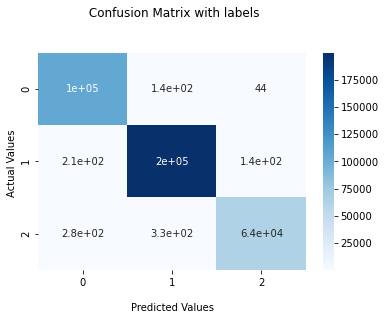

In [53]:

import seaborn as sns

ax = sns.heatmap(confusion, annot=True, cmap='Blues')

ax.set_title(' Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ');


ax.xaxis.set_ticklabels(['False','True'])
ax.yaxis.set_ticklabels(['False','True'])


plt.show()

<AxesSubplot:>

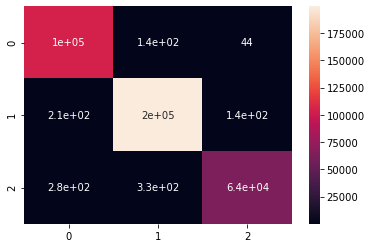

In [52]:
import seaborn as sns
sns.heatmap(confusion, annot=True)